# Deep Learning with SMOTE

## Imports

In [1]:
import scipy.io
from scipy import signal
from scipy import stats
import numpy as np
import pandas as pd
from hurst import compute_Hc
import random
import os
import time

import matplotlib.pyplot as plt
import seaborn as sn

# import keras
from sklearn.preprocessing import normalize
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import classification_report
# from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
# from sklearn.metrics import precision_score
# from sklearn.metrics import recall_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve

import tensorflow as tf
from imblearn.over_sampling import SMOTE

import wandb
import numpy as np
import pandas as pd
import seaborn as sn
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import train_test_split
import time
from tensorflow.keras.callbacks import ModelCheckpoint
from sklearn.preprocessing import LabelEncoder

import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Bidirectional, LSTM, BatchNormalization, Dropout, Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import L2
from tensorflow.keras.callbacks import ModelCheckpoint
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import seaborn as sn
import matplotlib.pyplot as plt
import wandb

2024-03-12 13:14:08.030825: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
import wandb
wandb.login()

wandb: Currently logged in as: benmussa-ethan (ethan_cerebro). Use `wandb login --relogin` to force relogin


True

## Data Preparation

In [4]:
# Importation données (80 features)
Files = [r'SOP01',
         r'SOP02',
         r'SOP03',
         r'SOP04',
         r'SOP05',
         r'SOP06',
         r'SOP07',
         r'SOP08',
         r'SOP09',
         r'SOP10',
         r'SOP11',
         r'SOP12',
         r'SOP13',
         r'SOP14',
         r'SOP15',
         r'SOP16',
         r'SOP17',
         r'SOP18',
         r'SOP19',
         r'SOP20']

Files_QoE = ['SOP1',
             'SOP2',
             'SOP3',
             'SOP4',
             'SOP5',
             'SOP6',
             'SOP7',
             'SOP8',
             'SOP9',
             'SOP10',
             'SOP11',
             'SOP12',
             'SOP13',
             'SOP14',
             'SOP15',
             'SOP16',
             'SOP17',
             'SOP18',
             'SOP19',
             'SOP20']

def data_extraction(Files, Files_QoE):
    
    start_time = time.time()
    data_EEG = []
    ses = ['A','B','C']
    
    print("--- Extracting data ---")
    
    for k in Files: # nombre de sujets 
        data_EEG_sujet = []
        for i in range(3): # nombre de sessions
            data_EEG_session = []
            for j in range(9): # nombre de videos
                # print("--- Loading ", k+'_'+ses[i]+'_'+str(j+1), " ---")
                path_data = k+'_'+ses[i]+'_'+str(j+1)+'.csv'
                path = r'../data_EEG/3seconds' + path_data
                data_temp = pd.read_csv(path)
                # print('Verif EEG:', data_temp.shape)
                data_EEG_video = []
                for x1 in range(len(data_temp)):
                    ligne = data_temp.iloc[x1]
                    ligne_mod = []
                    for x2 in data_temp.columns[1:]:
                        ligne_mod += [ligne[x2]]
                    data_EEG_video += [ligne_mod]
                # print("--- Loaded ---")
                data_EEG_session += [data_EEG_video]
            data_EEG_sujet += [data_EEG_session]
        data_EEG += [data_EEG_sujet]
    # print("Should be 20 :",len(data_EEG))
    # print("Should be 3 :",len(data_EEG[0]))
    # print("Should be 9 :",len(data_EEG[0][0]))
    # print("Should be 40 :", len(data_EEG[0][0][0]))
    # print("Should be 80 :", len(data_EEG[0][0][0][0]))
    
    # print("--- Loading QoE ---")
    
    QoE = []
    for k in Files_QoE:
        data_QoE = pd.read_excel(r'../SubjectiveRatings/SubjectiveRatings.xlsx',sheet_name=k)
        # Colonnes : 'SOP' = Q1 ; # = Q2 ; 'Unnamed: 4' = Q3 ; 'Unnamed: 5' = Q4 ; 'Unnamed: 6' = Q5 
        answers = []
        answers_SA = []
        answers_SB = []
        answers_SC = []
        for i in range(9):
            answers_SA += [[data_QoE['SOP'][5+i],data_QoE[data_QoE.columns[3]][5+i],data_QoE['Unnamed: 4'][5+i],data_QoE['Unnamed: 5'][5+i],data_QoE['Unnamed: 6'][5+i]]]

        for i in range(9):
            answers_SB += [[data_QoE['SOP'][14+i],data_QoE[data_QoE.columns[3]][14+i],data_QoE['Unnamed: 4'][14+i],data_QoE['Unnamed: 5'][14+i],data_QoE['Unnamed: 6'][14+i]]]

        for i in range(9):
            answers_SC += [[data_QoE['SOP'][23+i],data_QoE[data_QoE.columns[3]][23+i],data_QoE['Unnamed: 4'][23+i],data_QoE['Unnamed: 5'][23+i],data_QoE['Unnamed: 6'][23+i]]]

        QoE += [[answers_SA,answers_SB,answers_SC]]
    # print(data_QoE.shape)

#     print(len(QoE))
#     print(len(QoE[0]))
#     print(len(QoE[0][0]))
#     print(len(QoE[0][0][0]))
#     print("Loading done in %s s" %(time.time()-start_time))
    
    return (data_EEG, QoE)

EEG_features,QoE = data_extraction(Files,Files_QoE)

# format data : [sujets,session,video,frames,features]
# format features : [delta,theta,alpha,beta,gamma]
                      
def Ratio_calculation(ESD):
    ratios = []
    for k in range(len(ESD)): # par sujet
        subject = []
        for i in range(len(ESD[0])): # par session
            session = []
            for j in range(len(ESD[0][0])): # par video
                video = []
                for x1 in range(len(ESD[0][0][0])): # par frame
                    frame = []
                    for x2 in range(int(len(ESD[0][0][0][0])/10)): # par electrode
                        Delta = ESD[k][i][j][x1][x2*10]
                        Theta = ESD[k][i][j][x1][(x2*10)+1]
                        Alpha = ESD[k][i][j][x1][(x2*10)+2]
                        Beta = ESD[k][i][j][x1][(x2*10)+3]
                        Gamma = ESD[k][i][j][x1][(x2*10)+4]

                        ratio_DT = Delta/Theta
                        ratio_DA = Delta/Alpha
                        ratio_DB = Delta/Beta
                        ratio_DG = Delta/Gamma

                        ratio_TD = Theta/Delta
                        ratio_TA = Theta/Alpha
                        ratio_TB = Theta/Beta
                        ratio_TG = Theta/Gamma

                        ratio_AD = Alpha/Delta
                        ratio_AT = Alpha/Theta
                        ratio_AB = Alpha/Beta
                        ratio_AG = Alpha/Gamma

                        ratio_BD = Beta/Delta
                        ratio_BT = Beta/Theta
                        ratio_BA = Beta/Alpha
                        ratio_BG = Beta/Gamma

                        ratio_GD = Gamma/Delta
                        ratio_GT = Gamma/Theta
                        ratio_GA = Gamma/Alpha
                        ratio_GB = Gamma/Beta

                        frame += [ratio_DT,ratio_DA,ratio_DB,ratio_DG,
                                ratio_TD,ratio_TA,ratio_TB,ratio_TG,
                                ratio_AD,ratio_AT,ratio_AB,ratio_AG,
                                ratio_BD,ratio_BT,ratio_BA,ratio_BG,
                                ratio_GD,ratio_GT,ratio_GA,ratio_GB]
                    video += [frame]
                session += [video]
            subject += [session]
        ratios += [subject] 
                      
    print("Should be 20 :",len(ratios))
    print("Should be 3 :",len(ratios[0]))
    print("Should be 9 :",len(ratios[0][0]))
    print("Should be 40 :", len(ratios[0][0][0]))
    print("Should be 5120 :", len(ratios[0][0][0][0]))
                      
    return ratios
                      
# Ratio_features = Ratio_calculation(EEG_features)


# Fusion data

def MiseFormatEEG(EEG):
    data_all = []
    for k in range(len(EEG)):
        data_sujet = []
        for i in range(len(EEG[0])):
            data_session = []
            for j in range(len(EEG[0][0])):
                data_video = []
                for l in range(len(EEG[0][0][0])):
                    data_video += [EEG[k][i][j][l]]
                data_session += [data_video]
            data_sujet += [data_session]
        data_all += [data_sujet]

    print("Should be 20 : ",len(data_all)) # Sujet
    print("Should be 3 : ",len(data_all[0])) # Session
    print("Should be 9 : ",len(data_all[0][0])) # Videos
    print("Should be 40 : ",len(data_all[0][0][0])) # lignes EEG
    print("Should be 1280 : ",len(data_all[0][0][0][0])) # colonnes EEG
    
    return data_all

data_all = MiseFormatEEG(EEG_features)


#################

data = []
for k in range(len(data_all)):
    for i in range(len(data_all[0])):
        for j in range(len(data_all[0][0])):
            data += [data_all[k][i][j]]

print("Longueur (540):", len(data))
print("Lignes single data point (40)", len(data[0]))
print("Colonnes single data point (1280)", len(data[0][0]))

# 3-class classification
y1 = []
compt1 = 0
compt2 = 0
compt3 = 0
y1 = []
y2 = []
y3 = []
y4 = []
y5 = []
for k in range(len(QoE)):
    for i in range(len(QoE[0])):
        for j in range(len(QoE[0][0])):
            if (QoE[k][i][j][0] <= 3):
                y1 += [0] #[[1,0,0]]
                compt1 += 1
            elif (QoE[k][i][j][0] <= 6):
                y1 += [1] #[[0,1,0]]
                compt2 += 1
            else:
                y1 += [2] #[[0,0,1]]
                compt3 += 1
                
            if (QoE[k][i][j][1] <= 3):
                y2 += [0] #[[1,0,0]]
                compt1 += 1
            elif (QoE[k][i][j][1] <= 6):
                y2 += [1] #[[0,1,0]]
                compt2 += 1
            else:
                y2 += [2] #[[0,0,1]]
                compt3 += 1
            
            if (QoE[k][i][j][2] <= 3):
                y3 += [0] #[[1,0,0]]
                compt1 += 1
            elif (QoE[k][i][j][2] <= 6):
                y3 += [1] #[[0,1,0]]
                compt2 += 1
            else:
                y3 += [2] #[[0,0,1]]
                compt3 += 1
                
            if (QoE[k][i][j][3] <= 3):
                y4 += [0] #[[1,0,0]]
                compt1 += 1
            elif (QoE[k][i][j][3] <= 6):
                y4 += [1] #[[0,1,0]]
                compt2 += 1
            else:
                y4 += [2] #[[0,0,1]]
                compt3 += 1
                
            if (QoE[k][i][j][4] <= 3):
                y5 += [0] #[[1,0,0]]
                compt1 += 1
            elif (QoE[k][i][j][4] <= 6):
                y5 += [1] #[[0,1,0]]
                compt2 += 1
            else:
                y5 += [2] #[[0,0,1]]
                compt3 += 1
            
# print("Equilibre classes :",compt1,compt2,compt3)              
print("Longueur Labels :", len(y1))

--- Extracting data ---
Should be 20 :  20
Should be 3 :  3
Should be 9 :  9
Should be 40 :  40
Should be 1280 :  80
Longueur (540): 540
Lignes single data point (40) 40
Colonnes single data point (1280) 80
Longueur Labels : 540


## Functions to iterate

In [5]:
# One-hot encode the labels
def one_hot_encode(y):
    return np.eye(3)[y]

In [6]:
def run_all(data, y, title):
    rdm = 0

    X_train_val, X_test, Y_train_val, Y_test = train_test_split(data, y, test_size=0.2, random_state=rdm)
    X_train, X_val, Y_train, Y_val = train_test_split(X_train_val, Y_train_val, test_size=0.25, random_state=rdm)  # 0.25 x 0.8 = 0.2
    
    X_train, X_val, X_test = np.array(X_train), np.array(X_val), np.array(X_test)
    Y_train, Y_val, Y_test = np.array(Y_train), np.array(Y_val), np.array(Y_test)
    
    X_train = np.array(X_train)
    X_train_flat = X_train.reshape(X_train.shape[0], -1)

    oversample = SMOTE()
    Y_train = LabelEncoder().fit_transform(Y_train)
    X_train_flat, Y_train = oversample.fit_resample(X_train_flat, Y_train)

    X_train = X_train_flat.reshape(X_train_flat.shape[0], 40, 80)

    Y_trn = one_hot_encode(Y_train)
    Y_vl = one_hot_encode(Y_val)
    Y_tst = one_hot_encode(Y_test)
    Y_tst = np.argmax(Y_tst, axis=1)
    
    # X_test_downsampled and Y_test_downsampled have an equal number of samples from each class
    # Get indices for each class
    indices_0 = np.where(Y_tst == 0)[0]
    indices_1 = np.where(Y_tst == 1)[0]
    indices_2 = np.where(Y_tst == 2)[0]

    # Determine the smallest class size
    min_size = min(len(indices_0), len(indices_1), len(indices_2))

    # Randomly select indices from each class to match the smallest class size
    np.random.seed(0)  # For reproducibility
    downsampled_indices_0 = np.random.choice(indices_0, size=min_size, replace=False)
    downsampled_indices_1 = np.random.choice(indices_1, size=min_size, replace=False)
    downsampled_indices_2 = np.random.choice(indices_2, size=min_size, replace=False)

    # Combine indices from all classes and shuffle them
    combined_indices = np.concatenate([downsampled_indices_0, downsampled_indices_1, downsampled_indices_2])
    np.random.shuffle(combined_indices)

    # Downsample both X_test and Y_test
    X_test = X_test[combined_indices]
    Y_tst = Y_tst[combined_indices]
    
    # Deep learning part
    # Hyperparameters
    units_layer1 = [64, 128]
    units_layer2 = [64, 128]
    drop = [0.3, 0.5, 0.7]
    reg = [0.01, 0.05, 0.07]
    learning_rates = [0.001, 0.005, 0.0001, 0.0005, 0.00001]
    batch_sizes = [32, 64, 128, 256]
    trial = 1
    max_acc = 0
    
    
    for lr in learning_rates:
        for batch_size in batch_sizes:
            for units1 in units_layer1:
                for units2 in units_layer2:
                    for dropo in drop:
                        for regu in reg:
                            run = wandb.init(project="SMOTE_over_works_good_title_clean", config={
                                "learning_rate": lr,
                                "batch_size": batch_size,
                                "units1": units1,
                                "units2": units2,
                                "dropout": dropo,
                                "regularization": regu,
                                "epochs": 100,
                                "trial": trial, 
                                "y": title
                            })

                            model = Sequential([
                                Bidirectional(LSTM(units1, activation='tanh', kernel_regularizer=L2(regu), return_sequences=True)),
                                BatchNormalization(),
                                Dropout(dropo),
                                Bidirectional(LSTM(units2, activation='tanh', kernel_regularizer=L2(regu))),
                                BatchNormalization(),
                                Dropout(dropo),
                                Dense(256, activation='tanh'),
                                Dropout(0.3),
                                Dense(128, activation='tanh'),
                                BatchNormalization(),
                                Dropout(0.3),
                                Dense(3, activation='softmax')
                            ])

                            opt = tf.keras.optimizers.Adam(learning_rate=wandb.config.learning_rate)

                            model.compile(loss='categorical_crossentropy',
                                          optimizer=opt,
                                          metrics=['accuracy'])

                            start_time = time.time()
                            history = model.fit(X_train, Y_trn, validation_data=(X_val, Y_vl), batch_size=wandb.config.batch_size, epochs=wandb.config.epochs, verbose=1)
                            training_time = time.time() - start_time
                            print("Training done in %s s" % training_time)

                            # Log training time
                            wandb.log({"training_time": training_time})

                            # Log training history
                            for epoch in range(wandb.config.epochs):
                                wandb.log({"epoch": epoch, "training_loss": history.history['loss'][epoch], "training_accuracy": history.history['accuracy'][epoch],
                                           "val_loss": history.history['val_loss'][epoch], "val_accuracy": history.history['val_accuracy'][epoch]})


                            # Inference and metrics
                            inf_time = time.time()
                            y_pred = model.predict(X_test, verbose=1)
                            inference_time = time.time() - inf_time
                            print("Inference done in %s s" % inference_time)

                            # Convert predictions
                            y_pred = np.argmax(y_pred, axis=1)
                            acc = accuracy_score(Y_tst, y_pred)

                            # Log inference time and accuracy
                            wandb.log({"inference_time": inference_time, "test_accuracy": acc})

                            # Classification report
                            report = classification_report(Y_tst, y_pred, output_dict=True)
                            print(report)
                            wandb.log({"test_precision": report['macro avg']['precision'], "test_recall": report['macro avg']['recall'], "test_f1_score": report['macro avg']['f1-score']})

                            # Confusion Matrix
                            cm = confusion_matrix(Y_tst, y_pred, normalize='true')
                            df_cm = pd.DataFrame(cm, range(3), range(3))
                            plt.figure()
                            sn.heatmap(df_cm, annot=True)
                            plt.xlabel("Predictions")
                            plt.ylabel("True labels")
                            wandb.log({"confusion_matrix": wandb.Image(plt)})
                            plt.show()

                            # Save and log the model
                            model.save(f"./resultat/my_model_trial{trial}_{title}.hdf5")
                            wandb.save(f"my_model_trial{trial}_{title}.hdf5")

                            # Optional: finish the wandb run
                            wandb.finish()
                            trial += 1



    # Finish the wandb run
    wandb.finish()

Epoch 1/100


2024-03-12 13:15:49.517377: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:15:49.520501: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:15:49.522203: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:15:51.184050: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:15:51.185907: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:15:51.188019: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:15:55.560759: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:15:56.251215: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 7.4506 - accuracy: 0.3582

2024-03-12 13:15:59.917796: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:15:59.919713: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:15:59.921920: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 201ms/step - loss: 7.4521 - accuracy: 0.3584 - val_loss: 6.8362 - val_accuracy: 0.1759
Epoch 2/100
14/14 [==============================] - 1s 49ms/step - loss: 6.7507 - accuracy: 0.5046 - val_loss: 6.6849 - val_accuracy: 0.1852
Epoch 3/100
14/14 [==============================] - 1s 48ms/step - loss: 6.1448 - accuracy: 0.6370 - val_loss: 6.4299 - val_accuracy: 0.1944
Epoch 4/100
14/14 [==============================] - 1s 49ms/step - loss: 5.8309 - accuracy: 0.6689 - val_loss: 6.4472 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 1s 49ms/step - loss: 5.5426 - accuracy: 0.7078 - val_loss: 6.2825 - val_accuracy: 0.1852
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 5.2189 - accuracy: 0.7466 - val_loss: 6.2479 - val_accuracy: 0.2037
Epoch 7/100
14/14 [==============================] - 1s 51ms/step - loss: 4.9432 - accuracy: 0.7900 - val_loss: 5.9131 - val_accuracy: 0.2500
Epoch 8/100
14/1

14/14 [==============================] - 1s 48ms/step - loss: 0.8688 - accuracy: 0.9886 - val_loss: 3.7020 - val_accuracy: 0.5741
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 0.8670 - accuracy: 0.9795 - val_loss: 3.7421 - val_accuracy: 0.5926
Epoch 60/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8199 - accuracy: 0.9954 - val_loss: 3.7624 - val_accuracy: 0.5741
Epoch 61/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8650 - accuracy: 0.9703 - val_loss: 4.0518 - val_accuracy: 0.5926
Epoch 62/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8969 - accuracy: 0.9429 - val_loss: 3.9200 - val_accuracy: 0.5370
Epoch 63/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8189 - accuracy: 0.9749 - val_loss: 4.8062 - val_accuracy: 0.4259
Epoch 64/100
14/14 [==============================] - 1s 47ms/step - loss: 0.7965 - accuracy: 0.9863 - val_loss: 4.7444 - val_accuracy: 0.3981
Epoch 65/100

2024-03-12 13:17:08.822232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:17:08.823866: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:17:08.825970: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.46091890335083 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, '2': {'precision': 0.7272727272727273, 'recall': 0.8888888888888888, 'f1-score': 0.7999999999999999, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5928515928515928, 'recall': 0.5555555555555555, 'f1-score': 0.5292929292929293, 'support': 27}, 'weighted avg': {'precision': 0.5928515928515928, 'recall': 0.5555555555555556, 'f1-score': 0.5292929292929293, 'support': 27}}


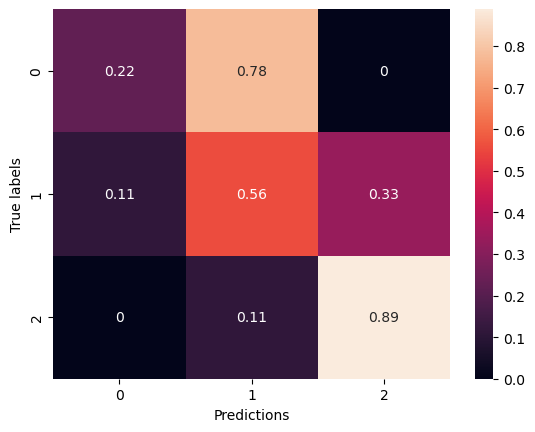

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇▇█▇▇▇▇██▇████████████████████████
training_loss,█▇▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▃▇▅▆█▇▇▅▆▅██▇▆▆▇█▇▇███▅▅▇▆▆▅▆▆▆▇▅▆█▆▆
val_loss,█▇▇▆▄▄▅▄▄▄▅▄▆▃▃▂▃▃▃▂▄▂▂▂▂▄▃▂▂▄▃▂▂▃▂▃▂▁▂▂


Epoch 1/100


2024-03-12 13:17:31.047013: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:17:31.049415: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:17:31.051080: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:17:32.670786: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:17:32.672658: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:17:32.675148: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:17:36.858942: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:17:37.444052: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 28.9109 - accuracy: 0.4423

2024-03-12 13:17:40.620492: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:17:40.622111: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:17:40.624111: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 164ms/step - loss: 28.7831 - accuracy: 0.4521 - val_loss: 26.1335 - val_accuracy: 0.3796
Epoch 2/100
14/14 [==============================] - 1s 47ms/step - loss: 24.4338 - accuracy: 0.5731 - val_loss: 22.4932 - val_accuracy: 0.2407
Epoch 3/100
14/14 [==============================] - 1s 48ms/step - loss: 20.7665 - accuracy: 0.5868 - val_loss: 19.2744 - val_accuracy: 0.2407
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 17.6272 - accuracy: 0.6872 - val_loss: 16.5698 - val_accuracy: 0.2685
Epoch 5/100
14/14 [==============================] - 1s 48ms/step - loss: 15.0253 - accuracy: 0.6849 - val_loss: 14.3166 - val_accuracy: 0.2593
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 12.7961 - accuracy: 0.7466 - val_loss: 12.2876 - val_accuracy: 0.3796
Epoch 7/100
14/14 [==============================] - 1s 47ms/step - loss: 10.9922 - accuracy: 0.7603 - val_loss: 10.7123 - val_accuracy: 0.3426
Ep

14/14 [==============================] - 1s 47ms/step - loss: 0.8206 - accuracy: 0.9566 - val_loss: 3.9141 - val_accuracy: 0.5185
Epoch 59/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8237 - accuracy: 0.9589 - val_loss: 4.1334 - val_accuracy: 0.4444
Epoch 60/100
14/14 [==============================] - 1s 48ms/step - loss: 0.8999 - accuracy: 0.9429 - val_loss: 4.0050 - val_accuracy: 0.4167
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 1.0162 - accuracy: 0.8699 - val_loss: 3.3915 - val_accuracy: 0.4352
Epoch 62/100
14/14 [==============================] - 1s 47ms/step - loss: 0.9523 - accuracy: 0.9269 - val_loss: 3.8462 - val_accuracy: 0.3796
Epoch 63/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8972 - accuracy: 0.9498 - val_loss: 4.7512 - val_accuracy: 0.3519
Epoch 64/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8601 - accuracy: 0.9452 - val_loss: 3.9559 - val_accuracy: 0.3889
Epoch 65/100

2024-03-12 13:18:48.556833: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:18:48.558541: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:18:48.560414: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.9688210487365723 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, '1': {'precision': 0.8, 'recall': 0.4444444444444444, 'f1-score': 0.5714285714285714, 'support': 9}, '2': {'precision': 0.4375, 'recall': 0.7777777777777778, 'f1-score': 0.56, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.5236111111111111, 'recall': 0.48148148148148145, 'f1-score': 0.466031746031746, 'support': 27}, 'weighted avg': {'precision': 0.5236111111111111, 'recall': 0.48148148148148145, 'f1-score': 0.4660317460317461, 'support': 27}}


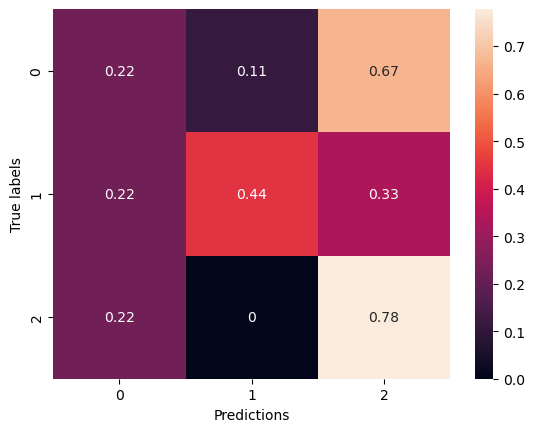

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▆▇▇▇▇▇▇▇▇▇█▇▇▇▇████▆▇█▇▇█▇▇████▇▇▇█
training_loss,█▆▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▄▃▄▇▄▅▇▇▆▄▅▇▅▃▆▇▆▆▆▄▇▅▅▄▅▇██▄▄▇▆▆▇▃▃▃▆
val_loss,█▆▄▃▂▂▂▂▂▁▁▂▁▁▁▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▂▂▁


Epoch 1/100


2024-03-12 13:19:11.322033: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:19:11.323800: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:19:11.325798: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:19:12.918309: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:19:12.920103: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:19:12.922386: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:19:17.064212: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:19:17.653990: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 39.1415 - accuracy: 0.4062

2024-03-12 13:19:20.834916: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:19:20.836522: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:19:20.838582: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 167ms/step - loss: 38.9440 - accuracy: 0.4110 - val_loss: 34.7652 - val_accuracy: 0.2315
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 31.7611 - accuracy: 0.5297 - val_loss: 28.6880 - val_accuracy: 0.1389
Epoch 3/100
14/14 [==============================] - 1s 49ms/step - loss: 25.9616 - accuracy: 0.5913 - val_loss: 23.5264 - val_accuracy: 0.1852
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 21.1086 - accuracy: 0.6416 - val_loss: 19.4576 - val_accuracy: 0.1759
Epoch 5/100
14/14 [==============================] - 1s 47ms/step - loss: 17.3356 - accuracy: 0.6735 - val_loss: 15.9610 - val_accuracy: 0.3333
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 14.2454 - accuracy: 0.7146 - val_loss: 13.3099 - val_accuracy: 0.3981
Epoch 7/100
14/14 [==============================] - 1s 47ms/step - loss: 11.8226 - accuracy: 0.7352 - val_loss: 11.2294 - val_accuracy: 0.4537
Ep

14/14 [==============================] - 1s 47ms/step - loss: 0.9274 - accuracy: 0.9315 - val_loss: 2.8830 - val_accuracy: 0.5833
Epoch 59/100
14/14 [==============================] - 1s 47ms/step - loss: 0.9299 - accuracy: 0.9406 - val_loss: 4.0382 - val_accuracy: 0.3611
Epoch 60/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8516 - accuracy: 0.9543 - val_loss: 3.2356 - val_accuracy: 0.4815
Epoch 61/100
14/14 [==============================] - 1s 47ms/step - loss: 0.7918 - accuracy: 0.9589 - val_loss: 2.9151 - val_accuracy: 0.5648
Epoch 62/100
14/14 [==============================] - 1s 47ms/step - loss: 0.7842 - accuracy: 0.9612 - val_loss: 4.1714 - val_accuracy: 0.5185
Epoch 63/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8171 - accuracy: 0.9475 - val_loss: 3.4312 - val_accuracy: 0.5370
Epoch 64/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8366 - accuracy: 0.9406 - val_loss: 3.7424 - val_accuracy: 0.4352
Epoch 65/100

2024-03-12 13:20:28.385562: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:20:28.387137: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:20:28.389487: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4663028717041016 s
{'0': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '1': {'precision': 0.3125, 'recall': 0.5555555555555556, 'f1-score': 0.39999999999999997, 'support': 9}, '2': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.49702380952380953, 'recall': 0.4074074074074074, 'f1-score': 0.4121794871794872, 'support': 27}, 'weighted avg': {'precision': 0.49702380952380953, 'recall': 0.4074074074074074, 'f1-score': 0.4121794871794872, 'support': 27}}


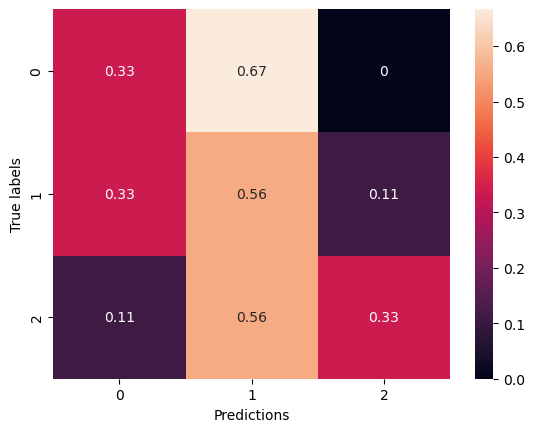

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▆▇▇▇▇▇▇▇▇▇██████▇███████████████████
training_loss,█▆▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▅▆▇▆▇█▇▄▇▆▅█▇▆█▇▇▇▇▅▆▄█▅▆▇▇▇▆▇▅▇▆▅▆▇▄▆
val_loss,█▆▃▃▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 13:20:55.187782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:20:55.190204: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:20:55.191854: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:20:57.460555: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:20:57.462646: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:20:57.464584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:21:01.611920: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:21:02.200154: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 7.3717 - accuracy: 0.3221

2024-03-12 13:21:05.368006: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:21:05.369591: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:21:05.371618: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 164ms/step - loss: 7.3446 - accuracy: 0.3356 - val_loss: 6.8214 - val_accuracy: 0.1667
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 6.8302 - accuracy: 0.4315 - val_loss: 6.6425 - val_accuracy: 0.1296
Epoch 3/100
14/14 [==============================] - 1s 47ms/step - loss: 6.4954 - accuracy: 0.4635 - val_loss: 6.4666 - val_accuracy: 0.1296
Epoch 4/100
14/14 [==============================] - 1s 47ms/step - loss: 6.0611 - accuracy: 0.5594 - val_loss: 6.2504 - val_accuracy: 0.1481
Epoch 5/100
14/14 [==============================] - 1s 48ms/step - loss: 5.8444 - accuracy: 0.5479 - val_loss: 6.0220 - val_accuracy: 0.1667
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 5.6043 - accuracy: 0.5845 - val_loss: 6.1348 - val_accuracy: 0.1296
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 5.4278 - accuracy: 0.5571 - val_loss: 6.1493 - val_accuracy: 0.1481
Epoch 8/100
14/1

14/14 [==============================] - 1s 50ms/step - loss: 0.9552 - accuracy: 0.9817 - val_loss: 3.8509 - val_accuracy: 0.4537
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 0.9477 - accuracy: 0.9703 - val_loss: 3.4485 - val_accuracy: 0.5463
Epoch 60/100
14/14 [==============================] - 1s 51ms/step - loss: 0.9242 - accuracy: 0.9795 - val_loss: 4.6933 - val_accuracy: 0.4352
Epoch 61/100
14/14 [==============================] - 1s 47ms/step - loss: 0.9681 - accuracy: 0.9452 - val_loss: 3.4419 - val_accuracy: 0.5648
Epoch 62/100
14/14 [==============================] - 1s 48ms/step - loss: 0.9021 - accuracy: 0.9680 - val_loss: 3.7531 - val_accuracy: 0.4815
Epoch 63/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8882 - accuracy: 0.9612 - val_loss: 3.9457 - val_accuracy: 0.5000
Epoch 64/100
14/14 [==============================] - 1s 49ms/step - loss: 0.8562 - accuracy: 0.9772 - val_loss: 4.0984 - val_accuracy: 0.5185
Epoch 65/100

2024-03-12 13:22:14.121459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:22:14.123798: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:22:14.125382: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4633879661560059 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.6666666666666666, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.8888888888888888, 'f1-score': 0.761904761904762, 'support': 9}, 'accuracy': 0.6666666666666666, 'macro avg': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.653968253968254, 'support': 27}, 'weighted avg': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.653968253968254, 'support': 27}}


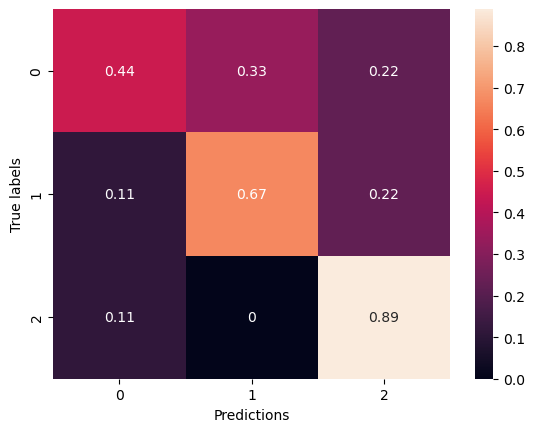

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▄▄▅▅▅▆▆▇▇▇▇▇▇▇▇███████████████████████
training_loss,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▂▂▄▄▆▇▇▆▆█▇▆▆▇██▇▇▆▆▇▇▇▅▅▇▇▇▆▇▇▇▆▇▅▆▆
val_loss,█▇▇▆▇▄▄▃▃▃▄▃▂▂▃▃▂▂▂▂▂▃▅▁▁▃▅▃▂▁▁▁▂▁▂▂▁▃▂▂


Epoch 1/100


2024-03-12 13:22:37.788999: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:22:37.790596: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:22:37.792616: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:22:39.403567: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:22:39.406094: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:22:39.407680: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:22:44.176246: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:22:44.751485: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 28.9919 - accuracy: 0.3870

2024-03-12 13:22:47.992634: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:22:47.994505: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:22:47.996148: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 166ms/step - loss: 28.9059 - accuracy: 0.3790 - val_loss: 26.2470 - val_accuracy: 0.2037
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 24.7435 - accuracy: 0.4224 - val_loss: 22.6246 - val_accuracy: 0.1852
Epoch 3/100
14/14 [==============================] - 1s 47ms/step - loss: 21.1362 - accuracy: 0.4703 - val_loss: 19.6923 - val_accuracy: 0.1481
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 18.2790 - accuracy: 0.5114 - val_loss: 17.1946 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 1s 48ms/step - loss: 15.7338 - accuracy: 0.5183 - val_loss: 15.0809 - val_accuracy: 0.1389
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 13.5960 - accuracy: 0.5845 - val_loss: 13.1112 - val_accuracy: 0.1852
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 11.7855 - accuracy: 0.5959 - val_loss: 11.2938 - val_accuracy: 0.4259
Ep

14/14 [==============================] - 1s 47ms/step - loss: 0.9067 - accuracy: 0.9384 - val_loss: 2.7275 - val_accuracy: 0.6667
Epoch 59/100
14/14 [==============================] - 1s 47ms/step - loss: 0.8542 - accuracy: 0.9566 - val_loss: 2.8982 - val_accuracy: 0.5741
Epoch 60/100
14/14 [==============================] - 1s 47ms/step - loss: 0.9259 - accuracy: 0.9224 - val_loss: 3.1758 - val_accuracy: 0.5833
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 0.8548 - accuracy: 0.9521 - val_loss: 3.1265 - val_accuracy: 0.5370
Epoch 62/100
14/14 [==============================] - 1s 48ms/step - loss: 0.8707 - accuracy: 0.9384 - val_loss: 3.6144 - val_accuracy: 0.5648
Epoch 63/100
14/14 [==============================] - 1s 47ms/step - loss: 0.9726 - accuracy: 0.9178 - val_loss: 3.2942 - val_accuracy: 0.5185
Epoch 64/100
14/14 [==============================] - 1s 47ms/step - loss: 1.0104 - accuracy: 0.8836 - val_loss: 3.4726 - val_accuracy: 0.4444
Epoch 65/100

2024-03-12 13:23:55.597068: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:23:55.598738: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:23:55.600818: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4590630531311035 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.38095238095238093, 'recall': 0.8888888888888888, 'f1-score': 0.5333333333333333, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.626984126984127, 'recall': 0.4444444444444445, 'f1-score': 0.4015540015540015, 'support': 27}, 'weighted avg': {'precision': 0.6269841269841271, 'recall': 0.4444444444444444, 'f1-score': 0.4015540015540015, 'support': 27}}


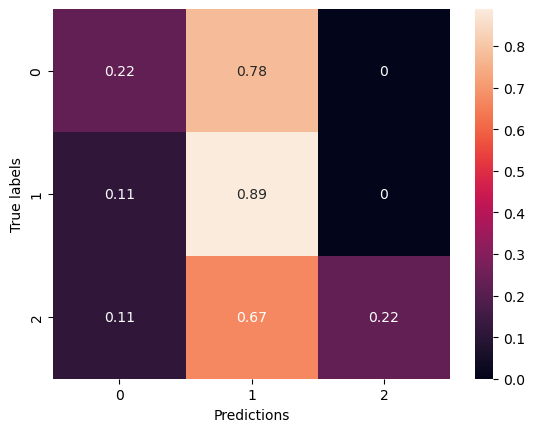

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇█▇████▇█▇▇███████████
training_loss,█▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▅▅▆▇▆█▇█▇█▇▆▆▅█▅▇█▅█▇▇▅▇▇▇▇▇█▆▆▇▄▅▆▇▄
val_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁


Epoch 1/100


2024-03-12 13:24:21.025936: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:24:21.028022: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:24:21.029578: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:24:22.663820: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:24:22.665811: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:24:22.667823: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:24:26.822747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:24:27.425992: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 39.7266 - accuracy: 0.3413

2024-03-12 13:24:30.615906: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:24:30.617616: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:24:30.619869: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 165ms/step - loss: 39.5497 - accuracy: 0.3470 - val_loss: 35.5314 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 1s 50ms/step - loss: 32.9972 - accuracy: 0.4680 - val_loss: 30.1000 - val_accuracy: 0.1296
Epoch 3/100
14/14 [==============================] - 1s 48ms/step - loss: 27.7167 - accuracy: 0.4932 - val_loss: 25.5407 - val_accuracy: 0.1204
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 23.3340 - accuracy: 0.5297 - val_loss: 21.5022 - val_accuracy: 0.2037
Epoch 5/100
14/14 [==============================] - 1s 48ms/step - loss: 19.6948 - accuracy: 0.5320 - val_loss: 18.4523 - val_accuracy: 0.1574
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 16.6556 - accuracy: 0.5685 - val_loss: 15.8429 - val_accuracy: 0.1852
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 14.2791 - accuracy: 0.6073 - val_loss: 13.5685 - val_accuracy: 0.2963
Ep

14/14 [==============================] - 1s 49ms/step - loss: 0.9287 - accuracy: 0.9612 - val_loss: 2.7850 - val_accuracy: 0.5833
Epoch 59/100
14/14 [==============================] - 1s 49ms/step - loss: 0.9235 - accuracy: 0.9429 - val_loss: 2.9529 - val_accuracy: 0.6019
Epoch 60/100
14/14 [==============================] - 1s 49ms/step - loss: 0.9462 - accuracy: 0.9315 - val_loss: 3.5974 - val_accuracy: 0.5556
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 0.9836 - accuracy: 0.9247 - val_loss: 3.5247 - val_accuracy: 0.4630
Epoch 62/100
14/14 [==============================] - 1s 49ms/step - loss: 1.0436 - accuracy: 0.8995 - val_loss: 2.9914 - val_accuracy: 0.5000
Epoch 63/100
14/14 [==============================] - 1s 49ms/step - loss: 0.9817 - accuracy: 0.9201 - val_loss: 3.5124 - val_accuracy: 0.4722
Epoch 64/100
14/14 [==============================] - 1s 48ms/step - loss: 0.9578 - accuracy: 0.9292 - val_loss: 3.2188 - val_accuracy: 0.4907
Epoch 65/100

2024-03-12 13:25:39.034694: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:25:39.036524: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:25:39.038260: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.3493781089782715 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3076923076923077, 'recall': 0.4444444444444444, 'f1-score': 0.3636363636363637, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.2692307692307692, 'recall': 0.3703703703703704, 'f1-score': 0.31168831168831174, 'support': 27}, 'weighted avg': {'precision': 0.2692307692307692, 'recall': 0.37037037037037035, 'f1-score': 0.3116883116883117, 'support': 27}}


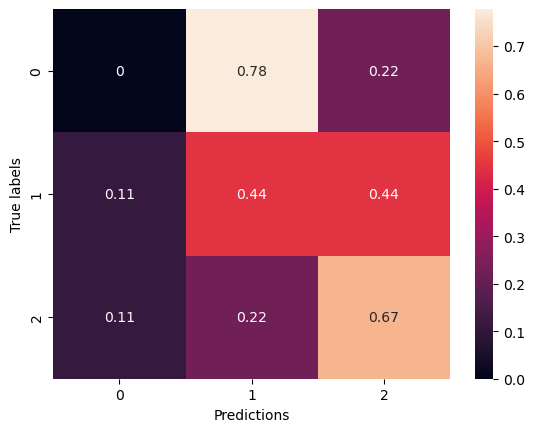

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▆▆▆▇▇▇▇▇▇▇████▇█▇██████████████████
training_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▃▆▆▇▆▅▇▇▇▆▆▆▆▇▆▇▆▇███▆▆▆▅▆▆▆▅▅▇▆▃▆▅▅▆
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 13:26:06.173385: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:26:06.174995: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:26:06.176864: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:26:07.782814: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:26:07.784894: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:26:07.787153: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:26:11.964982: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:26:12.547342: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 7.3653 - accuracy: 0.3726

2024-03-12 13:26:15.724700: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:26:15.727022: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:26:15.728757: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 164ms/step - loss: 7.3672 - accuracy: 0.3721 - val_loss: 6.7276 - val_accuracy: 0.2593
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 7.0291 - accuracy: 0.3904 - val_loss: 6.5164 - val_accuracy: 0.2407
Epoch 3/100
14/14 [==============================] - 1s 48ms/step - loss: 6.5687 - accuracy: 0.4269 - val_loss: 6.3704 - val_accuracy: 0.1852
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 6.4069 - accuracy: 0.3767 - val_loss: 6.2782 - val_accuracy: 0.1481
Epoch 5/100
14/14 [==============================] - 1s 48ms/step - loss: 6.1636 - accuracy: 0.4384 - val_loss: 6.1283 - val_accuracy: 0.1574
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 6.0211 - accuracy: 0.4064 - val_loss: 6.0663 - val_accuracy: 0.1389
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 5.7611 - accuracy: 0.4224 - val_loss: 6.1105 - val_accuracy: 0.1389
Epoch 8/100
14/1

14/14 [==============================] - 1s 47ms/step - loss: 1.3023 - accuracy: 0.8539 - val_loss: 2.9885 - val_accuracy: 0.5926
Epoch 59/100
14/14 [==============================] - 1s 47ms/step - loss: 1.2552 - accuracy: 0.8790 - val_loss: 2.9017 - val_accuracy: 0.5833
Epoch 60/100
14/14 [==============================] - 1s 48ms/step - loss: 1.2849 - accuracy: 0.8447 - val_loss: 4.6455 - val_accuracy: 0.3704
Epoch 61/100
14/14 [==============================] - 1s 47ms/step - loss: 1.2355 - accuracy: 0.8676 - val_loss: 3.5086 - val_accuracy: 0.4630
Epoch 62/100
14/14 [==============================] - 1s 48ms/step - loss: 1.1776 - accuracy: 0.8699 - val_loss: 2.8090 - val_accuracy: 0.5926
Epoch 63/100
14/14 [==============================] - 1s 48ms/step - loss: 1.1763 - accuracy: 0.8813 - val_loss: 2.9622 - val_accuracy: 0.5926
Epoch 64/100
14/14 [==============================] - 1s 48ms/step - loss: 1.1302 - accuracy: 0.8973 - val_loss: 3.3518 - val_accuracy: 0.4815
Epoch 65/100

2024-03-12 13:27:23.754365: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:27:23.755812: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:27:23.758074: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.464637041091919 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.25, 'recall': 0.2222222222222222, 'f1-score': 0.23529411764705882, 'support': 9}, '2': {'precision': 0.47058823529411764, 'recall': 0.8888888888888888, 'f1-score': 0.6153846153846153, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.40686274509803927, 'recall': 0.4074074074074074, 'f1-score': 0.34416563828328534, 'support': 27}, 'weighted avg': {'precision': 0.40686274509803916, 'recall': 0.4074074074074074, 'f1-score': 0.3441656382832853, 'support': 27}}


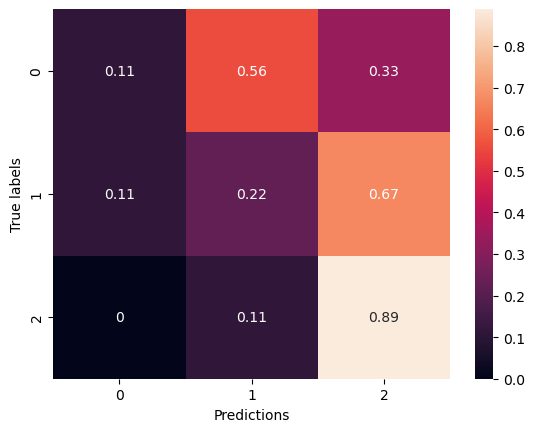

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▁▂▂▂▃▃▃▄▄▄▅▅▅▅▅▆▆▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇████▇
training_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▂▁▁▂▂▃▆▅▆▇▇█▇▇▇█▇▅▇▇█▇█▆▆▇▇▇▆█▇▆▅▆▇▃▅█▇
val_loss,█▇▇▇▆▆▅▄▄▄▃▃▃▂▂▂▂▂▅▁▂▁▂▂▃▂▂▂▂▄▁▂▂▄▂▂▆▃▁▁


Epoch 1/100


2024-03-12 13:29:10.616840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:29:10.618878: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:29:10.620772: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:29:12.417197: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:29:12.419368: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:29:12.421042: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:29:17.437348: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:29:18.020590: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 29.2307 - accuracy: 0.3389

2024-03-12 13:29:21.209850: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:29:21.211771: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:29:21.213544: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 165ms/step - loss: 29.1230 - accuracy: 0.3425 - val_loss: 26.4011 - val_accuracy: 0.4537
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 25.3717 - accuracy: 0.3493 - val_loss: 23.1864 - val_accuracy: 0.3426
Epoch 3/100
14/14 [==============================] - 1s 48ms/step - loss: 22.2921 - accuracy: 0.3425 - val_loss: 20.4590 - val_accuracy: 0.1944
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 19.5837 - accuracy: 0.3630 - val_loss: 18.1646 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 1s 48ms/step - loss: 17.2436 - accuracy: 0.4429 - val_loss: 16.1724 - val_accuracy: 0.1667
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 15.4190 - accuracy: 0.3790 - val_loss: 14.4293 - val_accuracy: 0.1944
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 13.7172 - accuracy: 0.4612 - val_loss: 12.8945 - val_accuracy: 0.2778
Ep

14/14 [==============================] - 1s 47ms/step - loss: 1.1745 - accuracy: 0.8676 - val_loss: 2.8261 - val_accuracy: 0.5278
Epoch 59/100
14/14 [==============================] - 1s 47ms/step - loss: 1.1741 - accuracy: 0.8516 - val_loss: 2.7648 - val_accuracy: 0.6019
Epoch 60/100
14/14 [==============================] - 1s 47ms/step - loss: 1.1107 - accuracy: 0.8767 - val_loss: 3.7305 - val_accuracy: 0.4074
Epoch 61/100
14/14 [==============================] - 1s 47ms/step - loss: 1.1223 - accuracy: 0.8904 - val_loss: 2.6694 - val_accuracy: 0.5833
Epoch 62/100
14/14 [==============================] - 1s 47ms/step - loss: 1.0209 - accuracy: 0.9064 - val_loss: 2.7397 - val_accuracy: 0.5741
Epoch 63/100
14/14 [==============================] - 1s 47ms/step - loss: 1.0320 - accuracy: 0.9132 - val_loss: 3.2922 - val_accuracy: 0.5278
Epoch 64/100
14/14 [==============================] - 1s 47ms/step - loss: 1.0231 - accuracy: 0.9155 - val_loss: 3.4120 - val_accuracy: 0.5000
Epoch 65/100

2024-03-12 13:30:28.925608: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:30:28.927332: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:30:28.929325: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4578309059143066 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 1.0, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}, 'weighted avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


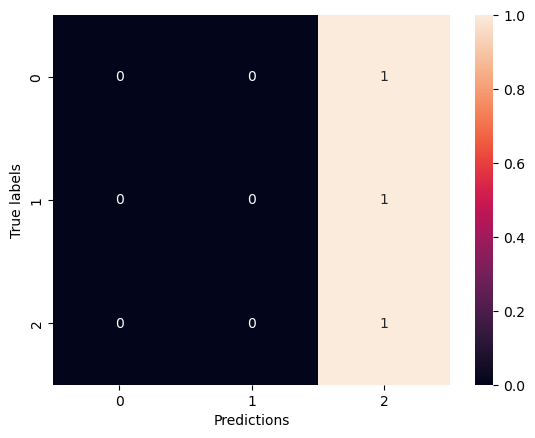

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▁▂▃▂▄▃▄▄▅▅▅▅▆▆▇▆▆▆▇▇▇▇▇█▇▇▇▇█▇▇▇█████▇
training_loss,█▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▁▁▂▄▄▅▄▄▄▅▇▆▆▇▅▃▄▇▂▃▇▄█▇▆▇▇█▆▄▆▂▄▅▆▇▃▇▇
val_loss,█▆▅▄▃▂▂▂▂▂▁▁▁▁▁▁▂▁▁▂▂▁▁▁▁▁▁▁▁▁▂▁▂▁▁▁▁▂▁▁


Epoch 1/100


2024-03-12 13:30:52.049328: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:30:52.050899: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:30:52.052805: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:30:53.652840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:30:53.654559: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:30:53.656781: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:30:57.810624: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:30:58.394891: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 39.7967 - accuracy: 0.3750

2024-03-12 13:31:02.207523: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:31:02.209116: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:31:02.211059: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 164ms/step - loss: 39.6609 - accuracy: 0.3721 - val_loss: 35.7967 - val_accuracy: 0.1574
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 33.6618 - accuracy: 0.4018 - val_loss: 30.5798 - val_accuracy: 0.1574
Epoch 3/100
14/14 [==============================] - 1s 48ms/step - loss: 28.7272 - accuracy: 0.3721 - val_loss: 26.1338 - val_accuracy: 0.1481
Epoch 4/100
14/14 [==============================] - 1s 47ms/step - loss: 24.5501 - accuracy: 0.3995 - val_loss: 22.4837 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 1s 47ms/step - loss: 21.0687 - accuracy: 0.4110 - val_loss: 19.5214 - val_accuracy: 0.1481
Epoch 6/100
14/14 [==============================] - 1s 47ms/step - loss: 18.1775 - accuracy: 0.4384 - val_loss: 17.0239 - val_accuracy: 0.1296
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 15.8071 - accuracy: 0.4452 - val_loss: 15.1249 - val_accuracy: 0.1389
Ep

14/14 [==============================] - 1s 47ms/step - loss: 1.1806 - accuracy: 0.8881 - val_loss: 4.0978 - val_accuracy: 0.3519
Epoch 59/100
14/14 [==============================] - 1s 47ms/step - loss: 1.1919 - accuracy: 0.8744 - val_loss: 3.3038 - val_accuracy: 0.5278
Epoch 60/100
14/14 [==============================] - 1s 47ms/step - loss: 1.1460 - accuracy: 0.9064 - val_loss: 3.1275 - val_accuracy: 0.5556
Epoch 61/100
14/14 [==============================] - 1s 50ms/step - loss: 1.2710 - accuracy: 0.8516 - val_loss: 2.8317 - val_accuracy: 0.5370
Epoch 62/100
14/14 [==============================] - 1s 47ms/step - loss: 1.2924 - accuracy: 0.8584 - val_loss: 2.6663 - val_accuracy: 0.6019
Epoch 63/100
14/14 [==============================] - 1s 47ms/step - loss: 1.2379 - accuracy: 0.8584 - val_loss: 3.7788 - val_accuracy: 0.4074
Epoch 64/100
14/14 [==============================] - 1s 47ms/step - loss: 1.0934 - accuracy: 0.9155 - val_loss: 3.2118 - val_accuracy: 0.5926
Epoch 65/100

2024-03-12 13:32:10.027467: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:32:10.029131: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:32:10.031386: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4628851413726807 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.45, 'recall': 1.0, 'f1-score': 0.6206896551724138, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.34047619047619043, 'recall': 0.48148148148148145, 'f1-score': 0.3735632183908046, 'support': 27}, 'weighted avg': {'precision': 0.3404761904761905, 'recall': 0.48148148148148145, 'f1-score': 0.3735632183908046, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


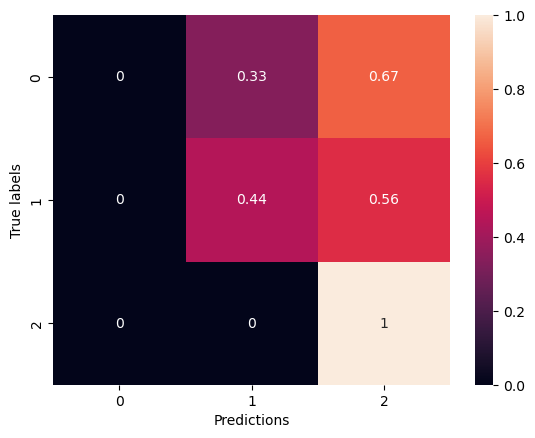

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▃▃▄▄▅▅▅▆▅▅▆▆▇▇▇▇▇▇▇▇▇█▇▇█▇▇█▇█▇▇▇██▇
training_loss,█▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▅▅▆▅▇▅▇▅▅▅▆▇▅▇▇▆▅██▇▇█▇▅▇▇▆▅█▇▆▇▇█▆█
val_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 13:32:32.929030: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:32:32.930860: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:32:32.932570: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:32:34.558386: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:32:34.560259: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:32:34.562386: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:32:38.713830: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:32:39.304785: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 7.7674 - accuracy: 0.4338

2024-03-12 13:32:42.795705: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:32:42.798114: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:32:42.799685: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 202ms/step - loss: 7.7674 - accuracy: 0.4338 - val_loss: 7.6467 - val_accuracy: 0.1296
Epoch 2/100
14/14 [==============================] - 1s 83ms/step - loss: 7.0038 - accuracy: 0.6027 - val_loss: 7.4022 - val_accuracy: 0.1389
Epoch 3/100
14/14 [==============================] - 1s 71ms/step - loss: 6.5818 - accuracy: 0.6347 - val_loss: 6.9697 - val_accuracy: 0.1944
Epoch 4/100
14/14 [==============================] - 1s 75ms/step - loss: 6.0313 - accuracy: 0.7192 - val_loss: 6.8910 - val_accuracy: 0.1852
Epoch 5/100
14/14 [==============================] - 1s 72ms/step - loss: 5.5523 - accuracy: 0.8105 - val_loss: 6.4744 - val_accuracy: 0.2593
Epoch 6/100
14/14 [==============================] - 1s 70ms/step - loss: 5.2863 - accuracy: 0.7877 - val_loss: 6.4928 - val_accuracy: 0.2222
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 4.9761 - accuracy: 0.8014 - val_loss: 6.0470 - val_accuracy: 0.3056
Epoch 8/100
14/1

14/14 [==============================] - 1s 72ms/step - loss: 0.8333 - accuracy: 0.9612 - val_loss: 3.3898 - val_accuracy: 0.5833
Epoch 59/100
14/14 [==============================] - 1s 74ms/step - loss: 0.7837 - accuracy: 0.9772 - val_loss: 3.5626 - val_accuracy: 0.5370
Epoch 60/100
14/14 [==============================] - 1s 70ms/step - loss: 0.8074 - accuracy: 0.9635 - val_loss: 4.0582 - val_accuracy: 0.4815
Epoch 61/100
14/14 [==============================] - 1s 71ms/step - loss: 0.7379 - accuracy: 0.9840 - val_loss: 3.4544 - val_accuracy: 0.5185
Epoch 62/100
14/14 [==============================] - 1s 71ms/step - loss: 0.7298 - accuracy: 0.9795 - val_loss: 3.3856 - val_accuracy: 0.5926
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 0.7641 - accuracy: 0.9566 - val_loss: 3.7264 - val_accuracy: 0.4537
Epoch 64/100
14/14 [==============================] - 1s 75ms/step - loss: 0.7384 - accuracy: 0.9680 - val_loss: 4.0056 - val_accuracy: 0.5000
Epoch 65/100

2024-03-12 13:34:23.727639: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:34:23.729969: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:34:23.731821: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4722561836242676 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.8888888888888888, 'f1-score': 0.5925925925925926, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.2962962962962963, 'recall': 0.4444444444444444, 'f1-score': 0.345679012345679, 'support': 27}, 'weighted avg': {'precision': 0.2962962962962963, 'recall': 0.4444444444444444, 'f1-score': 0.345679012345679, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


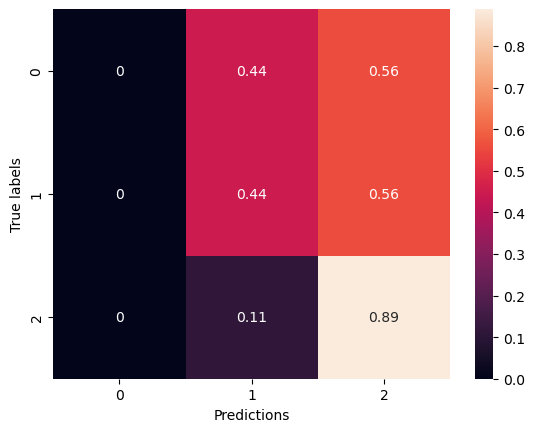

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇██▇█████████████████████████▇████
training_loss,█▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▂▆▇▇█▅▆▆▆▆▇▇█▅▇▇▇▆▆▆▆▇▇▇▇▆█▇▇▇▇▆█▇▆▆▇▇
val_loss,█▇▆▅▄▄▄▄▄▅▄▃▄▃▂▃▂▃▃▃▄▄▂▂▂▂▂▃▁▂▂▂▂▃▂▁▃▃▁▂


Epoch 1/100


2024-03-12 13:34:49.043280: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:34:49.044929: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:34:49.046871: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:34:51.575358: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:34:51.577662: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:34:51.579899: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:34:55.707232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:34:56.286170: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 31.7388 - accuracy: 0.4475

2024-03-12 13:34:59.801537: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:34:59.803584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:34:59.805150: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 189ms/step - loss: 31.7388 - accuracy: 0.4475 - val_loss: 28.4357 - val_accuracy: 0.1852
Epoch 2/100
14/14 [==============================] - 1s 71ms/step - loss: 25.8976 - accuracy: 0.6142 - val_loss: 23.7100 - val_accuracy: 0.1944
Epoch 3/100
14/14 [==============================] - 1s 74ms/step - loss: 21.3761 - accuracy: 0.6484 - val_loss: 19.7757 - val_accuracy: 0.1759
Epoch 4/100
14/14 [==============================] - 1s 70ms/step - loss: 17.4855 - accuracy: 0.7055 - val_loss: 16.3659 - val_accuracy: 0.2963
Epoch 5/100
14/14 [==============================] - 1s 70ms/step - loss: 14.3897 - accuracy: 0.7717 - val_loss: 13.6313 - val_accuracy: 0.3889
Epoch 6/100
14/14 [==============================] - 1s 70ms/step - loss: 11.9441 - accuracy: 0.8151 - val_loss: 11.6045 - val_accuracy: 0.3519
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 10.0172 - accuracy: 0.8037 - val_loss: 9.8586 - val_accuracy: 0.4815
Epo

14/14 [==============================] - 1s 71ms/step - loss: 0.8352 - accuracy: 0.9658 - val_loss: 3.2099 - val_accuracy: 0.5741
Epoch 59/100
14/14 [==============================] - 1s 71ms/step - loss: 0.7874 - accuracy: 0.9703 - val_loss: 3.1655 - val_accuracy: 0.6019
Epoch 60/100
14/14 [==============================] - 1s 70ms/step - loss: 0.7269 - accuracy: 0.9863 - val_loss: 3.7745 - val_accuracy: 0.5185
Epoch 61/100
14/14 [==============================] - 1s 71ms/step - loss: 0.7451 - accuracy: 0.9566 - val_loss: 3.5557 - val_accuracy: 0.5000
Epoch 62/100
14/14 [==============================] - 1s 79ms/step - loss: 0.7363 - accuracy: 0.9658 - val_loss: 3.7235 - val_accuracy: 0.5185
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 0.7322 - accuracy: 0.9566 - val_loss: 3.8779 - val_accuracy: 0.5000
Epoch 64/100
14/14 [==============================] - 1s 71ms/step - loss: 0.6793 - accuracy: 0.9726 - val_loss: 3.8061 - val_accuracy: 0.5648
Epoch 65/100

2024-03-12 13:36:41.464525: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:36:41.466656: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:36:41.468366: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4826340675354004 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '2': {'precision': 0.5333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.6666666666666667, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5111111111111111, 'recall': 0.5185185185185185, 'f1-score': 0.481649069884364, 'support': 27}, 'weighted avg': {'precision': 0.5111111111111112, 'recall': 0.5185185185185185, 'f1-score': 0.481649069884364, 'support': 27}}


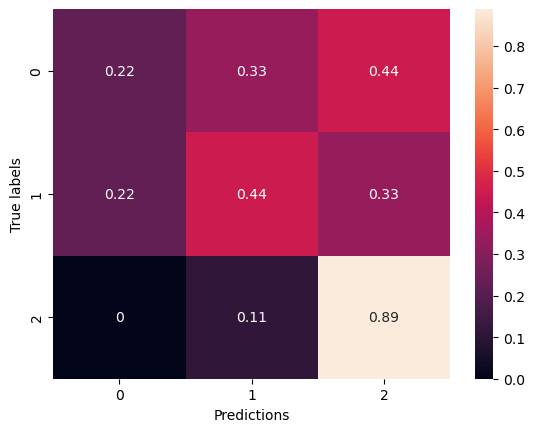

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▇▇▇▇██▇█▇████▇██▇█████████████▇▇██
training_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▄▅▇▆█▆▆▆█▆▆▅▅▆▆▆▅▅▆▆▅▇▆▇▅▇▅▆▄▅▆▃▆▆▃▃▇▆
val_loss,█▆▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 13:37:05.542925: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:37:05.544518: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:37:05.546720: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:37:07.156810: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:37:07.159134: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:37:07.161078: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:37:12.117439: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:37:12.696944: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 42.9271 - accuracy: 0.3904

2024-03-12 13:37:16.194993: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:37:16.196608: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:37:16.198773: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 190ms/step - loss: 42.9271 - accuracy: 0.3904 - val_loss: 37.6965 - val_accuracy: 0.2870
Epoch 2/100
14/14 [==============================] - 1s 71ms/step - loss: 33.9294 - accuracy: 0.5776 - val_loss: 30.0771 - val_accuracy: 0.2407
Epoch 3/100
14/14 [==============================] - 1s 72ms/step - loss: 26.8098 - accuracy: 0.6575 - val_loss: 23.8248 - val_accuracy: 0.3889
Epoch 4/100
14/14 [==============================] - 1s 72ms/step - loss: 21.0847 - accuracy: 0.7329 - val_loss: 19.1280 - val_accuracy: 0.3148
Epoch 5/100
14/14 [==============================] - 1s 71ms/step - loss: 16.7391 - accuracy: 0.7603 - val_loss: 15.4408 - val_accuracy: 0.3704
Epoch 6/100
14/14 [==============================] - 1s 73ms/step - loss: 13.4213 - accuracy: 0.7900 - val_loss: 12.6992 - val_accuracy: 0.3426
Epoch 7/100
14/14 [==============================] - 1s 71ms/step - loss: 10.8110 - accuracy: 0.8516 - val_loss: 10.5361 - val_accuracy: 0.4167
Ep

14/14 [==============================] - 1s 72ms/step - loss: 0.9480 - accuracy: 0.9224 - val_loss: 4.0141 - val_accuracy: 0.4074
Epoch 59/100
14/14 [==============================] - 1s 72ms/step - loss: 0.9335 - accuracy: 0.9406 - val_loss: 3.5529 - val_accuracy: 0.3981
Epoch 60/100
14/14 [==============================] - 1s 72ms/step - loss: 0.9132 - accuracy: 0.9429 - val_loss: 4.0309 - val_accuracy: 0.4259
Epoch 61/100
14/14 [==============================] - 1s 72ms/step - loss: 0.8819 - accuracy: 0.9384 - val_loss: 3.0248 - val_accuracy: 0.5648
Epoch 62/100
14/14 [==============================] - 1s 71ms/step - loss: 0.8777 - accuracy: 0.9406 - val_loss: 3.7330 - val_accuracy: 0.4815
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 0.8869 - accuracy: 0.9384 - val_loss: 3.7853 - val_accuracy: 0.4444
Epoch 64/100
14/14 [==============================] - 1s 72ms/step - loss: 0.9847 - accuracy: 0.9178 - val_loss: 3.6425 - val_accuracy: 0.3796
Epoch 65/100

2024-03-12 13:38:56.893621: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:38:56.895715: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:38:56.897228: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.466369867324829 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '2': {'precision': 0.6363636363636364, 'recall': 0.7777777777777778, 'f1-score': 0.7000000000000001, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5676767676767677, 'recall': 0.5555555555555555, 'f1-score': 0.5514619883040935, 'support': 27}, 'weighted avg': {'precision': 0.5676767676767677, 'recall': 0.5555555555555556, 'f1-score': 0.5514619883040935, 'support': 27}}


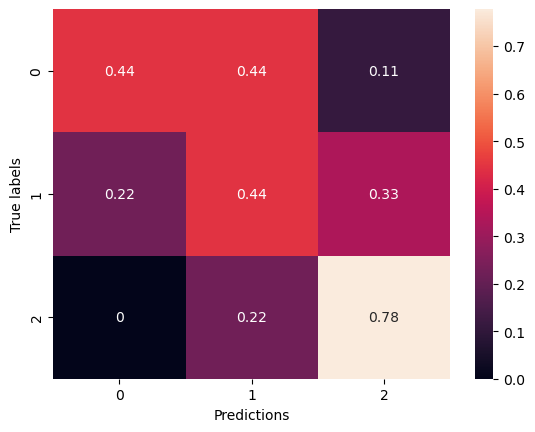

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▇▇▇▇██▇████████▇▇█▇███▇██████████████
training_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▃▂▇▆▅▇▄▄▇▆▅▇▅▇▆█▂▇▅▅▃▄▃▇▃▃▆▆▆▂▄▅▆▄▇▃▆▅▄
val_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 13:39:18.971164: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:39:18.972806: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:39:18.974799: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:39:20.596022: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:39:20.598361: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:39:20.600299: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:39:24.752717: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:39:25.338243: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 7.8872 - accuracy: 0.4018

2024-03-12 13:39:28.858870: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:39:28.860448: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:39:28.862457: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 188ms/step - loss: 7.8872 - accuracy: 0.4018 - val_loss: 7.5300 - val_accuracy: 0.1296
Epoch 2/100
14/14 [==============================] - 1s 71ms/step - loss: 7.4398 - accuracy: 0.4406 - val_loss: 7.3457 - val_accuracy: 0.1296
Epoch 3/100
14/14 [==============================] - 1s 72ms/step - loss: 6.8621 - accuracy: 0.5571 - val_loss: 7.1697 - val_accuracy: 0.1296
Epoch 4/100
14/14 [==============================] - 1s 72ms/step - loss: 6.4980 - accuracy: 0.5685 - val_loss: 6.9375 - val_accuracy: 0.1574
Epoch 5/100
14/14 [==============================] - 1s 71ms/step - loss: 6.1067 - accuracy: 0.6301 - val_loss: 6.9441 - val_accuracy: 0.1667
Epoch 6/100
14/14 [==============================] - 1s 72ms/step - loss: 5.8012 - accuracy: 0.6644 - val_loss: 6.6102 - val_accuracy: 0.2407
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 5.5391 - accuracy: 0.6667 - val_loss: 5.8878 - val_accuracy: 0.3796
Epoch 8/100
14/1

14/14 [==============================] - 1s 71ms/step - loss: 0.9597 - accuracy: 0.9521 - val_loss: 4.0708 - val_accuracy: 0.5093
Epoch 59/100
14/14 [==============================] - 1s 72ms/step - loss: 0.8780 - accuracy: 0.9795 - val_loss: 3.6744 - val_accuracy: 0.5185
Epoch 60/100
14/14 [==============================] - 1s 79ms/step - loss: 0.8920 - accuracy: 0.9703 - val_loss: 4.2225 - val_accuracy: 0.5000
Epoch 61/100
14/14 [==============================] - 1s 72ms/step - loss: 0.8513 - accuracy: 0.9795 - val_loss: 4.1541 - val_accuracy: 0.4722
Epoch 62/100
14/14 [==============================] - 1s 70ms/step - loss: 0.8735 - accuracy: 0.9680 - val_loss: 4.4281 - val_accuracy: 0.4444
Epoch 63/100
14/14 [==============================] - 1s 71ms/step - loss: 0.8466 - accuracy: 0.9635 - val_loss: 3.2794 - val_accuracy: 0.5556
Epoch 64/100
14/14 [==============================] - 1s 71ms/step - loss: 0.8086 - accuracy: 0.9795 - val_loss: 3.9828 - val_accuracy: 0.4907
Epoch 65/100

2024-03-12 13:41:09.613164: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:41:09.615062: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:41:09.616969: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4787251949310303 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.7777777777777778, 'f1-score': 0.4666666666666666, 'support': 9}, 'accuracy': 0.2962962962962963, 'macro avg': {'precision': 0.2222222222222222, 'recall': 0.2962962962962963, 'f1-score': 0.2111111111111111, 'support': 27}, 'weighted avg': {'precision': 0.2222222222222222, 'recall': 0.2962962962962963, 'f1-score': 0.21111111111111108, 'support': 27}}


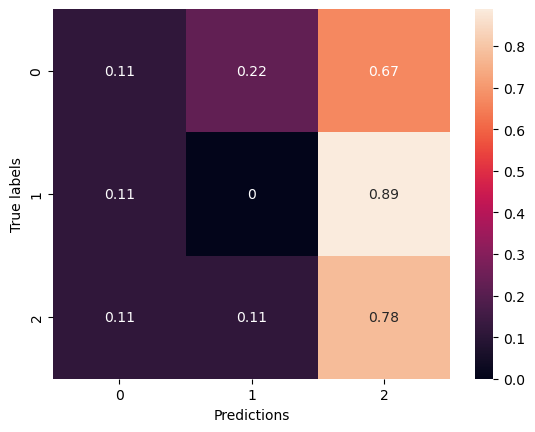

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▆▇▇▇▇▇█▇▇██████████████████████████
training_loss,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▃▃▄▆▆▆▆▆▇▅▆▇▇▅██▆▇██▆▆▆▆▆▇▅▆▆▇▆▆▆▇▆▅▅▇
val_loss,█▇▆▆▆▄▄▄▃▄▃▅▃▃▂▃▂▁▂▂▂▁▃▂▂▂▂▁▂▂▂▁▁▂▁▁▁▂▂▂


Epoch 1/100


2024-03-12 13:41:35.380850: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:41:35.382477: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:41:35.384365: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:41:37.000795: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:41:37.003261: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:41:37.004924: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:41:41.154849: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:41:41.734571: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 31.8439 - accuracy: 0.3516

2024-03-12 13:41:45.346528: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:41:45.348750: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:41:45.350459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 188ms/step - loss: 31.8439 - accuracy: 0.3516 - val_loss: 28.7767 - val_accuracy: 0.1944
Epoch 2/100
14/14 [==============================] - 1s 77ms/step - loss: 26.6738 - accuracy: 0.4863 - val_loss: 24.4088 - val_accuracy: 0.1019
Epoch 3/100
14/14 [==============================] - 1s 71ms/step - loss: 22.3881 - accuracy: 0.5228 - val_loss: 20.7558 - val_accuracy: 0.1296
Epoch 4/100
14/14 [==============================] - 1s 73ms/step - loss: 18.8979 - accuracy: 0.5388 - val_loss: 17.9369 - val_accuracy: 0.1481
Epoch 5/100
14/14 [==============================] - 1s 73ms/step - loss: 15.9181 - accuracy: 0.6735 - val_loss: 15.3425 - val_accuracy: 0.2037
Epoch 6/100
14/14 [==============================] - 1s 72ms/step - loss: 13.5246 - accuracy: 0.6804 - val_loss: 13.3114 - val_accuracy: 0.2315
Epoch 7/100
14/14 [==============================] - 1s 71ms/step - loss: 11.5985 - accuracy: 0.6963 - val_loss: 11.2897 - val_accuracy: 0.3889
Ep

14/14 [==============================] - 1s 71ms/step - loss: 0.8991 - accuracy: 0.9292 - val_loss: 3.3394 - val_accuracy: 0.4907
Epoch 59/100
14/14 [==============================] - 1s 72ms/step - loss: 0.8935 - accuracy: 0.9406 - val_loss: 4.8582 - val_accuracy: 0.3426
Epoch 60/100
14/14 [==============================] - 1s 71ms/step - loss: 0.9353 - accuracy: 0.9292 - val_loss: 3.5616 - val_accuracy: 0.4722
Epoch 61/100
14/14 [==============================] - 1s 75ms/step - loss: 0.9083 - accuracy: 0.9406 - val_loss: 3.6307 - val_accuracy: 0.4630
Epoch 62/100
14/14 [==============================] - 1s 73ms/step - loss: 0.8908 - accuracy: 0.9429 - val_loss: 3.0872 - val_accuracy: 0.5370
Epoch 63/100
14/14 [==============================] - 1s 73ms/step - loss: 0.8426 - accuracy: 0.9543 - val_loss: 3.0049 - val_accuracy: 0.5648
Epoch 64/100
14/14 [==============================] - 1s 71ms/step - loss: 0.8482 - accuracy: 0.9475 - val_loss: 3.0857 - val_accuracy: 0.5556
Epoch 65/100

2024-03-12 13:43:26.350123: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:43:26.352470: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:43:26.354118: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4670960903167725 s
{'0': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '1': {'precision': 0.36363636363636365, 'recall': 0.4444444444444444, 'f1-score': 0.39999999999999997, 'support': 9}, '2': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.40606060606060607, 'recall': 0.40740740740740744, 'f1-score': 0.3952380952380952, 'support': 27}, 'weighted avg': {'precision': 0.4060606060606061, 'recall': 0.4074074074074074, 'f1-score': 0.3952380952380952, 'support': 27}}


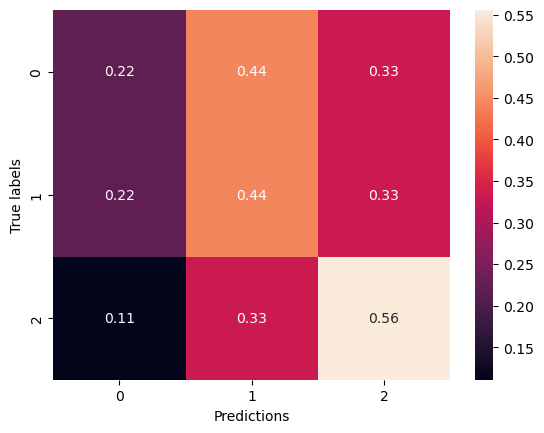

wandb: Network error (ConnectTimeout), entering retry loop.
wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇███▇████████▇██▇▇██████
training_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▄▆▄▅▅▆▆▇▇▇▇█▆▆▆▇▆▄▇▇▄▆▇█▇▅█▃▇█▅█▆▄▇▆▇
val_loss,█▆▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 13:49:06.645280: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:49:06.647003: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:49:06.648987: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:49:08.272620: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:49:08.274440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:49:08.276494: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:49:13.414788: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:49:13.992475: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 43.1184 - accuracy: 0.3539

2024-03-12 13:49:17.465365: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:49:17.467148: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:49:17.468926: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 187ms/step - loss: 43.1184 - accuracy: 0.3539 - val_loss: 38.2514 - val_accuracy: 0.1574
Epoch 2/100
14/14 [==============================] - 1s 71ms/step - loss: 34.8208 - accuracy: 0.4543 - val_loss: 31.1895 - val_accuracy: 0.1296
Epoch 3/100
14/14 [==============================] - 1s 71ms/step - loss: 28.1919 - accuracy: 0.5228 - val_loss: 25.3324 - val_accuracy: 0.2037
Epoch 4/100
14/14 [==============================] - 1s 71ms/step - loss: 22.7764 - accuracy: 0.6164 - val_loss: 20.8277 - val_accuracy: 0.2037
Epoch 5/100
14/14 [==============================] - 1s 72ms/step - loss: 18.6472 - accuracy: 0.6164 - val_loss: 17.2532 - val_accuracy: 0.2315
Epoch 6/100
14/14 [==============================] - 1s 71ms/step - loss: 15.3185 - accuracy: 0.6347 - val_loss: 14.3400 - val_accuracy: 0.3056
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 12.6871 - accuracy: 0.6963 - val_loss: 12.0222 - val_accuracy: 0.4167
Ep

14/14 [==============================] - 1s 71ms/step - loss: 1.0143 - accuracy: 0.9155 - val_loss: 3.3210 - val_accuracy: 0.4537
Epoch 59/100
14/14 [==============================] - 1s 70ms/step - loss: 0.9432 - accuracy: 0.9612 - val_loss: 3.2390 - val_accuracy: 0.5370
Epoch 60/100
14/14 [==============================] - 1s 71ms/step - loss: 0.9922 - accuracy: 0.9406 - val_loss: 3.4968 - val_accuracy: 0.4815
Epoch 61/100
14/14 [==============================] - 1s 71ms/step - loss: 1.0116 - accuracy: 0.9201 - val_loss: 3.4675 - val_accuracy: 0.5556
Epoch 62/100
14/14 [==============================] - 1s 71ms/step - loss: 0.9398 - accuracy: 0.9429 - val_loss: 3.5804 - val_accuracy: 0.4537
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 0.9067 - accuracy: 0.9475 - val_loss: 2.9690 - val_accuracy: 0.5370
Epoch 64/100
14/14 [==============================] - 1s 71ms/step - loss: 0.9252 - accuracy: 0.9406 - val_loss: 3.2517 - val_accuracy: 0.4907
Epoch 65/100

2024-03-12 13:50:57.682017: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:50:57.684151: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:50:57.685752: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4809370040893555 s
{'0': {'precision': 0.5714285714285714, 'recall': 0.8888888888888888, 'f1-score': 0.6956521739130435, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '2': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.7056277056277057, 'recall': 0.5925925925925926, 'f1-score': 0.5530961791831356, 'support': 27}, 'weighted avg': {'precision': 0.7056277056277056, 'recall': 0.5925925925925926, 'f1-score': 0.5530961791831357, 'support': 27}}


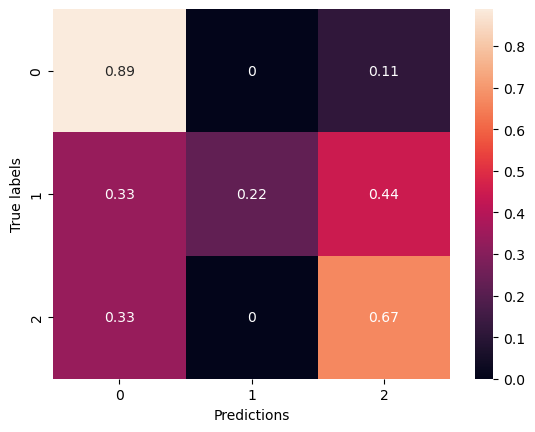

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▇▆▇▇▇▇▇█▇▇▇▇▇▇▇███▇█▇▇█▇▇█▇▇▇▇▇███
training_loss,█▆▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▃▄▅▅▄▇█▅█▇▇▅▅▇▇▇▅▅▆▇▇▇▇▆▇▆▆█▆▆▆▆█▅▆▇▅▅
val_loss,█▅▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 13:51:20.518393: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:51:20.522341: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:51:20.523988: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:51:22.142046: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:51:22.143751: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:51:22.145947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:51:26.298474: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:51:26.884906: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 8.1552 - accuracy: 0.3242

2024-03-12 13:51:30.361426: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:51:30.363003: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:51:30.366748: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 187ms/step - loss: 8.1552 - accuracy: 0.3242 - val_loss: 7.6519 - val_accuracy: 0.1296
Epoch 2/100
14/14 [==============================] - 1s 72ms/step - loss: 7.6303 - accuracy: 0.3995 - val_loss: 7.3921 - val_accuracy: 0.1296
Epoch 3/100
14/14 [==============================] - 1s 72ms/step - loss: 7.2608 - accuracy: 0.3950 - val_loss: 7.2070 - val_accuracy: 0.1389
Epoch 4/100
14/14 [==============================] - 1s 70ms/step - loss: 6.9141 - accuracy: 0.4361 - val_loss: 6.9193 - val_accuracy: 0.1574
Epoch 5/100
14/14 [==============================] - 1s 71ms/step - loss: 6.6684 - accuracy: 0.4589 - val_loss: 6.9073 - val_accuracy: 0.1204
Epoch 6/100
14/14 [==============================] - 1s 71ms/step - loss: 6.5241 - accuracy: 0.4178 - val_loss: 6.7502 - val_accuracy: 0.1296
Epoch 7/100
14/14 [==============================] - 1s 71ms/step - loss: 6.2620 - accuracy: 0.4703 - val_loss: 6.4442 - val_accuracy: 0.2130
Epoch 8/100
14/1

14/14 [==============================] - 1s 70ms/step - loss: 1.3063 - accuracy: 0.9110 - val_loss: 3.5976 - val_accuracy: 0.5185
Epoch 59/100
14/14 [==============================] - 1s 71ms/step - loss: 1.2269 - accuracy: 0.9452 - val_loss: 3.6525 - val_accuracy: 0.5093
Epoch 60/100
14/14 [==============================] - 1s 72ms/step - loss: 1.2268 - accuracy: 0.9224 - val_loss: 3.4850 - val_accuracy: 0.5648
Epoch 61/100
14/14 [==============================] - 1s 72ms/step - loss: 1.2916 - accuracy: 0.8950 - val_loss: 3.6106 - val_accuracy: 0.5185
Epoch 62/100
14/14 [==============================] - 1s 71ms/step - loss: 1.2004 - accuracy: 0.9315 - val_loss: 4.3412 - val_accuracy: 0.4444
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 1.1650 - accuracy: 0.9292 - val_loss: 3.4096 - val_accuracy: 0.5648
Epoch 64/100
14/14 [==============================] - 1s 70ms/step - loss: 1.0887 - accuracy: 0.9589 - val_loss: 3.6719 - val_accuracy: 0.5463
Epoch 65/100

2024-03-12 13:53:11.877539: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:53:11.879337: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:53:11.881114: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.413012981414795 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3333333333333333, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.8888888888888888, 'f1-score': 0.5925925925925926, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.25925925925925924, 'recall': 0.4074074074074074, 'f1-score': 0.30864197530864196, 'support': 27}, 'weighted avg': {'precision': 0.25925925925925924, 'recall': 0.4074074074074074, 'f1-score': 0.30864197530864196, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


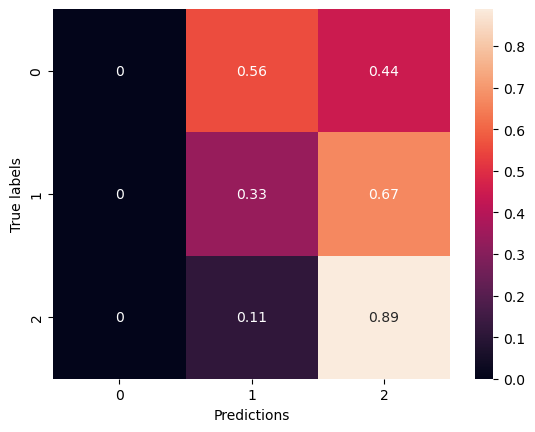

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▃▄▄▄▄▅▅▅▆▆▆▆▇▇▇▇▇▇▇█▇███████████████
training_loss,█▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▃▅▆▆▇█▆▇▅▅▆▇▇▇▇█▆▇█▆▆▇▅▅▅▄▇▆█▇▇▆▄▆▇▇
val_loss,█▇▇▆▆▅▅▄▄▃▃▃▄▄▂▁▂▁▁▁▂▁▁▂▂▂▃▂▂▃▂▂▁▁▁▃▄▂▁▁


Epoch 1/100


2024-03-12 13:53:36.541873: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:53:36.544152: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:53:36.545764: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:53:38.156622: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:53:38.158367: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:53:38.160670: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:53:42.336908: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:53:42.916032: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 31.7005 - accuracy: 0.3767

2024-03-12 13:53:46.419888: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:53:46.422056: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:53:46.423652: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 197ms/step - loss: 31.7005 - accuracy: 0.3767 - val_loss: 28.5261 - val_accuracy: 0.3981
Epoch 2/100
14/14 [==============================] - 1s 72ms/step - loss: 26.9851 - accuracy: 0.3790 - val_loss: 24.5100 - val_accuracy: 0.3056
Epoch 3/100
14/14 [==============================] - 1s 72ms/step - loss: 23.0549 - accuracy: 0.4269 - val_loss: 21.2072 - val_accuracy: 0.2315
Epoch 4/100
14/14 [==============================] - 1s 73ms/step - loss: 19.8731 - accuracy: 0.4566 - val_loss: 18.3806 - val_accuracy: 0.2500
Epoch 5/100
14/14 [==============================] - 1s 73ms/step - loss: 17.2193 - accuracy: 0.4749 - val_loss: 16.0870 - val_accuracy: 0.2407
Epoch 6/100
14/14 [==============================] - 1s 71ms/step - loss: 14.9792 - accuracy: 0.4863 - val_loss: 14.1224 - val_accuracy: 0.2500
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 13.1170 - accuracy: 0.5342 - val_loss: 12.6430 - val_accuracy: 0.2778
Ep

14/14 [==============================] - 1s 71ms/step - loss: 1.0875 - accuracy: 0.9110 - val_loss: 3.9037 - val_accuracy: 0.3981
Epoch 59/100
14/14 [==============================] - 1s 72ms/step - loss: 1.0620 - accuracy: 0.9064 - val_loss: 3.1154 - val_accuracy: 0.5278
Epoch 60/100
14/14 [==============================] - 1s 72ms/step - loss: 1.0840 - accuracy: 0.9064 - val_loss: 2.9469 - val_accuracy: 0.5370
Epoch 61/100
14/14 [==============================] - 1s 73ms/step - loss: 1.1102 - accuracy: 0.8904 - val_loss: 3.8147 - val_accuracy: 0.4444
Epoch 62/100
14/14 [==============================] - 1s 71ms/step - loss: 1.0284 - accuracy: 0.9064 - val_loss: 3.2638 - val_accuracy: 0.4722
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 1.0477 - accuracy: 0.8927 - val_loss: 2.6886 - val_accuracy: 0.5648
Epoch 64/100
14/14 [==============================] - 1s 71ms/step - loss: 1.0653 - accuracy: 0.8973 - val_loss: 5.5470 - val_accuracy: 0.3333
Epoch 65/100

2024-03-12 13:55:27.004371: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:55:27.006521: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:55:27.008239: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5560030937194824 s
{'0': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.4444444444444444, 'f1-score': 0.6153846153846153, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6555555555555556, 'recall': 0.5555555555555555, 'f1-score': 0.5564353946706887, 'support': 27}, 'weighted avg': {'precision': 0.6555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5564353946706887, 'support': 27}}


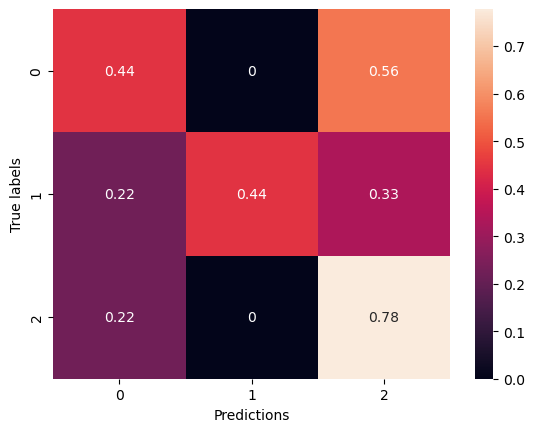

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▃▄▅▅▅▅▆▆▆▇▇▇▆▇▇█▇██▇▇▇███▇████▇█████
training_loss,█▆▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▁▁▄▅▇▄▇▆▇▇▃▇▆▆▁▅▆▇▄█▇▆▅▃▃▇▆▅▄▆▄▇▆▆▃▃▃▇
val_loss,█▆▄▃▂▂▂▂▁▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 13:55:50.654290: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:55:50.655943: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:55:50.657732: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:55:52.281857: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:55:52.284968: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:55:52.286951: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 13:55:57.288452: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 13:55:57.874866: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 43.4605 - accuracy: 0.3447

2024-03-12 13:56:01.362123: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:56:01.363563: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:56:01.365651: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 187ms/step - loss: 43.4605 - accuracy: 0.3447 - val_loss: 38.6801 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 1s 71ms/step - loss: 35.9351 - accuracy: 0.3904 - val_loss: 32.1919 - val_accuracy: 0.1667
Epoch 3/100
14/14 [==============================] - 1s 77ms/step - loss: 29.8171 - accuracy: 0.4361 - val_loss: 26.9268 - val_accuracy: 0.2130
Epoch 4/100
14/14 [==============================] - 1s 72ms/step - loss: 24.9085 - accuracy: 0.4680 - val_loss: 22.7469 - val_accuracy: 0.1389
Epoch 5/100
14/14 [==============================] - 1s 71ms/step - loss: 21.0213 - accuracy: 0.4155 - val_loss: 19.3862 - val_accuracy: 0.1389
Epoch 6/100
14/14 [==============================] - 1s 73ms/step - loss: 17.7461 - accuracy: 0.5000 - val_loss: 16.5357 - val_accuracy: 0.2222
Epoch 7/100
14/14 [==============================] - 1s 71ms/step - loss: 15.1760 - accuracy: 0.4932 - val_loss: 14.4757 - val_accuracy: 0.1759
Ep

14/14 [==============================] - 1s 71ms/step - loss: 1.2339 - accuracy: 0.8881 - val_loss: 2.9321 - val_accuracy: 0.5833
Epoch 59/100
14/14 [==============================] - 1s 72ms/step - loss: 1.1106 - accuracy: 0.9338 - val_loss: 4.5131 - val_accuracy: 0.3056
Epoch 60/100
14/14 [==============================] - 1s 77ms/step - loss: 1.1097 - accuracy: 0.9269 - val_loss: 2.9954 - val_accuracy: 0.6111
Epoch 61/100
14/14 [==============================] - 1s 71ms/step - loss: 1.1286 - accuracy: 0.8995 - val_loss: 5.0143 - val_accuracy: 0.3241
Epoch 62/100
14/14 [==============================] - 1s 71ms/step - loss: 1.1832 - accuracy: 0.8744 - val_loss: 2.9585 - val_accuracy: 0.5741
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 1.1851 - accuracy: 0.8836 - val_loss: 3.2548 - val_accuracy: 0.5370
Epoch 64/100
14/14 [==============================] - 1s 71ms/step - loss: 1.1411 - accuracy: 0.9087 - val_loss: 3.5345 - val_accuracy: 0.5000
Epoch 65/100

2024-03-12 13:57:43.536030: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 13:57:43.537581: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 13:57:43.539901: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4691979885101318 s
{'0': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '1': {'precision': 0.4117647058823529, 'recall': 0.7777777777777778, 'f1-score': 0.5384615384615384, 'support': 9}, '2': {'precision': 0.625, 'recall': 0.5555555555555556, 'f1-score': 0.5882352941176471, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.6789215686274509, 'recall': 0.5185185185185185, 'f1-score': 0.4967777320718498, 'support': 27}, 'weighted avg': {'precision': 0.6789215686274509, 'recall': 0.5185185185185185, 'f1-score': 0.4967777320718497, 'support': 27}}


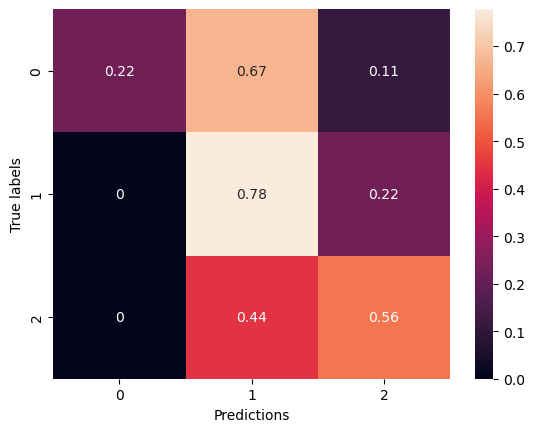

wandb: Network error (TransientError), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇█▇█▇███████▇███▇██▇
training_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▂▂▅▅▆▆▆▅▆▇▇▅▇▇▆▇▇▇▇▇▄▃▄▆▇▅▃▇█▇▆▆▆▆█▅▆▅
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:00:38.534346: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:00:38.535982: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:00:38.538305: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:00:40.202929: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:00:40.205012: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:00:40.207417: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:00:44.522830: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:00:45.804753: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 9.1232 - accuracy: 0.4315

2024-03-12 14:00:49.439679: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:00:49.441371: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:00:49.443345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 196ms/step - loss: 9.1232 - accuracy: 0.4315 - val_loss: 8.5748 - val_accuracy: 0.2963
Epoch 2/100
14/14 [==============================] - 1s 79ms/step - loss: 8.3591 - accuracy: 0.5297 - val_loss: 8.2655 - val_accuracy: 0.2963
Epoch 3/100
14/14 [==============================] - 1s 78ms/step - loss: 7.8621 - accuracy: 0.6050 - val_loss: 7.8134 - val_accuracy: 0.3611
Epoch 4/100
14/14 [==============================] - 1s 79ms/step - loss: 7.3362 - accuracy: 0.6416 - val_loss: 7.4715 - val_accuracy: 0.4167
Epoch 5/100
14/14 [==============================] - 1s 78ms/step - loss: 6.8435 - accuracy: 0.7215 - val_loss: 7.2790 - val_accuracy: 0.3704
Epoch 6/100
14/14 [==============================] - 1s 79ms/step - loss: 6.4203 - accuracy: 0.7694 - val_loss: 6.8830 - val_accuracy: 0.4259
Epoch 7/100
14/14 [==============================] - 1s 79ms/step - loss: 6.0872 - accuracy: 0.7831 - val_loss: 6.7551 - val_accuracy: 0.3611
Epoch 8/100
14/1

14/14 [==============================] - 1s 80ms/step - loss: 0.9072 - accuracy: 0.9658 - val_loss: 4.5256 - val_accuracy: 0.4167
Epoch 59/100
14/14 [==============================] - 1s 78ms/step - loss: 0.8916 - accuracy: 0.9749 - val_loss: 5.1659 - val_accuracy: 0.3981
Epoch 60/100
14/14 [==============================] - 1s 78ms/step - loss: 0.8971 - accuracy: 0.9635 - val_loss: 4.0995 - val_accuracy: 0.4722
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 0.8511 - accuracy: 0.9680 - val_loss: 4.0157 - val_accuracy: 0.5556
Epoch 62/100
14/14 [==============================] - 1s 78ms/step - loss: 0.8507 - accuracy: 0.9726 - val_loss: 4.4333 - val_accuracy: 0.4444
Epoch 63/100
14/14 [==============================] - 1s 83ms/step - loss: 0.8348 - accuracy: 0.9703 - val_loss: 4.2923 - val_accuracy: 0.4907
Epoch 64/100
14/14 [==============================] - 1s 79ms/step - loss: 0.8624 - accuracy: 0.9703 - val_loss: 4.0920 - val_accuracy: 0.4907
Epoch 65/100

2024-03-12 14:02:39.992082: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:02:39.993650: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:02:39.995685: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4676239490509033 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5333333333333333, 'recall': 0.5185185185185185, 'f1-score': 0.5095238095238095, 'support': 27}, 'weighted avg': {'precision': 0.5333333333333333, 'recall': 0.5185185185185185, 'f1-score': 0.5095238095238095, 'support': 27}}


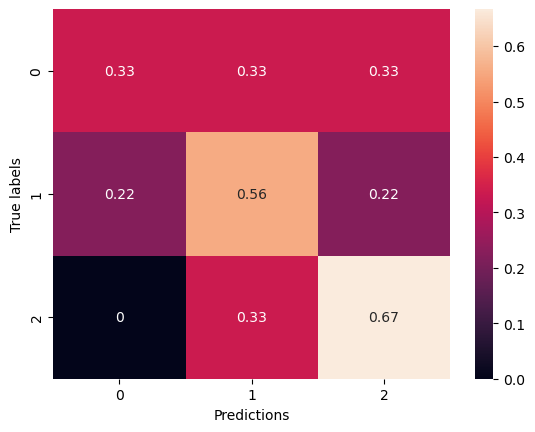

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▇▇▇▇█▇███▇██████████████████████████
training_loss,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▄▅▅▅▅▇█▆▆▇█▅▇▇▇▆▅▆▆▄▅▃▆▅▅▆▅▅▆▅▆▆▄▄▅▅▅▄
val_loss,█▇▆▅▄▅▄▄▃▃▃▃▂▃▂▂▂▂▃▂▃▃▂▄▂▂▁▁▂▁▂▂▂▁▂▂▂▂▂▂


Epoch 1/100


2024-03-12 14:03:03.108863: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:03:03.110466: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:03:03.112665: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:03:04.712388: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:03:04.714261: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:03:04.716313: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:03:08.848309: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:03:09.429242: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 37.8532 - accuracy: 0.3904

2024-03-12 14:03:12.990693: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:03:12.992276: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:03:12.994334: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 194ms/step - loss: 37.8532 - accuracy: 0.3904 - val_loss: 34.0404 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 81ms/step - loss: 31.1531 - accuracy: 0.6096 - val_loss: 28.4858 - val_accuracy: 0.1574
Epoch 3/100
14/14 [==============================] - 1s 80ms/step - loss: 25.7469 - accuracy: 0.6507 - val_loss: 23.8337 - val_accuracy: 0.1296
Epoch 4/100
14/14 [==============================] - 1s 109ms/step - loss: 21.2964 - accuracy: 0.6689 - val_loss: 19.8722 - val_accuracy: 0.1574
Epoch 5/100
14/14 [==============================] - 1s 80ms/step - loss: 17.7523 - accuracy: 0.7078 - val_loss: 16.6912 - val_accuracy: 0.2963
Epoch 6/100
14/14 [==============================] - 1s 79ms/step - loss: 14.8099 - accuracy: 0.7557 - val_loss: 14.1272 - val_accuracy: 0.3148
Epoch 7/100
14/14 [==============================] - 1s 79ms/step - loss: 12.4364 - accuracy: 0.8082 - val_loss: 12.0740 - val_accuracy: 0.4074
E

14/14 [==============================] - 1s 80ms/step - loss: 0.9854 - accuracy: 0.9475 - val_loss: 4.0595 - val_accuracy: 0.4074
Epoch 59/100
14/14 [==============================] - 1s 79ms/step - loss: 0.9863 - accuracy: 0.9384 - val_loss: 3.3171 - val_accuracy: 0.5278
Epoch 60/100
14/14 [==============================] - 1s 79ms/step - loss: 0.9435 - accuracy: 0.9429 - val_loss: 3.3247 - val_accuracy: 0.5833
Epoch 61/100
14/14 [==============================] - 1s 81ms/step - loss: 0.9369 - accuracy: 0.9543 - val_loss: 4.0736 - val_accuracy: 0.4352
Epoch 62/100
14/14 [==============================] - 1s 80ms/step - loss: 0.8591 - accuracy: 0.9726 - val_loss: 3.3254 - val_accuracy: 0.6296
Epoch 63/100
14/14 [==============================] - 1s 79ms/step - loss: 0.8609 - accuracy: 0.9589 - val_loss: 4.5757 - val_accuracy: 0.3796
Epoch 64/100
14/14 [==============================] - 1s 80ms/step - loss: 0.8626 - accuracy: 0.9521 - val_loss: 3.2420 - val_accuracy: 0.5648
Epoch 65/100

2024-03-12 14:05:05.397475: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:05:05.399183: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:05:05.401099: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4603939056396484 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, '2': {'precision': 0.6, 'recall': 0.6666666666666666, 'f1-score': 0.631578947368421, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5888888888888889, 'recall': 0.5555555555555555, 'f1-score': 0.5245359776252224, 'support': 27}, 'weighted avg': {'precision': 0.5888888888888888, 'recall': 0.5555555555555556, 'f1-score': 0.5245359776252225, 'support': 27}}


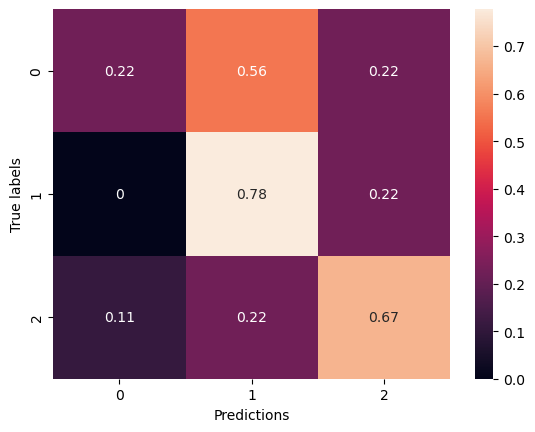

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇▇▇▇▇▇▇▇▇███▇███▇██████▇███▇███▇██
training_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▄▄██▆▆▇▆▇▅▇▆▇▅▇▅▅▇▆▅▇▆▅▇▆▄▅▆▆▅▇▆▇█▅▆▅▅
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:05:28.145257: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:05:28.147507: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:05:28.149252: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:05:30.683747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:05:30.686200: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:05:30.688027: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:05:34.861418: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:05:35.440471: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 51.5202 - accuracy: 0.4247

2024-03-12 14:05:39.010578: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:05:39.012177: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:05:39.014139: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 196ms/step - loss: 51.5202 - accuracy: 0.4247 - val_loss: 45.5397 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 1s 79ms/step - loss: 41.1480 - accuracy: 0.5479 - val_loss: 36.7398 - val_accuracy: 0.1389
Epoch 3/100
14/14 [==============================] - 1s 79ms/step - loss: 32.8780 - accuracy: 0.5708 - val_loss: 29.4327 - val_accuracy: 0.2037
Epoch 4/100
14/14 [==============================] - 1s 79ms/step - loss: 26.1629 - accuracy: 0.7146 - val_loss: 23.7892 - val_accuracy: 0.1944
Epoch 5/100
14/14 [==============================] - 1s 80ms/step - loss: 21.1282 - accuracy: 0.6872 - val_loss: 19.5948 - val_accuracy: 0.2037
Epoch 6/100
14/14 [==============================] - 1s 79ms/step - loss: 17.0464 - accuracy: 0.7443 - val_loss: 16.1299 - val_accuracy: 0.2500
Epoch 7/100
14/14 [==============================] - 1s 78ms/step - loss: 13.8842 - accuracy: 0.7854 - val_loss: 13.4241 - val_accuracy: 0.2778
Ep

14/14 [==============================] - 1s 80ms/step - loss: 0.9725 - accuracy: 0.9429 - val_loss: 4.3891 - val_accuracy: 0.3981
Epoch 59/100
14/14 [==============================] - 1s 79ms/step - loss: 1.0727 - accuracy: 0.9064 - val_loss: 3.1695 - val_accuracy: 0.5741
Epoch 60/100
14/14 [==============================] - 1s 79ms/step - loss: 1.1165 - accuracy: 0.9247 - val_loss: 3.5343 - val_accuracy: 0.5648
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 1.1743 - accuracy: 0.9178 - val_loss: 2.9206 - val_accuracy: 0.5648
Epoch 62/100
14/14 [==============================] - 1s 83ms/step - loss: 1.0206 - accuracy: 0.9612 - val_loss: 3.5030 - val_accuracy: 0.5370
Epoch 63/100
14/14 [==============================] - 1s 82ms/step - loss: 0.9277 - accuracy: 0.9772 - val_loss: 4.8696 - val_accuracy: 0.3611
Epoch 64/100
14/14 [==============================] - 1s 79ms/step - loss: 0.8887 - accuracy: 0.9680 - val_loss: 4.8507 - val_accuracy: 0.3148
Epoch 65/100

2024-03-12 14:07:30.476886: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:07:30.478962: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:07:30.480551: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4786059856414795 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.3888888888888889, 'recall': 0.7777777777777778, 'f1-score': 0.5185185185185185, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.6296296296296297, 'recall': 0.4444444444444444, 'f1-score': 0.39636891793754536, 'support': 27}, 'weighted avg': {'precision': 0.6296296296296297, 'recall': 0.4444444444444444, 'f1-score': 0.39636891793754536, 'support': 27}}


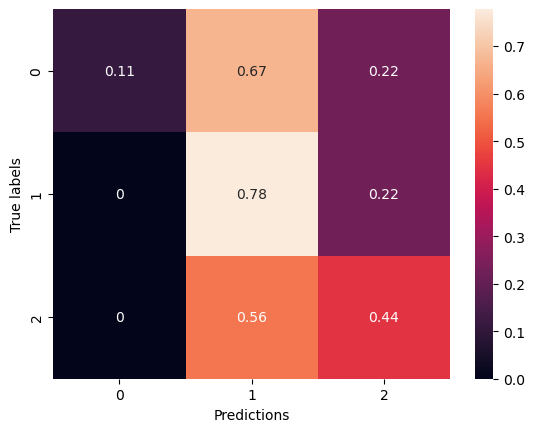

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▆▇▇▇▇▇▇▇█▇▇▇▇█▇▇▇█▇▇▇█▇▇█▇███▇▇███▇█
training_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▃▃▇▆▆▇▇▆▆▇▆▄▅▆▆▅▅▅█▆▄▇▇▃▇▆▅▆▅▆▆▃▆▄▅▆▅▄
val_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:07:52.168047: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:07:52.170438: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:07:52.172101: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:07:53.786248: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:07:53.788066: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:07:53.790217: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:07:58.792664: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:07:59.374301: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 9.3574 - accuracy: 0.3425

2024-03-12 14:08:02.991878: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:08:02.993635: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:08:02.995619: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 196ms/step - loss: 9.3574 - accuracy: 0.3425 - val_loss: 8.8455 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 79ms/step - loss: 8.7654 - accuracy: 0.4041 - val_loss: 8.5982 - val_accuracy: 0.1296
Epoch 3/100
14/14 [==============================] - 1s 79ms/step - loss: 8.2192 - accuracy: 0.4795 - val_loss: 8.3715 - val_accuracy: 0.1481
Epoch 4/100
14/14 [==============================] - 1s 79ms/step - loss: 7.7993 - accuracy: 0.5708 - val_loss: 8.0599 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 1s 79ms/step - loss: 7.4183 - accuracy: 0.5936 - val_loss: 7.7194 - val_accuracy: 0.2037
Epoch 6/100
14/14 [==============================] - 1s 79ms/step - loss: 7.1902 - accuracy: 0.5708 - val_loss: 7.4014 - val_accuracy: 0.2130
Epoch 7/100
14/14 [==============================] - 1s 80ms/step - loss: 6.8219 - accuracy: 0.5890 - val_loss: 7.1408 - val_accuracy: 0.2500
Epoch 8/100
14/1

14/14 [==============================] - 1s 79ms/step - loss: 1.1491 - accuracy: 0.9498 - val_loss: 3.3656 - val_accuracy: 0.5741
Epoch 59/100
14/14 [==============================] - 1s 79ms/step - loss: 1.1304 - accuracy: 0.9406 - val_loss: 3.4014 - val_accuracy: 0.5093
Epoch 60/100
14/14 [==============================] - 1s 79ms/step - loss: 1.1242 - accuracy: 0.9406 - val_loss: 3.5670 - val_accuracy: 0.5370
Epoch 61/100
14/14 [==============================] - 1s 80ms/step - loss: 1.0676 - accuracy: 0.9543 - val_loss: 3.5488 - val_accuracy: 0.6019
Epoch 62/100
14/14 [==============================] - 1s 79ms/step - loss: 1.0154 - accuracy: 0.9726 - val_loss: 3.0541 - val_accuracy: 0.6111
Epoch 63/100
14/14 [==============================] - 1s 80ms/step - loss: 0.9818 - accuracy: 0.9703 - val_loss: 4.4199 - val_accuracy: 0.3704
Epoch 64/100
14/14 [==============================] - 1s 79ms/step - loss: 0.9655 - accuracy: 0.9635 - val_loss: 4.4532 - val_accuracy: 0.3981
Epoch 65/100

2024-03-12 14:09:54.463440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:09:54.465704: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:09:54.467454: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4765090942382812 s
{'0': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3333333333333333, 'support': 9}, '2': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.4054834054834055, 'recall': 0.40740740740740744, 'f1-score': 0.40277777777777773, 'support': 27}, 'weighted avg': {'precision': 0.40548340548340545, 'recall': 0.4074074074074074, 'f1-score': 0.4027777777777778, 'support': 27}}


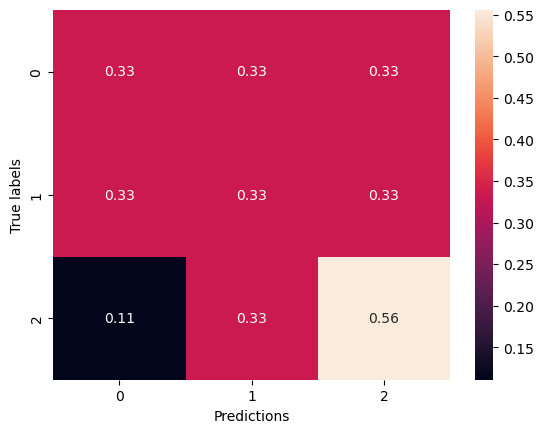

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▅▅▆▆▆▇▇▇▇▇▇███▇████████████████████▇
training_loss,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▃▆▆▅▇█▇▆█▇▇▇▇▆█▇▇▆▆▇▆█▅▆▆█▇▇▇▅▆█▆▇▆▄▆
val_loss,█▇▆▆▅▄▄▃▃▃▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▃▂▂▂▁▁▂▂▂▁▂▁▁▃▂


Epoch 1/100


2024-03-12 14:10:17.298062: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:10:17.300179: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:10:17.302010: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:10:18.901073: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:10:18.902899: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:10:18.904784: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:10:23.055286: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:10:23.642245: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 38.2885 - accuracy: 0.3539

2024-03-12 14:10:27.225177: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:10:27.226845: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:10:27.228898: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 203ms/step - loss: 38.2885 - accuracy: 0.3539 - val_loss: 34.6835 - val_accuracy: 0.1667
Epoch 2/100
14/14 [==============================] - 1s 79ms/step - loss: 32.3631 - accuracy: 0.4589 - val_loss: 29.6750 - val_accuracy: 0.1389
Epoch 3/100
14/14 [==============================] - 1s 79ms/step - loss: 27.5491 - accuracy: 0.5000 - val_loss: 25.3843 - val_accuracy: 0.1852
Epoch 4/100
14/14 [==============================] - 1s 79ms/step - loss: 23.5280 - accuracy: 0.5479 - val_loss: 22.0794 - val_accuracy: 0.1481
Epoch 5/100
14/14 [==============================] - 1s 87ms/step - loss: 20.3077 - accuracy: 0.5457 - val_loss: 19.0852 - val_accuracy: 0.2130
Epoch 6/100
14/14 [==============================] - 1s 80ms/step - loss: 17.4348 - accuracy: 0.5913 - val_loss: 16.7068 - val_accuracy: 0.2407
Epoch 7/100
14/14 [==============================] - 1s 79ms/step - loss: 15.1061 - accuracy: 0.6370 - val_loss: 14.6933 - val_accuracy: 0.2407
Ep

14/14 [==============================] - 1s 84ms/step - loss: 1.1184 - accuracy: 0.9452 - val_loss: 3.6948 - val_accuracy: 0.5000
Epoch 59/100
14/14 [==============================] - 1s 80ms/step - loss: 1.0896 - accuracy: 0.9269 - val_loss: 3.0247 - val_accuracy: 0.5926
Epoch 60/100
14/14 [==============================] - 1s 79ms/step - loss: 1.0448 - accuracy: 0.9315 - val_loss: 3.3793 - val_accuracy: 0.5370
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 1.0203 - accuracy: 0.9475 - val_loss: 3.6146 - val_accuracy: 0.5093
Epoch 62/100
14/14 [==============================] - 1s 79ms/step - loss: 1.0259 - accuracy: 0.9315 - val_loss: 3.8210 - val_accuracy: 0.5556
Epoch 63/100
14/14 [==============================] - 1s 79ms/step - loss: 1.0120 - accuracy: 0.9384 - val_loss: 3.9619 - val_accuracy: 0.4352
Epoch 64/100
14/14 [==============================] - 1s 79ms/step - loss: 1.0444 - accuracy: 0.9247 - val_loss: 3.6154 - val_accuracy: 0.4630
Epoch 65/100

2024-03-12 14:12:19.243923: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:12:19.246149: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:12:19.248190: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.366666078567505 s
{'0': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, '2': {'precision': 0.8333333333333334, 'recall': 0.5555555555555556, 'f1-score': 0.6666666666666667, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.6296296296296297, 'recall': 0.5925925925925927, 'f1-score': 0.5978835978835979, 'support': 27}, 'weighted avg': {'precision': 0.6296296296296297, 'recall': 0.5925925925925926, 'f1-score': 0.5978835978835979, 'support': 27}}


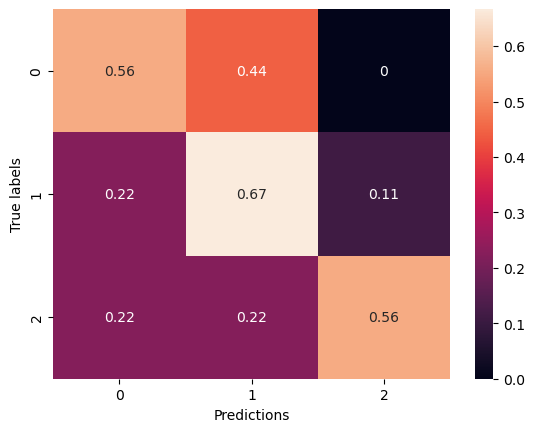

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▅▆▆▇▇▇▇▇▇▇▇█▇███▇██████▇███████████
training_loss,█▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▂▇▆▆▇▆▇▆▅▅█▆▇█▇▅▅█▄▃█▆▆▇▅▅▆█▄▄▅▅▆▇▆▇▆
val_loss,█▆▄▃▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:14:59.968858: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:14:59.971020: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:14:59.972562: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:15:01.669790: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:15:01.673542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:15:01.675760: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:15:05.847998: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:15:06.428784: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 51.7241 - accuracy: 0.3973

2024-03-12 14:15:10.013928: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:15:10.017281: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:15:10.019196: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 196ms/step - loss: 51.7241 - accuracy: 0.3973 - val_loss: 45.7855 - val_accuracy: 0.2315
Epoch 2/100
14/14 [==============================] - 1s 82ms/step - loss: 41.9610 - accuracy: 0.5046 - val_loss: 37.5758 - val_accuracy: 0.1389
Epoch 3/100
14/14 [==============================] - 1s 80ms/step - loss: 34.2197 - accuracy: 0.5114 - val_loss: 30.9444 - val_accuracy: 0.1389
Epoch 4/100
14/14 [==============================] - 1s 80ms/step - loss: 27.8401 - accuracy: 0.5708 - val_loss: 25.3776 - val_accuracy: 0.1759
Epoch 5/100
14/14 [==============================] - 1s 81ms/step - loss: 22.9325 - accuracy: 0.5594 - val_loss: 21.0614 - val_accuracy: 0.2593
Epoch 6/100
14/14 [==============================] - 1s 81ms/step - loss: 18.9495 - accuracy: 0.6347 - val_loss: 17.6365 - val_accuracy: 0.2778
Epoch 7/100
14/14 [==============================] - 1s 81ms/step - loss: 15.8626 - accuracy: 0.6575 - val_loss: 14.9180 - val_accuracy: 0.3426
Ep

14/14 [==============================] - 1s 81ms/step - loss: 1.1729 - accuracy: 0.9087 - val_loss: 3.9063 - val_accuracy: 0.3796
Epoch 59/100
14/14 [==============================] - 1s 78ms/step - loss: 1.1603 - accuracy: 0.9110 - val_loss: 3.6595 - val_accuracy: 0.4537
Epoch 60/100
14/14 [==============================] - 1s 79ms/step - loss: 1.1183 - accuracy: 0.9201 - val_loss: 3.5617 - val_accuracy: 0.4907
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 1.0875 - accuracy: 0.9292 - val_loss: 2.8293 - val_accuracy: 0.5093
Epoch 62/100
14/14 [==============================] - 1s 79ms/step - loss: 1.0767 - accuracy: 0.9406 - val_loss: 3.9727 - val_accuracy: 0.4167
Epoch 63/100
14/14 [==============================] - 1s 81ms/step - loss: 1.0999 - accuracy: 0.9041 - val_loss: 3.4033 - val_accuracy: 0.5648
Epoch 64/100
14/14 [==============================] - 1s 80ms/step - loss: 0.9928 - accuracy: 0.9521 - val_loss: 3.8152 - val_accuracy: 0.3889
Epoch 65/100

2024-03-12 14:17:04.311675: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:17:04.313812: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:17:04.315395: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.473008155822754 s
{'0': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '1': {'precision': 0.36363636363636365, 'recall': 0.4444444444444444, 'f1-score': 0.39999999999999997, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.51010101010101, 'recall': 0.48148148148148145, 'f1-score': 0.48654970760233923, 'support': 27}, 'weighted avg': {'precision': 0.5101010101010102, 'recall': 0.48148148148148145, 'f1-score': 0.4865497076023391, 'support': 27}}


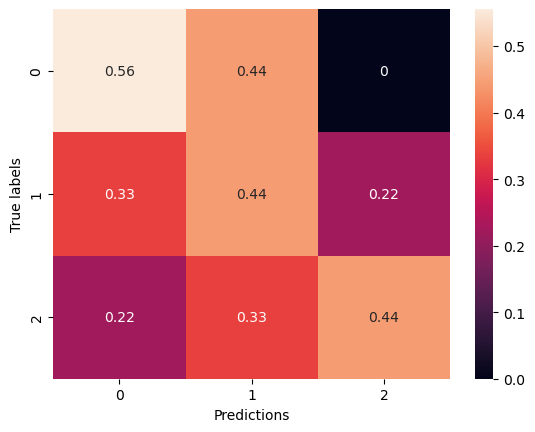

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▄▄▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇██▇█▇██████▇▇███▇▇███
training_loss,█▆▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▃▅▆▇▆▆█▇▆▅▆█▇█▆▅█▇▅▅▇▆▇▅▇▅▇▅▅▆▄█▇▇▄▄▅▅
val_loss,█▆▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:17:29.631232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:17:29.632729: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:17:29.634627: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:17:31.240158: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:17:31.242551: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:17:31.244635: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:17:36.268762: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:17:36.850787: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 9.4456 - accuracy: 0.3493

2024-03-12 14:17:40.426832: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:17:40.429227: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:17:40.430848: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 197ms/step - loss: 9.4456 - accuracy: 0.3493 - val_loss: 8.6506 - val_accuracy: 0.4167
Epoch 2/100
14/14 [==============================] - 1s 80ms/step - loss: 8.9992 - accuracy: 0.3265 - val_loss: 8.3699 - val_accuracy: 0.3519
Epoch 3/100
14/14 [==============================] - 1s 79ms/step - loss: 8.6002 - accuracy: 0.3767 - val_loss: 8.1548 - val_accuracy: 0.2870
Epoch 4/100
14/14 [==============================] - 1s 80ms/step - loss: 8.2563 - accuracy: 0.4018 - val_loss: 7.9097 - val_accuracy: 0.2870
Epoch 5/100
14/14 [==============================] - 1s 80ms/step - loss: 7.9964 - accuracy: 0.3858 - val_loss: 7.7223 - val_accuracy: 0.2685
Epoch 6/100
14/14 [==============================] - 1s 87ms/step - loss: 7.7780 - accuracy: 0.3881 - val_loss: 7.5949 - val_accuracy: 0.2037
Epoch 7/100
14/14 [==============================] - 1s 87ms/step - loss: 7.3870 - accuracy: 0.4247 - val_loss: 7.3004 - val_accuracy: 0.2963
Epoch 8/100
14/1

14/14 [==============================] - 1s 79ms/step - loss: 1.5750 - accuracy: 0.8904 - val_loss: 2.9572 - val_accuracy: 0.6481
Epoch 59/100
14/14 [==============================] - 1s 82ms/step - loss: 1.5686 - accuracy: 0.8699 - val_loss: 4.1187 - val_accuracy: 0.4537
Epoch 60/100
14/14 [==============================] - 1s 79ms/step - loss: 1.4618 - accuracy: 0.8995 - val_loss: 3.0659 - val_accuracy: 0.6389
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 1.3617 - accuracy: 0.9292 - val_loss: 3.4136 - val_accuracy: 0.6019
Epoch 62/100
14/14 [==============================] - 1s 79ms/step - loss: 1.3616 - accuracy: 0.9178 - val_loss: 3.7417 - val_accuracy: 0.5556
Epoch 63/100
14/14 [==============================] - 1s 83ms/step - loss: 1.3453 - accuracy: 0.9018 - val_loss: 3.1453 - val_accuracy: 0.6204
Epoch 64/100
14/14 [==============================] - 1s 81ms/step - loss: 1.3791 - accuracy: 0.8858 - val_loss: 3.3097 - val_accuracy: 0.5648
Epoch 65/100

2024-03-12 14:19:33.025688: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:19:33.027334: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:19:33.029219: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.479482650756836 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.125, 'recall': 0.1111111111111111, 'f1-score': 0.11764705882352941, 'support': 9}, '2': {'precision': 0.35294117647058826, 'recall': 0.6666666666666666, 'f1-score': 0.46153846153846156, 'support': 9}, 'accuracy': 0.25925925925925924, 'macro avg': {'precision': 0.1593137254901961, 'recall': 0.25925925925925924, 'f1-score': 0.19306184012066366, 'support': 27}, 'weighted avg': {'precision': 0.1593137254901961, 'recall': 0.25925925925925924, 'f1-score': 0.19306184012066366, 'support': 27}}


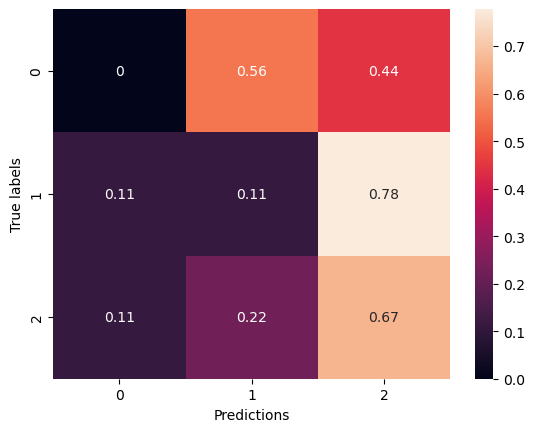

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▁▂▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▇▇▇▇█▇▇▇███▇█████▇██
training_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▂▁▄▃▁▄▄▆▆▇▅▆▇▆▆▇▆▆▅▇█▇▅█▇▅▇▇▇▇▇▅▇▇▄█▄▇▇
val_loss,█▇▇▆▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▂▂▁▃▁▁▂▁▁▃▁▂▄▁▃▁▁


Epoch 1/100


2024-03-12 14:19:56.233858: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:19:56.235759: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:19:56.237453: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:19:57.852262: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:19:57.854055: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:19:57.856409: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:20:02.004306: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:20:02.585888: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 38.0158 - accuracy: 0.3699

2024-03-12 14:20:06.174502: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:20:06.176041: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:20:06.178311: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 255ms/step - loss: 38.0158 - accuracy: 0.3699 - val_loss: 34.4062 - val_accuracy: 0.1852
Epoch 2/100
14/14 [==============================] - 1s 79ms/step - loss: 32.5194 - accuracy: 0.3470 - val_loss: 29.6987 - val_accuracy: 0.1481
Epoch 3/100
14/14 [==============================] - 1s 79ms/step - loss: 27.9847 - accuracy: 0.4018 - val_loss: 25.7687 - val_accuracy: 0.1574
Epoch 4/100
14/14 [==============================] - 1s 80ms/step - loss: 24.3369 - accuracy: 0.4269 - val_loss: 22.5281 - val_accuracy: 0.1574
Epoch 5/100
14/14 [==============================] - 1s 84ms/step - loss: 21.1388 - accuracy: 0.4384 - val_loss: 19.6872 - val_accuracy: 0.2315
Epoch 6/100
14/14 [==============================] - 1s 79ms/step - loss: 18.6055 - accuracy: 0.4521 - val_loss: 17.5687 - val_accuracy: 0.1667
Epoch 7/100
14/14 [==============================] - 1s 80ms/step - loss: 16.5146 - accuracy: 0.4201 - val_loss: 15.7236 - val_accuracy: 0.1759
Ep

14/14 [==============================] - 1s 79ms/step - loss: 1.3136 - accuracy: 0.8676 - val_loss: 2.9714 - val_accuracy: 0.5278
Epoch 59/100
14/14 [==============================] - 1s 79ms/step - loss: 1.2512 - accuracy: 0.8881 - val_loss: 4.3499 - val_accuracy: 0.2778
Epoch 60/100
14/14 [==============================] - 1s 80ms/step - loss: 1.1866 - accuracy: 0.9201 - val_loss: 3.3457 - val_accuracy: 0.4722
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 1.3194 - accuracy: 0.8721 - val_loss: 3.4199 - val_accuracy: 0.5648
Epoch 62/100
14/14 [==============================] - 1s 80ms/step - loss: 1.2665 - accuracy: 0.8539 - val_loss: 3.2727 - val_accuracy: 0.5648
Epoch 63/100
14/14 [==============================] - 1s 79ms/step - loss: 1.2257 - accuracy: 0.8721 - val_loss: 2.8448 - val_accuracy: 0.6111
Epoch 64/100
14/14 [==============================] - 1s 79ms/step - loss: 1.1617 - accuracy: 0.8904 - val_loss: 3.6784 - val_accuracy: 0.4074
Epoch 65/100

2024-03-12 14:21:59.212320: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:21:59.213883: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:21:59.215882: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4806501865386963 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.6666666666666666, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5555555555555555, 'recall': 0.5555555555555555, 'f1-score': 0.4961616161616161, 'support': 27}, 'weighted avg': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.4961616161616162, 'support': 27}}


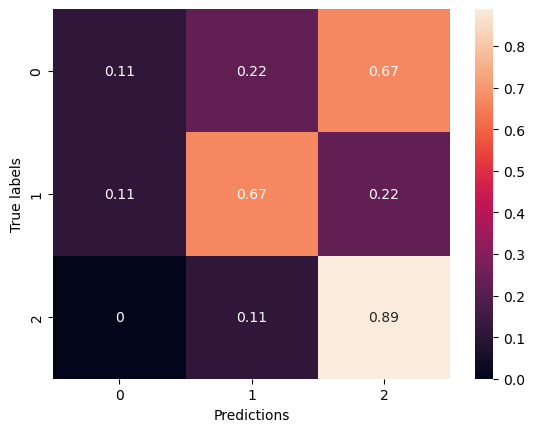

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▃▃▄▄▅▅▅▅▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇▇█▇▇▇▇██
training_loss,█▆▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▂▃▆▇▇▇▇█▄▇▇█▇▇▇▁▆▅▆▆▃▇▅▆▆▇▃▆▅▇▇▅▇▇▆▅▇
val_loss,█▆▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:22:23.046914: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:22:23.048467: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:22:23.050781: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:22:24.649767: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:22:24.651697: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:22:24.653734: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:22:28.779938: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:22:29.364840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 52.1907 - accuracy: 0.3128

2024-03-12 14:22:32.964199: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:22:32.965797: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:22:32.967891: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 197ms/step - loss: 52.1907 - accuracy: 0.3128 - val_loss: 46.4257 - val_accuracy: 0.3241
Epoch 2/100
14/14 [==============================] - 1s 79ms/step - loss: 43.0023 - accuracy: 0.4087 - val_loss: 38.6478 - val_accuracy: 0.1944
Epoch 3/100
14/14 [==============================] - 1s 80ms/step - loss: 35.7755 - accuracy: 0.4132 - val_loss: 32.3176 - val_accuracy: 0.1667
Epoch 4/100
14/14 [==============================] - 1s 79ms/step - loss: 30.0304 - accuracy: 0.3836 - val_loss: 27.2155 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 1s 80ms/step - loss: 25.4074 - accuracy: 0.4087 - val_loss: 23.1182 - val_accuracy: 0.1852
Epoch 6/100
14/14 [==============================] - 1s 80ms/step - loss: 21.5093 - accuracy: 0.4498 - val_loss: 19.8642 - val_accuracy: 0.2222
Epoch 7/100
14/14 [==============================] - 1s 79ms/step - loss: 18.6127 - accuracy: 0.4292 - val_loss: 17.2037 - val_accuracy: 0.2222
Ep

14/14 [==============================] - 1s 80ms/step - loss: 1.3696 - accuracy: 0.8721 - val_loss: 3.0936 - val_accuracy: 0.6019
Epoch 59/100
14/14 [==============================] - 1s 79ms/step - loss: 1.3120 - accuracy: 0.8813 - val_loss: 3.7094 - val_accuracy: 0.4074
Epoch 60/100
14/14 [==============================] - 1s 84ms/step - loss: 1.2142 - accuracy: 0.9132 - val_loss: 2.8350 - val_accuracy: 0.5833
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 1.2025 - accuracy: 0.9064 - val_loss: 3.1931 - val_accuracy: 0.5926
Epoch 62/100
14/14 [==============================] - 1s 79ms/step - loss: 1.1686 - accuracy: 0.8927 - val_loss: 4.3450 - val_accuracy: 0.3333
Epoch 63/100
14/14 [==============================] - 1s 80ms/step - loss: 1.2936 - accuracy: 0.8447 - val_loss: 3.2127 - val_accuracy: 0.5278
Epoch 64/100
14/14 [==============================] - 1s 95ms/step - loss: 1.3352 - accuracy: 0.8425 - val_loss: 3.9272 - val_accuracy: 0.3704
Epoch 65/100

2024-03-12 14:24:24.914893: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:24:24.916491: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:24:24.918451: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4757418632507324 s
{'0': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '1': {'precision': 0.375, 'recall': 1.0, 'f1-score': 0.5454545454545454, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.7916666666666666, 'recall': 0.4444444444444445, 'f1-score': 0.36969696969696964, 'support': 27}, 'weighted avg': {'precision': 0.7916666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.36969696969696964, 'support': 27}}


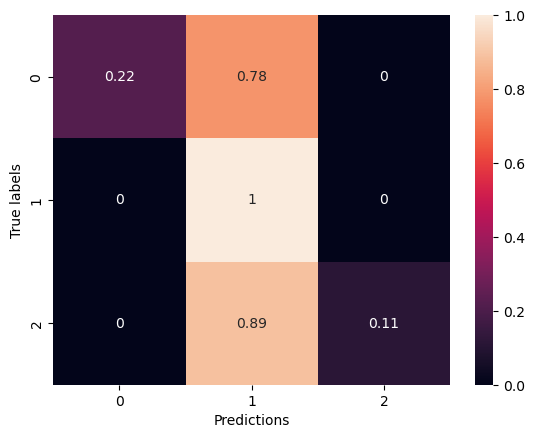

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▃▄▄▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇██▇
training_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▂▂▄▅▅▅▇▇▇▅▇▇▅▅▇▇▇█▃▄▇▅█▄▅▆▇▇▆▅█▁▇▆▆▆█▄
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:24:48.764466: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:24:48.766649: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:24:48.768399: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:24:50.425625: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:24:50.428048: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:24:50.429695: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:24:55.565778: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:24:56.142945: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 10.8344 - accuracy: 0.4406

2024-03-12 14:25:00.086763: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:25:00.089111: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:25:00.090728: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 224ms/step - loss: 10.8344 - accuracy: 0.4406 - val_loss: 10.3777 - val_accuracy: 0.1481
Epoch 2/100
14/14 [==============================] - 1s 106ms/step - loss: 9.7933 - accuracy: 0.6164 - val_loss: 10.0718 - val_accuracy: 0.2130
Epoch 3/100
14/14 [==============================] - 1s 107ms/step - loss: 9.1281 - accuracy: 0.6712 - val_loss: 9.4827 - val_accuracy: 0.1944
Epoch 4/100
14/14 [==============================] - 1s 107ms/step - loss: 8.4957 - accuracy: 0.7283 - val_loss: 8.7893 - val_accuracy: 0.3981
Epoch 5/100
14/14 [==============================] - 1s 108ms/step - loss: 7.9396 - accuracy: 0.7763 - val_loss: 8.1071 - val_accuracy: 0.5741
Epoch 6/100
14/14 [==============================] - 1s 107ms/step - loss: 7.3991 - accuracy: 0.8059 - val_loss: 7.7517 - val_accuracy: 0.5185
Epoch 7/100
14/14 [==============================] - 1s 107ms/step - loss: 6.9077 - accuracy: 0.8288 - val_loss: 7.4515 - val_accuracy: 0.5833
Epoch 8

14/14 [==============================] - 1s 107ms/step - loss: 0.8656 - accuracy: 0.9772 - val_loss: 4.3522 - val_accuracy: 0.4444
Epoch 59/100
14/14 [==============================] - 1s 107ms/step - loss: 0.8906 - accuracy: 0.9566 - val_loss: 4.2716 - val_accuracy: 0.5000
Epoch 60/100
14/14 [==============================] - 1s 107ms/step - loss: 0.8554 - accuracy: 0.9635 - val_loss: 4.0698 - val_accuracy: 0.5833
Epoch 61/100
14/14 [==============================] - 2s 108ms/step - loss: 0.8684 - accuracy: 0.9749 - val_loss: 3.9789 - val_accuracy: 0.5463
Epoch 62/100
14/14 [==============================] - 1s 108ms/step - loss: 0.7894 - accuracy: 0.9840 - val_loss: 3.8836 - val_accuracy: 0.5463
Epoch 63/100
14/14 [==============================] - 1s 108ms/step - loss: 0.8333 - accuracy: 0.9658 - val_loss: 4.3135 - val_accuracy: 0.4907
Epoch 64/100
14/14 [==============================] - 1s 107ms/step - loss: 0.8303 - accuracy: 0.9543 - val_loss: 4.0407 - val_accuracy: 0.5000
Epoch

2024-03-12 14:27:31.718935: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:27:31.720922: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:27:31.722601: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4656808376312256 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.8888888888888888, 'f1-score': 0.6956521739130435, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.35714285714285715, 'recall': 0.5185185185185185, 'f1-score': 0.42236024844720504, 'support': 27}, 'weighted avg': {'precision': 0.35714285714285715, 'recall': 0.5185185185185185, 'f1-score': 0.42236024844720493, 'support': 27}}


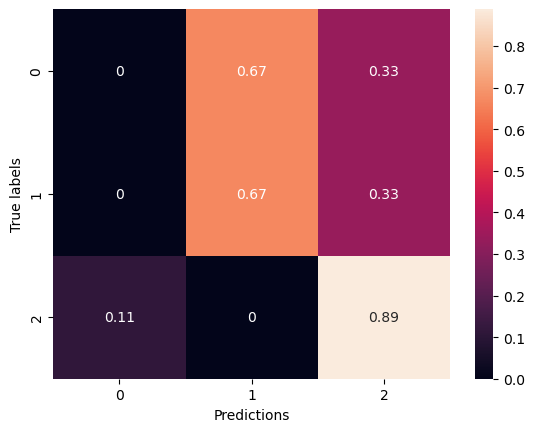

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇█▇▇▇███▇▇██████████▇███▇██████████
training_loss,█▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▆▇▆▆▇█▆▆▇▇█▆▇▆▇▇▅█▅▇▇▆▇▆▆▆▅█▆▆▆▆▆▆██▇▇
val_loss,█▇▅▅▄▅▃▃▄▃▂▃▂▃▂▃▂▂▃▂▃▂▁▂▂▂▂▁▂▁▁▂▁▂▂▂▁▁▁▁


Epoch 1/100


2024-03-12 14:30:05.818393: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:30:05.820161: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:30:05.822140: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:30:07.448244: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:30:07.450319: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:30:07.452898: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:30:11.662693: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:30:12.252315: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 44.8736 - accuracy: 0.4315

2024-03-12 14:30:16.274894: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:30:16.277132: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:30:16.278835: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 226ms/step - loss: 44.8736 - accuracy: 0.4315 - val_loss: 39.7165 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 2s 110ms/step - loss: 35.5349 - accuracy: 0.5959 - val_loss: 31.8855 - val_accuracy: 0.1667
Epoch 3/100
14/14 [==============================] - 2s 108ms/step - loss: 28.1071 - accuracy: 0.6804 - val_loss: 25.3658 - val_accuracy: 0.1944
Epoch 4/100
14/14 [==============================] - 2s 110ms/step - loss: 22.2310 - accuracy: 0.7352 - val_loss: 20.1199 - val_accuracy: 0.4074
Epoch 5/100
14/14 [==============================] - 2s 108ms/step - loss: 17.6453 - accuracy: 0.7717 - val_loss: 16.1507 - val_accuracy: 0.5278
Epoch 6/100
14/14 [==============================] - 2s 117ms/step - loss: 14.1207 - accuracy: 0.8196 - val_loss: 13.2947 - val_accuracy: 0.4722
Epoch 7/100
14/14 [==============================] - 2s 108ms/step - loss: 11.4683 - accuracy: 0.8379 - val_loss: 10.8292 - val_accuracy: 0.5

Epoch 58/100
14/14 [==============================] - 1s 107ms/step - loss: 0.8833 - accuracy: 0.9589 - val_loss: 3.7701 - val_accuracy: 0.4537
Epoch 59/100
14/14 [==============================] - 1s 106ms/step - loss: 0.9262 - accuracy: 0.9338 - val_loss: 4.0059 - val_accuracy: 0.4537
Epoch 60/100
14/14 [==============================] - 1s 107ms/step - loss: 0.8973 - accuracy: 0.9635 - val_loss: 2.8379 - val_accuracy: 0.6481
Epoch 61/100
14/14 [==============================] - 2s 118ms/step - loss: 0.8822 - accuracy: 0.9475 - val_loss: 3.5526 - val_accuracy: 0.5185
Epoch 62/100
14/14 [==============================] - 2s 111ms/step - loss: 0.8254 - accuracy: 0.9612 - val_loss: 3.8078 - val_accuracy: 0.4537
Epoch 63/100
14/14 [==============================] - 2s 108ms/step - loss: 0.8447 - accuracy: 0.9475 - val_loss: 3.4546 - val_accuracy: 0.5556
Epoch 64/100
14/14 [==============================] - 2s 108ms/step - loss: 0.8569 - accuracy: 0.9475 - val_loss: 2.9877 - val_accuracy:

2024-03-12 14:32:47.712432: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:32:47.714303: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:32:47.716153: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 2.6021480560302734 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.6363636363636364, 'recall': 0.7777777777777778, 'f1-score': 0.7000000000000001, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5454545454545454, 'recall': 0.5555555555555555, 'f1-score': 0.49683794466403164, 'support': 27}, 'weighted avg': {'precision': 0.5454545454545454, 'recall': 0.5555555555555556, 'f1-score': 0.4968379446640317, 'support': 27}}


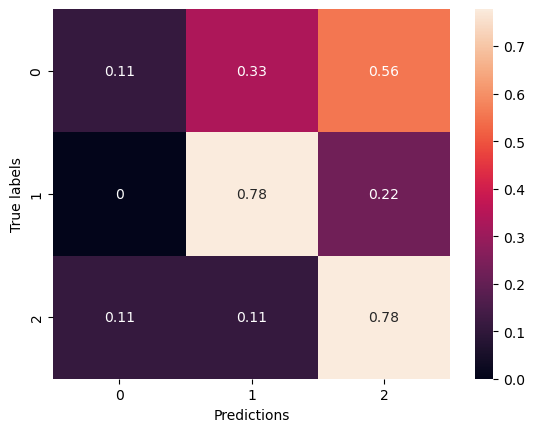

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▇▇▇▇▇█▇▇██▇██▇███▇██▇▇█████▇██▇███
training_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▆▆▆▅▆▆▆▅▇▆▃▆▇▆▅█▅▆▅▇▅▅▆▇▅▆▄▆▅▆▃▆▅▆▆▅▅▆
val_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:33:13.471191: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:33:13.473199: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:33:13.474976: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:33:15.080008: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:33:15.081780: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:33:15.083891: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:33:19.224150: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:33:19.806434: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 61.3185 - accuracy: 0.4498

2024-03-12 14:33:23.765062: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:33:23.766754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:33:23.770095: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 224ms/step - loss: 61.3185 - accuracy: 0.4498 - val_loss: 52.9655 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 1s 106ms/step - loss: 46.3621 - accuracy: 0.6507 - val_loss: 40.3017 - val_accuracy: 0.1296
Epoch 3/100
14/14 [==============================] - 2s 110ms/step - loss: 34.9711 - accuracy: 0.6621 - val_loss: 30.5865 - val_accuracy: 0.1944
Epoch 4/100
14/14 [==============================] - 1s 106ms/step - loss: 26.4026 - accuracy: 0.7443 - val_loss: 23.6916 - val_accuracy: 0.1296
Epoch 5/100
14/14 [==============================] - 1s 107ms/step - loss: 20.1085 - accuracy: 0.7763 - val_loss: 18.7022 - val_accuracy: 0.1481
Epoch 6/100
14/14 [==============================] - 1s 107ms/step - loss: 15.5766 - accuracy: 0.7785 - val_loss: 14.5311 - val_accuracy: 0.3241
Epoch 7/100
14/14 [==============================] - 2s 108ms/step - loss: 12.2075 - accuracy: 0.8333 - val_loss: 11.9703 - val_accuracy: 0.3

Epoch 58/100
14/14 [==============================] - 1s 106ms/step - loss: 1.0341 - accuracy: 0.9338 - val_loss: 4.5367 - val_accuracy: 0.3056
Epoch 59/100
14/14 [==============================] - 1s 107ms/step - loss: 1.0092 - accuracy: 0.9452 - val_loss: 3.7735 - val_accuracy: 0.5556
Epoch 60/100
14/14 [==============================] - 1s 107ms/step - loss: 1.0054 - accuracy: 0.9406 - val_loss: 3.2959 - val_accuracy: 0.5185
Epoch 61/100
14/14 [==============================] - 1s 106ms/step - loss: 0.9642 - accuracy: 0.9566 - val_loss: 4.1959 - val_accuracy: 0.4259
Epoch 62/100
14/14 [==============================] - 1s 106ms/step - loss: 0.8681 - accuracy: 0.9772 - val_loss: 3.9302 - val_accuracy: 0.4444
Epoch 63/100
14/14 [==============================] - 1s 106ms/step - loss: 0.8333 - accuracy: 0.9817 - val_loss: 3.8177 - val_accuracy: 0.4907
Epoch 64/100
14/14 [==============================] - 1s 106ms/step - loss: 0.8444 - accuracy: 0.9521 - val_loss: 3.5383 - val_accuracy:

2024-03-12 14:35:53.595975: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:35:53.597985: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:35:53.599612: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.482409954071045 s
{'0': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '1': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5595238095238095, 'recall': 0.5185185185185185, 'f1-score': 0.4921794871794872, 'support': 27}, 'weighted avg': {'precision': 0.5595238095238095, 'recall': 0.5185185185185185, 'f1-score': 0.49217948717948723, 'support': 27}}


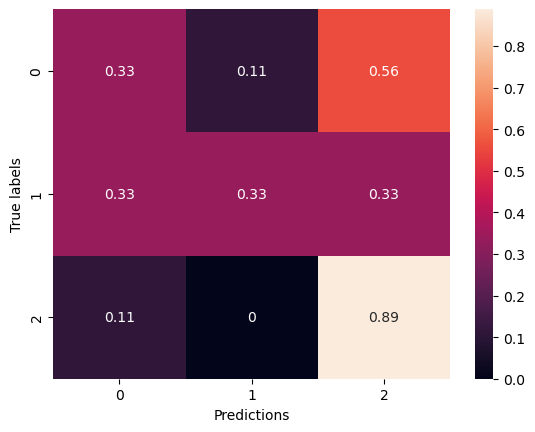

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▇▇▇▇▇▇▇▇▇▇▇█▇█▇██▇█████▇██▇▇▇▇█▇██▇██
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▄▄▅▇█▇██▆▆█▇▇▃▇▅▇▆▆▅▆▇▅▆▅▇▆▅▇█▃▆█▅▆▅▇█
val_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:36:17.602264: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:36:17.604205: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:36:17.606281: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:36:19.214433: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:36:19.216293: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:36:19.218380: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:36:24.211280: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:36:24.788755: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 11.0265 - accuracy: 0.4224

2024-03-12 14:36:28.767423: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:36:28.769036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:36:28.771091: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 225ms/step - loss: 11.0265 - accuracy: 0.4224 - val_loss: 10.4475 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 1s 105ms/step - loss: 10.2143 - accuracy: 0.4909 - val_loss: 10.2715 - val_accuracy: 0.1481
Epoch 3/100
14/14 [==============================] - 2s 111ms/step - loss: 9.6785 - accuracy: 0.5342 - val_loss: 9.9124 - val_accuracy: 0.1852
Epoch 4/100
14/14 [==============================] - 1s 106ms/step - loss: 9.2065 - accuracy: 0.5616 - val_loss: 9.4483 - val_accuracy: 0.1944
Epoch 5/100
14/14 [==============================] - 1s 107ms/step - loss: 8.7160 - accuracy: 0.6073 - val_loss: 9.3155 - val_accuracy: 0.2037
Epoch 6/100
14/14 [==============================] - 1s 106ms/step - loss: 8.2941 - accuracy: 0.6279 - val_loss: 8.9525 - val_accuracy: 0.2315
Epoch 7/100
14/14 [==============================] - 1s 106ms/step - loss: 7.8542 - accuracy: 0.6667 - val_loss: 8.3214 - val_accuracy: 0.3148
Epoch 

14/14 [==============================] - 1s 106ms/step - loss: 1.1307 - accuracy: 0.9452 - val_loss: 3.9618 - val_accuracy: 0.5556
Epoch 59/100
14/14 [==============================] - 1s 107ms/step - loss: 1.0381 - accuracy: 0.9680 - val_loss: 4.0884 - val_accuracy: 0.4815
Epoch 60/100
14/14 [==============================] - 1s 106ms/step - loss: 1.0335 - accuracy: 0.9703 - val_loss: 4.8645 - val_accuracy: 0.4074
Epoch 61/100
14/14 [==============================] - 1s 106ms/step - loss: 1.0213 - accuracy: 0.9612 - val_loss: 4.6527 - val_accuracy: 0.5093
Epoch 62/100
14/14 [==============================] - 1s 107ms/step - loss: 1.0352 - accuracy: 0.9658 - val_loss: 4.0065 - val_accuracy: 0.5000
Epoch 63/100
14/14 [==============================] - 1s 106ms/step - loss: 0.9370 - accuracy: 0.9840 - val_loss: 3.6484 - val_accuracy: 0.5278
Epoch 64/100
14/14 [==============================] - 2s 107ms/step - loss: 0.9162 - accuracy: 0.9795 - val_loss: 3.6622 - val_accuracy: 0.5833
Epoch

2024-03-12 14:38:58.496489: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:38:58.498318: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:38:58.502112: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4722411632537842 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.42105263157894735, 'recall': 0.8888888888888888, 'f1-score': 0.5714285714285714, 'support': 9}, '2': {'precision': 0.625, 'recall': 0.5555555555555556, 'f1-score': 0.5882352941176471, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.34868421052631576, 'recall': 0.48148148148148145, 'f1-score': 0.38655462184873945, 'support': 27}, 'weighted avg': {'precision': 0.34868421052631576, 'recall': 0.48148148148148145, 'f1-score': 0.38655462184873945, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


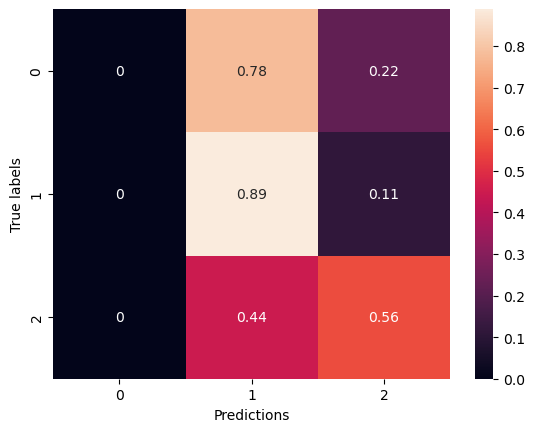

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▄▄▅▆▆▆▇▇▇▇███▇▇███████████████████████
training_loss,█▇▆▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▂▅▆▆▅█▆█▆▇▇▆▅▇▇█▆▄▆▇█▆▇█▇▇▇▅▆▇▆▃▅█▇▇▆▅
val_loss,█▇▇▆▅▅▄▄▄▃▃▃▃▃▄▂▂▂▂▄▂▂▂▂▂▁▂▂▁▂▁▁▁▃▂▁▁▁▂▂


Epoch 1/100


2024-03-12 14:39:22.221220: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:39:22.223363: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:39:22.225238: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:39:23.833128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:39:23.834952: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:39:23.837095: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:39:27.988335: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:39:29.292952: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 45.5807 - accuracy: 0.3813

2024-03-12 14:39:33.236069: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:39:33.238281: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:39:33.239996: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 226ms/step - loss: 45.5807 - accuracy: 0.3813 - val_loss: 40.7490 - val_accuracy: 0.1574
Epoch 2/100
14/14 [==============================] - 1s 107ms/step - loss: 37.4383 - accuracy: 0.4863 - val_loss: 33.9176 - val_accuracy: 0.1389
Epoch 3/100
14/14 [==============================] - 1s 106ms/step - loss: 30.6111 - accuracy: 0.5845 - val_loss: 28.3279 - val_accuracy: 0.1574
Epoch 4/100
14/14 [==============================] - 2s 110ms/step - loss: 25.2955 - accuracy: 0.6210 - val_loss: 23.8576 - val_accuracy: 0.1296
Epoch 5/100
14/14 [==============================] - 2s 108ms/step - loss: 20.9040 - accuracy: 0.6644 - val_loss: 20.4404 - val_accuracy: 0.1296
Epoch 6/100
14/14 [==============================] - 1s 107ms/step - loss: 17.5073 - accuracy: 0.6644 - val_loss: 17.2817 - val_accuracy: 0.1667
Epoch 7/100
14/14 [==============================] - 2s 108ms/step - loss: 14.7516 - accuracy: 0.6895 - val_loss: 14.7786 - val_accuracy: 0.1

Epoch 58/100
14/14 [==============================] - 2s 112ms/step - loss: 1.0769 - accuracy: 0.9247 - val_loss: 3.8759 - val_accuracy: 0.4722
Epoch 59/100
14/14 [==============================] - 1s 107ms/step - loss: 1.0263 - accuracy: 0.9315 - val_loss: 4.9005 - val_accuracy: 0.3519
Epoch 60/100
14/14 [==============================] - 1s 108ms/step - loss: 1.1108 - accuracy: 0.9132 - val_loss: 4.0683 - val_accuracy: 0.3796
Epoch 61/100
14/14 [==============================] - 1s 107ms/step - loss: 1.1356 - accuracy: 0.9178 - val_loss: 3.8908 - val_accuracy: 0.5556
Epoch 62/100
14/14 [==============================] - 2s 108ms/step - loss: 1.1469 - accuracy: 0.9110 - val_loss: 3.5502 - val_accuracy: 0.4537
Epoch 63/100
14/14 [==============================] - 2s 108ms/step - loss: 1.0607 - accuracy: 0.9452 - val_loss: 3.9355 - val_accuracy: 0.3796
Epoch 64/100
14/14 [==============================] - 1s 108ms/step - loss: 1.0219 - accuracy: 0.9589 - val_loss: 3.6006 - val_accuracy:

2024-03-12 14:42:04.129643: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:42:04.131557: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:42:04.133192: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.471754789352417 s
{'0': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '1': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, '2': {'precision': 0.6428571428571429, 'recall': 1.0, 'f1-score': 0.782608695652174, 'support': 9}, 'accuracy': 0.6296296296296297, 'macro avg': {'precision': 0.7294372294372294, 'recall': 0.6296296296296297, 'f1-score': 0.5820816864295125, 'support': 27}, 'weighted avg': {'precision': 0.7294372294372294, 'recall': 0.6296296296296297, 'f1-score': 0.5820816864295125, 'support': 27}}


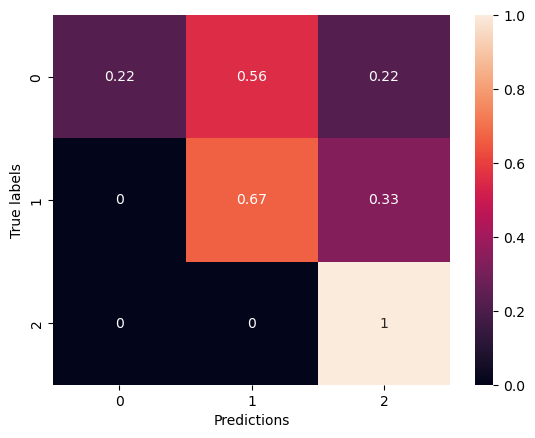

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▆▇▆▆▇▇▇▇▇█▇██▇▇█▇▇▇███▇██▇▇▇▇█▇█▇█
training_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▄▂▇▇▇▇█▆▆▅▆▅██▅▇▄▇▆▇▄▇▆▇▇▇▇▇▄▄▆▅▆█▆▆▇
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:44:57.795215: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:44:57.797327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:44:57.799134: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:44:59.437311: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:44:59.439136: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:44:59.441546: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:45:03.654702: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:45:04.262116: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 61.8603 - accuracy: 0.4247

2024-03-12 14:45:08.342545: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:45:08.344321: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:45:08.346489: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 233ms/step - loss: 61.8603 - accuracy: 0.4247 - val_loss: 54.0348 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 2s 110ms/step - loss: 48.6303 - accuracy: 0.5091 - val_loss: 42.9233 - val_accuracy: 0.1111
Epoch 3/100
14/14 [==============================] - 2s 115ms/step - loss: 38.3188 - accuracy: 0.5731 - val_loss: 34.1418 - val_accuracy: 0.1389
Epoch 4/100
14/14 [==============================] - 2s 116ms/step - loss: 30.4243 - accuracy: 0.6027 - val_loss: 27.4532 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 2s 108ms/step - loss: 24.3356 - accuracy: 0.6142 - val_loss: 22.4422 - val_accuracy: 0.1759
Epoch 6/100
14/14 [==============================] - 2s 108ms/step - loss: 19.6179 - accuracy: 0.6712 - val_loss: 18.7235 - val_accuracy: 0.1574
Epoch 7/100
14/14 [==============================] - 1s 107ms/step - loss: 15.9883 - accuracy: 0.6918 - val_loss: 15.0297 - val_accuracy: 0.2

Epoch 58/100
14/14 [==============================] - 2s 111ms/step - loss: 1.2512 - accuracy: 0.8950 - val_loss: 3.4463 - val_accuracy: 0.5370
Epoch 59/100
14/14 [==============================] - 2s 112ms/step - loss: 1.2801 - accuracy: 0.9110 - val_loss: 4.3207 - val_accuracy: 0.3611
Epoch 60/100
14/14 [==============================] - 1s 108ms/step - loss: 1.1880 - accuracy: 0.9384 - val_loss: 3.2464 - val_accuracy: 0.4722
Epoch 61/100
14/14 [==============================] - 1s 107ms/step - loss: 1.1622 - accuracy: 0.9406 - val_loss: 3.5740 - val_accuracy: 0.5648
Epoch 62/100
14/14 [==============================] - 1s 108ms/step - loss: 1.1444 - accuracy: 0.9178 - val_loss: 3.0444 - val_accuracy: 0.5648
Epoch 63/100
14/14 [==============================] - 1s 108ms/step - loss: 1.2010 - accuracy: 0.8973 - val_loss: 3.3814 - val_accuracy: 0.5000
Epoch 64/100
14/14 [==============================] - 2s 108ms/step - loss: 1.1438 - accuracy: 0.9269 - val_loss: 2.7277 - val_accuracy:

2024-03-12 14:47:42.434394: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:47:42.436130: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:47:42.438452: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5096771717071533 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.3373737373737374, 'recall': 0.48148148148148145, 'f1-score': 0.39444444444444443, 'support': 27}, 'weighted avg': {'precision': 0.3373737373737374, 'recall': 0.48148148148148145, 'f1-score': 0.3944444444444444, 'support': 27}}


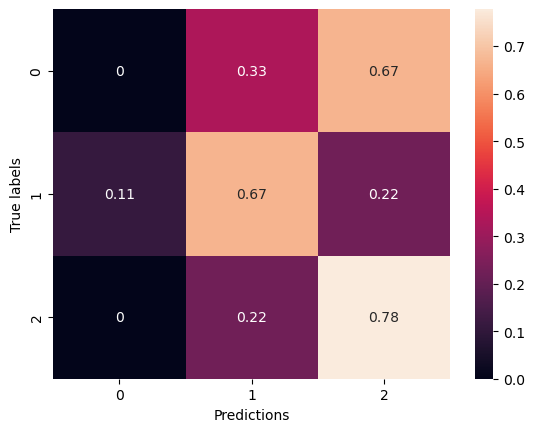

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▆▇▇▇▇▇▇▇▇▇█▇▇█▇▇▇▇███▇▇███▇███▇███
training_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▆▅▆▇▅▆█▆█▇▇▅▇█▆▆█▃█▄▄▇█▅▆▄▆▇▄▇▆▅▅▇▅▄▆
val_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:48:06.657021: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:48:06.659226: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:48:06.660795: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:48:09.223431: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:48:09.225193: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:48:09.227081: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:48:13.378950: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:48:13.958170: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 11.1872 - accuracy: 0.3356

2024-03-12 14:48:17.905562: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:48:17.907686: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:48:17.909294: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 224ms/step - loss: 11.1872 - accuracy: 0.3356 - val_loss: 10.4865 - val_accuracy: 0.1667
Epoch 2/100
14/14 [==============================] - 1s 106ms/step - loss: 10.5181 - accuracy: 0.4064 - val_loss: 10.2512 - val_accuracy: 0.1574
Epoch 3/100
14/14 [==============================] - 1s 107ms/step - loss: 10.0798 - accuracy: 0.4429 - val_loss: 10.0862 - val_accuracy: 0.1481
Epoch 4/100
14/14 [==============================] - 2s 109ms/step - loss: 9.7650 - accuracy: 0.4201 - val_loss: 9.8562 - val_accuracy: 0.1481
Epoch 5/100
14/14 [==============================] - 2s 108ms/step - loss: 9.3286 - accuracy: 0.4429 - val_loss: 9.7320 - val_accuracy: 0.1574
Epoch 6/100
14/14 [==============================] - 1s 108ms/step - loss: 8.9951 - accuracy: 0.4475 - val_loss: 9.4666 - val_accuracy: 0.1852
Epoch 7/100
14/14 [==============================] - 2s 108ms/step - loss: 8.7504 - accuracy: 0.4315 - val_loss: 9.2201 - val_accuracy: 0.1852
Epoc

Epoch 58/100
14/14 [==============================] - 1s 107ms/step - loss: 1.6367 - accuracy: 0.9338 - val_loss: 3.9611 - val_accuracy: 0.5926
Epoch 59/100
14/14 [==============================] - 1s 107ms/step - loss: 1.5528 - accuracy: 0.9612 - val_loss: 4.4157 - val_accuracy: 0.4722
Epoch 60/100
14/14 [==============================] - 2s 113ms/step - loss: 1.5478 - accuracy: 0.9338 - val_loss: 5.1783 - val_accuracy: 0.4259
Epoch 61/100
14/14 [==============================] - 2s 108ms/step - loss: 1.4623 - accuracy: 0.9498 - val_loss: 5.8966 - val_accuracy: 0.3519
Epoch 62/100
14/14 [==============================] - 2s 110ms/step - loss: 1.5282 - accuracy: 0.9224 - val_loss: 3.9426 - val_accuracy: 0.5278
Epoch 63/100
14/14 [==============================] - 1s 108ms/step - loss: 1.4746 - accuracy: 0.9361 - val_loss: 3.4303 - val_accuracy: 0.6574
Epoch 64/100
14/14 [==============================] - 1s 107ms/step - loss: 1.4404 - accuracy: 0.9269 - val_loss: 4.0537 - val_accuracy:

2024-03-12 14:50:48.307042: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:50:48.308610: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:50:48.310658: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5007259845733643 s
{'0': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.4761904761904762, 'recall': 0.48148148148148145, 'f1-score': 0.4758771929824561, 'support': 27}, 'weighted avg': {'precision': 0.4761904761904762, 'recall': 0.48148148148148145, 'f1-score': 0.4758771929824561, 'support': 27}}


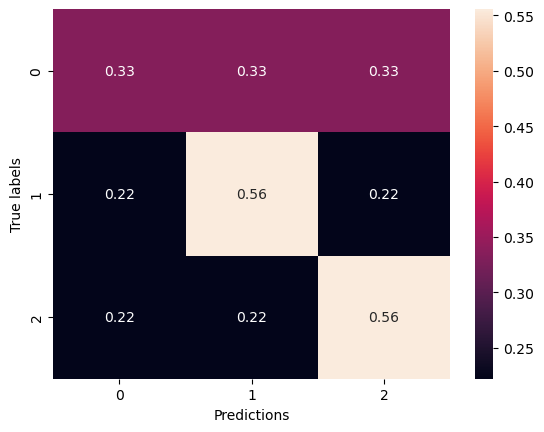

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▃▃▄▄▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇██▇██████████████
training_loss,█▇▇▆▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▂▂▃▅▆▆▇▆▇▆▇▇▇█▇▆▆▆▆█▆▄▇▆▆▇█▅▃▄▃▇▅█▆▆▆
val_loss,██▇▇▆▅▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▃▂▂▂▂▁▃▃▂▄▁▂▁▁▁▁


Epoch 1/100


2024-03-12 14:51:12.324299: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:51:12.325959: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:51:12.328156: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:51:13.944087: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:51:13.946353: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:51:13.948166: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:51:18.983240: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:51:19.562835: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 45.4202 - accuracy: 0.3562

2024-03-12 14:51:23.514224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:51:23.516090: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:51:23.517920: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 223ms/step - loss: 45.4202 - accuracy: 0.3562 - val_loss: 40.8141 - val_accuracy: 0.2407
Epoch 2/100
14/14 [==============================] - 1s 107ms/step - loss: 38.3933 - accuracy: 0.3539 - val_loss: 34.7645 - val_accuracy: 0.1481
Epoch 3/100
14/14 [==============================] - 1s 106ms/step - loss: 32.5792 - accuracy: 0.3744 - val_loss: 29.9869 - val_accuracy: 0.1296
Epoch 4/100
14/14 [==============================] - 1s 107ms/step - loss: 28.0022 - accuracy: 0.4269 - val_loss: 26.0502 - val_accuracy: 0.1296
Epoch 5/100
14/14 [==============================] - 2s 113ms/step - loss: 24.1947 - accuracy: 0.4452 - val_loss: 22.5679 - val_accuracy: 0.1574
Epoch 6/100
14/14 [==============================] - 1s 107ms/step - loss: 21.0831 - accuracy: 0.4475 - val_loss: 19.7932 - val_accuracy: 0.1759
Epoch 7/100
14/14 [==============================] - 1s 107ms/step - loss: 18.3566 - accuracy: 0.5342 - val_loss: 17.8077 - val_accuracy: 0.2

Epoch 58/100
14/14 [==============================] - 1s 106ms/step - loss: 1.3433 - accuracy: 0.8927 - val_loss: 3.5268 - val_accuracy: 0.5278
Epoch 59/100
14/14 [==============================] - 2s 108ms/step - loss: 1.3116 - accuracy: 0.9178 - val_loss: 3.8571 - val_accuracy: 0.3889
Epoch 60/100
14/14 [==============================] - 1s 108ms/step - loss: 1.2657 - accuracy: 0.9315 - val_loss: 3.3077 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 1s 106ms/step - loss: 1.2756 - accuracy: 0.9132 - val_loss: 7.0042 - val_accuracy: 0.1759
Epoch 62/100
14/14 [==============================] - 1s 106ms/step - loss: 1.4016 - accuracy: 0.8790 - val_loss: 3.5167 - val_accuracy: 0.5741
Epoch 63/100
14/14 [==============================] - 1s 107ms/step - loss: 1.4265 - accuracy: 0.8858 - val_loss: 3.2232 - val_accuracy: 0.5185
Epoch 64/100
14/14 [==============================] - 1s 106ms/step - loss: 1.3951 - accuracy: 0.8836 - val_loss: 3.2139 - val_accuracy:

2024-03-12 14:53:54.392903: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:53:54.394611: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:53:54.396639: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4803729057312012 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.47368421052631576, 'recall': 1.0, 'f1-score': 0.6428571428571429, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.3333333333333333, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6912280701754385, 'recall': 0.5555555555555555, 'f1-score': 0.5238095238095238, 'support': 27}, 'weighted avg': {'precision': 0.6912280701754385, 'recall': 0.5555555555555556, 'f1-score': 0.5238095238095238, 'support': 27}}


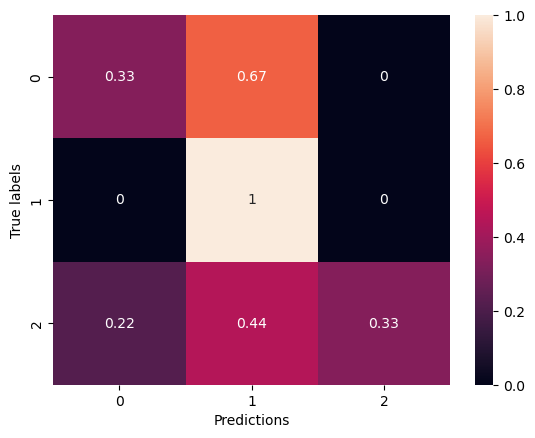

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▃▄▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇█▇██▇███▇▇██▇▇▇███▇
training_loss,█▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▂▃▅▆▆▇▅▇██▆▇▇█▄▆▆▆▄▆▇▅▂▇▇▆▆▅▄▇▆▇▇▇▇▆▅▄
val_loss,█▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:54:17.649564: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:54:17.651124: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:54:17.653747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:54:19.280116: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:54:19.282378: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:54:19.284422: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:54:23.761845: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:54:24.356211: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 62.8195 - accuracy: 0.3219

2024-03-12 14:54:28.363571: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:54:28.365232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:54:28.367196: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 228ms/step - loss: 62.8195 - accuracy: 0.3219 - val_loss: 55.5682 - val_accuracy: 0.1944
Epoch 2/100
14/14 [==============================] - 2s 108ms/step - loss: 51.0695 - accuracy: 0.3973 - val_loss: 45.4954 - val_accuracy: 0.1759
Epoch 3/100
14/14 [==============================] - 1s 108ms/step - loss: 41.7649 - accuracy: 0.4406 - val_loss: 37.4956 - val_accuracy: 0.1574
Epoch 4/100
14/14 [==============================] - 2s 109ms/step - loss: 34.4186 - accuracy: 0.4429 - val_loss: 31.1547 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 2s 108ms/step - loss: 28.5210 - accuracy: 0.4977 - val_loss: 26.1628 - val_accuracy: 0.1574
Epoch 6/100
14/14 [==============================] - 2s 109ms/step - loss: 23.8478 - accuracy: 0.4977 - val_loss: 22.3476 - val_accuracy: 0.1574
Epoch 7/100
14/14 [==============================] - 2s 108ms/step - loss: 20.2170 - accuracy: 0.5342 - val_loss: 19.0858 - val_accuracy: 0.1

Epoch 58/100
14/14 [==============================] - 1s 107ms/step - loss: 1.5442 - accuracy: 0.8813 - val_loss: 3.2365 - val_accuracy: 0.5926
Epoch 59/100
14/14 [==============================] - 1s 107ms/step - loss: 1.5479 - accuracy: 0.8790 - val_loss: 3.5598 - val_accuracy: 0.4074
Epoch 60/100
14/14 [==============================] - 1s 108ms/step - loss: 1.5087 - accuracy: 0.8950 - val_loss: 3.1061 - val_accuracy: 0.5833
Epoch 61/100
14/14 [==============================] - 2s 109ms/step - loss: 1.3989 - accuracy: 0.9155 - val_loss: 3.0559 - val_accuracy: 0.6389
Epoch 62/100
14/14 [==============================] - 1s 108ms/step - loss: 1.3327 - accuracy: 0.9269 - val_loss: 3.1756 - val_accuracy: 0.6296
Epoch 63/100
14/14 [==============================] - 1s 107ms/step - loss: 1.3359 - accuracy: 0.8950 - val_loss: 3.7146 - val_accuracy: 0.4630
Epoch 64/100
14/14 [==============================] - 1s 107ms/step - loss: 1.3613 - accuracy: 0.8836 - val_loss: 3.5037 - val_accuracy:

2024-03-12 14:57:00.613012: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:57:00.615211: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:57:00.617101: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4870052337646484 s
{'0': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '1': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.4871794871794872, 'recall': 0.48148148148148157, 'f1-score': 0.45982088087351247, 'support': 27}, 'weighted avg': {'precision': 0.48717948717948717, 'recall': 0.48148148148148145, 'f1-score': 0.4598208808735124, 'support': 27}}


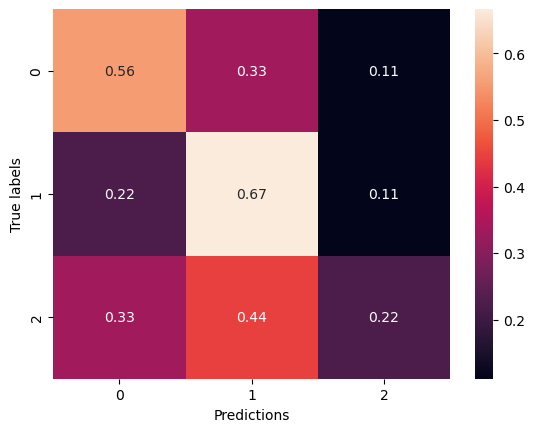

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▅▅▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇████▇█▇█▇▇████
training_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▂▅▃▄▆▅█▆▇▅▆▅▇▆▇▆▇▄▇▃▅█▅█▁▆▄▇▇▇▅█▅▅▅▇▄
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 14:57:32.129895: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:57:32.132095: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:57:32.133805: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:57:33.747957: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:57:33.750622: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:57:33.752555: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 14:57:37.905148: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 14:57:38.489637: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 7.3601 - accuracy: 0.3836

2024-03-12 14:57:41.558963: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:57:41.560672: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:57:41.562763: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 330ms/step - loss: 7.3601 - accuracy: 0.3836 - val_loss: 6.9471 - val_accuracy: 0.1574
Epoch 2/100
7/7 [==============================] - 1s 77ms/step - loss: 6.7894 - accuracy: 0.5068 - val_loss: 6.8807 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 86ms/step - loss: 6.4130 - accuracy: 0.5776 - val_loss: 6.7547 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 75ms/step - loss: 6.1484 - accuracy: 0.6073 - val_loss: 6.6530 - val_accuracy: 0.1389
Epoch 5/100
7/7 [==============================] - 1s 77ms/step - loss: 5.8438 - accuracy: 0.7032 - val_loss: 6.5849 - val_accuracy: 0.1481
Epoch 6/100
7/7 [==============================] - 1s 76ms/step - loss: 5.5821 - accuracy: 0.7078 - val_loss: 6.6058 - val_accuracy: 0.1389
Epoch 7/100
7/7 [==============================] - 1s 77ms/step - loss: 5.3649 - accuracy: 0.7466 - val_loss: 6.5165 - val_accuracy: 0.1667
Epoch 8/100
7/7 [=============

wandb: Network error (ConnectTimeout), entering retry loop.


7/7 [==============================] - 1s 75ms/step - loss: 3.3006 - accuracy: 0.9566 - val_loss: 4.4597 - val_accuracy: 0.5556
Epoch 20/100
7/7 [==============================] - 1s 76ms/step - loss: 3.1999 - accuracy: 0.9475 - val_loss: 4.5468 - val_accuracy: 0.5741
Epoch 21/100
7/7 [==============================] - 1s 76ms/step - loss: 3.1596 - accuracy: 0.9338 - val_loss: 4.4711 - val_accuracy: 0.5185
Epoch 22/100
7/7 [==============================] - 1s 87ms/step - loss: 2.9906 - accuracy: 0.9566 - val_loss: 4.4375 - val_accuracy: 0.5648
Epoch 23/100
7/7 [==============================] - 1s 77ms/step - loss: 2.8677 - accuracy: 0.9795 - val_loss: 4.4489 - val_accuracy: 0.5648
Epoch 24/100
7/7 [==============================] - 1s 77ms/step - loss: 2.7857 - accuracy: 0.9543 - val_loss: 4.4639 - val_accuracy: 0.5093
Epoch 25/100
7/7 [==============================] - 1s 76ms/step - loss: 2.7199 - accuracy: 0.9475 - val_loss: 4.6706 - val_accuracy: 0.5000
Epoch 26/100
7/7 [========

7/7 [==============================] - 1s 76ms/step - loss: 0.8120 - accuracy: 0.9703 - val_loss: 4.7245 - val_accuracy: 0.5278
Epoch 78/100
7/7 [==============================] - 1s 76ms/step - loss: 0.7494 - accuracy: 0.9817 - val_loss: 4.3887 - val_accuracy: 0.5648
Epoch 79/100
7/7 [==============================] - 1s 76ms/step - loss: 0.7896 - accuracy: 0.9772 - val_loss: 4.3187 - val_accuracy: 0.5185
Epoch 80/100
7/7 [==============================] - 1s 76ms/step - loss: 0.7322 - accuracy: 0.9863 - val_loss: 4.2531 - val_accuracy: 0.5370
Epoch 81/100
7/7 [==============================] - 1s 75ms/step - loss: 0.7013 - accuracy: 0.9977 - val_loss: 4.6762 - val_accuracy: 0.5000
Epoch 82/100
7/7 [==============================] - 1s 76ms/step - loss: 0.7180 - accuracy: 0.9863 - val_loss: 4.6381 - val_accuracy: 0.5185
Epoch 83/100
7/7 [==============================] - 1s 76ms/step - loss: 0.6931 - accuracy: 0.9817 - val_loss: 4.2873 - val_accuracy: 0.5093
Epoch 84/100
7/7 [========

2024-03-12 14:58:35.494974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 14:58:35.496600: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 14:58:35.498963: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4587719440460205 s
{'0': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '1': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.6153846153846154, 'recall': 0.8888888888888888, 'f1-score': 0.7272727272727274, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.5860805860805861, 'recall': 0.5925925925925926, 'f1-score': 0.5757575757575758, 'support': 27}, 'weighted avg': {'precision': 0.586080586080586, 'recall': 0.5925925925925926, 'f1-score': 0.5757575757575758, 'support': 27}}


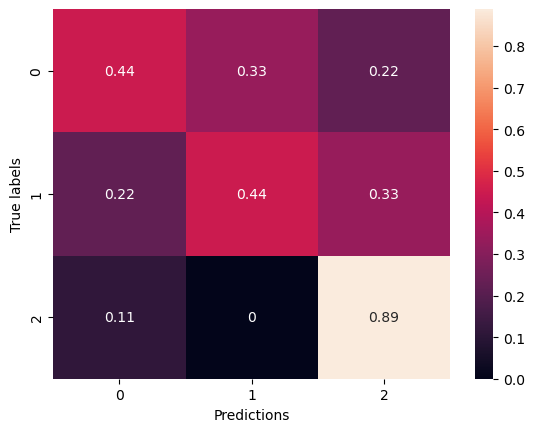

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▇▇▇▇███████████████████████████████
training_loss,█▇▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▃▃▅▅▆▆▅▆▆▆▆▅▅▆▅▄▅▄▄▄▆▆▇█▆▅▆▆▆▅▆▆▅▅▃▅
val_loss,██▇▇▆▅▃▃▂▂▃▂▃▂▂▃▃▂▅▆▄▅▆▆▃▃▂▁▂▄▃▂▃▃▂▂▂▄█▄


Epoch 1/100


2024-03-12 15:00:10.954404: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:00:10.956049: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:00:10.958220: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:00:12.566771: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:00:12.568643: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:00:12.570592: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:00:17.623832: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:00:18.201196: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 29.5754 - accuracy: 0.3995

2024-03-12 15:00:21.297339: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:00:21.299068: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:00:21.301063: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 332ms/step - loss: 29.5754 - accuracy: 0.3995 - val_loss: 27.6853 - val_accuracy: 0.1759
Epoch 2/100
7/7 [==============================] - 1s 76ms/step - loss: 26.4906 - accuracy: 0.5228 - val_loss: 25.1410 - val_accuracy: 0.1667
Epoch 3/100
7/7 [==============================] - 1s 76ms/step - loss: 23.8694 - accuracy: 0.5639 - val_loss: 22.7339 - val_accuracy: 0.1759
Epoch 4/100
7/7 [==============================] - 1s 74ms/step - loss: 21.4446 - accuracy: 0.6119 - val_loss: 20.4966 - val_accuracy: 0.2037
Epoch 5/100
7/7 [==============================] - 1s 75ms/step - loss: 19.2487 - accuracy: 0.6530 - val_loss: 18.4922 - val_accuracy: 0.2130
Epoch 6/100
7/7 [==============================] - 1s 75ms/step - loss: 17.2100 - accuracy: 0.7078 - val_loss: 16.8026 - val_accuracy: 0.2037
Epoch 7/100
7/7 [==============================] - 1s 76ms/step - loss: 15.4110 - accuracy: 0.7420 - val_loss: 15.2247 - val_accuracy: 0.1852
Epoch 8/100
7/7 

7/7 [==============================] - 1s 75ms/step - loss: 0.9642 - accuracy: 0.9589 - val_loss: 4.0463 - val_accuracy: 0.4907
Epoch 60/100
7/7 [==============================] - 1s 85ms/step - loss: 0.9281 - accuracy: 0.9795 - val_loss: 4.3676 - val_accuracy: 0.4352
Epoch 61/100
7/7 [==============================] - 1s 75ms/step - loss: 0.9230 - accuracy: 0.9658 - val_loss: 3.4903 - val_accuracy: 0.6204
Epoch 62/100
7/7 [==============================] - 1s 75ms/step - loss: 0.9039 - accuracy: 0.9703 - val_loss: 3.6778 - val_accuracy: 0.5093
Epoch 63/100
7/7 [==============================] - 1s 75ms/step - loss: 0.8768 - accuracy: 0.9703 - val_loss: 4.7927 - val_accuracy: 0.4167
Epoch 64/100
7/7 [==============================] - 1s 76ms/step - loss: 0.8675 - accuracy: 0.9726 - val_loss: 3.7407 - val_accuracy: 0.5370
Epoch 65/100
7/7 [==============================] - 1s 75ms/step - loss: 0.8655 - accuracy: 0.9726 - val_loss: 3.9694 - val_accuracy: 0.5833
Epoch 66/100
7/7 [========

2024-03-12 15:01:14.754714: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:01:14.756409: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:01:14.758650: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4533491134643555 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.2777777777777778, 'recall': 0.5555555555555556, 'f1-score': 0.3703703703703704, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.45925925925925926, 'recall': 0.3703703703703704, 'f1-score': 0.36887803554470217, 'support': 27}, 'weighted avg': {'precision': 0.4592592592592592, 'recall': 0.37037037037037035, 'f1-score': 0.36887803554470217, 'support': 27}}


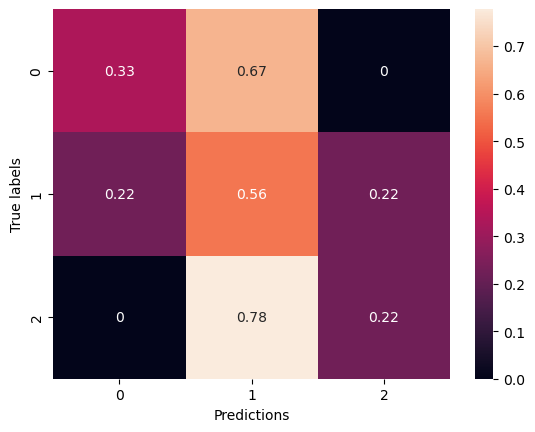

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▆▇▇██▇▇████████████████████████████
training_loss,█▇▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▂▆▅▅▆▇▆▇▆██▇▆▇█▆▅▇▇▆█▇▆▅▅▆▅▆▇▇▇▇▇▅█▄
val_loss,█▇▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂


Epoch 1/100


2024-03-12 15:01:36.085941: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:01:36.088038: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:01:36.089584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:01:37.693845: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:01:37.696149: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:01:37.697831: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:01:41.829880: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:01:42.419659: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 40.7773 - accuracy: 0.3174

2024-03-12 15:01:45.478865: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:01:45.480803: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:01:45.482446: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 331ms/step - loss: 40.7773 - accuracy: 0.3174 - val_loss: 37.8831 - val_accuracy: 0.1667
Epoch 2/100
7/7 [==============================] - 1s 89ms/step - loss: 36.1641 - accuracy: 0.5023 - val_loss: 34.0409 - val_accuracy: 0.1574
Epoch 3/100
7/7 [==============================] - 1s 78ms/step - loss: 32.1368 - accuracy: 0.6073 - val_loss: 30.4214 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 75ms/step - loss: 28.5436 - accuracy: 0.6210 - val_loss: 27.1105 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 81ms/step - loss: 25.2853 - accuracy: 0.6438 - val_loss: 24.1168 - val_accuracy: 0.1389
Epoch 6/100
7/7 [==============================] - 1s 75ms/step - loss: 22.3142 - accuracy: 0.6918 - val_loss: 21.3793 - val_accuracy: 0.1944
Epoch 7/100
7/7 [==============================] - 1s 76ms/step - loss: 19.7278 - accuracy: 0.7283 - val_loss: 18.9857 - val_accuracy: 0.2222
Epoch 8/100
7/7 

7/7 [==============================] - 1s 77ms/step - loss: 0.9823 - accuracy: 0.9543 - val_loss: 3.8891 - val_accuracy: 0.4907
Epoch 60/100
7/7 [==============================] - 1s 75ms/step - loss: 1.0053 - accuracy: 0.9521 - val_loss: 3.8535 - val_accuracy: 0.4537
Epoch 61/100
7/7 [==============================] - 1s 76ms/step - loss: 0.9768 - accuracy: 0.9680 - val_loss: 5.7058 - val_accuracy: 0.3333
Epoch 62/100
7/7 [==============================] - 1s 75ms/step - loss: 0.9623 - accuracy: 0.9658 - val_loss: 5.2405 - val_accuracy: 0.4074
Epoch 63/100
7/7 [==============================] - 1s 77ms/step - loss: 0.9839 - accuracy: 0.9635 - val_loss: 4.3556 - val_accuracy: 0.4722
Epoch 64/100
7/7 [==============================] - 1s 77ms/step - loss: 0.9212 - accuracy: 0.9703 - val_loss: 3.2018 - val_accuracy: 0.5833
Epoch 65/100
7/7 [==============================] - 1s 77ms/step - loss: 0.9327 - accuracy: 0.9658 - val_loss: 3.4898 - val_accuracy: 0.5463
Epoch 66/100
7/7 [========

2024-03-12 15:02:39.103716: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:02:39.105337: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:02:39.107191: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.374375104904175 s
{'0': {'precision': 0.47058823529411764, 'recall': 0.8888888888888888, 'f1-score': 0.6153846153846153, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.3420479302832244, 'recall': 0.48148148148148145, 'f1-score': 0.39031339031339024, 'support': 27}, 'weighted avg': {'precision': 0.3420479302832244, 'recall': 0.48148148148148145, 'f1-score': 0.39031339031339024, 'support': 27}}


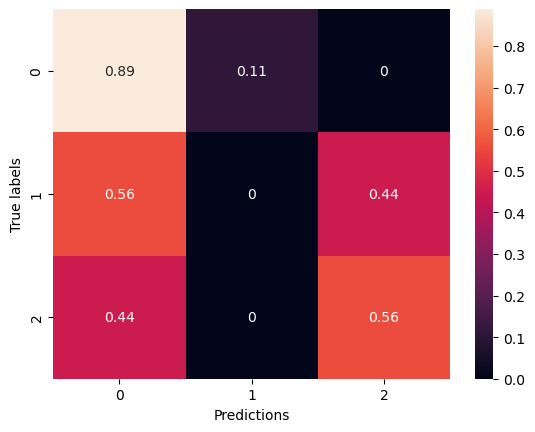

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▆▇▇▇▇▇▇██▇█▇▇▇█████████████████████
training_loss,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▂▃▅▇▆▄▅▆▇▇▆▇▆▇▆▆▄█▇▆▆▄▇▄▇▅▇█▇▅▆▅▇▆▅▇▅
val_loss,█▇▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:03:01.746140: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:03:01.747694: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:03:01.749725: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:03:03.342246: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:03:03.344546: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:03:03.346359: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:03:07.462505: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:03:08.037003: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 7.4200 - accuracy: 0.3607

2024-03-12 15:03:11.066120: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:03:11.068377: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:03:11.070218: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 329ms/step - loss: 7.4200 - accuracy: 0.3607 - val_loss: 6.9814 - val_accuracy: 0.1574
Epoch 2/100
7/7 [==============================] - 1s 76ms/step - loss: 6.9483 - accuracy: 0.4498 - val_loss: 6.8634 - val_accuracy: 0.1574
Epoch 3/100
7/7 [==============================] - 1s 76ms/step - loss: 6.6716 - accuracy: 0.4886 - val_loss: 6.7315 - val_accuracy: 0.1574
Epoch 4/100
7/7 [==============================] - 1s 76ms/step - loss: 6.3597 - accuracy: 0.5434 - val_loss: 6.6070 - val_accuracy: 0.1574
Epoch 5/100
7/7 [==============================] - 1s 75ms/step - loss: 6.2834 - accuracy: 0.5114 - val_loss: 6.4782 - val_accuracy: 0.1481
Epoch 6/100
7/7 [==============================] - 1s 76ms/step - loss: 5.9453 - accuracy: 0.5616 - val_loss: 6.2912 - val_accuracy: 0.1667
Epoch 7/100
7/7 [==============================] - 1s 76ms/step - loss: 5.7754 - accuracy: 0.5731 - val_loss: 6.1671 - val_accuracy: 0.1759
Epoch 8/100
7/7 [=============

7/7 [==============================] - 1s 77ms/step - loss: 1.2229 - accuracy: 0.9817 - val_loss: 5.2085 - val_accuracy: 0.4352
Epoch 60/100
7/7 [==============================] - 1s 85ms/step - loss: 1.2385 - accuracy: 0.9749 - val_loss: 5.4523 - val_accuracy: 0.3704
Epoch 61/100
7/7 [==============================] - 1s 77ms/step - loss: 1.2123 - accuracy: 0.9749 - val_loss: 4.0226 - val_accuracy: 0.6019
Epoch 62/100
7/7 [==============================] - 1s 77ms/step - loss: 1.2058 - accuracy: 0.9543 - val_loss: 4.2767 - val_accuracy: 0.5000
Epoch 63/100
7/7 [==============================] - 1s 78ms/step - loss: 1.1438 - accuracy: 0.9795 - val_loss: 4.0174 - val_accuracy: 0.5741
Epoch 64/100
7/7 [==============================] - 1s 77ms/step - loss: 1.1083 - accuracy: 0.9817 - val_loss: 3.9790 - val_accuracy: 0.5463
Epoch 65/100
7/7 [==============================] - 1s 77ms/step - loss: 1.0995 - accuracy: 0.9840 - val_loss: 4.2750 - val_accuracy: 0.4907
Epoch 66/100
7/7 [========

2024-03-12 15:04:05.259069: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:04:05.263515: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:04:05.265779: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6933152675628662 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.3333333333333333, 'recall': 0.48148148148148145, 'f1-score': 0.3887719298245614, 'support': 27}, 'weighted avg': {'precision': 0.3333333333333333, 'recall': 0.48148148148148145, 'f1-score': 0.3887719298245614, 'support': 27}}


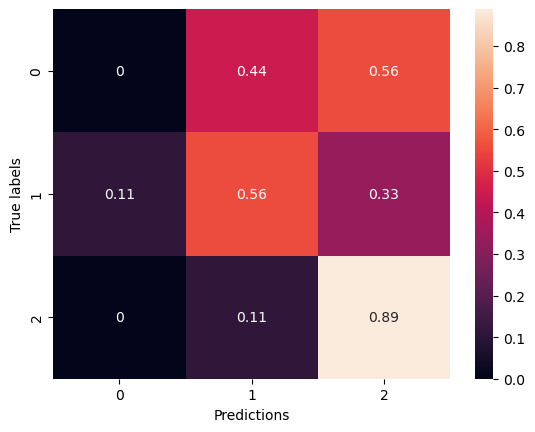

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▅▅▅▆▆▇▇▇▇▇▇█▇██████████████████████
training_loss,█▇▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▂▆▆▇▅▅▆▆▇▆▇▆▅▆▆█▇▇▅█▇▇█▅▆▇▆▄▇▃▇▅▄██
val_loss,██▇▆▆▆▄▄▃▃▃▃▃▃▄▃▄▄▄▃▃▂▃▅▂▂▃▂▄▂▂▂▅▂▅▂▄▅▁▁


Epoch 1/100


2024-03-12 15:04:29.110701: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:04:29.112548: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:04:29.114462: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:04:30.713454: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:04:30.715527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:04:30.717467: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:04:35.732853: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:04:36.307553: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 29.6165 - accuracy: 0.3721

2024-03-12 15:04:39.350913: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:04:39.353471: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:04:39.355428: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 328ms/step - loss: 29.6165 - accuracy: 0.3721 - val_loss: 27.7139 - val_accuracy: 0.2407
Epoch 2/100
7/7 [==============================] - 1s 75ms/step - loss: 26.9628 - accuracy: 0.4018 - val_loss: 25.3331 - val_accuracy: 0.2222
Epoch 3/100
7/7 [==============================] - 1s 75ms/step - loss: 24.4254 - accuracy: 0.4909 - val_loss: 23.1132 - val_accuracy: 0.2037
Epoch 4/100
7/7 [==============================] - 1s 76ms/step - loss: 22.1722 - accuracy: 0.5000 - val_loss: 21.1182 - val_accuracy: 0.1944
Epoch 5/100
7/7 [==============================] - 1s 98ms/step - loss: 20.1664 - accuracy: 0.5205 - val_loss: 19.2701 - val_accuracy: 0.1759
Epoch 6/100
7/7 [==============================] - 1s 104ms/step - loss: 18.2903 - accuracy: 0.5548 - val_loss: 17.5743 - val_accuracy: 0.1852
Epoch 7/100
7/7 [==============================] - 1s 90ms/step - loss: 16.6177 - accuracy: 0.5959 - val_loss: 16.0220 - val_accuracy: 0.2500
Epoch 8/100
7/7

7/7 [==============================] - 1s 76ms/step - loss: 1.0201 - accuracy: 0.9589 - val_loss: 4.2447 - val_accuracy: 0.5370
Epoch 60/100
7/7 [==============================] - 1s 76ms/step - loss: 1.0107 - accuracy: 0.9589 - val_loss: 4.0376 - val_accuracy: 0.5370
Epoch 61/100
7/7 [==============================] - 1s 75ms/step - loss: 0.9785 - accuracy: 0.9612 - val_loss: 3.9888 - val_accuracy: 0.6019
Epoch 62/100
7/7 [==============================] - 1s 76ms/step - loss: 0.9396 - accuracy: 0.9703 - val_loss: 3.9386 - val_accuracy: 0.5463
Epoch 63/100
7/7 [==============================] - 1s 75ms/step - loss: 1.0047 - accuracy: 0.9521 - val_loss: 3.7633 - val_accuracy: 0.5833
Epoch 64/100
7/7 [==============================] - 1s 75ms/step - loss: 0.9813 - accuracy: 0.9521 - val_loss: 6.4092 - val_accuracy: 0.3056
Epoch 65/100
7/7 [==============================] - 1s 87ms/step - loss: 1.0103 - accuracy: 0.9475 - val_loss: 6.3346 - val_accuracy: 0.3056
Epoch 66/100
7/7 [========

2024-03-12 15:05:33.606168: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:05:33.608475: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:05:33.610263: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5007050037384033 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.34615384615384615, 'recall': 1.0, 'f1-score': 0.5142857142857142, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.11538461538461538, 'recall': 0.3333333333333333, 'f1-score': 0.1714285714285714, 'support': 27}, 'weighted avg': {'precision': 0.11538461538461539, 'recall': 0.3333333333333333, 'f1-score': 0.1714285714285714, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


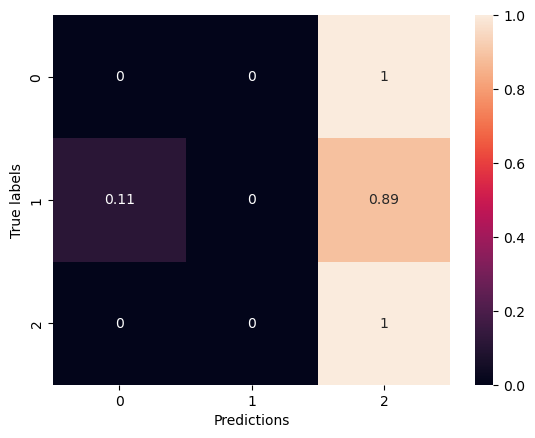

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▅▄▄▅▅▆▆▇▇▇▇▇▇▇▇████████▇█████████▇███
training_loss,█▇▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▃▃▃▄▅▆▆▇█▇▆███▄▇▇▆█▆▇█▃▆▄▇█▇▄▇▇█▇▃▇▅▇
val_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:05:59.901194: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:05:59.903264: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:05:59.904846: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:06:01.505144: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:06:01.506860: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:06:01.508930: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:06:05.626088: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:06:06.206433: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 41.0504 - accuracy: 0.3995

2024-03-12 15:06:09.987535: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:06:09.989115: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:06:09.990939: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 455ms/step - loss: 41.0504 - accuracy: 0.3995 - val_loss: 38.2768 - val_accuracy: 0.1759
Epoch 2/100
7/7 [==============================] - 1s 76ms/step - loss: 36.9351 - accuracy: 0.4041 - val_loss: 34.4938 - val_accuracy: 0.2222
Epoch 3/100
7/7 [==============================] - 1s 76ms/step - loss: 33.2075 - accuracy: 0.4429 - val_loss: 31.0118 - val_accuracy: 0.1944
Epoch 4/100
7/7 [==============================] - 1s 76ms/step - loss: 29.6515 - accuracy: 0.4909 - val_loss: 27.9072 - val_accuracy: 0.1481
Epoch 5/100
7/7 [==============================] - 1s 76ms/step - loss: 26.5136 - accuracy: 0.5434 - val_loss: 25.1049 - val_accuracy: 0.1759
Epoch 6/100
7/7 [==============================] - 1s 76ms/step - loss: 23.7552 - accuracy: 0.5479 - val_loss: 22.5519 - val_accuracy: 0.2222
Epoch 7/100
7/7 [==============================] - 1s 76ms/step - loss: 21.2195 - accuracy: 0.6027 - val_loss: 20.2477 - val_accuracy: 0.2130
Epoch 8/100
7/7 

7/7 [==============================] - 1s 76ms/step - loss: 1.1156 - accuracy: 0.9566 - val_loss: 3.9504 - val_accuracy: 0.5000
Epoch 60/100
7/7 [==============================] - 1s 76ms/step - loss: 1.1354 - accuracy: 0.9429 - val_loss: 3.7114 - val_accuracy: 0.6204
Epoch 61/100
7/7 [==============================] - 1s 76ms/step - loss: 1.1165 - accuracy: 0.9521 - val_loss: 3.9468 - val_accuracy: 0.5370
Epoch 62/100
7/7 [==============================] - 1s 75ms/step - loss: 1.0518 - accuracy: 0.9680 - val_loss: 3.7449 - val_accuracy: 0.4815
Epoch 63/100
7/7 [==============================] - 1s 76ms/step - loss: 1.0331 - accuracy: 0.9635 - val_loss: 4.0056 - val_accuracy: 0.4537
Epoch 64/100
7/7 [==============================] - 1s 75ms/step - loss: 1.0046 - accuracy: 0.9703 - val_loss: 3.8713 - val_accuracy: 0.5370
Epoch 65/100
7/7 [==============================] - 1s 76ms/step - loss: 1.0272 - accuracy: 0.9589 - val_loss: 3.8105 - val_accuracy: 0.5556
Epoch 66/100
7/7 [========

2024-03-12 15:07:03.594098: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:07:03.595713: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:07:03.597625: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.459035873413086 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.5, 'recall': 1.0, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.3148148148148148, 'recall': 0.48148148148148145, 'f1-score': 0.3703703703703704, 'support': 27}, 'weighted avg': {'precision': 0.3148148148148148, 'recall': 0.48148148148148145, 'f1-score': 0.37037037037037035, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


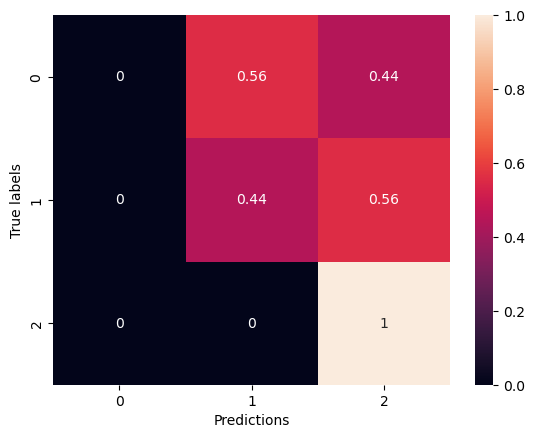

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▅▅▆▆▆▇▇▇▇▇▇█▇▇█████████▇███████████
training_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▂▃▅▄▆▆▅▄▆▇▇▇▄███▅█▇▇▆▆▆▇▄▇▅▆▇▆▇▅▅▅▆▆▇
val_loss,█▇▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:07:25.896038: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:07:25.897673: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:07:25.899527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:07:27.494793: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:07:27.497368: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:07:27.499285: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:07:31.633459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:07:32.214740: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 7.5012 - accuracy: 0.3333

2024-03-12 15:07:35.257949: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:07:35.259584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:07:35.261782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 329ms/step - loss: 7.5012 - accuracy: 0.3333 - val_loss: 6.8114 - val_accuracy: 0.2130
Epoch 2/100
7/7 [==============================] - 1s 75ms/step - loss: 7.2366 - accuracy: 0.3470 - val_loss: 6.6712 - val_accuracy: 0.1852
Epoch 3/100
7/7 [==============================] - 1s 76ms/step - loss: 6.8567 - accuracy: 0.3630 - val_loss: 6.5225 - val_accuracy: 0.1759
Epoch 4/100
7/7 [==============================] - 1s 75ms/step - loss: 6.6889 - accuracy: 0.3973 - val_loss: 6.4071 - val_accuracy: 0.1667
Epoch 5/100
7/7 [==============================] - 1s 76ms/step - loss: 6.5616 - accuracy: 0.4018 - val_loss: 6.3102 - val_accuracy: 0.1481
Epoch 6/100
7/7 [==============================] - 1s 75ms/step - loss: 6.3568 - accuracy: 0.4292 - val_loss: 6.2512 - val_accuracy: 0.1481
Epoch 7/100
7/7 [==============================] - 1s 76ms/step - loss: 6.2646 - accuracy: 0.4041 - val_loss: 6.1530 - val_accuracy: 0.1574
Epoch 8/100
7/7 [=============

7/7 [==============================] - 1s 77ms/step - loss: 1.9632 - accuracy: 0.7922 - val_loss: 3.5350 - val_accuracy: 0.5648
Epoch 60/100
7/7 [==============================] - 1s 77ms/step - loss: 1.8707 - accuracy: 0.8265 - val_loss: 3.3439 - val_accuracy: 0.5648
Epoch 61/100
7/7 [==============================] - 1s 76ms/step - loss: 1.8971 - accuracy: 0.7740 - val_loss: 3.4512 - val_accuracy: 0.5278
Epoch 62/100
7/7 [==============================] - 1s 75ms/step - loss: 1.8027 - accuracy: 0.8311 - val_loss: 3.4819 - val_accuracy: 0.5463
Epoch 63/100
7/7 [==============================] - 1s 77ms/step - loss: 1.8745 - accuracy: 0.7900 - val_loss: 3.2708 - val_accuracy: 0.5741
Epoch 64/100
7/7 [==============================] - 1s 76ms/step - loss: 1.7818 - accuracy: 0.8128 - val_loss: 3.8033 - val_accuracy: 0.5278
Epoch 65/100
7/7 [==============================] - 1s 76ms/step - loss: 1.7555 - accuracy: 0.8174 - val_loss: 3.3977 - val_accuracy: 0.5648
Epoch 66/100
7/7 [========

2024-03-12 15:08:29.332379: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:08:29.334151: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:08:29.335969: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4589481353759766 s
{'0': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.391304347826087, 'recall': 1.0, 'f1-score': 0.5625, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.3804347826086956, 'recall': 0.4444444444444444, 'f1-score': 0.3413461538461539, 'support': 27}, 'weighted avg': {'precision': 0.3804347826086957, 'recall': 0.4444444444444444, 'f1-score': 0.3413461538461538, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


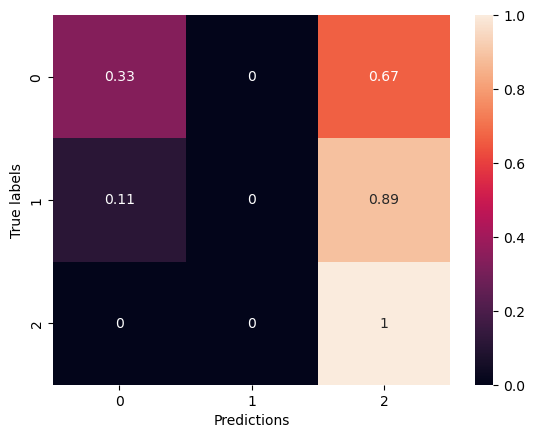

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▂▂▃▃▃▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇███████
training_loss,█▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▂▂▂▂▁▁▂▃▃▅▅▆▇▇▇▇▇█▇▇█▇▇▇▇▆▇▆▅▆▇▇██▆▇▇▇▇
val_loss,█▇▇▇▆▆▆▆▅▅▃▄▃▃▃▃▃▃▂▂▂▁▂▂▁▂▃▂▂▃▂▂▁▁▁▂▂▂▂▂


Epoch 1/100


2024-03-12 15:08:54.693899: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:08:54.695963: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:08:54.697654: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:08:56.292884: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:08:56.295268: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:08:56.296913: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:09:01.378528: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:09:01.955027: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 29.8876 - accuracy: 0.3630

2024-03-12 15:09:04.983451: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:09:04.984867: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:09:04.987440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 326ms/step - loss: 29.8876 - accuracy: 0.3630 - val_loss: 28.0194 - val_accuracy: 0.1759
Epoch 2/100
7/7 [==============================] - 1s 76ms/step - loss: 27.4840 - accuracy: 0.3539 - val_loss: 25.8206 - val_accuracy: 0.2130
Epoch 3/100
7/7 [==============================] - 1s 75ms/step - loss: 25.1520 - accuracy: 0.3973 - val_loss: 23.7998 - val_accuracy: 0.1944
Epoch 4/100
7/7 [==============================] - 1s 76ms/step - loss: 23.1755 - accuracy: 0.3927 - val_loss: 21.9168 - val_accuracy: 0.1574
Epoch 5/100
7/7 [==============================] - 1s 76ms/step - loss: 21.3777 - accuracy: 0.3790 - val_loss: 20.2112 - val_accuracy: 0.1481
Epoch 6/100
7/7 [==============================] - 1s 76ms/step - loss: 19.5942 - accuracy: 0.4132 - val_loss: 18.6316 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 75ms/step - loss: 18.0550 - accuracy: 0.3995 - val_loss: 17.1725 - val_accuracy: 0.1759
Epoch 8/100
7/7 

7/7 [==============================] - 1s 75ms/step - loss: 1.3684 - accuracy: 0.9178 - val_loss: 3.5798 - val_accuracy: 0.5648
Epoch 60/100
7/7 [==============================] - 1s 76ms/step - loss: 1.3081 - accuracy: 0.9269 - val_loss: 3.5551 - val_accuracy: 0.6204
Epoch 61/100
7/7 [==============================] - 1s 76ms/step - loss: 1.3104 - accuracy: 0.9178 - val_loss: 3.5071 - val_accuracy: 0.5463
Epoch 62/100
7/7 [==============================] - 1s 75ms/step - loss: 1.2414 - accuracy: 0.9224 - val_loss: 3.4919 - val_accuracy: 0.5648
Epoch 63/100
7/7 [==============================] - 1s 77ms/step - loss: 1.2393 - accuracy: 0.9292 - val_loss: 3.3278 - val_accuracy: 0.5463
Epoch 64/100
7/7 [==============================] - 1s 77ms/step - loss: 1.2352 - accuracy: 0.9292 - val_loss: 3.4505 - val_accuracy: 0.6111
Epoch 65/100
7/7 [==============================] - 1s 76ms/step - loss: 1.1831 - accuracy: 0.9224 - val_loss: 3.2367 - val_accuracy: 0.5741
Epoch 66/100
7/7 [========

2024-03-12 15:09:58.637022: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:09:58.639145: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:09:58.640801: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4624040126800537 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.2857142857142857, 'recall': 0.4444444444444444, 'f1-score': 0.34782608695652173, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.373015873015873, 'recall': 0.3703703703703704, 'f1-score': 0.34693618103229085, 'support': 27}, 'weighted avg': {'precision': 0.373015873015873, 'recall': 0.37037037037037035, 'f1-score': 0.34693618103229085, 'support': 27}}


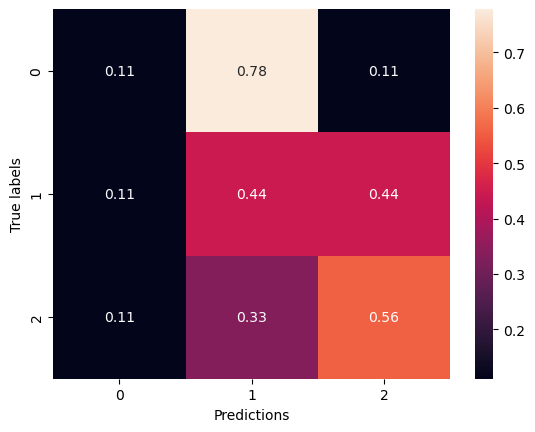

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▁▂▂▃▃▄▄▄▅▅▅▆▆▆▆▇▇▇▇▇▇▇██▇███████▇████
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▁▃▄▃▂▅▆▆▆▆█▆███▇▇▆█▇▇▇▇█▇▇▄▇█▇▇▇▄▆▇▇▆▆
val_loss,█▇▅▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁▁▁


Epoch 1/100


2024-03-12 15:10:20.527681: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:10:20.529841: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:10:20.531482: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:10:22.146867: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:10:22.149118: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:10:22.150793: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:10:26.263821: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:10:26.842043: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 41.2213 - accuracy: 0.3288

2024-03-12 15:10:29.943875: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:10:29.945945: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:10:29.947666: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 475ms/step - loss: 41.2213 - accuracy: 0.3288 - val_loss: 38.3542 - val_accuracy: 0.2500
Epoch 2/100
7/7 [==============================] - 1s 75ms/step - loss: 37.3198 - accuracy: 0.3836 - val_loss: 34.9244 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 76ms/step - loss: 33.8645 - accuracy: 0.3653 - val_loss: 31.7812 - val_accuracy: 0.1481
Epoch 4/100
7/7 [==============================] - 1s 75ms/step - loss: 30.7119 - accuracy: 0.3744 - val_loss: 28.8686 - val_accuracy: 0.1574
Epoch 5/100
7/7 [==============================] - 1s 76ms/step - loss: 27.8299 - accuracy: 0.4064 - val_loss: 26.1811 - val_accuracy: 0.1667
Epoch 6/100
7/7 [==============================] - 1s 75ms/step - loss: 25.3246 - accuracy: 0.3858 - val_loss: 23.7802 - val_accuracy: 0.1667
Epoch 7/100
7/7 [==============================] - 1s 76ms/step - loss: 22.9904 - accuracy: 0.3904 - val_loss: 21.6189 - val_accuracy: 0.1481
Epoch 8/100
7/7 

7/7 [==============================] - 1s 76ms/step - loss: 1.3698 - accuracy: 0.9018 - val_loss: 3.5469 - val_accuracy: 0.5185
Epoch 60/100
7/7 [==============================] - 1s 76ms/step - loss: 1.4223 - accuracy: 0.8767 - val_loss: 3.1686 - val_accuracy: 0.5926
Epoch 61/100
7/7 [==============================] - 1s 77ms/step - loss: 1.2728 - accuracy: 0.9361 - val_loss: 3.0678 - val_accuracy: 0.6111
Epoch 62/100
7/7 [==============================] - 1s 76ms/step - loss: 1.3455 - accuracy: 0.8973 - val_loss: 3.7352 - val_accuracy: 0.5741
Epoch 63/100
7/7 [==============================] - 1s 75ms/step - loss: 1.3785 - accuracy: 0.8744 - val_loss: 3.9257 - val_accuracy: 0.5556
Epoch 64/100
7/7 [==============================] - 1s 76ms/step - loss: 1.2859 - accuracy: 0.9041 - val_loss: 3.6824 - val_accuracy: 0.5833
Epoch 65/100
7/7 [==============================] - 1s 76ms/step - loss: 1.2610 - accuracy: 0.9018 - val_loss: 3.6509 - val_accuracy: 0.5093
Epoch 66/100
7/7 [========

2024-03-12 15:11:24.583364: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:11:24.585537: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:11:24.587359: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4597041606903076 s
{'0': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5683760683760682, 'recall': 0.5555555555555556, 'f1-score': 0.5467617349970291, 'support': 27}, 'weighted avg': {'precision': 0.5683760683760684, 'recall': 0.5555555555555556, 'f1-score': 0.5467617349970291, 'support': 27}}


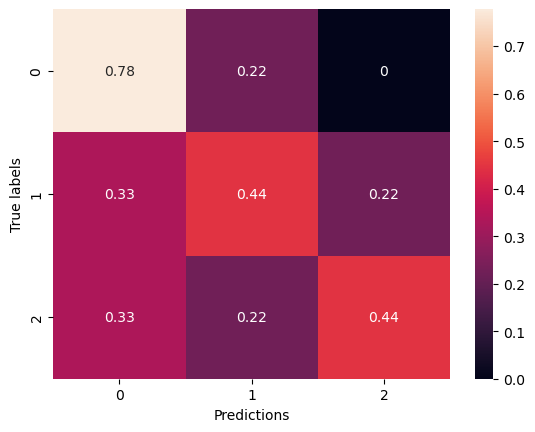

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▃▃▃▃▄▅▄▅▅▆▆▆▆▆▇▇▇▇▇▇█▇▇▇▇██▇▇█████▇█
training_loss,█▇▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▂▃▅▅▇▆▇▆▇▇▇▇▆▆▅▇█▆█▇▇█▇▇▇▇▅▆▇█▅▆▇▅
val_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:11:48.008082: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:11:48.010382: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:11:48.012008: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:11:49.625627: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:11:49.628013: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:11:49.629739: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:11:53.820599: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:11:54.401461: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 8.0747 - accuracy: 0.4018

2024-03-12 15:11:57.666755: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:11:57.668573: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:11:57.670542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 363ms/step - loss: 8.0747 - accuracy: 0.4018 - val_loss: 7.4313 - val_accuracy: 0.3333
Epoch 2/100
7/7 [==============================] - 1s 110ms/step - loss: 7.2794 - accuracy: 0.5594 - val_loss: 7.3872 - val_accuracy: 0.1389
Epoch 3/100
7/7 [==============================] - 1s 111ms/step - loss: 6.8740 - accuracy: 0.6393 - val_loss: 7.3709 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 110ms/step - loss: 6.5090 - accuracy: 0.7352 - val_loss: 7.1545 - val_accuracy: 0.1481
Epoch 5/100
7/7 [==============================] - 1s 110ms/step - loss: 6.2806 - accuracy: 0.7123 - val_loss: 6.9904 - val_accuracy: 0.1296
Epoch 6/100
7/7 [==============================] - 1s 111ms/step - loss: 5.8630 - accuracy: 0.7877 - val_loss: 7.0559 - val_accuracy: 0.1296
Epoch 7/100
7/7 [==============================] - 1s 110ms/step - loss: 5.6578 - accuracy: 0.7808 - val_loss: 6.6868 - val_accuracy: 0.1852
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 111ms/step - loss: 0.9673 - accuracy: 0.9886 - val_loss: 4.4226 - val_accuracy: 0.5185
Epoch 60/100
7/7 [==============================] - 1s 110ms/step - loss: 0.9577 - accuracy: 0.9909 - val_loss: 5.6735 - val_accuracy: 0.3889
Epoch 61/100
7/7 [==============================] - 1s 111ms/step - loss: 0.9314 - accuracy: 0.9840 - val_loss: 4.6652 - val_accuracy: 0.4444
Epoch 62/100
7/7 [==============================] - 1s 111ms/step - loss: 0.9111 - accuracy: 0.9817 - val_loss: 4.8918 - val_accuracy: 0.4167
Epoch 63/100
7/7 [==============================] - 1s 111ms/step - loss: 0.9115 - accuracy: 0.9749 - val_loss: 4.1500 - val_accuracy: 0.5370
Epoch 64/100
7/7 [==============================] - 1s 117ms/step - loss: 0.8841 - accuracy: 0.9840 - val_loss: 4.3644 - val_accuracy: 0.5926
Epoch 65/100
7/7 [==============================] - 1s 111ms/step - loss: 0.8895 - accuracy: 0.9817 - val_loss: 4.3094 - val_accuracy: 0.5370
Epoch 

wandb: Network error (ConnectTimeout), entering retry loop.


7/7 [==============================] - 1s 113ms/step - loss: 0.7494 - accuracy: 0.9840 - val_loss: 4.0642 - val_accuracy: 0.5370
Epoch 75/100
7/7 [==============================] - 1s 110ms/step - loss: 0.7649 - accuracy: 0.9840 - val_loss: 3.7361 - val_accuracy: 0.6111
Epoch 76/100
7/7 [==============================] - 1s 112ms/step - loss: 0.7446 - accuracy: 0.9795 - val_loss: 4.0062 - val_accuracy: 0.5833
Epoch 77/100
7/7 [==============================] - 1s 110ms/step - loss: 0.7293 - accuracy: 0.9840 - val_loss: 4.2152 - val_accuracy: 0.5370
Epoch 78/100
7/7 [==============================] - 1s 110ms/step - loss: 0.7144 - accuracy: 0.9840 - val_loss: 4.1349 - val_accuracy: 0.5370
Epoch 79/100
7/7 [==============================] - 1s 111ms/step - loss: 0.6817 - accuracy: 0.9932 - val_loss: 4.1067 - val_accuracy: 0.5741
Epoch 80/100
7/7 [==============================] - 1s 114ms/step - loss: 0.6825 - accuracy: 0.9863 - val_loss: 4.0858 - val_accuracy: 0.5370
Epoch 81/100
7/7 [=

2024-03-12 15:13:15.651638: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:13:15.653230: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:13:15.655211: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.460547924041748 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.2857142857142857, 'recall': 0.4444444444444444, 'f1-score': 0.34782608695652173, 'support': 9}, '2': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.4134199134199134, 'recall': 0.3703703703703704, 'f1-score': 0.34321475625823455, 'support': 27}, 'weighted avg': {'precision': 0.41341991341991347, 'recall': 0.37037037037037035, 'f1-score': 0.3432147562582345, 'support': 27}}


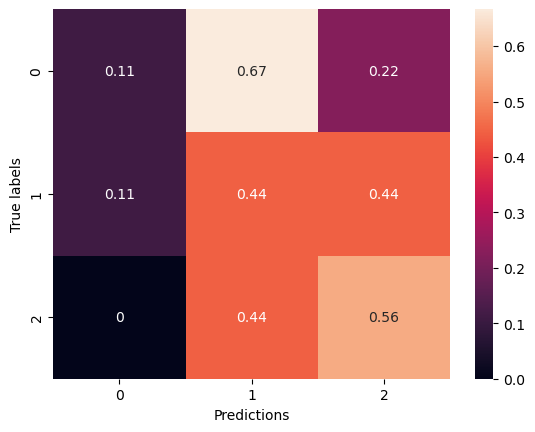

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▇▇████████████████████████████████
training_loss,█▇▆▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▁▂▃▂▄▆▅▇▇▇▆▇▆▇▇▆▇▆▇▆▆▇▆█▆▆▇▇▇▇▇▇▆▇▇███
val_loss,██▇▆▆▅▄▄▄▃▄▃▃▃▄▂▂▃▃▃▃▃▂▃▃▂▄▄▂▂▂▂▃▂▂▂▂▁▁▁


Epoch 1/100


2024-03-12 15:15:43.835130: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:15:43.837391: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:15:43.839155: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:15:45.449342: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:15:45.452035: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:15:45.454572: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:15:50.646985: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:15:51.226984: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 32.8468 - accuracy: 0.3813

2024-03-12 15:15:54.511889: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:15:54.514092: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:15:54.515653: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 370ms/step - loss: 32.8468 - accuracy: 0.3813 - val_loss: 30.4272 - val_accuracy: 0.3704
Epoch 2/100
7/7 [==============================] - 1s 109ms/step - loss: 29.0992 - accuracy: 0.5548 - val_loss: 27.4467 - val_accuracy: 0.1852
Epoch 3/100
7/7 [==============================] - 1s 110ms/step - loss: 25.7711 - accuracy: 0.6667 - val_loss: 24.5520 - val_accuracy: 0.2222
Epoch 4/100
7/7 [==============================] - 1s 111ms/step - loss: 22.8936 - accuracy: 0.6621 - val_loss: 21.8519 - val_accuracy: 0.2037
Epoch 5/100
7/7 [==============================] - 1s 110ms/step - loss: 20.1359 - accuracy: 0.7648 - val_loss: 19.5564 - val_accuracy: 0.2037
Epoch 6/100
7/7 [==============================] - 1s 110ms/step - loss: 17.8085 - accuracy: 0.7489 - val_loss: 17.3740 - val_accuracy: 0.2685
Epoch 7/100
7/7 [==============================] - 1s 111ms/step - loss: 15.6864 - accuracy: 0.8174 - val_loss: 15.3603 - val_accuracy: 0.2963
Epoch 8/10

Epoch 59/100
7/7 [==============================] - 1s 110ms/step - loss: 0.9152 - accuracy: 0.9612 - val_loss: 3.7553 - val_accuracy: 0.5463
Epoch 60/100
7/7 [==============================] - 1s 110ms/step - loss: 0.8775 - accuracy: 0.9817 - val_loss: 3.6745 - val_accuracy: 0.5463
Epoch 61/100
7/7 [==============================] - 1s 110ms/step - loss: 0.8902 - accuracy: 0.9726 - val_loss: 3.4512 - val_accuracy: 0.5741
Epoch 62/100
7/7 [==============================] - 1s 111ms/step - loss: 0.8429 - accuracy: 0.9795 - val_loss: 3.4411 - val_accuracy: 0.6389
Epoch 63/100
7/7 [==============================] - 1s 111ms/step - loss: 0.8313 - accuracy: 0.9703 - val_loss: 3.7362 - val_accuracy: 0.5741
Epoch 64/100
7/7 [==============================] - 1s 110ms/step - loss: 0.8748 - accuracy: 0.9498 - val_loss: 3.4460 - val_accuracy: 0.5463
Epoch 65/100
7/7 [==============================] - 1s 110ms/step - loss: 0.8061 - accuracy: 0.9817 - val_loss: 3.2713 - val_accuracy: 0.6667
Epoch 

2024-03-12 15:17:11.733477: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:17:11.735852: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:17:11.737521: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5298080444335938 s
{'0': {'precision': 0.625, 'recall': 0.5555555555555556, 'f1-score': 0.5882352941176471, 'support': 9}, '1': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6138888888888889, 'recall': 0.5555555555555555, 'f1-score': 0.5443690296631473, 'support': 27}, 'weighted avg': {'precision': 0.6138888888888888, 'recall': 0.5555555555555556, 'f1-score': 0.5443690296631473, 'support': 27}}


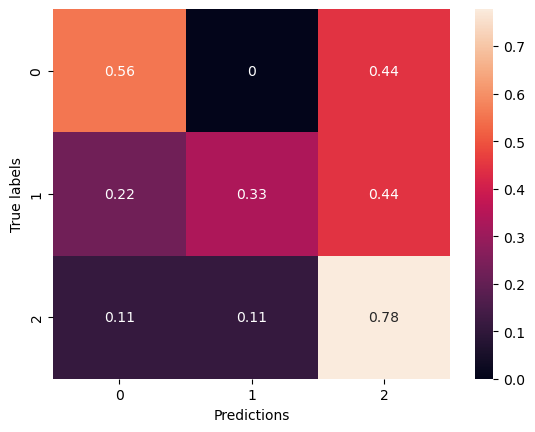

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇█▇▇███████▇█████████████████▇████
training_loss,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▂▃▃▅▄▄▅▆▃▄▄█▅▆▆▇▇▇▇▇▆▆▇▆█▇▇▅▆▅▆▄▅▅▅▇▅▅
val_loss,█▆▅▄▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:17:33.669201: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:17:33.671532: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:17:33.673024: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:17:35.286809: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:17:35.289071: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:17:35.290843: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:17:39.465125: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:17:40.048051: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 45.0349 - accuracy: 0.4178

2024-03-12 15:17:43.331918: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:17:43.333486: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:17:43.335462: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 512ms/step - loss: 45.0349 - accuracy: 0.4178 - val_loss: 41.5701 - val_accuracy: 0.1574
Epoch 2/100
7/7 [==============================] - 1s 111ms/step - loss: 39.3430 - accuracy: 0.5799 - val_loss: 36.6986 - val_accuracy: 0.1111
Epoch 3/100
7/7 [==============================] - 1s 111ms/step - loss: 34.4204 - accuracy: 0.6210 - val_loss: 32.2696 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 145ms/step - loss: 29.9399 - accuracy: 0.6941 - val_loss: 28.3390 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 119ms/step - loss: 26.0300 - accuracy: 0.7169 - val_loss: 24.7856 - val_accuracy: 0.1389
Epoch 6/100
7/7 [==============================] - 1s 112ms/step - loss: 22.5289 - accuracy: 0.7489 - val_loss: 21.6071 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 112ms/step - loss: 19.5674 - accuracy: 0.7900 - val_loss: 19.1946 - val_accuracy: 0.1389
Epoch 8/10

Epoch 59/100
7/7 [==============================] - 1s 111ms/step - loss: 0.9936 - accuracy: 0.9703 - val_loss: 4.1208 - val_accuracy: 0.4630
Epoch 60/100
7/7 [==============================] - 1s 110ms/step - loss: 1.0311 - accuracy: 0.9521 - val_loss: 4.1952 - val_accuracy: 0.5648
Epoch 61/100
7/7 [==============================] - 1s 111ms/step - loss: 0.9401 - accuracy: 0.9772 - val_loss: 3.7471 - val_accuracy: 0.6204
Epoch 62/100
7/7 [==============================] - 1s 113ms/step - loss: 0.8919 - accuracy: 0.9840 - val_loss: 3.8183 - val_accuracy: 0.5833
Epoch 63/100
7/7 [==============================] - 1s 111ms/step - loss: 0.8869 - accuracy: 0.9817 - val_loss: 4.4122 - val_accuracy: 0.4722
Epoch 64/100
7/7 [==============================] - 1s 112ms/step - loss: 0.8711 - accuracy: 0.9726 - val_loss: 4.1996 - val_accuracy: 0.4907
Epoch 65/100
7/7 [==============================] - 1s 111ms/step - loss: 0.8914 - accuracy: 0.9658 - val_loss: 4.3650 - val_accuracy: 0.5278
Epoch 

2024-03-12 15:19:02.365018: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:19:02.368369: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:19:02.370483: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4838042259216309 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, '2': {'precision': 0.7777777777777778, 'recall': 0.7777777777777778, 'f1-score': 0.7777777777777778, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.5925925925925926, 'recall': 0.5925925925925926, 'f1-score': 0.5647219125479995, 'support': 27}, 'weighted avg': {'precision': 0.5925925925925926, 'recall': 0.5925925925925926, 'f1-score': 0.5647219125479995, 'support': 27}}


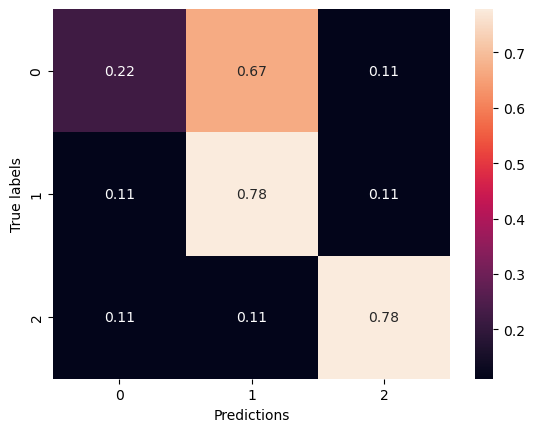

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▇▆▇▇▇▇▇▇▇▇▇▇▇█▇████████▇█████████▇██
training_loss,█▆▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▂▅▄▆▅▇▇▆▄▅▄▄▄▇▆▇▇▇▅▇▆█▆▅▇▇▅▆▅▇▆▇▄▇▆▅▅
val_loss,█▆▄▃▃▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:19:25.507290: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:19:25.509649: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:19:25.511461: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:19:27.129843: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:19:27.131963: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:19:27.133826: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:19:31.302665: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:19:31.886797: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 8.0280 - accuracy: 0.3653

2024-03-12 15:19:35.238361: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:19:35.240595: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:19:35.242205: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 376ms/step - loss: 8.0280 - accuracy: 0.3653 - val_loss: 7.4596 - val_accuracy: 0.3333
Epoch 2/100
7/7 [==============================] - 1s 111ms/step - loss: 7.5459 - accuracy: 0.4863 - val_loss: 7.3382 - val_accuracy: 0.2222
Epoch 3/100
7/7 [==============================] - 1s 111ms/step - loss: 7.2795 - accuracy: 0.5320 - val_loss: 7.2722 - val_accuracy: 0.1852
Epoch 4/100
7/7 [==============================] - 1s 112ms/step - loss: 6.8927 - accuracy: 0.5799 - val_loss: 7.1928 - val_accuracy: 0.1389
Epoch 5/100
7/7 [==============================] - 1s 112ms/step - loss: 6.6420 - accuracy: 0.6119 - val_loss: 7.0735 - val_accuracy: 0.1481
Epoch 6/100
7/7 [==============================] - 1s 111ms/step - loss: 6.4034 - accuracy: 0.6553 - val_loss: 6.9266 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 111ms/step - loss: 6.0831 - accuracy: 0.6941 - val_loss: 6.6212 - val_accuracy: 0.2037
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 110ms/step - loss: 1.2836 - accuracy: 0.9726 - val_loss: 5.1022 - val_accuracy: 0.4815
Epoch 60/100
7/7 [==============================] - 1s 114ms/step - loss: 1.2225 - accuracy: 0.9817 - val_loss: 5.2149 - val_accuracy: 0.4074
Epoch 61/100
7/7 [==============================] - 1s 111ms/step - loss: 1.2399 - accuracy: 0.9749 - val_loss: 5.2635 - val_accuracy: 0.3889
Epoch 62/100
7/7 [==============================] - 1s 111ms/step - loss: 1.1721 - accuracy: 0.9840 - val_loss: 5.1003 - val_accuracy: 0.4537
Epoch 63/100
7/7 [==============================] - 1s 112ms/step - loss: 1.1582 - accuracy: 0.9817 - val_loss: 4.7912 - val_accuracy: 0.4352
Epoch 64/100
7/7 [==============================] - 1s 111ms/step - loss: 1.1633 - accuracy: 0.9680 - val_loss: 4.7929 - val_accuracy: 0.4630
Epoch 65/100
7/7 [==============================] - 1s 111ms/step - loss: 1.1330 - accuracy: 0.9703 - val_loss: 4.7883 - val_accuracy: 0.5278
Epoch 

2024-03-12 15:20:53.696415: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:20:53.698327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:20:53.700112: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4756519794464111 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.35714285714285715, 'recall': 0.5555555555555556, 'f1-score': 0.43478260869565216, 'support': 9}, '2': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.4675324675324675, 'recall': 0.4444444444444445, 'f1-score': 0.4055335968379447, 'support': 27}, 'weighted avg': {'precision': 0.46753246753246747, 'recall': 0.4444444444444444, 'f1-score': 0.40553359683794465, 'support': 27}}


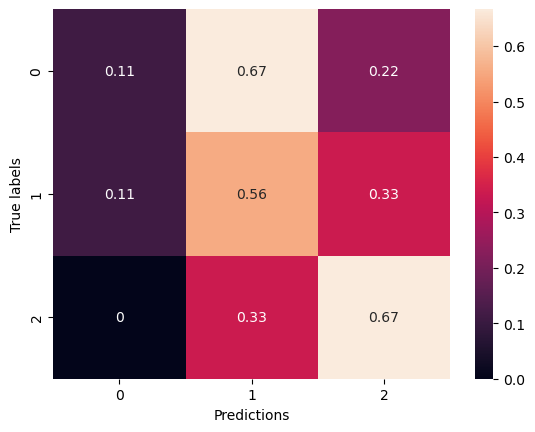

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▅▆▆▇▇▇▇▇▇██▇███████████████████████
training_loss,█▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▁▃▅▆▅▆█▇▅▆▇▇▆▇▆▇▆▅▅▆▆▆▅▆▆▇█▇▇▆▄▅▆▅▆▇█▆
val_loss,██▇▆▅▅▄▄▃▃▄▄▄▄▄▄▃▄▃▄▆▄▃▄▄▃▃▂▂▂▃▃▅▃▃▅▃▂▁▂


Epoch 1/100


2024-03-12 15:21:14.858146: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:21:14.859723: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:21:14.861667: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:21:16.486814: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:21:16.489123: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:21:16.491124: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:21:21.662783: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:21:22.254701: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 32.9079 - accuracy: 0.3995

2024-03-12 15:21:25.528913: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:21:25.530503: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:21:25.532433: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 367ms/step - loss: 32.9079 - accuracy: 0.3995 - val_loss: 30.7312 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 112ms/step - loss: 29.3656 - accuracy: 0.4932 - val_loss: 27.7274 - val_accuracy: 0.1481
Epoch 3/100
7/7 [==============================] - 1s 111ms/step - loss: 26.3619 - accuracy: 0.5023 - val_loss: 24.9449 - val_accuracy: 0.1574
Epoch 4/100
7/7 [==============================] - 1s 109ms/step - loss: 23.5890 - accuracy: 0.5205 - val_loss: 22.4737 - val_accuracy: 0.1667
Epoch 5/100
7/7 [==============================] - 1s 112ms/step - loss: 20.9547 - accuracy: 0.6164 - val_loss: 20.2210 - val_accuracy: 0.1574
Epoch 6/100
7/7 [==============================] - 1s 114ms/step - loss: 18.8227 - accuracy: 0.5936 - val_loss: 18.2710 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 112ms/step - loss: 16.7305 - accuracy: 0.6895 - val_loss: 16.5205 - val_accuracy: 0.1759
Epoch 8/10

Epoch 59/100
7/7 [==============================] - 1s 111ms/step - loss: 1.0179 - accuracy: 0.9658 - val_loss: 5.3077 - val_accuracy: 0.4167
Epoch 60/100
7/7 [==============================] - 1s 110ms/step - loss: 1.0305 - accuracy: 0.9589 - val_loss: 3.6991 - val_accuracy: 0.5185
Epoch 61/100
7/7 [==============================] - 1s 110ms/step - loss: 0.9850 - accuracy: 0.9635 - val_loss: 4.5775 - val_accuracy: 0.4630
Epoch 62/100
7/7 [==============================] - 1s 110ms/step - loss: 0.9581 - accuracy: 0.9658 - val_loss: 4.9654 - val_accuracy: 0.4444
Epoch 63/100
7/7 [==============================] - 1s 111ms/step - loss: 0.9564 - accuracy: 0.9680 - val_loss: 5.8651 - val_accuracy: 0.3981
Epoch 64/100
7/7 [==============================] - 1s 111ms/step - loss: 0.9934 - accuracy: 0.9498 - val_loss: 4.8095 - val_accuracy: 0.4630
Epoch 65/100
7/7 [==============================] - 1s 110ms/step - loss: 0.9558 - accuracy: 0.9543 - val_loss: 4.5352 - val_accuracy: 0.4815
Epoch 

2024-03-12 15:22:43.433003: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:22:43.435063: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:22:43.436771: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.47139310836792 s
{'0': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.4666666666666666, 'recall': 0.48148148148148145, 'f1-score': 0.45499939106077214, 'support': 27}, 'weighted avg': {'precision': 0.4666666666666667, 'recall': 0.48148148148148145, 'f1-score': 0.45499939106077214, 'support': 27}}


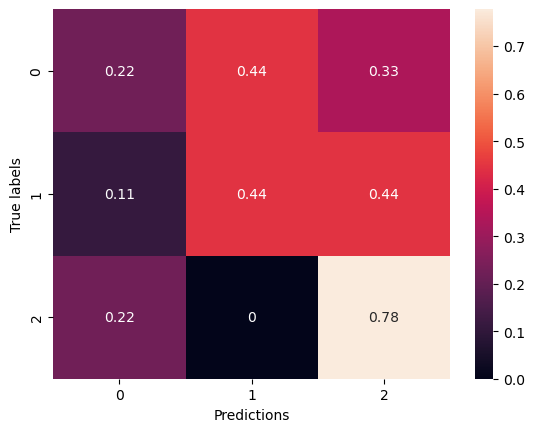

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▅▆▆▆▇▇▇▇▇▇█▇▇███▇▇███████████▇█▇████
training_loss,█▇▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▃▆▇▆▇▆█▆▅▆▆▇▆▆▆▇▇▇▆▅▆▆▇▅▆▇▇▆▇▅▇▆▇▅▅▇
val_loss,█▇▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:23:06.059248: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:23:06.061440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:23:06.063148: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:23:07.677014: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:23:07.678805: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:23:07.680966: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:23:11.796269: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:23:12.379446: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 45.2049 - accuracy: 0.3950

2024-03-12 15:23:15.668994: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:23:15.671437: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:23:15.673243: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 366ms/step - loss: 45.2049 - accuracy: 0.3950 - val_loss: 41.8046 - val_accuracy: 0.2315
Epoch 2/100
7/7 [==============================] - 1s 111ms/step - loss: 39.8004 - accuracy: 0.4977 - val_loss: 37.0337 - val_accuracy: 0.2037
Epoch 3/100
7/7 [==============================] - 1s 111ms/step - loss: 34.9111 - accuracy: 0.5890 - val_loss: 32.6242 - val_accuracy: 0.2037
Epoch 4/100
7/7 [==============================] - 1s 111ms/step - loss: 30.6409 - accuracy: 0.5639 - val_loss: 28.6348 - val_accuracy: 0.2407
Epoch 5/100
7/7 [==============================] - 1s 112ms/step - loss: 26.8030 - accuracy: 0.6050 - val_loss: 25.1515 - val_accuracy: 0.2685
Epoch 6/100
7/7 [==============================] - 1s 122ms/step - loss: 23.5363 - accuracy: 0.6005 - val_loss: 22.1985 - val_accuracy: 0.2778
Epoch 7/100
7/7 [==============================] - 1s 111ms/step - loss: 20.5466 - accuracy: 0.6849 - val_loss: 19.6085 - val_accuracy: 0.2685
Epoch 8/10

Epoch 59/100
7/7 [==============================] - 1s 109ms/step - loss: 1.1197 - accuracy: 0.9292 - val_loss: 3.7090 - val_accuracy: 0.4907
Epoch 60/100
7/7 [==============================] - 1s 109ms/step - loss: 1.0655 - accuracy: 0.9361 - val_loss: 3.7402 - val_accuracy: 0.5278
Epoch 61/100
7/7 [==============================] - 1s 108ms/step - loss: 1.0375 - accuracy: 0.9680 - val_loss: 3.6438 - val_accuracy: 0.5833
Epoch 62/100
7/7 [==============================] - 1s 110ms/step - loss: 1.0490 - accuracy: 0.9452 - val_loss: 4.1302 - val_accuracy: 0.4537
Epoch 63/100
7/7 [==============================] - 1s 109ms/step - loss: 1.0783 - accuracy: 0.9292 - val_loss: 3.4872 - val_accuracy: 0.5648
Epoch 64/100
7/7 [==============================] - 1s 110ms/step - loss: 0.9904 - accuracy: 0.9589 - val_loss: 4.0960 - val_accuracy: 0.4537
Epoch 65/100
7/7 [==============================] - 1s 109ms/step - loss: 1.0090 - accuracy: 0.9498 - val_loss: 3.4917 - val_accuracy: 0.5185
Epoch 

2024-03-12 15:24:33.001525: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:24:33.003568: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:24:33.005521: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.5072181224823 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.8, 'recall': 0.4444444444444444, 'f1-score': 0.5714285714285714, 'support': 9}, '2': {'precision': 0.38095238095238093, 'recall': 0.8888888888888888, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.39365079365079364, 'recall': 0.4444444444444444, 'f1-score': 0.3682539682539683, 'support': 27}, 'weighted avg': {'precision': 0.39365079365079364, 'recall': 0.4444444444444444, 'f1-score': 0.3682539682539683, 'support': 27}}


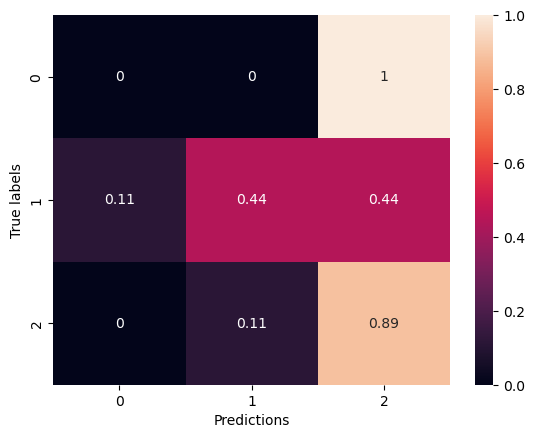

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▃▄▅▅▆▆▇▇▇▇▇▇▇▇████▇▇█▇████████████████
training_loss,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▂▃▄▄▆▆▇▅▄█▄▆▇▅▅▅▇▅▅▆▅▇▅▅▆▃▆▆▄▅▆▅▆▇▆▅█
val_loss,█▆▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:24:56.782315: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:24:56.784312: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:24:56.785859: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:24:58.382418: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:24:58.384150: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:24:58.386204: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:25:02.486803: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:25:03.065699: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 8.2615 - accuracy: 0.3014

2024-03-12 15:25:06.314114: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:25:06.315703: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:25:06.317778: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 361ms/step - loss: 8.2615 - accuracy: 0.3014 - val_loss: 7.4076 - val_accuracy: 0.4630
Epoch 2/100
7/7 [==============================] - 1s 109ms/step - loss: 7.9015 - accuracy: 0.3676 - val_loss: 7.3472 - val_accuracy: 0.1944
Epoch 3/100
7/7 [==============================] - 1s 109ms/step - loss: 7.6362 - accuracy: 0.3744 - val_loss: 7.2554 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 111ms/step - loss: 7.3209 - accuracy: 0.4132 - val_loss: 7.1884 - val_accuracy: 0.1481
Epoch 5/100
7/7 [==============================] - 1s 109ms/step - loss: 7.1328 - accuracy: 0.4315 - val_loss: 7.1432 - val_accuracy: 0.1574
Epoch 6/100
7/7 [==============================] - 1s 109ms/step - loss: 6.9473 - accuracy: 0.4292 - val_loss: 7.0219 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 110ms/step - loss: 6.6954 - accuracy: 0.4543 - val_loss: 6.8874 - val_accuracy: 0.1667
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 110ms/step - loss: 1.6742 - accuracy: 0.9201 - val_loss: 4.2587 - val_accuracy: 0.5000
Epoch 60/100
7/7 [==============================] - 1s 121ms/step - loss: 1.6833 - accuracy: 0.9178 - val_loss: 4.1438 - val_accuracy: 0.5556
Epoch 61/100
7/7 [==============================] - 1s 112ms/step - loss: 1.6085 - accuracy: 0.9338 - val_loss: 4.1794 - val_accuracy: 0.5370
Epoch 62/100
7/7 [==============================] - 1s 109ms/step - loss: 1.5640 - accuracy: 0.9384 - val_loss: 4.6271 - val_accuracy: 0.4722
Epoch 63/100
7/7 [==============================] - 1s 109ms/step - loss: 1.5261 - accuracy: 0.9361 - val_loss: 4.0998 - val_accuracy: 0.5185
Epoch 64/100
7/7 [==============================] - 1s 109ms/step - loss: 1.5141 - accuracy: 0.9338 - val_loss: 3.9897 - val_accuracy: 0.5926
Epoch 65/100
7/7 [==============================] - 1s 111ms/step - loss: 1.4494 - accuracy: 0.9521 - val_loss: 4.1556 - val_accuracy: 0.5463
Epoch 

2024-03-12 15:26:23.889589: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:26:23.891653: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:26:23.893188: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4798099994659424 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4166666666666667, 'recall': 0.5555555555555556, 'f1-score': 0.4761904761904762, 'support': 9}, '2': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.2670940170940171, 'recall': 0.3703703703703704, 'f1-score': 0.31024531024531027, 'support': 27}, 'weighted avg': {'precision': 0.2670940170940171, 'recall': 0.37037037037037035, 'f1-score': 0.3102453102453103, 'support': 27}}


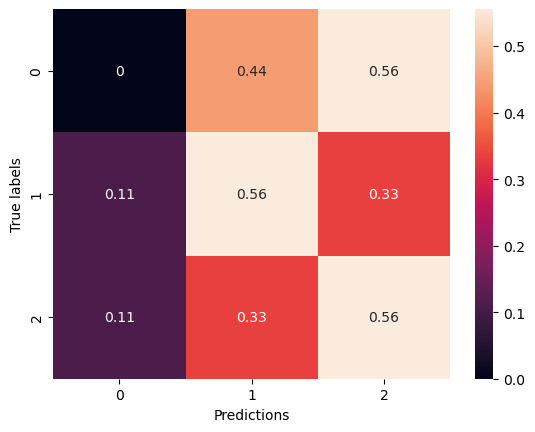

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇████████████████
training_loss,█▇▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▆▁▁▂▁▁▂▂▁▃▄▅▄▆▆▆▇▇▆▇█▆▇▆▇▇▇▆▅▇▅▆▇▆▇▆▇▆█▇
val_loss,▇▆▆▆▇▇▆▆█▇▄▄▄▂▃▃▂▂▂▂▂▃▂▂▂▂▂▂▃▂▃▂▂▃▁▂▂▂▁▁


Epoch 1/100


2024-03-12 15:26:48.514747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:26:48.516758: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:26:48.518365: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:26:50.128978: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:26:50.131058: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:26:50.132896: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:26:55.189369: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:26:55.765679: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 33.0803 - accuracy: 0.3311

2024-03-12 15:26:59.031760: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:26:59.033305: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:26:59.035316: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 363ms/step - loss: 33.0803 - accuracy: 0.3311 - val_loss: 30.7840 - val_accuracy: 0.2685
Epoch 2/100
7/7 [==============================] - 1s 109ms/step - loss: 29.9295 - accuracy: 0.3881 - val_loss: 28.1462 - val_accuracy: 0.1667
Epoch 3/100
7/7 [==============================] - 1s 110ms/step - loss: 27.3316 - accuracy: 0.4064 - val_loss: 25.7764 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 110ms/step - loss: 24.9591 - accuracy: 0.4041 - val_loss: 23.6347 - val_accuracy: 0.1389
Epoch 5/100
7/7 [==============================] - 1s 109ms/step - loss: 22.7540 - accuracy: 0.4201 - val_loss: 21.6757 - val_accuracy: 0.1204
Epoch 6/100
7/7 [==============================] - 1s 110ms/step - loss: 20.7395 - accuracy: 0.4612 - val_loss: 19.8898 - val_accuracy: 0.1296
Epoch 7/100
7/7 [==============================] - 1s 110ms/step - loss: 18.9494 - accuracy: 0.4566 - val_loss: 18.2907 - val_accuracy: 0.1204
Epoch 8/10

7/7 [==============================] - 1s 110ms/step - loss: 1.3492 - accuracy: 0.9338 - val_loss: 4.0850 - val_accuracy: 0.5556
Epoch 59/100
7/7 [==============================] - 1s 109ms/step - loss: 1.3363 - accuracy: 0.9429 - val_loss: 3.6310 - val_accuracy: 0.5278
Epoch 60/100
7/7 [==============================] - 1s 110ms/step - loss: 1.2453 - accuracy: 0.9566 - val_loss: 3.5109 - val_accuracy: 0.5370
Epoch 61/100
7/7 [==============================] - 1s 116ms/step - loss: 1.2569 - accuracy: 0.9384 - val_loss: 3.8948 - val_accuracy: 0.5463
Epoch 62/100
7/7 [==============================] - 1s 111ms/step - loss: 1.2009 - accuracy: 0.9521 - val_loss: 3.6746 - val_accuracy: 0.5463
Epoch 63/100
7/7 [==============================] - 1s 125ms/step - loss: 1.1511 - accuracy: 0.9543 - val_loss: 4.1691 - val_accuracy: 0.5000
Epoch 64/100
7/7 [==============================] - 1s 111ms/step - loss: 1.1293 - accuracy: 0.9566 - val_loss: 3.6972 - val_accuracy: 0.5926
Epoch 65/100
7/7 [=

wandb: Network error (ConnectTimeout), entering retry loop.


7/7 [==============================] - 1s 110ms/step - loss: 1.0923 - accuracy: 0.9315 - val_loss: 3.5018 - val_accuracy: 0.4722
Epoch 75/100
7/7 [==============================] - 1s 110ms/step - loss: 1.1003 - accuracy: 0.9292 - val_loss: 3.5778 - val_accuracy: 0.5463
Epoch 76/100
7/7 [==============================] - 1s 110ms/step - loss: 1.0520 - accuracy: 0.9429 - val_loss: 3.8030 - val_accuracy: 0.4907
Epoch 77/100
7/7 [==============================] - 1s 109ms/step - loss: 0.9799 - accuracy: 0.9703 - val_loss: 5.0596 - val_accuracy: 0.3704
Epoch 78/100
7/7 [==============================] - 1s 109ms/step - loss: 0.9316 - accuracy: 0.9612 - val_loss: 3.4670 - val_accuracy: 0.5278
Epoch 79/100
7/7 [==============================] - 1s 111ms/step - loss: 0.9160 - accuracy: 0.9680 - val_loss: 3.9125 - val_accuracy: 0.5093
Epoch 80/100
7/7 [==============================] - 1s 112ms/step - loss: 0.9310 - accuracy: 0.9635 - val_loss: 3.8180 - val_accuracy: 0.5185
Epoch 81/100
7/7 [=

2024-03-12 15:28:16.169968: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:28:16.172561: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:28:16.174348: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4875819683074951 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.6666666666666666, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '2': {'precision': 0.47058823529411764, 'recall': 0.8888888888888888, 'f1-score': 0.6153846153846153, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.7124183006535948, 'recall': 0.5555555555555555, 'f1-score': 0.494017094017094, 'support': 27}, 'weighted avg': {'precision': 0.7124183006535948, 'recall': 0.5555555555555556, 'f1-score': 0.494017094017094, 'support': 27}}


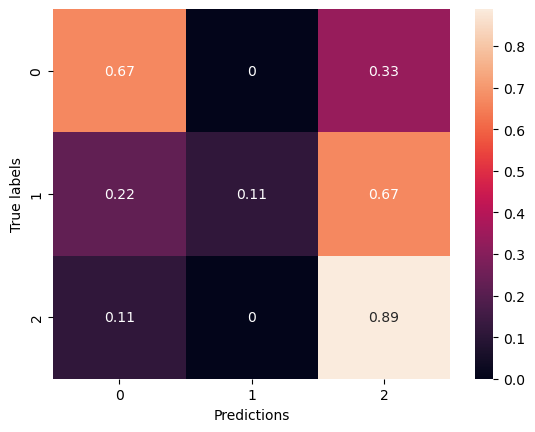

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▄▄▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇█▇█▇██▇█████▇████
training_loss,█▇▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▁▁▂▄▂▃▅▅▄▆▆▆▇▆▇██▆▆▆▇▇▇▆▆▇▆▄▆▅▅▆▅▇▅▇▇
val_loss,█▇▅▄▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:29:56.094990: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:29:56.096692: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:29:56.098718: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:29:57.771830: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:29:57.773683: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:29:57.776021: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:30:01.964050: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:30:02.585021: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 45.4847 - accuracy: 0.3562

2024-03-12 15:30:05.912569: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:30:06.342978: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:30:06.349099: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 486ms/step - loss: 45.4847 - accuracy: 0.3562 - val_loss: 42.0976 - val_accuracy: 0.1481
Epoch 2/100
7/7 [==============================] - 1s 111ms/step - loss: 40.6321 - accuracy: 0.3858 - val_loss: 37.8526 - val_accuracy: 0.1389
Epoch 3/100
7/7 [==============================] - 1s 110ms/step - loss: 36.4741 - accuracy: 0.3699 - val_loss: 34.0263 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 109ms/step - loss: 32.5359 - accuracy: 0.4543 - val_loss: 30.6102 - val_accuracy: 0.1296
Epoch 5/100
7/7 [==============================] - 1s 111ms/step - loss: 29.1525 - accuracy: 0.4543 - val_loss: 27.5397 - val_accuracy: 0.1204
Epoch 6/100
7/7 [==============================] - 1s 111ms/step - loss: 26.0951 - accuracy: 0.4635 - val_loss: 24.7827 - val_accuracy: 0.1204
Epoch 7/100
7/7 [==============================] - 1s 112ms/step - loss: 23.3563 - accuracy: 0.5046 - val_loss: 22.3759 - val_accuracy: 0.1296
Epoch 8/10

7/7 [==============================] - 1s 112ms/step - loss: 1.4440 - accuracy: 0.9110 - val_loss: 4.1208 - val_accuracy: 0.5463
Epoch 59/100
7/7 [==============================] - 1s 113ms/step - loss: 1.3718 - accuracy: 0.9247 - val_loss: 4.0120 - val_accuracy: 0.5278
Epoch 60/100
7/7 [==============================] - 1s 121ms/step - loss: 1.3290 - accuracy: 0.9406 - val_loss: 4.1495 - val_accuracy: 0.5185
Epoch 61/100
7/7 [==============================] - 1s 110ms/step - loss: 1.3864 - accuracy: 0.9178 - val_loss: 4.1233 - val_accuracy: 0.5648
Epoch 62/100
7/7 [==============================] - 1s 111ms/step - loss: 1.3087 - accuracy: 0.9361 - val_loss: 4.7038 - val_accuracy: 0.4815
Epoch 63/100
7/7 [==============================] - 1s 111ms/step - loss: 1.3227 - accuracy: 0.9315 - val_loss: 4.4389 - val_accuracy: 0.5000
Epoch 64/100
7/7 [==============================] - 1s 111ms/step - loss: 1.2749 - accuracy: 0.9247 - val_loss: 3.7617 - val_accuracy: 0.5926
Epoch 65/100
7/7 [=

2024-03-12 15:31:24.370092: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:31:24.371705: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:31:24.373567: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.484360933303833 s
{'0': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.36, 'recall': 1.0, 'f1-score': 0.5294117647058824, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.4533333333333333, 'recall': 0.40740740740740744, 'f1-score': 0.2976827094474153, 'support': 27}, 'weighted avg': {'precision': 0.45333333333333337, 'recall': 0.4074074074074074, 'f1-score': 0.2976827094474153, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


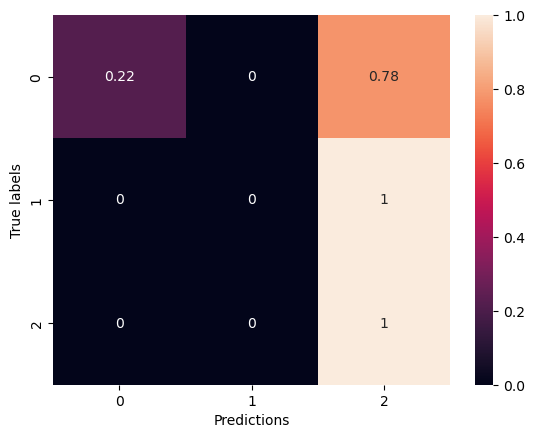

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▄▃▄▄▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇██▇███▇███████
training_loss,█▇▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▂▃▄▄▅▇▇▇▆▆▅▇█▇▆▆▆█▇▇█▆▆▅█▇▅█▅▇▆▆█▅▇
val_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:31:46.852420: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:31:46.854139: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:31:46.856093: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:31:48.577389: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:31:48.579736: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:31:48.581314: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:31:52.771705: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:31:53.352738: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 9.2325 - accuracy: 0.4292

2024-03-12 15:31:56.817493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:31:56.819934: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:31:56.821542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 390ms/step - loss: 9.2325 - accuracy: 0.4292 - val_loss: 9.0466 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 131ms/step - loss: 8.5585 - accuracy: 0.5297 - val_loss: 8.8712 - val_accuracy: 0.1389
Epoch 3/100
7/7 [==============================] - 1s 141ms/step - loss: 8.1469 - accuracy: 0.6073 - val_loss: 8.6576 - val_accuracy: 0.1852
Epoch 4/100
7/7 [==============================] - 1s 131ms/step - loss: 7.6838 - accuracy: 0.6689 - val_loss: 8.5196 - val_accuracy: 0.1481
Epoch 5/100
7/7 [==============================] - 1s 131ms/step - loss: 7.3662 - accuracy: 0.7100 - val_loss: 8.3391 - val_accuracy: 0.1481
Epoch 6/100
7/7 [==============================] - 1s 131ms/step - loss: 6.9290 - accuracy: 0.7968 - val_loss: 8.1404 - val_accuracy: 0.1667
Epoch 7/100
7/7 [==============================] - 1s 131ms/step - loss: 6.6293 - accuracy: 0.7945 - val_loss: 7.9820 - val_accuracy: 0.1574
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 130ms/step - loss: 1.0755 - accuracy: 0.9840 - val_loss: 4.2884 - val_accuracy: 0.5833
Epoch 60/100
7/7 [==============================] - 1s 129ms/step - loss: 1.0804 - accuracy: 0.9749 - val_loss: 4.3793 - val_accuracy: 0.6019
Epoch 61/100
7/7 [==============================] - 1s 132ms/step - loss: 1.0715 - accuracy: 0.9817 - val_loss: 5.3617 - val_accuracy: 0.5741
Epoch 62/100
7/7 [==============================] - 1s 151ms/step - loss: 1.0273 - accuracy: 0.9749 - val_loss: 4.8381 - val_accuracy: 0.5648
Epoch 63/100
7/7 [==============================] - 1s 156ms/step - loss: 1.0093 - accuracy: 0.9749 - val_loss: 4.3748 - val_accuracy: 0.5556
Epoch 64/100
7/7 [==============================] - 1s 132ms/step - loss: 1.0005 - accuracy: 0.9817 - val_loss: 4.2240 - val_accuracy: 0.5463
Epoch 65/100
7/7 [==============================] - 1s 132ms/step - loss: 0.9624 - accuracy: 0.9840 - val_loss: 4.3137 - val_accuracy: 0.5556
Epoch 

2024-03-12 15:33:28.338279: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:33:28.340339: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:33:28.341846: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4655680656433105 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.47058823529411764, 'recall': 0.8888888888888888, 'f1-score': 0.6153846153846153, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.4584500466853408, 'recall': 0.48148148148148145, 'f1-score': 0.42735042735042733, 'support': 27}, 'weighted avg': {'precision': 0.45845004668534073, 'recall': 0.48148148148148145, 'f1-score': 0.4273504273504273, 'support': 27}}


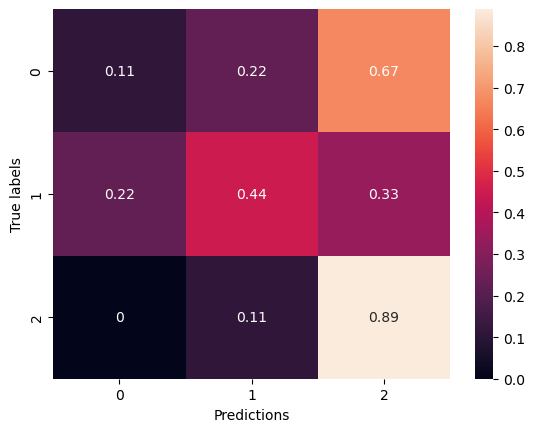

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▆▆▇▇▇█████████████████████████████████
training_loss,█▇▆▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▂▁▂▃▃▅▇▇▅▅▇█▆▇▅▇▄▆▇▇▇▇▇▇▄█▆▇▇▇▇▆▅▅▅▆▇█
val_loss,█▇▇▆▅▅▅▄▃▂▃▃▂▂▂▂▃▁▅▂▂▂▁▂▃▁▄▁▂▂▁▁▁▁▂▂▂▂▂▁


Epoch 1/100


2024-03-12 15:33:49.703747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:33:49.705916: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:33:49.707542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:33:51.319969: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:33:51.322080: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:33:51.324113: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:33:56.443618: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:33:57.020509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 39.3419 - accuracy: 0.3836

2024-03-12 15:34:00.428586: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:34:00.430171: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:34:00.431992: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 393ms/step - loss: 39.3419 - accuracy: 0.3836 - val_loss: 36.6350 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 128ms/step - loss: 34.9087 - accuracy: 0.5160 - val_loss: 33.0510 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 130ms/step - loss: 31.1020 - accuracy: 0.5776 - val_loss: 29.5508 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 129ms/step - loss: 27.5222 - accuracy: 0.6461 - val_loss: 26.3306 - val_accuracy: 0.1667
Epoch 5/100
7/7 [==============================] - 1s 129ms/step - loss: 24.3240 - accuracy: 0.6895 - val_loss: 23.4973 - val_accuracy: 0.1944
Epoch 6/100
7/7 [==============================] - 1s 130ms/step - loss: 21.5591 - accuracy: 0.7237 - val_loss: 20.9914 - val_accuracy: 0.1852
Epoch 7/100
7/7 [==============================] - 1s 128ms/step - loss: 18.9964 - accuracy: 0.7511 - val_loss: 18.8233 - val_accuracy: 0.1759
Epoch 8/10

Epoch 59/100
7/7 [==============================] - 1s 129ms/step - loss: 0.9903 - accuracy: 0.9772 - val_loss: 4.4626 - val_accuracy: 0.5370
Epoch 60/100
7/7 [==============================] - 1s 130ms/step - loss: 1.0008 - accuracy: 0.9680 - val_loss: 3.9587 - val_accuracy: 0.5463
Epoch 61/100
7/7 [==============================] - 1s 141ms/step - loss: 0.9935 - accuracy: 0.9612 - val_loss: 3.9659 - val_accuracy: 0.5833
Epoch 62/100
7/7 [==============================] - 1s 131ms/step - loss: 0.9307 - accuracy: 0.9795 - val_loss: 4.0193 - val_accuracy: 0.5648
Epoch 63/100
7/7 [==============================] - 1s 131ms/step - loss: 0.9232 - accuracy: 0.9817 - val_loss: 3.8928 - val_accuracy: 0.5278
Epoch 64/100
7/7 [==============================] - 1s 128ms/step - loss: 0.9086 - accuracy: 0.9749 - val_loss: 3.9358 - val_accuracy: 0.5370
Epoch 65/100
7/7 [==============================] - 1s 130ms/step - loss: 0.9126 - accuracy: 0.9635 - val_loss: 3.8652 - val_accuracy: 0.5185
Epoch 

2024-03-12 15:35:31.689710: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:35:31.691660: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:35:31.693483: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4689888954162598 s
{'0': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '1': {'precision': 0.4375, 'recall': 0.7777777777777778, 'f1-score': 0.56, 'support': 9}, '2': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5863095238095238, 'recall': 0.5185185185185185, 'f1-score': 0.5071794871794872, 'support': 27}, 'weighted avg': {'precision': 0.5863095238095238, 'recall': 0.5185185185185185, 'f1-score': 0.5071794871794872, 'support': 27}}


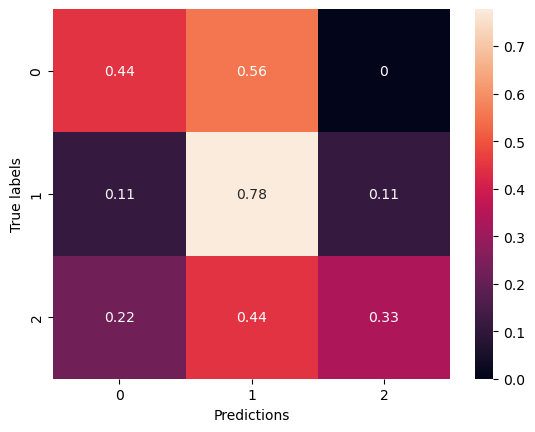

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▇▇▇▇▇▇███▇▇███████▇█████▇██████████▇
training_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▂▂▃▄▄▆▅▇▇█▇▆▆▇▆▇▅▇▇▆▇▇▇▆▆█▇▇▆▇▄▆▅▆▅▇▅
val_loss,█▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:35:55.612700: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:35:55.614375: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:35:55.616426: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:35:57.218677: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:35:57.220417: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:35:57.222416: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:36:01.424931: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:36:02.003224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 53.7877 - accuracy: 0.3767

2024-03-12 15:36:05.407943: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:36:05.409902: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:36:05.411601: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 530ms/step - loss: 53.7877 - accuracy: 0.3767 - val_loss: 49.6536 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 130ms/step - loss: 46.9147 - accuracy: 0.5365 - val_loss: 43.6418 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 129ms/step - loss: 40.8872 - accuracy: 0.6005 - val_loss: 38.0892 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 131ms/step - loss: 35.4511 - accuracy: 0.6530 - val_loss: 33.2045 - val_accuracy: 0.1389
Epoch 5/100
7/7 [==============================] - 1s 129ms/step - loss: 30.6518 - accuracy: 0.7123 - val_loss: 29.0051 - val_accuracy: 0.1111
Epoch 6/100
7/7 [==============================] - 1s 130ms/step - loss: 26.4375 - accuracy: 0.7397 - val_loss: 25.2849 - val_accuracy: 0.1111
Epoch 7/100
7/7 [==============================] - 1s 131ms/step - loss: 22.8343 - accuracy: 0.7580 - val_loss: 22.0652 - val_accuracy: 0.1204
Epoch 8/10

Epoch 59/100
7/7 [==============================] - 1s 130ms/step - loss: 0.9613 - accuracy: 0.9703 - val_loss: 3.7019 - val_accuracy: 0.6019
Epoch 60/100
7/7 [==============================] - 1s 131ms/step - loss: 0.9782 - accuracy: 0.9635 - val_loss: 3.6284 - val_accuracy: 0.5370
Epoch 61/100
7/7 [==============================] - 1s 128ms/step - loss: 0.9478 - accuracy: 0.9680 - val_loss: 3.5219 - val_accuracy: 0.6296
Epoch 62/100
7/7 [==============================] - 1s 129ms/step - loss: 0.9585 - accuracy: 0.9543 - val_loss: 3.7901 - val_accuracy: 0.5278
Epoch 63/100
7/7 [==============================] - 1s 130ms/step - loss: 0.9924 - accuracy: 0.9521 - val_loss: 4.0484 - val_accuracy: 0.5185
Epoch 64/100
7/7 [==============================] - 1s 128ms/step - loss: 1.0591 - accuracy: 0.9406 - val_loss: 3.5011 - val_accuracy: 0.5926
Epoch 65/100
7/7 [==============================] - 1s 132ms/step - loss: 0.9994 - accuracy: 0.9406 - val_loss: 3.5467 - val_accuracy: 0.5648
Epoch 

2024-03-12 15:37:37.207845: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:37:37.209483: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:37:37.211299: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4637670516967773 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.42105263157894735, 'recall': 0.8888888888888888, 'f1-score': 0.5714285714285714, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.30701754385964913, 'recall': 0.4444444444444444, 'f1-score': 0.3473389355742296, 'support': 27}, 'weighted avg': {'precision': 0.3070175438596491, 'recall': 0.4444444444444444, 'f1-score': 0.3473389355742296, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


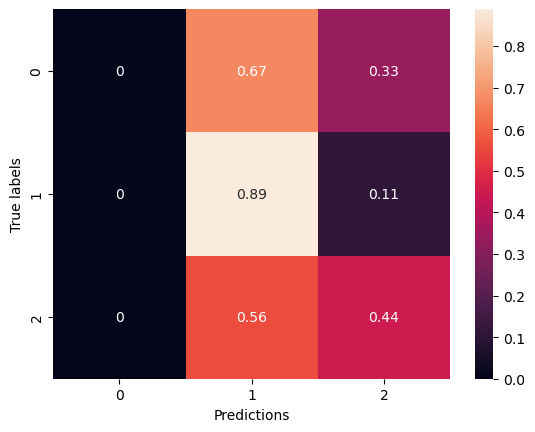

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇▇▇▇▇██▇███████████████▇██████████
training_loss,█▆▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▃▆▇▇▇██▅█▆▆▆▇▅▇█▅▆█▇█▇▆▆▄█▅▄█▅▅█▆▅█▅
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:38:00.622925: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:38:00.624862: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:38:00.626839: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:38:02.222865: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:38:02.225164: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:38:02.227266: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:38:06.380166: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:38:06.957036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 9.4760 - accuracy: 0.3744

2024-03-12 15:38:10.354901: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:38:10.356473: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:38:10.358522: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 385ms/step - loss: 9.4760 - accuracy: 0.3744 - val_loss: 8.8661 - val_accuracy: 0.1852
Epoch 2/100
7/7 [==============================] - 1s 132ms/step - loss: 8.9675 - accuracy: 0.4315 - val_loss: 8.7160 - val_accuracy: 0.1389
Epoch 3/100
7/7 [==============================] - 1s 131ms/step - loss: 8.6095 - accuracy: 0.4635 - val_loss: 8.5780 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 131ms/step - loss: 8.3691 - accuracy: 0.4292 - val_loss: 8.4086 - val_accuracy: 0.1389
Epoch 5/100
7/7 [==============================] - 1s 130ms/step - loss: 7.9955 - accuracy: 0.4977 - val_loss: 8.2184 - val_accuracy: 0.1574
Epoch 6/100
7/7 [==============================] - 1s 131ms/step - loss: 7.6820 - accuracy: 0.5731 - val_loss: 8.0659 - val_accuracy: 0.1389
Epoch 7/100
7/7 [==============================] - 1s 131ms/step - loss: 7.3959 - accuracy: 0.5913 - val_loss: 7.8718 - val_accuracy: 0.1481
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 130ms/step - loss: 1.5702 - accuracy: 0.9475 - val_loss: 4.8625 - val_accuracy: 0.5556
Epoch 60/100
7/7 [==============================] - 1s 128ms/step - loss: 1.5285 - accuracy: 0.9635 - val_loss: 4.6493 - val_accuracy: 0.6296
Epoch 61/100
7/7 [==============================] - 1s 131ms/step - loss: 1.4570 - accuracy: 0.9817 - val_loss: 5.0157 - val_accuracy: 0.6019
Epoch 62/100
7/7 [==============================] - 1s 132ms/step - loss: 1.4597 - accuracy: 0.9680 - val_loss: 5.0512 - val_accuracy: 0.5000
Epoch 63/100
7/7 [==============================] - 1s 129ms/step - loss: 1.4045 - accuracy: 0.9658 - val_loss: 4.5994 - val_accuracy: 0.5833
Epoch 64/100
7/7 [==============================] - 1s 130ms/step - loss: 1.3833 - accuracy: 0.9749 - val_loss: 4.4230 - val_accuracy: 0.6019
Epoch 65/100
7/7 [==============================] - 1s 143ms/step - loss: 1.3550 - accuracy: 0.9772 - val_loss: 4.4989 - val_accuracy: 0.5926
Epoch 

2024-03-12 15:39:41.646606: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:39:41.648897: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:39:41.650677: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4699490070343018 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.8888888888888888, 'f1-score': 0.5517241379310346, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.35555555555555557, 'recall': 0.4444444444444444, 'f1-score': 0.3616858237547893, 'support': 27}, 'weighted avg': {'precision': 0.35555555555555557, 'recall': 0.4444444444444444, 'f1-score': 0.36168582375478925, 'support': 27}}


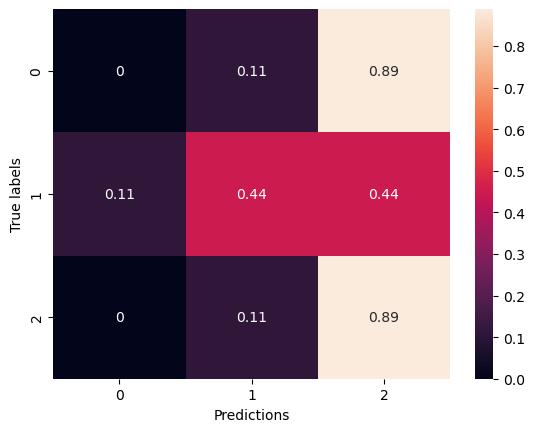

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▅▅▅▆▆▆▇▇▇▇████████▇████████████████
training_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▂▄▅▆▅▆▇▇▇▆▇▇█▇▇▆▅█▆▅▇███▇██▇█▇▇▆▅▅▅▇█
val_loss,██▇▆▅▅▄▄▄▃▃▃▃▃▃▃▃▃▃▄▃▃▄▃▃▂▂▂▂▂▁▂▂▁▁▂▃▂▁▁


Epoch 1/100


2024-03-12 15:40:05.424569: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:40:05.426304: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:40:05.428305: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:40:07.041894: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:40:07.044150: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:40:07.045815: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:40:12.208248: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:40:12.782738: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 39.3089 - accuracy: 0.3676

2024-03-12 15:40:16.169453: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:40:16.171180: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:40:16.173446: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 386ms/step - loss: 39.3089 - accuracy: 0.3676 - val_loss: 36.5180 - val_accuracy: 0.2315
Epoch 2/100
7/7 [==============================] - 1s 130ms/step - loss: 35.0539 - accuracy: 0.4566 - val_loss: 32.8126 - val_accuracy: 0.1667
Epoch 3/100
7/7 [==============================] - 1s 132ms/step - loss: 31.4778 - accuracy: 0.4795 - val_loss: 29.4760 - val_accuracy: 0.1759
Epoch 4/100
7/7 [==============================] - 1s 129ms/step - loss: 28.0899 - accuracy: 0.4703 - val_loss: 26.4311 - val_accuracy: 0.1759
Epoch 5/100
7/7 [==============================] - 1s 131ms/step - loss: 25.0591 - accuracy: 0.5479 - val_loss: 23.6684 - val_accuracy: 0.2037
Epoch 6/100
7/7 [==============================] - 1s 131ms/step - loss: 22.3376 - accuracy: 0.5868 - val_loss: 21.1954 - val_accuracy: 0.1759
Epoch 7/100
7/7 [==============================] - 1s 131ms/step - loss: 19.9228 - accuracy: 0.6005 - val_loss: 19.0538 - val_accuracy: 0.1944
Epoch 8/10

7/7 [==============================] - 1s 131ms/step - loss: 1.1154 - accuracy: 0.9566 - val_loss: 4.3891 - val_accuracy: 0.5370
Epoch 59/100
7/7 [==============================] - 1s 130ms/step - loss: 1.0739 - accuracy: 0.9521 - val_loss: 3.6904 - val_accuracy: 0.5833
Epoch 60/100
7/7 [==============================] - 1s 128ms/step - loss: 1.0551 - accuracy: 0.9612 - val_loss: 3.6140 - val_accuracy: 0.5648
Epoch 61/100
7/7 [==============================] - 1s 130ms/step - loss: 1.0656 - accuracy: 0.9566 - val_loss: 4.1556 - val_accuracy: 0.5185
Epoch 62/100
7/7 [==============================] - 1s 129ms/step - loss: 1.1280 - accuracy: 0.9338 - val_loss: 3.9437 - val_accuracy: 0.4537
Epoch 63/100
7/7 [==============================] - 1s 133ms/step - loss: 1.1052 - accuracy: 0.9315 - val_loss: 4.0570 - val_accuracy: 0.5926
Epoch 64/100
7/7 [==============================] - 1s 133ms/step - loss: 1.0862 - accuracy: 0.9384 - val_loss: 3.8552 - val_accuracy: 0.6019
Epoch 65/100
7/7 [=

2024-03-12 15:41:47.583043: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:41:47.585560: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:41:47.587102: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.564060926437378 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.34615384615384615, 'recall': 1.0, 'f1-score': 0.5142857142857142, 'support': 9}, '2': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.44871794871794873, 'recall': 0.3703703703703704, 'f1-score': 0.23809523809523805, 'support': 27}, 'weighted avg': {'precision': 0.4487179487179487, 'recall': 0.37037037037037035, 'f1-score': 0.23809523809523808, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


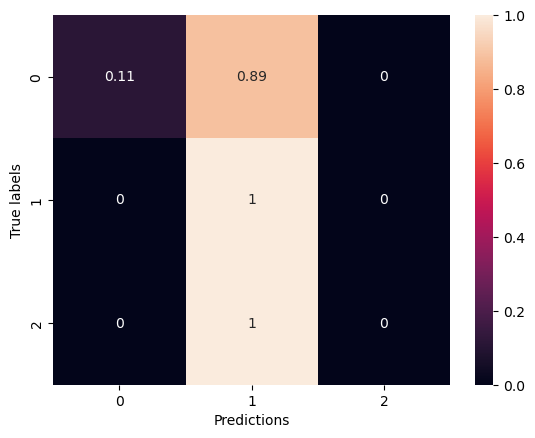

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▅▆▆▇▆▇▇▇▇▇▇▇████████▇█████████▇████
training_loss,█▇▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▃▄▅▄▇▇█▇▇▆██▆▄▇▇▆██▅▇▆█▆▆▅▆▇▆▅▆▆▆▆▄▆▃
val_loss,█▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂


Epoch 1/100


2024-03-12 15:42:11.816317: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:42:11.818095: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:42:11.821729: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:42:13.424049: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:42:13.426720: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:42:13.428522: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:42:17.546891: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:42:18.123795: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 54.0297 - accuracy: 0.3425

2024-03-12 15:42:21.525149: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:42:21.526747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:42:21.530348: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 535ms/step - loss: 54.0297 - accuracy: 0.3425 - val_loss: 49.8639 - val_accuracy: 0.4537
Epoch 2/100
7/7 [==============================] - 1s 131ms/step - loss: 47.8220 - accuracy: 0.4018 - val_loss: 44.1977 - val_accuracy: 0.3611
Epoch 3/100
7/7 [==============================] - 1s 130ms/step - loss: 42.0527 - accuracy: 0.5091 - val_loss: 39.0374 - val_accuracy: 0.2870
Epoch 4/100
7/7 [==============================] - 1s 130ms/step - loss: 37.0131 - accuracy: 0.5000 - val_loss: 34.3957 - val_accuracy: 0.2500
Epoch 5/100
7/7 [==============================] - 1s 131ms/step - loss: 32.4232 - accuracy: 0.5731 - val_loss: 30.2504 - val_accuracy: 0.2315
Epoch 6/100
7/7 [==============================] - 1s 132ms/step - loss: 28.6117 - accuracy: 0.5297 - val_loss: 26.6369 - val_accuracy: 0.2222
Epoch 7/100
7/7 [==============================] - 1s 130ms/step - loss: 25.0241 - accuracy: 0.5845 - val_loss: 23.4505 - val_accuracy: 0.2500
Epoch 8/10

7/7 [==============================] - 1s 129ms/step - loss: 1.1790 - accuracy: 0.9406 - val_loss: 4.6252 - val_accuracy: 0.3796
Epoch 59/100
7/7 [==============================] - 1s 132ms/step - loss: 1.2289 - accuracy: 0.9429 - val_loss: 5.3598 - val_accuracy: 0.3611
Epoch 60/100
7/7 [==============================] - 1s 133ms/step - loss: 1.2737 - accuracy: 0.9247 - val_loss: 3.7252 - val_accuracy: 0.5463
Epoch 61/100
7/7 [==============================] - 1s 132ms/step - loss: 1.2305 - accuracy: 0.9292 - val_loss: 4.7388 - val_accuracy: 0.4259
Epoch 62/100
7/7 [==============================] - 1s 131ms/step - loss: 1.2134 - accuracy: 0.9361 - val_loss: 4.2757 - val_accuracy: 0.4259
Epoch 63/100
7/7 [==============================] - 1s 130ms/step - loss: 1.1841 - accuracy: 0.9452 - val_loss: 3.4108 - val_accuracy: 0.5278
Epoch 64/100
7/7 [==============================] - 1s 130ms/step - loss: 1.1591 - accuracy: 0.9384 - val_loss: 3.3423 - val_accuracy: 0.5278
Epoch 65/100
7/7 [=

2024-03-12 15:43:54.667560: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:43:54.669134: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:43:54.671059: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4613451957702637 s
{'0': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '1': {'precision': 0.625, 'recall': 0.5555555555555556, 'f1-score': 0.5882352941176471, 'support': 9}, '2': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5268518518518518, 'recall': 0.5185185185185185, 'f1-score': 0.5216144937507167, 'support': 27}, 'weighted avg': {'precision': 0.5268518518518518, 'recall': 0.5185185185185185, 'f1-score': 0.5216144937507167, 'support': 27}}


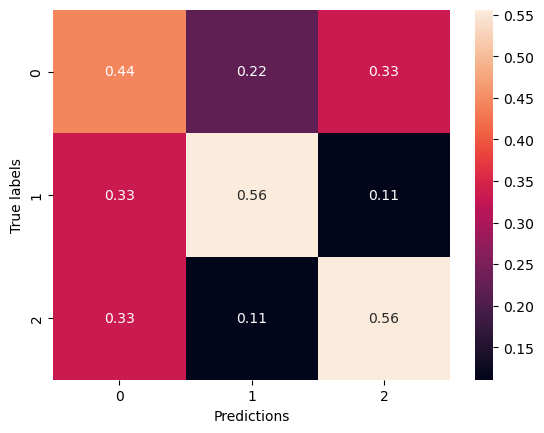

wandb: Network error (ConnectTimeout), entering retry loop.
wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▃▄▅▅▅▆▇▇▇▇▇▇▇▇█▇████▇█▇█████████▇█████
training_loss,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▂▁▂▂▃▂▃▄▅▆▅█▇▆▇▃█▇▅▇▆▅▃▄▆▅▇█▇▅▄▇▅▇▆▅▄▃▄
val_loss,█▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:46:11.676225: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:46:11.677848: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:46:11.679942: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:46:13.329516: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:46:13.331884: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:46:13.333797: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:46:17.499787: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:46:18.079520: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 9.6260 - accuracy: 0.3311

2024-03-12 15:46:21.503103: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:46:21.505267: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:46:21.507040: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 387ms/step - loss: 9.6260 - accuracy: 0.3311 - val_loss: 8.8781 - val_accuracy: 0.1111
Epoch 2/100
7/7 [==============================] - 1s 130ms/step - loss: 9.0665 - accuracy: 0.3973 - val_loss: 8.6835 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 131ms/step - loss: 8.7475 - accuracy: 0.4064 - val_loss: 8.4999 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 131ms/step - loss: 8.5143 - accuracy: 0.4178 - val_loss: 8.3070 - val_accuracy: 0.1574
Epoch 5/100
7/7 [==============================] - 1s 128ms/step - loss: 8.3882 - accuracy: 0.3836 - val_loss: 8.1474 - val_accuracy: 0.1574
Epoch 6/100
7/7 [==============================] - 1s 130ms/step - loss: 8.1586 - accuracy: 0.4292 - val_loss: 8.0269 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 151ms/step - loss: 7.9341 - accuracy: 0.4338 - val_loss: 7.9574 - val_accuracy: 0.1481
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 129ms/step - loss: 2.2950 - accuracy: 0.8196 - val_loss: 3.7342 - val_accuracy: 0.5926
Epoch 60/100
7/7 [==============================] - 1s 132ms/step - loss: 2.2754 - accuracy: 0.8037 - val_loss: 3.6370 - val_accuracy: 0.5648
Epoch 61/100
7/7 [==============================] - 1s 129ms/step - loss: 2.1970 - accuracy: 0.8037 - val_loss: 4.3661 - val_accuracy: 0.5370
Epoch 62/100
7/7 [==============================] - 1s 130ms/step - loss: 2.1709 - accuracy: 0.8311 - val_loss: 3.9478 - val_accuracy: 0.5833
Epoch 63/100
7/7 [==============================] - 1s 131ms/step - loss: 2.0840 - accuracy: 0.8447 - val_loss: 3.9289 - val_accuracy: 0.5833
Epoch 64/100
7/7 [==============================] - 1s 130ms/step - loss: 2.0701 - accuracy: 0.8402 - val_loss: 3.9477 - val_accuracy: 0.5093
Epoch 65/100
7/7 [==============================] - 1s 131ms/step - loss: 2.0589 - accuracy: 0.8447 - val_loss: 3.5586 - val_accuracy: 0.5741
Epoch 

2024-03-12 15:47:52.600294: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:47:52.601881: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:47:52.603697: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4760682582855225 s
{'0': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 1.0, 'f1-score': 0.6, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.27619047619047615, 'recall': 0.40740740740740744, 'f1-score': 0.29523809523809524, 'support': 27}, 'weighted avg': {'precision': 0.2761904761904762, 'recall': 0.4074074074074074, 'f1-score': 0.2952380952380952, 'support': 27}}


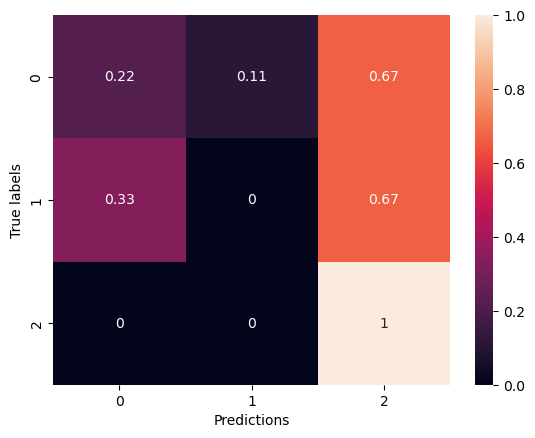

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▂▂▃▃▃▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇██████████
training_loss,█▇▇▇▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▁▁▂▄▄▃▅▄▆▇▃▅▆▄▆▆▆▇▇▇█▇▆▇█▇█▆▅▆██▇▇▇█▇
val_loss,██▇▇▆▆▅▄▅▄▃▃▃▄▃▃▄▂▂▃▂▂▂▁▂▁▂▁▁▁▂▃▂▁▁▂▂▂▁▂


Epoch 1/100


2024-03-12 15:48:16.204506: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:48:16.206270: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:48:16.208138: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:48:17.825756: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:48:17.827920: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:48:17.829745: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:48:22.947969: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:48:23.520891: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 39.7897 - accuracy: 0.3288

2024-03-12 15:48:26.914023: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:48:26.916472: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:48:26.918085: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 383ms/step - loss: 39.7897 - accuracy: 0.3288 - val_loss: 36.9787 - val_accuracy: 0.4074
Epoch 2/100
7/7 [==============================] - 1s 129ms/step - loss: 36.2097 - accuracy: 0.3151 - val_loss: 33.7936 - val_accuracy: 0.1944
Epoch 3/100
7/7 [==============================] - 1s 129ms/step - loss: 32.9101 - accuracy: 0.3607 - val_loss: 30.8768 - val_accuracy: 0.1667
Epoch 4/100
7/7 [==============================] - 1s 129ms/step - loss: 29.9197 - accuracy: 0.4041 - val_loss: 28.1976 - val_accuracy: 0.1574
Epoch 5/100
7/7 [==============================] - 1s 129ms/step - loss: 27.2338 - accuracy: 0.3927 - val_loss: 25.7866 - val_accuracy: 0.1481
Epoch 6/100
7/7 [==============================] - 1s 130ms/step - loss: 24.9015 - accuracy: 0.3630 - val_loss: 23.5931 - val_accuracy: 0.1204
Epoch 7/100
7/7 [==============================] - 1s 129ms/step - loss: 22.7659 - accuracy: 0.4041 - val_loss: 21.5855 - val_accuracy: 0.1204
Epoch 8/10

7/7 [==============================] - 1s 128ms/step - loss: 1.6360 - accuracy: 0.8904 - val_loss: 3.6886 - val_accuracy: 0.5926
Epoch 59/100
7/7 [==============================] - 1s 130ms/step - loss: 1.5700 - accuracy: 0.9018 - val_loss: 4.3295 - val_accuracy: 0.4815
Epoch 60/100
7/7 [==============================] - 1s 134ms/step - loss: 1.5380 - accuracy: 0.8973 - val_loss: 4.0786 - val_accuracy: 0.5000
Epoch 61/100
7/7 [==============================] - 1s 133ms/step - loss: 1.4537 - accuracy: 0.9292 - val_loss: 4.8782 - val_accuracy: 0.4167
Epoch 62/100
7/7 [==============================] - 1s 130ms/step - loss: 1.3864 - accuracy: 0.9384 - val_loss: 3.6495 - val_accuracy: 0.5093
Epoch 63/100
7/7 [==============================] - 1s 131ms/step - loss: 1.3730 - accuracy: 0.9178 - val_loss: 4.3727 - val_accuracy: 0.4815
Epoch 64/100
7/7 [==============================] - 1s 132ms/step - loss: 1.3589 - accuracy: 0.9361 - val_loss: 3.5893 - val_accuracy: 0.6574
Epoch 65/100
7/7 [=

2024-03-12 15:49:58.180569: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:49:58.182131: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:49:58.184261: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.467970609664917 s
{'0': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '1': {'precision': 0.8, 'recall': 0.4444444444444444, 'f1-score': 0.5714285714285714, 'support': 9}, '2': {'precision': 0.4375, 'recall': 0.7777777777777778, 'f1-score': 0.56, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5791666666666667, 'recall': 0.5185185185185185, 'f1-score': 0.5104761904761905, 'support': 27}, 'weighted avg': {'precision': 0.5791666666666666, 'recall': 0.5185185185185185, 'f1-score': 0.5104761904761905, 'support': 27}}


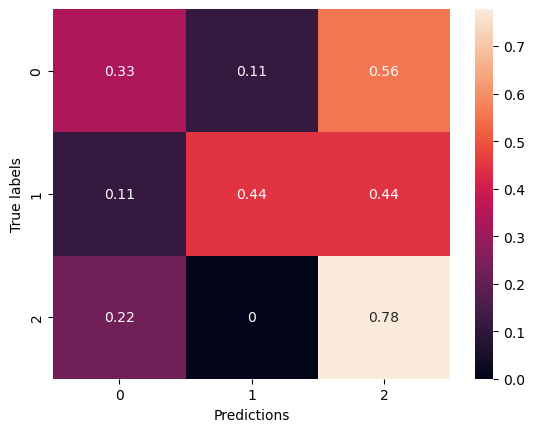

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▁▂▂▃▃▄▃▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇█▇▇▇▇██████▇███
training_loss,█▇▅▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▂▁▁▁▂▂▃▅▃▄▆▇▇▇▇▇▇▇▇▇▇▇▆▅█▇▆█▇▃▅▅▃▆▆▇▄▆▇
val_loss,█▇▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:50:19.669306: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:50:19.670972: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:50:19.673003: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:50:21.278779: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:50:21.281151: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:50:21.283490: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:50:25.414749: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:50:25.999018: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 54.0370 - accuracy: 0.3356

2024-03-12 15:50:29.465435: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:50:29.467038: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:50:29.471240: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 381ms/step - loss: 54.0370 - accuracy: 0.3356 - val_loss: 49.9761 - val_accuracy: 0.2222
Epoch 2/100
7/7 [==============================] - 1s 129ms/step - loss: 48.0791 - accuracy: 0.3973 - val_loss: 44.5038 - val_accuracy: 0.2870
Epoch 3/100
7/7 [==============================] - 1s 129ms/step - loss: 42.7030 - accuracy: 0.3813 - val_loss: 39.5999 - val_accuracy: 0.2963
Epoch 4/100
7/7 [==============================] - 1s 130ms/step - loss: 37.9718 - accuracy: 0.3881 - val_loss: 35.2488 - val_accuracy: 0.2500
Epoch 5/100
7/7 [==============================] - 1s 130ms/step - loss: 33.7479 - accuracy: 0.3973 - val_loss: 31.4162 - val_accuracy: 0.1759
Epoch 6/100
7/7 [==============================] - 1s 130ms/step - loss: 30.0768 - accuracy: 0.4064 - val_loss: 28.0162 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 129ms/step - loss: 26.8006 - accuracy: 0.4064 - val_loss: 25.0564 - val_accuracy: 0.1574
Epoch 8/10

7/7 [==============================] - 1s 132ms/step - loss: 1.4198 - accuracy: 0.8927 - val_loss: 4.9199 - val_accuracy: 0.3981
Epoch 59/100
7/7 [==============================] - 1s 130ms/step - loss: 1.4645 - accuracy: 0.8607 - val_loss: 3.7022 - val_accuracy: 0.6019
Epoch 60/100
7/7 [==============================] - 1s 131ms/step - loss: 1.5387 - accuracy: 0.8516 - val_loss: 3.1979 - val_accuracy: 0.5648
Epoch 61/100
7/7 [==============================] - 1s 131ms/step - loss: 1.4869 - accuracy: 0.8539 - val_loss: 5.9754 - val_accuracy: 0.2593
Epoch 62/100
7/7 [==============================] - 1s 132ms/step - loss: 1.4034 - accuracy: 0.8858 - val_loss: 4.5611 - val_accuracy: 0.3426
Epoch 63/100
7/7 [==============================] - 1s 129ms/step - loss: 1.3545 - accuracy: 0.9201 - val_loss: 6.1507 - val_accuracy: 0.2222
Epoch 64/100
7/7 [==============================] - 1s 129ms/step - loss: 1.3064 - accuracy: 0.9315 - val_loss: 4.2247 - val_accuracy: 0.4259
Epoch 65/100
7/7 [=

2024-03-12 15:52:01.632980: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:52:01.635187: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:52:01.636738: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.521530866622925 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.8888888888888888, 'f1-score': 0.5517241379310346, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.35555555555555557, 'recall': 0.3703703703703704, 'f1-score': 0.29501915708812265, 'support': 27}, 'weighted avg': {'precision': 0.35555555555555557, 'recall': 0.37037037037037035, 'f1-score': 0.29501915708812265, 'support': 27}}


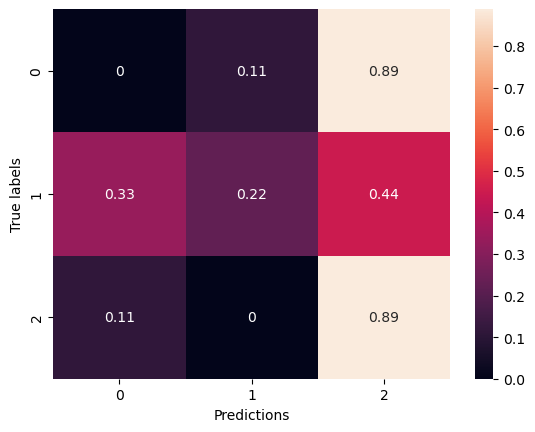

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇▇▇▇█▇▇████▇██████████
training_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▃▁▁▁▂▃▆▅▇▇▇█▆▆▇▄▇▆▇▂▆▇█▃▅▇█▄▄▇▆█▇▇▆██▅▇
val_loss,█▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:52:23.606783: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:52:23.608228: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:52:23.610263: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:52:25.209888: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:52:25.212044: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:52:25.214376: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:52:29.320935: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:52:29.900345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 10.9732 - accuracy: 0.3995

2024-03-12 15:52:33.571758: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:52:33.573380: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:52:33.575364: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 434ms/step - loss: 10.9732 - accuracy: 0.3995 - val_loss: 10.7742 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 173ms/step - loss: 10.0140 - accuracy: 0.6073 - val_loss: 10.9116 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 174ms/step - loss: 9.5031 - accuracy: 0.6667 - val_loss: 10.6190 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 173ms/step - loss: 9.0417 - accuracy: 0.7032 - val_loss: 10.4960 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 173ms/step - loss: 8.4336 - accuracy: 0.7922 - val_loss: 10.5960 - val_accuracy: 0.1111
Epoch 6/100
7/7 [==============================] - 1s 176ms/step - loss: 8.0833 - accuracy: 0.7968 - val_loss: 10.4538 - val_accuracy: 0.1204
Epoch 7/100
7/7 [==============================] - 1s 175ms/step - loss: 7.6797 - accuracy: 0.8425 - val_loss: 10.1669 - val_accuracy: 0.1296
Epoch 8/100
7/7

Epoch 59/100
7/7 [==============================] - 1s 172ms/step - loss: 1.0497 - accuracy: 0.9772 - val_loss: 4.6769 - val_accuracy: 0.5741
Epoch 60/100
7/7 [==============================] - 1s 176ms/step - loss: 0.9995 - accuracy: 0.9909 - val_loss: 4.4992 - val_accuracy: 0.6111
Epoch 61/100
7/7 [==============================] - 1s 192ms/step - loss: 0.9822 - accuracy: 0.9840 - val_loss: 4.2820 - val_accuracy: 0.6111
Epoch 62/100
7/7 [==============================] - 1s 175ms/step - loss: 0.9410 - accuracy: 0.9863 - val_loss: 4.1510 - val_accuracy: 0.5556
Epoch 63/100
7/7 [==============================] - 1s 173ms/step - loss: 0.9536 - accuracy: 0.9772 - val_loss: 4.3387 - val_accuracy: 0.5556
Epoch 64/100
7/7 [==============================] - 1s 183ms/step - loss: 0.9000 - accuracy: 0.9954 - val_loss: 4.1911 - val_accuracy: 0.5741
Epoch 65/100
7/7 [==============================] - 1s 175ms/step - loss: 0.8934 - accuracy: 0.9886 - val_loss: 4.5124 - val_accuracy: 0.5000
Epoch 

2024-03-12 15:54:34.751062: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:54:34.752832: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:54:34.754877: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5346159934997559 s
{'0': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '1': {'precision': 0.3125, 'recall': 0.5555555555555556, 'f1-score': 0.39999999999999997, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.4041666666666666, 'recall': 0.3703703703703704, 'f1-score': 0.36190476190476195, 'support': 27}, 'weighted avg': {'precision': 0.4041666666666667, 'recall': 0.37037037037037035, 'f1-score': 0.3619047619047619, 'support': 27}}


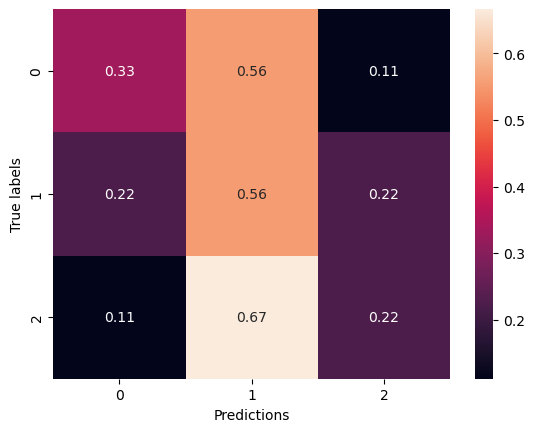

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▇▇▇██████████████████████████████████
training_loss,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▂▂▆▆▆▆█▇▇▇▇▇▆▇▇█▆▆█▇█▇▅▇▇▇▆▅▇▆▆▆▄▅▃▅
val_loss,███▇▅▅▃▃▃▂▂▂▂▂▁▂▂▁▃▁▁▂▁▂▁▁▃▁▁▁▁▂▁▂▂▁▂▂▄▃


Epoch 1/100


2024-03-12 15:54:57.691623: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:54:57.693769: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:54:57.695404: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:54:59.313625: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:54:59.315919: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:54:59.317706: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:55:04.340122: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:55:04.913597: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 47.0056 - accuracy: 0.3950

2024-03-12 15:55:08.653490: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:55:08.655312: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:55:08.656999: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 430ms/step - loss: 47.0056 - accuracy: 0.3950 - val_loss: 43.6525 - val_accuracy: 0.1481
Epoch 2/100
7/7 [==============================] - 1s 171ms/step - loss: 40.8725 - accuracy: 0.6027 - val_loss: 38.2703 - val_accuracy: 0.1667
Epoch 3/100
7/7 [==============================] - 1s 173ms/step - loss: 35.4326 - accuracy: 0.6758 - val_loss: 33.3021 - val_accuracy: 0.1481
Epoch 4/100
7/7 [==============================] - 1s 174ms/step - loss: 30.6087 - accuracy: 0.7146 - val_loss: 28.8846 - val_accuracy: 0.1481
Epoch 5/100
7/7 [==============================] - 1s 173ms/step - loss: 26.3539 - accuracy: 0.7466 - val_loss: 25.1179 - val_accuracy: 0.1759
Epoch 6/100
7/7 [==============================] - 1s 171ms/step - loss: 22.5772 - accuracy: 0.8356 - val_loss: 21.7929 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 174ms/step - loss: 19.3993 - accuracy: 0.8493 - val_loss: 19.0887 - val_accuracy: 0.1759
Epoch 8/10

Epoch 59/100
7/7 [==============================] - 1s 174ms/step - loss: 0.9418 - accuracy: 0.9658 - val_loss: 4.0426 - val_accuracy: 0.4722
Epoch 60/100
7/7 [==============================] - 1s 174ms/step - loss: 0.9281 - accuracy: 0.9635 - val_loss: 4.1353 - val_accuracy: 0.5648
Epoch 61/100
7/7 [==============================] - 1s 177ms/step - loss: 0.9343 - accuracy: 0.9566 - val_loss: 3.8526 - val_accuracy: 0.6019
Epoch 62/100
7/7 [==============================] - 1s 179ms/step - loss: 0.9648 - accuracy: 0.9475 - val_loss: 3.8547 - val_accuracy: 0.5463
Epoch 63/100
7/7 [==============================] - 1s 173ms/step - loss: 0.9064 - accuracy: 0.9658 - val_loss: 6.3989 - val_accuracy: 0.3611
Epoch 64/100
7/7 [==============================] - 1s 177ms/step - loss: 0.8766 - accuracy: 0.9817 - val_loss: 5.5663 - val_accuracy: 0.4167
Epoch 65/100
7/7 [==============================] - 1s 173ms/step - loss: 0.9241 - accuracy: 0.9589 - val_loss: 5.0154 - val_accuracy: 0.3889
Epoch 

2024-03-12 15:57:11.017330: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:57:11.019661: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:57:11.021332: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4748260974884033 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.6666666666666666, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.41111111111111115, 'recall': 0.3703703703703704, 'f1-score': 0.3459503459503459, 'support': 27}, 'weighted avg': {'precision': 0.4111111111111111, 'recall': 0.37037037037037035, 'f1-score': 0.3459503459503459, 'support': 27}}


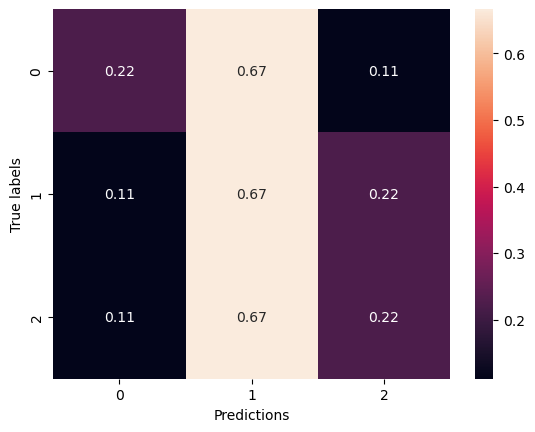

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▇▇▇█▇██▇████████████▇███████▇█████
training_loss,█▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▃▃▄▇▅▄▅▆▆▇▅▅▇▆▆▆▆▅▆▅▅▇▅▇▅▅▅▇█▇▆▅▆▆▆▇▃
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 15:57:34.133535: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:57:34.135543: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:57:34.137138: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:57:35.749693: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:57:35.751893: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:57:35.753577: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 15:57:39.872636: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 15:57:40.449574: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 64.5660 - accuracy: 0.4041

2024-03-12 15:57:44.875004: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:57:44.876597: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:57:44.878459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 427ms/step - loss: 64.5660 - accuracy: 0.4041 - val_loss: 59.3418 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 192ms/step - loss: 55.0606 - accuracy: 0.6119 - val_loss: 51.1302 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 176ms/step - loss: 46.7619 - accuracy: 0.6530 - val_loss: 43.5377 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 184ms/step - loss: 39.5038 - accuracy: 0.6941 - val_loss: 37.0175 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 177ms/step - loss: 33.1760 - accuracy: 0.7534 - val_loss: 31.3536 - val_accuracy: 0.1204
Epoch 6/100
7/7 [==============================] - 1s 178ms/step - loss: 27.8543 - accuracy: 0.7854 - val_loss: 26.2831 - val_accuracy: 0.1296
Epoch 7/100
7/7 [==============================] - 1s 173ms/step - loss: 23.2358 - accuracy: 0.8333 - val_loss: 21.9238 - val_accuracy: 0.2500
Epoch 8/10

wandb: Network error (ConnectTimeout), entering retry loop.


7/7 [==============================] - 1s 173ms/step - loss: 1.2904 - accuracy: 0.9703 - val_loss: 3.9932 - val_accuracy: 0.4815
Epoch 44/100
7/7 [==============================] - 1s 173ms/step - loss: 1.2580 - accuracy: 0.9772 - val_loss: 4.4594 - val_accuracy: 0.4907
Epoch 45/100
7/7 [==============================] - 1s 172ms/step - loss: 1.2087 - accuracy: 0.9543 - val_loss: 4.1166 - val_accuracy: 0.5000
Epoch 46/100
7/7 [==============================] - 1s 174ms/step - loss: 1.1936 - accuracy: 0.9566 - val_loss: 6.0819 - val_accuracy: 0.3426
Epoch 47/100
7/7 [==============================] - 1s 175ms/step - loss: 1.2004 - accuracy: 0.9521 - val_loss: 4.0763 - val_accuracy: 0.5000
Epoch 48/100
7/7 [==============================] - 1s 173ms/step - loss: 1.1759 - accuracy: 0.9543 - val_loss: 4.4550 - val_accuracy: 0.4259
Epoch 49/100
7/7 [==============================] - 1s 184ms/step - loss: 1.1440 - accuracy: 0.9543 - val_loss: 3.7033 - val_accuracy: 0.5278
Epoch 50/100
7/7 [=

Training done in 132.87507605552673 s


2024-03-12 15:59:46.998841: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 15:59:47.001191: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 15:59:47.002997: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.7260959148406982 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '2': {'precision': 0.375, 'recall': 0.6666666666666666, 'f1-score': 0.4800000000000001, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.40277777777777773, 'recall': 0.3703703703703704, 'f1-score': 0.33171717171717174, 'support': 27}, 'weighted avg': {'precision': 0.4027777777777778, 'recall': 0.37037037037037035, 'f1-score': 0.33171717171717174, 'support': 27}}


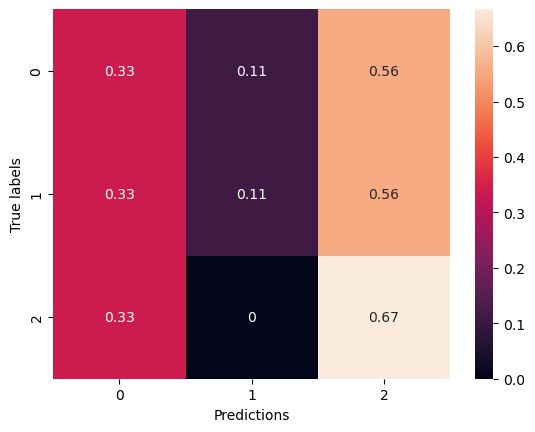

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▇▇▇▇▇▇█████████▇████████████▇▇████
training_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▃▄▄▅▇▆▅▅▆▆▅▇▇▆▆▄▇▆▇▄▇▆▇▆▅▆▇▇▆▇▆▆▅▆█▅▇
val_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:00:15.523054: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:00:15.525487: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:00:15.529600: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:00:17.161413: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:00:17.163213: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:00:17.165232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:00:21.301224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:00:21.881554: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 11.0790 - accuracy: 0.3927

2024-03-12 16:00:25.544223: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:00:25.546522: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:00:25.548007: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 424ms/step - loss: 11.0790 - accuracy: 0.3927 - val_loss: 10.4688 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 173ms/step - loss: 10.3348 - accuracy: 0.4886 - val_loss: 10.2627 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 174ms/step - loss: 9.8574 - accuracy: 0.5479 - val_loss: 10.0178 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 174ms/step - loss: 9.5015 - accuracy: 0.5708 - val_loss: 9.8353 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 173ms/step - loss: 9.0812 - accuracy: 0.6279 - val_loss: 9.7865 - val_accuracy: 0.1296
Epoch 6/100
7/7 [==============================] - 1s 185ms/step - loss: 8.8076 - accuracy: 0.6164 - val_loss: 9.5817 - val_accuracy: 0.1204
Epoch 7/100
7/7 [==============================] - 1s 174ms/step - loss: 8.3344 - accuracy: 0.6712 - val_loss: 9.0526 - val_accuracy: 0.1574
Epoch 8/100
7/7 [==

Epoch 59/100
7/7 [==============================] - 1s 174ms/step - loss: 1.3969 - accuracy: 0.9840 - val_loss: 6.5379 - val_accuracy: 0.3981
Epoch 60/100
7/7 [==============================] - 1s 175ms/step - loss: 1.3835 - accuracy: 0.9795 - val_loss: 5.2412 - val_accuracy: 0.4907
Epoch 61/100
7/7 [==============================] - 1s 177ms/step - loss: 1.3582 - accuracy: 0.9749 - val_loss: 5.6874 - val_accuracy: 0.4537
Epoch 62/100
7/7 [==============================] - 1s 175ms/step - loss: 1.3298 - accuracy: 0.9680 - val_loss: 5.4377 - val_accuracy: 0.4722
Epoch 63/100
7/7 [==============================] - 1s 176ms/step - loss: 1.2744 - accuracy: 0.9817 - val_loss: 4.6021 - val_accuracy: 0.5463
Epoch 64/100
7/7 [==============================] - 1s 173ms/step - loss: 1.2685 - accuracy: 0.9772 - val_loss: 4.6945 - val_accuracy: 0.5370
Epoch 65/100
7/7 [==============================] - 1s 175ms/step - loss: 1.2058 - accuracy: 0.9886 - val_loss: 5.2874 - val_accuracy: 0.4907
Epoch 

2024-03-12 16:02:27.587537: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:02:27.589148: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:02:27.591336: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4735932350158691 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, '2': {'precision': 0.4166666666666667, 'recall': 0.5555555555555556, 'f1-score': 0.4761904761904762, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.48504273504273504, 'recall': 0.48148148148148145, 'f1-score': 0.4314574314574315, 'support': 27}, 'weighted avg': {'precision': 0.48504273504273504, 'recall': 0.48148148148148145, 'f1-score': 0.43145743145743143, 'support': 27}}


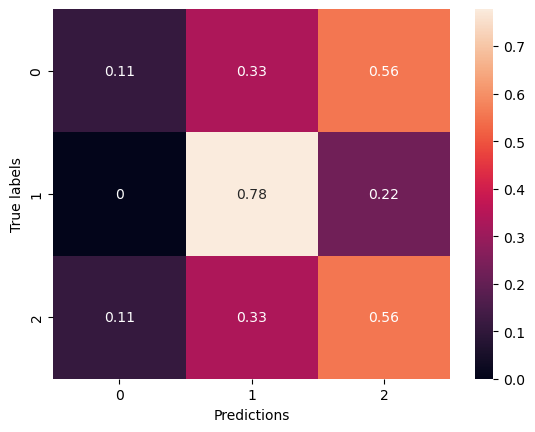

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▅▆▆▆▇▇▇▇████████████████████████████
training_loss,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▆▆▇▆▅▆▆▅▄▆▇▆▆▆█▇▅▅▅▅▆▇▇▅▇▇▇▇▇▆▇▆▆▃▆▅
val_loss,██▇▆▅▅▄▄▄▄▄▄▄▃▃▃▃▃▂▂▄▄▅▄▃▂▂▄▁▂▂▂▂▂▁▂▃▄▁▂


Epoch 1/100


2024-03-12 16:02:54.231644: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:02:54.233795: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:02:54.235685: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:02:55.880510: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:02:55.883446: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:02:55.886041: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:03:01.052218: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:03:01.627184: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 47.4058 - accuracy: 0.4018

2024-03-12 16:03:05.413974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:03:05.416079: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:03:05.417723: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 453ms/step - loss: 47.4058 - accuracy: 0.4018 - val_loss: 44.0949 - val_accuracy: 0.1759
Epoch 2/100
7/7 [==============================] - 1s 180ms/step - loss: 41.9533 - accuracy: 0.5228 - val_loss: 39.4898 - val_accuracy: 0.1574
Epoch 3/100
7/7 [==============================] - 1s 175ms/step - loss: 37.1049 - accuracy: 0.5639 - val_loss: 35.2144 - val_accuracy: 0.1481
Epoch 4/100
7/7 [==============================] - 1s 172ms/step - loss: 32.8044 - accuracy: 0.6187 - val_loss: 31.2137 - val_accuracy: 0.1389
Epoch 5/100
7/7 [==============================] - 1s 172ms/step - loss: 28.8753 - accuracy: 0.6416 - val_loss: 27.8773 - val_accuracy: 0.1296
Epoch 6/100
7/7 [==============================] - 1s 172ms/step - loss: 25.4160 - accuracy: 0.6484 - val_loss: 24.8624 - val_accuracy: 0.1481
Epoch 7/100
7/7 [==============================] - 1s 173ms/step - loss: 22.3588 - accuracy: 0.7032 - val_loss: 21.7172 - val_accuracy: 0.1944
Epoch 8/10

7/7 [==============================] - 1s 174ms/step - loss: 1.1696 - accuracy: 0.9658 - val_loss: 4.2138 - val_accuracy: 0.5185
Epoch 59/100
7/7 [==============================] - 1s 175ms/step - loss: 1.1305 - accuracy: 0.9658 - val_loss: 4.0459 - val_accuracy: 0.6019
Epoch 60/100
7/7 [==============================] - 1s 176ms/step - loss: 1.0871 - accuracy: 0.9658 - val_loss: 3.9644 - val_accuracy: 0.5093
Epoch 61/100
7/7 [==============================] - 1s 172ms/step - loss: 1.0782 - accuracy: 0.9589 - val_loss: 3.6886 - val_accuracy: 0.5278
Epoch 62/100
7/7 [==============================] - 1s 175ms/step - loss: 0.9854 - accuracy: 0.9840 - val_loss: 4.0411 - val_accuracy: 0.5648
Epoch 63/100
7/7 [==============================] - 1s 173ms/step - loss: 0.9778 - accuracy: 0.9863 - val_loss: 3.9419 - val_accuracy: 0.5370
Epoch 64/100
7/7 [==============================] - 1s 174ms/step - loss: 0.9546 - accuracy: 0.9840 - val_loss: 3.4805 - val_accuracy: 0.5833
Epoch 65/100
7/7 [=

2024-03-12 16:05:08.066082: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:05:08.067850: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:05:08.069667: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4833369255065918 s
{'0': {'precision': 0.25, 'recall': 0.1111111111111111, 'f1-score': 0.15384615384615383, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '2': {'precision': 0.5333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.6666666666666667, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.42777777777777776, 'recall': 0.48148148148148145, 'f1-score': 0.43036701860231275, 'support': 27}, 'weighted avg': {'precision': 0.4277777777777778, 'recall': 0.48148148148148145, 'f1-score': 0.43036701860231275, 'support': 27}}


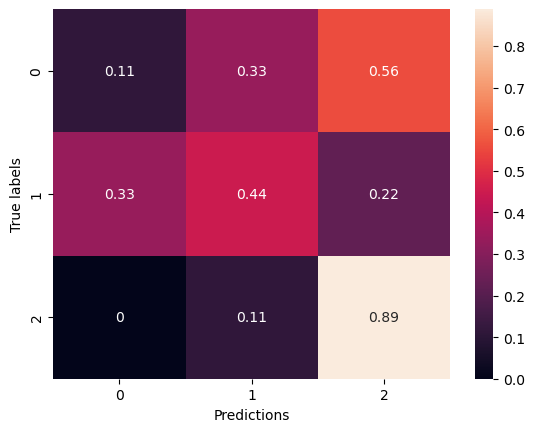

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▆▇▆▇▇▇▇▇▇▇█▇▇█▇▇▇██████▇███▇███████
training_loss,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▅▄▆▇█▅▆▇▆██▆█▆▅▇▇▇██▇█▆▇▆▆▅█▆▇▇▇▄▅▇▇
val_loss,█▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:05:32.647681: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:05:32.649704: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:05:32.651345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:05:34.281319: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:05:34.283293: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:05:34.285324: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:05:38.398072: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:05:38.975552: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 64.9784 - accuracy: 0.3744

2024-03-12 16:05:42.762704: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:05:42.764684: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:05:42.766543: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 593ms/step - loss: 64.9784 - accuracy: 0.3744 - val_loss: 59.8556 - val_accuracy: 0.1667
Epoch 2/100
7/7 [==============================] - 1s 174ms/step - loss: 56.3315 - accuracy: 0.4543 - val_loss: 51.9873 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 194ms/step - loss: 48.6481 - accuracy: 0.5228 - val_loss: 44.9914 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 177ms/step - loss: 41.9611 - accuracy: 0.5571 - val_loss: 38.8142 - val_accuracy: 0.1389
Epoch 5/100
7/7 [==============================] - 1s 173ms/step - loss: 36.0443 - accuracy: 0.5411 - val_loss: 33.4496 - val_accuracy: 0.1944
Epoch 6/100
7/7 [==============================] - 1s 183ms/step - loss: 30.9650 - accuracy: 0.6027 - val_loss: 28.8654 - val_accuracy: 0.1944
Epoch 7/100
7/7 [==============================] - 1s 180ms/step - loss: 26.5623 - accuracy: 0.6507 - val_loss: 25.1797 - val_accuracy: 0.1852
Epoch 8/10

7/7 [==============================] - 1s 177ms/step - loss: 1.2271 - accuracy: 0.9635 - val_loss: 4.5901 - val_accuracy: 0.5278
Epoch 59/100
7/7 [==============================] - 1s 173ms/step - loss: 1.1826 - accuracy: 0.9612 - val_loss: 4.7670 - val_accuracy: 0.4259
Epoch 60/100
7/7 [==============================] - 1s 173ms/step - loss: 1.1492 - accuracy: 0.9680 - val_loss: 5.3437 - val_accuracy: 0.3981
Epoch 61/100
7/7 [==============================] - 1s 188ms/step - loss: 1.1554 - accuracy: 0.9566 - val_loss: 4.9988 - val_accuracy: 0.4167
Epoch 62/100
7/7 [==============================] - 1s 175ms/step - loss: 1.0807 - accuracy: 0.9749 - val_loss: 4.9850 - val_accuracy: 0.4259
Epoch 63/100
7/7 [==============================] - 1s 175ms/step - loss: 1.0620 - accuracy: 0.9772 - val_loss: 4.0740 - val_accuracy: 0.5278
Epoch 64/100
7/7 [==============================] - 1s 172ms/step - loss: 1.0115 - accuracy: 0.9817 - val_loss: 4.5184 - val_accuracy: 0.5926
Epoch 65/100
7/7 [=

2024-03-12 16:07:45.773475: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:07:45.775037: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:07:45.776888: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4779582023620605 s
{'0': {'precision': 0.3684210526315789, 'recall': 0.7777777777777778, 'f1-score': 0.5, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.34502923976608185, 'recall': 0.40740740740740744, 'f1-score': 0.3444444444444444, 'support': 27}, 'weighted avg': {'precision': 0.34502923976608185, 'recall': 0.4074074074074074, 'f1-score': 0.3444444444444445, 'support': 27}}


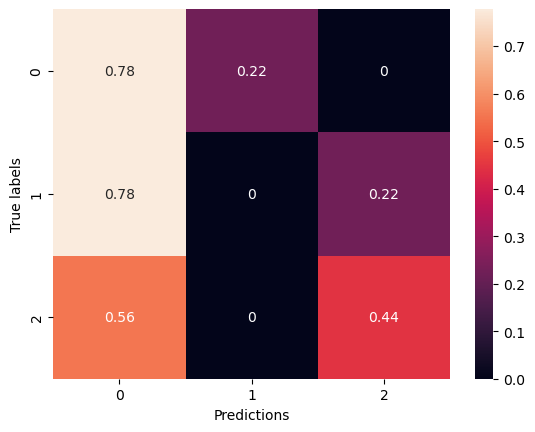

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▅▆▆▇▇▇▇▇▇▇████▇███▇███▇▇█████▇▇▇████
training_loss,█▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▂▂▅▅▆▅█▇▇▆▅▆▇▇▅██▆▅▆▆▅█▇▅▅▆▇▇▇▆▆▇▅▆▆▄
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:08:09.201495: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:08:09.203454: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:08:09.205386: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:08:10.805409: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:08:10.807760: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:08:10.809493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:08:14.926860: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:08:15.505151: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 11.1733 - accuracy: 0.3174

2024-03-12 16:08:19.213590: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:08:19.215673: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:08:19.217239: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 440ms/step - loss: 11.1733 - accuracy: 0.3174 - val_loss: 10.5485 - val_accuracy: 0.1481
Epoch 2/100
7/7 [==============================] - 1s 184ms/step - loss: 10.6777 - accuracy: 0.3539 - val_loss: 10.3290 - val_accuracy: 0.1481
Epoch 3/100
7/7 [==============================] - 1s 175ms/step - loss: 10.3116 - accuracy: 0.3881 - val_loss: 10.1968 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 175ms/step - loss: 9.8565 - accuracy: 0.4521 - val_loss: 10.0404 - val_accuracy: 0.1296
Epoch 5/100
7/7 [==============================] - 1s 176ms/step - loss: 9.6099 - accuracy: 0.4315 - val_loss: 9.8270 - val_accuracy: 0.1481
Epoch 6/100
7/7 [==============================] - 1s 174ms/step - loss: 9.2835 - accuracy: 0.4680 - val_loss: 9.5840 - val_accuracy: 0.1481
Epoch 7/100
7/7 [==============================] - 1s 175ms/step - loss: 8.9855 - accuracy: 0.4909 - val_loss: 9.4037 - val_accuracy: 0.1389
Epoch 8/100
7/7 [

Epoch 59/100
7/7 [==============================] - 1s 173ms/step - loss: 1.9233 - accuracy: 0.9384 - val_loss: 5.1649 - val_accuracy: 0.5370
Epoch 60/100
7/7 [==============================] - 1s 173ms/step - loss: 1.9115 - accuracy: 0.9361 - val_loss: 4.7817 - val_accuracy: 0.6204
Epoch 61/100
7/7 [==============================] - 1s 173ms/step - loss: 1.8794 - accuracy: 0.9498 - val_loss: 4.6872 - val_accuracy: 0.5370
Epoch 62/100
7/7 [==============================] - 1s 175ms/step - loss: 1.8457 - accuracy: 0.9338 - val_loss: 4.4022 - val_accuracy: 0.6296
Epoch 63/100
7/7 [==============================] - 1s 176ms/step - loss: 1.7464 - accuracy: 0.9566 - val_loss: 4.8561 - val_accuracy: 0.6204
Epoch 64/100
7/7 [==============================] - 1s 173ms/step - loss: 1.7063 - accuracy: 0.9566 - val_loss: 4.8886 - val_accuracy: 0.5741
Epoch 65/100
7/7 [==============================] - 1s 173ms/step - loss: 1.6418 - accuracy: 0.9772 - val_loss: 4.8315 - val_accuracy: 0.5833
Epoch 

2024-03-12 16:10:21.226646: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:10:21.228782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:10:21.230433: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4901869297027588 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.48484848484848486, 'support': 9}, 'accuracy': 0.2962962962962963, 'macro avg': {'precision': 0.1111111111111111, 'recall': 0.2962962962962963, 'f1-score': 0.16161616161616163, 'support': 27}, 'weighted avg': {'precision': 0.1111111111111111, 'recall': 0.2962962962962963, 'f1-score': 0.1616161616161616, 'support': 27}}


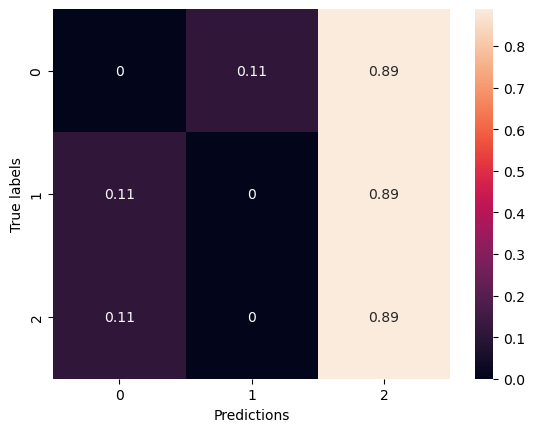

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▃▄▄▄▄▅▅▅▆▆▆▆▇▇▇▇▇▇█▇█████████▇██████
training_loss,█▇▇▆▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▂▂▂▄▃▅▇▇▇█▆▇█▇▅██▇▇▇█▆▇▇█▇▇▇▇▆█▇▇▇
val_loss,██▇▇▇▇▆▆▅▅▆▄▃▃▃▃▃▃▃▃▄▃▂▃▂▃▂▃▂▂▁▂▂▂▁▂▁▂▂▂


Epoch 1/100


2024-03-12 16:10:45.284282: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:10:45.285862: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:10:45.287546: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:10:46.896117: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:10:46.897910: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:10:46.899866: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:10:52.085311: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:10:52.657888: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 47.5151 - accuracy: 0.3242

2024-03-12 16:10:56.330761: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:10:56.332199: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:10:56.334180: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 426ms/step - loss: 47.5151 - accuracy: 0.3242 - val_loss: 44.0672 - val_accuracy: 0.2037
Epoch 2/100
7/7 [==============================] - 1s 175ms/step - loss: 42.6477 - accuracy: 0.3470 - val_loss: 39.7941 - val_accuracy: 0.1852
Epoch 3/100
7/7 [==============================] - 1s 175ms/step - loss: 38.2386 - accuracy: 0.3927 - val_loss: 35.9092 - val_accuracy: 0.1759
Epoch 4/100
7/7 [==============================] - 1s 185ms/step - loss: 34.5205 - accuracy: 0.3904 - val_loss: 32.4050 - val_accuracy: 0.1759
Epoch 5/100
7/7 [==============================] - 1s 175ms/step - loss: 30.8967 - accuracy: 0.4498 - val_loss: 29.2792 - val_accuracy: 0.1852
Epoch 6/100
7/7 [==============================] - 1s 176ms/step - loss: 27.8475 - accuracy: 0.4612 - val_loss: 26.4995 - val_accuracy: 0.1759
Epoch 7/100
7/7 [==============================] - 1s 171ms/step - loss: 25.1336 - accuracy: 0.4795 - val_loss: 24.1759 - val_accuracy: 0.1481
Epoch 8/10

7/7 [==============================] - 1s 175ms/step - loss: 1.4836 - accuracy: 0.9269 - val_loss: 4.6040 - val_accuracy: 0.4537
Epoch 59/100
7/7 [==============================] - 1s 175ms/step - loss: 1.4942 - accuracy: 0.9178 - val_loss: 4.6685 - val_accuracy: 0.4352
Epoch 60/100
7/7 [==============================] - 1s 176ms/step - loss: 1.4539 - accuracy: 0.9247 - val_loss: 4.7168 - val_accuracy: 0.4352
Epoch 61/100
7/7 [==============================] - 1s 176ms/step - loss: 1.4702 - accuracy: 0.9110 - val_loss: 4.5174 - val_accuracy: 0.4167
Epoch 62/100
7/7 [==============================] - 1s 174ms/step - loss: 1.4147 - accuracy: 0.9269 - val_loss: 4.4447 - val_accuracy: 0.4167
Epoch 63/100
7/7 [==============================] - 1s 176ms/step - loss: 1.3694 - accuracy: 0.9498 - val_loss: 4.3813 - val_accuracy: 0.5278
Epoch 64/100
7/7 [==============================] - 1s 175ms/step - loss: 1.2852 - accuracy: 0.9658 - val_loss: 6.2339 - val_accuracy: 0.3704
Epoch 65/100
7/7 [=

2024-03-12 16:12:58.629404: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:12:58.631718: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:12:58.633345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4649579524993896 s
{'0': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '1': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, '2': {'precision': 0.6, 'recall': 0.6666666666666666, 'f1-score': 0.631578947368421, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5782051282051283, 'recall': 0.5185185185185185, 'f1-score': 0.515887621150779, 'support': 27}, 'weighted avg': {'precision': 0.5782051282051283, 'recall': 0.5185185185185185, 'f1-score': 0.5158876211507791, 'support': 27}}


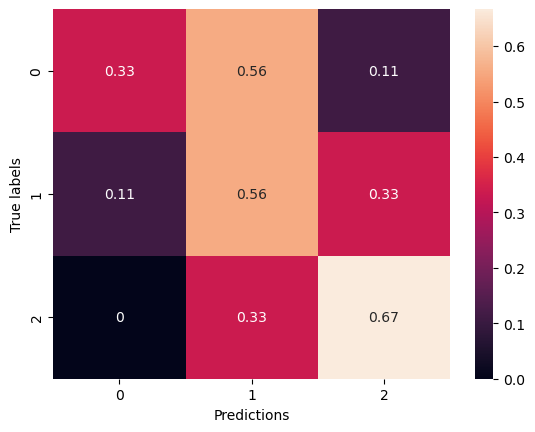

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▄▄▄▅▅▆▆▆▇▇▇▇▇▇▇███▇▇█████▇█████████
training_loss,█▇▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▂▁▄▅▆▅▆▆▄▇▇▃██▆▆▅▆▆▅▅▄▇▇▆▆▇▅▇▆▄█▅▆▇▆
val_loss,█▇▅▄▃▃▂▂▂▂▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:15:23.811513: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:15:23.813590: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:15:23.815248: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:15:25.430009: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:15:25.431790: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:15:25.433809: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:15:29.610313: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:15:30.222477: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 65.1511 - accuracy: 0.3584

2024-03-12 16:15:33.988758: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:15:33.990490: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:15:33.992327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 579ms/step - loss: 65.1511 - accuracy: 0.3584 - val_loss: 59.7509 - val_accuracy: 0.1667
Epoch 2/100
7/7 [==============================] - 1s 180ms/step - loss: 56.7962 - accuracy: 0.4110 - val_loss: 52.2985 - val_accuracy: 0.1759
Epoch 3/100
7/7 [==============================] - 1s 178ms/step - loss: 49.5437 - accuracy: 0.4132 - val_loss: 45.6930 - val_accuracy: 0.1574
Epoch 4/100
7/7 [==============================] - 1s 180ms/step - loss: 43.2204 - accuracy: 0.4087 - val_loss: 39.9330 - val_accuracy: 0.1574
Epoch 5/100
7/7 [==============================] - 1s 178ms/step - loss: 37.6646 - accuracy: 0.4224 - val_loss: 34.8973 - val_accuracy: 0.1574
Epoch 6/100
7/7 [==============================] - 1s 178ms/step - loss: 32.9559 - accuracy: 0.4201 - val_loss: 30.5520 - val_accuracy: 0.1667
Epoch 7/100
7/7 [==============================] - 1s 178ms/step - loss: 28.7237 - accuracy: 0.5023 - val_loss: 26.8640 - val_accuracy: 0.1667
Epoch 8/10

7/7 [==============================] - 1s 175ms/step - loss: 1.3378 - accuracy: 0.9406 - val_loss: 5.2154 - val_accuracy: 0.3981
Epoch 59/100
7/7 [==============================] - 1s 181ms/step - loss: 1.3212 - accuracy: 0.9315 - val_loss: 3.8990 - val_accuracy: 0.5741
Epoch 60/100
7/7 [==============================] - 1s 175ms/step - loss: 1.3289 - accuracy: 0.9406 - val_loss: 4.0642 - val_accuracy: 0.5000
Epoch 61/100
7/7 [==============================] - 1s 175ms/step - loss: 1.3677 - accuracy: 0.9110 - val_loss: 6.8020 - val_accuracy: 0.2130
Epoch 62/100
7/7 [==============================] - 1s 175ms/step - loss: 1.3461 - accuracy: 0.9110 - val_loss: 4.1609 - val_accuracy: 0.4630
Epoch 63/100
7/7 [==============================] - 1s 177ms/step - loss: 1.3226 - accuracy: 0.9224 - val_loss: 4.0171 - val_accuracy: 0.4352
Epoch 64/100
7/7 [==============================] - 1s 176ms/step - loss: 1.3436 - accuracy: 0.9041 - val_loss: 5.2073 - val_accuracy: 0.3796
Epoch 65/100
7/7 [=

2024-03-12 16:17:37.685089: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:17:37.687230: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:17:37.688842: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4799399375915527 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.8888888888888888, 'f1-score': 0.5517241379310346, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.5222222222222221, 'recall': 0.4444444444444444, 'f1-score': 0.39758325965222524, 'support': 27}, 'weighted avg': {'precision': 0.5222222222222223, 'recall': 0.4444444444444444, 'f1-score': 0.3975832596522252, 'support': 27}}


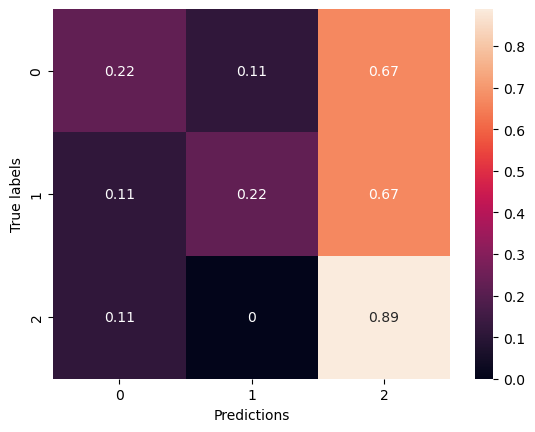

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▃▄▄▄▆▅▆▆▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇███▇█▇▇████▇
training_loss,█▆▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▂▂▂▃▁▄▄▅▆▇▆▆▅▆▅█▇█▇▇▇▂▄▆▅▇▅▇▅▆▇▇▆▃▆▄▇
val_loss,█▆▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:18:01.708644: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:18:01.710493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:18:01.712107: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:18:03.306232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:18:03.308302: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:18:03.310383: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:18:07.496637: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:18:08.075254: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 7.4305 - accuracy: 0.3653

2024-03-12 16:18:11.304518: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:18:11.306208: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:18:11.308253: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 626ms/step - loss: 7.4305 - accuracy: 0.3653 - val_loss: 6.8732 - val_accuracy: 0.2130
Epoch 2/100
4/4 [==============================] - 0s 123ms/step - loss: 6.8761 - accuracy: 0.4977 - val_loss: 6.7911 - val_accuracy: 0.2593
Epoch 3/100
4/4 [==============================] - 0s 124ms/step - loss: 6.5996 - accuracy: 0.5868 - val_loss: 6.7156 - val_accuracy: 0.2222
Epoch 4/100
4/4 [==============================] - 0s 124ms/step - loss: 6.3615 - accuracy: 0.6119 - val_loss: 6.6090 - val_accuracy: 0.1852
Epoch 5/100
4/4 [==============================] - 0s 121ms/step - loss: 6.1793 - accuracy: 0.6301 - val_loss: 6.5088 - val_accuracy: 0.1852
Epoch 6/100
4/4 [==============================] - 0s 122ms/step - loss: 6.0293 - accuracy: 0.6370 - val_loss: 6.4614 - val_accuracy: 0.1667
Epoch 7/100
4/4 [==============================] - 0s 124ms/step - loss: 5.7684 - accuracy: 0.6804 - val_loss: 6.4373 - val_accuracy: 0.1574
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 0s 125ms/step - loss: 1.5168 - accuracy: 0.9886 - val_loss: 5.1122 - val_accuracy: 0.4167
Epoch 60/100
4/4 [==============================] - 0s 123ms/step - loss: 1.5092 - accuracy: 0.9703 - val_loss: 5.3981 - val_accuracy: 0.3889
Epoch 61/100
4/4 [==============================] - 0s 122ms/step - loss: 1.4645 - accuracy: 0.9840 - val_loss: 4.8003 - val_accuracy: 0.4537
Epoch 62/100
4/4 [==============================] - 0s 123ms/step - loss: 1.4456 - accuracy: 0.9772 - val_loss: 4.7952 - val_accuracy: 0.4444
Epoch 63/100
4/4 [==============================] - 0s 123ms/step - loss: 1.4325 - accuracy: 0.9703 - val_loss: 5.3362 - val_accuracy: 0.3981
Epoch 64/100
4/4 [==============================] - 0s 123ms/step - loss: 1.3981 - accuracy: 0.9817 - val_loss: 6.4670 - val_accuracy: 0.3519
Epoch 65/100
4/4 [==============================] - 0s 123ms/step - loss: 1.3656 - accuracy: 0.9863 - val_loss: 6.3387 - val_accuracy: 0.3426
Epoch 

2024-03-12 16:19:01.812708: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:19:01.814414: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:19:01.816637: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.45704984664917 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.8888888888888888, 'f1-score': 0.5925925925925926, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.2962962962962963, 'recall': 0.4444444444444444, 'f1-score': 0.345679012345679, 'support': 27}, 'weighted avg': {'precision': 0.2962962962962963, 'recall': 0.4444444444444444, 'f1-score': 0.345679012345679, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


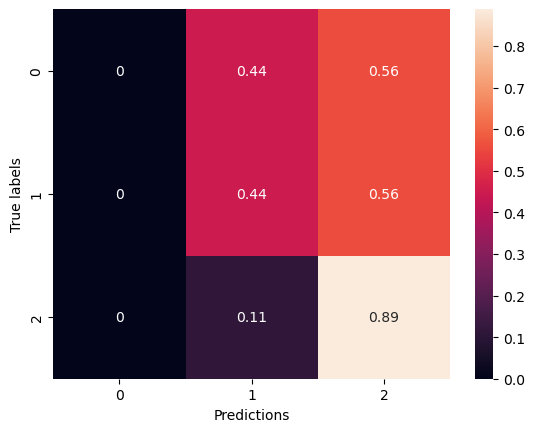

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▆▇▇▇▇█████████████████████████████
training_loss,█▇▇▆▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▂▁▁▁▂▄▅▅▆▇▆▆▇▇▇▇█▇▇▇▆▇▆▆▄█▅▇█▇▇▆▆▇▆▇▇██
val_loss,██▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▁▂▃▂▂▄▃▇▂▄▂▁▃▂▄▄▂▆▂▄▂▂


Epoch 1/100


2024-03-12 16:19:25.101327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:19:25.103113: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:19:25.104975: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:19:26.748973: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:19:26.750817: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:19:26.753313: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:19:31.947316: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:19:32.525418: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 30.3246 - accuracy: 0.3927

2024-03-12 16:19:35.548529: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:19:35.550651: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:19:35.552327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 628ms/step - loss: 30.3246 - accuracy: 0.3927 - val_loss: 28.7886 - val_accuracy: 0.1389
Epoch 2/100
4/4 [==============================] - 0s 124ms/step - loss: 28.4317 - accuracy: 0.4589 - val_loss: 27.2664 - val_accuracy: 0.1481
Epoch 3/100
4/4 [==============================] - 0s 123ms/step - loss: 26.5555 - accuracy: 0.5320 - val_loss: 25.7931 - val_accuracy: 0.1481
Epoch 4/100
4/4 [==============================] - 0s 123ms/step - loss: 24.9727 - accuracy: 0.5822 - val_loss: 24.3484 - val_accuracy: 0.1389
Epoch 5/100
4/4 [==============================] - 0s 122ms/step - loss: 23.4558 - accuracy: 0.6279 - val_loss: 22.9794 - val_accuracy: 0.1389
Epoch 6/100
4/4 [==============================] - 0s 123ms/step - loss: 21.9886 - accuracy: 0.6370 - val_loss: 21.6812 - val_accuracy: 0.1296
Epoch 7/100
4/4 [==============================] - 0s 122ms/step - loss: 20.7054 - accuracy: 0.6347 - val_loss: 20.4281 - val_accuracy: 0.1296
Epoch 8/10

4/4 [==============================] - 0s 123ms/step - loss: 1.6324 - accuracy: 0.9658 - val_loss: 3.9151 - val_accuracy: 0.6111
Epoch 59/100
4/4 [==============================] - 0s 121ms/step - loss: 1.5291 - accuracy: 0.9909 - val_loss: 4.2431 - val_accuracy: 0.4630
Epoch 60/100
4/4 [==============================] - 0s 121ms/step - loss: 1.5020 - accuracy: 0.9817 - val_loss: 4.0185 - val_accuracy: 0.5278
Epoch 61/100
4/4 [==============================] - 0s 125ms/step - loss: 1.4763 - accuracy: 0.9749 - val_loss: 4.1300 - val_accuracy: 0.4537
Epoch 62/100
4/4 [==============================] - 0s 122ms/step - loss: 1.4189 - accuracy: 0.9840 - val_loss: 5.0156 - val_accuracy: 0.3796
Epoch 63/100
4/4 [==============================] - 0s 123ms/step - loss: 1.4147 - accuracy: 0.9680 - val_loss: 3.9086 - val_accuracy: 0.5463
Epoch 64/100
4/4 [==============================] - 0s 123ms/step - loss: 1.3885 - accuracy: 0.9703 - val_loss: 3.8061 - val_accuracy: 0.5648
Epoch 65/100
4/4 [=

2024-03-12 16:20:26.015861: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:20:26.017437: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:20:26.019512: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4654688835144043 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.35714285714285715, 'recall': 0.5555555555555556, 'f1-score': 0.43478260869565216, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.28571428571428575, 'recall': 0.40740740740740744, 'f1-score': 0.33540372670807456, 'support': 27}, 'weighted avg': {'precision': 0.2857142857142857, 'recall': 0.4074074074074074, 'f1-score': 0.33540372670807456, 'support': 27}}


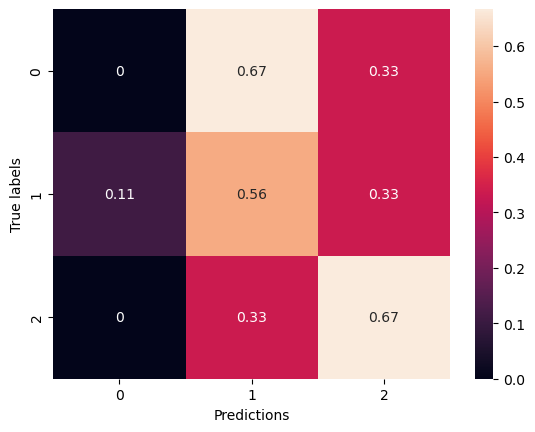

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▆▆▆▇▇▇▇█▇▇█████████████████████████
training_loss,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▂▃▃▄▆▇▇▆█▇█▇▆▆▇█▇▇▆▆▇▇▇▄▆█▅▆▆▇▆▇▆▆▆
val_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:20:52.939583: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:20:52.941390: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:20:52.943755: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:20:54.558626: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:20:54.560909: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:20:54.562744: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:20:58.699473: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:20:59.278070: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 41.6376 - accuracy: 0.4064

2024-03-12 16:21:02.304008: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:21:02.306322: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:21:02.307904: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 633ms/step - loss: 41.6376 - accuracy: 0.4064 - val_loss: 39.3284 - val_accuracy: 0.2222
Epoch 2/100
4/4 [==============================] - 0s 122ms/step - loss: 38.5574 - accuracy: 0.5023 - val_loss: 36.8093 - val_accuracy: 0.2130
Epoch 3/100
4/4 [==============================] - 0s 123ms/step - loss: 35.9126 - accuracy: 0.5434 - val_loss: 34.3860 - val_accuracy: 0.1759
Epoch 4/100
4/4 [==============================] - 0s 122ms/step - loss: 33.4397 - accuracy: 0.5708 - val_loss: 32.0993 - val_accuracy: 0.1759
Epoch 5/100
4/4 [==============================] - 0s 123ms/step - loss: 30.9594 - accuracy: 0.6758 - val_loss: 29.9141 - val_accuracy: 0.1759
Epoch 6/100
4/4 [==============================] - 0s 123ms/step - loss: 28.7871 - accuracy: 0.6735 - val_loss: 27.8544 - val_accuracy: 0.1944
Epoch 7/100
4/4 [==============================] - 0s 123ms/step - loss: 26.6834 - accuracy: 0.6758 - val_loss: 25.9480 - val_accuracy: 0.1944
Epoch 8/10

4/4 [==============================] - 0s 122ms/step - loss: 1.4700 - accuracy: 0.9817 - val_loss: 3.7404 - val_accuracy: 0.5648
Epoch 59/100
4/4 [==============================] - 0s 123ms/step - loss: 1.4977 - accuracy: 0.9589 - val_loss: 3.6043 - val_accuracy: 0.5833
Epoch 60/100
4/4 [==============================] - 0s 123ms/step - loss: 1.4723 - accuracy: 0.9589 - val_loss: 3.6218 - val_accuracy: 0.6111
Epoch 61/100
4/4 [==============================] - 0s 123ms/step - loss: 1.4633 - accuracy: 0.9452 - val_loss: 3.4313 - val_accuracy: 0.6204
Epoch 62/100
4/4 [==============================] - 0s 123ms/step - loss: 1.4190 - accuracy: 0.9612 - val_loss: 3.5532 - val_accuracy: 0.6296
Epoch 63/100
4/4 [==============================] - 0s 121ms/step - loss: 1.3462 - accuracy: 0.9772 - val_loss: 3.8898 - val_accuracy: 0.6481
Epoch 64/100
4/4 [==============================] - 0s 122ms/step - loss: 1.3735 - accuracy: 0.9521 - val_loss: 4.0995 - val_accuracy: 0.4815
Epoch 65/100
4/4 [=

2024-03-12 16:21:52.975458: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:21:52.977610: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:21:52.979718: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 2.537179946899414 s
{'0': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, '1': {'precision': 0.8333333333333334, 'recall': 0.5555555555555556, 'f1-score': 0.6666666666666667, 'support': 9}, '2': {'precision': 0.6, 'recall': 0.6666666666666666, 'f1-score': 0.631578947368421, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.6292929292929292, 'recall': 0.5925925925925926, 'f1-score': 0.5994152046783626, 'support': 27}, 'weighted avg': {'precision': 0.6292929292929292, 'recall': 0.5925925925925926, 'f1-score': 0.5994152046783625, 'support': 27}}


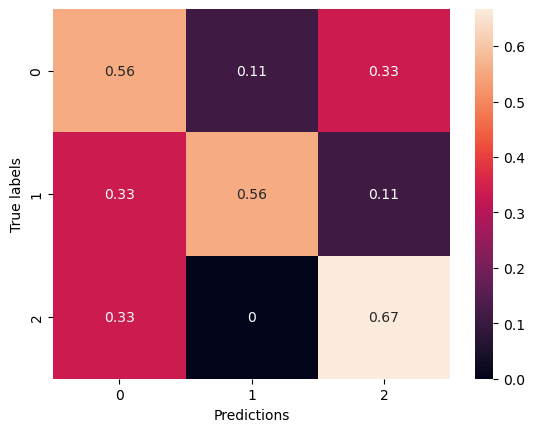

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▅▅▆▆▇▇▇▇▇▇█████▇███████████████████▇
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▂▅▅▅▆▆▄▄▄▆▅▄▄▇▅▆█▅▅▇█▆▆▇█▇▆▄▄▆▇▇▆▆▅▆
val_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:22:22.044015: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:22:22.045825: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:22:22.047737: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:22:23.641473: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:22:23.643193: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:22:23.645298: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:22:27.749271: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:22:28.326876: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 7.5480 - accuracy: 0.3607

2024-03-12 16:22:31.371138: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:22:31.373411: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:22:31.374928: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 633ms/step - loss: 7.5480 - accuracy: 0.3607 - val_loss: 6.9100 - val_accuracy: 0.1759
Epoch 2/100
4/4 [==============================] - 1s 128ms/step - loss: 7.1242 - accuracy: 0.4338 - val_loss: 6.8580 - val_accuracy: 0.1296
Epoch 3/100
4/4 [==============================] - 0s 122ms/step - loss: 6.9618 - accuracy: 0.4384 - val_loss: 6.8498 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 0s 122ms/step - loss: 6.7203 - accuracy: 0.4840 - val_loss: 6.8255 - val_accuracy: 0.1296
Epoch 5/100
4/4 [==============================] - 0s 123ms/step - loss: 6.5271 - accuracy: 0.5137 - val_loss: 6.7849 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 0s 122ms/step - loss: 6.5528 - accuracy: 0.4566 - val_loss: 6.6496 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 0s 121ms/step - loss: 6.2595 - accuracy: 0.5365 - val_loss: 6.5203 - val_accuracy: 0.1481
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 0s 123ms/step - loss: 2.0133 - accuracy: 0.9566 - val_loss: 4.9775 - val_accuracy: 0.4907
Epoch 60/100
4/4 [==============================] - 0s 123ms/step - loss: 1.9793 - accuracy: 0.9566 - val_loss: 4.7777 - val_accuracy: 0.5556
Epoch 61/100
4/4 [==============================] - 0s 123ms/step - loss: 1.9569 - accuracy: 0.9635 - val_loss: 5.0136 - val_accuracy: 0.6019
Epoch 62/100
4/4 [==============================] - 0s 121ms/step - loss: 1.9686 - accuracy: 0.9475 - val_loss: 4.9113 - val_accuracy: 0.6296
Epoch 63/100
4/4 [==============================] - 0s 122ms/step - loss: 1.8759 - accuracy: 0.9658 - val_loss: 4.9832 - val_accuracy: 0.5000
Epoch 64/100
4/4 [==============================] - 0s 122ms/step - loss: 1.8739 - accuracy: 0.9543 - val_loss: 6.1618 - val_accuracy: 0.3241
Epoch 65/100
4/4 [==============================] - 0s 122ms/step - loss: 1.8500 - accuracy: 0.9543 - val_loss: 5.2980 - val_accuracy: 0.3981
Epoch 

2024-03-12 16:23:21.576840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:23:21.578661: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:23:21.580662: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.483450174331665 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.3, 'recall': 0.4444444444444444, 'f1-score': 0.3536842105263158, 'support': 27}, 'weighted avg': {'precision': 0.3, 'recall': 0.4444444444444444, 'f1-score': 0.35368421052631577, 'support': 27}}


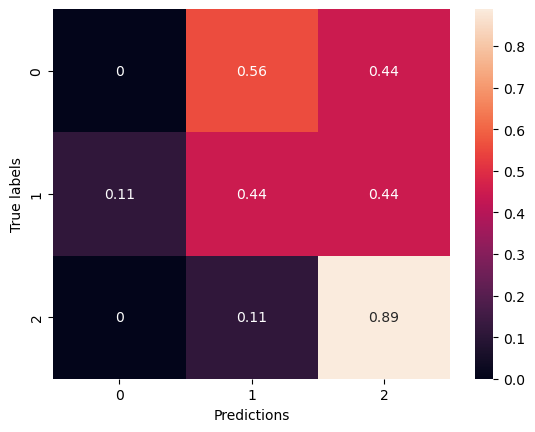

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▄▄▄▄▅▅▆▅▆▆▇▇▆▇▇▇▇███████████████████
training_loss,█▇▇▇▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▂▃▂▃▃▄▇▇▄▅██▇█▇█▇▄█▆█▄▇█▇▇▇▇█▇▆█▇███
val_loss,██▇▇▆▆▆▅▅▅▃▂▅▃▂▂▂▂▃▂▃▄▃▃▃▆▃▃▂▂▃▃▂▃▃▂▂▃▁▁


Epoch 1/100


2024-03-12 16:23:45.155303: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:23:45.157346: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:23:45.158880: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:23:46.761648: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:23:46.763844: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:23:46.765676: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:23:51.921114: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:23:52.498382: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 30.5404 - accuracy: 0.3447

2024-03-12 16:23:55.506828: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:23:55.508386: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:23:55.510696: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 624ms/step - loss: 30.5404 - accuracy: 0.3447 - val_loss: 28.7488 - val_accuracy: 0.3796
Epoch 2/100
4/4 [==============================] - 0s 123ms/step - loss: 28.5753 - accuracy: 0.4132 - val_loss: 27.2337 - val_accuracy: 0.2870
Epoch 3/100
4/4 [==============================] - 0s 122ms/step - loss: 26.9145 - accuracy: 0.4977 - val_loss: 25.7832 - val_accuracy: 0.1852
Epoch 4/100
4/4 [==============================] - 0s 123ms/step - loss: 25.4552 - accuracy: 0.4338 - val_loss: 24.4015 - val_accuracy: 0.1574
Epoch 5/100
4/4 [==============================] - 0s 121ms/step - loss: 23.9199 - accuracy: 0.5000 - val_loss: 23.0852 - val_accuracy: 0.1481
Epoch 6/100
4/4 [==============================] - 0s 122ms/step - loss: 22.6324 - accuracy: 0.5046 - val_loss: 21.8350 - val_accuracy: 0.1389
Epoch 7/100
4/4 [==============================] - 0s 123ms/step - loss: 21.3216 - accuracy: 0.5183 - val_loss: 20.6430 - val_accuracy: 0.1759
Epoch 8/10

4/4 [==============================] - 0s 124ms/step - loss: 1.8399 - accuracy: 0.9384 - val_loss: 4.7639 - val_accuracy: 0.4167
Epoch 59/100
4/4 [==============================] - 0s 120ms/step - loss: 1.8001 - accuracy: 0.9475 - val_loss: 4.9162 - val_accuracy: 0.4074
Epoch 60/100
4/4 [==============================] - 0s 121ms/step - loss: 1.6765 - accuracy: 0.9543 - val_loss: 4.5622 - val_accuracy: 0.4722
Epoch 61/100
4/4 [==============================] - 0s 121ms/step - loss: 1.6404 - accuracy: 0.9612 - val_loss: 4.0349 - val_accuracy: 0.5278
Epoch 62/100
4/4 [==============================] - 0s 123ms/step - loss: 1.6150 - accuracy: 0.9498 - val_loss: 3.7791 - val_accuracy: 0.5833
Epoch 63/100
4/4 [==============================] - 0s 121ms/step - loss: 1.6094 - accuracy: 0.9384 - val_loss: 4.0999 - val_accuracy: 0.4630
Epoch 64/100
4/4 [==============================] - 0s 123ms/step - loss: 1.5759 - accuracy: 0.9543 - val_loss: 4.0154 - val_accuracy: 0.5000
Epoch 65/100
4/4 [=

2024-03-12 16:24:45.796199: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:24:45.798334: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:24:45.799942: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.460517168045044 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, '2': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.4211344211344212, 'recall': 0.4444444444444445, 'f1-score': 0.4070707070707071, 'support': 27}, 'weighted avg': {'precision': 0.4211344211344211, 'recall': 0.4444444444444444, 'f1-score': 0.40707070707070714, 'support': 27}}


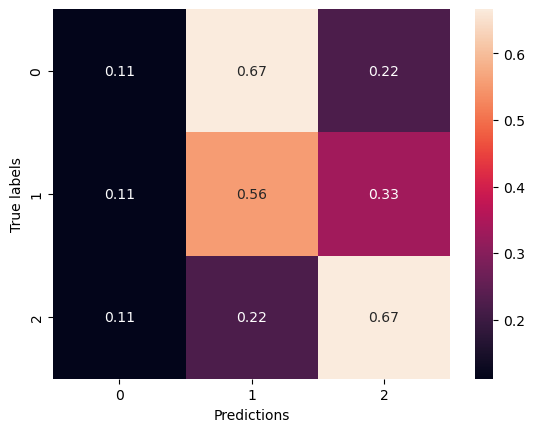

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▃▃▄▄▄▅▅▆▆▆▆▆▇▇▇▇▇▇██████▇▇████████████
training_loss,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▂▁▂▂▂▃▂▃▄▅▆▇▇▆▅▇▇▅▅▆▅▅▅▇▇▅▅▅▆▇▇▆▆▅▅▅██▆
val_loss,█▇▆▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▁▁▁


Epoch 1/100


2024-03-12 16:25:09.925038: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:25:09.926806: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:25:09.928680: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:25:11.525229: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:25:11.527799: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:25:11.529506: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:25:15.657073: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:25:16.234157: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 41.8512 - accuracy: 0.3493

2024-03-12 16:25:19.247564: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:25:19.249196: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:25:19.251634: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 900ms/step - loss: 41.8512 - accuracy: 0.3493 - val_loss: 39.5378 - val_accuracy: 0.2130
Epoch 2/100
4/4 [==============================] - 1s 128ms/step - loss: 39.0628 - accuracy: 0.3904 - val_loss: 37.0355 - val_accuracy: 0.2222
Epoch 3/100
4/4 [==============================] - 0s 123ms/step - loss: 36.5112 - accuracy: 0.4132 - val_loss: 34.6487 - val_accuracy: 0.2593
Epoch 4/100
4/4 [==============================] - 1s 127ms/step - loss: 34.0492 - accuracy: 0.4749 - val_loss: 32.4110 - val_accuracy: 0.2593
Epoch 5/100
4/4 [==============================] - 1s 127ms/step - loss: 31.7267 - accuracy: 0.5205 - val_loss: 30.2882 - val_accuracy: 0.2593
Epoch 6/100
4/4 [==============================] - 0s 124ms/step - loss: 29.5923 - accuracy: 0.5320 - val_loss: 28.2844 - val_accuracy: 0.2685
Epoch 7/100
4/4 [==============================] - 1s 126ms/step - loss: 27.6236 - accuracy: 0.5525 - val_loss: 26.4059 - val_accuracy: 0.2870
Epoch 8/10

4/4 [==============================] - 0s 124ms/step - loss: 1.7304 - accuracy: 0.9406 - val_loss: 4.3473 - val_accuracy: 0.4444
Epoch 59/100
4/4 [==============================] - 0s 125ms/step - loss: 1.6445 - accuracy: 0.9566 - val_loss: 4.0062 - val_accuracy: 0.4722
Epoch 60/100
4/4 [==============================] - 0s 124ms/step - loss: 1.6933 - accuracy: 0.9338 - val_loss: 3.7265 - val_accuracy: 0.5093
Epoch 61/100
4/4 [==============================] - 0s 124ms/step - loss: 1.5910 - accuracy: 0.9406 - val_loss: 3.3322 - val_accuracy: 0.6296
Epoch 62/100
4/4 [==============================] - 0s 125ms/step - loss: 1.6291 - accuracy: 0.9406 - val_loss: 3.5017 - val_accuracy: 0.5370
Epoch 63/100
4/4 [==============================] - 1s 126ms/step - loss: 1.5416 - accuracy: 0.9269 - val_loss: 4.4009 - val_accuracy: 0.4537
Epoch 64/100
4/4 [==============================] - 0s 125ms/step - loss: 1.4846 - accuracy: 0.9589 - val_loss: 4.0663 - val_accuracy: 0.5093
Epoch 65/100
4/4 [=

2024-03-12 16:26:10.985615: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:26:10.987300: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:26:10.989213: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4677939414978027 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.5625, 'recall': 1.0, 'f1-score': 0.72, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5393518518518519, 'recall': 0.5555555555555556, 'f1-score': 0.4857912457912457, 'support': 27}, 'weighted avg': {'precision': 0.5393518518518519, 'recall': 0.5555555555555556, 'f1-score': 0.48579124579124583, 'support': 27}}


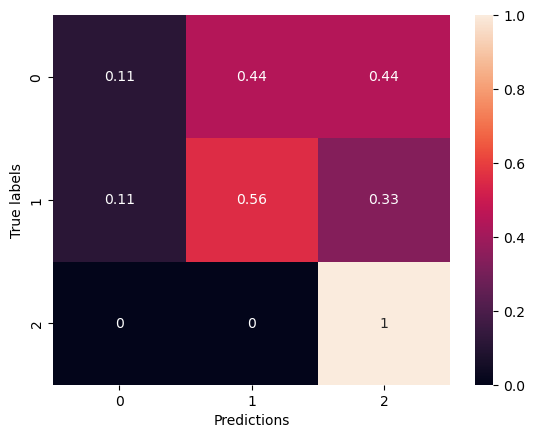

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▄▅▅▅▆▆▆▆▆▇▇▇█▇█▇████████████▇██████
training_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▂▃▃▃▃▄▅▄▅▆▆▇▇█▇▇▆▄▆▅▃▅█▆▇▇▆▅▅▄▇▆▇▅▅▆▅▇
val_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:26:33.653639: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:26:33.656249: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:26:33.658675: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:26:35.276321: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:26:35.278129: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:26:35.280168: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:26:39.425814: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:26:40.005475: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 7.5642 - accuracy: 0.3174

2024-03-12 16:26:43.027566: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:26:43.029221: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:26:43.031120: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 631ms/step - loss: 7.5642 - accuracy: 0.3174 - val_loss: 6.9267 - val_accuracy: 0.1296
Epoch 2/100
4/4 [==============================] - 0s 125ms/step - loss: 7.3230 - accuracy: 0.3379 - val_loss: 6.8476 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 0s 122ms/step - loss: 7.0930 - accuracy: 0.3311 - val_loss: 6.7388 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 0s 125ms/step - loss: 6.8544 - accuracy: 0.3607 - val_loss: 6.6313 - val_accuracy: 0.1296
Epoch 5/100
4/4 [==============================] - 0s 124ms/step - loss: 6.7817 - accuracy: 0.3927 - val_loss: 6.5199 - val_accuracy: 0.1389
Epoch 6/100
4/4 [==============================] - 0s 123ms/step - loss: 6.6938 - accuracy: 0.3676 - val_loss: 6.4122 - val_accuracy: 0.1389
Epoch 7/100
4/4 [==============================] - 1s 134ms/step - loss: 6.5886 - accuracy: 0.3927 - val_loss: 6.3237 - val_accuracy: 0.1481
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 0s 125ms/step - loss: 2.7624 - accuracy: 0.7466 - val_loss: 4.5788 - val_accuracy: 0.3889
Epoch 60/100
4/4 [==============================] - 1s 126ms/step - loss: 2.7157 - accuracy: 0.7374 - val_loss: 4.9104 - val_accuracy: 0.3796
Epoch 61/100
4/4 [==============================] - 0s 126ms/step - loss: 2.6182 - accuracy: 0.7580 - val_loss: 5.3041 - val_accuracy: 0.3611
Epoch 62/100
4/4 [==============================] - 0s 125ms/step - loss: 2.6098 - accuracy: 0.7420 - val_loss: 4.2528 - val_accuracy: 0.4537
Epoch 63/100
4/4 [==============================] - 0s 123ms/step - loss: 2.4885 - accuracy: 0.8082 - val_loss: 3.9038 - val_accuracy: 0.4722
Epoch 64/100
4/4 [==============================] - 0s 122ms/step - loss: 2.5265 - accuracy: 0.7534 - val_loss: 5.1480 - val_accuracy: 0.3611
Epoch 65/100
4/4 [==============================] - 0s 124ms/step - loss: 2.4769 - accuracy: 0.7808 - val_loss: 4.2685 - val_accuracy: 0.4444
Epoch 

2024-03-12 16:27:33.436205: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:27:33.438419: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:27:33.440128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4618849754333496 s
{'0': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.5, 'recall': 0.4814814814814814, 'f1-score': 0.47368421052631576, 'support': 27}, 'weighted avg': {'precision': 0.5, 'recall': 0.48148148148148145, 'f1-score': 0.4736842105263158, 'support': 27}}


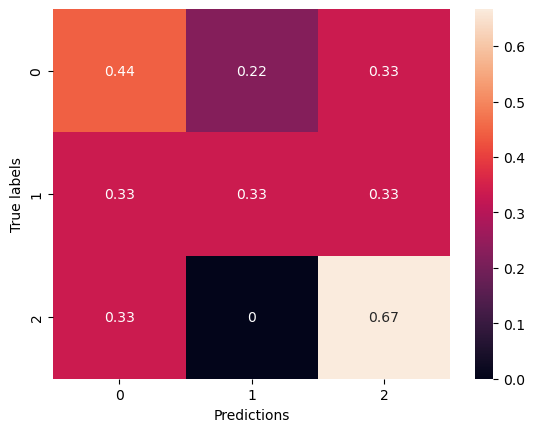

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇████
training_loss,█▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▃▃▅▄▄▆▆▅█▆▇▆▇▇▇▇▇▇▆
val_loss,██▇▇▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▄▄▇▃▅▅▂▂▄▁▃▁▂▁▂▁▁▁▁▃


Epoch 1/100


2024-03-12 16:31:26.293288: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:31:26.295427: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:31:26.296991: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:31:27.974947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:31:27.976957: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:31:27.979453: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:31:33.135001: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:31:33.718408: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 30.4969 - accuracy: 0.3447

2024-03-12 16:31:36.780289: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:31:36.782080: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:31:36.784012: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 637ms/step - loss: 30.4969 - accuracy: 0.3447 - val_loss: 28.7535 - val_accuracy: 0.4259
Epoch 2/100
4/4 [==============================] - 0s 126ms/step - loss: 28.9023 - accuracy: 0.3516 - val_loss: 27.3910 - val_accuracy: 0.2407
Epoch 3/100
4/4 [==============================] - 0s 125ms/step - loss: 27.3894 - accuracy: 0.3584 - val_loss: 26.0647 - val_accuracy: 0.1574
Epoch 4/100
4/4 [==============================] - 0s 124ms/step - loss: 26.0116 - accuracy: 0.4041 - val_loss: 24.7850 - val_accuracy: 0.1667
Epoch 5/100
4/4 [==============================] - 0s 124ms/step - loss: 24.7324 - accuracy: 0.3447 - val_loss: 23.5676 - val_accuracy: 0.1667
Epoch 6/100
4/4 [==============================] - 0s 124ms/step - loss: 23.4055 - accuracy: 0.3881 - val_loss: 22.4192 - val_accuracy: 0.1759
Epoch 7/100
4/4 [==============================] - 0s 125ms/step - loss: 22.2047 - accuracy: 0.3676 - val_loss: 21.3280 - val_accuracy: 0.1574
Epoch 8/10

4/4 [==============================] - 0s 123ms/step - loss: 2.4620 - accuracy: 0.7877 - val_loss: 3.2700 - val_accuracy: 0.6111
Epoch 59/100
4/4 [==============================] - 0s 123ms/step - loss: 2.3715 - accuracy: 0.8333 - val_loss: 3.2463 - val_accuracy: 0.6296
Epoch 60/100
4/4 [==============================] - 0s 122ms/step - loss: 2.3037 - accuracy: 0.7991 - val_loss: 3.3124 - val_accuracy: 0.6481
Epoch 61/100
4/4 [==============================] - 0s 121ms/step - loss: 2.2482 - accuracy: 0.8196 - val_loss: 3.3454 - val_accuracy: 0.6111
Epoch 62/100
4/4 [==============================] - 0s 122ms/step - loss: 2.1488 - accuracy: 0.8288 - val_loss: 3.2921 - val_accuracy: 0.6481
Epoch 63/100
4/4 [==============================] - 0s 124ms/step - loss: 2.1463 - accuracy: 0.8333 - val_loss: 3.3221 - val_accuracy: 0.6574
Epoch 64/100
4/4 [==============================] - 0s 124ms/step - loss: 2.0378 - accuracy: 0.8379 - val_loss: 3.4029 - val_accuracy: 0.6481
Epoch 65/100
4/4 [=

2024-03-12 16:32:27.703303: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:32:27.704958: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:32:27.706898: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4824142456054688 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.8333333333333334, 'recall': 0.5555555555555556, 'f1-score': 0.6666666666666667, 'support': 9}, '2': {'precision': 0.45, 'recall': 1.0, 'f1-score': 0.6206896551724138, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.4277777777777778, 'recall': 0.5185185185185185, 'f1-score': 0.4291187739463602, 'support': 27}, 'weighted avg': {'precision': 0.4277777777777778, 'recall': 0.5185185185185185, 'f1-score': 0.4291187739463602, 'support': 27}}


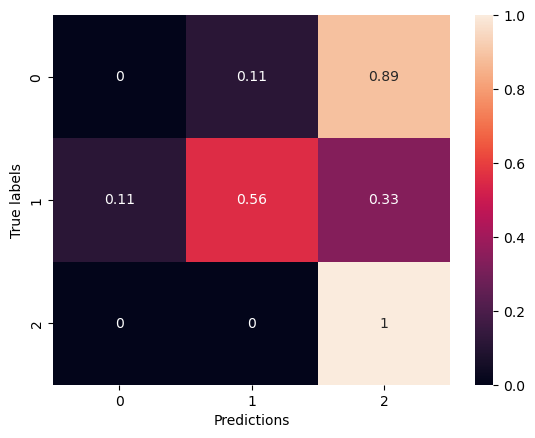

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▁▂▂▂▂▃▃▃▃▄▄▄▅▅▅▅▅▅▆▆▆▇▆▇▇▇▇▇▇▇▇▇██████
training_loss,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▁▁▁▁▁▁▁▁▁▂▃▃▆▅▆▅▇▆▇█▇▇█▇██▇▆▇▇█▇▇▇█▇▇▆█
val_loss,█▇▆▆▅▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:32:50.278828: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:32:50.280494: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:32:50.282484: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:32:51.909619: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:32:51.911561: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:32:51.913475: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:32:56.088079: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:32:56.682789: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 42.1406 - accuracy: 0.3242

2024-03-12 16:33:00.030851: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:33:00.034500: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:33:00.036515: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 640ms/step - loss: 42.1406 - accuracy: 0.3242 - val_loss: 39.6936 - val_accuracy: 0.3889
Epoch 2/100
4/4 [==============================] - 0s 123ms/step - loss: 39.5811 - accuracy: 0.3196 - val_loss: 37.4043 - val_accuracy: 0.2037
Epoch 3/100
4/4 [==============================] - 0s 123ms/step - loss: 37.1053 - accuracy: 0.3447 - val_loss: 35.2365 - val_accuracy: 0.1852
Epoch 4/100
4/4 [==============================] - 0s 123ms/step - loss: 34.8227 - accuracy: 0.3950 - val_loss: 33.1561 - val_accuracy: 0.1667
Epoch 5/100
4/4 [==============================] - 0s 123ms/step - loss: 32.7806 - accuracy: 0.3858 - val_loss: 31.1705 - val_accuracy: 0.1759
Epoch 6/100
4/4 [==============================] - 0s 120ms/step - loss: 30.7481 - accuracy: 0.3904 - val_loss: 29.2940 - val_accuracy: 0.1852
Epoch 7/100
4/4 [==============================] - 0s 124ms/step - loss: 28.9715 - accuracy: 0.3950 - val_loss: 27.5324 - val_accuracy: 0.2037
Epoch 8/10

4/4 [==============================] - 0s 125ms/step - loss: 2.2983 - accuracy: 0.8333 - val_loss: 3.6038 - val_accuracy: 0.6111
Epoch 59/100
4/4 [==============================] - 0s 123ms/step - loss: 2.2089 - accuracy: 0.8516 - val_loss: 3.5275 - val_accuracy: 0.6019
Epoch 60/100
4/4 [==============================] - 0s 124ms/step - loss: 2.1371 - accuracy: 0.8288 - val_loss: 3.7720 - val_accuracy: 0.5370
Epoch 61/100
4/4 [==============================] - 0s 124ms/step - loss: 2.0564 - accuracy: 0.8676 - val_loss: 3.9023 - val_accuracy: 0.5185
Epoch 62/100
4/4 [==============================] - 0s 123ms/step - loss: 2.0189 - accuracy: 0.8630 - val_loss: 4.0141 - val_accuracy: 0.5000
Epoch 63/100
4/4 [==============================] - 0s 124ms/step - loss: 1.9828 - accuracy: 0.8447 - val_loss: 4.2739 - val_accuracy: 0.4630
Epoch 64/100
4/4 [==============================] - 0s 124ms/step - loss: 1.9352 - accuracy: 0.8607 - val_loss: 3.4412 - val_accuracy: 0.6389
Epoch 65/100
4/4 [=

2024-03-12 16:33:51.394534: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:33:51.396219: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:33:51.398204: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 2.5694220066070557 s
{'0': {'precision': 0.375, 'recall': 0.3333333333333333, 'f1-score': 0.35294117647058826, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.6666666666666666, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.5694444444444444, 'recall': 0.3703703703703704, 'f1-score': 0.33246187363834423, 'support': 27}, 'weighted avg': {'precision': 0.5694444444444444, 'recall': 0.37037037037037035, 'f1-score': 0.33246187363834423, 'support': 27}}


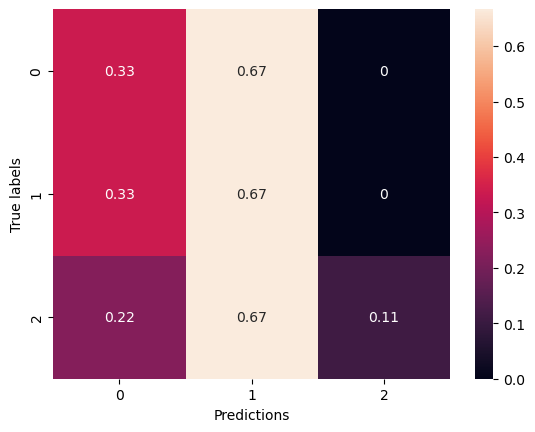

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▂▃▂▃▃▄▄▄▄▅▅▅▆▆▆▆▇▆▇▇▇▇▇█▇▇█████████
training_loss,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▁▁▂▂▁▁▁▂▃▃▅▆▅▆▆▅▇▇▅▅▆▇▆▇▇▅▅▇▇▇▆▇▆█▆▆▆▃
val_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:34:13.655308: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:34:13.656886: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:34:13.658572: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:34:15.274943: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:34:15.277399: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:34:15.279267: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:34:19.411093: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:34:19.992120: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 7.9999 - accuracy: 0.3744

2024-03-12 16:34:23.358986: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:34:23.361347: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:34:23.363301: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 708ms/step - loss: 7.9999 - accuracy: 0.3744 - val_loss: 7.4992 - val_accuracy: 0.2963
Epoch 2/100
4/4 [==============================] - 1s 190ms/step - loss: 7.3937 - accuracy: 0.5616 - val_loss: 7.3719 - val_accuracy: 0.2037
Epoch 3/100
4/4 [==============================] - 1s 186ms/step - loss: 7.0511 - accuracy: 0.6575 - val_loss: 7.2729 - val_accuracy: 0.1667
Epoch 4/100
4/4 [==============================] - 1s 202ms/step - loss: 6.8310 - accuracy: 0.6667 - val_loss: 7.1516 - val_accuracy: 0.1667
Epoch 5/100
4/4 [==============================] - 1s 184ms/step - loss: 6.5653 - accuracy: 0.7055 - val_loss: 6.9754 - val_accuracy: 0.1759
Epoch 6/100
4/4 [==============================] - 1s 185ms/step - loss: 6.3903 - accuracy: 0.7032 - val_loss: 6.8457 - val_accuracy: 0.2037
Epoch 7/100
4/4 [==============================] - 1s 184ms/step - loss: 6.0039 - accuracy: 0.7808 - val_loss: 6.7203 - val_accuracy: 0.2130
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 187ms/step - loss: 1.3074 - accuracy: 0.9954 - val_loss: 4.7830 - val_accuracy: 0.4815
Epoch 60/100
4/4 [==============================] - 1s 181ms/step - loss: 1.3317 - accuracy: 0.9749 - val_loss: 4.9116 - val_accuracy: 0.4907
Epoch 61/100
4/4 [==============================] - 1s 195ms/step - loss: 1.2739 - accuracy: 0.9863 - val_loss: 4.8568 - val_accuracy: 0.4630
Epoch 62/100
4/4 [==============================] - 1s 185ms/step - loss: 1.2471 - accuracy: 0.9863 - val_loss: 4.7655 - val_accuracy: 0.4444
Epoch 63/100
4/4 [==============================] - 1s 185ms/step - loss: 1.2296 - accuracy: 0.9886 - val_loss: 5.0130 - val_accuracy: 0.4815
Epoch 64/100
4/4 [==============================] - 1s 185ms/step - loss: 1.2029 - accuracy: 0.9863 - val_loss: 5.0410 - val_accuracy: 0.4815
Epoch 65/100
4/4 [==============================] - 1s 187ms/step - loss: 1.1756 - accuracy: 0.9977 - val_loss: 5.4030 - val_accuracy: 0.4630
Epoch 

2024-03-12 16:35:39.823445: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:35:39.825373: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:35:39.827312: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4769208431243896 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '2': {'precision': 0.3888888888888889, 'recall': 0.7777777777777778, 'f1-score': 0.5185185185185185, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.42962962962962964, 'recall': 0.40740740740740744, 'f1-score': 0.3706417039750372, 'support': 27}, 'weighted avg': {'precision': 0.42962962962962964, 'recall': 0.4074074074074074, 'f1-score': 0.37064170397503726, 'support': 27}}


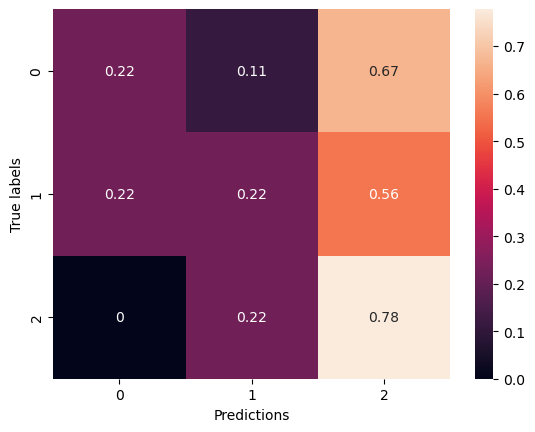

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇▇████████████████████████████████
training_loss,█▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▂▂▃▃▆▆▆▇▇▆█▇▆▆▅▆▅▆▇▆▇▆▆▆▆▇▇▇▇▆▆▆█▇▇███
val_loss,██▇▆▆▅▄▄▃▃▃▃▂▃▃▃▄▃▄▃▃▃▂▃▃▃▅▂▂▂▂▃▃▃▂▃▂▃▁▁


Epoch 1/100


2024-03-12 16:36:04.321500: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:36:04.323248: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:36:04.325317: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:36:05.939092: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:36:05.941161: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:36:05.943204: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:36:10.984723: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:36:11.564052: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 33.4413 - accuracy: 0.3858

2024-03-12 16:36:14.863650: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:36:14.865814: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:36:14.867705: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 696ms/step - loss: 33.4413 - accuracy: 0.3858 - val_loss: 31.6593 - val_accuracy: 0.1574
Epoch 2/100
4/4 [==============================] - 1s 186ms/step - loss: 30.8907 - accuracy: 0.4772 - val_loss: 29.5391 - val_accuracy: 0.1389
Epoch 3/100
4/4 [==============================] - 1s 182ms/step - loss: 28.4005 - accuracy: 0.6438 - val_loss: 27.5083 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 184ms/step - loss: 26.2075 - accuracy: 0.6781 - val_loss: 25.5755 - val_accuracy: 0.1111
Epoch 5/100
4/4 [==============================] - 1s 185ms/step - loss: 24.1731 - accuracy: 0.7100 - val_loss: 23.7965 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 1s 187ms/step - loss: 22.2982 - accuracy: 0.7260 - val_loss: 22.1159 - val_accuracy: 0.1574
Epoch 7/100
4/4 [==============================] - 1s 184ms/step - loss: 20.4377 - accuracy: 0.7626 - val_loss: 20.5680 - val_accuracy: 0.1389
Epoch 8/10

4/4 [==============================] - 1s 188ms/step - loss: 1.2212 - accuracy: 0.9795 - val_loss: 3.7672 - val_accuracy: 0.6296
Epoch 59/100
4/4 [==============================] - 1s 186ms/step - loss: 1.2288 - accuracy: 0.9703 - val_loss: 3.6829 - val_accuracy: 0.6204
Epoch 60/100
4/4 [==============================] - 1s 180ms/step - loss: 1.2196 - accuracy: 0.9658 - val_loss: 3.5895 - val_accuracy: 0.5741
Epoch 61/100
4/4 [==============================] - 1s 184ms/step - loss: 1.1927 - accuracy: 0.9680 - val_loss: 4.2312 - val_accuracy: 0.4444
Epoch 62/100
4/4 [==============================] - 1s 183ms/step - loss: 1.1337 - accuracy: 0.9726 - val_loss: 5.3908 - val_accuracy: 0.3333
Epoch 63/100
4/4 [==============================] - 1s 210ms/step - loss: 1.1687 - accuracy: 0.9635 - val_loss: 4.7694 - val_accuracy: 0.3796
Epoch 64/100
4/4 [==============================] - 1s 185ms/step - loss: 1.1509 - accuracy: 0.9703 - val_loss: 4.2053 - val_accuracy: 0.4444
Epoch 65/100
4/4 [=

2024-03-12 16:37:31.310195: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:37:31.312382: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:37:31.313921: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4730792045593262 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, '2': {'precision': 0.6363636363636364, 'recall': 0.7777777777777778, 'f1-score': 0.7000000000000001, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5881895881895881, 'recall': 0.5555555555555555, 'f1-score': 0.5262626262626263, 'support': 27}, 'weighted avg': {'precision': 0.5881895881895881, 'recall': 0.5555555555555556, 'f1-score': 0.5262626262626263, 'support': 27}}


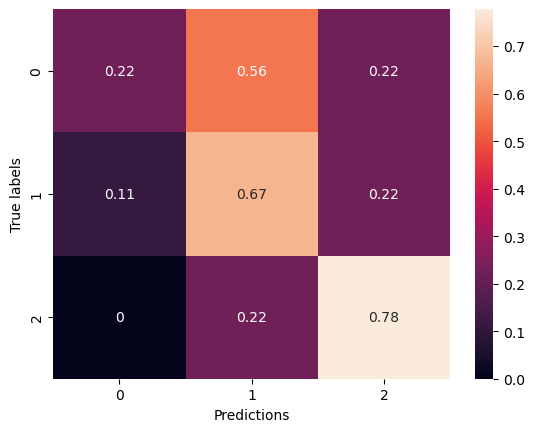

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▅▆▇▇▇██▇▇█▇███▇████████████████▇█████
training_loss,█▇▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▂▃▃▅▅▅▆▅▅▇▅▆▆▇▆▇███▅▅▇▇▇▇▄▄▄▇▅▅▆▆▆▆
val_loss,█▇▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:37:56.821015: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:37:56.823204: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:37:56.825234: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:37:58.487633: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:37:58.489744: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:37:58.491816: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:38:02.688244: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:38:03.268621: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 46.4655 - accuracy: 0.3493

2024-03-12 16:38:06.524252: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:38:06.526460: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:38:06.528041: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 687ms/step - loss: 46.4655 - accuracy: 0.3493 - val_loss: 43.5203 - val_accuracy: 0.1759
Epoch 2/100
4/4 [==============================] - 1s 188ms/step - loss: 42.3808 - accuracy: 0.5479 - val_loss: 40.1506 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 188ms/step - loss: 38.8378 - accuracy: 0.5479 - val_loss: 36.9238 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 182ms/step - loss: 35.5552 - accuracy: 0.6050 - val_loss: 33.8966 - val_accuracy: 0.1389
Epoch 5/100
4/4 [==============================] - 1s 183ms/step - loss: 32.4590 - accuracy: 0.6461 - val_loss: 31.0348 - val_accuracy: 0.1852
Epoch 6/100
4/4 [==============================] - 1s 187ms/step - loss: 29.5456 - accuracy: 0.6826 - val_loss: 28.4083 - val_accuracy: 0.1759
Epoch 7/100
4/4 [==============================] - 1s 186ms/step - loss: 26.9058 - accuracy: 0.7283 - val_loss: 26.0479 - val_accuracy: 0.1759
Epoch 8/10

4/4 [==============================] - 1s 196ms/step - loss: 1.2888 - accuracy: 0.9658 - val_loss: 3.3247 - val_accuracy: 0.6296
Epoch 59/100
4/4 [==============================] - 1s 193ms/step - loss: 1.2573 - accuracy: 0.9795 - val_loss: 3.4244 - val_accuracy: 0.6296
Epoch 60/100
4/4 [==============================] - 1s 185ms/step - loss: 1.2950 - accuracy: 0.9658 - val_loss: 3.5241 - val_accuracy: 0.6111
Epoch 61/100
4/4 [==============================] - 1s 187ms/step - loss: 1.2448 - accuracy: 0.9589 - val_loss: 3.5916 - val_accuracy: 0.6019
Epoch 62/100
4/4 [==============================] - 1s 189ms/step - loss: 1.1743 - accuracy: 0.9795 - val_loss: 4.0601 - val_accuracy: 0.5093
Epoch 63/100
4/4 [==============================] - 1s 189ms/step - loss: 1.1259 - accuracy: 0.9909 - val_loss: 4.0047 - val_accuracy: 0.4907
Epoch 64/100
4/4 [==============================] - 1s 186ms/step - loss: 1.1041 - accuracy: 0.9772 - val_loss: 4.0533 - val_accuracy: 0.5278
Epoch 65/100
4/4 [=

2024-03-12 16:39:23.520083: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:39:23.521921: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:39:23.523836: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.4229609966278076 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.8333333333333334, 'recall': 0.5555555555555556, 'f1-score': 0.6666666666666667, 'support': 9}, '2': {'precision': 0.47368421052631576, 'recall': 1.0, 'f1-score': 0.6428571428571429, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6023391812865497, 'recall': 0.5555555555555556, 'f1-score': 0.4971139971139971, 'support': 27}, 'weighted avg': {'precision': 0.6023391812865497, 'recall': 0.5555555555555556, 'f1-score': 0.4971139971139972, 'support': 27}}


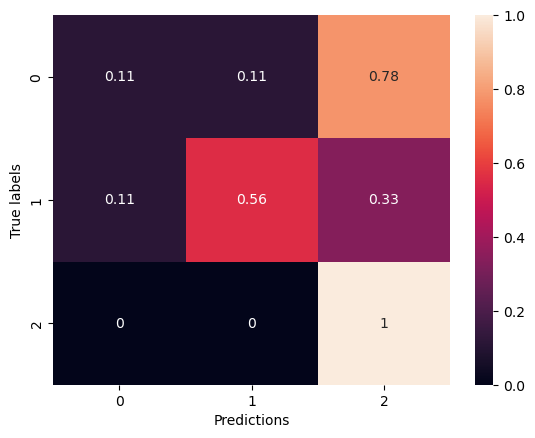

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▆▆▇▇▇███▇█▇███████████████▇█████████
training_loss,█▇▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▂▃▂▅▅▆▅█▄▆▅▇█▆▆▅▆▇████▇▆▇▅▇▆▅▇▇▇▇▇▆▇▇
val_loss,█▇▅▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:39:49.160949: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:39:49.163435: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:39:49.165347: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:39:50.842490: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:39:50.844809: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:39:50.846876: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:39:55.163079: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:39:55.742687: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 8.0906 - accuracy: 0.3767

2024-03-12 16:39:59.010488: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:39:59.012896: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:39:59.014657: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 697ms/step - loss: 8.0906 - accuracy: 0.3767 - val_loss: 7.5407 - val_accuracy: 0.2407
Epoch 2/100
4/4 [==============================] - 1s 183ms/step - loss: 7.7215 - accuracy: 0.4429 - val_loss: 7.4733 - val_accuracy: 0.1574
Epoch 3/100
4/4 [==============================] - 1s 202ms/step - loss: 7.4458 - accuracy: 0.4680 - val_loss: 7.3825 - val_accuracy: 0.1481
Epoch 4/100
4/4 [==============================] - 1s 185ms/step - loss: 7.2686 - accuracy: 0.4932 - val_loss: 7.3015 - val_accuracy: 0.1481
Epoch 5/100
4/4 [==============================] - 1s 186ms/step - loss: 6.9278 - accuracy: 0.5845 - val_loss: 7.2155 - val_accuracy: 0.1481
Epoch 6/100
4/4 [==============================] - 1s 185ms/step - loss: 6.8212 - accuracy: 0.5548 - val_loss: 7.1081 - val_accuracy: 0.1574
Epoch 7/100
4/4 [==============================] - 1s 191ms/step - loss: 6.7217 - accuracy: 0.5616 - val_loss: 7.0556 - val_accuracy: 0.1574
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 184ms/step - loss: 1.7847 - accuracy: 0.9795 - val_loss: 5.4237 - val_accuracy: 0.5463
Epoch 60/100
4/4 [==============================] - 1s 186ms/step - loss: 1.7356 - accuracy: 0.9886 - val_loss: 5.5459 - val_accuracy: 0.4907
Epoch 61/100
4/4 [==============================] - 1s 186ms/step - loss: 1.6821 - accuracy: 0.9932 - val_loss: 5.6484 - val_accuracy: 0.5000
Epoch 62/100
4/4 [==============================] - 1s 183ms/step - loss: 1.6573 - accuracy: 0.9840 - val_loss: 5.7572 - val_accuracy: 0.4537
Epoch 63/100
4/4 [==============================] - 1s 199ms/step - loss: 1.6673 - accuracy: 0.9703 - val_loss: 5.7032 - val_accuracy: 0.4630
Epoch 64/100
4/4 [==============================] - 1s 184ms/step - loss: 1.6289 - accuracy: 0.9772 - val_loss: 5.5549 - val_accuracy: 0.5648
Epoch 65/100
4/4 [==============================] - 1s 190ms/step - loss: 1.5545 - accuracy: 0.9909 - val_loss: 5.5841 - val_accuracy: 0.5833
Epoch 

2024-03-12 16:41:15.311764: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:41:15.314082: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:41:15.315785: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.481003999710083 s
{'0': {'precision': 0.25, 'recall': 0.1111111111111111, 'f1-score': 0.15384615384615383, 'support': 9}, '1': {'precision': 0.36363636363636365, 'recall': 0.4444444444444444, 'f1-score': 0.39999999999999997, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.37121212121212127, 'recall': 0.40740740740740744, 'f1-score': 0.3750915750915751, 'support': 27}, 'weighted avg': {'precision': 0.3712121212121212, 'recall': 0.4074074074074074, 'f1-score': 0.3750915750915751, 'support': 27}}


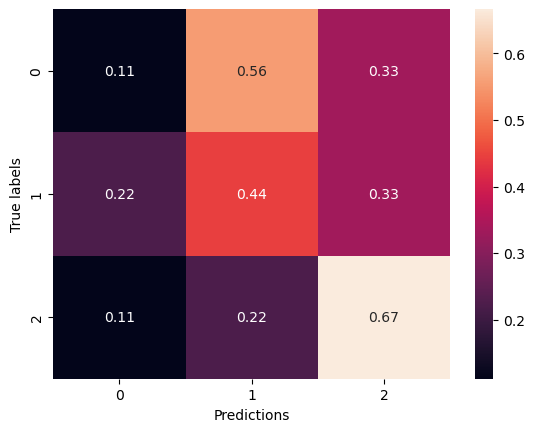

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▅▆▅▆▆▆▆▇▇▇▇▇███████████████████████
training_loss,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▁▁▂▁▁▁▂▂▃▅▆▇▇▇█▇█▇███▇███▅█▆▇▇█▇▆▇▆██
val_loss,██▇▇▇▅▅▆▇▆▅▅▂▂▁▂▂▂▂▂▂▃▃▃▃▃▂▂▃▁▃▃▂▂▂▃▁▃▁▁


Epoch 1/100


2024-03-12 16:41:37.979159: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:41:37.981405: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:41:37.983029: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:41:39.607622: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:41:39.610446: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:41:39.612421: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:41:44.675079: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:41:45.257298: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 33.6402 - accuracy: 0.3539

2024-03-12 16:41:48.658465: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:41:48.661033: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:41:48.662648: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 709ms/step - loss: 33.6402 - accuracy: 0.3539 - val_loss: 31.6367 - val_accuracy: 0.2500
Epoch 2/100
4/4 [==============================] - 1s 189ms/step - loss: 31.0743 - accuracy: 0.4909 - val_loss: 29.6499 - val_accuracy: 0.1852
Epoch 3/100
4/4 [==============================] - 1s 185ms/step - loss: 28.9572 - accuracy: 0.5137 - val_loss: 27.7072 - val_accuracy: 0.1759
Epoch 4/100
4/4 [==============================] - 1s 189ms/step - loss: 26.9258 - accuracy: 0.5708 - val_loss: 25.8117 - val_accuracy: 0.2315
Epoch 5/100
4/4 [==============================] - 1s 187ms/step - loss: 25.1022 - accuracy: 0.5502 - val_loss: 24.0475 - val_accuracy: 0.2315
Epoch 6/100
4/4 [==============================] - 1s 182ms/step - loss: 23.2752 - accuracy: 0.5890 - val_loss: 22.4027 - val_accuracy: 0.2407
Epoch 7/100
4/4 [==============================] - 1s 186ms/step - loss: 21.5193 - accuracy: 0.6438 - val_loss: 20.8370 - val_accuracy: 0.2500
Epoch 8/10

4/4 [==============================] - 1s 184ms/step - loss: 1.4891 - accuracy: 0.9452 - val_loss: 4.1754 - val_accuracy: 0.4815
Epoch 59/100
4/4 [==============================] - 1s 184ms/step - loss: 1.4155 - accuracy: 0.9658 - val_loss: 4.0802 - val_accuracy: 0.5093
Epoch 60/100
4/4 [==============================] - 1s 185ms/step - loss: 1.3802 - accuracy: 0.9635 - val_loss: 3.6703 - val_accuracy: 0.5278
Epoch 61/100
4/4 [==============================] - 1s 187ms/step - loss: 1.3279 - accuracy: 0.9680 - val_loss: 3.7218 - val_accuracy: 0.5093
Epoch 62/100
4/4 [==============================] - 1s 205ms/step - loss: 1.3241 - accuracy: 0.9635 - val_loss: 3.4946 - val_accuracy: 0.5370
Epoch 63/100
4/4 [==============================] - 1s 183ms/step - loss: 1.2903 - accuracy: 0.9726 - val_loss: 3.3215 - val_accuracy: 0.5741
Epoch 64/100
4/4 [==============================] - 1s 185ms/step - loss: 1.2686 - accuracy: 0.9589 - val_loss: 3.6233 - val_accuracy: 0.5648
Epoch 65/100
4/4 [=

2024-03-12 16:43:04.841459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:43:04.843488: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:43:04.845030: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4959068298339844 s
{'0': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.7222222222222222, 'recall': 0.5925925925925926, 'f1-score': 0.5567676767676768, 'support': 27}, 'weighted avg': {'precision': 0.7222222222222222, 'recall': 0.5925925925925926, 'f1-score': 0.5567676767676767, 'support': 27}}


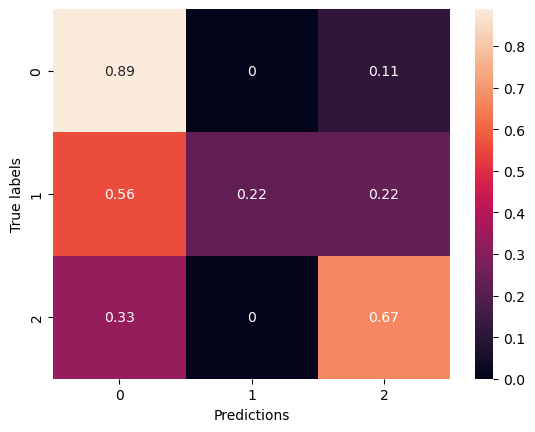

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▄▅▅▅▆▆▇▇▇▇▇█████████████████████████
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▃▄▃▄▆▇▆▆▆▆▆▇▆▄▆▆█▆▇▇▆▆▇██▇▇▅▇▇▇▆▆▆▆▇▅
val_loss,█▇▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:45:55.630382: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:45:55.632339: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:45:55.634234: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:45:57.250812: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:45:57.252750: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:45:57.254902: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:46:01.395074: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:46:02.027101: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 46.2117 - accuracy: 0.3539

2024-03-12 16:46:05.306281: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:46:05.308636: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:46:05.310287: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 694ms/step - loss: 46.2117 - accuracy: 0.3539 - val_loss: 43.3087 - val_accuracy: 0.1667
Epoch 2/100
4/4 [==============================] - 1s 208ms/step - loss: 42.6004 - accuracy: 0.4361 - val_loss: 40.2327 - val_accuracy: 0.1389
Epoch 3/100
4/4 [==============================] - 1s 187ms/step - loss: 39.2801 - accuracy: 0.4817 - val_loss: 37.3187 - val_accuracy: 0.1389
Epoch 4/100
4/4 [==============================] - 1s 183ms/step - loss: 36.1159 - accuracy: 0.5000 - val_loss: 34.5178 - val_accuracy: 0.1389
Epoch 5/100
4/4 [==============================] - 1s 184ms/step - loss: 33.3905 - accuracy: 0.4932 - val_loss: 31.9306 - val_accuracy: 0.1389
Epoch 6/100
4/4 [==============================] - 1s 186ms/step - loss: 30.6813 - accuracy: 0.5685 - val_loss: 29.5380 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 182ms/step - loss: 28.1141 - accuracy: 0.5913 - val_loss: 27.3001 - val_accuracy: 0.1204
Epoch 8/10

4/4 [==============================] - 1s 183ms/step - loss: 1.5012 - accuracy: 0.9658 - val_loss: 4.6503 - val_accuracy: 0.4444
Epoch 59/100
4/4 [==============================] - 1s 183ms/step - loss: 1.5472 - accuracy: 0.9384 - val_loss: 3.8789 - val_accuracy: 0.5463
Epoch 60/100
4/4 [==============================] - 1s 183ms/step - loss: 1.4171 - accuracy: 0.9635 - val_loss: 3.8375 - val_accuracy: 0.5463
Epoch 61/100
4/4 [==============================] - 1s 190ms/step - loss: 1.4076 - accuracy: 0.9498 - val_loss: 4.0841 - val_accuracy: 0.5278
Epoch 62/100
4/4 [==============================] - 1s 185ms/step - loss: 1.3704 - accuracy: 0.9589 - val_loss: 4.2953 - val_accuracy: 0.5000
Epoch 63/100
4/4 [==============================] - 1s 186ms/step - loss: 1.2989 - accuracy: 0.9863 - val_loss: 4.1778 - val_accuracy: 0.4815
Epoch 64/100
4/4 [==============================] - 1s 182ms/step - loss: 1.3355 - accuracy: 0.9429 - val_loss: 4.1245 - val_accuracy: 0.4815
Epoch 65/100
4/4 [=

2024-03-12 16:47:22.844800: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:47:22.846574: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:47:22.848701: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.435497999191284 s
{'0': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '2': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5646723646723646, 'recall': 0.5555555555555555, 'f1-score': 0.5401635401635402, 'support': 27}, 'weighted avg': {'precision': 0.5646723646723646, 'recall': 0.5555555555555556, 'f1-score': 0.5401635401635402, 'support': 27}}


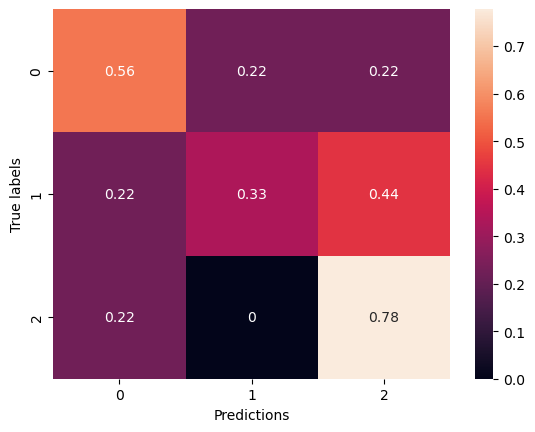

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▅▅▅▆▆▇▇▇▇▇█▇▇▇████▇█▇████████▇█████
training_loss,█▇▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▃▄▅▆▆▄▆▇█▇█▆▅█▇▆▇█▇▇▇██▇▆▇▇▅▇▇▆▇▇▇
val_loss,█▇▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:47:47.405696: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:47:47.407671: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:47:47.410489: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:47:49.041915: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:47:49.043930: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:47:49.045848: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:47:53.260424: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:47:53.839611: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 8.2027 - accuracy: 0.3402

2024-03-12 16:47:57.112817: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:47:57.114643: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:47:57.116904: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 694ms/step - loss: 8.2027 - accuracy: 0.3402 - val_loss: 7.6341 - val_accuracy: 0.1389
Epoch 2/100
4/4 [==============================] - 1s 184ms/step - loss: 7.9667 - accuracy: 0.3607 - val_loss: 7.5612 - val_accuracy: 0.1481
Epoch 3/100
4/4 [==============================] - 1s 186ms/step - loss: 7.7802 - accuracy: 0.3904 - val_loss: 7.4879 - val_accuracy: 0.1389
Epoch 4/100
4/4 [==============================] - 1s 182ms/step - loss: 7.5891 - accuracy: 0.3858 - val_loss: 7.4026 - val_accuracy: 0.1389
Epoch 5/100
4/4 [==============================] - 1s 185ms/step - loss: 7.3248 - accuracy: 0.4635 - val_loss: 7.3240 - val_accuracy: 0.1389
Epoch 6/100
4/4 [==============================] - 1s 187ms/step - loss: 7.2743 - accuracy: 0.4155 - val_loss: 7.2532 - val_accuracy: 0.1389
Epoch 7/100
4/4 [==============================] - 1s 185ms/step - loss: 7.1036 - accuracy: 0.4201 - val_loss: 7.1630 - val_accuracy: 0.1667
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 183ms/step - loss: 2.5408 - accuracy: 0.8584 - val_loss: 5.2187 - val_accuracy: 0.5185
Epoch 60/100
4/4 [==============================] - 1s 181ms/step - loss: 2.5122 - accuracy: 0.8653 - val_loss: 5.4450 - val_accuracy: 0.4907
Epoch 61/100
4/4 [==============================] - 1s 186ms/step - loss: 2.4272 - accuracy: 0.8630 - val_loss: 5.3981 - val_accuracy: 0.4259
Epoch 62/100
4/4 [==============================] - 1s 184ms/step - loss: 2.3789 - accuracy: 0.8653 - val_loss: 5.5637 - val_accuracy: 0.4815
Epoch 63/100
4/4 [==============================] - 1s 186ms/step - loss: 2.3206 - accuracy: 0.9201 - val_loss: 5.3223 - val_accuracy: 0.4815
Epoch 64/100
4/4 [==============================] - 1s 184ms/step - loss: 2.2677 - accuracy: 0.8995 - val_loss: 5.3118 - val_accuracy: 0.5093
Epoch 65/100
4/4 [==============================] - 1s 187ms/step - loss: 2.2364 - accuracy: 0.9155 - val_loss: 5.4213 - val_accuracy: 0.5000
Epoch 

2024-03-12 16:49:13.186660: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:49:13.188280: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:49:13.190235: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4763610363006592 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.8888888888888888, 'f1-score': 0.5517241379310346, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.41111111111111115, 'recall': 0.4074074074074074, 'f1-score': 0.34202770409666966, 'support': 27}, 'weighted avg': {'precision': 0.4111111111111111, 'recall': 0.4074074074074074, 'f1-score': 0.3420277040966696, 'support': 27}}


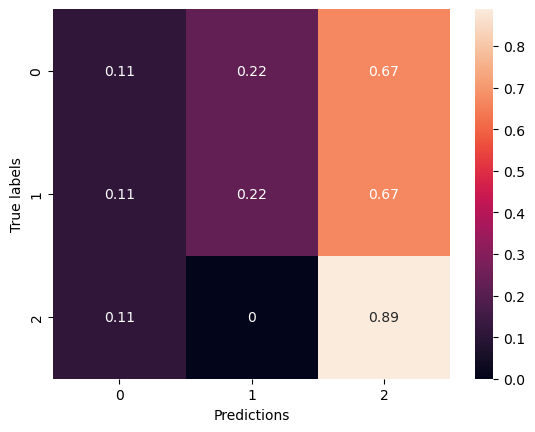

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▃▃▄▃▄▅▄▄▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇████████▇██
training_loss,██▇▇▆▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▂▁▁▃▆▇▅▅▄▅▇█▅▅██▇▅▆▆▆▇▆▆▅▆▆▆▆▆█▆▇
val_loss,██▇▇▆▆▆▆▆▇▅▄▃▄▃▄▄▂▂▂▂▂▂▃▃▃▃▃▂▃▃▄▃▃▂▂▃▁▂▂


Epoch 1/100


2024-03-12 16:49:36.297748: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:49:36.299177: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:49:36.301300: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:49:37.925804: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:49:37.927819: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:49:37.930202: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:49:43.016389: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:49:43.603882: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 33.8668 - accuracy: 0.2968

2024-03-12 16:49:46.874086: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:49:46.875658: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:49:46.877882: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 723ms/step - loss: 33.8668 - accuracy: 0.2968 - val_loss: 31.7705 - val_accuracy: 0.3519
Epoch 2/100
4/4 [==============================] - 1s 184ms/step - loss: 31.7121 - accuracy: 0.3721 - val_loss: 30.0093 - val_accuracy: 0.2963
Epoch 3/100
4/4 [==============================] - 1s 186ms/step - loss: 29.8831 - accuracy: 0.3881 - val_loss: 28.3364 - val_accuracy: 0.2500
Epoch 4/100
4/4 [==============================] - 1s 187ms/step - loss: 28.1285 - accuracy: 0.4201 - val_loss: 26.7367 - val_accuracy: 0.2407
Epoch 5/100
4/4 [==============================] - 1s 186ms/step - loss: 26.5014 - accuracy: 0.4087 - val_loss: 25.2181 - val_accuracy: 0.2037
Epoch 6/100
4/4 [==============================] - 1s 194ms/step - loss: 24.8997 - accuracy: 0.4452 - val_loss: 23.7967 - val_accuracy: 0.1944
Epoch 7/100
4/4 [==============================] - 1s 182ms/step - loss: 23.4432 - accuracy: 0.4384 - val_loss: 22.4563 - val_accuracy: 0.2037
Epoch 8/10

4/4 [==============================] - 1s 183ms/step - loss: 2.2367 - accuracy: 0.8653 - val_loss: 4.8793 - val_accuracy: 0.5463
Epoch 59/100
4/4 [==============================] - 1s 184ms/step - loss: 2.1445 - accuracy: 0.8904 - val_loss: 4.2980 - val_accuracy: 0.5833
Epoch 60/100
4/4 [==============================] - 1s 183ms/step - loss: 2.1032 - accuracy: 0.9064 - val_loss: 4.0620 - val_accuracy: 0.6019
Epoch 61/100
4/4 [==============================] - 1s 182ms/step - loss: 2.0355 - accuracy: 0.8995 - val_loss: 4.3685 - val_accuracy: 0.5833
Epoch 62/100
4/4 [==============================] - 1s 184ms/step - loss: 1.9953 - accuracy: 0.9110 - val_loss: 4.6660 - val_accuracy: 0.5278
Epoch 63/100
4/4 [==============================] - 1s 181ms/step - loss: 1.9373 - accuracy: 0.9041 - val_loss: 4.1891 - val_accuracy: 0.5556
Epoch 64/100
4/4 [==============================] - 1s 182ms/step - loss: 1.8638 - accuracy: 0.9224 - val_loss: 4.3582 - val_accuracy: 0.5370
Epoch 65/100
4/4 [=

2024-03-12 16:51:03.202707: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:51:03.204826: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:51:03.206457: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4740889072418213 s
{'0': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5333333333333333, 'recall': 0.5185185185185185, 'f1-score': 0.5026184386798197, 'support': 27}, 'weighted avg': {'precision': 0.5333333333333333, 'recall': 0.5185185185185185, 'f1-score': 0.5026184386798198, 'support': 27}}


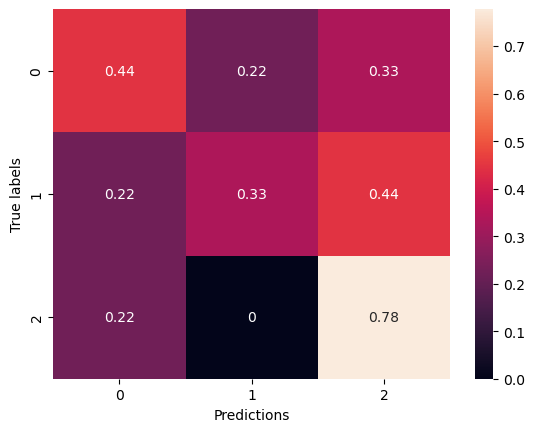

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▃▃▃▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇█▇▇█████████
training_loss,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▂▂▁▁▁▁▁▂▃▃▃▃▄▆▆▅▆▆▇▇█▇▇▇▆▇█▇▇▇▇▇▇▇█▇▆▆▇
val_loss,█▇▆▅▅▄▃▃▃▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:51:26.515674: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:51:26.517527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:51:26.519650: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:51:28.211865: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:51:28.214269: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:51:28.216648: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:51:32.400706: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:51:32.982534: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 46.5015 - accuracy: 0.3288

2024-03-12 16:51:36.297947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:51:36.300231: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:51:36.301912: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 968ms/step - loss: 46.5015 - accuracy: 0.3288 - val_loss: 43.6948 - val_accuracy: 0.3148
Epoch 2/100
4/4 [==============================] - 1s 184ms/step - loss: 43.4110 - accuracy: 0.3356 - val_loss: 40.7969 - val_accuracy: 0.2500
Epoch 3/100
4/4 [==============================] - 1s 189ms/step - loss: 40.3195 - accuracy: 0.3562 - val_loss: 38.0638 - val_accuracy: 0.2315
Epoch 4/100
4/4 [==============================] - 1s 183ms/step - loss: 37.5959 - accuracy: 0.3836 - val_loss: 35.4842 - val_accuracy: 0.2407
Epoch 5/100
4/4 [==============================] - 1s 182ms/step - loss: 35.0105 - accuracy: 0.4018 - val_loss: 33.0772 - val_accuracy: 0.2130
Epoch 6/100
4/4 [==============================] - 1s 182ms/step - loss: 32.5444 - accuracy: 0.4155 - val_loss: 30.8255 - val_accuracy: 0.1759
Epoch 7/100
4/4 [==============================] - 1s 183ms/step - loss: 30.3078 - accuracy: 0.4475 - val_loss: 28.7198 - val_accuracy: 0.1944
Epoch 8/10

4/4 [==============================] - 1s 183ms/step - loss: 2.1414 - accuracy: 0.8813 - val_loss: 3.8991 - val_accuracy: 0.5463
Epoch 59/100
4/4 [==============================] - 1s 187ms/step - loss: 2.1073 - accuracy: 0.8744 - val_loss: 3.7805 - val_accuracy: 0.5556
Epoch 60/100
4/4 [==============================] - 1s 183ms/step - loss: 2.0184 - accuracy: 0.8904 - val_loss: 3.5423 - val_accuracy: 0.5648
Epoch 61/100
4/4 [==============================] - 1s 184ms/step - loss: 1.9846 - accuracy: 0.8813 - val_loss: 3.9369 - val_accuracy: 0.5741
Epoch 62/100
4/4 [==============================] - 1s 186ms/step - loss: 1.9423 - accuracy: 0.8950 - val_loss: 3.6917 - val_accuracy: 0.6111
Epoch 63/100
4/4 [==============================] - 1s 183ms/step - loss: 1.8122 - accuracy: 0.9269 - val_loss: 3.6684 - val_accuracy: 0.5741
Epoch 64/100
4/4 [==============================] - 1s 182ms/step - loss: 1.8033 - accuracy: 0.9087 - val_loss: 3.9855 - val_accuracy: 0.5926
Epoch 65/100
4/4 [=

2024-03-12 16:52:53.505878: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:52:53.508287: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:52:53.509835: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4750080108642578 s
{'0': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '1': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.45714285714285713, 'recall': 0.4444444444444444, 'f1-score': 0.4473684210526316, 'support': 27}, 'weighted avg': {'precision': 0.4571428571428571, 'recall': 0.4444444444444444, 'f1-score': 0.44736842105263164, 'support': 27}}


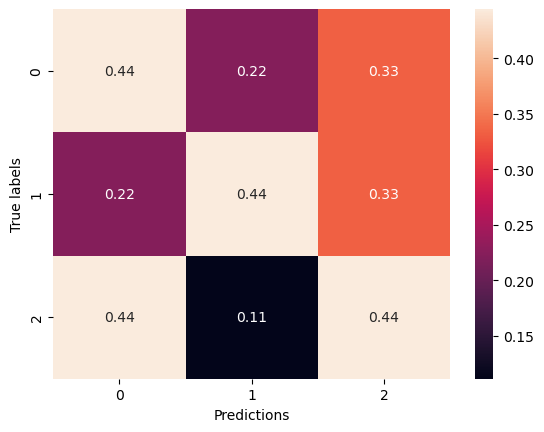

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▃▃▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇█▇██▇█████████
training_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▂▁▁▂▂▂▂▃▂▃▂▃▅▅▅▆▆▄█▆▇▇▇▇█▆█▇▇▇▆█▇▆▇█▆▇▅
val_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:53:18.031046: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:53:18.033040: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:53:18.034837: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:53:19.650104: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:53:19.651883: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:53:19.653872: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:53:23.815055: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:53:24.405663: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 9.6291 - accuracy: 0.3219

2024-03-12 16:53:27.842876: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:53:27.845055: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:53:27.846645: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 732ms/step - loss: 9.6291 - accuracy: 0.3219 - val_loss: 8.9972 - val_accuracy: 0.1852
Epoch 2/100
4/4 [==============================] - 1s 212ms/step - loss: 8.8939 - accuracy: 0.5160 - val_loss: 8.8558 - val_accuracy: 0.1667
Epoch 3/100
4/4 [==============================] - 1s 213ms/step - loss: 8.4792 - accuracy: 0.5822 - val_loss: 8.7645 - val_accuracy: 0.1574
Epoch 4/100
4/4 [==============================] - 1s 218ms/step - loss: 8.1915 - accuracy: 0.6621 - val_loss: 8.6776 - val_accuracy: 0.1481
Epoch 5/100
4/4 [==============================] - 1s 220ms/step - loss: 7.9110 - accuracy: 0.6872 - val_loss: 8.5822 - val_accuracy: 0.1481
Epoch 6/100
4/4 [==============================] - 1s 218ms/step - loss: 7.6618 - accuracy: 0.7169 - val_loss: 8.4518 - val_accuracy: 0.1481
Epoch 7/100
4/4 [==============================] - 1s 216ms/step - loss: 7.4319 - accuracy: 0.7215 - val_loss: 8.3387 - val_accuracy: 0.1389
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 215ms/step - loss: 1.7473 - accuracy: 0.9680 - val_loss: 5.2917 - val_accuracy: 0.3889
Epoch 60/100
4/4 [==============================] - 1s 215ms/step - loss: 1.6842 - accuracy: 0.9749 - val_loss: 4.6652 - val_accuracy: 0.4444
Epoch 61/100
4/4 [==============================] - 1s 217ms/step - loss: 1.6589 - accuracy: 0.9726 - val_loss: 4.0535 - val_accuracy: 0.5370
Epoch 62/100
4/4 [==============================] - 1s 216ms/step - loss: 1.6408 - accuracy: 0.9680 - val_loss: 5.1249 - val_accuracy: 0.4259
Epoch 63/100
4/4 [==============================] - 1s 215ms/step - loss: 1.6159 - accuracy: 0.9703 - val_loss: 5.7637 - val_accuracy: 0.3889
Epoch 64/100
4/4 [==============================] - 1s 217ms/step - loss: 1.5597 - accuracy: 0.9772 - val_loss: 3.9882 - val_accuracy: 0.5278
Epoch 65/100
4/4 [==============================] - 1s 217ms/step - loss: 1.5657 - accuracy: 0.9612 - val_loss: 4.0413 - val_accuracy: 0.5648
Epoch 

2024-03-12 16:54:56.540506: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:54:56.542099: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:54:56.544111: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4746222496032715 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '2': {'precision': 0.4090909090909091, 'recall': 1.0, 'f1-score': 0.5806451612903226, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.33636363636363636, 'recall': 0.4444444444444444, 'f1-score': 0.33640552995391704, 'support': 27}, 'weighted avg': {'precision': 0.33636363636363636, 'recall': 0.4444444444444444, 'f1-score': 0.3364055299539171, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


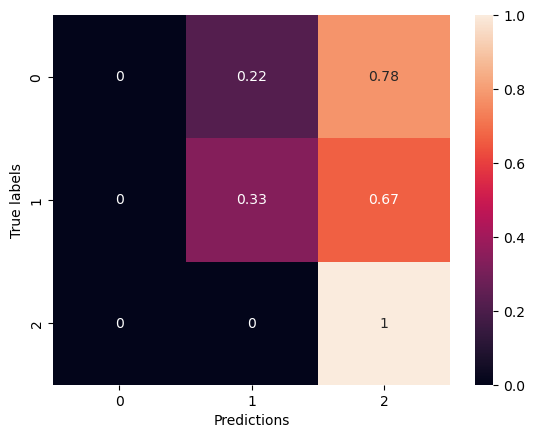

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇▇████████████████████████████████
training_loss,█▇▆▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▃▄▄▅▅▄▅▆▅▇▇▇█▇█▇▅▄▅▇▇██▇▇▇▄▅▄▇▇▇▇▇▇
val_loss,██▇▇▆▅▅▄▄▄▄▃▃▄▃▂▂▁▂▂▂▃▄▃▁▁▁▂▂▂▂▄▄▃▂▃▂▂▂▂


Epoch 1/100


2024-03-12 16:55:19.679446: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:55:19.681110: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:55:19.683242: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:55:21.287477: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:55:21.289973: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:55:21.291739: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:55:26.439341: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:55:27.017118: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 40.3766 - accuracy: 0.3516

2024-03-12 16:55:30.398831: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:55:30.400505: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:55:30.402456: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 724ms/step - loss: 40.3766 - accuracy: 0.3516 - val_loss: 38.1606 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 215ms/step - loss: 37.2222 - accuracy: 0.5137 - val_loss: 35.6982 - val_accuracy: 0.1389
Epoch 3/100
4/4 [==============================] - 1s 214ms/step - loss: 34.6202 - accuracy: 0.5502 - val_loss: 33.2520 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 214ms/step - loss: 32.1488 - accuracy: 0.5799 - val_loss: 30.9313 - val_accuracy: 0.1296
Epoch 5/100
4/4 [==============================] - 1s 214ms/step - loss: 29.7409 - accuracy: 0.6210 - val_loss: 28.7689 - val_accuracy: 0.1574
Epoch 6/100
4/4 [==============================] - 1s 218ms/step - loss: 27.4236 - accuracy: 0.7123 - val_loss: 26.7397 - val_accuracy: 0.1852
Epoch 7/100
4/4 [==============================] - 1s 217ms/step - loss: 25.4254 - accuracy: 0.6872 - val_loss: 24.8604 - val_accuracy: 0.1944
Epoch 8/10

4/4 [==============================] - 1s 217ms/step - loss: 1.5117 - accuracy: 0.9635 - val_loss: 3.7772 - val_accuracy: 0.5648
Epoch 59/100
4/4 [==============================] - 1s 215ms/step - loss: 1.4887 - accuracy: 0.9749 - val_loss: 3.4950 - val_accuracy: 0.5833
Epoch 60/100
4/4 [==============================] - 1s 216ms/step - loss: 1.4444 - accuracy: 0.9680 - val_loss: 3.5703 - val_accuracy: 0.5556
Epoch 61/100
4/4 [==============================] - 1s 217ms/step - loss: 1.4336 - accuracy: 0.9566 - val_loss: 3.5094 - val_accuracy: 0.5741
Epoch 62/100
4/4 [==============================] - 1s 218ms/step - loss: 1.3705 - accuracy: 0.9680 - val_loss: 3.6706 - val_accuracy: 0.5556
Epoch 63/100
4/4 [==============================] - 1s 220ms/step - loss: 1.3526 - accuracy: 0.9680 - val_loss: 3.5413 - val_accuracy: 0.5185
Epoch 64/100
4/4 [==============================] - 1s 212ms/step - loss: 1.3389 - accuracy: 0.9635 - val_loss: 3.6546 - val_accuracy: 0.5926
Epoch 65/100
4/4 [=

2024-03-12 16:57:00.341704: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:57:00.343841: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:57:00.345339: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4677460193634033 s
{'0': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5333333333333333, 'recall': 0.5185185185185185, 'f1-score': 0.5087719298245613, 'support': 27}, 'weighted avg': {'precision': 0.5333333333333333, 'recall': 0.5185185185185185, 'f1-score': 0.5087719298245614, 'support': 27}}


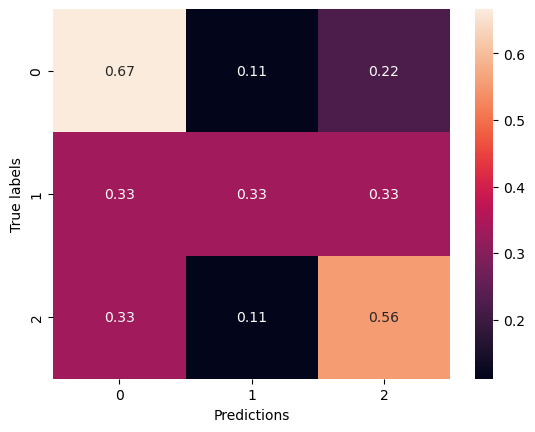

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▇▇▇▇▇▇███▇█████████████████████████
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▂▃▅▅▆▇▇▆▇▇▇▅▅▆▇▇▇▇▅█████▆█▇█▇█▇█▇▇█▇▅
val_loss,█▇▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 16:57:24.639401: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:57:24.640986: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:57:24.642985: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:57:26.253993: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:57:26.256493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:57:26.258197: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 16:57:30.366712: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 16:57:30.944747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 55.6975 - accuracy: 0.3516

2024-03-12 16:57:34.339683: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:57:34.341440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:57:34.343500: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 726ms/step - loss: 55.6975 - accuracy: 0.3516 - val_loss: 52.5932 - val_accuracy: 0.1389
Epoch 2/100
4/4 [==============================] - 1s 217ms/step - loss: 51.0943 - accuracy: 0.5457 - val_loss: 48.6516 - val_accuracy: 0.1389
Epoch 3/100
4/4 [==============================] - 1s 215ms/step - loss: 47.1196 - accuracy: 0.5548 - val_loss: 44.8715 - val_accuracy: 0.1481
Epoch 4/100
4/4 [==============================] - 1s 212ms/step - loss: 43.2169 - accuracy: 0.6301 - val_loss: 41.3234 - val_accuracy: 0.1481
Epoch 5/100
4/4 [==============================] - 1s 242ms/step - loss: 39.7039 - accuracy: 0.6256 - val_loss: 38.0485 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 1s 216ms/step - loss: 36.2264 - accuracy: 0.6804 - val_loss: 34.9788 - val_accuracy: 0.1481
Epoch 7/100
4/4 [==============================] - 1s 217ms/step - loss: 33.1473 - accuracy: 0.7032 - val_loss: 32.0665 - val_accuracy: 0.1481
Epoch 8/10

4/4 [==============================] - 1s 214ms/step - loss: 1.4557 - accuracy: 0.9749 - val_loss: 4.0499 - val_accuracy: 0.5833
Epoch 59/100
4/4 [==============================] - 1s 215ms/step - loss: 1.4443 - accuracy: 0.9658 - val_loss: 4.1217 - val_accuracy: 0.5463
Epoch 60/100
4/4 [==============================] - 1s 217ms/step - loss: 1.3835 - accuracy: 0.9840 - val_loss: 4.1084 - val_accuracy: 0.5000
Epoch 61/100
4/4 [==============================] - 1s 216ms/step - loss: 1.3771 - accuracy: 0.9680 - val_loss: 3.9007 - val_accuracy: 0.5741
Epoch 62/100
4/4 [==============================] - 1s 215ms/step - loss: 1.3395 - accuracy: 0.9726 - val_loss: 3.9049 - val_accuracy: 0.5833
Epoch 63/100
4/4 [==============================] - 1s 215ms/step - loss: 1.3170 - accuracy: 0.9566 - val_loss: 4.0429 - val_accuracy: 0.6019
Epoch 64/100
4/4 [==============================] - 1s 215ms/step - loss: 1.3066 - accuracy: 0.9726 - val_loss: 4.1293 - val_accuracy: 0.6019
Epoch 65/100
4/4 [=

wandb: Network error (ConnectTimeout), entering retry loop.


4/4 [==============================] - 1s 214ms/step - loss: 0.9075 - accuracy: 0.9703 - val_loss: 4.1748 - val_accuracy: 0.5741
Epoch 96/100
4/4 [==============================] - 1s 215ms/step - loss: 0.9659 - accuracy: 0.9543 - val_loss: 4.0002 - val_accuracy: 0.5926
Epoch 97/100
4/4 [==============================] - 1s 217ms/step - loss: 0.9185 - accuracy: 0.9566 - val_loss: 3.9880 - val_accuracy: 0.6296
Epoch 98/100
4/4 [==============================] - 1s 223ms/step - loss: 0.9086 - accuracy: 0.9658 - val_loss: 4.6861 - val_accuracy: 0.5741
Epoch 99/100
4/4 [==============================] - 1s 215ms/step - loss: 0.9437 - accuracy: 0.9543 - val_loss: 3.9760 - val_accuracy: 0.6204
Epoch 100/100
4/4 [==============================] - 1s 212ms/step - loss: 0.8760 - accuracy: 0.9566 - val_loss: 5.7980 - val_accuracy: 0.4352
Training done in 98.46417570114136 s


2024-03-12 16:59:03.086535: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 16:59:03.089230: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 16:59:03.090892: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4725291728973389 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.8888888888888888, 'f1-score': 0.5517241379310346, 'support': 9}, '2': {'precision': 0.7142857142857143, 'recall': 0.5555555555555556, 'f1-score': 0.6250000000000001, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.37142857142857144, 'recall': 0.48148148148148145, 'f1-score': 0.3922413793103449, 'support': 27}, 'weighted avg': {'precision': 0.37142857142857144, 'recall': 0.48148148148148145, 'f1-score': 0.3922413793103449, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


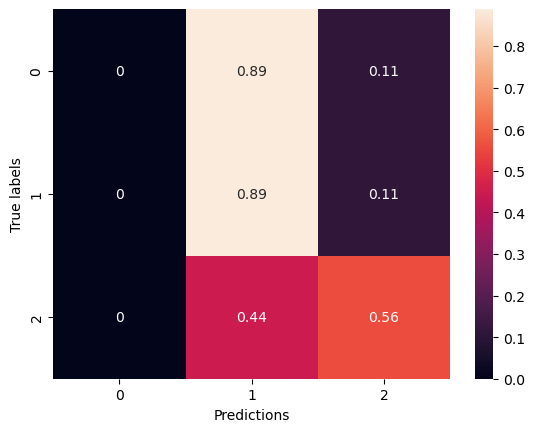

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▆▇▇▇▇██████████████████████████████
training_loss,█▇▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▂▃▃▅▇▆▆▆▆▇▆▇█▆▆▇▇▇▇▇█▄▆█▆▆▆▆▇▇▇▆▆█▅
val_loss,█▇▅▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:04:50.128572: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:04:50.130690: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:04:50.133121: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:04:51.822430: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:04:51.824706: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:04:51.826401: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:04:56.030657: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:04:56.626994: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 9.4908 - accuracy: 0.3516

2024-03-12 17:05:00.445605: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:05:00.449301: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:05:00.450997: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 755ms/step - loss: 9.4908 - accuracy: 0.3516 - val_loss: 8.8093 - val_accuracy: 0.2130
Epoch 2/100
4/4 [==============================] - 1s 218ms/step - loss: 9.0107 - accuracy: 0.3744 - val_loss: 8.6546 - val_accuracy: 0.2130
Epoch 3/100
4/4 [==============================] - 1s 224ms/step - loss: 8.6947 - accuracy: 0.4521 - val_loss: 8.5758 - val_accuracy: 0.1667
Epoch 4/100
4/4 [==============================] - 1s 221ms/step - loss: 8.4309 - accuracy: 0.4680 - val_loss: 8.4820 - val_accuracy: 0.1389
Epoch 5/100
4/4 [==============================] - 1s 232ms/step - loss: 8.1551 - accuracy: 0.5046 - val_loss: 8.4127 - val_accuracy: 0.1389
Epoch 6/100
4/4 [==============================] - 1s 221ms/step - loss: 7.9736 - accuracy: 0.5342 - val_loss: 8.3386 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 231ms/step - loss: 7.7530 - accuracy: 0.5616 - val_loss: 8.2630 - val_accuracy: 0.1204
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 222ms/step - loss: 2.0519 - accuracy: 0.9703 - val_loss: 4.8970 - val_accuracy: 0.5833
Epoch 60/100
4/4 [==============================] - 1s 214ms/step - loss: 2.0003 - accuracy: 0.9749 - val_loss: 4.9250 - val_accuracy: 0.5556
Epoch 61/100
4/4 [==============================] - 1s 215ms/step - loss: 1.9619 - accuracy: 0.9703 - val_loss: 5.1938 - val_accuracy: 0.5741
Epoch 62/100
4/4 [==============================] - 1s 217ms/step - loss: 1.9208 - accuracy: 0.9772 - val_loss: 5.1953 - val_accuracy: 0.5741
Epoch 63/100
4/4 [==============================] - 1s 216ms/step - loss: 1.8762 - accuracy: 0.9749 - val_loss: 4.5564 - val_accuracy: 0.6019
Epoch 64/100
4/4 [==============================] - 1s 214ms/step - loss: 1.8596 - accuracy: 0.9772 - val_loss: 4.7531 - val_accuracy: 0.5093
Epoch 65/100
4/4 [==============================] - 1s 214ms/step - loss: 1.8232 - accuracy: 0.9635 - val_loss: 4.4636 - val_accuracy: 0.4907
Epoch 

2024-03-12 17:06:31.248270: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:06:31.250911: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:06:31.252672: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4798979759216309 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '2': {'precision': 0.5625, 'recall': 1.0, 'f1-score': 0.72, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.49702380952380953, 'recall': 0.5185185185185185, 'f1-score': 0.4675641025641026, 'support': 27}, 'weighted avg': {'precision': 0.49702380952380953, 'recall': 0.5185185185185185, 'f1-score': 0.46756410256410247, 'support': 27}}


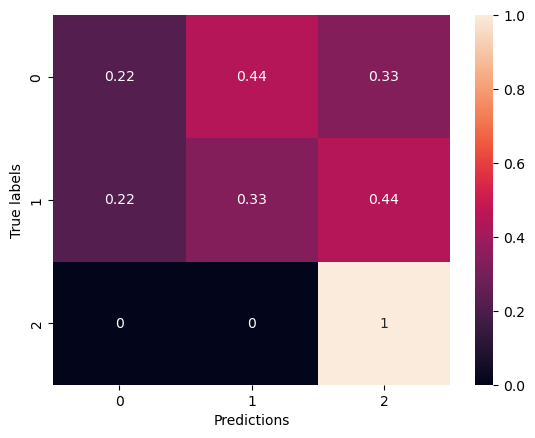

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▅▅▅▆▆▆▇▇▇▇▇████████████████████████
training_loss,█▇▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▂▁▁▂▂▃▂▃▅▆▆▆▅▅▅█▇█▆█▆▇▇▇▆▆▅▇▆▅▆█▇▇▅▇██▇
val_loss,██▇▇▆▆▅▅▅▄▄▄▃▃▄▃▃▃▃▃▂▃▃▃▃▃▃▃▁▂▃▃▂▂▂▃▁▁▁▁


Epoch 1/100


2024-03-12 17:06:55.952318: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:06:55.954384: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:06:55.955876: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:06:57.573001: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:06:57.575450: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:06:57.577182: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:07:02.700177: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:07:03.286999: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 40.3796 - accuracy: 0.3584

2024-03-12 17:07:06.685107: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:07:06.687327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:07:06.688870: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 717ms/step - loss: 40.3796 - accuracy: 0.3584 - val_loss: 38.1224 - val_accuracy: 0.1667
Epoch 2/100
4/4 [==============================] - 1s 223ms/step - loss: 37.5157 - accuracy: 0.4543 - val_loss: 35.7254 - val_accuracy: 0.1481
Epoch 3/100
4/4 [==============================] - 1s 216ms/step - loss: 34.9776 - accuracy: 0.4863 - val_loss: 33.4456 - val_accuracy: 0.1481
Epoch 4/100
4/4 [==============================] - 1s 216ms/step - loss: 32.6236 - accuracy: 0.4977 - val_loss: 31.3227 - val_accuracy: 0.1296
Epoch 5/100
4/4 [==============================] - 1s 215ms/step - loss: 30.5413 - accuracy: 0.4977 - val_loss: 29.3028 - val_accuracy: 0.1389
Epoch 6/100
4/4 [==============================] - 1s 216ms/step - loss: 28.3633 - accuracy: 0.5274 - val_loss: 27.3612 - val_accuracy: 0.1389
Epoch 7/100
4/4 [==============================] - 1s 215ms/step - loss: 26.3525 - accuracy: 0.5479 - val_loss: 25.4848 - val_accuracy: 0.1481
Epoch 8/10

4/4 [==============================] - 1s 215ms/step - loss: 1.7540 - accuracy: 0.9361 - val_loss: 6.2185 - val_accuracy: 0.3519
Epoch 59/100
4/4 [==============================] - 1s 211ms/step - loss: 1.6933 - accuracy: 0.9224 - val_loss: 6.0556 - val_accuracy: 0.3333
Epoch 60/100
4/4 [==============================] - 1s 219ms/step - loss: 1.6271 - accuracy: 0.9361 - val_loss: 5.7084 - val_accuracy: 0.3796
Epoch 61/100
4/4 [==============================] - 1s 211ms/step - loss: 1.5978 - accuracy: 0.9521 - val_loss: 5.4196 - val_accuracy: 0.4167
Epoch 62/100
4/4 [==============================] - 1s 212ms/step - loss: 1.5829 - accuracy: 0.9498 - val_loss: 4.3087 - val_accuracy: 0.4722
Epoch 63/100
4/4 [==============================] - 1s 214ms/step - loss: 1.5054 - accuracy: 0.9658 - val_loss: 3.8570 - val_accuracy: 0.5278
Epoch 64/100
4/4 [==============================] - 1s 215ms/step - loss: 1.5191 - accuracy: 0.9406 - val_loss: 3.6995 - val_accuracy: 0.5833
Epoch 65/100
4/4 [=

2024-03-12 17:08:35.819879: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:08:35.821595: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:08:35.824992: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.476085901260376 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.42857142857142855, 'recall': 0.6666666666666666, 'f1-score': 0.5217391304347826, 'support': 9}, '2': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.3223443223443223, 'recall': 0.48148148148148145, 'f1-score': 0.38603425559947296, 'support': 27}, 'weighted avg': {'precision': 0.3223443223443223, 'recall': 0.48148148148148145, 'f1-score': 0.38603425559947296, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


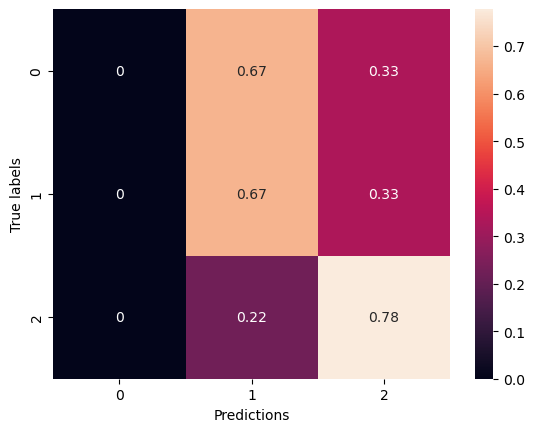

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▄▅▅▆▆▆▆▇▇▇▇█▇▇▇██▇▇████████████████
training_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▂▂▃▄▄▆▆▅▆▇█▇▇▅▇▇▆▇▇▄▅████▆▅▇█▆█▇▅▇▅▅
val_loss,█▇▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:08:58.341276: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:08:58.343447: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:08:58.345084: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:08:59.970754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:08:59.972936: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:08:59.974700: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:09:04.117663: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:09:04.700946: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 55.7683 - accuracy: 0.3014

2024-03-12 17:09:08.083870: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:09:08.085785: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:09:08.087794: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 722ms/step - loss: 55.7683 - accuracy: 0.3014 - val_loss: 52.3160 - val_accuracy: 0.3333
Epoch 2/100
4/4 [==============================] - 1s 216ms/step - loss: 51.5552 - accuracy: 0.3858 - val_loss: 48.5111 - val_accuracy: 0.2500
Epoch 3/100
4/4 [==============================] - 1s 211ms/step - loss: 47.5876 - accuracy: 0.4315 - val_loss: 44.9221 - val_accuracy: 0.2222
Epoch 4/100
4/4 [==============================] - 1s 213ms/step - loss: 43.9205 - accuracy: 0.4612 - val_loss: 41.5473 - val_accuracy: 0.1574
Epoch 5/100
4/4 [==============================] - 1s 213ms/step - loss: 40.4161 - accuracy: 0.5228 - val_loss: 38.3822 - val_accuracy: 0.1389
Epoch 6/100
4/4 [==============================] - 1s 216ms/step - loss: 37.3588 - accuracy: 0.4840 - val_loss: 35.4264 - val_accuracy: 0.1389
Epoch 7/100
4/4 [==============================] - 1s 215ms/step - loss: 34.3587 - accuracy: 0.5114 - val_loss: 32.6783 - val_accuracy: 0.1389
Epoch 8/10

4/4 [==============================] - 1s 216ms/step - loss: 1.6397 - accuracy: 0.9543 - val_loss: 4.8327 - val_accuracy: 0.4352
Epoch 59/100
4/4 [==============================] - 1s 219ms/step - loss: 1.6302 - accuracy: 0.9384 - val_loss: 3.6078 - val_accuracy: 0.5278
Epoch 60/100
4/4 [==============================] - 1s 216ms/step - loss: 1.6282 - accuracy: 0.9361 - val_loss: 4.1097 - val_accuracy: 0.5093
Epoch 61/100
4/4 [==============================] - 1s 214ms/step - loss: 1.6024 - accuracy: 0.9292 - val_loss: 5.4891 - val_accuracy: 0.3519
Epoch 62/100
4/4 [==============================] - 1s 215ms/step - loss: 1.5128 - accuracy: 0.9612 - val_loss: 4.7105 - val_accuracy: 0.4074
Epoch 63/100
4/4 [==============================] - 1s 216ms/step - loss: 1.5242 - accuracy: 0.9269 - val_loss: 5.6373 - val_accuracy: 0.3333
Epoch 64/100
4/4 [==============================] - 1s 217ms/step - loss: 1.5323 - accuracy: 0.9429 - val_loss: 4.4206 - val_accuracy: 0.4630
Epoch 65/100
4/4 [=

2024-03-12 17:10:36.844033: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:10:36.846253: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:10:36.847856: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4714093208312988 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.34848484848484845, 'recall': 0.5185185185185185, 'f1-score': 0.41333333333333333, 'support': 27}, 'weighted avg': {'precision': 0.34848484848484845, 'recall': 0.5185185185185185, 'f1-score': 0.41333333333333333, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


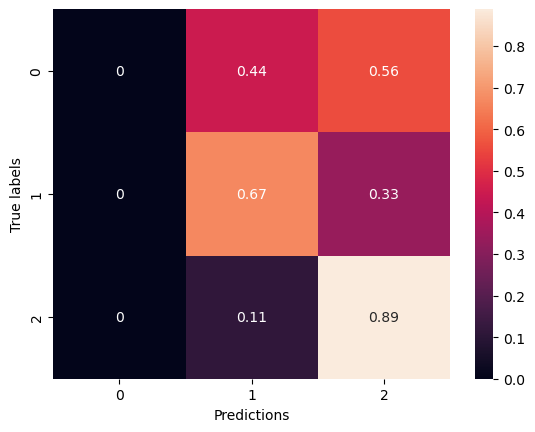

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▅▅▅▆▆▆▆▇▇▇▇▇▇██▇███▇▇███████▇███████
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▂▁▁▁▁▁▁▃▃▅▅▆▇▆▇▅██▇▇▅▇▇▄▆▆▆▇█▆▇█▆▄█▆▇▇▇
val_loss,█▇▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:11:00.516581: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:11:00.518849: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:11:00.520535: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:11:02.121867: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:11:02.124139: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:11:02.126091: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:11:06.252651: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:11:06.834663: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 9.7332 - accuracy: 0.2831

2024-03-12 17:11:10.212656: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:11:10.216187: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:11:10.218094: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 722ms/step - loss: 9.7332 - accuracy: 0.2831 - val_loss: 8.8287 - val_accuracy: 0.4537
Epoch 2/100
4/4 [==============================] - 1s 216ms/step - loss: 9.2767 - accuracy: 0.3676 - val_loss: 8.7427 - val_accuracy: 0.2593
Epoch 3/100
4/4 [==============================] - 1s 214ms/step - loss: 9.0273 - accuracy: 0.3836 - val_loss: 8.6480 - val_accuracy: 0.1944
Epoch 4/100
4/4 [==============================] - 1s 214ms/step - loss: 8.9726 - accuracy: 0.3516 - val_loss: 8.5712 - val_accuracy: 0.1296
Epoch 5/100
4/4 [==============================] - 1s 218ms/step - loss: 8.7649 - accuracy: 0.3836 - val_loss: 8.4949 - val_accuracy: 0.1481
Epoch 6/100
4/4 [==============================] - 1s 213ms/step - loss: 8.5655 - accuracy: 0.4155 - val_loss: 8.4066 - val_accuracy: 0.1389
Epoch 7/100
4/4 [==============================] - 1s 214ms/step - loss: 8.4012 - accuracy: 0.4018 - val_loss: 8.3265 - val_accuracy: 0.1481
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 215ms/step - loss: 3.3976 - accuracy: 0.7146 - val_loss: 4.4686 - val_accuracy: 0.5926
Epoch 60/100
4/4 [==============================] - 1s 217ms/step - loss: 3.3271 - accuracy: 0.7352 - val_loss: 4.3180 - val_accuracy: 0.6019
Epoch 61/100
4/4 [==============================] - 1s 216ms/step - loss: 3.2703 - accuracy: 0.7443 - val_loss: 4.2564 - val_accuracy: 0.6111
Epoch 62/100
4/4 [==============================] - 1s 212ms/step - loss: 3.2297 - accuracy: 0.7374 - val_loss: 4.1913 - val_accuracy: 0.6111
Epoch 63/100
4/4 [==============================] - 1s 213ms/step - loss: 3.1870 - accuracy: 0.7352 - val_loss: 4.1851 - val_accuracy: 0.6019
Epoch 64/100
4/4 [==============================] - 1s 213ms/step - loss: 3.1003 - accuracy: 0.7717 - val_loss: 4.1888 - val_accuracy: 0.5556
Epoch 65/100
4/4 [==============================] - 1s 214ms/step - loss: 3.0669 - accuracy: 0.7397 - val_loss: 4.1938 - val_accuracy: 0.5463
Epoch 

2024-03-12 17:12:39.854796: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:12:39.856863: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:12:39.858498: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4751901626586914 s
{'0': {'precision': 0.2857142857142857, 'recall': 0.2222222222222222, 'f1-score': 0.25, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.4622414622414623, 'recall': 0.48148148148148145, 'f1-score': 0.4685185185185185, 'support': 27}, 'weighted avg': {'precision': 0.4622414622414622, 'recall': 0.48148148148148145, 'f1-score': 0.46851851851851845, 'support': 27}}


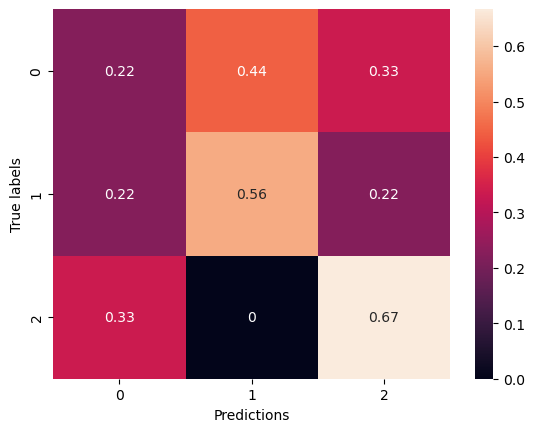

wandb: Network error (TransientError), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇███
training_loss,█▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▂▁▁▁▁▁▁▁▁▁▂▄▄▆▄▅▅▆▇▄▅▇▇█▇▇▇▇▆▆▇██▇▇▇▆▆▅
val_loss,██▇▇▇▇▆▆▆▆▆▅▄▄▄▄▃▃▃▃▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂


Epoch 1/100


2024-03-12 17:20:41.179373: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:20:41.181290: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:20:41.183508: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:20:42.837436: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:20:42.839825: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:20:42.841649: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:20:47.996579: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:20:48.577415: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 40.3283 - accuracy: 0.3059

2024-03-12 17:20:51.993956: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:20:51.995520: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:20:51.997480: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 729ms/step - loss: 40.3283 - accuracy: 0.3059 - val_loss: 38.0823 - val_accuracy: 0.2222
Epoch 2/100
4/4 [==============================] - 1s 215ms/step - loss: 37.8024 - accuracy: 0.3333 - val_loss: 35.8512 - val_accuracy: 0.1574
Epoch 3/100
4/4 [==============================] - 1s 218ms/step - loss: 35.4241 - accuracy: 0.4087 - val_loss: 33.7369 - val_accuracy: 0.1389
Epoch 4/100
4/4 [==============================] - 1s 217ms/step - loss: 33.2961 - accuracy: 0.3607 - val_loss: 31.7316 - val_accuracy: 0.1389
Epoch 5/100
4/4 [==============================] - 1s 218ms/step - loss: 31.2130 - accuracy: 0.4018 - val_loss: 29.8441 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 1s 218ms/step - loss: 29.3612 - accuracy: 0.3950 - val_loss: 28.0556 - val_accuracy: 0.1574
Epoch 7/100
4/4 [==============================] - 1s 216ms/step - loss: 27.5374 - accuracy: 0.3858 - val_loss: 26.3537 - val_accuracy: 0.2130
Epoch 8/10

4/4 [==============================] - 1s 239ms/step - loss: 2.5061 - accuracy: 0.8311 - val_loss: 4.1732 - val_accuracy: 0.5926
Epoch 59/100
4/4 [==============================] - 1s 215ms/step - loss: 2.4819 - accuracy: 0.8037 - val_loss: 4.3331 - val_accuracy: 0.4907
Epoch 60/100
4/4 [==============================] - 1s 210ms/step - loss: 2.3827 - accuracy: 0.8265 - val_loss: 4.3876 - val_accuracy: 0.4537
Epoch 61/100
4/4 [==============================] - 1s 212ms/step - loss: 2.2867 - accuracy: 0.8584 - val_loss: 3.9452 - val_accuracy: 0.5185
Epoch 62/100
4/4 [==============================] - 1s 216ms/step - loss: 2.2527 - accuracy: 0.8584 - val_loss: 3.9653 - val_accuracy: 0.5741
Epoch 63/100
4/4 [==============================] - 1s 243ms/step - loss: 2.1122 - accuracy: 0.8995 - val_loss: 3.9930 - val_accuracy: 0.5741
Epoch 64/100
4/4 [==============================] - 1s 216ms/step - loss: 2.1054 - accuracy: 0.8516 - val_loss: 3.9451 - val_accuracy: 0.5556
Epoch 65/100
4/4 [=

2024-03-12 17:22:20.426261: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:22:20.428471: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:22:20.430142: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4704859256744385 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '2': {'precision': 0.38095238095238093, 'recall': 0.8888888888888888, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.626984126984127, 'recall': 0.4444444444444444, 'f1-score': 0.4015540015540015, 'support': 27}, 'weighted avg': {'precision': 0.626984126984127, 'recall': 0.4444444444444444, 'f1-score': 0.4015540015540015, 'support': 27}}


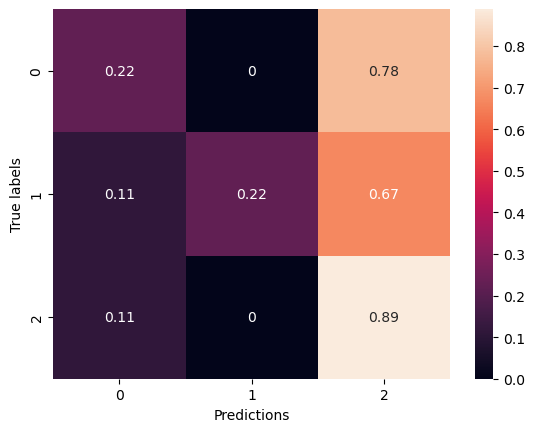

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▃▃▃▃▄▄▅▅▄▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇███▇██████
training_loss,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▂▁▁▁▁▂▄▄▅▅▇▇▄█▆▆▇▅█▅▆▇▇▆▇▇▆█▇▆▄▇▆▅█▇▇
val_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:22:42.442943: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:22:42.444595: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:22:42.446880: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:22:44.049698: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:22:44.051528: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:22:44.053690: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:22:48.266798: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:22:48.853602: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 55.7073 - accuracy: 0.2854

2024-03-12 17:22:52.269459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:22:52.271255: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:22:52.273272: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 728ms/step - loss: 55.7073 - accuracy: 0.2854 - val_loss: 52.2704 - val_accuracy: 0.2407
Epoch 2/100
4/4 [==============================] - 1s 215ms/step - loss: 51.5017 - accuracy: 0.3379 - val_loss: 48.5811 - val_accuracy: 0.2130
Epoch 3/100
4/4 [==============================] - 1s 217ms/step - loss: 48.0085 - accuracy: 0.3105 - val_loss: 45.1298 - val_accuracy: 0.1574
Epoch 4/100
4/4 [==============================] - 1s 216ms/step - loss: 44.4902 - accuracy: 0.3447 - val_loss: 41.8991 - val_accuracy: 0.1667
Epoch 5/100
4/4 [==============================] - 1s 217ms/step - loss: 41.2780 - accuracy: 0.3539 - val_loss: 38.8926 - val_accuracy: 0.1574
Epoch 6/100
4/4 [==============================] - 1s 215ms/step - loss: 38.2018 - accuracy: 0.4041 - val_loss: 36.0729 - val_accuracy: 0.1389
Epoch 7/100
4/4 [==============================] - 1s 219ms/step - loss: 35.4193 - accuracy: 0.3995 - val_loss: 33.4129 - val_accuracy: 0.1759
Epoch 8/10

4/4 [==============================] - 1s 212ms/step - loss: 2.1369 - accuracy: 0.9064 - val_loss: 4.3512 - val_accuracy: 0.5463
Epoch 59/100
4/4 [==============================] - 1s 297ms/step - loss: 2.1356 - accuracy: 0.8767 - val_loss: 4.0532 - val_accuracy: 0.5185
Epoch 60/100
4/4 [==============================] - 1s 217ms/step - loss: 2.0891 - accuracy: 0.8699 - val_loss: 4.0941 - val_accuracy: 0.4815
Epoch 61/100
4/4 [==============================] - 1s 215ms/step - loss: 2.0444 - accuracy: 0.8790 - val_loss: 3.8090 - val_accuracy: 0.5926
Epoch 62/100
4/4 [==============================] - 1s 252ms/step - loss: 1.9809 - accuracy: 0.8836 - val_loss: 4.3527 - val_accuracy: 0.4722
Epoch 63/100
4/4 [==============================] - 1s 228ms/step - loss: 1.9152 - accuracy: 0.8790 - val_loss: 4.0238 - val_accuracy: 0.5185
Epoch 64/100
4/4 [==============================] - 1s 219ms/step - loss: 1.8422 - accuracy: 0.9041 - val_loss: 3.8468 - val_accuracy: 0.6111
Epoch 65/100
4/4 [=

2024-03-12 17:24:21.139773: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:24:21.141655: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:24:21.143678: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.496124267578125 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.32222222222222224, 'recall': 0.48148148148148145, 'f1-score': 0.38492063492063494, 'support': 27}, 'weighted avg': {'precision': 0.3222222222222222, 'recall': 0.48148148148148145, 'f1-score': 0.3849206349206349, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


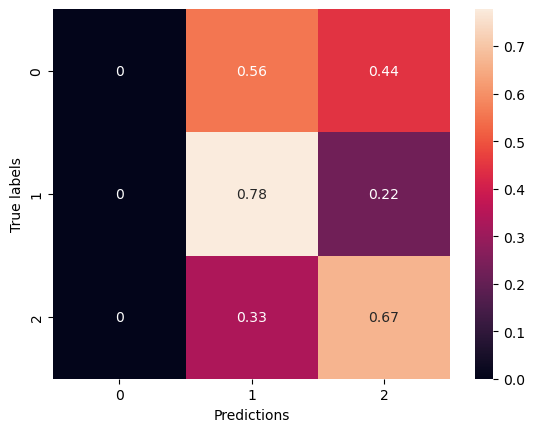

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▃▃▃▃▄▄▄▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇██▇▇████████
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▁▂▃▂▂▃▆▆▄▆▇▇▇▇█▇▇▆▇▇██▇▇▇▇▇▅█▆▆▇▅▆
val_loss,█▇▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:24:43.901374: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:24:43.903023: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:24:43.905004: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:24:45.511984: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:24:45.513833: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:24:45.515864: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:24:49.680786: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:24:50.261630: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 11.0151 - accuracy: 0.4018

2024-03-12 17:24:53.972116: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:24:53.973722: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:24:53.976035: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 800ms/step - loss: 11.0151 - accuracy: 0.4018 - val_loss: 10.6198 - val_accuracy: 0.1574
Epoch 2/100
4/4 [==============================] - 1s 286ms/step - loss: 10.2855 - accuracy: 0.5753 - val_loss: 10.4102 - val_accuracy: 0.1481
Epoch 3/100
4/4 [==============================] - 1s 288ms/step - loss: 9.8319 - accuracy: 0.6416 - val_loss: 10.2144 - val_accuracy: 0.1389
Epoch 4/100
4/4 [==============================] - 1s 287ms/step - loss: 9.4676 - accuracy: 0.6781 - val_loss: 10.0435 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 291ms/step - loss: 9.0983 - accuracy: 0.6918 - val_loss: 9.8289 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 1s 288ms/step - loss: 8.7146 - accuracy: 0.7352 - val_loss: 9.5091 - val_accuracy: 0.1481
Epoch 7/100
4/4 [==============================] - 1s 291ms/step - loss: 8.3407 - accuracy: 0.7648 - val_loss: 9.2628 - val_accuracy: 0.1574
Epoch 8/100
4/4 [=

Epoch 59/100
4/4 [==============================] - 1s 288ms/step - loss: 1.4086 - accuracy: 0.9886 - val_loss: 4.4249 - val_accuracy: 0.6111
Epoch 60/100
4/4 [==============================] - 1s 288ms/step - loss: 1.4740 - accuracy: 0.9635 - val_loss: 4.2265 - val_accuracy: 0.6111
Epoch 61/100
4/4 [==============================] - 1s 287ms/step - loss: 1.3460 - accuracy: 0.9817 - val_loss: 4.1417 - val_accuracy: 0.5093
Epoch 62/100
4/4 [==============================] - 1s 312ms/step - loss: 1.3500 - accuracy: 0.9795 - val_loss: 4.1753 - val_accuracy: 0.5278
Epoch 63/100
4/4 [==============================] - 1s 290ms/step - loss: 1.3095 - accuracy: 0.9817 - val_loss: 3.9400 - val_accuracy: 0.5370
Epoch 64/100
4/4 [==============================] - 1s 285ms/step - loss: 1.2631 - accuracy: 0.9863 - val_loss: 3.9353 - val_accuracy: 0.5278
Epoch 65/100
4/4 [==============================] - 1s 285ms/step - loss: 1.2174 - accuracy: 0.9977 - val_loss: 4.0286 - val_accuracy: 0.5185
Epoch 

2024-03-12 17:26:53.183375: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:26:53.185048: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:26:53.187048: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5044729709625244 s
{'0': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '1': {'precision': 0.5833333333333334, 'recall': 0.7777777777777778, 'f1-score': 0.6666666666666666, 'support': 9}, '2': {'precision': 0.75, 'recall': 0.6666666666666666, 'f1-score': 0.7058823529411765, 'support': 9}, 'accuracy': 0.6296296296296297, 'macro avg': {'precision': 0.6349206349206349, 'recall': 0.6296296296296297, 'f1-score': 0.6241830065359477, 'support': 27}, 'weighted avg': {'precision': 0.6349206349206349, 'recall': 0.6296296296296297, 'f1-score': 0.6241830065359477, 'support': 27}}


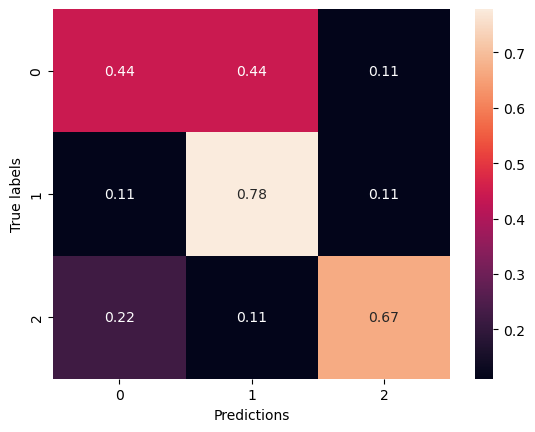

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇█████████████████████████████████
training_loss,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▃▅▄▅▅▅▄▅▅▅▇▅▇▆▆▇█▇██▆▇▆▆▅▇▆▆▆▄▆▇▇█▆▆
val_loss,██▇▆▅▅▄▄▃▃▄▃▃▃▂▂▁▂▂▁▁▁▁▂▁▁▂▂▃▂▁▁▁▃▁▁▁▁▂▂


Epoch 1/100


2024-03-12 17:27:17.352614: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:27:17.354350: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:27:17.358297: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:27:18.970677: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:27:18.973309: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:27:18.975077: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:27:24.082681: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:27:24.663881: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 48.3527 - accuracy: 0.3356

2024-03-12 17:27:28.364337: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:27:28.366464: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:27:28.368101: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 794ms/step - loss: 48.3527 - accuracy: 0.3356 - val_loss: 45.2849 - val_accuracy: 0.2870
Epoch 2/100
4/4 [==============================] - 1s 287ms/step - loss: 44.1794 - accuracy: 0.5525 - val_loss: 41.8095 - val_accuracy: 0.1667
Epoch 3/100
4/4 [==============================] - 1s 290ms/step - loss: 40.3533 - accuracy: 0.5936 - val_loss: 38.4631 - val_accuracy: 0.1759
Epoch 4/100
4/4 [==============================] - 1s 287ms/step - loss: 36.8302 - accuracy: 0.6781 - val_loss: 35.2491 - val_accuracy: 0.1759
Epoch 5/100
4/4 [==============================] - 1s 285ms/step - loss: 33.6412 - accuracy: 0.6781 - val_loss: 32.2616 - val_accuracy: 0.1852
Epoch 6/100
4/4 [==============================] - 1s 288ms/step - loss: 30.5530 - accuracy: 0.7626 - val_loss: 29.5352 - val_accuracy: 0.1574
Epoch 7/100
4/4 [==============================] - 1s 289ms/step - loss: 27.6711 - accuracy: 0.7900 - val_loss: 27.0310 - val_accuracy: 0.1481
Epoch 8/10

4/4 [==============================] - 1s 289ms/step - loss: 1.3276 - accuracy: 0.9795 - val_loss: 5.0814 - val_accuracy: 0.3981
Epoch 59/100
4/4 [==============================] - 1s 289ms/step - loss: 1.2935 - accuracy: 0.9749 - val_loss: 4.3367 - val_accuracy: 0.4722
Epoch 60/100
4/4 [==============================] - 1s 289ms/step - loss: 1.2324 - accuracy: 0.9840 - val_loss: 3.7179 - val_accuracy: 0.5185
Epoch 61/100
4/4 [==============================] - 1s 296ms/step - loss: 1.2069 - accuracy: 0.9840 - val_loss: 3.8428 - val_accuracy: 0.5370
Epoch 62/100
4/4 [==============================] - 1s 290ms/step - loss: 1.1987 - accuracy: 0.9658 - val_loss: 3.6558 - val_accuracy: 0.5741
Epoch 63/100
4/4 [==============================] - 1s 290ms/step - loss: 1.1524 - accuracy: 0.9772 - val_loss: 3.7777 - val_accuracy: 0.5741
Epoch 64/100
4/4 [==============================] - 1s 292ms/step - loss: 1.1213 - accuracy: 0.9795 - val_loss: 3.7587 - val_accuracy: 0.5833
Epoch 65/100
4/4 [=

wandb: Network error (ConnectTimeout), entering retry loop.


4/4 [==============================] - 1s 292ms/step - loss: 0.9396 - accuracy: 0.9726 - val_loss: 4.6777 - val_accuracy: 0.4074
Epoch 83/100
4/4 [==============================] - 1s 310ms/step - loss: 0.8890 - accuracy: 0.9817 - val_loss: 4.6550 - val_accuracy: 0.4444
Epoch 84/100
4/4 [==============================] - 1s 292ms/step - loss: 0.8949 - accuracy: 0.9726 - val_loss: 4.6337 - val_accuracy: 0.4167
Epoch 85/100
4/4 [==============================] - 1s 295ms/step - loss: 0.9216 - accuracy: 0.9703 - val_loss: 4.0458 - val_accuracy: 0.4722
Epoch 86/100
4/4 [==============================] - 1s 288ms/step - loss: 0.8849 - accuracy: 0.9703 - val_loss: 4.1809 - val_accuracy: 0.4907
Epoch 87/100
4/4 [==============================] - 1s 292ms/step - loss: 0.8482 - accuracy: 0.9817 - val_loss: 3.8319 - val_accuracy: 0.5556
Epoch 88/100
4/4 [==============================] - 1s 288ms/step - loss: 0.8501 - accuracy: 0.9817 - val_loss: 3.5768 - val_accuracy: 0.5833
Epoch 89/100
4/4 [=

2024-03-12 17:29:28.954529: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:29:28.956171: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:29:28.958270: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.490231990814209 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3, 'recall': 0.6666666666666666, 'f1-score': 0.41379310344827586, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.2904761904761905, 'recall': 0.3703703703703704, 'f1-score': 0.30459770114942525, 'support': 27}, 'weighted avg': {'precision': 0.29047619047619044, 'recall': 0.37037037037037035, 'f1-score': 0.30459770114942525, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


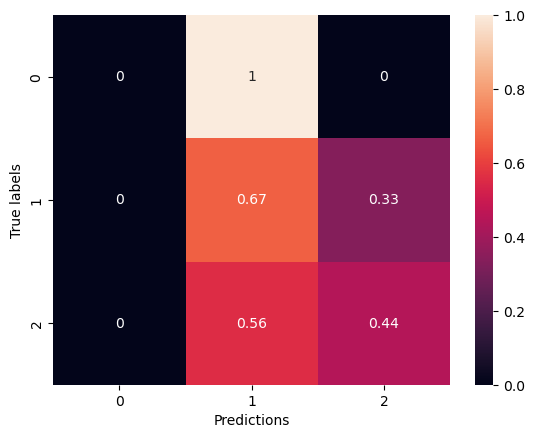

wandb: Network error (ReadTimeout), entering retry loop.
wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▇██▇██▇█▇█████████████████████████
training_loss,█▇▅▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▁▂▃▆▆▄▇▆▆▇▇▇▅▅▆███▅▇▆▇█▇▇▇▇▆█▅▅▇▇▇▇█▆
val_loss,█▇▅▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:30:37.047977: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:30:37.049790: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:30:37.051865: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:30:38.684259: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:30:38.686078: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:30:38.688041: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:30:42.859975: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:30:43.438849: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 66.6550 - accuracy: 0.3881

2024-03-12 17:30:47.174591: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:30:47.176834: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:30:47.178229: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 820ms/step - loss: 66.6550 - accuracy: 0.3881 - val_loss: 62.2008 - val_accuracy: 0.1574
Epoch 2/100
4/4 [==============================] - 1s 296ms/step - loss: 60.2233 - accuracy: 0.5594 - val_loss: 56.7377 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 286ms/step - loss: 54.4495 - accuracy: 0.6164 - val_loss: 51.4449 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 1s 294ms/step - loss: 48.9894 - accuracy: 0.6941 - val_loss: 46.4513 - val_accuracy: 0.1296
Epoch 5/100
4/4 [==============================] - 1s 291ms/step - loss: 44.1004 - accuracy: 0.7146 - val_loss: 41.8533 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 1s 289ms/step - loss: 39.4677 - accuracy: 0.7854 - val_loss: 37.7167 - val_accuracy: 0.1296
Epoch 7/100
4/4 [==============================] - 1s 289ms/step - loss: 35.3833 - accuracy: 0.7603 - val_loss: 33.7895 - val_accuracy: 0.1296
Epoch 8/10

4/4 [==============================] - 1s 296ms/step - loss: 1.2320 - accuracy: 0.9726 - val_loss: 5.6584 - val_accuracy: 0.3981
Epoch 59/100
4/4 [==============================] - 1s 291ms/step - loss: 1.2840 - accuracy: 0.9612 - val_loss: 4.2964 - val_accuracy: 0.4444
Epoch 60/100
4/4 [==============================] - 1s 288ms/step - loss: 1.1708 - accuracy: 0.9817 - val_loss: 3.7668 - val_accuracy: 0.5370
Epoch 61/100
4/4 [==============================] - 1s 291ms/step - loss: 1.2261 - accuracy: 0.9521 - val_loss: 4.0468 - val_accuracy: 0.5093
Epoch 62/100
4/4 [==============================] - 1s 293ms/step - loss: 1.2042 - accuracy: 0.9521 - val_loss: 3.8414 - val_accuracy: 0.5463
Epoch 63/100
4/4 [==============================] - 2s 398ms/step - loss: 1.1398 - accuracy: 0.9772 - val_loss: 4.6459 - val_accuracy: 0.4537
Epoch 64/100
4/4 [==============================] - 1s 306ms/step - loss: 1.1171 - accuracy: 0.9749 - val_loss: 4.1072 - val_accuracy: 0.4352
Epoch 65/100
4/4 [=

2024-03-12 17:32:47.871908: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:32:47.873444: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:32:47.875321: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.492464303970337 s
{'0': {'precision': 0.42105263157894735, 'recall': 0.8888888888888888, 'f1-score': 0.5714285714285714, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '2': {'precision': 0.7142857142857143, 'recall': 0.5555555555555556, 'f1-score': 0.6250000000000001, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.711779448621554, 'recall': 0.5185185185185185, 'f1-score': 0.46547619047619043, 'support': 27}, 'weighted avg': {'precision': 0.7117794486215538, 'recall': 0.5185185185185185, 'f1-score': 0.4654761904761905, 'support': 27}}


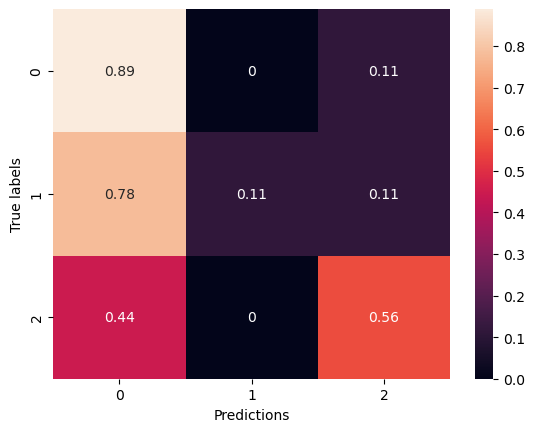

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▆▇▇▇██▇▇▇███████████████████████████
training_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▃▃▄▅▅▅▅▆▆▃▅▅▅▇▇█▇▆▆▅▆▅▆▆▇▇▆▇▅▅▇▇▆▇▇▃
val_loss,█▇▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:33:12.566959: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:33:12.569020: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:33:12.570601: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:33:14.188294: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:33:14.190398: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:33:14.192197: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:33:18.332443: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:33:18.913911: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 11.2417 - accuracy: 0.3607

2024-03-12 17:33:22.642814: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:33:22.644613: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:33:22.646796: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 799ms/step - loss: 11.2417 - accuracy: 0.3607 - val_loss: 10.5564 - val_accuracy: 0.1759
Epoch 2/100
4/4 [==============================] - 1s 288ms/step - loss: 10.6876 - accuracy: 0.4635 - val_loss: 10.4816 - val_accuracy: 0.1481
Epoch 3/100
4/4 [==============================] - 1s 290ms/step - loss: 10.3901 - accuracy: 0.4566 - val_loss: 10.3450 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 288ms/step - loss: 10.0357 - accuracy: 0.4749 - val_loss: 10.2783 - val_accuracy: 0.1111
Epoch 5/100
4/4 [==============================] - 1s 287ms/step - loss: 9.7351 - accuracy: 0.5571 - val_loss: 10.2376 - val_accuracy: 0.1111
Epoch 6/100
4/4 [==============================] - 1s 287ms/step - loss: 9.4264 - accuracy: 0.5639 - val_loss: 10.2179 - val_accuracy: 0.1111
Epoch 7/100
4/4 [==============================] - 1s 286ms/step - loss: 9.1527 - accuracy: 0.6027 - val_loss: 10.1828 - val_accuracy: 0.1111
Epoch 8/100
4

Epoch 59/100
4/4 [==============================] - 1s 290ms/step - loss: 2.1992 - accuracy: 0.9726 - val_loss: 6.4843 - val_accuracy: 0.4907
Epoch 60/100
4/4 [==============================] - 1s 287ms/step - loss: 2.1436 - accuracy: 0.9726 - val_loss: 5.6852 - val_accuracy: 0.5463
Epoch 61/100
4/4 [==============================] - 1s 286ms/step - loss: 2.1042 - accuracy: 0.9772 - val_loss: 4.9964 - val_accuracy: 0.6019
Epoch 62/100
4/4 [==============================] - 1s 289ms/step - loss: 2.0508 - accuracy: 0.9772 - val_loss: 4.9920 - val_accuracy: 0.6111
Epoch 63/100
4/4 [==============================] - 1s 291ms/step - loss: 1.9888 - accuracy: 0.9795 - val_loss: 5.0589 - val_accuracy: 0.6019
Epoch 64/100
4/4 [==============================] - 1s 288ms/step - loss: 1.9553 - accuracy: 0.9795 - val_loss: 5.1553 - val_accuracy: 0.5648
Epoch 65/100
4/4 [==============================] - 1s 286ms/step - loss: 1.9016 - accuracy: 0.9795 - val_loss: 5.3201 - val_accuracy: 0.5833
Epoch 

2024-03-12 17:35:21.607201: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:35:21.609042: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:35:21.610947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.498222827911377 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, '2': {'precision': 0.8, 'recall': 0.8888888888888888, 'f1-score': 0.8421052631578948, 'support': 9}, 'accuracy': 0.6296296296296297, 'macro avg': {'precision': 0.7666666666666666, 'recall': 0.6296296296296297, 'f1-score': 0.5607017543859649, 'support': 27}, 'weighted avg': {'precision': 0.7666666666666666, 'recall': 0.6296296296296297, 'f1-score': 0.5607017543859649, 'support': 27}}


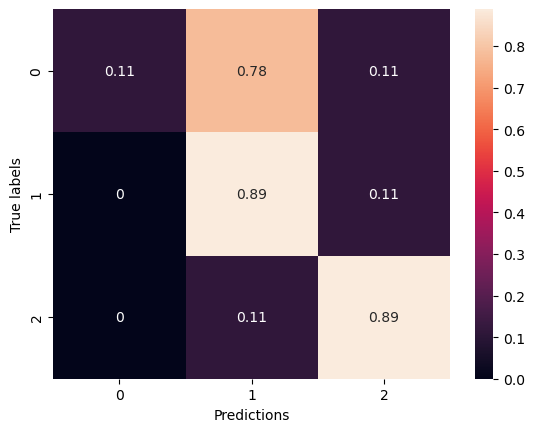

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▅▅▅▆▆▇▇▇▇▇██████████████████████████
training_loss,█▇▇▆▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▂▂▂▄▅▅▇▇▆▇▇▇▇▇▇▇▆▆▇▆█▇██▇███▇██▇▆▇▇▆
val_loss,███▇▇▆▆▅▄▄▃▃▃▃▃▂▂▂▂▃▃▃▃▃▁▂▂▁▁▂▁▁▁▁▁▁▂▂▁▂


Epoch 1/100


2024-03-12 17:35:45.202347: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:35:45.204396: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:35:45.205968: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:35:46.819524: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:35:46.821759: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:35:46.823622: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:35:52.006989: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:35:52.588374: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 48.6841 - accuracy: 0.3082

2024-03-12 17:35:56.331788: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:35:56.333471: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:35:56.335420: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 816ms/step - loss: 48.6841 - accuracy: 0.3082 - val_loss: 45.6110 - val_accuracy: 0.1759
Epoch 2/100
4/4 [==============================] - 1s 284ms/step - loss: 44.8286 - accuracy: 0.4384 - val_loss: 42.3865 - val_accuracy: 0.1296
Epoch 3/100
4/4 [==============================] - 1s 291ms/step - loss: 41.3650 - accuracy: 0.5068 - val_loss: 39.2858 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 1s 288ms/step - loss: 38.1208 - accuracy: 0.5411 - val_loss: 36.3090 - val_accuracy: 0.1111
Epoch 5/100
4/4 [==============================] - 1s 293ms/step - loss: 35.1057 - accuracy: 0.5959 - val_loss: 33.5653 - val_accuracy: 0.1019
Epoch 6/100
4/4 [==============================] - 1s 287ms/step - loss: 32.3017 - accuracy: 0.6073 - val_loss: 31.0638 - val_accuracy: 0.1111
Epoch 7/100
4/4 [==============================] - 1s 287ms/step - loss: 29.6594 - accuracy: 0.6301 - val_loss: 28.7668 - val_accuracy: 0.1019
Epoch 8/10

4/4 [==============================] - 1s 291ms/step - loss: 1.5346 - accuracy: 0.9795 - val_loss: 4.5559 - val_accuracy: 0.5926
Epoch 59/100
4/4 [==============================] - 1s 287ms/step - loss: 1.5516 - accuracy: 0.9658 - val_loss: 4.1724 - val_accuracy: 0.5741
Epoch 60/100
4/4 [==============================] - 1s 289ms/step - loss: 1.4752 - accuracy: 0.9658 - val_loss: 4.1507 - val_accuracy: 0.6389
Epoch 61/100
4/4 [==============================] - 1s 288ms/step - loss: 1.4360 - accuracy: 0.9749 - val_loss: 4.3254 - val_accuracy: 0.5833
Epoch 62/100
4/4 [==============================] - 1s 293ms/step - loss: 1.4611 - accuracy: 0.9566 - val_loss: 4.0927 - val_accuracy: 0.5926
Epoch 63/100
4/4 [==============================] - 1s 319ms/step - loss: 1.3780 - accuracy: 0.9749 - val_loss: 4.3016 - val_accuracy: 0.5926
Epoch 64/100
4/4 [==============================] - 1s 289ms/step - loss: 1.4317 - accuracy: 0.9521 - val_loss: 6.0059 - val_accuracy: 0.3519
Epoch 65/100
4/4 [=

2024-03-12 17:37:55.352974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:37:55.355509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:37:55.357086: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4815521240234375 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.8888888888888888, 'f1-score': 0.6956521739130435, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.35714285714285715, 'recall': 0.5185185185185185, 'f1-score': 0.42236024844720504, 'support': 27}, 'weighted avg': {'precision': 0.35714285714285715, 'recall': 0.5185185185185185, 'f1-score': 0.42236024844720493, 'support': 27}}


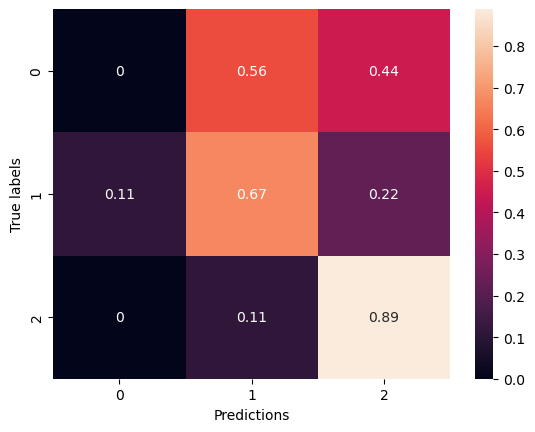

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▅▆▆▇▆▇▇▇████▇██████████▇█████████▇█
training_loss,█▇▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▂▂▃▄▅▅▄▅▆▆▆██▅▆▅▆▇▇▇▄▄▆▆▇▇▆▆▇▇▆▅▅▆▇
val_loss,█▇▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:38:16.260927: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:38:16.262849: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:38:16.264572: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:38:17.881614: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:38:17.883420: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:38:17.885523: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:38:22.024498: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:38:22.603242: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 67.3928 - accuracy: 0.3333

2024-03-12 17:38:26.285792: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:38:26.287597: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:38:26.289771: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 800ms/step - loss: 67.3928 - accuracy: 0.3333 - val_loss: 62.8643 - val_accuracy: 0.2037
Epoch 2/100
4/4 [==============================] - 1s 290ms/step - loss: 61.4754 - accuracy: 0.4452 - val_loss: 57.7627 - val_accuracy: 0.1389
Epoch 3/100
4/4 [==============================] - 1s 291ms/step - loss: 56.2436 - accuracy: 0.4886 - val_loss: 52.9389 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 1s 285ms/step - loss: 51.2342 - accuracy: 0.5342 - val_loss: 48.3691 - val_accuracy: 0.1111
Epoch 5/100
4/4 [==============================] - 1s 290ms/step - loss: 46.7833 - accuracy: 0.5365 - val_loss: 44.1033 - val_accuracy: 0.1019
Epoch 6/100
4/4 [==============================] - 1s 289ms/step - loss: 42.4634 - accuracy: 0.5982 - val_loss: 40.1964 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 292ms/step - loss: 38.5622 - accuracy: 0.6210 - val_loss: 36.6894 - val_accuracy: 0.1111
Epoch 8/10

4/4 [==============================] - 1s 292ms/step - loss: 1.6413 - accuracy: 0.9498 - val_loss: 4.2526 - val_accuracy: 0.5556
Epoch 59/100
4/4 [==============================] - 1s 290ms/step - loss: 1.5705 - accuracy: 0.9703 - val_loss: 4.2355 - val_accuracy: 0.6111
Epoch 60/100
4/4 [==============================] - 1s 293ms/step - loss: 1.5804 - accuracy: 0.9475 - val_loss: 4.0993 - val_accuracy: 0.5833
Epoch 61/100
4/4 [==============================] - 1s 289ms/step - loss: 1.5724 - accuracy: 0.9612 - val_loss: 4.0030 - val_accuracy: 0.5648
Epoch 62/100
4/4 [==============================] - 1s 288ms/step - loss: 1.5534 - accuracy: 0.9429 - val_loss: 4.4259 - val_accuracy: 0.5185
Epoch 63/100
4/4 [==============================] - 1s 285ms/step - loss: 1.4878 - accuracy: 0.9612 - val_loss: 4.7737 - val_accuracy: 0.4630
Epoch 64/100
4/4 [==============================] - 1s 289ms/step - loss: 1.5754 - accuracy: 0.9338 - val_loss: 5.1564 - val_accuracy: 0.3889
Epoch 65/100
4/4 [=

2024-03-12 17:40:26.892623: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:40:26.894349: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:40:26.896370: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.492285966873169 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.3333333333333333, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.391304347826087, 'recall': 1.0, 'f1-score': 0.5625, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.463768115942029, 'recall': 0.4444444444444444, 'f1-score': 0.3541666666666667, 'support': 27}, 'weighted avg': {'precision': 0.463768115942029, 'recall': 0.4444444444444444, 'f1-score': 0.3541666666666667, 'support': 27}}


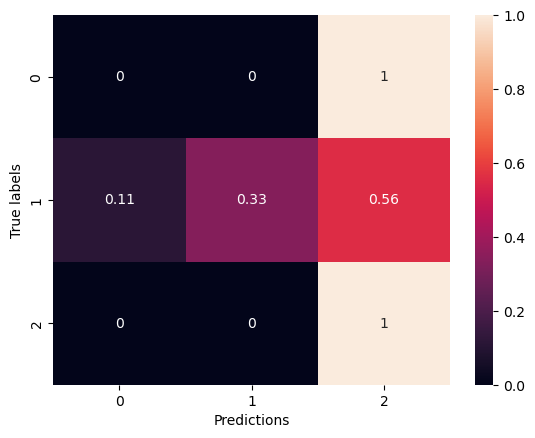

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▅▅▆▆▇▇▇▇▇▇▇█▇███████▇█████████▇████
training_loss,█▇▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▄▃▆▄▇▇▇▇▇▆▇█▄▆▆▇▆█▇▅█▇▅▆▆▆▇▆▆▆▆█▆█
val_loss,█▇▅▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:40:49.441231: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:40:49.443021: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:40:49.445018: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:40:52.113075: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:40:52.115221: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:40:52.117400: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:40:56.299189: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:40:56.881787: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 11.3119 - accuracy: 0.3082

2024-03-12 17:41:00.595730: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:41:00.597895: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:41:00.599699: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 801ms/step - loss: 11.3119 - accuracy: 0.3082 - val_loss: 10.6311 - val_accuracy: 0.1852
Epoch 2/100
4/4 [==============================] - 1s 291ms/step - loss: 10.8810 - accuracy: 0.3790 - val_loss: 10.4378 - val_accuracy: 0.1944
Epoch 3/100
4/4 [==============================] - 1s 291ms/step - loss: 10.5513 - accuracy: 0.4132 - val_loss: 10.3584 - val_accuracy: 0.1389
Epoch 4/100
4/4 [==============================] - 1s 294ms/step - loss: 10.2167 - accuracy: 0.4543 - val_loss: 10.2758 - val_accuracy: 0.1296
Epoch 5/100
4/4 [==============================] - 1s 292ms/step - loss: 10.0747 - accuracy: 0.4429 - val_loss: 10.1577 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 291ms/step - loss: 9.9752 - accuracy: 0.4110 - val_loss: 10.0968 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 291ms/step - loss: 9.6409 - accuracy: 0.4589 - val_loss: 10.0714 - val_accuracy: 0.1204
Epoch 8/100


Epoch 59/100
4/4 [==============================] - 1s 286ms/step - loss: 3.3940 - accuracy: 0.8037 - val_loss: 5.0793 - val_accuracy: 0.6019
Epoch 60/100
4/4 [==============================] - 1s 289ms/step - loss: 3.3219 - accuracy: 0.8242 - val_loss: 5.3805 - val_accuracy: 0.5463
Epoch 61/100
4/4 [==============================] - 1s 292ms/step - loss: 3.2628 - accuracy: 0.8151 - val_loss: 6.3096 - val_accuracy: 0.4352
Epoch 62/100
4/4 [==============================] - 1s 288ms/step - loss: 3.2099 - accuracy: 0.8311 - val_loss: 4.9201 - val_accuracy: 0.5833
Epoch 63/100
4/4 [==============================] - 1s 291ms/step - loss: 3.1941 - accuracy: 0.8333 - val_loss: 4.8441 - val_accuracy: 0.6111
Epoch 64/100
4/4 [==============================] - 1s 291ms/step - loss: 3.0805 - accuracy: 0.8562 - val_loss: 4.9242 - val_accuracy: 0.5648
Epoch 65/100
4/4 [==============================] - 1s 293ms/step - loss: 3.0248 - accuracy: 0.8447 - val_loss: 4.9453 - val_accuracy: 0.6111
Epoch 

2024-03-12 17:43:01.073635: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:43:01.075459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:43:01.077260: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4937329292297363 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.375, 'recall': 0.3333333333333333, 'f1-score': 0.35294117647058826, 'support': 9}, '2': {'precision': 0.47058823529411764, 'recall': 0.8888888888888888, 'f1-score': 0.6153846153846153, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.2818627450980392, 'recall': 0.4074074074074074, 'f1-score': 0.3227752639517345, 'support': 27}, 'weighted avg': {'precision': 0.2818627450980392, 'recall': 0.4074074074074074, 'f1-score': 0.3227752639517345, 'support': 27}}


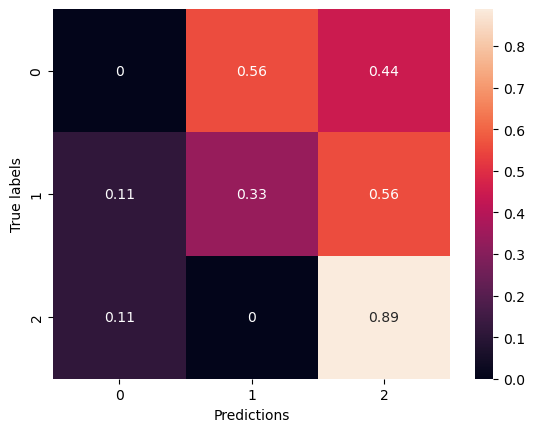

wandb: Network error (ConnectionError), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▃▄▄▄▅▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▆▇▇▇▇█████████
training_loss,█▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▁▁▁▁▃▃▂▅▃▅▅▃▅▆▆▆▇▇▅▇▇▇▇▆▇▇▆▇▇▇▅██▇
val_loss,██▇▇▇▇▇▆▇▆▅▅▅▄▅▃▃▅▃▂▃▃▂▂▃▂▂▂▂▃▂▂▂▂▂▂▃▁▂▁


Epoch 1/100


2024-03-12 17:45:36.197238: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:45:36.199895: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:45:36.201799: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:45:37.821140: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:45:37.822923: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:45:37.825213: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:45:41.979346: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:45:43.497530: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 48.7511 - accuracy: 0.3242

2024-03-12 17:45:47.314789: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:45:47.317359: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:45:47.319345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 842ms/step - loss: 48.7511 - accuracy: 0.3242 - val_loss: 45.7749 - val_accuracy: 0.2037
Epoch 2/100
4/4 [==============================] - 1s 289ms/step - loss: 45.2021 - accuracy: 0.3425 - val_loss: 42.7167 - val_accuracy: 0.1574
Epoch 3/100
4/4 [==============================] - 1s 300ms/step - loss: 42.1622 - accuracy: 0.4064 - val_loss: 39.8495 - val_accuracy: 0.1667
Epoch 4/100
4/4 [==============================] - 1s 292ms/step - loss: 39.0968 - accuracy: 0.4269 - val_loss: 37.1605 - val_accuracy: 0.1481
Epoch 5/100
4/4 [==============================] - 1s 285ms/step - loss: 36.4475 - accuracy: 0.4315 - val_loss: 34.5868 - val_accuracy: 0.1481
Epoch 6/100
4/4 [==============================] - 1s 285ms/step - loss: 34.0101 - accuracy: 0.3607 - val_loss: 32.1919 - val_accuracy: 0.1759
Epoch 7/100
4/4 [==============================] - 1s 289ms/step - loss: 31.4573 - accuracy: 0.4406 - val_loss: 29.9880 - val_accuracy: 0.1667
Epoch 8/10

4/4 [==============================] - 1s 362ms/step - loss: 2.2313 - accuracy: 0.9178 - val_loss: 5.3344 - val_accuracy: 0.4444
Epoch 59/100
4/4 [==============================] - 1s 334ms/step - loss: 2.2275 - accuracy: 0.8927 - val_loss: 4.7275 - val_accuracy: 0.4537
Epoch 60/100
4/4 [==============================] - 1s 306ms/step - loss: 2.1507 - accuracy: 0.8973 - val_loss: 4.5041 - val_accuracy: 0.5370
Epoch 61/100
4/4 [==============================] - 1s 296ms/step - loss: 2.1144 - accuracy: 0.9064 - val_loss: 4.1877 - val_accuracy: 0.6019
Epoch 62/100
4/4 [==============================] - 1s 298ms/step - loss: 1.9859 - accuracy: 0.9292 - val_loss: 4.1279 - val_accuracy: 0.5926
Epoch 63/100
4/4 [==============================] - 1s 294ms/step - loss: 1.9514 - accuracy: 0.9132 - val_loss: 4.5962 - val_accuracy: 0.5926
Epoch 64/100
4/4 [==============================] - 1s 294ms/step - loss: 1.8791 - accuracy: 0.9429 - val_loss: 5.0884 - val_accuracy: 0.5741
Epoch 65/100
4/4 [=

2024-03-12 17:47:53.953331: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:47:53.955641: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:47:53.957336: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5230257511138916 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.8888888888888888, 'f1-score': 0.5925925925925926, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.2962962962962963, 'recall': 0.4444444444444444, 'f1-score': 0.345679012345679, 'support': 27}, 'weighted avg': {'precision': 0.2962962962962963, 'recall': 0.4444444444444444, 'f1-score': 0.345679012345679, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


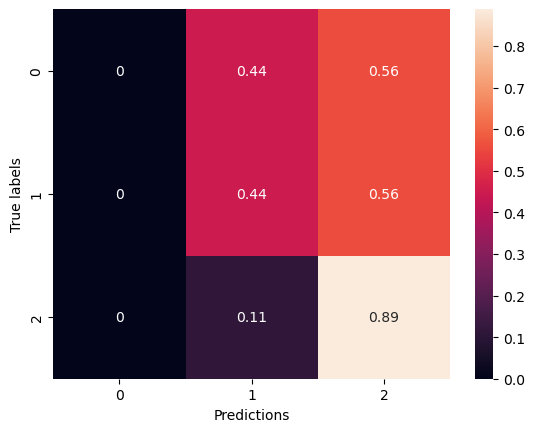

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▁▂▃▃▃▃▄▄▅▅▅▆▅▆▆▆▇▇▇▇▇▇▇█▇▇▇███████████
training_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▂▅▂▃▄▅▂▅▅█▆▇▇▇▇▇▇▅█▇▃▆█▇▅██▇▇▆▇▇█▇
val_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:48:24.876465: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:48:24.879004: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:48:24.880768: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:48:26.482294: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:48:26.484502: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:48:26.486264: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:48:30.609467: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:48:31.190662: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 67.2803 - accuracy: 0.3082

2024-03-12 17:48:34.921879: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:48:34.923530: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:48:34.925542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 797ms/step - loss: 67.2803 - accuracy: 0.3082 - val_loss: 62.8394 - val_accuracy: 0.1481
Epoch 2/100
4/4 [==============================] - 1s 290ms/step - loss: 61.5665 - accuracy: 0.3836 - val_loss: 57.7948 - val_accuracy: 0.1481
Epoch 3/100
4/4 [==============================] - 1s 290ms/step - loss: 56.5247 - accuracy: 0.3790 - val_loss: 53.1019 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 1s 287ms/step - loss: 51.7082 - accuracy: 0.4361 - val_loss: 48.7493 - val_accuracy: 0.1111
Epoch 5/100
4/4 [==============================] - 1s 286ms/step - loss: 47.4445 - accuracy: 0.3927 - val_loss: 44.7448 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 1s 290ms/step - loss: 43.4205 - accuracy: 0.4155 - val_loss: 41.0703 - val_accuracy: 0.1389
Epoch 7/100
4/4 [==============================] - 1s 291ms/step - loss: 39.7305 - accuracy: 0.4566 - val_loss: 37.6792 - val_accuracy: 0.1389
Epoch 8/10

4/4 [==============================] - 1s 306ms/step - loss: 2.0932 - accuracy: 0.9155 - val_loss: 5.5532 - val_accuracy: 0.3796
Epoch 59/100
4/4 [==============================] - 1s 285ms/step - loss: 2.0682 - accuracy: 0.9087 - val_loss: 5.0976 - val_accuracy: 0.4537
Epoch 60/100
4/4 [==============================] - 1s 285ms/step - loss: 2.0111 - accuracy: 0.9155 - val_loss: 4.2838 - val_accuracy: 0.5648
Epoch 61/100
4/4 [==============================] - 1s 334ms/step - loss: 1.8816 - accuracy: 0.9521 - val_loss: 4.5960 - val_accuracy: 0.5185
Epoch 62/100
4/4 [==============================] - 1s 316ms/step - loss: 1.8552 - accuracy: 0.9315 - val_loss: 4.1118 - val_accuracy: 0.5926
Epoch 63/100
4/4 [==============================] - 1s 297ms/step - loss: 1.7885 - accuracy: 0.9498 - val_loss: 4.4133 - val_accuracy: 0.5093
Epoch 64/100
4/4 [==============================] - 1s 290ms/step - loss: 1.8184 - accuracy: 0.9315 - val_loss: 5.6037 - val_accuracy: 0.4259
Epoch 65/100
4/4 [=

2024-03-12 17:50:34.534826: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:50:34.536624: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:50:34.538875: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.504770040512085 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '2': {'precision': 0.5294117647058824, 'recall': 1.0, 'f1-score': 0.6923076923076924, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5764705882352942, 'recall': 0.5555555555555555, 'f1-score': 0.5164835164835165, 'support': 27}, 'weighted avg': {'precision': 0.5764705882352941, 'recall': 0.5555555555555556, 'f1-score': 0.5164835164835165, 'support': 27}}


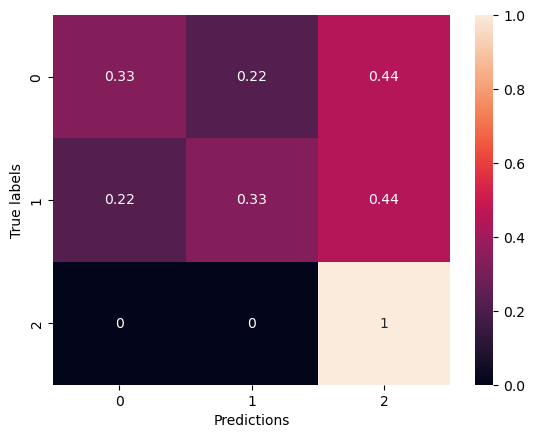

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▃▄▅▄▅▅▅▆▆▆▇▇▇▇▇▇▇▇███████▇████▇▇██
training_loss,█▇▅▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▂▂▃▄▄▅▆▅▇▆▅▅▅▆▆▆▄▆▇▅▅▇█▇▄▇▄▅▆███▆█
val_loss,█▇▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:50:59.414310: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:50:59.416756: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:50:59.418563: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:51:02.072207: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:51:02.073930: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:51:02.076449: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:51:06.206248: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:51:06.786056: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 7.6990 - accuracy: 0.3174 

2024-03-12 17:51:09.851697: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:51:09.853900: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:51:09.855413: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 7.6990 - accuracy: 0.3174 - val_loss: 6.8883 - val_accuracy: 0.3796
Epoch 2/100
2/2 [==============================] - 1s 262ms/step - loss: 7.1383 - accuracy: 0.4658 - val_loss: 6.8876 - val_accuracy: 0.2407
Epoch 3/100
2/2 [==============================] - 1s 269ms/step - loss: 6.8226 - accuracy: 0.5365 - val_loss: 6.8804 - val_accuracy: 0.1574
Epoch 4/100
2/2 [==============================] - 1s 269ms/step - loss: 6.6368 - accuracy: 0.5776 - val_loss: 6.8645 - val_accuracy: 0.1574
Epoch 5/100
2/2 [==============================] - 1s 268ms/step - loss: 6.5108 - accuracy: 0.5799 - val_loss: 6.8321 - val_accuracy: 0.1481
Epoch 6/100
2/2 [==============================] - 1s 268ms/step - loss: 6.2736 - accuracy: 0.6416 - val_loss: 6.7851 - val_accuracy: 0.1389
Epoch 7/100
2/2 [==============================] - 1s 265ms/step - loss: 6.1984 - accuracy: 0.6301 - val_loss: 6.7354 - val_accuracy: 0.1296
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 269ms/step - loss: 2.1791 - accuracy: 0.9932 - val_loss: 3.9272 - val_accuracy: 0.5463
Epoch 60/100
2/2 [==============================] - 1s 269ms/step - loss: 2.1487 - accuracy: 0.9863 - val_loss: 3.8473 - val_accuracy: 0.5556
Epoch 61/100
2/2 [==============================] - 1s 270ms/step - loss: 2.1127 - accuracy: 0.9909 - val_loss: 3.8483 - val_accuracy: 0.5556
Epoch 62/100
2/2 [==============================] - 1s 286ms/step - loss: 2.0962 - accuracy: 0.9817 - val_loss: 3.9695 - val_accuracy: 0.5278
Epoch 63/100
2/2 [==============================] - 1s 272ms/step - loss: 2.0262 - accuracy: 0.9932 - val_loss: 4.1306 - val_accuracy: 0.4815
Epoch 64/100
2/2 [==============================] - 1s 268ms/step - loss: 1.9934 - accuracy: 0.9932 - val_loss: 4.1538 - val_accuracy: 0.5000
Epoch 65/100
2/2 [==============================] - 1s 273ms/step - loss: 1.9677 - accuracy: 0.9840 - val_loss: 4.1009 - val_accuracy: 0.4815
Epoch 

2024-03-12 17:52:04.108497: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:52:04.110546: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:52:04.112139: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4939501285552979 s
{'0': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5185185185185185, 'recall': 0.5185185185185185, 'f1-score': 0.508994708994709, 'support': 27}, 'weighted avg': {'precision': 0.5185185185185185, 'recall': 0.5185185185185185, 'f1-score': 0.508994708994709, 'support': 27}}


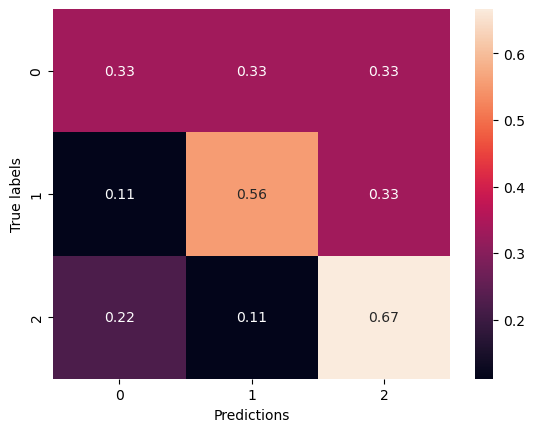

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▅▆▆▆▇▇▇▇█▇██████████████████████████
training_loss,█▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▁▁▁▁▁▃▃▃▃▄▅▅▅▅▅▆▆▅▆▇▅▆▇▇▆▇▇▆▆▇█▆▆█▇▇█▆▇
val_loss,████▇▇▆▆▆▅▅▅▄▄▄▄▃▃▄▃▃▄▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▃▂


Epoch 1/100


2024-03-12 17:52:28.334092: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:52:28.335665: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:52:28.337527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:52:29.952110: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:52:29.954285: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:52:29.956067: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:52:34.110455: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:52:34.698435: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 31.0372 - accuracy: 0.3059 

2024-03-12 17:52:38.750358: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:52:38.751955: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:52:38.753881: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 31.0372 - accuracy: 0.3059 - val_loss: 29.4630 - val_accuracy: 0.3333
Epoch 2/100
2/2 [==============================] - 1s 272ms/step - loss: 29.6085 - accuracy: 0.4018 - val_loss: 28.5605 - val_accuracy: 0.2870
Epoch 3/100
2/2 [==============================] - 1s 271ms/step - loss: 28.3611 - accuracy: 0.5274 - val_loss: 27.6710 - val_accuracy: 0.2593
Epoch 4/100
2/2 [==============================] - 1s 264ms/step - loss: 27.5176 - accuracy: 0.5297 - val_loss: 26.7974 - val_accuracy: 0.2315
Epoch 5/100
2/2 [==============================] - 1s 267ms/step - loss: 26.4658 - accuracy: 0.5708 - val_loss: 25.9338 - val_accuracy: 0.2130
Epoch 6/100
2/2 [==============================] - 1s 272ms/step - loss: 25.3774 - accuracy: 0.6438 - val_loss: 25.0793 - val_accuracy: 0.1759
Epoch 7/100
2/2 [==============================] - 1s 271ms/step - loss: 24.5268 - accuracy: 0.6256 - val_loss: 24.2385 - val_accuracy: 0.1944
Epoch 8/100
2

2/2 [==============================] - 1s 268ms/step - loss: 3.3168 - accuracy: 0.9566 - val_loss: 4.6104 - val_accuracy: 0.4815
Epoch 59/100
2/2 [==============================] - 1s 265ms/step - loss: 3.1479 - accuracy: 0.9817 - val_loss: 4.5533 - val_accuracy: 0.4815
Epoch 60/100
2/2 [==============================] - 1s 265ms/step - loss: 3.0671 - accuracy: 0.9726 - val_loss: 4.6210 - val_accuracy: 0.4444
Epoch 61/100
2/2 [==============================] - 1s 283ms/step - loss: 2.9450 - accuracy: 0.9795 - val_loss: 4.8226 - val_accuracy: 0.4444
Epoch 62/100
2/2 [==============================] - 1s 270ms/step - loss: 2.8501 - accuracy: 0.9749 - val_loss: 4.8292 - val_accuracy: 0.4259
Epoch 63/100
2/2 [==============================] - 1s 269ms/step - loss: 2.7528 - accuracy: 0.9817 - val_loss: 4.7328 - val_accuracy: 0.4352
Epoch 64/100
2/2 [==============================] - 1s 266ms/step - loss: 2.6681 - accuracy: 0.9749 - val_loss: 4.9343 - val_accuracy: 0.4167
Epoch 65/100
2/2 [=

2024-03-12 17:53:32.874710: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:53:32.876277: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:53:32.878667: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4654760360717773 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.6666666666666666, 'f1-score': 0.631578947368421, 'support': 9}, '2': {'precision': 0.5294117647058824, 'recall': 1.0, 'f1-score': 0.6923076923076924, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.3764705882352941, 'recall': 0.5555555555555555, 'f1-score': 0.44129554655870445, 'support': 27}, 'weighted avg': {'precision': 0.3764705882352941, 'recall': 0.5555555555555556, 'f1-score': 0.4412955465587045, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


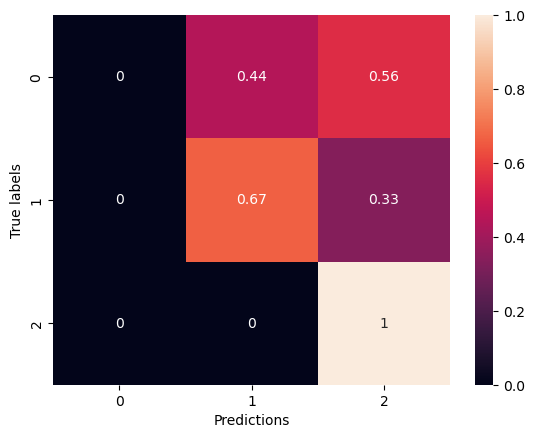

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▅▅▆▆▆▆▇▇▇██▇████████████████████████
training_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▂▁▁▂▂▃▃▃▃▃▃▄▄▄▄▄▅▄▄▄▅▆▆▅▅▄▅▄▆██▇▆▅▅▆▇▆▆
val_loss,██▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:53:57.771707: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:53:57.773332: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:53:57.775183: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:53:59.468282: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:53:59.470580: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:53:59.472517: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:54:03.679581: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:54:04.268774: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 42.3944 - accuracy: 0.3973

2024-03-12 17:54:07.380322: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:54:07.381931: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:54:07.383842: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 42.3944 - accuracy: 0.3973 - val_loss: 40.8314 - val_accuracy: 0.1296
Epoch 2/100
2/2 [==============================] - 1s 273ms/step - loss: 40.6638 - accuracy: 0.4475 - val_loss: 39.4417 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 263ms/step - loss: 39.0274 - accuracy: 0.4772 - val_loss: 38.0593 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 271ms/step - loss: 37.4448 - accuracy: 0.5845 - val_loss: 36.6782 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 271ms/step - loss: 35.9893 - accuracy: 0.5685 - val_loss: 35.3121 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 262ms/step - loss: 34.5741 - accuracy: 0.6187 - val_loss: 33.9664 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 274ms/step - loss: 33.1796 - accuracy: 0.6324 - val_loss: 32.6536 - val_accuracy: 0.1296
Epoch 8/100
2

2/2 [==============================] - 1s 277ms/step - loss: 3.5548 - accuracy: 0.9703 - val_loss: 4.8190 - val_accuracy: 0.5463
Epoch 59/100
2/2 [==============================] - 1s 273ms/step - loss: 3.4550 - accuracy: 0.9658 - val_loss: 4.7054 - val_accuracy: 0.5556
Epoch 60/100
2/2 [==============================] - 1s 269ms/step - loss: 3.2738 - accuracy: 0.9680 - val_loss: 4.5321 - val_accuracy: 0.5556
Epoch 61/100
2/2 [==============================] - 1s 274ms/step - loss: 3.1596 - accuracy: 0.9772 - val_loss: 4.4462 - val_accuracy: 0.5370
Epoch 62/100
2/2 [==============================] - 1s 270ms/step - loss: 3.0762 - accuracy: 0.9635 - val_loss: 4.3781 - val_accuracy: 0.5556
Epoch 63/100
2/2 [==============================] - 1s 286ms/step - loss: 2.9327 - accuracy: 0.9726 - val_loss: 4.3274 - val_accuracy: 0.5463
Epoch 64/100
2/2 [==============================] - 1s 267ms/step - loss: 2.8467 - accuracy: 0.9680 - val_loss: 4.3180 - val_accuracy: 0.5463
Epoch 65/100
2/2 [=

2024-03-12 17:55:01.774488: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:55:01.776870: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:55:01.778786: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4769339561462402 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, '2': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.641025641025641, 'recall': 0.48148148148148157, 'f1-score': 0.43030303030303035, 'support': 27}, 'weighted avg': {'precision': 0.641025641025641, 'recall': 0.48148148148148145, 'f1-score': 0.43030303030303035, 'support': 27}}


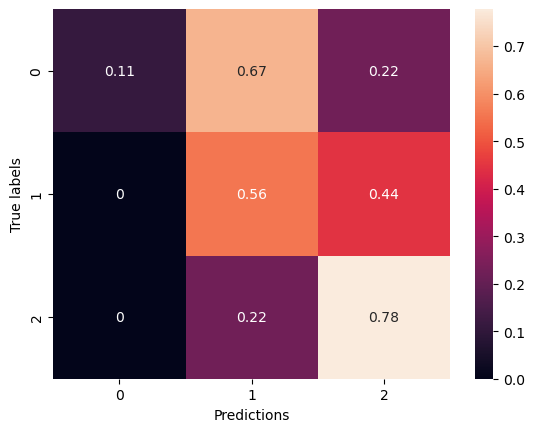

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▄▄▅▅▆▆▆▆▇▇▇▇▇█▇███████████████████████
training_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▂▂▃▄▄▄▅▅▅▆▆▇▇▆█▇▇▅█▇▇▇▆▆▅▆▇▇▆████▇▇█
val_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 17:55:22.837910: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:55:22.839562: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:55:22.841084: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:55:24.461298: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:55:24.463755: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:55:24.465512: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:55:29.675175: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:55:30.254729: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 7.5137 - accuracy: 0.3470 

2024-03-12 17:55:33.325365: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:55:33.327104: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:55:33.328946: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 7.5137 - accuracy: 0.3470 - val_loss: 6.9357 - val_accuracy: 0.2315
Epoch 2/100
2/2 [==============================] - 1s 270ms/step - loss: 7.2997 - accuracy: 0.3584 - val_loss: 6.8794 - val_accuracy: 0.1944
Epoch 3/100
2/2 [==============================] - 1s 268ms/step - loss: 7.0311 - accuracy: 0.4201 - val_loss: 6.8216 - val_accuracy: 0.1667
Epoch 4/100
2/2 [==============================] - 1s 272ms/step - loss: 6.9473 - accuracy: 0.4612 - val_loss: 6.7511 - val_accuracy: 0.1389
Epoch 5/100
2/2 [==============================] - 1s 269ms/step - loss: 6.7324 - accuracy: 0.4863 - val_loss: 6.6803 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 271ms/step - loss: 6.6537 - accuracy: 0.4749 - val_loss: 6.6111 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 264ms/step - loss: 6.6196 - accuracy: 0.5046 - val_loss: 6.5508 - val_accuracy: 0.1389
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 277ms/step - loss: 2.7538 - accuracy: 0.8973 - val_loss: 4.1433 - val_accuracy: 0.4352
Epoch 60/100
2/2 [==============================] - 1s 275ms/step - loss: 2.7017 - accuracy: 0.8995 - val_loss: 4.1851 - val_accuracy: 0.4444
Epoch 61/100
2/2 [==============================] - 1s 267ms/step - loss: 2.6273 - accuracy: 0.9132 - val_loss: 4.2292 - val_accuracy: 0.4259
Epoch 62/100
2/2 [==============================] - 1s 272ms/step - loss: 2.5804 - accuracy: 0.9110 - val_loss: 4.2505 - val_accuracy: 0.4537
Epoch 63/100
2/2 [==============================] - 1s 264ms/step - loss: 2.4930 - accuracy: 0.9452 - val_loss: 4.1686 - val_accuracy: 0.4630
Epoch 64/100
2/2 [==============================] - 1s 275ms/step - loss: 2.5324 - accuracy: 0.9338 - val_loss: 4.1311 - val_accuracy: 0.4907
Epoch 65/100
2/2 [==============================] - 1s 273ms/step - loss: 2.4240 - accuracy: 0.9429 - val_loss: 4.2073 - val_accuracy: 0.4722
Epoch 

2024-03-12 17:56:27.769459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:56:27.771399: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:56:27.773249: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5614850521087646 s
{'0': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.6666666666666666, 'f1-score': 0.631578947368421, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.604040404040404, 'recall': 0.5925925925925926, 'f1-score': 0.5883040935672513, 'support': 27}, 'weighted avg': {'precision': 0.604040404040404, 'recall': 0.5925925925925926, 'f1-score': 0.5883040935672516, 'support': 27}}


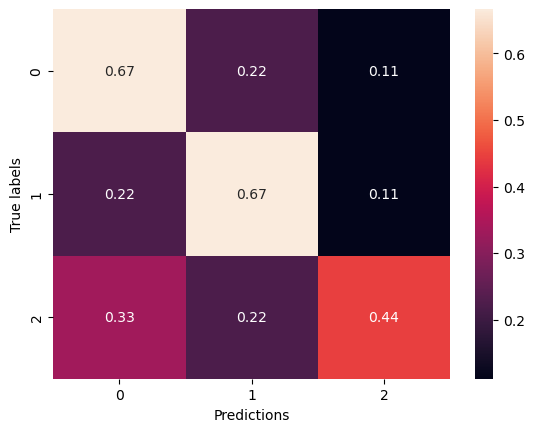

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▃▃▃▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇█▇████████████
training_loss,█▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▂▁▁▁▁▂▂▂▃▄▅▅▅▅▄▅▆▆▅▅▆▆▆▆▇▆▇▆▅▇▇▆▇▇██▆▇▇
val_loss,██▇▇▇▆▆▆▅▅▄▄▃▃▃▃▂▂▁▂▂▁▁▁▁▁▂▁▃▃▂▂▄▂▃▃▂▃▂▃


Epoch 1/100


2024-03-12 17:56:53.672158: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:56:53.674280: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:56:53.675989: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:56:55.287483: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:56:55.289288: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:56:55.291539: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 17:56:59.473029: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 17:57:00.055795: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 30.7559 - accuracy: 0.3493

2024-03-12 17:57:03.209506: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:57:03.211102: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:57:03.213394: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 30.7559 - accuracy: 0.3493 - val_loss: 29.3784 - val_accuracy: 0.4259
Epoch 2/100
2/2 [==============================] - 1s 273ms/step - loss: 29.7593 - accuracy: 0.3379 - val_loss: 28.4522 - val_accuracy: 0.2778
Epoch 3/100
2/2 [==============================] - 1s 267ms/step - loss: 28.5398 - accuracy: 0.4201 - val_loss: 27.5364 - val_accuracy: 0.2315
Epoch 4/100
2/2 [==============================] - 1s 269ms/step - loss: 27.5768 - accuracy: 0.4269 - val_loss: 26.6468 - val_accuracy: 0.2222
Epoch 5/100
2/2 [==============================] - 1s 272ms/step - loss: 26.4478 - accuracy: 0.4817 - val_loss: 25.7812 - val_accuracy: 0.1944
Epoch 6/100
2/2 [==============================] - 1s 278ms/step - loss: 25.5858 - accuracy: 0.5068 - val_loss: 24.9371 - val_accuracy: 0.1852
Epoch 7/100
2/2 [==============================] - 1s 272ms/step - loss: 24.7428 - accuracy: 0.4932 - val_loss: 24.1162 - val_accuracy: 0.1759
Epoch 8/100
2

2/2 [==============================] - 1s 280ms/step - loss: 3.6229 - accuracy: 0.8904 - val_loss: 4.5588 - val_accuracy: 0.4907
Epoch 59/100
2/2 [==============================] - 1s 274ms/step - loss: 3.4566 - accuracy: 0.9087 - val_loss: 4.4675 - val_accuracy: 0.5093
Epoch 60/100
2/2 [==============================] - 1s 275ms/step - loss: 3.3165 - accuracy: 0.9247 - val_loss: 4.3674 - val_accuracy: 0.5000
Epoch 61/100
2/2 [==============================] - 1s 275ms/step - loss: 3.1953 - accuracy: 0.9338 - val_loss: 4.3128 - val_accuracy: 0.4907
Epoch 62/100
2/2 [==============================] - 1s 273ms/step - loss: 3.1167 - accuracy: 0.9247 - val_loss: 4.3025 - val_accuracy: 0.4537
Epoch 63/100
2/2 [==============================] - 1s 267ms/step - loss: 2.9856 - accuracy: 0.9338 - val_loss: 4.1566 - val_accuracy: 0.5185
Epoch 64/100
2/2 [==============================] - 1s 279ms/step - loss: 2.9124 - accuracy: 0.9384 - val_loss: 3.9982 - val_accuracy: 0.5370
Epoch 65/100
2/2 [=

2024-03-12 17:57:59.233653: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 17:57:59.235385: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 17:57:59.237527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 2.5581398010253906 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '2': {'precision': 0.45, 'recall': 1.0, 'f1-score': 0.6206896551724138, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.65, 'recall': 0.48148148148148145, 'f1-score': 0.4068965517241379, 'support': 27}, 'weighted avg': {'precision': 0.65, 'recall': 0.48148148148148145, 'f1-score': 0.40689655172413797, 'support': 27}}


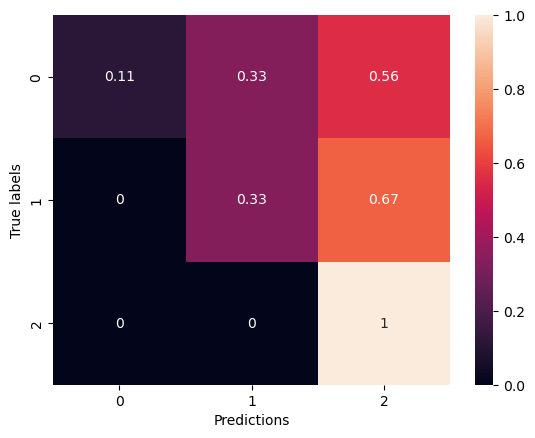

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▃▃▄▄▄▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇█▇███████████
training_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▂▁▁▁▁▂▂▂▂▃▃▂▃▂▄▄▃▃▅▅▅▆▆▆▇▆▇▇▇▆▆▄█▆▆█▇█▇
val_loss,██▇▆▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:00:37.096314: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:00:37.098426: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:00:37.100074: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:00:38.738220: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:00:38.740027: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:00:38.742310: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:00:42.998636: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:00:43.592838: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 42.1235 - accuracy: 0.3607

2024-03-12 18:00:46.782953: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:00:46.787084: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:00:46.789164: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 42.1235 - accuracy: 0.3607 - val_loss: 40.5403 - val_accuracy: 0.1389
Epoch 2/100
2/2 [==============================] - 1s 278ms/step - loss: 40.6126 - accuracy: 0.4018 - val_loss: 39.1224 - val_accuracy: 0.1389
Epoch 3/100
2/2 [==============================] - 1s 270ms/step - loss: 39.1099 - accuracy: 0.3813 - val_loss: 37.7440 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 276ms/step - loss: 37.6368 - accuracy: 0.3927 - val_loss: 36.4017 - val_accuracy: 0.1389
Epoch 5/100
2/2 [==============================] - 1s 271ms/step - loss: 36.2130 - accuracy: 0.4475 - val_loss: 35.0930 - val_accuracy: 0.1389
Epoch 6/100
2/2 [==============================] - 1s 270ms/step - loss: 34.8279 - accuracy: 0.4338 - val_loss: 33.8116 - val_accuracy: 0.1389
Epoch 7/100
2/2 [==============================] - 1s 274ms/step - loss: 33.4676 - accuracy: 0.4749 - val_loss: 32.5602 - val_accuracy: 0.1481
Epoch 8/100
2

2/2 [==============================] - 1s 279ms/step - loss: 3.9704 - accuracy: 0.9178 - val_loss: 4.9649 - val_accuracy: 0.5926
Epoch 59/100
2/2 [==============================] - 1s 277ms/step - loss: 3.8189 - accuracy: 0.9475 - val_loss: 4.9175 - val_accuracy: 0.6111
Epoch 60/100
2/2 [==============================] - 1s 288ms/step - loss: 3.6766 - accuracy: 0.9315 - val_loss: 5.0820 - val_accuracy: 0.5833
Epoch 61/100
2/2 [==============================] - 1s 276ms/step - loss: 3.5454 - accuracy: 0.9361 - val_loss: 5.0551 - val_accuracy: 0.5833
Epoch 62/100
2/2 [==============================] - 1s 278ms/step - loss: 3.4226 - accuracy: 0.9338 - val_loss: 4.6301 - val_accuracy: 0.6111
Epoch 63/100
2/2 [==============================] - 1s 279ms/step - loss: 3.2906 - accuracy: 0.9475 - val_loss: 4.6306 - val_accuracy: 0.5926
Epoch 64/100
2/2 [==============================] - 1s 276ms/step - loss: 3.1592 - accuracy: 0.9521 - val_loss: 4.8035 - val_accuracy: 0.5833
Epoch 65/100
2/2 [=

2024-03-12 18:01:42.091721: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:01:42.093270: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:01:42.095280: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5053369998931885 s
{'0': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '1': {'precision': 0.8, 'recall': 0.4444444444444444, 'f1-score': 0.5714285714285714, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6, 'recall': 0.5555555555555555, 'f1-score': 0.5502374862988674, 'support': 27}, 'weighted avg': {'precision': 0.6, 'recall': 0.5555555555555556, 'f1-score': 0.5502374862988674, 'support': 27}}


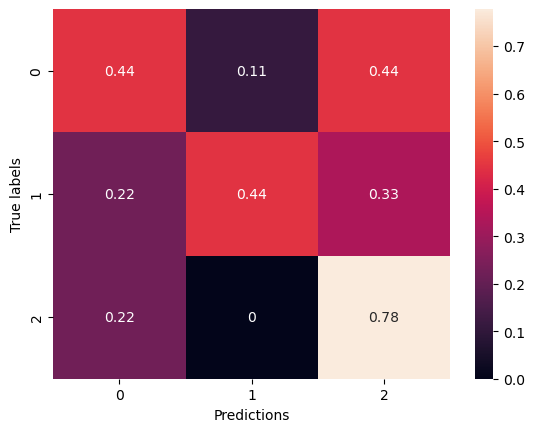

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▃▃▃▄▄▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇█▇███████████████
training_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▁▂▂▂▃▃▄▄▅▅▆▇▆█▅████▇███▆▇▇█▇▇█▇▅▆
val_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:02:06.441553: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:02:06.443828: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:02:06.445560: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:02:08.050217: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:02:08.052194: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:02:08.053974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:02:13.124128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:02:13.704023: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 7.6107 - accuracy: 0.3174 

2024-03-12 18:02:16.789934: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:02:16.791500: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:02:16.793705: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 7.6107 - accuracy: 0.3174 - val_loss: 6.9456 - val_accuracy: 0.1574
Epoch 2/100
2/2 [==============================] - 1s 271ms/step - loss: 7.4294 - accuracy: 0.3379 - val_loss: 6.8784 - val_accuracy: 0.1389
Epoch 3/100
2/2 [==============================] - 1s 268ms/step - loss: 7.2453 - accuracy: 0.3790 - val_loss: 6.8139 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 278ms/step - loss: 7.1648 - accuracy: 0.3584 - val_loss: 6.7487 - val_accuracy: 0.1574
Epoch 5/100
2/2 [==============================] - 1s 280ms/step - loss: 6.9236 - accuracy: 0.4132 - val_loss: 6.6894 - val_accuracy: 0.1759
Epoch 6/100
2/2 [==============================] - 1s 275ms/step - loss: 6.9050 - accuracy: 0.3881 - val_loss: 6.6247 - val_accuracy: 0.1759
Epoch 7/100
2/2 [==============================] - 1s 270ms/step - loss: 6.8140 - accuracy: 0.3836 - val_loss: 6.5584 - val_accuracy: 0.1667
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 269ms/step - loss: 3.5140 - accuracy: 0.6781 - val_loss: 5.8417 - val_accuracy: 0.2407
Epoch 60/100
2/2 [==============================] - 1s 273ms/step - loss: 3.4426 - accuracy: 0.6689 - val_loss: 5.4362 - val_accuracy: 0.2593
Epoch 61/100
2/2 [==============================] - 1s 269ms/step - loss: 3.4616 - accuracy: 0.6393 - val_loss: 4.9015 - val_accuracy: 0.2593
Epoch 62/100
2/2 [==============================] - 1s 272ms/step - loss: 3.3066 - accuracy: 0.6986 - val_loss: 4.6024 - val_accuracy: 0.3148
Epoch 63/100
2/2 [==============================] - 1s 266ms/step - loss: 3.3099 - accuracy: 0.6872 - val_loss: 4.5120 - val_accuracy: 0.3426
Epoch 64/100
2/2 [==============================] - 1s 274ms/step - loss: 3.3015 - accuracy: 0.6804 - val_loss: 4.7391 - val_accuracy: 0.3519
Epoch 65/100
2/2 [==============================] - 1s 268ms/step - loss: 3.1986 - accuracy: 0.7100 - val_loss: 5.2203 - val_accuracy: 0.2870
Epoch 

2024-03-12 18:03:11.065209: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:03:11.066768: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:03:11.068994: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4732370376586914 s
{'0': {'precision': 0.36363636363636365, 'recall': 0.4444444444444444, 'f1-score': 0.39999999999999997, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.4545454545454546, 'recall': 0.4444444444444444, 'f1-score': 0.4470588235294118, 'support': 27}, 'weighted avg': {'precision': 0.4545454545454546, 'recall': 0.4444444444444444, 'f1-score': 0.44705882352941173, 'support': 27}}


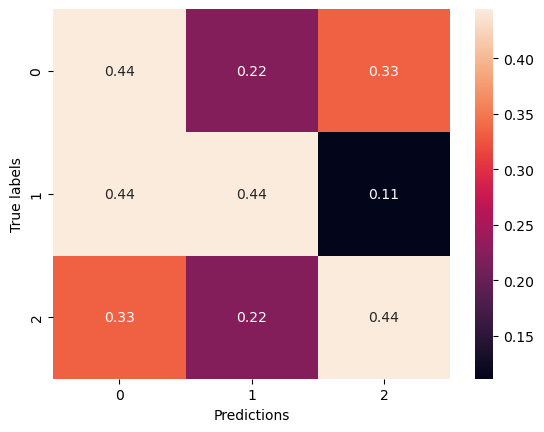

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▁▂▂▃▃▃▃▃▃▃▄▄▄▅▄▅▅▆▅▅▆▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇█
training_loss,██▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▃▃▄▄▅▆▇▆▇▆▅▆▇█▇▆▅
val_loss,██▇▇▇▆▆▆▆▆▅▅▅▅▅▅▅▄▄▅▅▅▅▅▃▃▅▃▃▂▃▂▂▃▂▂▁▁▁▃


Epoch 1/100


2024-03-12 18:03:35.680905: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:03:35.682931: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:03:35.684433: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:03:37.516214: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:03:37.518118: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:03:37.520126: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:03:41.663558: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:03:42.246981: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 30.6097 - accuracy: 0.3562

2024-03-12 18:03:45.368665: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:03:45.370909: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:03:45.372528: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 3s/step - loss: 30.6097 - accuracy: 0.3562 - val_loss: 29.3969 - val_accuracy: 0.2222
Epoch 2/100
2/2 [==============================] - 1s 290ms/step - loss: 29.7331 - accuracy: 0.3470 - val_loss: 28.5266 - val_accuracy: 0.1759
Epoch 3/100
2/2 [==============================] - 1s 333ms/step - loss: 28.7287 - accuracy: 0.3562 - val_loss: 27.6822 - val_accuracy: 0.1481
Epoch 4/100
2/2 [==============================] - 1s 270ms/step - loss: 27.8663 - accuracy: 0.3630 - val_loss: 26.8567 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 272ms/step - loss: 26.9211 - accuracy: 0.3995 - val_loss: 26.0521 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 278ms/step - loss: 26.0409 - accuracy: 0.4064 - val_loss: 25.2673 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 274ms/step - loss: 25.3576 - accuracy: 0.3607 - val_loss: 24.4950 - val_accuracy: 0.1296
Epoch 8/100
2

2/2 [==============================] - 1s 299ms/step - loss: 4.7682 - accuracy: 0.6918 - val_loss: 5.6904 - val_accuracy: 0.3333
Epoch 59/100
2/2 [==============================] - 1s 297ms/step - loss: 4.5593 - accuracy: 0.7260 - val_loss: 5.6016 - val_accuracy: 0.3519
Epoch 60/100
2/2 [==============================] - 1s 297ms/step - loss: 4.4805 - accuracy: 0.7100 - val_loss: 5.0312 - val_accuracy: 0.4630
Epoch 61/100
2/2 [==============================] - 1s 307ms/step - loss: 4.3565 - accuracy: 0.6735 - val_loss: 5.3113 - val_accuracy: 0.3796
Epoch 62/100
2/2 [==============================] - 1s 314ms/step - loss: 4.2076 - accuracy: 0.7260 - val_loss: 5.3340 - val_accuracy: 0.3796
Epoch 63/100
2/2 [==============================] - 1s 297ms/step - loss: 4.0762 - accuracy: 0.7260 - val_loss: 4.7117 - val_accuracy: 0.4907
Epoch 64/100
2/2 [==============================] - 1s 291ms/step - loss: 3.9868 - accuracy: 0.7306 - val_loss: 4.8168 - val_accuracy: 0.4630
Epoch 65/100
2/2 [=

2024-03-12 18:04:46.674961: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:04:46.678288: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:04:46.680746: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.9434659481048584 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.2916666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.42424242424242425, 'support': 9}, 'accuracy': 0.25925925925925924, 'macro avg': {'precision': 0.09722222222222222, 'recall': 0.25925925925925924, 'f1-score': 0.1414141414141414, 'support': 27}, 'weighted avg': {'precision': 0.09722222222222222, 'recall': 0.25925925925925924, 'f1-score': 0.1414141414141414, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


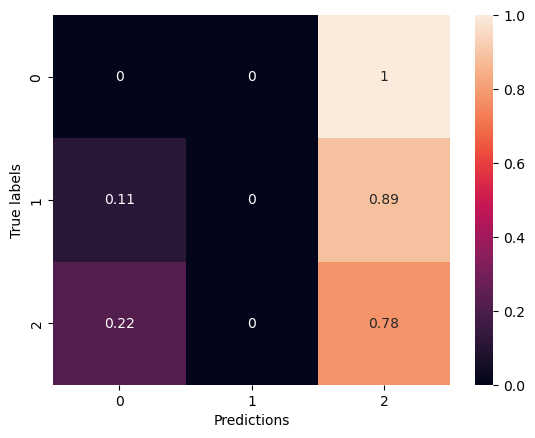

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▆▅▆▆▆▆▆▇▇▇▇▇▇▇███
training_loss,██▇▇▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▂▂▃▃▄▄▄▅▆▆▃▅▇▆▇▇█▇▇█▇▇▇
val_loss,██▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:05:12.366269: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:05:12.369011: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:05:12.371292: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:05:14.111295: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:05:14.113195: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:05:14.115414: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:05:18.550895: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:05:19.174001: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 42.5680 - accuracy: 0.3105

2024-03-12 18:05:22.519498: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:05:22.521345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:05:22.523570: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 42.5680 - accuracy: 0.3105 - val_loss: 40.6383 - val_accuracy: 0.4444
Epoch 2/100
2/2 [==============================] - 1s 283ms/step - loss: 41.0887 - accuracy: 0.3470 - val_loss: 39.3174 - val_accuracy: 0.4630
Epoch 3/100
2/2 [==============================] - 1s 282ms/step - loss: 39.6411 - accuracy: 0.3699 - val_loss: 38.0296 - val_accuracy: 0.3241
Epoch 4/100
2/2 [==============================] - 1s 279ms/step - loss: 38.2713 - accuracy: 0.3653 - val_loss: 36.7696 - val_accuracy: 0.2593
Epoch 5/100
2/2 [==============================] - 1s 282ms/step - loss: 37.0585 - accuracy: 0.3356 - val_loss: 35.5398 - val_accuracy: 0.2407
Epoch 6/100
2/2 [==============================] - 1s 278ms/step - loss: 35.6146 - accuracy: 0.3790 - val_loss: 34.3408 - val_accuracy: 0.2037
Epoch 7/100
2/2 [==============================] - 1s 296ms/step - loss: 34.4426 - accuracy: 0.3858 - val_loss: 33.1707 - val_accuracy: 0.1759
Epoch 8/100
2

2/2 [==============================] - 1s 301ms/step - loss: 5.3283 - accuracy: 0.6689 - val_loss: 5.7353 - val_accuracy: 0.5093
Epoch 59/100
2/2 [==============================] - 1s 277ms/step - loss: 5.1348 - accuracy: 0.6895 - val_loss: 5.9030 - val_accuracy: 0.3704
Epoch 60/100
2/2 [==============================] - 1s 285ms/step - loss: 5.0232 - accuracy: 0.6849 - val_loss: 5.6345 - val_accuracy: 0.4352
Epoch 61/100
2/2 [==============================] - 1s 280ms/step - loss: 4.7672 - accuracy: 0.7100 - val_loss: 5.2811 - val_accuracy: 0.5370
Epoch 62/100
2/2 [==============================] - 1s 284ms/step - loss: 4.6809 - accuracy: 0.6872 - val_loss: 5.1523 - val_accuracy: 0.5463
Epoch 63/100
2/2 [==============================] - 1s 282ms/step - loss: 4.5021 - accuracy: 0.7078 - val_loss: 5.0691 - val_accuracy: 0.5093
Epoch 64/100
2/2 [==============================] - 1s 289ms/step - loss: 4.3798 - accuracy: 0.7192 - val_loss: 5.1519 - val_accuracy: 0.3796
Epoch 65/100
2/2 [=

2024-03-12 18:06:19.427234: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:06:19.429057: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:06:19.431186: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5511770248413086 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '2': {'precision': 0.36, 'recall': 1.0, 'f1-score': 0.5294117647058824, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.7866666666666666, 'recall': 0.40740740740740744, 'f1-score': 0.30980392156862746, 'support': 27}, 'weighted avg': {'precision': 0.7866666666666666, 'recall': 0.4074074074074074, 'f1-score': 0.3098039215686274, 'support': 27}}


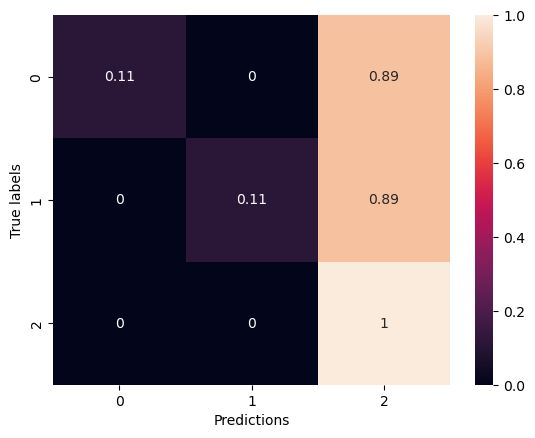

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▂▂▃▃▂▂▃▃▄▄▄▄▄▄▄▅▅▆▅▆▆▆▆▆▆▇▆▇▇▇▇▇████
training_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▄▂▁▁▁▁▂▂▂▃▃▄▄▃▃▂▃▄▅▆▆▇▄▇▅▇▇▇▇▇▇▇█▆▇▇███
val_loss,██▇▆▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:06:43.772379: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:06:43.774182: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:06:43.777026: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:06:45.515983: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:06:45.518665: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:06:45.520741: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:06:51.033857: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:06:51.655373: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 8.1981 - accuracy: 0.3265 

2024-03-12 18:06:55.153284: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:06:55.155370: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:06:55.156950: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 8.1981 - accuracy: 0.3265 - val_loss: 7.6612 - val_accuracy: 0.1667
Epoch 2/100
2/2 [==============================] - 1s 388ms/step - loss: 7.7634 - accuracy: 0.5023 - val_loss: 7.6015 - val_accuracy: 0.1574
Epoch 3/100
2/2 [==============================] - 1s 394ms/step - loss: 7.4258 - accuracy: 0.5639 - val_loss: 7.5676 - val_accuracy: 0.1574
Epoch 4/100
2/2 [==============================] - 1s 384ms/step - loss: 7.1530 - accuracy: 0.5822 - val_loss: 7.5740 - val_accuracy: 0.1481
Epoch 5/100
2/2 [==============================] - 1s 373ms/step - loss: 6.9485 - accuracy: 0.6507 - val_loss: 7.6014 - val_accuracy: 0.1574
Epoch 6/100
2/2 [==============================] - 1s 381ms/step - loss: 6.7930 - accuracy: 0.7009 - val_loss: 7.6292 - val_accuracy: 0.1574
Epoch 7/100
2/2 [==============================] - 1s 377ms/step - loss: 6.5881 - accuracy: 0.6872 - val_loss: 7.6546 - val_accuracy: 0.1481
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 368ms/step - loss: 1.8675 - accuracy: 0.9909 - val_loss: 4.5090 - val_accuracy: 0.4167
Epoch 60/100
2/2 [==============================] - 1s 367ms/step - loss: 1.8179 - accuracy: 0.9977 - val_loss: 4.3226 - val_accuracy: 0.4259
Epoch 61/100
2/2 [==============================] - 1s 376ms/step - loss: 1.7916 - accuracy: 0.9886 - val_loss: 3.9976 - val_accuracy: 0.4259
Epoch 62/100
2/2 [==============================] - 1s 373ms/step - loss: 1.7452 - accuracy: 1.0000 - val_loss: 3.8681 - val_accuracy: 0.4352
Epoch 63/100
2/2 [==============================] - 1s 372ms/step - loss: 1.7051 - accuracy: 0.9977 - val_loss: 3.8806 - val_accuracy: 0.4630
Epoch 64/100
2/2 [==============================] - 1s 378ms/step - loss: 1.6769 - accuracy: 0.9954 - val_loss: 3.8712 - val_accuracy: 0.4722
Epoch 65/100
2/2 [==============================] - 1s 383ms/step - loss: 1.6426 - accuracy: 0.9954 - val_loss: 3.9878 - val_accuracy: 0.4722
Epoch 

2024-03-12 18:08:08.995661: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:08:08.997231: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:08:08.999078: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4848477840423584 s
{'0': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '1': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, '2': {'precision': 0.7142857142857143, 'recall': 0.5555555555555556, 'f1-score': 0.6250000000000001, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5347985347985348, 'recall': 0.5185185185185185, 'f1-score': 0.5151515151515152, 'support': 27}, 'weighted avg': {'precision': 0.5347985347985348, 'recall': 0.5185185185185185, 'f1-score': 0.5151515151515151, 'support': 27}}


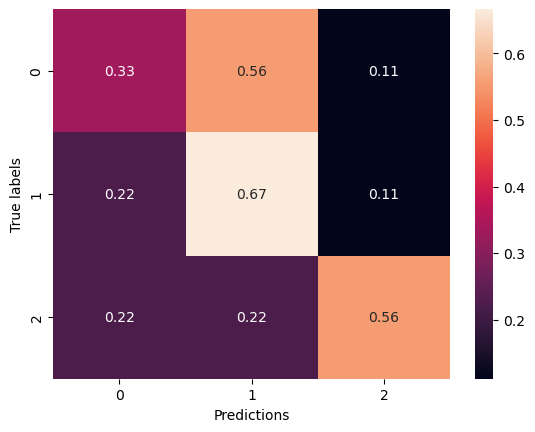

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▆▆▇▇▇▇█████████████████████████████
training_loss,█▇▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▂▂▁▁▁▁▁▁▁▂▃▃▃▄▃▄▆▆▅▅▆▆▆▆▆▆▇▆▅▆▆▆▇▇█▆█▇▆
val_loss,████████▇▆▆▅▅▄▄▄▄▂▂▂▂▂▂▃▂▁▃▂▂▂▂▃▂▂▂▁▃▁▃▃


Epoch 1/100


2024-03-12 18:08:35.037351: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:08:35.039703: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:08:35.042065: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:08:36.856410: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:08:36.858757: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:08:36.861469: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:08:41.555295: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:08:42.203238: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 34.2476 - accuracy: 0.3836 

2024-03-12 18:08:45.806317: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:08:45.809000: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:08:45.810835: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 34.2476 - accuracy: 0.3836 - val_loss: 32.7746 - val_accuracy: 0.1296
Epoch 2/100
2/2 [==============================] - 1s 380ms/step - loss: 32.6135 - accuracy: 0.4703 - val_loss: 31.5866 - val_accuracy: 0.1481
Epoch 3/100
2/2 [==============================] - 1s 383ms/step - loss: 31.1541 - accuracy: 0.5023 - val_loss: 30.3780 - val_accuracy: 0.1481
Epoch 4/100
2/2 [==============================] - 1s 383ms/step - loss: 29.7299 - accuracy: 0.6027 - val_loss: 29.1775 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 388ms/step - loss: 28.4316 - accuracy: 0.6575 - val_loss: 27.9926 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 383ms/step - loss: 27.2583 - accuracy: 0.6256 - val_loss: 26.8516 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 395ms/step - loss: 25.9945 - accuracy: 0.7100 - val_loss: 25.7652 - val_accuracy: 0.1204
Epoch 8/100
2

2/2 [==============================] - 1s 380ms/step - loss: 2.5696 - accuracy: 0.9772 - val_loss: 5.0196 - val_accuracy: 0.3796
Epoch 59/100
2/2 [==============================] - 1s 374ms/step - loss: 2.4991 - accuracy: 0.9658 - val_loss: 4.4461 - val_accuracy: 0.4352
Epoch 60/100
2/2 [==============================] - 1s 381ms/step - loss: 2.3878 - accuracy: 0.9749 - val_loss: 4.2364 - val_accuracy: 0.5000
Epoch 61/100
2/2 [==============================] - 1s 380ms/step - loss: 2.3688 - accuracy: 0.9612 - val_loss: 3.9909 - val_accuracy: 0.5370
Epoch 62/100
2/2 [==============================] - 1s 386ms/step - loss: 2.2644 - accuracy: 0.9726 - val_loss: 4.2820 - val_accuracy: 0.4537
Epoch 63/100
2/2 [==============================] - 1s 389ms/step - loss: 2.1977 - accuracy: 0.9680 - val_loss: 3.9880 - val_accuracy: 0.5093
Epoch 64/100
2/2 [==============================] - 1s 386ms/step - loss: 2.1766 - accuracy: 0.9612 - val_loss: 3.8900 - val_accuracy: 0.5556
Epoch 65/100
2/2 [=

2024-03-12 18:10:01.207581: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:10:01.209329: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:10:01.211621: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6133623123168945 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, '1': {'precision': 0.4166666666666667, 'recall': 0.5555555555555556, 'f1-score': 0.4761904761904762, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.39814814814814814, 'recall': 0.40740740740740744, 'f1-score': 0.39576719576719577, 'support': 27}, 'weighted avg': {'precision': 0.39814814814814814, 'recall': 0.4074074074074074, 'f1-score': 0.39576719576719577, 'support': 27}}


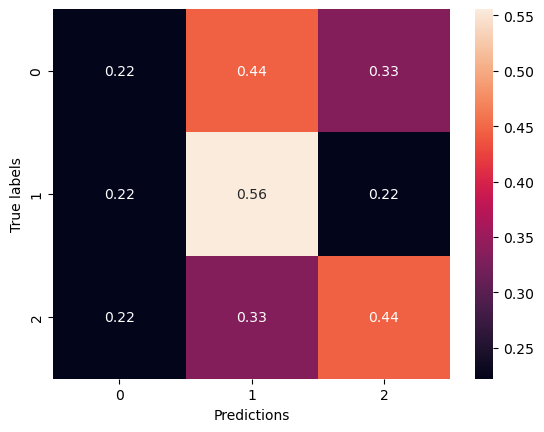

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▄▅▆▆▇▇▇▇▇▇████████████████████████████
training_loss,█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▁▂▂▂▃▃▄▅▅▃▆▃▅▅▄▅▅▇▇▇▆▅▆▇▇▇▇▇▇▆▇█▅
val_loss,█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:10:25.363410: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:10:25.365488: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:10:25.367689: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:10:27.104419: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:10:27.107119: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:10:27.109251: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:10:31.572836: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:10:32.188568: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 47.0040 - accuracy: 0.3379

2024-03-12 18:10:35.664379: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:10:35.666508: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:10:35.668213: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 47.0040 - accuracy: 0.3379 - val_loss: 44.9194 - val_accuracy: 0.1481
Epoch 2/100
2/2 [==============================] - 1s 398ms/step - loss: 44.5890 - accuracy: 0.4772 - val_loss: 43.1067 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 386ms/step - loss: 42.5449 - accuracy: 0.5525 - val_loss: 41.2642 - val_accuracy: 0.1111
Epoch 4/100
2/2 [==============================] - 1s 369ms/step - loss: 40.4776 - accuracy: 0.6187 - val_loss: 39.4509 - val_accuracy: 0.1111
Epoch 5/100
2/2 [==============================] - 1s 382ms/step - loss: 38.6363 - accuracy: 0.6142 - val_loss: 37.6737 - val_accuracy: 0.1389
Epoch 6/100
2/2 [==============================] - 1s 380ms/step - loss: 36.8314 - accuracy: 0.6553 - val_loss: 35.9552 - val_accuracy: 0.1759
Epoch 7/100
2/2 [==============================] - 1s 379ms/step - loss: 35.0786 - accuracy: 0.7009 - val_loss: 34.3162 - val_accuracy: 0.1667
Epoch 8/100
2

2/2 [==============================] - 1s 403ms/step - loss: 2.7985 - accuracy: 0.9566 - val_loss: 3.9754 - val_accuracy: 0.6019
Epoch 59/100
2/2 [==============================] - 1s 381ms/step - loss: 2.6435 - accuracy: 0.9795 - val_loss: 3.8693 - val_accuracy: 0.6019
Epoch 60/100
2/2 [==============================] - 1s 390ms/step - loss: 2.5506 - accuracy: 0.9749 - val_loss: 3.9032 - val_accuracy: 0.5556
Epoch 61/100
2/2 [==============================] - 1s 380ms/step - loss: 2.4616 - accuracy: 0.9772 - val_loss: 3.9351 - val_accuracy: 0.5556
Epoch 62/100
2/2 [==============================] - 1s 400ms/step - loss: 2.3626 - accuracy: 0.9749 - val_loss: 3.9323 - val_accuracy: 0.5556
Epoch 63/100
2/2 [==============================] - 1s 395ms/step - loss: 2.2738 - accuracy: 0.9795 - val_loss: 3.8560 - val_accuracy: 0.5556
Epoch 64/100
2/2 [==============================] - 1s 414ms/step - loss: 2.1894 - accuracy: 0.9886 - val_loss: 3.7681 - val_accuracy: 0.5741
Epoch 65/100
2/2 [=

2024-03-12 18:11:52.593035: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:11:52.595413: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:11:52.597591: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5972881317138672 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '2': {'precision': 0.45, 'recall': 1.0, 'f1-score': 0.6206896551724138, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.65, 'recall': 0.48148148148148145, 'f1-score': 0.4068965517241379, 'support': 27}, 'weighted avg': {'precision': 0.65, 'recall': 0.48148148148148145, 'f1-score': 0.40689655172413797, 'support': 27}}


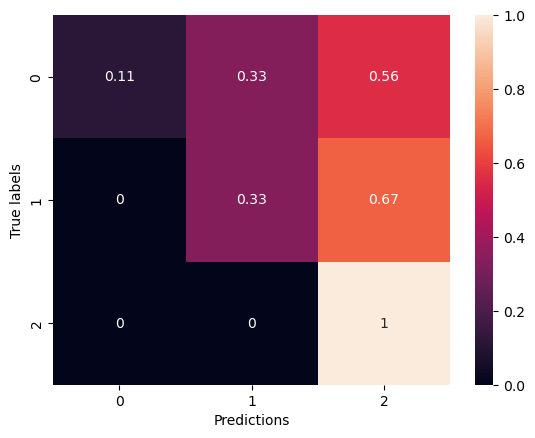

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▇▇▇▇▇██▇██████████████████████████
training_loss,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▂▁▁▃▄▄▅▆▆▇▇█▇▇▇▇█▇█▇█▇▇███▇▇▇▇██▇▇██▇
val_loss,█▇▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:12:16.503747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:12:16.505987: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:12:16.507733: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:12:18.197740: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:12:18.199604: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:12:18.201618: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:12:23.541330: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:12:24.160105: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 8.1309 - accuracy: 0.3562 

2024-03-12 18:12:27.617328: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:12:27.619017: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:12:27.621081: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 8.1309 - accuracy: 0.3562 - val_loss: 7.6082 - val_accuracy: 0.1574
Epoch 2/100
2/2 [==============================] - 1s 372ms/step - loss: 7.8976 - accuracy: 0.3995 - val_loss: 7.6018 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 379ms/step - loss: 7.6803 - accuracy: 0.4429 - val_loss: 7.5645 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 378ms/step - loss: 7.4086 - accuracy: 0.5114 - val_loss: 7.5163 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 392ms/step - loss: 7.2913 - accuracy: 0.5046 - val_loss: 7.4646 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 381ms/step - loss: 7.2065 - accuracy: 0.5205 - val_loss: 7.4132 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 380ms/step - loss: 7.0340 - accuracy: 0.5228 - val_loss: 7.3662 - val_accuracy: 0.1204
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 372ms/step - loss: 2.3848 - accuracy: 0.9772 - val_loss: 4.0953 - val_accuracy: 0.5833
Epoch 60/100
2/2 [==============================] - 1s 378ms/step - loss: 2.3678 - accuracy: 0.9658 - val_loss: 4.2400 - val_accuracy: 0.5741
Epoch 61/100
2/2 [==============================] - 1s 362ms/step - loss: 2.3153 - accuracy: 0.9795 - val_loss: 4.5320 - val_accuracy: 0.5278
Epoch 62/100
2/2 [==============================] - 1s 384ms/step - loss: 2.3051 - accuracy: 0.9658 - val_loss: 4.4298 - val_accuracy: 0.5556
Epoch 63/100
2/2 [==============================] - 1s 373ms/step - loss: 2.2128 - accuracy: 0.9863 - val_loss: 4.4379 - val_accuracy: 0.5556
Epoch 64/100
2/2 [==============================] - 1s 373ms/step - loss: 2.1888 - accuracy: 0.9772 - val_loss: 4.6923 - val_accuracy: 0.5556
Epoch 65/100
2/2 [==============================] - 1s 362ms/step - loss: 2.1762 - accuracy: 0.9658 - val_loss: 4.5037 - val_accuracy: 0.5278
Epoch 

2024-03-12 18:13:41.509063: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:13:41.510906: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:13:41.513294: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6119790077209473 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '2': {'precision': 0.5333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.6666666666666667, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.4777777777777778, 'recall': 0.48148148148148145, 'f1-score': 0.4231791600212653, 'support': 27}, 'weighted avg': {'precision': 0.47777777777777775, 'recall': 0.48148148148148145, 'f1-score': 0.4231791600212653, 'support': 27}}


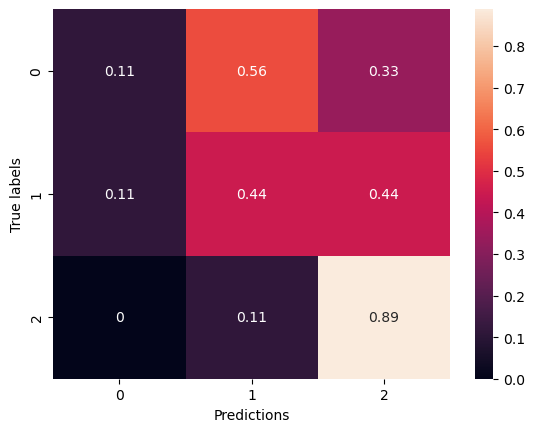

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇██████████████████
training_loss,██▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▁▂▂▂▂▂▂▃▄▃▆▆▅▆▅▆▇▆▇▆▇▆▅▇█▇▇█▇▇▇█▇
val_loss,███▇▇▇▇▇▆▆▆▅▅▅▄▄▄▂▂▃▃▃▃▂▂▃▂▂▂▄▂▁▁▂▂▂▂▂▁▁


Epoch 1/100


2024-03-12 18:14:07.243537: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:14:07.246322: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:14:07.248295: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:14:09.092544: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:14:09.095248: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:14:09.097250: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:14:13.656916: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:14:14.271281: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 34.1061 - accuracy: 0.3470 

2024-03-12 18:14:17.646159: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:14:17.648913: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:14:17.650970: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 34.1061 - accuracy: 0.3470 - val_loss: 32.4477 - val_accuracy: 0.2407
Epoch 2/100
2/2 [==============================] - 1s 365ms/step - loss: 32.6352 - accuracy: 0.3676 - val_loss: 31.3242 - val_accuracy: 0.2037
Epoch 3/100
2/2 [==============================] - 1s 355ms/step - loss: 31.2664 - accuracy: 0.4612 - val_loss: 30.2339 - val_accuracy: 0.1481
Epoch 4/100
2/2 [==============================] - 1s 365ms/step - loss: 30.0222 - accuracy: 0.5228 - val_loss: 29.1655 - val_accuracy: 0.1389
Epoch 5/100
2/2 [==============================] - 1s 367ms/step - loss: 28.8937 - accuracy: 0.5320 - val_loss: 28.1396 - val_accuracy: 0.1481
Epoch 6/100
2/2 [==============================] - 1s 368ms/step - loss: 27.8804 - accuracy: 0.4909 - val_loss: 27.1526 - val_accuracy: 0.1481
Epoch 7/100
2/2 [==============================] - 1s 361ms/step - loss: 26.5844 - accuracy: 0.5708 - val_loss: 26.1934 - val_accuracy: 0.1574
Epoch 8/100
2

2/2 [==============================] - 1s 368ms/step - loss: 3.2893 - accuracy: 0.9452 - val_loss: 6.0112 - val_accuracy: 0.3611
Epoch 59/100
2/2 [==============================] - 1s 360ms/step - loss: 3.1426 - accuracy: 0.9589 - val_loss: 5.3214 - val_accuracy: 0.4074
Epoch 60/100
2/2 [==============================] - 1s 363ms/step - loss: 3.0525 - accuracy: 0.9635 - val_loss: 4.9248 - val_accuracy: 0.4630
Epoch 61/100
2/2 [==============================] - 1s 380ms/step - loss: 2.9447 - accuracy: 0.9680 - val_loss: 4.8544 - val_accuracy: 0.5185
Epoch 62/100
2/2 [==============================] - 1s 372ms/step - loss: 2.8444 - accuracy: 0.9612 - val_loss: 5.3091 - val_accuracy: 0.4167
Epoch 63/100
2/2 [==============================] - 1s 358ms/step - loss: 2.7647 - accuracy: 0.9772 - val_loss: 5.3905 - val_accuracy: 0.4167
Epoch 64/100
2/2 [==============================] - 1s 383ms/step - loss: 2.6783 - accuracy: 0.9772 - val_loss: 5.1376 - val_accuracy: 0.4722
Epoch 65/100
2/2 [=

2024-03-12 18:15:29.445847: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:15:29.448058: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:15:29.449548: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4965476989746094 s
{'0': {'precision': 0.8, 'recall': 0.4444444444444444, 'f1-score': 0.5714285714285714, 'support': 9}, '1': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.6, 'recall': 1.0, 'f1-score': 0.7499999999999999, 'support': 9}, 'accuracy': 0.6296296296296297, 'macro avg': {'precision': 0.6571428571428571, 'recall': 0.6296296296296297, 'f1-score': 0.6071428571428571, 'support': 27}, 'weighted avg': {'precision': 0.657142857142857, 'recall': 0.6296296296296297, 'f1-score': 0.6071428571428571, 'support': 27}}


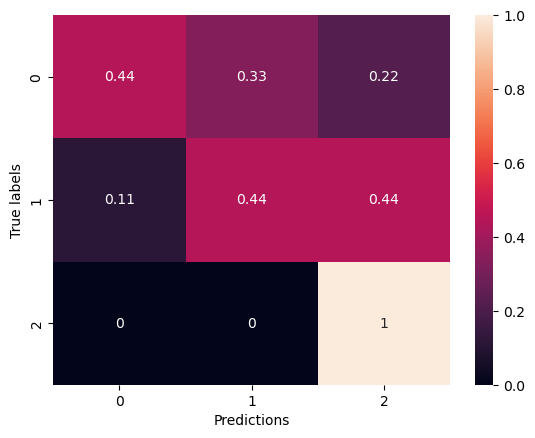

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▄▅▅▅▆▆▆▆▇▇▇▇▇█▇████████████████████
training_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▁▁▁▁▁▂▂▂▃▄▄▄▅▅▅▅▅▄▅▄▅▇▆▆▅▆▅▇▇▆▆█▇█▇██
val_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:15:56.779662: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:15:56.781405: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:15:56.783338: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:15:59.420247: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:15:59.422308: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:15:59.424201: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:16:03.639076: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:16:04.221495: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 46.9962 - accuracy: 0.3676 

2024-03-12 18:16:07.500153: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:16:07.501731: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:16:07.503828: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 46.9962 - accuracy: 0.3676 - val_loss: 44.8366 - val_accuracy: 0.3796
Epoch 2/100
2/2 [==============================] - 1s 372ms/step - loss: 44.7832 - accuracy: 0.4406 - val_loss: 43.0208 - val_accuracy: 0.2870
Epoch 3/100
2/2 [==============================] - 1s 361ms/step - loss: 42.7792 - accuracy: 0.4635 - val_loss: 41.2584 - val_accuracy: 0.1852
Epoch 4/100
2/2 [==============================] - 1s 361ms/step - loss: 40.9575 - accuracy: 0.4909 - val_loss: 39.5283 - val_accuracy: 0.1667
Epoch 5/100
2/2 [==============================] - 1s 368ms/step - loss: 39.1332 - accuracy: 0.5046 - val_loss: 37.8484 - val_accuracy: 0.1389
Epoch 6/100
2/2 [==============================] - 1s 362ms/step - loss: 37.4154 - accuracy: 0.4772 - val_loss: 36.2508 - val_accuracy: 0.1389
Epoch 7/100
2/2 [==============================] - 1s 358ms/step - loss: 35.6236 - accuracy: 0.5251 - val_loss: 34.7021 - val_accuracy: 0.1204
Epoch 8/100
2

2/2 [==============================] - 1s 366ms/step - loss: 3.0983 - accuracy: 0.9635 - val_loss: 4.6927 - val_accuracy: 0.5556
Epoch 59/100
2/2 [==============================] - 1s 359ms/step - loss: 2.9448 - accuracy: 0.9795 - val_loss: 4.8076 - val_accuracy: 0.5648
Epoch 60/100
2/2 [==============================] - 1s 362ms/step - loss: 2.8543 - accuracy: 0.9703 - val_loss: 5.3929 - val_accuracy: 0.4537
Epoch 61/100
2/2 [==============================] - 1s 358ms/step - loss: 2.7512 - accuracy: 0.9726 - val_loss: 5.5683 - val_accuracy: 0.4444
Epoch 62/100
2/2 [==============================] - 1s 368ms/step - loss: 2.6643 - accuracy: 0.9703 - val_loss: 5.0139 - val_accuracy: 0.5093
Epoch 63/100
2/2 [==============================] - 1s 385ms/step - loss: 2.5590 - accuracy: 0.9680 - val_loss: 4.5429 - val_accuracy: 0.5278
Epoch 64/100
2/2 [==============================] - 1s 356ms/step - loss: 2.5439 - accuracy: 0.9521 - val_loss: 4.5534 - val_accuracy: 0.4537
Epoch 65/100
2/2 [=

2024-03-12 18:17:18.814926: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:17:18.816381: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:17:18.818465: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4828059673309326 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.4166666666666667, 'recall': 0.5555555555555556, 'f1-score': 0.4761904761904762, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.5055555555555555, 'recall': 0.48148148148148145, 'f1-score': 0.47702589807852963, 'support': 27}, 'weighted avg': {'precision': 0.5055555555555555, 'recall': 0.48148148148148145, 'f1-score': 0.47702589807852963, 'support': 27}}


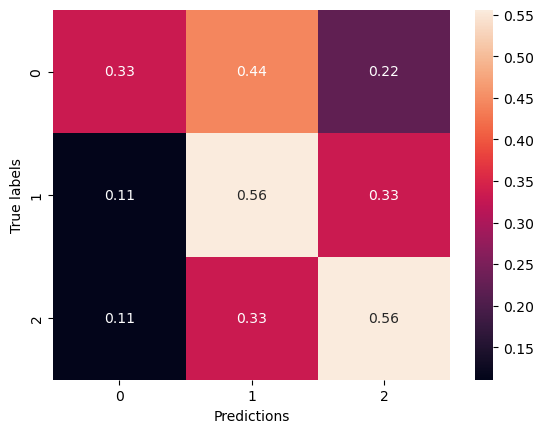

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▄▄▄▅▅▅▆▆▆▆▇▇▇▇▇▇█▇███████████████████
training_loss,█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▂▁▁▁▁▂▃▄▅▅▆▇▆▆▅▆▆▆▅▆▆▇▇▆▆▇▆▆▅▆▆██▆▇█▇▅▆
val_loss,█▇▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:17:40.379311: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:17:40.381369: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:17:40.382916: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:17:42.016040: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:17:42.017795: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:17:42.019975: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:17:46.204255: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:17:48.119355: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 8.3874 - accuracy: 0.3174 

2024-03-12 18:17:51.464589: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:17:51.466416: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:17:51.468334: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 8.3874 - accuracy: 0.3174 - val_loss: 7.5857 - val_accuracy: 0.2685
Epoch 2/100
2/2 [==============================] - 1s 374ms/step - loss: 8.2551 - accuracy: 0.3402 - val_loss: 7.5166 - val_accuracy: 0.2407
Epoch 3/100
2/2 [==============================] - 1s 362ms/step - loss: 7.8918 - accuracy: 0.3995 - val_loss: 7.4542 - val_accuracy: 0.1667
Epoch 4/100
2/2 [==============================] - 1s 365ms/step - loss: 7.7578 - accuracy: 0.4064 - val_loss: 7.3829 - val_accuracy: 0.1759
Epoch 5/100
2/2 [==============================] - 1s 363ms/step - loss: 7.7264 - accuracy: 0.3790 - val_loss: 7.3045 - val_accuracy: 0.1574
Epoch 6/100
2/2 [==============================] - 1s 364ms/step - loss: 7.5756 - accuracy: 0.4018 - val_loss: 7.2266 - val_accuracy: 0.1667
Epoch 7/100
2/2 [==============================] - 1s 368ms/step - loss: 7.4078 - accuracy: 0.4132 - val_loss: 7.1629 - val_accuracy: 0.2130
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 369ms/step - loss: 3.4890 - accuracy: 0.7603 - val_loss: 8.1577 - val_accuracy: 0.2315
Epoch 60/100
2/2 [==============================] - 1s 370ms/step - loss: 3.4929 - accuracy: 0.7146 - val_loss: 7.9507 - val_accuracy: 0.2407
Epoch 61/100
2/2 [==============================] - 1s 354ms/step - loss: 3.3892 - accuracy: 0.7306 - val_loss: 7.4971 - val_accuracy: 0.2500
Epoch 62/100
2/2 [==============================] - 1s 364ms/step - loss: 3.4089 - accuracy: 0.7603 - val_loss: 7.2673 - val_accuracy: 0.2593
Epoch 63/100
2/2 [==============================] - 1s 369ms/step - loss: 3.3116 - accuracy: 0.7557 - val_loss: 7.5180 - val_accuracy: 0.2593
Epoch 64/100
2/2 [==============================] - 1s 369ms/step - loss: 3.2961 - accuracy: 0.7626 - val_loss: 7.9898 - val_accuracy: 0.2407
Epoch 65/100
2/2 [==============================] - 1s 362ms/step - loss: 3.2092 - accuracy: 0.7489 - val_loss: 8.3428 - val_accuracy: 0.2407
Epoch 

2024-03-12 18:19:02.766029: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:19:02.767628: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:19:02.769543: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4867589473724365 s
{'0': {'precision': 0.625, 'recall': 0.5555555555555556, 'f1-score': 0.5882352941176471, 'support': 9}, '1': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5844017094017094, 'recall': 0.5555555555555556, 'f1-score': 0.5556743909685086, 'support': 27}, 'weighted avg': {'precision': 0.5844017094017094, 'recall': 0.5555555555555556, 'f1-score': 0.5556743909685087, 'support': 27}}


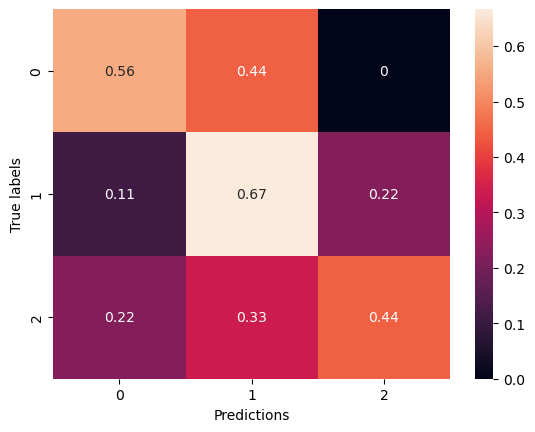

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▃▃▃▃▄▃▄▅▄▅▄▅▅▆▅▅▆▆▆▆▆▆▆▇▇▇▇▇██████
training_loss,█▇▇▇▆▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▃▃▄▃▄▄▄▅▃▄▆▆▄▄▆▆███▇
val_loss,▆▆▆▅▅▅▅▅▅▅▅▅▆▆▆▆▇██▇▇▆▅▇▆▇▇▅▇▅▃▃▅▅▃▃▁▁▂▂


Epoch 1/100


2024-03-12 18:19:29.611339: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:19:29.612974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:19:29.615179: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:19:31.238807: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:19:31.240872: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:19:31.242751: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:19:35.424180: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:19:36.008173: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 34.1406 - accuracy: 0.2877

2024-03-12 18:19:39.265541: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:19:39.267388: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:19:39.269208: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 34.1406 - accuracy: 0.2877 - val_loss: 32.5290 - val_accuracy: 0.4074
Epoch 2/100
2/2 [==============================] - 1s 359ms/step - loss: 32.8719 - accuracy: 0.3333 - val_loss: 31.4342 - val_accuracy: 0.2963
Epoch 3/100
2/2 [==============================] - 1s 362ms/step - loss: 31.6569 - accuracy: 0.3858 - val_loss: 30.3677 - val_accuracy: 0.2778
Epoch 4/100
2/2 [==============================] - 1s 366ms/step - loss: 30.4377 - accuracy: 0.3584 - val_loss: 29.3352 - val_accuracy: 0.1944
Epoch 5/100
2/2 [==============================] - 1s 367ms/step - loss: 29.3161 - accuracy: 0.4132 - val_loss: 28.3249 - val_accuracy: 0.1481
Epoch 6/100
2/2 [==============================] - 1s 362ms/step - loss: 28.2738 - accuracy: 0.3744 - val_loss: 27.3440 - val_accuracy: 0.1481
Epoch 7/100
2/2 [==============================] - 1s 362ms/step - loss: 27.2088 - accuracy: 0.3995 - val_loss: 26.3839 - val_accuracy: 0.1389
Epoch 8/100
2

2/2 [==============================] - 1s 370ms/step - loss: 4.0590 - accuracy: 0.8014 - val_loss: 5.0841 - val_accuracy: 0.5185
Epoch 59/100
2/2 [==============================] - 1s 364ms/step - loss: 3.9398 - accuracy: 0.8219 - val_loss: 4.8796 - val_accuracy: 0.5000
Epoch 60/100
2/2 [==============================] - 1s 357ms/step - loss: 3.8170 - accuracy: 0.8356 - val_loss: 4.7627 - val_accuracy: 0.5278
Epoch 61/100
2/2 [==============================] - 1s 364ms/step - loss: 3.7574 - accuracy: 0.7968 - val_loss: 4.7034 - val_accuracy: 0.5093
Epoch 62/100
2/2 [==============================] - 1s 364ms/step - loss: 3.5750 - accuracy: 0.8447 - val_loss: 4.7284 - val_accuracy: 0.5185
Epoch 63/100
2/2 [==============================] - 1s 369ms/step - loss: 3.5352 - accuracy: 0.8242 - val_loss: 4.4807 - val_accuracy: 0.5556
Epoch 64/100
2/2 [==============================] - 1s 362ms/step - loss: 3.3848 - accuracy: 0.8311 - val_loss: 5.4892 - val_accuracy: 0.4722
Epoch 65/100
2/2 [=

2024-03-12 18:20:51.055623: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:20:51.057197: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:20:51.059055: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4919731616973877 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.32051282051282054, 'recall': 0.4444444444444444, 'f1-score': 0.37229437229437234, 'support': 27}, 'weighted avg': {'precision': 0.3205128205128205, 'recall': 0.4444444444444444, 'f1-score': 0.3722943722943723, 'support': 27}}


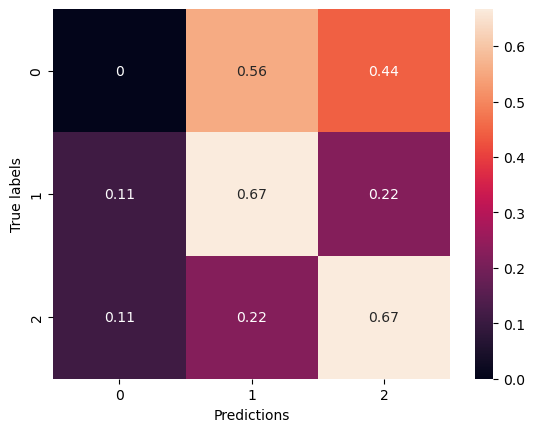

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇██████
training_loss,█▇▇▆▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▃▁▁▁▁▁▁▁▂▂▂▂▂▂▅▆▅▅▆▅▇▅▆▆▆▇▇▅▆█▇█▇█▆█▇▆▆
val_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:21:14.345629: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:21:14.347862: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:21:14.349498: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:21:16.896598: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:21:16.898927: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:21:16.900631: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:21:21.081767: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:21:21.669128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 47.1503 - accuracy: 0.3493 

2024-03-12 18:21:24.915952: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:21:24.917569: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:21:24.919606: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 47.1503 - accuracy: 0.3493 - val_loss: 45.0474 - val_accuracy: 0.1759
Epoch 2/100
2/2 [==============================] - 1s 361ms/step - loss: 45.1813 - accuracy: 0.3379 - val_loss: 43.2682 - val_accuracy: 0.1481
Epoch 3/100
2/2 [==============================] - 1s 375ms/step - loss: 43.2560 - accuracy: 0.3927 - val_loss: 41.5650 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 365ms/step - loss: 41.4076 - accuracy: 0.4269 - val_loss: 39.9067 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 363ms/step - loss: 39.8983 - accuracy: 0.3607 - val_loss: 38.3106 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 359ms/step - loss: 38.1234 - accuracy: 0.3927 - val_loss: 36.7599 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 357ms/step - loss: 36.4949 - accuracy: 0.4201 - val_loss: 35.2597 - val_accuracy: 0.1296
Epoch 8/100
2

2/2 [==============================] - 1s 365ms/step - loss: 4.2302 - accuracy: 0.7808 - val_loss: 5.2954 - val_accuracy: 0.4630
Epoch 59/100
2/2 [==============================] - 1s 371ms/step - loss: 4.0371 - accuracy: 0.7877 - val_loss: 5.1308 - val_accuracy: 0.4537
Epoch 60/100
2/2 [==============================] - 1s 361ms/step - loss: 3.8379 - accuracy: 0.8311 - val_loss: 4.9116 - val_accuracy: 0.4907
Epoch 61/100
2/2 [==============================] - 1s 357ms/step - loss: 3.7794 - accuracy: 0.8037 - val_loss: 4.8242 - val_accuracy: 0.5000
Epoch 62/100
2/2 [==============================] - 1s 358ms/step - loss: 3.6736 - accuracy: 0.8014 - val_loss: 4.7818 - val_accuracy: 0.4907
Epoch 63/100
2/2 [==============================] - 1s 361ms/step - loss: 3.4976 - accuracy: 0.8288 - val_loss: 5.3511 - val_accuracy: 0.4259
Epoch 64/100
2/2 [==============================] - 1s 366ms/step - loss: 3.4525 - accuracy: 0.8082 - val_loss: 4.6375 - val_accuracy: 0.5278
Epoch 65/100
2/2 [=

2024-03-12 18:22:36.212172: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:22:36.213879: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:22:36.215891: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.478891134262085 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.562962962962963, 'recall': 0.5185185185185185, 'f1-score': 0.49074074074074076, 'support': 27}, 'weighted avg': {'precision': 0.5629629629629629, 'recall': 0.5185185185185185, 'f1-score': 0.49074074074074076, 'support': 27}}


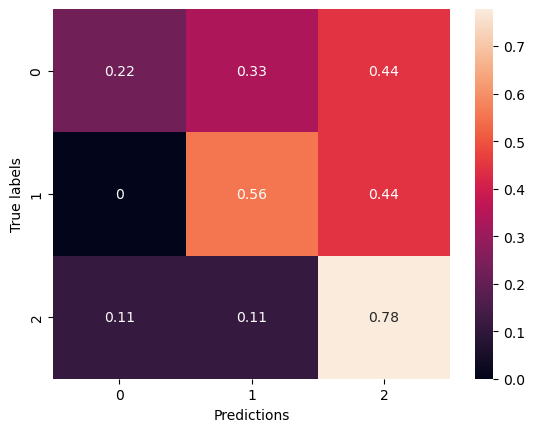

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▁▂▂▂▂▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇███████
training_loss,█▇▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂▃▄▄▅▅▄▅▅▆▆▇▇▇▆▆▆█▆█▇█▇▇▅█
val_loss,█▇▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:22:58.422261: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:22:58.423842: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:22:58.425715: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:23:00.037894: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:23:00.039723: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:23:00.041775: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:23:04.201571: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:23:04.786172: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 9.6589 - accuracy: 0.2900

2024-03-12 18:23:09.078666: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:23:09.080534: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:23:09.082472: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 3s/step - loss: 9.6589 - accuracy: 0.2900 - val_loss: 8.9043 - val_accuracy: 0.2500
Epoch 2/100
2/2 [==============================] - 1s 408ms/step - loss: 9.1024 - accuracy: 0.4452 - val_loss: 8.7986 - val_accuracy: 0.2222
Epoch 3/100
2/2 [==============================] - 1s 407ms/step - loss: 8.6849 - accuracy: 0.5571 - val_loss: 8.6889 - val_accuracy: 0.2222
Epoch 4/100
2/2 [==============================] - 1s 404ms/step - loss: 8.5459 - accuracy: 0.5913 - val_loss: 8.5688 - val_accuracy: 0.2037
Epoch 5/100
2/2 [==============================] - 1s 401ms/step - loss: 8.3305 - accuracy: 0.6096 - val_loss: 8.4520 - val_accuracy: 0.2222
Epoch 6/100
2/2 [==============================] - 1s 406ms/step - loss: 8.2225 - accuracy: 0.6301 - val_loss: 8.3555 - val_accuracy: 0.1944
Epoch 7/100
2/2 [==============================] - 1s 403ms/step - loss: 7.9733 - accuracy: 0.6598 - val_loss: 8.2678 - val_accuracy: 0.1852
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 416ms/step - loss: 2.5917 - accuracy: 0.9909 - val_loss: 4.6084 - val_accuracy: 0.5370
Epoch 60/100
2/2 [==============================] - 1s 413ms/step - loss: 2.5561 - accuracy: 0.9863 - val_loss: 4.5931 - val_accuracy: 0.5278
Epoch 61/100
2/2 [==============================] - 1s 414ms/step - loss: 2.5113 - accuracy: 0.9863 - val_loss: 4.5185 - val_accuracy: 0.5093
Epoch 62/100
2/2 [==============================] - 1s 410ms/step - loss: 2.4474 - accuracy: 0.9909 - val_loss: 4.4174 - val_accuracy: 0.5370
Epoch 63/100
2/2 [==============================] - 1s 404ms/step - loss: 2.3955 - accuracy: 0.9909 - val_loss: 4.3754 - val_accuracy: 0.5556
Epoch 64/100
2/2 [==============================] - 1s 408ms/step - loss: 2.3562 - accuracy: 0.9886 - val_loss: 4.3252 - val_accuracy: 0.5370
Epoch 65/100
2/2 [==============================] - 1s 397ms/step - loss: 2.3124 - accuracy: 0.9886 - val_loss: 4.3467 - val_accuracy: 0.5000
Epoch 

2024-03-12 18:24:32.219205: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:24:32.220898: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:24:32.222819: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4893889427185059 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.4444444444444444, 'f1-score': 0.380952380952381, 'support': 9}, '2': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.45726495726495725, 'recall': 0.4444444444444445, 'f1-score': 0.39971139971139974, 'support': 27}, 'weighted avg': {'precision': 0.4572649572649573, 'recall': 0.4444444444444444, 'f1-score': 0.3997113997113998, 'support': 27}}


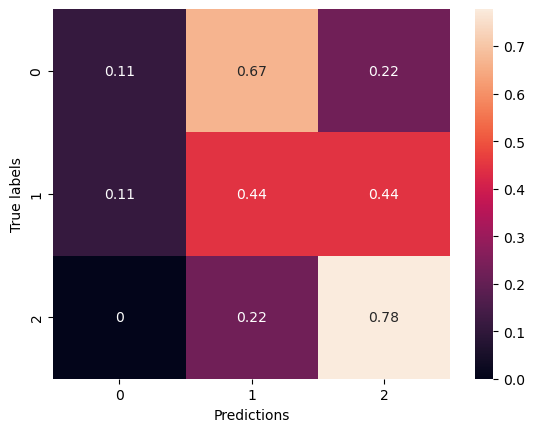

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▄▅▆▆▇▇▇▇▇█████████████████████████████
training_loss,█▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▂▂▂▁▂▂▃▄▃▃▄▅▆▇▇▆▆▅▆▆▆▇▇▇▇▅▆▇█▅▅▅▅▆▆▆▆█▆
val_loss,██▇▇▇▆▆▆▅▅▄▄▄▃▃▂▃▃▂▂▂▂▂▂▂▁▂▂▁▁▂▂▂▃▃▃▁▃▁▁


Epoch 1/100


2024-03-12 18:24:58.305712: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:24:58.307332: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:24:58.309764: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:24:59.921961: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:24:59.924076: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:24:59.925987: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:25:04.097752: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:25:04.682754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 40.7686 - accuracy: 0.3584

2024-03-12 18:25:08.076776: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:25:08.079011: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:25:08.080646: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 40.7686 - accuracy: 0.3584 - val_loss: 39.1208 - val_accuracy: 0.1852
Epoch 2/100
2/2 [==============================] - 1s 399ms/step - loss: 38.9966 - accuracy: 0.4475 - val_loss: 37.6194 - val_accuracy: 0.2593
Epoch 3/100
2/2 [==============================] - 1s 407ms/step - loss: 37.1969 - accuracy: 0.5274 - val_loss: 36.1505 - val_accuracy: 0.2315
Epoch 4/100
2/2 [==============================] - 1s 407ms/step - loss: 35.5691 - accuracy: 0.5776 - val_loss: 34.7181 - val_accuracy: 0.2315
Epoch 5/100
2/2 [==============================] - 1s 402ms/step - loss: 34.0486 - accuracy: 0.6210 - val_loss: 33.3283 - val_accuracy: 0.2222
Epoch 6/100
2/2 [==============================] - 1s 403ms/step - loss: 32.4878 - accuracy: 0.6461 - val_loss: 31.9703 - val_accuracy: 0.2037
Epoch 7/100
2/2 [==============================] - 1s 408ms/step - loss: 31.0791 - accuracy: 0.6849 - val_loss: 30.6455 - val_accuracy: 0.2037
Epoch 8/100
2

2/2 [==============================] - 1s 405ms/step - loss: 2.6243 - accuracy: 0.9840 - val_loss: 3.8548 - val_accuracy: 0.6111
Epoch 59/100
2/2 [==============================] - 1s 414ms/step - loss: 2.5176 - accuracy: 0.9817 - val_loss: 3.7590 - val_accuracy: 0.6019
Epoch 60/100
2/2 [==============================] - 1s 413ms/step - loss: 2.4264 - accuracy: 0.9863 - val_loss: 3.7906 - val_accuracy: 0.5833
Epoch 61/100
2/2 [==============================] - 1s 476ms/step - loss: 2.3378 - accuracy: 0.9909 - val_loss: 4.0172 - val_accuracy: 0.5093
Epoch 62/100
2/2 [==============================] - 1s 418ms/step - loss: 2.2850 - accuracy: 0.9772 - val_loss: 4.0107 - val_accuracy: 0.4722
Epoch 63/100
2/2 [==============================] - 1s 413ms/step - loss: 2.1731 - accuracy: 0.9886 - val_loss: 3.8643 - val_accuracy: 0.4815
Epoch 64/100
2/2 [==============================] - 1s 406ms/step - loss: 2.0870 - accuracy: 0.9932 - val_loss: 3.7471 - val_accuracy: 0.4722
Epoch 65/100
2/2 [=

2024-03-12 18:26:31.459672: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:26:31.461419: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:26:31.463660: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.497953176498413 s
{'0': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, '1': {'precision': 0.7142857142857143, 'recall': 0.5555555555555556, 'f1-score': 0.6250000000000001, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.6296296296296297, 'macro avg': {'precision': 0.6421356421356421, 'recall': 0.6296296296296297, 'f1-score': 0.6305555555555555, 'support': 27}, 'weighted avg': {'precision': 0.6421356421356421, 'recall': 0.6296296296296297, 'f1-score': 0.6305555555555555, 'support': 27}}


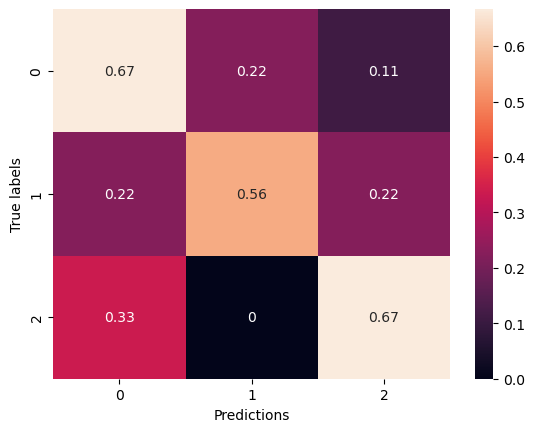

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▆▇▇▇▇█▇███████████████████████████
training_loss,█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▂▂▂▁▁▁▂▂▂▂▃▅▅▅▅▅▅▅▅█▆██▇▆▇███▇█▇▅▇▇█▇█▆
val_loss,█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:26:59.575925: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:26:59.577986: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:26:59.579624: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:27:01.189380: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:27:01.191315: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:27:01.193658: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:27:06.364906: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:27:06.950483: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 56.4457 - accuracy: 0.3219 

2024-03-12 18:27:10.326101: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:27:10.327782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:27:10.329719: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 56.4457 - accuracy: 0.3219 - val_loss: 53.8334 - val_accuracy: 0.3148
Epoch 2/100
2/2 [==============================] - 1s 412ms/step - loss: 53.5427 - accuracy: 0.4726 - val_loss: 51.5131 - val_accuracy: 0.2963
Epoch 3/100
2/2 [==============================] - 1s 410ms/step - loss: 51.0397 - accuracy: 0.5479 - val_loss: 49.2310 - val_accuracy: 0.3519
Epoch 4/100
2/2 [==============================] - 1s 420ms/step - loss: 48.7105 - accuracy: 0.5525 - val_loss: 47.0035 - val_accuracy: 0.3426
Epoch 5/100
2/2 [==============================] - 1s 412ms/step - loss: 46.3399 - accuracy: 0.6438 - val_loss: 44.8479 - val_accuracy: 0.3056
Epoch 6/100
2/2 [==============================] - 1s 404ms/step - loss: 44.2112 - accuracy: 0.6256 - val_loss: 42.7842 - val_accuracy: 0.2870
Epoch 7/100
2/2 [==============================] - 1s 402ms/step - loss: 42.0165 - accuracy: 0.6553 - val_loss: 40.7999 - val_accuracy: 0.2315
Epoch 8/100
2

2/2 [==============================] - 1s 414ms/step - loss: 2.7615 - accuracy: 0.9772 - val_loss: 4.5231 - val_accuracy: 0.4537
Epoch 59/100
2/2 [==============================] - 1s 412ms/step - loss: 2.6429 - accuracy: 0.9840 - val_loss: 4.2964 - val_accuracy: 0.4444
Epoch 60/100
2/2 [==============================] - 1s 404ms/step - loss: 2.5481 - accuracy: 0.9749 - val_loss: 4.2239 - val_accuracy: 0.4074
Epoch 61/100
2/2 [==============================] - 1s 410ms/step - loss: 2.4674 - accuracy: 0.9589 - val_loss: 4.2400 - val_accuracy: 0.3611
Epoch 62/100
2/2 [==============================] - 1s 415ms/step - loss: 2.3250 - accuracy: 0.9817 - val_loss: 4.3412 - val_accuracy: 0.4074
Epoch 63/100
2/2 [==============================] - 1s 476ms/step - loss: 2.2878 - accuracy: 0.9680 - val_loss: 4.1244 - val_accuracy: 0.3981
Epoch 64/100
2/2 [==============================] - 1s 408ms/step - loss: 2.1701 - accuracy: 0.9795 - val_loss: 3.7856 - val_accuracy: 0.4815
Epoch 65/100
2/2 [=

2024-03-12 18:28:33.949981: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:28:33.951599: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:28:33.953569: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4871628284454346 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.375, 'recall': 0.6666666666666666, 'f1-score': 0.4800000000000001, 'support': 9}, '2': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.47685185185185186, 'recall': 0.4444444444444444, 'f1-score': 0.4057912457912458, 'support': 27}, 'weighted avg': {'precision': 0.47685185185185186, 'recall': 0.4444444444444444, 'f1-score': 0.4057912457912458, 'support': 27}}


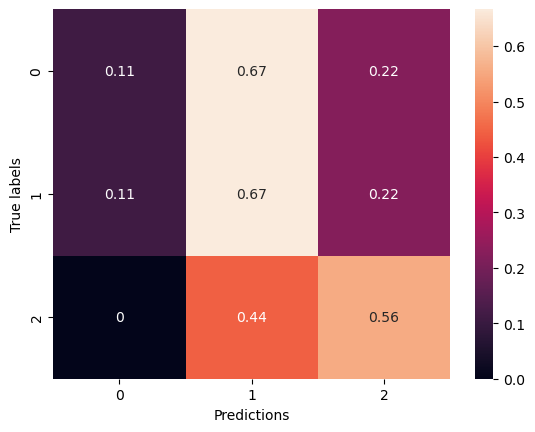

wandb: Network error (ConnectionError), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▅▆▆▆▇▇▇▇▇███████████████████████████
training_loss,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▃▂▁▂▁▁▂▃▂▂▃▄▅▅▅▆▅▄▆▆▆▆▅▄▆▄▆▆▇▇▆▆▄▇█▆▆▆▇
val_loss,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:30:52.026207: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:30:52.028075: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:30:52.029701: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:30:53.676067: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:30:53.678443: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:30:53.680458: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:30:57.936647: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:30:58.533612: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 9.4920 - accuracy: 0.3927

2024-03-12 18:31:01.976509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:31:01.978735: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:31:01.980442: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 9.4920 - accuracy: 0.3927 - val_loss: 9.0078 - val_accuracy: 0.1296
Epoch 2/100
2/2 [==============================] - 1s 477ms/step - loss: 9.3519 - accuracy: 0.3653 - val_loss: 8.9531 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 417ms/step - loss: 9.1123 - accuracy: 0.4269 - val_loss: 8.9062 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 417ms/step - loss: 8.8026 - accuracy: 0.4543 - val_loss: 8.8557 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 427ms/step - loss: 8.7006 - accuracy: 0.4703 - val_loss: 8.7964 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 423ms/step - loss: 8.5914 - accuracy: 0.4863 - val_loss: 8.7440 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 434ms/step - loss: 8.3404 - accuracy: 0.5411 - val_loss: 8.6889 - val_accuracy: 0.1204
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 443ms/step - loss: 3.2253 - accuracy: 0.9543 - val_loss: 5.0798 - val_accuracy: 0.4259
Epoch 60/100
2/2 [==============================] - 1s 441ms/step - loss: 3.2104 - accuracy: 0.9543 - val_loss: 5.0308 - val_accuracy: 0.4630
Epoch 61/100
2/2 [==============================] - 1s 435ms/step - loss: 3.1210 - accuracy: 0.9475 - val_loss: 5.0874 - val_accuracy: 0.4630
Epoch 62/100
2/2 [==============================] - 1s 454ms/step - loss: 3.0623 - accuracy: 0.9566 - val_loss: 5.3560 - val_accuracy: 0.4722
Epoch 63/100
2/2 [==============================] - 1s 435ms/step - loss: 3.0105 - accuracy: 0.9566 - val_loss: 5.7305 - val_accuracy: 0.3889
Epoch 64/100
2/2 [==============================] - 1s 428ms/step - loss: 2.9272 - accuracy: 0.9772 - val_loss: 5.7929 - val_accuracy: 0.3704
Epoch 65/100
2/2 [==============================] - 1s 431ms/step - loss: 2.9204 - accuracy: 0.9475 - val_loss: 5.4934 - val_accuracy: 0.4259
Epoch 

2024-03-12 18:32:27.812603: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:32:27.814261: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:32:27.816128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 2.5978429317474365 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.42857142857142855, 'recall': 0.6666666666666666, 'f1-score': 0.5217391304347826, 'support': 9}, '2': {'precision': 0.6363636363636364, 'recall': 0.7777777777777778, 'f1-score': 0.7000000000000001, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5216450216450217, 'recall': 0.5185185185185185, 'f1-score': 0.46785243741765487, 'support': 27}, 'weighted avg': {'precision': 0.5216450216450217, 'recall': 0.5185185185185185, 'f1-score': 0.4678524374176548, 'support': 27}}


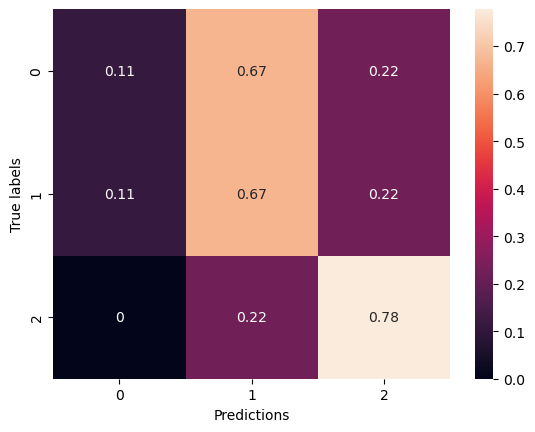

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▃▄▄▅▄▄▄▅▆▆▆▆▆▇▇▇▇▇▇▇▇███████████████
training_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▁▂▂▂▂▂▃▄▄▄▄▃▄▅▅▅▅▆▅▇▆▇▇█▇▇▅▇▇▇▇▆▇
val_loss,███▇▇▇▆▆▅▅▄▅▄▄▃▃▃▃▃▂▂▂▂▂▂▃▁▂▁▁▁▁▁▂▁▁▂▁▂▂


Epoch 1/100


2024-03-12 18:32:52.939002: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:32:52.940680: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:32:52.943072: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:32:54.553931: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:32:54.555748: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:32:54.557736: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:32:58.724137: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:32:59.310427: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 40.7622 - accuracy: 0.3470

2024-03-12 18:33:02.681796: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:33:02.685650: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:33:02.687465: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 40.7622 - accuracy: 0.3470 - val_loss: 38.9996 - val_accuracy: 0.4444
Epoch 2/100
2/2 [==============================] - 1s 413ms/step - loss: 39.1224 - accuracy: 0.3699 - val_loss: 37.5187 - val_accuracy: 0.3519
Epoch 3/100
2/2 [==============================] - 1s 410ms/step - loss: 37.4551 - accuracy: 0.4452 - val_loss: 36.0806 - val_accuracy: 0.2870
Epoch 4/100
2/2 [==============================] - 1s 417ms/step - loss: 36.0245 - accuracy: 0.4384 - val_loss: 34.6748 - val_accuracy: 0.2963
Epoch 5/100
2/2 [==============================] - 1s 474ms/step - loss: 34.4604 - accuracy: 0.4886 - val_loss: 33.3075 - val_accuracy: 0.2963
Epoch 6/100
2/2 [==============================] - 1s 414ms/step - loss: 33.1181 - accuracy: 0.5046 - val_loss: 31.9756 - val_accuracy: 0.2870
Epoch 7/100
2/2 [==============================] - 1s 406ms/step - loss: 31.6551 - accuracy: 0.5114 - val_loss: 30.6766 - val_accuracy: 0.2593
Epoch 8/100
2

2/2 [==============================] - 1s 423ms/step - loss: 3.1761 - accuracy: 0.9543 - val_loss: 5.1367 - val_accuracy: 0.4630
Epoch 59/100
2/2 [==============================] - 1s 421ms/step - loss: 3.0519 - accuracy: 0.9658 - val_loss: 5.8759 - val_accuracy: 0.3704
Epoch 60/100
2/2 [==============================] - 1s 414ms/step - loss: 2.9667 - accuracy: 0.9612 - val_loss: 4.6744 - val_accuracy: 0.5093
Epoch 61/100
2/2 [==============================] - 1s 413ms/step - loss: 2.8370 - accuracy: 0.9680 - val_loss: 4.2850 - val_accuracy: 0.6204
Epoch 62/100
2/2 [==============================] - 1s 407ms/step - loss: 2.7293 - accuracy: 0.9680 - val_loss: 4.2916 - val_accuracy: 0.5833
Epoch 63/100
2/2 [==============================] - 1s 411ms/step - loss: 2.6633 - accuracy: 0.9475 - val_loss: 4.2283 - val_accuracy: 0.5648
Epoch 64/100
2/2 [==============================] - 1s 408ms/step - loss: 2.5682 - accuracy: 0.9612 - val_loss: 4.2268 - val_accuracy: 0.5185
Epoch 65/100
2/2 [=

2024-03-12 18:34:26.154948: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:34:26.156556: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:34:26.158355: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4893739223480225 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, '2': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5128205128205128, 'recall': 0.5185185185185185, 'f1-score': 0.4632034632034632, 'support': 27}, 'weighted avg': {'precision': 0.5128205128205129, 'recall': 0.5185185185185185, 'f1-score': 0.4632034632034632, 'support': 27}}


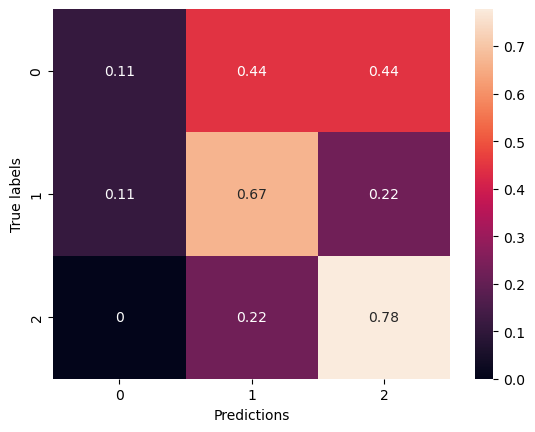

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▃▄▄▄▅▅▅▆▆▇▆▇▇▇▇▇▇███████████████████
training_loss,█▇▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▁▁▂▁▂▃▅▅▅▅▇▅▆▇▇▆▇█▆▆▅▃▇▅▆█▅▃▆▇█▅▇▇█▆▆▆
val_loss,█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:34:55.171798: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:34:55.173830: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:34:55.175594: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:34:56.797683: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:34:56.799734: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:34:56.801811: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:35:01.919308: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:35:02.505407: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 56.2616 - accuracy: 0.3721 

2024-03-12 18:35:05.875157: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:35:05.876782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:35:05.878840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 56.2616 - accuracy: 0.3721 - val_loss: 53.8099 - val_accuracy: 0.2593
Epoch 2/100
2/2 [==============================] - 1s 405ms/step - loss: 53.7821 - accuracy: 0.3699 - val_loss: 51.5652 - val_accuracy: 0.1574
Epoch 3/100
2/2 [==============================] - 1s 409ms/step - loss: 51.2901 - accuracy: 0.4292 - val_loss: 49.3975 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 406ms/step - loss: 49.0004 - accuracy: 0.4680 - val_loss: 47.2858 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 411ms/step - loss: 46.6730 - accuracy: 0.5091 - val_loss: 45.2209 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 407ms/step - loss: 44.7333 - accuracy: 0.4429 - val_loss: 43.2292 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 410ms/step - loss: 42.6268 - accuracy: 0.4840 - val_loss: 41.3226 - val_accuracy: 0.1389
Epoch 8/100
2

2/2 [==============================] - 1s 411ms/step - loss: 3.3666 - accuracy: 0.9543 - val_loss: 5.4015 - val_accuracy: 0.3519
Epoch 59/100
2/2 [==============================] - 1s 408ms/step - loss: 3.2349 - accuracy: 0.9521 - val_loss: 5.0020 - val_accuracy: 0.4537
Epoch 60/100
2/2 [==============================] - 1s 418ms/step - loss: 3.0724 - accuracy: 0.9589 - val_loss: 4.6572 - val_accuracy: 0.5370
Epoch 61/100
2/2 [==============================] - 1s 409ms/step - loss: 2.9383 - accuracy: 0.9817 - val_loss: 4.3770 - val_accuracy: 0.5741
Epoch 62/100
2/2 [==============================] - 1s 410ms/step - loss: 2.8302 - accuracy: 0.9680 - val_loss: 4.2175 - val_accuracy: 0.6019
Epoch 63/100
2/2 [==============================] - 1s 409ms/step - loss: 2.7183 - accuracy: 0.9772 - val_loss: 4.1216 - val_accuracy: 0.6019
Epoch 64/100
2/2 [==============================] - 1s 414ms/step - loss: 2.6599 - accuracy: 0.9521 - val_loss: 4.1226 - val_accuracy: 0.5926
Epoch 65/100
2/2 [=

2024-03-12 18:36:29.436582: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:36:29.438778: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:36:29.440358: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4916698932647705 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.375, 'recall': 0.6666666666666666, 'f1-score': 0.4800000000000001, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.625, 'recall': 0.4444444444444444, 'f1-score': 0.40210526315789474, 'support': 27}, 'weighted avg': {'precision': 0.625, 'recall': 0.4444444444444444, 'f1-score': 0.40210526315789474, 'support': 27}}


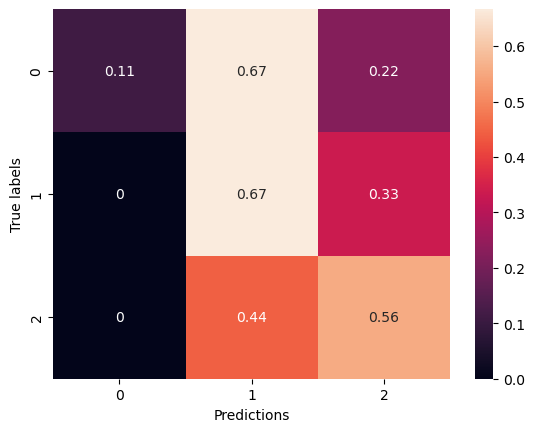

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▄▄▃▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇██████████████████
training_loss,█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▁▁▁▁▁▂▂▂▂▂▃▃▆▅▇▇▇▅▆▄▆▇▇█▅█▆▅▇▇▇▅▅███▆
val_loss,█▇▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:36:52.671314: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:36:52.673690: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:36:52.675252: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:36:54.285809: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:36:54.287591: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:36:54.289662: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:36:58.436070: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:36:59.021139: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 9.7294 - accuracy: 0.3196

2024-03-12 18:37:02.414946: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:37:02.417015: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:37:02.418574: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 9.7294 - accuracy: 0.3196 - val_loss: 9.0601 - val_accuracy: 0.2593
Epoch 2/100
2/2 [==============================] - 1s 409ms/step - loss: 9.5544 - accuracy: 0.3447 - val_loss: 8.9685 - val_accuracy: 0.2593
Epoch 3/100
2/2 [==============================] - 1s 409ms/step - loss: 9.3103 - accuracy: 0.3607 - val_loss: 8.8751 - val_accuracy: 0.2778
Epoch 4/100
2/2 [==============================] - 1s 412ms/step - loss: 9.2629 - accuracy: 0.3128 - val_loss: 8.7890 - val_accuracy: 0.2130
Epoch 5/100
2/2 [==============================] - 1s 410ms/step - loss: 9.0148 - accuracy: 0.4018 - val_loss: 8.6984 - val_accuracy: 0.1852
Epoch 6/100
2/2 [==============================] - 1s 406ms/step - loss: 8.9427 - accuracy: 0.3539 - val_loss: 8.6078 - val_accuracy: 0.1852
Epoch 7/100
2/2 [==============================] - 1s 404ms/step - loss: 8.7633 - accuracy: 0.3653 - val_loss: 8.5130 - val_accuracy: 0.1667
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 425ms/step - loss: 4.4411 - accuracy: 0.6507 - val_loss: 5.0741 - val_accuracy: 0.5000
Epoch 60/100
2/2 [==============================] - 1s 421ms/step - loss: 4.3267 - accuracy: 0.6712 - val_loss: 5.0368 - val_accuracy: 0.4907
Epoch 61/100
2/2 [==============================] - 1s 419ms/step - loss: 4.2773 - accuracy: 0.6621 - val_loss: 4.9721 - val_accuracy: 0.5000
Epoch 62/100
2/2 [==============================] - 1s 423ms/step - loss: 4.1739 - accuracy: 0.6735 - val_loss: 4.9715 - val_accuracy: 0.4815
Epoch 63/100
2/2 [==============================] - 1s 411ms/step - loss: 4.1285 - accuracy: 0.7055 - val_loss: 5.0569 - val_accuracy: 0.4444
Epoch 64/100
2/2 [==============================] - 1s 410ms/step - loss: 4.1337 - accuracy: 0.6644 - val_loss: 5.0536 - val_accuracy: 0.4722
Epoch 65/100
2/2 [==============================] - 1s 430ms/step - loss: 4.0776 - accuracy: 0.6530 - val_loss: 4.9213 - val_accuracy: 0.4722
Epoch 

2024-03-12 18:38:26.069102: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:38:26.071270: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:38:26.072837: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.479625940322876 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.7142857142857143, 'recall': 0.5555555555555556, 'f1-score': 0.6250000000000001, 'support': 9}, '2': {'precision': 0.45, 'recall': 1.0, 'f1-score': 0.6206896551724138, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.3880952380952381, 'recall': 0.5185185185185185, 'f1-score': 0.4152298850574713, 'support': 27}, 'weighted avg': {'precision': 0.38809523809523805, 'recall': 0.5185185185185185, 'f1-score': 0.4152298850574713, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


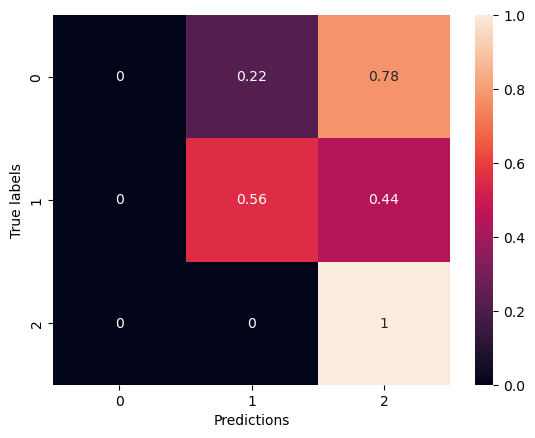

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▁▂▃▂▂▃▃▃▃▃▄▃▄▄▄▄▄▅▅▅▅▆▆▆▇▇▇▇▇▇▇▇██████
training_loss,██▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▃▂▁▂▂▁▁▁▁▁▁▁▁▁▂▄▃▄▄▅▆▇▇▇▆▅▆▇███▆█▆▇█▆▇█
val_loss,██▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▃▃▂▂▂▂▃▂▂▂▂▂▃▂▃▂▁▂▂▁


Epoch 1/100


2024-03-12 18:38:54.618826: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:38:54.620492: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:38:54.622449: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:38:56.225716: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:38:56.227585: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:38:56.229862: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:39:00.412592: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:39:00.997206: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 41.1120 - accuracy: 0.3219

2024-03-12 18:39:04.415233: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:39:04.417187: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:39:04.419307: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 41.1120 - accuracy: 0.3219 - val_loss: 39.2619 - val_accuracy: 0.4074
Epoch 2/100
2/2 [==============================] - 1s 418ms/step - loss: 39.6014 - accuracy: 0.3539 - val_loss: 37.9356 - val_accuracy: 0.3333
Epoch 3/100
2/2 [==============================] - 1s 412ms/step - loss: 38.2336 - accuracy: 0.3836 - val_loss: 36.6369 - val_accuracy: 0.2685
Epoch 4/100
2/2 [==============================] - 1s 415ms/step - loss: 36.8313 - accuracy: 0.3333 - val_loss: 35.3721 - val_accuracy: 0.2407
Epoch 5/100
2/2 [==============================] - 1s 414ms/step - loss: 35.4711 - accuracy: 0.3836 - val_loss: 34.1345 - val_accuracy: 0.1944
Epoch 6/100
2/2 [==============================] - 1s 409ms/step - loss: 34.2650 - accuracy: 0.3356 - val_loss: 32.9353 - val_accuracy: 0.1944
Epoch 7/100
2/2 [==============================] - 1s 416ms/step - loss: 32.8658 - accuracy: 0.3950 - val_loss: 31.7732 - val_accuracy: 0.1759
Epoch 8/100
2

2/2 [==============================] - 1s 422ms/step - loss: 5.0153 - accuracy: 0.7306 - val_loss: 5.5486 - val_accuracy: 0.5556
Epoch 59/100
2/2 [==============================] - 1s 418ms/step - loss: 4.9110 - accuracy: 0.7397 - val_loss: 5.4094 - val_accuracy: 0.5556
Epoch 60/100
2/2 [==============================] - 1s 421ms/step - loss: 4.6616 - accuracy: 0.7511 - val_loss: 5.3372 - val_accuracy: 0.5463
Epoch 61/100
2/2 [==============================] - 1s 415ms/step - loss: 4.5708 - accuracy: 0.7192 - val_loss: 5.1624 - val_accuracy: 0.5833
Epoch 62/100
2/2 [==============================] - 1s 414ms/step - loss: 4.4181 - accuracy: 0.7511 - val_loss: 5.0674 - val_accuracy: 0.5741
Epoch 63/100
2/2 [==============================] - 1s 410ms/step - loss: 4.3181 - accuracy: 0.7352 - val_loss: 5.0648 - val_accuracy: 0.5556
Epoch 64/100
2/2 [==============================] - 1s 411ms/step - loss: 4.1214 - accuracy: 0.7557 - val_loss: 5.1129 - val_accuracy: 0.5278
Epoch 65/100
2/2 [=

2024-03-12 18:40:27.831031: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:40:27.833160: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:40:27.835393: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5643179416656494 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '2': {'precision': 0.375, 'recall': 1.0, 'f1-score': 0.5454545454545454, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.34722222222222215, 'recall': 0.40740740740740744, 'f1-score': 0.2929292929292929, 'support': 27}, 'weighted avg': {'precision': 0.3472222222222222, 'recall': 0.4074074074074074, 'f1-score': 0.2929292929292929, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


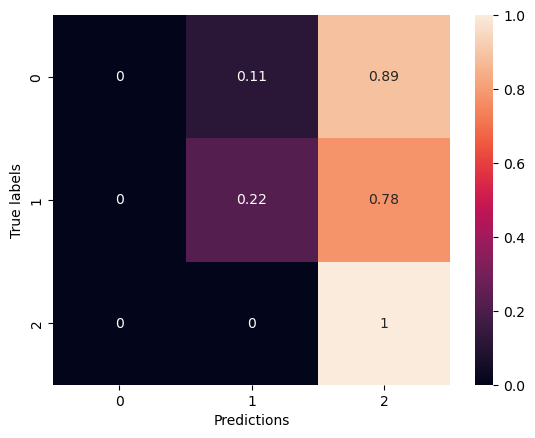

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇█████
training_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▃▂▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▃▂▆▃▅▇▇▆▇▇▅▆██▇█▇▇█▇█▇
val_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:40:55.806630: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:40:55.808358: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:40:55.810455: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:40:57.414049: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:40:57.416176: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:40:57.418001: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:41:02.515794: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:41:03.099689: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 56.6896 - accuracy: 0.3333 

2024-03-12 18:41:06.453311: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:41:06.454891: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:41:06.457074: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 56.6896 - accuracy: 0.3333 - val_loss: 54.2347 - val_accuracy: 0.2870
Epoch 2/100
2/2 [==============================] - 1s 417ms/step - loss: 54.3249 - accuracy: 0.3539 - val_loss: 52.1344 - val_accuracy: 0.2222
Epoch 3/100
2/2 [==============================] - 1s 416ms/step - loss: 52.1838 - accuracy: 0.3356 - val_loss: 50.0821 - val_accuracy: 0.2315
Epoch 4/100
2/2 [==============================] - 1s 406ms/step - loss: 50.0370 - accuracy: 0.3562 - val_loss: 48.0877 - val_accuracy: 0.2037
Epoch 5/100
2/2 [==============================] - 1s 404ms/step - loss: 47.9856 - accuracy: 0.3813 - val_loss: 46.1463 - val_accuracy: 0.1944
Epoch 6/100
2/2 [==============================] - 1s 411ms/step - loss: 46.0087 - accuracy: 0.3584 - val_loss: 44.2670 - val_accuracy: 0.1759
Epoch 7/100
2/2 [==============================] - 1s 411ms/step - loss: 44.0982 - accuracy: 0.4018 - val_loss: 42.4371 - val_accuracy: 0.1759
Epoch 8/100
2

2/2 [==============================] - 1s 408ms/step - loss: 5.0194 - accuracy: 0.7352 - val_loss: 6.1009 - val_accuracy: 0.3333
Epoch 59/100
2/2 [==============================] - 1s 409ms/step - loss: 4.9147 - accuracy: 0.6941 - val_loss: 5.8226 - val_accuracy: 0.3611
Epoch 60/100
2/2 [==============================] - 1s 409ms/step - loss: 4.7065 - accuracy: 0.7283 - val_loss: 5.1833 - val_accuracy: 0.5278
Epoch 61/100
2/2 [==============================] - 1s 406ms/step - loss: 4.5800 - accuracy: 0.7374 - val_loss: 5.0451 - val_accuracy: 0.5370
Epoch 62/100
2/2 [==============================] - 1s 412ms/step - loss: 4.4371 - accuracy: 0.7260 - val_loss: 5.1876 - val_accuracy: 0.4907
Epoch 63/100
2/2 [==============================] - 1s 410ms/step - loss: 4.2793 - accuracy: 0.7123 - val_loss: 5.4570 - val_accuracy: 0.3796
Epoch 64/100
2/2 [==============================] - 1s 414ms/step - loss: 4.1209 - accuracy: 0.7831 - val_loss: 5.0744 - val_accuracy: 0.4167
Epoch 65/100
2/2 [=

2024-03-12 18:42:30.014436: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:42:30.016070: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:42:30.018405: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4863941669464111 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '2': {'precision': 0.391304347826087, 'recall': 1.0, 'f1-score': 0.5625, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.5748792270531401, 'recall': 0.40740740740740744, 'f1-score': 0.30972222222222223, 'support': 27}, 'weighted avg': {'precision': 0.5748792270531401, 'recall': 0.4074074074074074, 'f1-score': 0.30972222222222223, 'support': 27}}


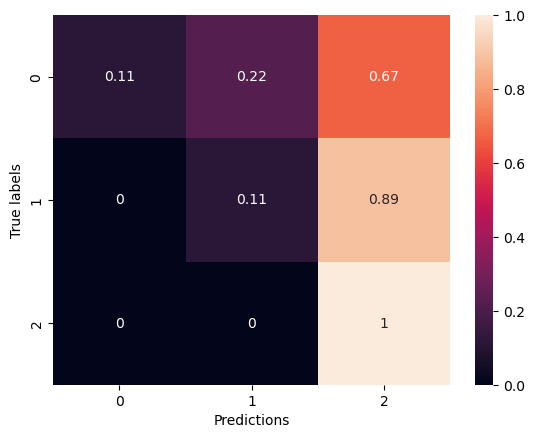

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▁▂▁▂▂▂▂▃▃▃▃▃▄▄▄▅▄▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇██████
training_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▃▃▅▅▅▅▄▇▅▇█▆▆▇█▇▆▆▇▅███
val_loss,█▇▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:42:56.532931: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:42:56.535042: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:42:56.537092: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:42:58.157338: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:42:58.159503: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:42:58.161878: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:43:02.294032: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:43:02.882072: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 11.2650 - accuracy: 0.3402

2024-03-12 18:43:06.422051: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:43:06.424128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:43:06.426036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 11.2650 - accuracy: 0.3402 - val_loss: 10.7233 - val_accuracy: 0.1759
Epoch 2/100
2/2 [==============================] - 1s 513ms/step - loss: 10.5770 - accuracy: 0.5160 - val_loss: 10.5909 - val_accuracy: 0.1667
Epoch 3/100
2/2 [==============================] - 1s 574ms/step - loss: 10.1207 - accuracy: 0.6256 - val_loss: 10.4543 - val_accuracy: 0.1481
Epoch 4/100
2/2 [==============================] - 1s 513ms/step - loss: 9.9604 - accuracy: 0.6301 - val_loss: 10.3030 - val_accuracy: 0.1481
Epoch 5/100
2/2 [==============================] - 1s 633ms/step - loss: 9.5947 - accuracy: 0.6941 - val_loss: 10.1561 - val_accuracy: 0.1389
Epoch 6/100
2/2 [==============================] - 1s 517ms/step - loss: 9.3792 - accuracy: 0.7352 - val_loss: 10.0378 - val_accuracy: 0.1481
Epoch 7/100
2/2 [==============================] - 1s 519ms/step - loss: 9.0847 - accuracy: 0.7489 - val_loss: 9.9291 - val_accuracy: 0.1389
Epoch 8/100
2/2 [=

Epoch 59/100
2/2 [==============================] - 1s 524ms/step - loss: 2.0762 - accuracy: 0.9932 - val_loss: 4.9411 - val_accuracy: 0.4074
Epoch 60/100
2/2 [==============================] - 1s 516ms/step - loss: 2.0152 - accuracy: 0.9954 - val_loss: 5.0623 - val_accuracy: 0.3796
Epoch 61/100
2/2 [==============================] - 1s 513ms/step - loss: 1.9716 - accuracy: 0.9954 - val_loss: 5.0388 - val_accuracy: 0.3981
Epoch 62/100
2/2 [==============================] - 1s 514ms/step - loss: 1.9163 - accuracy: 0.9932 - val_loss: 5.1270 - val_accuracy: 0.3981
Epoch 63/100
2/2 [==============================] - 1s 512ms/step - loss: 1.8749 - accuracy: 0.9863 - val_loss: 5.0384 - val_accuracy: 0.3981
Epoch 64/100
2/2 [==============================] - 1s 510ms/step - loss: 1.8295 - accuracy: 0.9932 - val_loss: 4.5944 - val_accuracy: 0.4352
Epoch 65/100
2/2 [==============================] - 1s 522ms/step - loss: 1.7761 - accuracy: 0.9932 - val_loss: 4.4041 - val_accuracy: 0.4444
Epoch 

2024-03-12 18:44:51.082334: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:44:51.084260: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:44:51.086224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5067358016967773 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, '2': {'precision': 0.5333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.6666666666666667, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6929292929292928, 'recall': 0.5555555555555555, 'f1-score': 0.48888888888888893, 'support': 27}, 'weighted avg': {'precision': 0.6929292929292928, 'recall': 0.5555555555555556, 'f1-score': 0.4888888888888889, 'support': 27}}


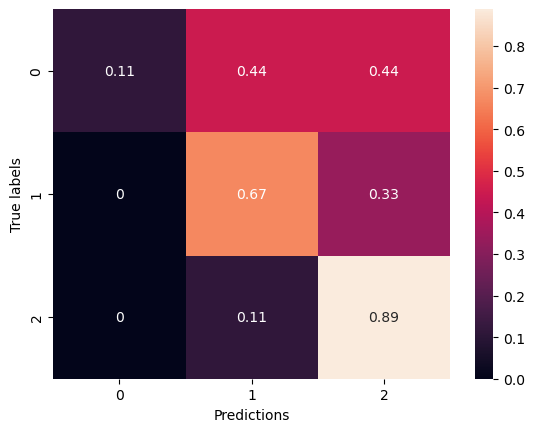

wandb: Network error (ConnectionError), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇▇████████████████████████████████
training_loss,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▂▂▁▁▁▁▂▂▂▃▃▃▃▃▃▄▅▆▅▅▅▄▆▆▆▆▅▄▇█▇▇▇▅▅██▆▆
val_loss,██▇▇▇▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▃▂▂▃▄▁▁▁▁▂▃▄▁▁▃▂


Epoch 1/100


2024-03-12 18:49:17.159473: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:49:17.161148: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:49:17.163293: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:49:19.825441: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:49:19.827875: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:49:19.830028: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:49:24.081259: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:49:24.664812: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 49.4049 - accuracy: 0.3082 

2024-03-12 18:49:28.273171: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:49:28.274907: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:49:28.276888: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 49.4049 - accuracy: 0.3082 - val_loss: 47.1484 - val_accuracy: 0.1574
Epoch 2/100
2/2 [==============================] - 1s 529ms/step - loss: 46.6767 - accuracy: 0.5411 - val_loss: 45.0644 - val_accuracy: 0.1574
Epoch 3/100
2/2 [==============================] - 1s 527ms/step - loss: 44.6328 - accuracy: 0.5068 - val_loss: 42.9938 - val_accuracy: 0.1759
Epoch 4/100
2/2 [==============================] - 1s 513ms/step - loss: 42.2722 - accuracy: 0.6324 - val_loss: 40.9636 - val_accuracy: 0.1852
Epoch 5/100
2/2 [==============================] - 1s 529ms/step - loss: 40.1433 - accuracy: 0.6416 - val_loss: 38.9739 - val_accuracy: 0.1852
Epoch 6/100
2/2 [==============================] - 1s 529ms/step - loss: 38.0939 - accuracy: 0.7055 - val_loss: 37.0472 - val_accuracy: 0.2222
Epoch 7/100
2/2 [==============================] - 1s 513ms/step - loss: 36.1292 - accuracy: 0.7123 - val_loss: 35.1997 - val_accuracy: 0.2315
Epoch 8/100
2

2/2 [==============================] - 1s 505ms/step - loss: 2.1223 - accuracy: 0.9909 - val_loss: 4.3460 - val_accuracy: 0.3796
Epoch 59/100
2/2 [==============================] - 1s 512ms/step - loss: 2.1029 - accuracy: 0.9726 - val_loss: 4.6378 - val_accuracy: 0.3981
Epoch 60/100
2/2 [==============================] - 1s 514ms/step - loss: 2.0194 - accuracy: 0.9817 - val_loss: 4.2695 - val_accuracy: 0.4167
Epoch 61/100
2/2 [==============================] - 1s 509ms/step - loss: 1.9602 - accuracy: 0.9680 - val_loss: 4.0040 - val_accuracy: 0.4259
Epoch 62/100
2/2 [==============================] - 1s 509ms/step - loss: 1.8913 - accuracy: 0.9749 - val_loss: 3.9287 - val_accuracy: 0.4722
Epoch 63/100
2/2 [==============================] - 1s 511ms/step - loss: 1.8170 - accuracy: 0.9795 - val_loss: 3.8837 - val_accuracy: 0.4352
Epoch 64/100
2/2 [==============================] - 1s 506ms/step - loss: 1.7480 - accuracy: 0.9840 - val_loss: 4.1009 - val_accuracy: 0.3981
Epoch 65/100
2/2 [=

2024-03-12 18:51:15.094801: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:51:15.096911: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:51:15.098525: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.496495246887207 s
{'0': {'precision': 0.6, 'recall': 0.6666666666666666, 'f1-score': 0.631578947368421, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.8888888888888888, 'f1-score': 0.761904761904762, 'support': 9}, 'accuracy': 0.6296296296296297, 'macro avg': {'precision': 0.6222222222222222, 'recall': 0.6296296296296297, 'f1-score': 0.6073517126148705, 'support': 27}, 'weighted avg': {'precision': 0.6222222222222221, 'recall': 0.6296296296296297, 'f1-score': 0.6073517126148705, 'support': 27}}


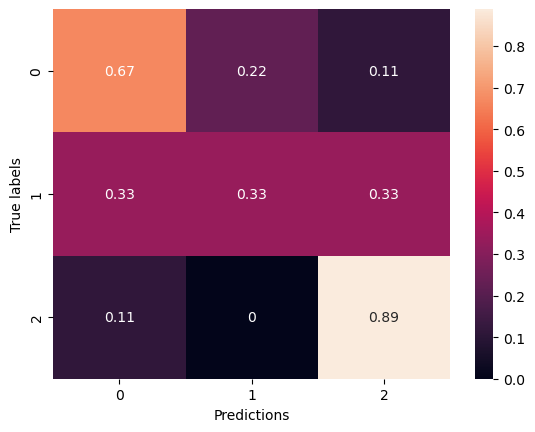

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▆▇▇▇▇███████████████████████████████
training_loss,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▃▁▁▁▂▂▂▃▃▃▄▄▄▄▄▃▅▆▆▆▅▆▅██▇▇█▇██▆▇▇█▇▆
val_loss,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:51:39.008437: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:51:39.010062: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:51:39.012044: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:51:40.641245: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:51:40.643144: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:51:40.645228: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:51:44.818603: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:51:46.367317: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 68.0286 - accuracy: 0.3881 

2024-03-12 18:51:50.098528: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:51:50.100183: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:51:50.102036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 68.0286 - accuracy: 0.3881 - val_loss: 65.0403 - val_accuracy: 0.1481
Epoch 2/100
2/2 [==============================] - 1s 511ms/step - loss: 64.3573 - accuracy: 0.4612 - val_loss: 61.7766 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 530ms/step - loss: 60.6912 - accuracy: 0.5822 - val_loss: 58.5776 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 597ms/step - loss: 57.4315 - accuracy: 0.5731 - val_loss: 55.4934 - val_accuracy: 0.1111
Epoch 5/100
2/2 [==============================] - 1s 524ms/step - loss: 54.2626 - accuracy: 0.6324 - val_loss: 52.5023 - val_accuracy: 0.1111
Epoch 6/100
2/2 [==============================] - 1s 508ms/step - loss: 51.1566 - accuracy: 0.6621 - val_loss: 49.6057 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 517ms/step - loss: 48.1610 - accuracy: 0.6963 - val_loss: 46.8228 - val_accuracy: 0.1204
Epoch 8/100
2

2/2 [==============================] - 1s 512ms/step - loss: 2.1493 - accuracy: 0.9840 - val_loss: 3.7758 - val_accuracy: 0.4722
Epoch 59/100
2/2 [==============================] - 1s 512ms/step - loss: 2.0816 - accuracy: 0.9749 - val_loss: 3.5760 - val_accuracy: 0.5370
Epoch 60/100
2/2 [==============================] - 1s 516ms/step - loss: 2.0350 - accuracy: 0.9680 - val_loss: 3.8610 - val_accuracy: 0.4630
Epoch 61/100
2/2 [==============================] - 1s 520ms/step - loss: 1.9467 - accuracy: 0.9749 - val_loss: 3.9936 - val_accuracy: 0.4444
Epoch 62/100
2/2 [==============================] - 1s 512ms/step - loss: 1.8868 - accuracy: 0.9772 - val_loss: 3.7393 - val_accuracy: 0.4907
Epoch 63/100
2/2 [==============================] - 1s 510ms/step - loss: 1.8111 - accuracy: 0.9749 - val_loss: 3.4825 - val_accuracy: 0.5370
Epoch 64/100
2/2 [==============================] - 1s 508ms/step - loss: 1.7594 - accuracy: 0.9795 - val_loss: 3.3186 - val_accuracy: 0.5833
Epoch 65/100
2/2 [=

2024-03-12 18:53:34.006087: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:53:34.007763: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:53:34.009708: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.505885124206543 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5504273504273504, 'recall': 0.5185185185185185, 'f1-score': 0.5165945165945166, 'support': 27}, 'weighted avg': {'precision': 0.5504273504273505, 'recall': 0.5185185185185185, 'f1-score': 0.5165945165945166, 'support': 27}}


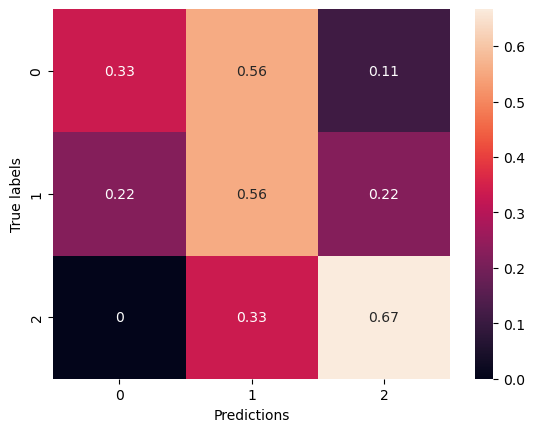

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▆▇▇▇██████████████████████████▇███
training_loss,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▁▂▄▄▄▅▅▅▇▇█▇▇█▅▅▇▆█▇▅▆███▇▆▆▇▇█▅▆
val_loss,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 18:53:58.637755: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:53:58.639818: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:53:58.641634: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:54:00.333885: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:54:00.336121: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:54:00.337799: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:54:04.484337: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:54:05.068509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 11.3626 - accuracy: 0.3379

2024-03-12 18:54:08.631756: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:54:08.633533: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:54:08.635883: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 11.3626 - accuracy: 0.3379 - val_loss: 10.6794 - val_accuracy: 0.1481
Epoch 2/100
2/2 [==============================] - 1s 591ms/step - loss: 10.8445 - accuracy: 0.4384 - val_loss: 10.6702 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 521ms/step - loss: 10.5443 - accuracy: 0.4703 - val_loss: 10.6527 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 511ms/step - loss: 10.3439 - accuracy: 0.5046 - val_loss: 10.5729 - val_accuracy: 0.1389
Epoch 5/100
2/2 [==============================] - 1s 515ms/step - loss: 10.1495 - accuracy: 0.4932 - val_loss: 10.4844 - val_accuracy: 0.1389
Epoch 6/100
2/2 [==============================] - 1s 506ms/step - loss: 9.8883 - accuracy: 0.5616 - val_loss: 10.4032 - val_accuracy: 0.1389
Epoch 7/100
2/2 [==============================] - 1s 513ms/step - loss: 9.7405 - accuracy: 0.5525 - val_loss: 10.3282 - val_accuracy: 0.1296
Epoch 8/100
2/2

Epoch 59/100
2/2 [==============================] - 1s 520ms/step - loss: 3.1894 - accuracy: 0.9817 - val_loss: 6.0389 - val_accuracy: 0.4352
Epoch 60/100
2/2 [==============================] - 1s 508ms/step - loss: 3.0992 - accuracy: 0.9886 - val_loss: 5.9252 - val_accuracy: 0.4630
Epoch 61/100
2/2 [==============================] - 1s 514ms/step - loss: 3.0558 - accuracy: 0.9772 - val_loss: 5.9277 - val_accuracy: 0.4352
Epoch 62/100
2/2 [==============================] - 1s 524ms/step - loss: 3.0003 - accuracy: 0.9795 - val_loss: 5.7882 - val_accuracy: 0.4722
Epoch 63/100
2/2 [==============================] - 1s 513ms/step - loss: 2.9212 - accuracy: 0.9886 - val_loss: 5.7570 - val_accuracy: 0.5185
Epoch 64/100
2/2 [==============================] - 1s 518ms/step - loss: 2.8836 - accuracy: 0.9772 - val_loss: 5.6514 - val_accuracy: 0.5093
Epoch 65/100
2/2 [==============================] - 1s 513ms/step - loss: 2.8199 - accuracy: 0.9817 - val_loss: 5.7106 - val_accuracy: 0.4722
Epoch 

2024-03-12 18:55:53.299899: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:55:53.302365: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:55:53.304005: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5089538097381592 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.6666666666666666, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.4444444444444444, 'f1-score': 0.380952380952381, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.24444444444444446, 'recall': 0.3703703703703704, 'f1-score': 0.29365079365079366, 'support': 27}, 'weighted avg': {'precision': 0.24444444444444444, 'recall': 0.37037037037037035, 'f1-score': 0.29365079365079366, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


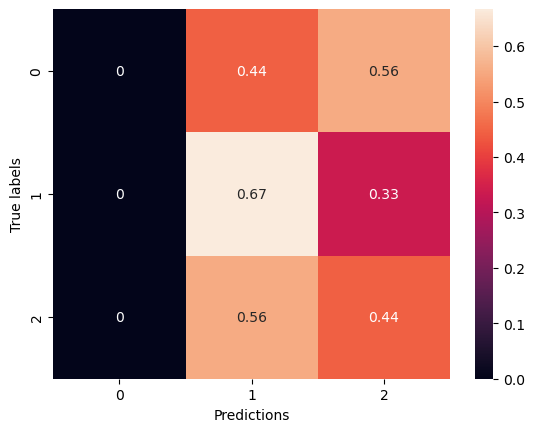

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▅▅▅▆▆▆▆▆▇▇▇▇▇▇█████████████████████
training_loss,█▇▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▁▁▁▁▂▃▃▂▃▆▆▄▅▆▆▄▄▆▆▇▇▇▆▆▅▆█▇▇███▇▇
val_loss,███▇▇▇▇▇▇▆▅▅▅▅▄▃▃▃▃▂▂▃▃▂▂▂▂▁▂▂▃▃▁▂▂▁▁▁▁▂


Epoch 1/100


2024-03-12 18:56:18.695448: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:56:18.697250: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:56:18.698988: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:56:20.312151: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:56:20.313980: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:56:20.316437: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 18:56:25.535247: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 18:56:26.112096: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 49.1562 - accuracy: 0.3744 

2024-03-12 18:56:29.653859: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:56:29.655418: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:56:29.657550: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 49.1562 - accuracy: 0.3744 - val_loss: 47.0033 - val_accuracy: 0.2037
Epoch 2/100
2/2 [==============================] - 1s 534ms/step - loss: 46.8167 - accuracy: 0.4201 - val_loss: 44.9824 - val_accuracy: 0.1759
Epoch 3/100
2/2 [==============================] - 1s 518ms/step - loss: 44.6615 - accuracy: 0.4315 - val_loss: 43.0482 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 508ms/step - loss: 42.5904 - accuracy: 0.4795 - val_loss: 41.1548 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 519ms/step - loss: 40.5747 - accuracy: 0.5160 - val_loss: 39.2948 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 521ms/step - loss: 38.5170 - accuracy: 0.5685 - val_loss: 37.4805 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 516ms/step - loss: 36.6484 - accuracy: 0.6005 - val_loss: 35.7136 - val_accuracy: 0.1296
Epoch 8/100
2

2/2 [==============================] - 1s 505ms/step - loss: 2.6674 - accuracy: 0.9795 - val_loss: 4.0736 - val_accuracy: 0.6111
Epoch 59/100
2/2 [==============================] - 1s 506ms/step - loss: 2.5286 - accuracy: 0.9886 - val_loss: 4.3314 - val_accuracy: 0.5741
Epoch 60/100
2/2 [==============================] - 1s 530ms/step - loss: 2.4999 - accuracy: 0.9589 - val_loss: 4.2155 - val_accuracy: 0.5833
Epoch 61/100
2/2 [==============================] - 1s 510ms/step - loss: 2.3619 - accuracy: 0.9840 - val_loss: 4.6916 - val_accuracy: 0.4907
Epoch 62/100
2/2 [==============================] - 1s 512ms/step - loss: 2.3263 - accuracy: 0.9680 - val_loss: 4.4082 - val_accuracy: 0.5833
Epoch 63/100
2/2 [==============================] - 1s 520ms/step - loss: 2.2687 - accuracy: 0.9635 - val_loss: 3.9445 - val_accuracy: 0.5833
Epoch 64/100
2/2 [==============================] - 1s 502ms/step - loss: 2.1126 - accuracy: 0.9909 - val_loss: 4.2051 - val_accuracy: 0.6204
Epoch 65/100
2/2 [=

2024-03-12 18:58:15.898966: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 18:58:15.901404: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 18:58:15.903066: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4981892108917236 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.5, 'recall': 1.0, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.35185185185185186, 'recall': 0.5185185185185185, 'f1-score': 0.40740740740740744, 'support': 27}, 'weighted avg': {'precision': 0.35185185185185186, 'recall': 0.5185185185185185, 'f1-score': 0.4074074074074074, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


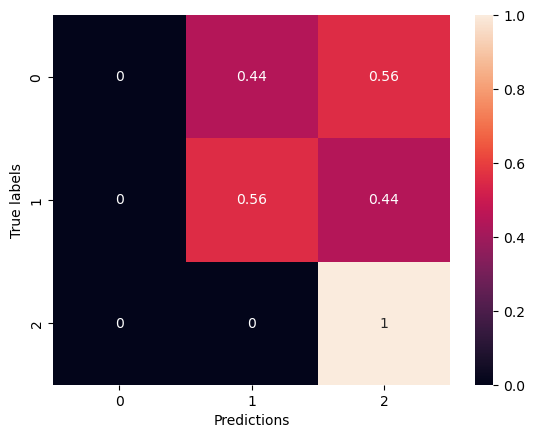

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▅▅▅▆▅▆▆▇▇▇▇████████████████████████
training_loss,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▂▂▂▁▃▃▂▂▅▄▄▆▇▇█▄▅██▇▆███▆▇▆▇▇█▇▇█▇▇█
val_loss,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 19:12:28.173895: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:12:28.176347: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:12:28.178153: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:12:29.835646: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:12:29.837415: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:12:29.839767: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:12:34.029984: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:12:34.625042: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 68.5059 - accuracy: 0.3219

2024-03-12 19:12:38.221606: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:12:38.223314: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:12:38.225554: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 68.5059 - accuracy: 0.3219 - val_loss: 65.2318 - val_accuracy: 0.3796
Epoch 2/100
2/2 [==============================] - 1s 574ms/step - loss: 65.0127 - accuracy: 0.3676 - val_loss: 62.1073 - val_accuracy: 0.2500
Epoch 3/100
2/2 [==============================] - 1s 515ms/step - loss: 61.6141 - accuracy: 0.4612 - val_loss: 59.0646 - val_accuracy: 0.1944
Epoch 4/100
2/2 [==============================] - 1s 517ms/step - loss: 58.4055 - accuracy: 0.5114 - val_loss: 56.0987 - val_accuracy: 0.1759
Epoch 5/100
2/2 [==============================] - 1s 513ms/step - loss: 55.3538 - accuracy: 0.5502 - val_loss: 53.2317 - val_accuracy: 0.1852
Epoch 6/100
2/2 [==============================] - 1s 509ms/step - loss: 52.4395 - accuracy: 0.5913 - val_loss: 50.4682 - val_accuracy: 0.1759
Epoch 7/100
2/2 [==============================] - 1s 509ms/step - loss: 49.6607 - accuracy: 0.5594 - val_loss: 47.7902 - val_accuracy: 0.1944
Epoch 8/100
2

2/2 [==============================] - 1s 520ms/step - loss: 2.7176 - accuracy: 0.9703 - val_loss: 4.0293 - val_accuracy: 0.6019
Epoch 59/100
2/2 [==============================] - 1s 530ms/step - loss: 2.6090 - accuracy: 0.9635 - val_loss: 4.0109 - val_accuracy: 0.6111
Epoch 60/100
2/2 [==============================] - 1s 523ms/step - loss: 2.4545 - accuracy: 0.9840 - val_loss: 4.0409 - val_accuracy: 0.5556
Epoch 61/100
2/2 [==============================] - 1s 513ms/step - loss: 2.4092 - accuracy: 0.9703 - val_loss: 4.0396 - val_accuracy: 0.4907
Epoch 62/100
2/2 [==============================] - 1s 520ms/step - loss: 2.3130 - accuracy: 0.9772 - val_loss: 4.3804 - val_accuracy: 0.4907
Epoch 63/100
2/2 [==============================] - 1s 510ms/step - loss: 2.2564 - accuracy: 0.9658 - val_loss: 4.4846 - val_accuracy: 0.4352
Epoch 64/100
2/2 [==============================] - 1s 507ms/step - loss: 2.1357 - accuracy: 0.9817 - val_loss: 4.6682 - val_accuracy: 0.3981
Epoch 65/100
2/2 [=

2024-03-12 19:14:23.860357: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:14:23.861980: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:14:23.864272: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 2.655109167098999 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '2': {'precision': 0.47368421052631576, 'recall': 1.0, 'f1-score': 0.6428571428571429, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.3245614035087719, 'recall': 0.48148148148148145, 'f1-score': 0.3711484593837535, 'support': 27}, 'weighted avg': {'precision': 0.32456140350877194, 'recall': 0.48148148148148145, 'f1-score': 0.37114845938375357, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


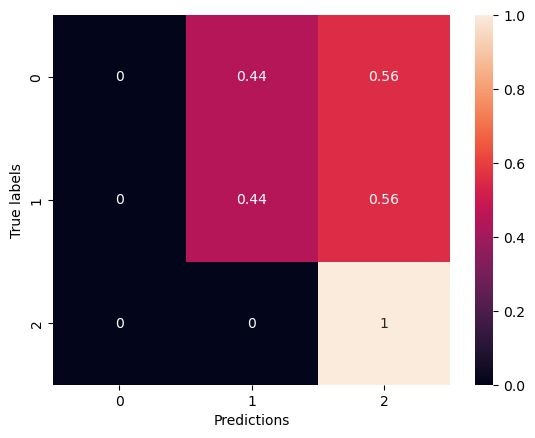

wandb: Network error (ConnectionError), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▄▃▄▅▅▅▆▆▆▇▇▇▇▇▇▇██████████████████████
training_loss,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▂▁▁▁▁▂▂▁▂▃▂▃▃▄▄▄▄▄▅▆▃▇▇▆▄▇▇▇▄▆▅▇▄▄▅▆▆▇█
val_loss,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 19:18:37.535138: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:18:37.536973: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:18:37.539133: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:18:39.161785: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:18:39.163999: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:18:39.165972: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:18:43.356657: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:18:43.937678: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 11.3727 - accuracy: 0.3447

2024-03-12 19:18:47.562702: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:18:47.564581: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:18:47.566543: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 11.3727 - accuracy: 0.3447 - val_loss: 10.5517 - val_accuracy: 0.3426
Epoch 2/100
2/2 [==============================] - 1s 516ms/step - loss: 11.1102 - accuracy: 0.3425 - val_loss: 10.4449 - val_accuracy: 0.3519
Epoch 3/100
2/2 [==============================] - 1s 517ms/step - loss: 10.8973 - accuracy: 0.3265 - val_loss: 10.3277 - val_accuracy: 0.3241
Epoch 4/100
2/2 [==============================] - 1s 539ms/step - loss: 10.6915 - accuracy: 0.3630 - val_loss: 10.2316 - val_accuracy: 0.2500
Epoch 5/100
2/2 [==============================] - 1s 518ms/step - loss: 10.6073 - accuracy: 0.3653 - val_loss: 10.1477 - val_accuracy: 0.2037
Epoch 6/100
2/2 [==============================] - 1s 514ms/step - loss: 10.3317 - accuracy: 0.4110 - val_loss: 10.0638 - val_accuracy: 0.1667
Epoch 7/100
2/2 [==============================] - 1s 514ms/step - loss: 10.1432 - accuracy: 0.4155 - val_loss: 9.9864 - val_accuracy: 0.1759
Epoch 8/100
2/

Epoch 59/100
2/2 [==============================] - 1s 546ms/step - loss: 4.4269 - accuracy: 0.7968 - val_loss: 5.6902 - val_accuracy: 0.4815
Epoch 60/100
2/2 [==============================] - 1s 519ms/step - loss: 4.3736 - accuracy: 0.7763 - val_loss: 5.6470 - val_accuracy: 0.4722
Epoch 61/100
2/2 [==============================] - 1s 602ms/step - loss: 4.2624 - accuracy: 0.7968 - val_loss: 5.6677 - val_accuracy: 0.4722
Epoch 62/100
2/2 [==============================] - 1s 534ms/step - loss: 4.1804 - accuracy: 0.8128 - val_loss: 5.9949 - val_accuracy: 0.4537
Epoch 63/100
2/2 [==============================] - 1s 518ms/step - loss: 4.1232 - accuracy: 0.7991 - val_loss: 5.7846 - val_accuracy: 0.4630
Epoch 64/100
2/2 [==============================] - 1s 527ms/step - loss: 4.1371 - accuracy: 0.7785 - val_loss: 5.7349 - val_accuracy: 0.4907
Epoch 65/100
2/2 [==============================] - 1s 518ms/step - loss: 4.0308 - accuracy: 0.7991 - val_loss: 5.6141 - val_accuracy: 0.5000
Epoch 

2024-03-12 19:20:32.256180: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:20:32.258476: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:20:32.260130: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4980816841125488 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.375, 'recall': 0.3333333333333333, 'f1-score': 0.35294117647058826, 'support': 9}, '2': {'precision': 0.5, 'recall': 1.0, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.2916666666666667, 'recall': 0.4444444444444444, 'f1-score': 0.3398692810457516, 'support': 27}, 'weighted avg': {'precision': 0.2916666666666667, 'recall': 0.4444444444444444, 'f1-score': 0.3398692810457516, 'support': 27}}


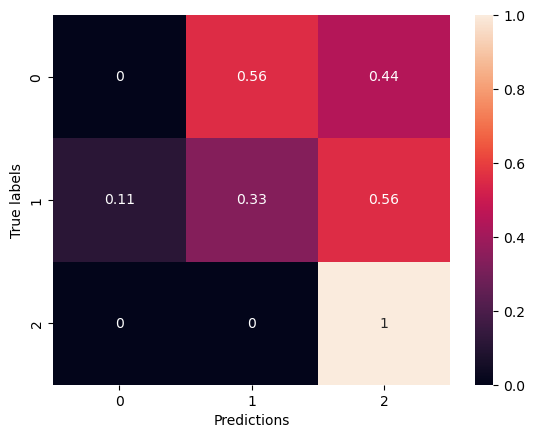

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▆▅▆▆▆▆▇▇▇▇▇▇▇▇▇████
training_loss,██▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▄▂▂▁▁▁▁▁▁▁▁▁▂▂▂▂▂▃▂▃▄▅▆▆▆▆▇▇████▇█▇▇▇▇▇
val_loss,██▇▇▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▆▅▃▂▂▂▂▂▁▁▁▁▁▁▂▁▁▁▂▂▁


Epoch 1/100


2024-03-12 19:20:59.582812: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:20:59.584429: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:20:59.586239: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:21:01.210984: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:21:01.212792: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:21:01.215493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:21:06.328445: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:21:06.909122: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 49.3786 - accuracy: 0.3311 

2024-03-12 19:21:10.470475: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:21:10.472248: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:21:10.474088: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 49.3786 - accuracy: 0.3311 - val_loss: 47.0759 - val_accuracy: 0.3796
Epoch 2/100
2/2 [==============================] - 1s 516ms/step - loss: 47.2302 - accuracy: 0.3744 - val_loss: 45.2491 - val_accuracy: 0.1759
Epoch 3/100
2/2 [==============================] - 1s 513ms/step - loss: 45.2098 - accuracy: 0.3790 - val_loss: 43.4925 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 508ms/step - loss: 43.4897 - accuracy: 0.3425 - val_loss: 41.7897 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 512ms/step - loss: 41.5776 - accuracy: 0.3904 - val_loss: 40.1370 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 524ms/step - loss: 39.7210 - accuracy: 0.4338 - val_loss: 38.5293 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 517ms/step - loss: 38.0918 - accuracy: 0.4201 - val_loss: 36.9835 - val_accuracy: 0.1204
Epoch 8/100
2

2/2 [==============================] - 1s 512ms/step - loss: 4.2215 - accuracy: 0.8379 - val_loss: 4.9054 - val_accuracy: 0.6296
Epoch 59/100
2/2 [==============================] - 1s 510ms/step - loss: 4.0817 - accuracy: 0.8265 - val_loss: 5.0095 - val_accuracy: 0.6111
Epoch 60/100
2/2 [==============================] - 1s 513ms/step - loss: 3.9475 - accuracy: 0.8379 - val_loss: 4.8560 - val_accuracy: 0.6019
Epoch 61/100
2/2 [==============================] - 1s 513ms/step - loss: 3.7632 - accuracy: 0.8767 - val_loss: 5.1293 - val_accuracy: 0.5278
Epoch 62/100
2/2 [==============================] - 1s 514ms/step - loss: 3.7028 - accuracy: 0.8447 - val_loss: 4.6382 - val_accuracy: 0.6296
Epoch 63/100
2/2 [==============================] - 1s 510ms/step - loss: 3.5223 - accuracy: 0.8767 - val_loss: 4.5296 - val_accuracy: 0.6204
Epoch 64/100
2/2 [==============================] - 1s 516ms/step - loss: 3.4360 - accuracy: 0.8653 - val_loss: 4.3873 - val_accuracy: 0.6574
Epoch 65/100
2/2 [=

2024-03-12 19:22:54.444428: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:22:54.446881: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:22:54.448690: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.481713056564331 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.5294117647058824, 'recall': 1.0, 'f1-score': 0.6923076923076924, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5891690009337068, 'recall': 0.5555555555555555, 'f1-score': 0.5085470085470085, 'support': 27}, 'weighted avg': {'precision': 0.5891690009337068, 'recall': 0.5555555555555556, 'f1-score': 0.5085470085470086, 'support': 27}}


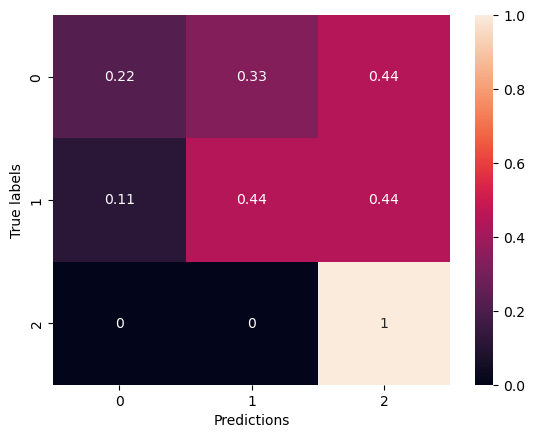

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▆▅▆▆▆▆▆▇▇▇▇▇▇██████████
training_loss,█▇▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▃▃▆▆▇▆█▇▆▆▇▇▇█▇█▇▆▇▇▆
val_loss,█▇▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 19:23:23.795086: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:23:23.796929: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:23:23.798862: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:23:25.413498: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:23:25.415988: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:23:25.417732: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:23:29.641829: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:23:30.235458: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 68.1872 - accuracy: 0.3265

2024-03-12 19:23:33.867119: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:23:33.869270: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:23:33.870871: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 68.1872 - accuracy: 0.3265 - val_loss: 65.0925 - val_accuracy: 0.1667
Epoch 2/100
2/2 [==============================] - 1s 512ms/step - loss: 64.8452 - accuracy: 0.3653 - val_loss: 62.0576 - val_accuracy: 0.1481
Epoch 3/100
2/2 [==============================] - 1s 520ms/step - loss: 61.7852 - accuracy: 0.3470 - val_loss: 59.1539 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 512ms/step - loss: 58.7513 - accuracy: 0.3904 - val_loss: 56.3534 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 518ms/step - loss: 55.8820 - accuracy: 0.4064 - val_loss: 53.6461 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 512ms/step - loss: 53.0865 - accuracy: 0.4292 - val_loss: 51.0278 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 506ms/step - loss: 50.3797 - accuracy: 0.4406 - val_loss: 48.5066 - val_accuracy: 0.1296
Epoch 8/100
2

2/2 [==============================] - 1s 521ms/step - loss: 3.7356 - accuracy: 0.8493 - val_loss: 4.6687 - val_accuracy: 0.5278
Epoch 59/100
2/2 [==============================] - 1s 525ms/step - loss: 3.6318 - accuracy: 0.8516 - val_loss: 4.6456 - val_accuracy: 0.5556
Epoch 60/100
2/2 [==============================] - 1s 517ms/step - loss: 3.4897 - accuracy: 0.8584 - val_loss: 4.4481 - val_accuracy: 0.6111
Epoch 61/100
2/2 [==============================] - 1s 519ms/step - loss: 3.3770 - accuracy: 0.8721 - val_loss: 4.3620 - val_accuracy: 0.5833
Epoch 62/100
2/2 [==============================] - 1s 510ms/step - loss: 3.2243 - accuracy: 0.8767 - val_loss: 4.3570 - val_accuracy: 0.5648
Epoch 63/100
2/2 [==============================] - 1s 515ms/step - loss: 3.1023 - accuracy: 0.8790 - val_loss: 4.2721 - val_accuracy: 0.5278
Epoch 64/100
2/2 [==============================] - 1s 510ms/step - loss: 3.0414 - accuracy: 0.8767 - val_loss: 4.2086 - val_accuracy: 0.5741
Epoch 65/100
2/2 [=

2024-03-12 19:25:18.334658: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:25:18.336246: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:25:18.338461: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.470679998397827 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.8, 'recall': 0.4444444444444444, 'f1-score': 0.5714285714285714, 'support': 9}, '2': {'precision': 0.4090909090909091, 'recall': 1.0, 'f1-score': 0.5806451612903226, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.40303030303030307, 'recall': 0.48148148148148145, 'f1-score': 0.3840245775729647, 'support': 27}, 'weighted avg': {'precision': 0.40303030303030307, 'recall': 0.48148148148148145, 'f1-score': 0.38402457757296465, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


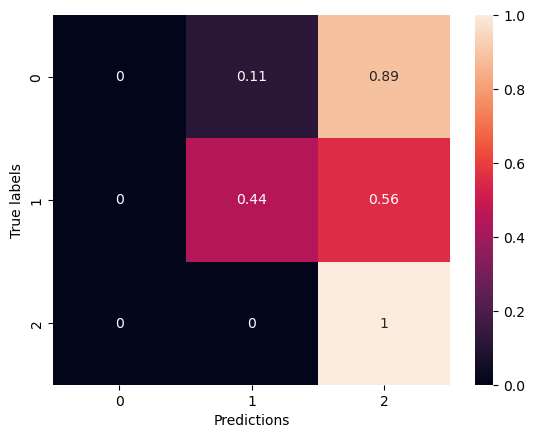

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▃▃▂▃▃▃▃▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇█▇██████████
training_loss,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▁▂▂▂▂▂▃▄▃▅▅▆▆▇▆▇▆▆▇▇▆▇▇▇▇▇▆▇▇█▆▇▇█
val_loss,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 19:25:43.342425: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:25:43.344002: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:25:43.346255: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:25:44.949828: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:25:44.951697: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:25:44.953749: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:25:49.176966: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:25:49.764635: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 7.0492 - accuracy: 0.4615

2024-03-12 19:25:53.022584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:25:53.024885: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:25:53.026555: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 170ms/step - loss: 7.0213 - accuracy: 0.4612 - val_loss: 6.9054 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 5.9504 - accuracy: 0.5731 - val_loss: 6.1570 - val_accuracy: 0.1944
Epoch 3/100
14/14 [==============================] - 1s 49ms/step - loss: 4.9968 - accuracy: 0.6530 - val_loss: 6.1370 - val_accuracy: 0.1389
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 4.3494 - accuracy: 0.6530 - val_loss: 4.7688 - val_accuracy: 0.3241
Epoch 5/100
14/14 [==============================] - 1s 48ms/step - loss: 3.5612 - accuracy: 0.7397 - val_loss: 4.3250 - val_accuracy: 0.3333
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 3.0854 - accuracy: 0.7694 - val_loss: 4.1828 - val_accuracy: 0.3241
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 2.6783 - accuracy: 0.8082 - val_loss: 3.4538 - val_accuracy: 0.4352
Epoch 8/100
14/1

14/14 [==============================] - 1s 48ms/step - loss: 1.5252 - accuracy: 0.8516 - val_loss: 2.8087 - val_accuracy: 0.4167
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 1.3759 - accuracy: 0.8767 - val_loss: 2.9951 - val_accuracy: 0.4259
Epoch 60/100
14/14 [==============================] - 1s 49ms/step - loss: 1.4756 - accuracy: 0.8516 - val_loss: 3.7057 - val_accuracy: 0.3148
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 1.5505 - accuracy: 0.8037 - val_loss: 2.5509 - val_accuracy: 0.4259
Epoch 62/100
14/14 [==============================] - 1s 50ms/step - loss: 1.5950 - accuracy: 0.7854 - val_loss: 2.6036 - val_accuracy: 0.4259
Epoch 63/100
14/14 [==============================] - 1s 48ms/step - loss: 1.4812 - accuracy: 0.8493 - val_loss: 2.8462 - val_accuracy: 0.5278
Epoch 64/100
14/14 [==============================] - 1s 48ms/step - loss: 1.3860 - accuracy: 0.8676 - val_loss: 3.1022 - val_accuracy: 0.4352
Epoch 65/100

2024-03-12 19:27:01.542733: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:27:01.544779: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:27:01.546621: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.51139497756958 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, '2': {'precision': 0.3157894736842105, 'recall': 0.6666666666666666, 'f1-score': 0.42857142857142855, 'support': 9}, 'accuracy': 0.2962962962962963, 'macro avg': {'precision': 0.21637426900584797, 'recall': 0.2962962962962963, 'f1-score': 0.23174603174603173, 'support': 27}, 'weighted avg': {'precision': 0.21637426900584794, 'recall': 0.2962962962962963, 'f1-score': 0.2317460317460317, 'support': 27}}


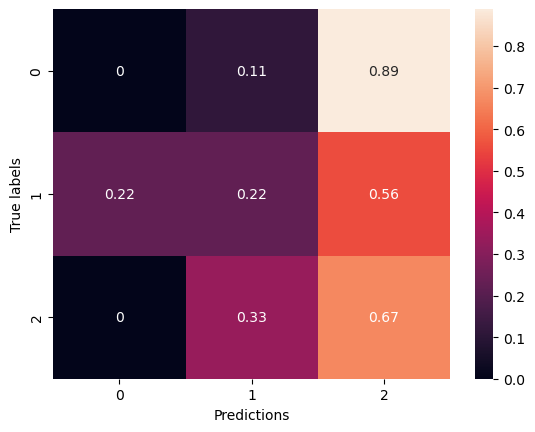

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▆▇▇▇▇▇▇▇▇▇▇▇▆▇▇█▇▇▇▇▆▇▇▆▇▇█▇▇▇▇▇█▇▇█
training_loss,█▆▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▄▇▅▆▆█▅█▄▆█▇▄▇▃▃▇▇█▇▅▆▆▆▆█▅▅▄▅▅▅▅▇▅▄▄▇
val_loss,█▇▄▂▂▂▂▁▂▁▃▁▁▁▂▁▃▃▁▁▁▁▂▂▁▂▂▁▂▂▃▂▂▂▂▁▃▃▃▂


Epoch 1/100


2024-03-12 19:27:24.943078: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:27:24.944661: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:27:24.946780: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:27:26.559883: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:27:26.562296: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:27:26.564253: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:27:31.676151: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:27:32.266301: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 24.1154 - accuracy: 0.3918

2024-03-12 19:27:35.532211: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:27:35.534416: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:27:35.535990: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 165ms/step - loss: 23.7915 - accuracy: 0.3927 - val_loss: 16.9966 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 13.2635 - accuracy: 0.5753 - val_loss: 10.5685 - val_accuracy: 0.1111
Epoch 3/100
14/14 [==============================] - 1s 48ms/step - loss: 8.1897 - accuracy: 0.6027 - val_loss: 6.9556 - val_accuracy: 0.1944
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 5.4481 - accuracy: 0.6461 - val_loss: 5.0876 - val_accuracy: 0.2315
Epoch 5/100
14/14 [==============================] - 1s 48ms/step - loss: 3.7973 - accuracy: 0.7306 - val_loss: 3.7037 - val_accuracy: 0.4352
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 2.9160 - accuracy: 0.7580 - val_loss: 3.1264 - val_accuracy: 0.5370
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 2.5811 - accuracy: 0.7100 - val_loss: 2.9662 - val_accuracy: 0.4444
Epoch 8/100


14/14 [==============================] - 1s 48ms/step - loss: 1.8241 - accuracy: 0.7671 - val_loss: 2.4077 - val_accuracy: 0.4907
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 1.6304 - accuracy: 0.7831 - val_loss: 2.3966 - val_accuracy: 0.5278
Epoch 60/100
14/14 [==============================] - 1s 49ms/step - loss: 1.7231 - accuracy: 0.7648 - val_loss: 3.7908 - val_accuracy: 0.2870
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 1.6855 - accuracy: 0.7717 - val_loss: 3.7994 - val_accuracy: 0.1944
Epoch 62/100
14/14 [==============================] - 1s 48ms/step - loss: 1.4654 - accuracy: 0.8059 - val_loss: 2.4891 - val_accuracy: 0.4074
Epoch 63/100
14/14 [==============================] - 1s 48ms/step - loss: 1.5801 - accuracy: 0.7694 - val_loss: 2.9111 - val_accuracy: 0.3889
Epoch 64/100
14/14 [==============================] - 1s 48ms/step - loss: 1.7431 - accuracy: 0.7192 - val_loss: 3.7819 - val_accuracy: 0.1852
Epoch 65/100

2024-03-12 19:28:44.565241: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:28:44.567316: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:28:44.568994: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4602198600769043 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.48484848484848486, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.2222222222222222, 'recall': 0.3333333333333333, 'f1-score': 0.21717171717171715, 'support': 27}, 'weighted avg': {'precision': 0.2222222222222222, 'recall': 0.3333333333333333, 'f1-score': 0.21717171717171715, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


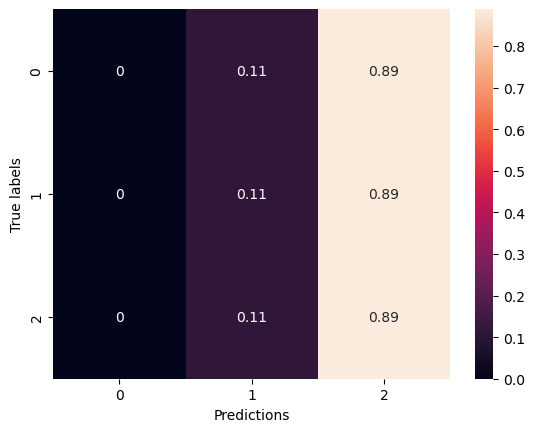

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▇▇▇▆▇▇▇▇▇▆▆▆▆▇▆▇▇█▆▆▇▇▇▆▇▅▅▆▆▆▇▆█▇▇▇▇█
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▇▆█▅▇▇▅▇▆▄▄▅▃▅▇▆▆▅▇▇▇▇▂▂▆▅▂▆▃▂▅▃█▃▂▆▆▇
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▂▂▁▁▂▁▁▂▁▁▁▂▂▁▁▁


Epoch 1/100


2024-03-12 19:31:45.563214: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:31:45.565235: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:31:45.566912: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:31:47.328871: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:31:47.331650: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:31:47.334055: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:31:51.733497: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:31:52.337400: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 30.5239 - accuracy: 0.4904

2024-03-12 19:31:55.740892: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:31:55.742677: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:31:55.744658: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 177ms/step - loss: 30.0260 - accuracy: 0.4795 - val_loss: 19.3755 - val_accuracy: 0.2130
Epoch 2/100
14/14 [==============================] - 1s 50ms/step - loss: 14.1356 - accuracy: 0.5731 - val_loss: 10.5389 - val_accuracy: 0.1944
Epoch 3/100
14/14 [==============================] - 1s 49ms/step - loss: 7.8591 - accuracy: 0.6119 - val_loss: 6.2694 - val_accuracy: 0.5000
Epoch 4/100
14/14 [==============================] - 1s 49ms/step - loss: 4.9918 - accuracy: 0.6963 - val_loss: 4.4995 - val_accuracy: 0.3796
Epoch 5/100
14/14 [==============================] - 1s 49ms/step - loss: 3.5560 - accuracy: 0.6895 - val_loss: 3.5878 - val_accuracy: 0.4815
Epoch 6/100
14/14 [==============================] - 1s 50ms/step - loss: 2.8645 - accuracy: 0.7055 - val_loss: 3.1142 - val_accuracy: 0.5741
Epoch 7/100
14/14 [==============================] - 1s 50ms/step - loss: 2.5075 - accuracy: 0.7260 - val_loss: 2.8302 - val_accuracy: 0.5926
Epoch 8/100


14/14 [==============================] - 1s 48ms/step - loss: 1.7111 - accuracy: 0.7397 - val_loss: 2.4411 - val_accuracy: 0.3889
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 1.4753 - accuracy: 0.7831 - val_loss: 2.6154 - val_accuracy: 0.3426
Epoch 60/100
14/14 [==============================] - 1s 48ms/step - loss: 1.5315 - accuracy: 0.7466 - val_loss: 3.4755 - val_accuracy: 0.2593
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 1.8138 - accuracy: 0.7329 - val_loss: 2.6121 - val_accuracy: 0.5093
Epoch 62/100
14/14 [==============================] - 1s 48ms/step - loss: 1.8318 - accuracy: 0.7443 - val_loss: 2.7679 - val_accuracy: 0.4074
Epoch 63/100
14/14 [==============================] - 1s 48ms/step - loss: 1.7990 - accuracy: 0.7511 - val_loss: 2.7011 - val_accuracy: 0.3796
Epoch 64/100
14/14 [==============================] - 1s 48ms/step - loss: 1.7555 - accuracy: 0.7694 - val_loss: 2.4824 - val_accuracy: 0.4537
Epoch 65/100

2024-03-12 19:33:04.813041: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:33:04.815093: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:33:04.816674: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.4832491874694824 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.5555555555555556, 'f1-score': 0.4166666666666667, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3055555555555556, 'support': 27}, 'weighted avg': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3055555555555556, 'support': 27}}


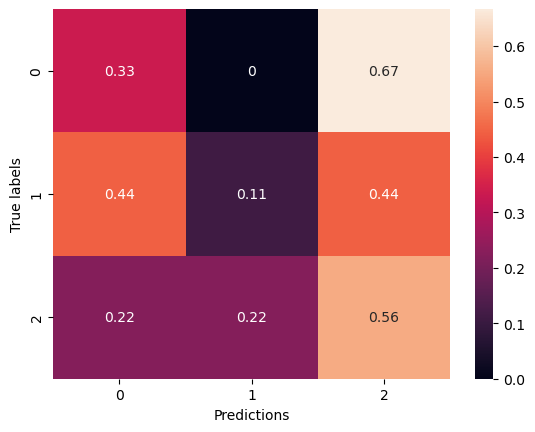

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▆▆▇▇▆▇▅▅▅▆▆▇▆▆▆▇▇▇█▇▇█▇▇▆▇▇▇▇█▇▆█▇▅
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▇█▄▇▆▅▇▅▆▅█▆▅▆▃▆▃▃▆▅▆▅▄▇▆▃▇▅▁▅▅▅▆▆▅▆▅▇▆
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 19:33:29.079110: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:33:29.080666: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:33:29.082816: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:33:30.683598: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:33:30.686352: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:33:30.688396: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:33:34.837275: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:33:35.421265: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 7.5098 - accuracy: 0.4159

2024-03-12 19:33:38.648010: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:33:38.649593: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:33:38.651770: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 166ms/step - loss: 7.4634 - accuracy: 0.4247 - val_loss: 6.6555 - val_accuracy: 0.1574
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 6.4667 - accuracy: 0.4954 - val_loss: 7.3111 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 48ms/step - loss: 5.7233 - accuracy: 0.5320 - val_loss: 6.4972 - val_accuracy: 0.1389
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 4.9630 - accuracy: 0.5685 - val_loss: 6.0465 - val_accuracy: 0.1481
Epoch 5/100
14/14 [==============================] - 1s 48ms/step - loss: 4.3300 - accuracy: 0.5959 - val_loss: 5.8003 - val_accuracy: 0.1481
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 3.8113 - accuracy: 0.6370 - val_loss: 4.8619 - val_accuracy: 0.1574
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 3.3367 - accuracy: 0.6644 - val_loss: 4.0160 - val_accuracy: 0.2593
Epoch 8/100
14/1

14/14 [==============================] - 1s 48ms/step - loss: 1.4676 - accuracy: 0.8059 - val_loss: 4.0442 - val_accuracy: 0.2500
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 1.6391 - accuracy: 0.7626 - val_loss: 2.3593 - val_accuracy: 0.5000
Epoch 60/100
14/14 [==============================] - 1s 48ms/step - loss: 1.5267 - accuracy: 0.7991 - val_loss: 3.1641 - val_accuracy: 0.2963
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 1.4540 - accuracy: 0.7991 - val_loss: 2.9449 - val_accuracy: 0.4074
Epoch 62/100
14/14 [==============================] - 1s 48ms/step - loss: 1.4513 - accuracy: 0.8082 - val_loss: 2.3563 - val_accuracy: 0.5370
Epoch 63/100
14/14 [==============================] - 1s 48ms/step - loss: 1.5898 - accuracy: 0.7694 - val_loss: 2.4951 - val_accuracy: 0.4167
Epoch 64/100
14/14 [==============================] - 1s 48ms/step - loss: 1.5147 - accuracy: 0.8059 - val_loss: 4.2358 - val_accuracy: 0.1481
Epoch 65/100

2024-03-12 19:34:47.230433: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:34:47.232509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:34:47.234173: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5241117477416992 s
{'0': {'precision': 0.16666666666666666, 'recall': 0.1111111111111111, 'f1-score': 0.13333333333333333, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.3684210526315789, 'recall': 0.7777777777777778, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.2962962962962963, 'macro avg': {'precision': 0.1783625730994152, 'recall': 0.2962962962962963, 'f1-score': 0.2111111111111111, 'support': 27}, 'weighted avg': {'precision': 0.1783625730994152, 'recall': 0.2962962962962963, 'f1-score': 0.2111111111111111, 'support': 27}}


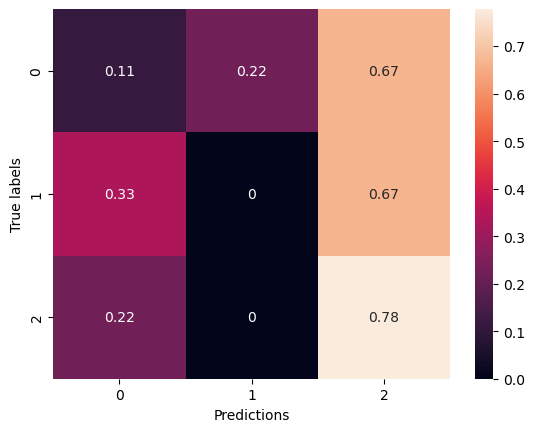

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▆▆▇▅▆▇▆▇▇▇▇▇▇▇▇▇▇█▇▇▆▇▇▇▇▇▇█▇██▇▆▇▇▇▇
training_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▆▄▇▄▄▅█▇▅▅▅█▇▄▆▅▃▇▅▅▇▆▁▆▆▄▃▆▇▆▆▃▆▂▅▅▇
val_loss,██▅▃▂▂▂▁▂▁▂▂▂▂▁▂▂▂▂▃▁▂▂▁▂▄▁▁▂▃▂▁▂▂▄▂▄▂▂▂


Epoch 1/100


2024-03-12 19:35:08.652745: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:35:08.654362: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:35:08.656232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:35:10.275099: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:35:10.277001: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:35:10.279163: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:35:15.397605: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:35:15.988117: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 24.2156 - accuracy: 0.4062

2024-03-12 19:35:19.447246: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:35:19.449261: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:35:19.450976: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 173ms/step - loss: 23.9250 - accuracy: 0.4041 - val_loss: 18.1176 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 13.9898 - accuracy: 0.4817 - val_loss: 11.5851 - val_accuracy: 0.1111
Epoch 3/100
14/14 [==============================] - 1s 55ms/step - loss: 8.9748 - accuracy: 0.5297 - val_loss: 8.6631 - val_accuracy: 0.1204
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 6.1368 - accuracy: 0.5799 - val_loss: 6.3752 - val_accuracy: 0.1389
Epoch 5/100
14/14 [==============================] - 1s 49ms/step - loss: 4.4572 - accuracy: 0.6393 - val_loss: 4.9397 - val_accuracy: 0.1481
Epoch 6/100
14/14 [==============================] - 1s 49ms/step - loss: 3.3981 - accuracy: 0.7169 - val_loss: 3.8206 - val_accuracy: 0.2778
Epoch 7/100
14/14 [==============================] - 1s 49ms/step - loss: 2.7304 - accuracy: 0.7146 - val_loss: 3.0906 - val_accuracy: 0.4352
Epoch 8/100


14/14 [==============================] - 1s 49ms/step - loss: 1.7790 - accuracy: 0.7078 - val_loss: 3.1244 - val_accuracy: 0.2500
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 1.8632 - accuracy: 0.7009 - val_loss: 3.9874 - val_accuracy: 0.1667
Epoch 60/100
14/14 [==============================] - 1s 48ms/step - loss: 1.8992 - accuracy: 0.7237 - val_loss: 2.5047 - val_accuracy: 0.5278
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 2.0250 - accuracy: 0.6963 - val_loss: 2.5722 - val_accuracy: 0.4444
Epoch 62/100
14/14 [==============================] - 1s 48ms/step - loss: 1.9591 - accuracy: 0.6895 - val_loss: 2.4099 - val_accuracy: 0.5833
Epoch 63/100
14/14 [==============================] - 1s 48ms/step - loss: 1.9669 - accuracy: 0.6986 - val_loss: 2.5625 - val_accuracy: 0.4630
Epoch 64/100
14/14 [==============================] - 1s 48ms/step - loss: 1.9152 - accuracy: 0.7420 - val_loss: 2.4198 - val_accuracy: 0.5463
Epoch 65/100

2024-03-12 19:36:28.422045: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:36:28.423644: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:36:28.425282: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.479496955871582 s
{'0': {'precision': 0.25, 'recall': 0.2222222222222222, 'f1-score': 0.23529411764705882, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.36481481481481487, 'recall': 0.3703703703703704, 'f1-score': 0.3669303978901502, 'support': 27}, 'weighted avg': {'precision': 0.3648148148148148, 'recall': 0.37037037037037035, 'f1-score': 0.36693039789015025, 'support': 27}}


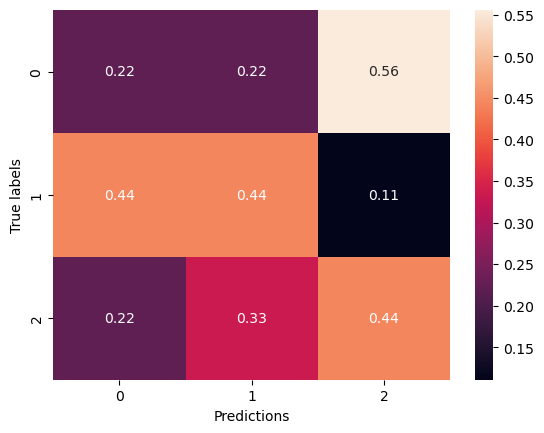

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▇▇█▇▇▆▇▇▇▆▇▇▇▇▆▇▇▆▆█▇▇▇█▇▆▇▆▆▆█▇▆▇▇▇▇▇
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▄▆▇▆▇█▅█▃▄▅▇▆█▄▄▂▇▂▄▃▂▆█▃▂▆▇▂▄▃▆██▄█▃▄
val_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▁▂▁▁▂▂▁▁▁▁▂▁▁▁▁▁▂▁


Epoch 1/100


2024-03-12 19:36:55.252332: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:36:55.254084: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:36:55.255974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:36:56.869752: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:36:56.871960: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:36:56.873782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:37:01.040531: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:37:01.632808: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 30.6320 - accuracy: 0.4351

2024-03-12 19:37:04.867226: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:37:04.869133: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:37:04.871353: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 166ms/step - loss: 30.1120 - accuracy: 0.4361 - val_loss: 19.5493 - val_accuracy: 0.1481
Epoch 2/100
14/14 [==============================] - 1s 48ms/step - loss: 14.5480 - accuracy: 0.4840 - val_loss: 11.1170 - val_accuracy: 0.1389
Epoch 3/100
14/14 [==============================] - 1s 48ms/step - loss: 8.5265 - accuracy: 0.5616 - val_loss: 7.8732 - val_accuracy: 0.1204
Epoch 4/100
14/14 [==============================] - 1s 48ms/step - loss: 5.6185 - accuracy: 0.6073 - val_loss: 6.6503 - val_accuracy: 0.1111
Epoch 5/100
14/14 [==============================] - 1s 48ms/step - loss: 4.1064 - accuracy: 0.6142 - val_loss: 4.5886 - val_accuracy: 0.2130
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 3.2470 - accuracy: 0.6164 - val_loss: 3.3736 - val_accuracy: 0.3426
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 2.6617 - accuracy: 0.6758 - val_loss: 2.9209 - val_accuracy: 0.4722
Epoch 8/100


14/14 [==============================] - 1s 48ms/step - loss: 1.9091 - accuracy: 0.7123 - val_loss: 2.6355 - val_accuracy: 0.3704
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 1.9095 - accuracy: 0.7420 - val_loss: 2.4753 - val_accuracy: 0.5278
Epoch 60/100
14/14 [==============================] - 1s 48ms/step - loss: 1.9939 - accuracy: 0.6849 - val_loss: 3.0276 - val_accuracy: 0.2685
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 2.0599 - accuracy: 0.6963 - val_loss: 2.5606 - val_accuracy: 0.3241
Epoch 62/100
14/14 [==============================] - 1s 55ms/step - loss: 1.8546 - accuracy: 0.7169 - val_loss: 4.1911 - val_accuracy: 0.1296
Epoch 63/100
14/14 [==============================] - 1s 63ms/step - loss: 2.0620 - accuracy: 0.6507 - val_loss: 4.4376 - val_accuracy: 0.1481
Epoch 64/100
14/14 [==============================] - 1s 57ms/step - loss: 2.1364 - accuracy: 0.6758 - val_loss: 4.6740 - val_accuracy: 0.1481
Epoch 65/100

2024-03-12 19:38:13.707423: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:38:13.709087: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:38:13.711179: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4806761741638184 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.4984126984126984, 'recall': 0.48148148148148145, 'f1-score': 0.46230158730158727, 'support': 27}, 'weighted avg': {'precision': 0.49841269841269836, 'recall': 0.48148148148148145, 'f1-score': 0.4623015873015873, 'support': 27}}


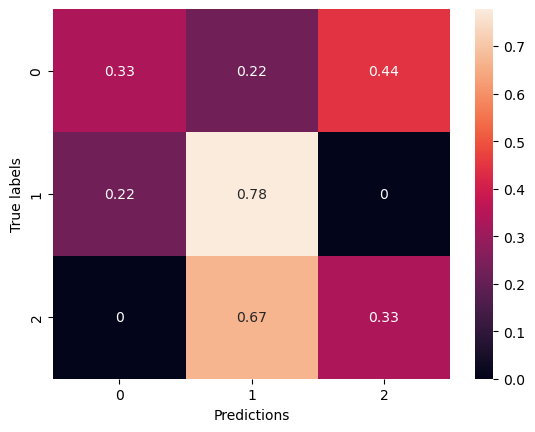

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇▆▆▇▇▅▆▆▆▅▆▇▆▇▆▅▇█▇▆▆▇▆▆▆▇▇█▇▇▆▇▇▇
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▅▂▄▇▇▃▇▅▅▅▆▅█▄██▆▇▅▂█▇▄▁▇█▃▃▃▂▆▇▃▄▃▃▇▅
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 19:38:37.168133: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:38:37.170423: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:38:37.172242: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:38:39.810211: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:38:39.812605: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:38:39.814411: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:38:43.953746: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:38:44.545605: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 7.3059 - accuracy: 0.3653

2024-03-12 19:38:47.830771: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:38:47.832329: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:38:47.834232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 174ms/step - loss: 7.3059 - accuracy: 0.3653 - val_loss: 6.5582 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 57ms/step - loss: 6.6442 - accuracy: 0.3744 - val_loss: 6.3185 - val_accuracy: 0.1852
Epoch 3/100
14/14 [==============================] - 1s 50ms/step - loss: 5.9565 - accuracy: 0.3676 - val_loss: 5.9928 - val_accuracy: 0.1204
Epoch 4/100
14/14 [==============================] - 1s 51ms/step - loss: 5.2370 - accuracy: 0.4338 - val_loss: 5.6650 - val_accuracy: 0.1204
Epoch 5/100
14/14 [==============================] - 1s 50ms/step - loss: 4.7612 - accuracy: 0.4452 - val_loss: 5.4992 - val_accuracy: 0.1204
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 4.2323 - accuracy: 0.4680 - val_loss: 5.4906 - val_accuracy: 0.1389
Epoch 7/100
14/14 [==============================] - 1s 49ms/step - loss: 3.7555 - accuracy: 0.5114 - val_loss: 4.7911 - val_accuracy: 0.1667
Epoch 8/100
14/1

14/14 [==============================] - 1s 48ms/step - loss: 1.7101 - accuracy: 0.6530 - val_loss: 2.4667 - val_accuracy: 0.3519
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 1.6999 - accuracy: 0.6849 - val_loss: 2.2898 - val_accuracy: 0.3056
Epoch 60/100
14/14 [==============================] - 1s 48ms/step - loss: 1.5564 - accuracy: 0.7329 - val_loss: 2.5566 - val_accuracy: 0.3333
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 1.6372 - accuracy: 0.6689 - val_loss: 2.4623 - val_accuracy: 0.4259
Epoch 62/100
14/14 [==============================] - 1s 48ms/step - loss: 1.6348 - accuracy: 0.6804 - val_loss: 2.1515 - val_accuracy: 0.5556
Epoch 63/100
14/14 [==============================] - 1s 48ms/step - loss: 1.6480 - accuracy: 0.6484 - val_loss: 2.3271 - val_accuracy: 0.3241
Epoch 64/100
14/14 [==============================] - 1s 48ms/step - loss: 1.5003 - accuracy: 0.7123 - val_loss: 2.2004 - val_accuracy: 0.3426
Epoch 65/100

2024-03-12 19:39:56.967824: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:39:56.969707: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:39:56.971456: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4801380634307861 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '2': {'precision': 0.3888888888888889, 'recall': 0.7777777777777778, 'f1-score': 0.5185185185185185, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.5185185185185185, 'recall': 0.4444444444444445, 'f1-score': 0.417283950617284, 'support': 27}, 'weighted avg': {'precision': 0.5185185185185185, 'recall': 0.4444444444444444, 'f1-score': 0.4172839506172839, 'support': 27}}


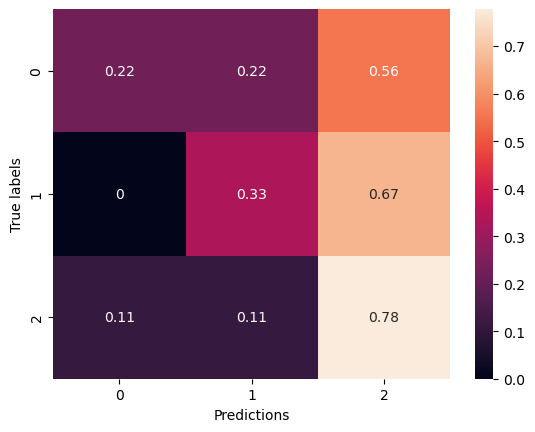

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▃▄▄▅▅▆▇▆▆▇▆▇▇▇▇▇▇▇▆▇▇▇▇▇▇▇▇▇█▇▇▆▇▇▇▆▇▆
training_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▂▇▆▇▄▅▇▇▆▆▅█▁▆▄▇█▆▇▄▆▅▄▆▆▇█▅▆▆▇██▆▇█
val_loss,█▇▆▆▅▂▂▂▃▂▁▂▁▂▂▁▄▂▄▁▁▂▁▂▂▁▂▁▁▁▁▁▂▁▁▁▁▂▁▁


Epoch 1/100


2024-03-12 19:40:21.019940: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:40:21.021527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:40:21.023551: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:40:22.650191: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:40:22.652698: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:40:22.654405: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:40:26.861151: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:40:27.449663: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 24.0202 - accuracy: 0.3654

2024-03-12 19:40:32.180712: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:40:32.182317: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:40:32.184371: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 170ms/step - loss: 23.7076 - accuracy: 0.3676 - val_loss: 17.5432 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 1s 50ms/step - loss: 14.6130 - accuracy: 0.4521 - val_loss: 11.7890 - val_accuracy: 0.1574
Epoch 3/100
14/14 [==============================] - 1s 49ms/step - loss: 10.1405 - accuracy: 0.3881 - val_loss: 9.1256 - val_accuracy: 0.1481
Epoch 4/100
14/14 [==============================] - 1s 49ms/step - loss: 7.4801 - accuracy: 0.4018 - val_loss: 6.6970 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 1s 49ms/step - loss: 5.6887 - accuracy: 0.4315 - val_loss: 5.2594 - val_accuracy: 0.1944
Epoch 6/100
14/14 [==============================] - 1s 49ms/step - loss: 4.3963 - accuracy: 0.5205 - val_loss: 4.1703 - val_accuracy: 0.2500
Epoch 7/100
14/14 [==============================] - 1s 49ms/step - loss: 3.6125 - accuracy: 0.5388 - val_loss: 3.7925 - val_accuracy: 0.2315
Epoch 8/100

14/14 [==============================] - 1s 48ms/step - loss: 2.2859 - accuracy: 0.5411 - val_loss: 3.1349 - val_accuracy: 0.1389
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 2.2889 - accuracy: 0.5525 - val_loss: 2.8479 - val_accuracy: 0.2593
Epoch 60/100
14/14 [==============================] - 1s 48ms/step - loss: 2.0798 - accuracy: 0.5936 - val_loss: 2.5665 - val_accuracy: 0.3241
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 2.0192 - accuracy: 0.6347 - val_loss: 2.4618 - val_accuracy: 0.3056
Epoch 62/100
14/14 [==============================] - 1s 48ms/step - loss: 2.2363 - accuracy: 0.5525 - val_loss: 2.9783 - val_accuracy: 0.2407
Epoch 63/100
14/14 [==============================] - 1s 48ms/step - loss: 2.2907 - accuracy: 0.6347 - val_loss: 3.3656 - val_accuracy: 0.2407
Epoch 64/100
14/14 [==============================] - 1s 48ms/step - loss: 2.0203 - accuracy: 0.6530 - val_loss: 2.3939 - val_accuracy: 0.4722
Epoch 65/100

2024-03-12 19:41:41.570123: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:41:41.572311: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:41:41.573908: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4806201457977295 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.5555555555555556, 'f1-score': 0.4166666666666667, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.31666666666666665, 'support': 27}, 'weighted avg': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3166666666666667, 'support': 27}}


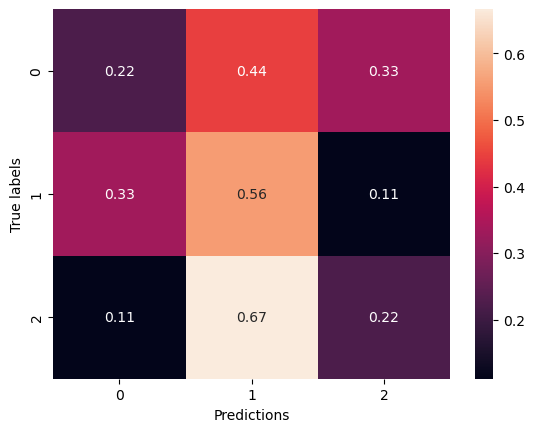

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▅▅▆▆▆██▇▇▆▇▇▆▅▅▇▆▆▇▆█▅▇█▇▇█▇▇█▇▆▆▆▇▇▆▇
training_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▃▅▆▆▇██▆▃▅▄█▅▂▅▆▁▁▃▁▁▃▄▆▄▅█▇▅▆▅▃▆▇▁▇▄▅
val_loss,█▄▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁


Epoch 1/100


2024-03-12 19:42:04.458391: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:42:04.460529: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:42:04.462197: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:42:06.072721: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:42:06.075056: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:42:06.076941: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:42:10.241434: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:42:10.822977: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 31.3975 - accuracy: 0.3750

2024-03-12 19:42:14.043434: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:42:14.044963: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:42:14.046877: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 167ms/step - loss: 30.9354 - accuracy: 0.3813 - val_loss: 20.9973 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 49ms/step - loss: 16.7349 - accuracy: 0.3699 - val_loss: 12.9059 - val_accuracy: 0.1296
Epoch 3/100
14/14 [==============================] - 1s 48ms/step - loss: 10.6276 - accuracy: 0.4247 - val_loss: 9.3873 - val_accuracy: 0.1296
Epoch 4/100
14/14 [==============================] - 1s 49ms/step - loss: 7.5287 - accuracy: 0.4521 - val_loss: 6.5969 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 1s 54ms/step - loss: 5.5115 - accuracy: 0.5297 - val_loss: 6.1269 - val_accuracy: 0.1204
Epoch 6/100
14/14 [==============================] - 1s 48ms/step - loss: 4.3334 - accuracy: 0.5297 - val_loss: 4.1285 - val_accuracy: 0.3333
Epoch 7/100
14/14 [==============================] - 1s 48ms/step - loss: 3.5766 - accuracy: 0.5434 - val_loss: 3.7440 - val_accuracy: 0.2500
Epoch 8/100

14/14 [==============================] - 1s 48ms/step - loss: 1.9747 - accuracy: 0.5799 - val_loss: 3.3627 - val_accuracy: 0.1759
Epoch 59/100
14/14 [==============================] - 1s 48ms/step - loss: 1.9056 - accuracy: 0.5982 - val_loss: 3.4567 - val_accuracy: 0.1667
Epoch 60/100
14/14 [==============================] - 1s 48ms/step - loss: 1.9782 - accuracy: 0.5731 - val_loss: 2.1942 - val_accuracy: 0.5185
Epoch 61/100
14/14 [==============================] - 1s 48ms/step - loss: 1.8844 - accuracy: 0.5890 - val_loss: 2.1562 - val_accuracy: 0.3426
Epoch 62/100
14/14 [==============================] - 1s 48ms/step - loss: 1.9751 - accuracy: 0.5868 - val_loss: 2.2744 - val_accuracy: 0.5278
Epoch 63/100
14/14 [==============================] - 1s 53ms/step - loss: 1.9698 - accuracy: 0.5868 - val_loss: 2.3840 - val_accuracy: 0.2963
Epoch 64/100
14/14 [==============================] - 1s 48ms/step - loss: 2.2107 - accuracy: 0.5479 - val_loss: 2.4305 - val_accuracy: 0.4630
Epoch 65/100

2024-03-12 19:43:22.783683: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:43:22.785980: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:43:22.787634: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.464021921157837 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.3684210526315789, 'recall': 0.7777777777777778, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.23391812865497075, 'recall': 0.3333333333333333, 'f1-score': 0.25555555555555554, 'support': 27}, 'weighted avg': {'precision': 0.23391812865497078, 'recall': 0.3333333333333333, 'f1-score': 0.2555555555555556, 'support': 27}}


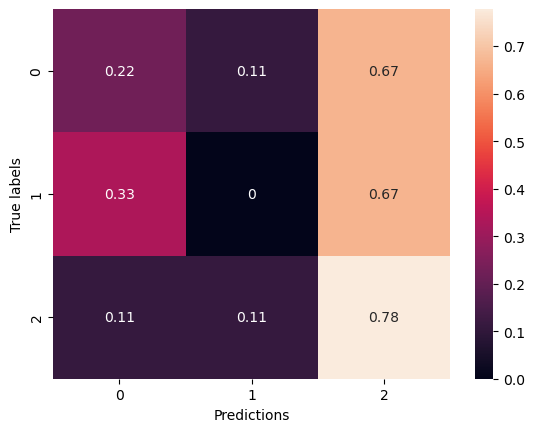

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▅▆▆█▇▇▆█▇▇▆▇▇▇▇▇▆▆▆▆▆▇▇▆▆▆▇▆▆▆▇█▆▇██▇▇
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▄▅▃█▅▄▅▆▄▄▅▁▃▆▂▃▅▅▂▁▄▂▅▆▂▆▃▄▄▅▄▇▆█▄▅▅▇
val_loss,█▄▂▁▂▁▁▁▁▁▁▁▁▂▁▁▁▂▁▁▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 19:46:05.570031: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:46:05.572058: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:46:05.573741: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:46:07.187929: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:46:07.189627: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:46:07.191618: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:46:12.357295: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:46:12.935826: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 7.5998 - accuracy: 0.5023

2024-03-12 19:46:16.457731: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:46:16.459552: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:46:16.461502: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 192ms/step - loss: 7.5998 - accuracy: 0.5023 - val_loss: 7.7834 - val_accuracy: 0.1759
Epoch 2/100
14/14 [==============================] - 1s 74ms/step - loss: 6.5219 - accuracy: 0.5525 - val_loss: 6.4686 - val_accuracy: 0.1852
Epoch 3/100
14/14 [==============================] - 1s 72ms/step - loss: 5.3338 - accuracy: 0.6598 - val_loss: 6.2703 - val_accuracy: 0.1667
Epoch 4/100
14/14 [==============================] - 1s 73ms/step - loss: 4.3707 - accuracy: 0.7078 - val_loss: 5.0129 - val_accuracy: 0.2685
Epoch 5/100
14/14 [==============================] - 1s 73ms/step - loss: 3.5724 - accuracy: 0.7717 - val_loss: 4.0399 - val_accuracy: 0.3333
Epoch 6/100
14/14 [==============================] - 1s 73ms/step - loss: 2.9580 - accuracy: 0.8128 - val_loss: 4.1260 - val_accuracy: 0.2963
Epoch 7/100
14/14 [==============================] - 1s 73ms/step - loss: 2.5128 - accuracy: 0.8288 - val_loss: 3.7423 - val_accuracy: 0.3889
Epoch 8/100
14/1

14/14 [==============================] - 1s 72ms/step - loss: 1.6730 - accuracy: 0.8562 - val_loss: 2.9252 - val_accuracy: 0.4722
Epoch 59/100
14/14 [==============================] - 1s 72ms/step - loss: 1.5555 - accuracy: 0.8858 - val_loss: 3.2431 - val_accuracy: 0.3519
Epoch 60/100
14/14 [==============================] - 1s 72ms/step - loss: 1.5423 - accuracy: 0.8630 - val_loss: 3.0886 - val_accuracy: 0.4907
Epoch 61/100
14/14 [==============================] - 1s 73ms/step - loss: 1.5168 - accuracy: 0.8653 - val_loss: 3.2326 - val_accuracy: 0.4074
Epoch 62/100
14/14 [==============================] - 1s 71ms/step - loss: 1.5604 - accuracy: 0.8790 - val_loss: 3.0698 - val_accuracy: 0.3796
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 1.5452 - accuracy: 0.8858 - val_loss: 3.2295 - val_accuracy: 0.4722
Epoch 64/100
14/14 [==============================] - 1s 72ms/step - loss: 1.4432 - accuracy: 0.9064 - val_loss: 2.8854 - val_accuracy: 0.5278
Epoch 65/100

2024-03-12 19:47:58.840193: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:47:58.841938: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:47:58.844352: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4945950508117676 s
{'0': {'precision': 0.25, 'recall': 0.2222222222222222, 'f1-score': 0.23529411764705882, 'support': 9}, '1': {'precision': 0.2857142857142857, 'recall': 0.2222222222222222, 'f1-score': 0.25, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.3452380952380952, 'recall': 0.3703703703703704, 'f1-score': 0.35224089635854344, 'support': 27}, 'weighted avg': {'precision': 0.34523809523809523, 'recall': 0.37037037037037035, 'f1-score': 0.3522408963585434, 'support': 27}}


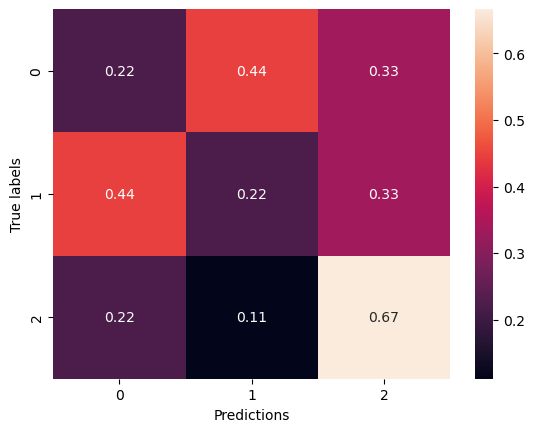

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▆▇▇▆▇▇▇▇▇▇▆▇█▇▇▇▆▇▇█▇█▆▇█▆██████▇▇██
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▂▄▅▄█▅▆▅▅▇▇█▆█▆▆▆▇▅▁▅▇▅▆█▅▆▆▆▇▆▆▆▆▅▅▅▅▅
val_loss,█▆▃▃▂▁▁▂▂▁▁▁▂▁▁▁▁▁▂▂▃▂▂▂▂▁▂▂▂▁▂▂▂▂▂▂▂▂▃▂


Epoch 1/100


2024-03-12 19:48:25.644892: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:48:25.646965: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:48:25.648614: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:48:27.272742: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:48:27.275135: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:48:27.276906: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:48:31.413229: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:48:31.996215: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 24.6943 - accuracy: 0.4726

2024-03-12 19:48:35.577224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:48:35.579073: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:48:35.580971: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 192ms/step - loss: 24.6943 - accuracy: 0.4726 - val_loss: 17.1324 - val_accuracy: 0.1111
Epoch 2/100
14/14 [==============================] - 1s 72ms/step - loss: 12.2097 - accuracy: 0.6119 - val_loss: 10.6729 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 77ms/step - loss: 7.0624 - accuracy: 0.6804 - val_loss: 7.1293 - val_accuracy: 0.1667
Epoch 4/100
14/14 [==============================] - 1s 71ms/step - loss: 4.6284 - accuracy: 0.7078 - val_loss: 4.6708 - val_accuracy: 0.3241
Epoch 5/100
14/14 [==============================] - 1s 71ms/step - loss: 3.5349 - accuracy: 0.6689 - val_loss: 3.8237 - val_accuracy: 0.3333
Epoch 6/100
14/14 [==============================] - 1s 72ms/step - loss: 2.8740 - accuracy: 0.7329 - val_loss: 3.0841 - val_accuracy: 0.4352
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 2.3999 - accuracy: 0.7352 - val_loss: 2.8002 - val_accuracy: 0.5185
Epoch 8/100


14/14 [==============================] - 1s 73ms/step - loss: 1.7954 - accuracy: 0.7237 - val_loss: 2.5399 - val_accuracy: 0.4537
Epoch 59/100
14/14 [==============================] - 1s 74ms/step - loss: 1.8753 - accuracy: 0.7237 - val_loss: 2.8094 - val_accuracy: 0.3333
Epoch 60/100
14/14 [==============================] - 1s 72ms/step - loss: 1.9394 - accuracy: 0.7055 - val_loss: 4.9115 - val_accuracy: 0.1204
Epoch 61/100
14/14 [==============================] - 1s 72ms/step - loss: 1.8173 - accuracy: 0.6872 - val_loss: 3.3966 - val_accuracy: 0.2500
Epoch 62/100
14/14 [==============================] - 1s 71ms/step - loss: 1.8195 - accuracy: 0.7055 - val_loss: 2.5889 - val_accuracy: 0.4815
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 1.9242 - accuracy: 0.6758 - val_loss: 2.3902 - val_accuracy: 0.3519
Epoch 64/100
14/14 [==============================] - 1s 73ms/step - loss: 1.8197 - accuracy: 0.7100 - val_loss: 2.4514 - val_accuracy: 0.4537
Epoch 65/100

2024-03-12 19:50:17.496337: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:50:17.498460: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:50:17.500293: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 2.5900042057037354 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '2': {'precision': 0.34615384615384615, 'recall': 1.0, 'f1-score': 0.5142857142857142, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.44871794871794873, 'recall': 0.3703703703703704, 'f1-score': 0.23809523809523805, 'support': 27}, 'weighted avg': {'precision': 0.4487179487179487, 'recall': 0.37037037037037035, 'f1-score': 0.23809523809523808, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


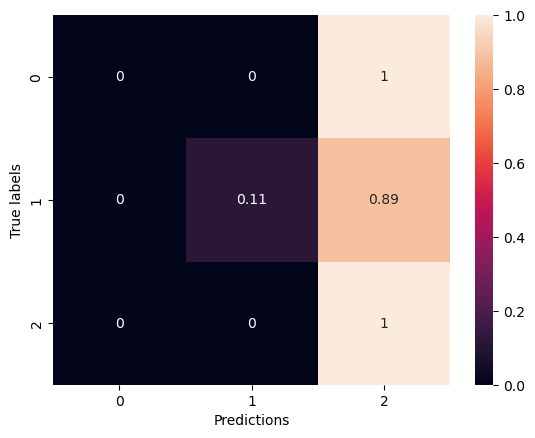

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▆▇▆▆▆▆▅▇▇▇▆▆▇▇▆▇▇▆▆▇▇▇▇▆▆▇▇██▆▇▆▇█▇▇██▇
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▆▅▆▆█▇▄▅▆█▄▅▇▄▃▇▇▅▅▄▅▄▃▆▅▅▄▄▄▁▁▅▅▆▅▆▆▇
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▂▁▂▂▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 19:50:42.853168: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:50:42.854608: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:50:42.856484: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:50:44.476450: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:50:44.478304: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:50:44.480207: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:50:48.671877: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:50:49.255321: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 31.0069 - accuracy: 0.4315

2024-03-12 19:50:52.821061: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:50:52.822685: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:50:52.824974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 193ms/step - loss: 31.0069 - accuracy: 0.4315 - val_loss: 18.5337 - val_accuracy: 0.1759
Epoch 2/100
14/14 [==============================] - 1s 72ms/step - loss: 12.5793 - accuracy: 0.6119 - val_loss: 9.8153 - val_accuracy: 0.3148
Epoch 3/100
14/14 [==============================] - 1s 73ms/step - loss: 7.0024 - accuracy: 0.6370 - val_loss: 6.3384 - val_accuracy: 0.2870
Epoch 4/100
14/14 [==============================] - 1s 71ms/step - loss: 4.5628 - accuracy: 0.6735 - val_loss: 4.2054 - val_accuracy: 0.3241
Epoch 5/100
14/14 [==============================] - 1s 73ms/step - loss: 3.3841 - accuracy: 0.6530 - val_loss: 3.7159 - val_accuracy: 0.3426
Epoch 6/100
14/14 [==============================] - 1s 71ms/step - loss: 2.9673 - accuracy: 0.6530 - val_loss: 3.2984 - val_accuracy: 0.3796
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 2.5649 - accuracy: 0.7078 - val_loss: 3.3241 - val_accuracy: 0.3241
Epoch 8/100
1

14/14 [==============================] - 1s 73ms/step - loss: 1.9091 - accuracy: 0.7260 - val_loss: 2.5828 - val_accuracy: 0.4167
Epoch 59/100
14/14 [==============================] - 1s 73ms/step - loss: 1.8911 - accuracy: 0.7055 - val_loss: 3.5955 - val_accuracy: 0.1944
Epoch 60/100
14/14 [==============================] - 1s 73ms/step - loss: 2.0536 - accuracy: 0.6826 - val_loss: 2.8110 - val_accuracy: 0.3889
Epoch 61/100
14/14 [==============================] - 1s 72ms/step - loss: 1.9415 - accuracy: 0.6941 - val_loss: 2.6006 - val_accuracy: 0.4630
Epoch 62/100
14/14 [==============================] - 1s 73ms/step - loss: 1.8299 - accuracy: 0.7329 - val_loss: 3.8765 - val_accuracy: 0.1944
Epoch 63/100
14/14 [==============================] - 1s 86ms/step - loss: 2.2389 - accuracy: 0.6804 - val_loss: 3.2929 - val_accuracy: 0.2130
Epoch 64/100
14/14 [==============================] - 1s 72ms/step - loss: 1.8947 - accuracy: 0.7580 - val_loss: 3.2125 - val_accuracy: 0.2870
Epoch 65/100

2024-03-12 19:52:34.725761: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:52:34.727220: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:52:34.729154: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4866018295288086 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.48484848484848486, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '2': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.27777777777777773, 'recall': 0.3333333333333333, 'f1-score': 0.2222222222222222, 'support': 27}, 'weighted avg': {'precision': 0.2777777777777778, 'recall': 0.3333333333333333, 'f1-score': 0.2222222222222222, 'support': 27}}


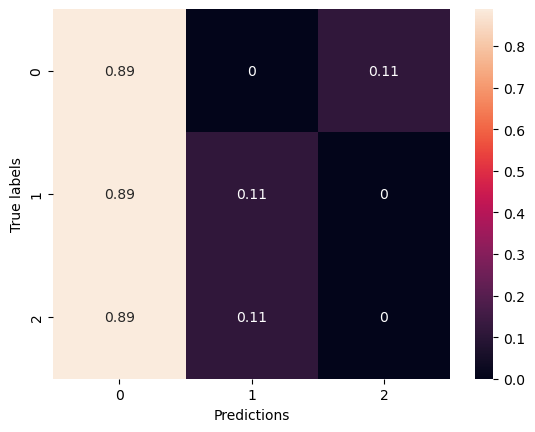

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▅▆▇▇▆▇▇▆▇▆▇▇▆▇▅▅▆▇▇▇▆▇▇▆█▇▅▆▇▇▇▇██▇▆▇█▆
training_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▃▅▅▄▇▆█▇▅▆▄▃▅▂█▃▄▆▄▅▁▁▁▇▃▄▄▆▅▃▇█▆▆▆▇▅▁▁
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▂


Epoch 1/100


2024-03-12 19:52:56.447967: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:52:56.449649: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:52:56.452092: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:52:58.075698: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:52:58.077511: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:52:58.079585: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:53:03.194249: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:53:03.776832: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 8.0035 - accuracy: 0.4247

2024-03-12 19:53:07.323601: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:53:07.325296: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:53:07.327283: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 190ms/step - loss: 8.0035 - accuracy: 0.4247 - val_loss: 8.3660 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 72ms/step - loss: 6.9481 - accuracy: 0.5411 - val_loss: 8.2595 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 71ms/step - loss: 6.2511 - accuracy: 0.5616 - val_loss: 6.5479 - val_accuracy: 0.1389
Epoch 4/100
14/14 [==============================] - 1s 71ms/step - loss: 5.4262 - accuracy: 0.5799 - val_loss: 6.0638 - val_accuracy: 0.2130
Epoch 5/100
14/14 [==============================] - 1s 72ms/step - loss: 4.6780 - accuracy: 0.6256 - val_loss: 6.0309 - val_accuracy: 0.1204
Epoch 6/100
14/14 [==============================] - 1s 72ms/step - loss: 3.9941 - accuracy: 0.7055 - val_loss: 4.5130 - val_accuracy: 0.3241
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 3.3857 - accuracy: 0.7420 - val_loss: 4.3855 - val_accuracy: 0.3241
Epoch 8/100
14/1

14/14 [==============================] - 1s 71ms/step - loss: 1.6209 - accuracy: 0.8402 - val_loss: 4.3475 - val_accuracy: 0.1759
Epoch 59/100
14/14 [==============================] - 1s 73ms/step - loss: 1.5875 - accuracy: 0.8516 - val_loss: 3.3723 - val_accuracy: 0.3796
Epoch 60/100
14/14 [==============================] - 1s 71ms/step - loss: 1.5881 - accuracy: 0.8379 - val_loss: 3.6370 - val_accuracy: 0.3796
Epoch 61/100
14/14 [==============================] - 1s 73ms/step - loss: 1.7161 - accuracy: 0.7831 - val_loss: 3.4498 - val_accuracy: 0.3519
Epoch 62/100
14/14 [==============================] - 1s 73ms/step - loss: 1.7308 - accuracy: 0.8196 - val_loss: 3.2226 - val_accuracy: 0.3796
Epoch 63/100
14/14 [==============================] - 1s 74ms/step - loss: 1.7527 - accuracy: 0.8356 - val_loss: 2.9481 - val_accuracy: 0.4167
Epoch 64/100
14/14 [==============================] - 1s 72ms/step - loss: 1.6824 - accuracy: 0.8265 - val_loss: 3.1759 - val_accuracy: 0.4537
Epoch 65/100

2024-03-12 19:54:49.292573: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:54:49.294188: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:54:49.296052: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4822700023651123 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, '2': {'precision': 0.5, 'recall': 1.0, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5, 'recall': 0.5185185185185185, 'f1-score': 0.45555555555555555, 'support': 27}, 'weighted avg': {'precision': 0.5, 'recall': 0.5185185185185185, 'f1-score': 0.4555555555555556, 'support': 27}}


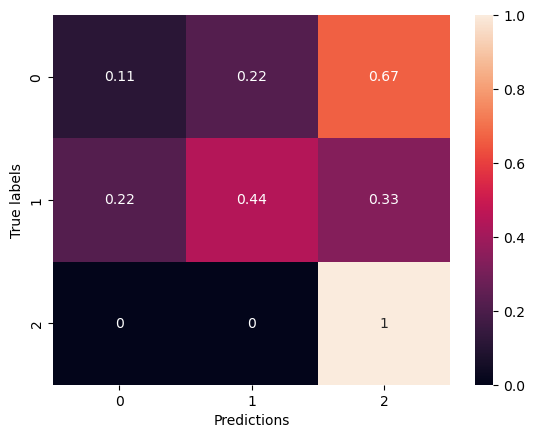

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▆▆▇▇▆▇▇▇▇▇▇▇▇▇█▇▇▇▇█▇█▇█▇█▆▇▇█████████
training_loss,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▄▆▅▇▅▅▇▇▃▅▄▄▅█▄▇▆▆▄▆▆▅▅▆▅▅▂▆▅▇█▃█▆▇▅▄▆
val_loss,█▆▃▂▂▂▁▁▁▁▃▂▂▁▁▁▂▁▂▁▂▂▂▂▂▂▁▂▃▂▂▁▁▃▁▁▂▂▂▂


Epoch 1/100


2024-03-12 19:55:13.568721: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:55:13.570845: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:55:13.572370: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:55:15.185531: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:55:15.187193: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:55:15.189119: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:55:19.358278: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:55:19.941354: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 25.9191 - accuracy: 0.4132

2024-03-12 19:55:23.532053: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:55:23.533859: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:55:23.536055: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 194ms/step - loss: 25.9191 - accuracy: 0.4132 - val_loss: 18.9234 - val_accuracy: 0.1111
Epoch 2/100
14/14 [==============================] - 1s 73ms/step - loss: 14.6343 - accuracy: 0.5297 - val_loss: 11.6304 - val_accuracy: 0.1759
Epoch 3/100
14/14 [==============================] - 1s 71ms/step - loss: 9.5461 - accuracy: 0.5594 - val_loss: 8.1512 - val_accuracy: 0.3426
Epoch 4/100
14/14 [==============================] - 1s 76ms/step - loss: 6.6074 - accuracy: 0.6279 - val_loss: 5.9513 - val_accuracy: 0.3611
Epoch 5/100
14/14 [==============================] - 1s 75ms/step - loss: 4.8577 - accuracy: 0.6073 - val_loss: 4.5007 - val_accuracy: 0.4444
Epoch 6/100
14/14 [==============================] - 1s 72ms/step - loss: 3.7279 - accuracy: 0.6484 - val_loss: 3.7966 - val_accuracy: 0.5648
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 3.0440 - accuracy: 0.6735 - val_loss: 3.6268 - val_accuracy: 0.3148
Epoch 8/100


14/14 [==============================] - 1s 72ms/step - loss: 1.8545 - accuracy: 0.7192 - val_loss: 2.7766 - val_accuracy: 0.3426
Epoch 59/100
14/14 [==============================] - 1s 73ms/step - loss: 1.7567 - accuracy: 0.7580 - val_loss: 2.4586 - val_accuracy: 0.4259
Epoch 60/100
14/14 [==============================] - 1s 72ms/step - loss: 1.7789 - accuracy: 0.7078 - val_loss: 3.1379 - val_accuracy: 0.3426
Epoch 61/100
14/14 [==============================] - 1s 78ms/step - loss: 2.0592 - accuracy: 0.6507 - val_loss: 3.4091 - val_accuracy: 0.2963
Epoch 62/100
14/14 [==============================] - 1s 73ms/step - loss: 2.1593 - accuracy: 0.6804 - val_loss: 3.0499 - val_accuracy: 0.3056
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 2.2447 - accuracy: 0.6758 - val_loss: 3.8342 - val_accuracy: 0.1389
Epoch 64/100
14/14 [==============================] - 1s 72ms/step - loss: 1.9918 - accuracy: 0.7009 - val_loss: 2.5641 - val_accuracy: 0.3611
Epoch 65/100

2024-03-12 19:57:07.009669: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:57:07.011394: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:57:07.013363: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.478254795074463 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.42105263157894735, 'recall': 0.8888888888888888, 'f1-score': 0.5714285714285714, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.6641604010025063, 'recall': 0.48148148148148145, 'f1-score': 0.4238095238095238, 'support': 27}, 'weighted avg': {'precision': 0.6641604010025063, 'recall': 0.48148148148148145, 'f1-score': 0.4238095238095238, 'support': 27}}


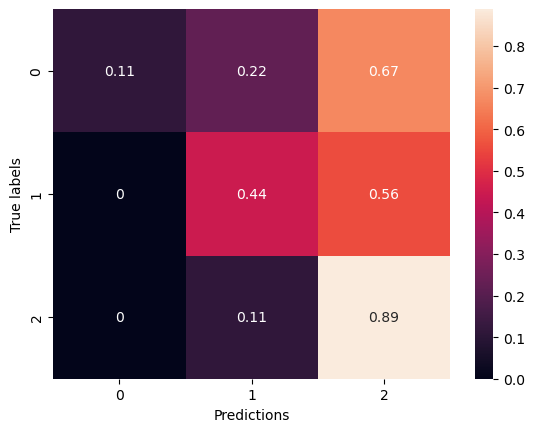

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▆█▇▆▇▅▇▆▆▆▆▇▆▆▆█▇█▆▇▆▇▇▆▆▇█▆▇▇▇▇▇█
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▄██▅▆▄▅▅▃▇▆▅▄▆▆▄▂▅▃▂▆▅▆▄▅█▂▅▇▅▃▆▆▇▆▅▄▂▆
val_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▂▁


Epoch 1/100


2024-03-12 19:57:30.001554: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:57:30.003121: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:57:30.004935: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:57:31.632601: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:57:31.635195: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:57:31.636918: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 19:57:35.790007: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 19:57:36.376617: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 32.4599 - accuracy: 0.4612

2024-03-12 19:57:39.909671: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:57:39.911544: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:57:39.913488: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 11s 190ms/step - loss: 32.4599 - accuracy: 0.4612 - val_loss: 20.3750 - val_accuracy: 0.1759
Epoch 2/100
14/14 [==============================] - 1s 73ms/step - loss: 14.8270 - accuracy: 0.5548 - val_loss: 10.9162 - val_accuracy: 0.1574
Epoch 3/100
14/14 [==============================] - 1s 71ms/step - loss: 8.2869 - accuracy: 0.6324 - val_loss: 7.8566 - val_accuracy: 0.1204
Epoch 4/100
14/14 [==============================] - 1s 72ms/step - loss: 5.3914 - accuracy: 0.6461 - val_loss: 4.9647 - val_accuracy: 0.2315
Epoch 5/100
14/14 [==============================] - 1s 72ms/step - loss: 3.9966 - accuracy: 0.6050 - val_loss: 3.7491 - val_accuracy: 0.4722
Epoch 6/100
14/14 [==============================] - 1s 72ms/step - loss: 3.1964 - accuracy: 0.6826 - val_loss: 4.3213 - val_accuracy: 0.1944
Epoch 7/100
14/14 [==============================] - 1s 77ms/step - loss: 2.7207 - accuracy: 0.6438 - val_loss: 2.9955 - val_accuracy: 0.5370
Epoch 8/100


14/14 [==============================] - 1s 72ms/step - loss: 2.3510 - accuracy: 0.6826 - val_loss: 2.6430 - val_accuracy: 0.3426
Epoch 59/100
14/14 [==============================] - 1s 77ms/step - loss: 2.0393 - accuracy: 0.6667 - val_loss: 2.6170 - val_accuracy: 0.3611
Epoch 60/100
14/14 [==============================] - 1s 71ms/step - loss: 2.0752 - accuracy: 0.6324 - val_loss: 2.6669 - val_accuracy: 0.2593
Epoch 61/100
14/14 [==============================] - 1s 73ms/step - loss: 2.0992 - accuracy: 0.6575 - val_loss: 2.4015 - val_accuracy: 0.3333
Epoch 62/100
14/14 [==============================] - 1s 73ms/step - loss: 1.8062 - accuracy: 0.6712 - val_loss: 4.3544 - val_accuracy: 0.1389
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 2.2212 - accuracy: 0.6233 - val_loss: 3.1809 - val_accuracy: 0.3704
Epoch 64/100
14/14 [==============================] - 1s 74ms/step - loss: 2.2788 - accuracy: 0.6370 - val_loss: 3.2232 - val_accuracy: 0.3056
Epoch 65/100

2024-03-12 19:59:22.032746: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 19:59:22.034579: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 19:59:22.036522: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4897119998931885 s
{'0': {'precision': 0.2631578947368421, 'recall': 0.5555555555555556, 'f1-score': 0.35714285714285715, 'support': 9}, '1': {'precision': 0.2857142857142857, 'recall': 0.2222222222222222, 'f1-score': 0.25, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, 'accuracy': 0.2962962962962963, 'macro avg': {'precision': 0.5162907268170426, 'recall': 0.2962962962962963, 'f1-score': 0.26904761904761904, 'support': 27}, 'weighted avg': {'precision': 0.5162907268170426, 'recall': 0.2962962962962963, 'f1-score': 0.26904761904761904, 'support': 27}}


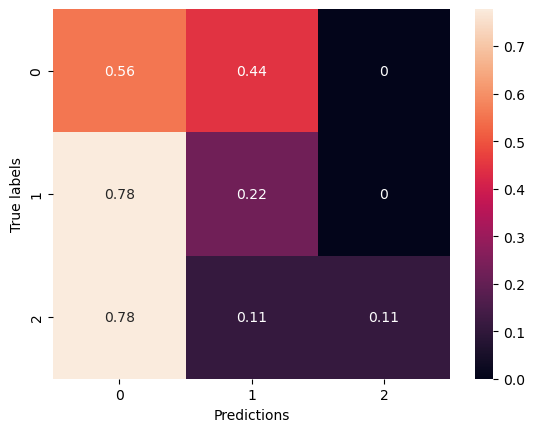

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▆█▆▆▇██▆▇▇▇▆▅▅▄▆▆▇▇▇▅▇▇▇▆▇▆▇▅▆▇▆█▇█▆█▇▅
training_loss,█▂▁▁▁▁▁▁▁▁▁▁▃▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂█▄███▅█▁▅▁▅▁▂▁▂▆▄█▂▆▅▄▄▆▇█▅▃▆▅██▇▇▇▆▃
val_loss,█▃▂▁▁▁▁▁▁▁▂▁▄▂▂▂▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂


Epoch 1/100


2024-03-12 20:01:00.546805: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:01:00.548836: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:01:00.550390: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:01:02.183286: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:01:02.184969: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:01:02.187493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:01:07.467210: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:01:08.056004: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 8.1448 - accuracy: 0.3744

2024-03-12 20:01:11.623944: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:01:11.625590: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:01:11.627582: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 190ms/step - loss: 8.1448 - accuracy: 0.3744 - val_loss: 8.2894 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 72ms/step - loss: 7.5682 - accuracy: 0.4087 - val_loss: 9.3125 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 73ms/step - loss: 6.8509 - accuracy: 0.4269 - val_loss: 7.3331 - val_accuracy: 0.1204
Epoch 4/100
14/14 [==============================] - 1s 71ms/step - loss: 6.1079 - accuracy: 0.4886 - val_loss: 7.0500 - val_accuracy: 0.1296
Epoch 5/100
14/14 [==============================] - 1s 72ms/step - loss: 5.4460 - accuracy: 0.5137 - val_loss: 6.3820 - val_accuracy: 0.1389
Epoch 6/100
14/14 [==============================] - 1s 72ms/step - loss: 4.8033 - accuracy: 0.5365 - val_loss: 5.1566 - val_accuracy: 0.1759
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 4.2256 - accuracy: 0.6096 - val_loss: 5.4771 - val_accuracy: 0.1389
Epoch 8/100
14/1

14/14 [==============================] - 1s 72ms/step - loss: 1.9321 - accuracy: 0.7146 - val_loss: 3.1479 - val_accuracy: 0.3889
Epoch 59/100
14/14 [==============================] - 1s 72ms/step - loss: 1.9814 - accuracy: 0.7146 - val_loss: 2.7084 - val_accuracy: 0.3426
Epoch 60/100
14/14 [==============================] - 1s 73ms/step - loss: 1.9748 - accuracy: 0.6986 - val_loss: 2.4337 - val_accuracy: 0.4907
Epoch 61/100
14/14 [==============================] - 1s 72ms/step - loss: 1.8735 - accuracy: 0.7055 - val_loss: 2.3732 - val_accuracy: 0.5370
Epoch 62/100
14/14 [==============================] - 1s 72ms/step - loss: 1.7716 - accuracy: 0.7489 - val_loss: 2.7275 - val_accuracy: 0.5093
Epoch 63/100
14/14 [==============================] - 1s 72ms/step - loss: 1.7766 - accuracy: 0.7329 - val_loss: 2.4106 - val_accuracy: 0.5648
Epoch 64/100
14/14 [==============================] - 1s 71ms/step - loss: 1.7785 - accuracy: 0.7306 - val_loss: 2.4165 - val_accuracy: 0.5556
Epoch 65/100

2024-03-12 20:02:53.252777: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:02:53.254363: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:02:53.256426: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4808189868927002 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '2': {'precision': 0.375, 'recall': 1.0, 'f1-score': 0.5454545454545454, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.625, 'recall': 0.40740740740740744, 'f1-score': 0.3090909090909091, 'support': 27}, 'weighted avg': {'precision': 0.625, 'recall': 0.4074074074074074, 'f1-score': 0.309090909090909, 'support': 27}}


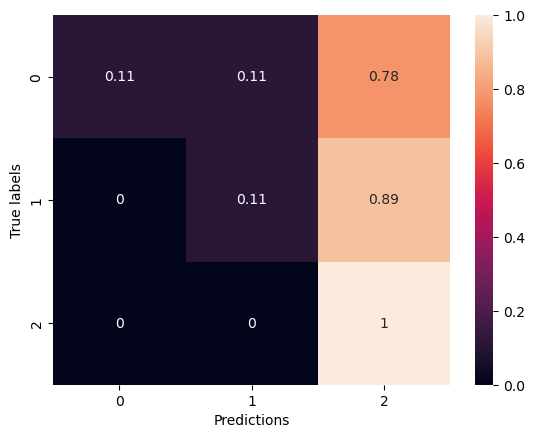

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▄▅▆▆▇▆▇▇▇█▆▅▇▇▇▆▇▇▇▇▇█▇█▇▄▅▆▆▄▆▅▅▆▆▅▆▆
training_loss,█▇▄▃▂▂▂▁▁▁▁▁▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▂▂▂▂▃▃▂▂▂▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▅▆▅█▆▇▄▇▅█▆▇▄▃▅▂▇▇▆▆▄▇█▇▇▅▄▆▆▇▇█▅▅▃▆▇
val_loss,█▇▄▃▂▂▁▁▁▂▁▁▁▂▁▁▃▁▄▁▁▂▁▁▁▁▁▂▂▂▂▃▂▂▁▁▁▂▁▁


Epoch 1/100


2024-03-12 20:03:16.054001: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:03:16.056079: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:03:16.057437: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:03:17.682144: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:03:17.684558: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:03:17.686477: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:03:21.837831: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:03:22.430539: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 26.3577 - accuracy: 0.3516

2024-03-12 20:03:25.966955: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:03:25.968651: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:03:25.970630: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 191ms/step - loss: 26.3577 - accuracy: 0.3516 - val_loss: 19.5284 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 1s 71ms/step - loss: 15.9978 - accuracy: 0.4384 - val_loss: 14.5993 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 72ms/step - loss: 11.3001 - accuracy: 0.4612 - val_loss: 10.1789 - val_accuracy: 0.1296
Epoch 4/100
14/14 [==============================] - 1s 72ms/step - loss: 8.1985 - accuracy: 0.4589 - val_loss: 7.7150 - val_accuracy: 0.1296
Epoch 5/100
14/14 [==============================] - 1s 71ms/step - loss: 5.9220 - accuracy: 0.5502 - val_loss: 5.8374 - val_accuracy: 0.2778
Epoch 6/100
14/14 [==============================] - 1s 72ms/step - loss: 4.5318 - accuracy: 0.5776 - val_loss: 5.1123 - val_accuracy: 0.1481
Epoch 7/100
14/14 [==============================] - 1s 72ms/step - loss: 3.7006 - accuracy: 0.5890 - val_loss: 4.0642 - val_accuracy: 0.2685
Epoch 8/10

14/14 [==============================] - 1s 73ms/step - loss: 2.4466 - accuracy: 0.5662 - val_loss: 3.6383 - val_accuracy: 0.1759
Epoch 59/100
14/14 [==============================] - 1s 72ms/step - loss: 2.4002 - accuracy: 0.6096 - val_loss: 4.1195 - val_accuracy: 0.1759
Epoch 60/100
14/14 [==============================] - 1s 71ms/step - loss: 2.3663 - accuracy: 0.5982 - val_loss: 3.5770 - val_accuracy: 0.1574
Epoch 61/100
14/14 [==============================] - 1s 72ms/step - loss: 2.2588 - accuracy: 0.6005 - val_loss: 2.6434 - val_accuracy: 0.3889
Epoch 62/100
14/14 [==============================] - 1s 71ms/step - loss: 2.3366 - accuracy: 0.5868 - val_loss: 3.9887 - val_accuracy: 0.1667
Epoch 63/100
14/14 [==============================] - 1s 71ms/step - loss: 2.4830 - accuracy: 0.5890 - val_loss: 3.9414 - val_accuracy: 0.1759
Epoch 64/100
14/14 [==============================] - 1s 72ms/step - loss: 2.4614 - accuracy: 0.6256 - val_loss: 2.7413 - val_accuracy: 0.4907
Epoch 65/100

2024-03-12 20:05:08.264287: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:05:08.266675: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:05:08.268207: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4849889278411865 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 1.0, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}, 'weighted avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


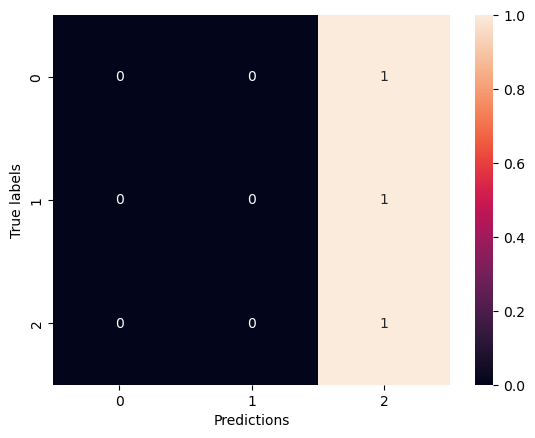

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▆▆▇▇▆▇▇▇▇▇█▆▆▇▇▇▆▆▆▇▆▇▇▇▆▅▆▅▅▆▆▆▅▅▆▆▆▆
training_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▃▂▁▂▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▇███▃▅▅███▇███▇▂▂▄▅▄▂▅▇▄▇▅▇▁▁▃▂▂▁▆▅██
val_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▂▁▁▁▁▁▂▂▂▃▂▂▂▁▁▁▁


Epoch 1/100


2024-03-12 20:05:31.797142: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:05:31.799350: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:05:31.801114: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:05:34.409587: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:05:34.411937: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:05:34.413760: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:05:38.870195: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:05:39.480600: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 33.4822 - accuracy: 0.3379

2024-03-12 20:05:43.063940: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:05:43.066163: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:05:43.067766: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 194ms/step - loss: 33.4822 - accuracy: 0.3379 - val_loss: 22.4772 - val_accuracy: 0.1296
Epoch 2/100
14/14 [==============================] - 1s 73ms/step - loss: 17.2814 - accuracy: 0.3950 - val_loss: 13.9304 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 74ms/step - loss: 10.9610 - accuracy: 0.4749 - val_loss: 10.2810 - val_accuracy: 0.1204
Epoch 4/100
14/14 [==============================] - 1s 83ms/step - loss: 7.8161 - accuracy: 0.4703 - val_loss: 7.1344 - val_accuracy: 0.1852
Epoch 5/100
14/14 [==============================] - 1s 83ms/step - loss: 5.8297 - accuracy: 0.5274 - val_loss: 5.6457 - val_accuracy: 0.1759
Epoch 6/100
14/14 [==============================] - 1s 74ms/step - loss: 4.4811 - accuracy: 0.5685 - val_loss: 5.1795 - val_accuracy: 0.1296
Epoch 7/100
14/14 [==============================] - 1s 73ms/step - loss: 3.7185 - accuracy: 0.5434 - val_loss: 3.7028 - val_accuracy: 0.3426
Epoch 8/10

14/14 [==============================] - 1s 74ms/step - loss: 2.4901 - accuracy: 0.5731 - val_loss: 2.8414 - val_accuracy: 0.2963
Epoch 59/100
14/14 [==============================] - 1s 73ms/step - loss: 2.3496 - accuracy: 0.5685 - val_loss: 2.7249 - val_accuracy: 0.4722
Epoch 60/100
14/14 [==============================] - 1s 72ms/step - loss: 2.3459 - accuracy: 0.5822 - val_loss: 2.6981 - val_accuracy: 0.3333
Epoch 61/100
14/14 [==============================] - 1s 73ms/step - loss: 2.2663 - accuracy: 0.5868 - val_loss: 2.5860 - val_accuracy: 0.5093
Epoch 62/100
14/14 [==============================] - 1s 74ms/step - loss: 2.5156 - accuracy: 0.5434 - val_loss: 2.9137 - val_accuracy: 0.2963
Epoch 63/100
14/14 [==============================] - 1s 75ms/step - loss: 2.5419 - accuracy: 0.5913 - val_loss: 3.5503 - val_accuracy: 0.3056
Epoch 64/100
14/14 [==============================] - 1s 71ms/step - loss: 2.5314 - accuracy: 0.5685 - val_loss: 2.8890 - val_accuracy: 0.2778
Epoch 65/100

2024-03-12 20:07:25.909198: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:07:25.910796: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:07:25.912707: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4778189659118652 s
{'0': {'precision': 0.42857142857142855, 'recall': 1.0, 'f1-score': 0.6, 'support': 9}, '1': {'precision': 0.2, 'recall': 0.1111111111111111, 'f1-score': 0.14285714285714285, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.5428571428571428, 'recall': 0.40740740740740744, 'f1-score': 0.3142857142857143, 'support': 27}, 'weighted avg': {'precision': 0.5428571428571428, 'recall': 0.4074074074074074, 'f1-score': 0.3142857142857142, 'support': 27}}


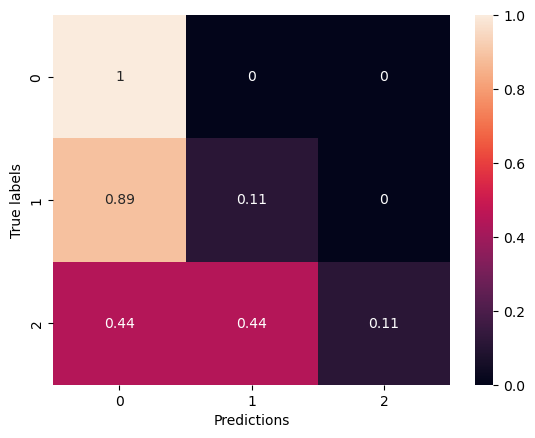

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▇▇▆▇▇█▆▆▇▇▇▇▆▇▇▇▇▇▇▇▆▇▇▇▆▇▆▇▇▇▆▇▆██▇██
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▄▄▄▃▄▄▂▂▃▆▄▅▇▅▅▁██▄▄▇▇▄▅▂▁█▅▅█▂▂▅▂▃▄▁
val_loss,█▄▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▂▂▁▁▁▁▂▂▁▂▂▁▁


Epoch 1/100


2024-03-12 20:07:50.135610: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:07:50.137260: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:07:50.139379: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:07:51.796658: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:07:51.798655: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:07:51.801038: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:07:55.993165: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:07:56.658943: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 9.1203 - accuracy: 0.4543

2024-03-12 20:08:01.341707: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:08:01.343917: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:08:01.345554: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 273ms/step - loss: 9.1203 - accuracy: 0.4543 - val_loss: 9.2579 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 82ms/step - loss: 7.9130 - accuracy: 0.5685 - val_loss: 8.6248 - val_accuracy: 0.1389
Epoch 3/100
14/14 [==============================] - 1s 83ms/step - loss: 6.7238 - accuracy: 0.6324 - val_loss: 7.8205 - val_accuracy: 0.1204
Epoch 4/100
14/14 [==============================] - 1s 101ms/step - loss: 5.6070 - accuracy: 0.6781 - val_loss: 6.4713 - val_accuracy: 0.1389
Epoch 5/100
14/14 [==============================] - 1s 86ms/step - loss: 4.6383 - accuracy: 0.7009 - val_loss: 5.3152 - val_accuracy: 0.1944
Epoch 6/100
14/14 [==============================] - 1s 86ms/step - loss: 3.8099 - accuracy: 0.7717 - val_loss: 5.1225 - val_accuracy: 0.2130
Epoch 7/100
14/14 [==============================] - 1s 83ms/step - loss: 3.2653 - accuracy: 0.7968 - val_loss: 4.2470 - val_accuracy: 0.2500
Epoch 8/100
14/

14/14 [==============================] - 1s 81ms/step - loss: 2.0014 - accuracy: 0.8425 - val_loss: 3.1253 - val_accuracy: 0.4815
Epoch 59/100
14/14 [==============================] - 1s 82ms/step - loss: 1.9726 - accuracy: 0.8379 - val_loss: 2.9085 - val_accuracy: 0.5093
Epoch 60/100
14/14 [==============================] - 1s 83ms/step - loss: 1.8649 - accuracy: 0.8607 - val_loss: 2.9254 - val_accuracy: 0.5648
Epoch 61/100
14/14 [==============================] - 1s 81ms/step - loss: 1.8106 - accuracy: 0.8630 - val_loss: 3.2079 - val_accuracy: 0.3796
Epoch 62/100
14/14 [==============================] - 1s 81ms/step - loss: 1.8266 - accuracy: 0.8470 - val_loss: 3.0959 - val_accuracy: 0.4167
Epoch 63/100
14/14 [==============================] - 1s 87ms/step - loss: 1.9344 - accuracy: 0.8105 - val_loss: 2.8975 - val_accuracy: 0.4444
Epoch 64/100
14/14 [==============================] - 1s 81ms/step - loss: 1.9329 - accuracy: 0.8242 - val_loss: 3.0649 - val_accuracy: 0.5556
Epoch 65/100

2024-03-12 20:09:55.998422: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:09:56.000440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:09:56.002023: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4932920932769775 s
{'0': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.4444444444444444, 'f1-score': 0.380952380952381, 'support': 9}, '2': {'precision': 0.625, 'recall': 0.5555555555555556, 'f1-score': 0.5882352941176471, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.46230158730158727, 'recall': 0.4444444444444444, 'f1-score': 0.448062558356676, 'support': 27}, 'weighted avg': {'precision': 0.4623015873015873, 'recall': 0.4444444444444444, 'f1-score': 0.448062558356676, 'support': 27}}


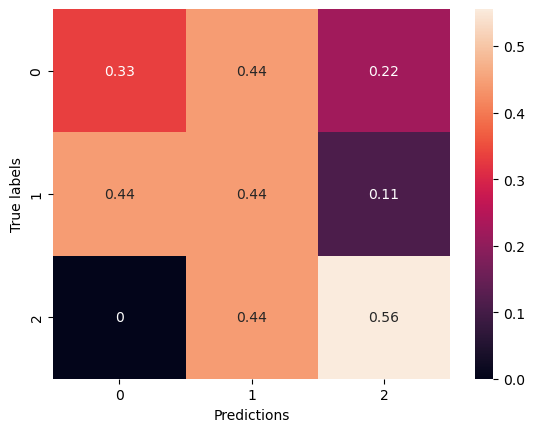

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▇▇▇█▇▇▇▇▇▇█▇█▇█▇█▇██▇█▇███▇▇▇█▇█▇█▇▇▇
training_loss,█▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▁▁
training_time,▁
val_accuracy,▁▁▂▇▇▆▇▇▆▆▅▇▇█▆▇█▇▃▆▇█▆▇▅▇▇▅▄▁▄▇▅▄▆▇▄▄▅▄
val_loss,█▆▄▂▂▁▁▁▁▁▂▁▂▁▁▁▁▂▂▁▁▂▁▁▂▁▂▁▂▃▂▂▂▂▂▂▂▂▂▂


Epoch 1/100


2024-03-12 20:10:20.965455: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:10:20.967092: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:10:20.969207: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:10:22.583746: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:10:22.585669: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:10:22.587820: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:10:26.759768: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:10:27.396777: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 29.5761 - accuracy: 0.4475

2024-03-12 20:10:31.145975: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:10:31.148530: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:10:31.150250: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 199ms/step - loss: 29.5761 - accuracy: 0.4475 - val_loss: 19.8596 - val_accuracy: 0.1296
Epoch 2/100
14/14 [==============================] - 1s 81ms/step - loss: 14.4207 - accuracy: 0.5297 - val_loss: 10.3950 - val_accuracy: 0.3519
Epoch 3/100
14/14 [==============================] - 1s 81ms/step - loss: 8.2973 - accuracy: 0.5982 - val_loss: 7.1726 - val_accuracy: 0.1574
Epoch 4/100
14/14 [==============================] - 1s 81ms/step - loss: 5.2492 - accuracy: 0.6941 - val_loss: 4.5755 - val_accuracy: 0.5185
Epoch 5/100
14/14 [==============================] - 1s 81ms/step - loss: 3.7517 - accuracy: 0.6941 - val_loss: 3.7079 - val_accuracy: 0.5278
Epoch 6/100
14/14 [==============================] - 1s 81ms/step - loss: 3.1541 - accuracy: 0.6895 - val_loss: 3.2719 - val_accuracy: 0.4907
Epoch 7/100
14/14 [==============================] - 1s 83ms/step - loss: 2.6365 - accuracy: 0.7352 - val_loss: 3.0106 - val_accuracy: 0.4907
Epoch 8/100


14/14 [==============================] - 1s 81ms/step - loss: 2.5085 - accuracy: 0.6781 - val_loss: 2.9415 - val_accuracy: 0.4815
Epoch 59/100
14/14 [==============================] - 1s 81ms/step - loss: 2.3369 - accuracy: 0.6781 - val_loss: 3.0164 - val_accuracy: 0.4352
Epoch 60/100
14/14 [==============================] - 1s 81ms/step - loss: 2.5114 - accuracy: 0.7055 - val_loss: 3.1344 - val_accuracy: 0.4074
Epoch 61/100
14/14 [==============================] - 1s 81ms/step - loss: 2.3454 - accuracy: 0.7123 - val_loss: 3.1938 - val_accuracy: 0.2500
Epoch 62/100
14/14 [==============================] - 1s 82ms/step - loss: 2.1272 - accuracy: 0.7352 - val_loss: 3.2711 - val_accuracy: 0.3704
Epoch 63/100
14/14 [==============================] - 1s 81ms/step - loss: 2.2537 - accuracy: 0.6781 - val_loss: 4.1111 - val_accuracy: 0.2222
Epoch 64/100
14/14 [==============================] - 1s 80ms/step - loss: 2.6452 - accuracy: 0.7009 - val_loss: 3.1603 - val_accuracy: 0.4074
Epoch 65/100

2024-03-12 20:12:25.485821: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:12:25.488155: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:12:25.490003: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4804060459136963 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.391304347826087, 'recall': 1.0, 'f1-score': 0.5625, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.24154589371980675, 'recall': 0.3703703703703704, 'f1-score': 0.24305555555555555, 'support': 27}, 'weighted avg': {'precision': 0.24154589371980678, 'recall': 0.37037037037037035, 'f1-score': 0.24305555555555555, 'support': 27}}


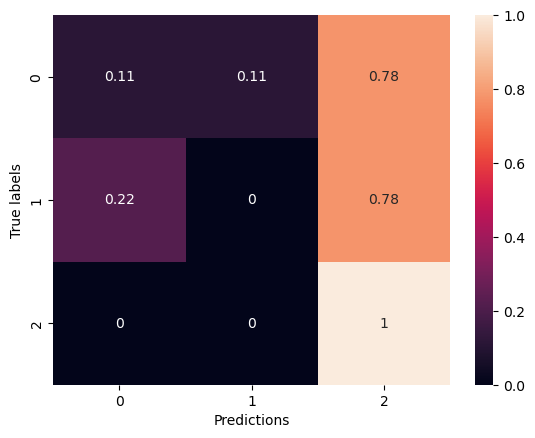

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▇▇▇▆█▅▇▆█▆▆▆▆▆▇▇▆▆▆▆▆▇▆▇▇▆▇▆▇▆▇▆▆▇█▇▇
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▆▆█▇▅▇▇█▄▄▇▄▃▂▇▃▂▄▅▄▂▅▃▅▃▆▅▂▄▆▄▅▁▆▄▆▄▇
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▂▂▂▁▂▂▁▁▁▂▁▁▁▂▁▁▂▁▁▁▁▂▁▁▁▁▁


Epoch 1/100


2024-03-12 20:12:49.405137: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:12:49.406959: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:12:49.408825: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:12:51.266314: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:12:51.268728: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:12:51.272035: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:12:56.571820: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:12:57.155073: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 38.5936 - accuracy: 0.3836

2024-03-12 20:13:00.810779: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:13:00.812541: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:13:00.814609: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 200ms/step - loss: 38.5936 - accuracy: 0.3836 - val_loss: 22.8166 - val_accuracy: 0.2222
Epoch 2/100
14/14 [==============================] - 1s 81ms/step - loss: 16.7963 - accuracy: 0.4886 - val_loss: 11.4716 - val_accuracy: 0.4815
Epoch 3/100
14/14 [==============================] - 1s 83ms/step - loss: 8.9963 - accuracy: 0.5936 - val_loss: 6.9283 - val_accuracy: 0.4167
Epoch 4/100
14/14 [==============================] - 1s 80ms/step - loss: 5.4944 - accuracy: 0.6758 - val_loss: 4.8636 - val_accuracy: 0.3611
Epoch 5/100
14/14 [==============================] - 1s 81ms/step - loss: 3.8804 - accuracy: 0.6963 - val_loss: 3.8317 - val_accuracy: 0.3889
Epoch 6/100
14/14 [==============================] - 1s 82ms/step - loss: 3.4139 - accuracy: 0.6621 - val_loss: 3.6687 - val_accuracy: 0.3519
Epoch 7/100
14/14 [==============================] - 1s 83ms/step - loss: 3.0725 - accuracy: 0.6553 - val_loss: 3.3545 - val_accuracy: 0.3148
Epoch 8/100


14/14 [==============================] - 1s 82ms/step - loss: 2.0247 - accuracy: 0.7237 - val_loss: 2.9946 - val_accuracy: 0.3981
Epoch 59/100
14/14 [==============================] - 1s 80ms/step - loss: 2.3544 - accuracy: 0.6781 - val_loss: 3.4306 - val_accuracy: 0.3333
Epoch 60/100
14/14 [==============================] - 1s 80ms/step - loss: 2.4624 - accuracy: 0.6644 - val_loss: 2.9043 - val_accuracy: 0.5000
Epoch 61/100
14/14 [==============================] - 1s 80ms/step - loss: 2.2916 - accuracy: 0.7123 - val_loss: 2.7382 - val_accuracy: 0.5370
Epoch 62/100
14/14 [==============================] - 1s 82ms/step - loss: 2.0925 - accuracy: 0.7169 - val_loss: 2.6375 - val_accuracy: 0.4630
Epoch 63/100
14/14 [==============================] - 1s 80ms/step - loss: 2.2511 - accuracy: 0.7329 - val_loss: 2.8547 - val_accuracy: 0.4815
Epoch 64/100
14/14 [==============================] - 1s 81ms/step - loss: 2.2376 - accuracy: 0.6621 - val_loss: 2.8144 - val_accuracy: 0.5556
Epoch 65/100

2024-03-12 20:14:54.979532: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:14:54.981464: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:14:54.983184: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.481348991394043 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.2727272727272727, 'recall': 0.3333333333333333, 'f1-score': 0.3, 'support': 9}, '2': {'precision': 0.4166666666666667, 'recall': 0.5555555555555556, 'f1-score': 0.4761904761904762, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.39646464646464646, 'recall': 0.3703703703703704, 'f1-score': 0.3612942612942613, 'support': 27}, 'weighted avg': {'precision': 0.3964646464646464, 'recall': 0.37037037037037035, 'f1-score': 0.3612942612942613, 'support': 27}}


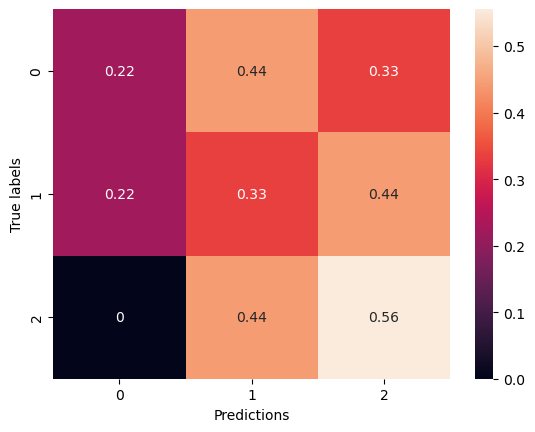

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▅▆▇▇▇██▇▇▇▇█▇▆▇▇▅▆▇▇▆▅▇▇▆██▆██▇▆▇▇▇▇▇▇▇
training_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▅▅▇█▇▆▂▆▆▆▁█▄█▆▅▆▅▆▁▆▆▄▇█▇▄▃▄▄▇▇▂▃▃▅▅▆▅
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁


Epoch 1/100


2024-03-12 20:15:18.885429: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:15:18.887000: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:15:18.889073: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:15:20.538999: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:15:20.541396: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:15:20.543409: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:15:24.773902: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:15:25.368386: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 9.2289 - accuracy: 0.3927

2024-03-12 20:15:29.049722: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:15:29.051457: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:15:29.053384: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 200ms/step - loss: 9.2289 - accuracy: 0.3927 - val_loss: 8.7045 - val_accuracy: 0.2315
Epoch 2/100
14/14 [==============================] - 1s 81ms/step - loss: 8.3317 - accuracy: 0.4658 - val_loss: 8.1727 - val_accuracy: 0.1667
Epoch 3/100
14/14 [==============================] - 1s 81ms/step - loss: 7.3764 - accuracy: 0.4840 - val_loss: 7.0320 - val_accuracy: 0.1944
Epoch 4/100
14/14 [==============================] - 1s 81ms/step - loss: 6.3263 - accuracy: 0.5274 - val_loss: 7.0112 - val_accuracy: 0.1481
Epoch 5/100
14/14 [==============================] - 1s 81ms/step - loss: 5.3824 - accuracy: 0.6324 - val_loss: 5.3076 - val_accuracy: 0.3241
Epoch 6/100
14/14 [==============================] - 1s 82ms/step - loss: 4.5786 - accuracy: 0.6598 - val_loss: 5.2645 - val_accuracy: 0.2500
Epoch 7/100
14/14 [==============================] - 1s 81ms/step - loss: 3.8853 - accuracy: 0.7306 - val_loss: 4.3652 - val_accuracy: 0.3241
Epoch 8/100
14/1

14/14 [==============================] - 1s 86ms/step - loss: 1.9666 - accuracy: 0.7763 - val_loss: 3.0643 - val_accuracy: 0.2870
Epoch 59/100
14/14 [==============================] - 1s 86ms/step - loss: 2.1142 - accuracy: 0.7215 - val_loss: 2.7737 - val_accuracy: 0.3796
Epoch 60/100
14/14 [==============================] - 1s 95ms/step - loss: 2.0520 - accuracy: 0.7648 - val_loss: 3.1217 - val_accuracy: 0.3148
Epoch 61/100
14/14 [==============================] - 1s 89ms/step - loss: 2.0439 - accuracy: 0.7603 - val_loss: 3.0331 - val_accuracy: 0.4074
Epoch 62/100
14/14 [==============================] - 1s 85ms/step - loss: 2.0142 - accuracy: 0.7877 - val_loss: 2.8703 - val_accuracy: 0.4167
Epoch 63/100
14/14 [==============================] - 1s 82ms/step - loss: 2.0353 - accuracy: 0.7785 - val_loss: 2.9561 - val_accuracy: 0.3241
Epoch 64/100
14/14 [==============================] - 1s 81ms/step - loss: 1.8962 - accuracy: 0.8151 - val_loss: 2.6589 - val_accuracy: 0.6111
Epoch 65/100

2024-03-12 20:17:24.716643: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:17:24.718717: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:17:24.720268: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.493199110031128 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.8888888888888888, 'f1-score': 0.5517241379310346, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.27619047619047615, 'recall': 0.4074074074074074, 'f1-score': 0.30890804597701155, 'support': 27}, 'weighted avg': {'precision': 0.2761904761904762, 'recall': 0.4074074074074074, 'f1-score': 0.30890804597701155, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


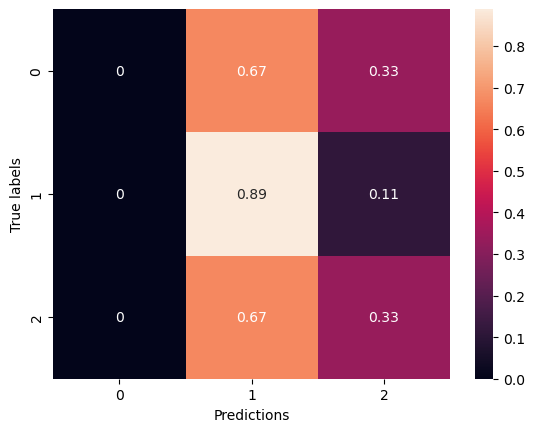

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▅▅▆▇▇▆▆▇▇▇█▇█▇█▇▇██▇█▆▇█▇▇█▇▆█▆▆▇██▇▇▇
training_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▂▃▄▅▄▄▄▄▅▆▇▃▇▆▇▇▇▇▃▅▁▄▅▅█▅▆▆▃▁▅▄▆▄▇▁▂▅▅
val_loss,█▆▄▃▂▂▂▁▁▂▁▁▃▁▁▁▁▁▁▂▂▄▂▁▂▁▁▁▁▃▃▁▂▁▂▁▄▂▂▁


Epoch 1/100


2024-03-12 20:17:49.717950: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:17:49.719540: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:17:49.721771: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:17:51.361815: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:17:51.364264: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:17:51.366014: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:17:55.679187: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:17:56.273058: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 30.9457 - accuracy: 0.3653

2024-03-12 20:17:59.960740: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:17:59.962935: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:17:59.964666: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 201ms/step - loss: 30.9457 - accuracy: 0.3653 - val_loss: 21.6900 - val_accuracy: 0.3056
Epoch 2/100
14/14 [==============================] - 1s 86ms/step - loss: 17.7439 - accuracy: 0.4863 - val_loss: 14.1345 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 81ms/step - loss: 11.3375 - accuracy: 0.5479 - val_loss: 9.4282 - val_accuracy: 0.2037
Epoch 4/100
14/14 [==============================] - 1s 81ms/step - loss: 7.7404 - accuracy: 0.5616 - val_loss: 7.3593 - val_accuracy: 0.1296
Epoch 5/100
14/14 [==============================] - 1s 82ms/step - loss: 5.6160 - accuracy: 0.6164 - val_loss: 5.4667 - val_accuracy: 0.2870
Epoch 6/100
14/14 [==============================] - 1s 81ms/step - loss: 4.2863 - accuracy: 0.6530 - val_loss: 4.2665 - val_accuracy: 0.3796
Epoch 7/100
14/14 [==============================] - 1s 86ms/step - loss: 3.5288 - accuracy: 0.6941 - val_loss: 4.4768 - val_accuracy: 0.2315
Epoch 8/100

14/14 [==============================] - 1s 90ms/step - loss: 4.6708 - accuracy: 0.5753 - val_loss: 4.2527 - val_accuracy: 0.4444
Epoch 59/100
14/14 [==============================] - 1s 89ms/step - loss: 3.4751 - accuracy: 0.5982 - val_loss: 3.9370 - val_accuracy: 0.2500
Epoch 60/100
14/14 [==============================] - 1s 89ms/step - loss: 2.8104 - accuracy: 0.6027 - val_loss: 3.2011 - val_accuracy: 0.3241
Epoch 61/100
14/14 [==============================] - 1s 89ms/step - loss: 3.0213 - accuracy: 0.5753 - val_loss: 4.1286 - val_accuracy: 0.3333
Epoch 62/100
14/14 [==============================] - 1s 89ms/step - loss: 4.5242 - accuracy: 0.5639 - val_loss: 4.7090 - val_accuracy: 0.3148
Epoch 63/100
14/14 [==============================] - 1s 88ms/step - loss: 3.8494 - accuracy: 0.6164 - val_loss: 3.6438 - val_accuracy: 0.3426
Epoch 64/100
14/14 [==============================] - 1s 89ms/step - loss: 2.8604 - accuracy: 0.6324 - val_loss: 3.1931 - val_accuracy: 0.3148
Epoch 65/100

2024-03-12 20:20:04.028058: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:20:04.029716: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:20:04.031503: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4976139068603516 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 1.0, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}, 'weighted avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


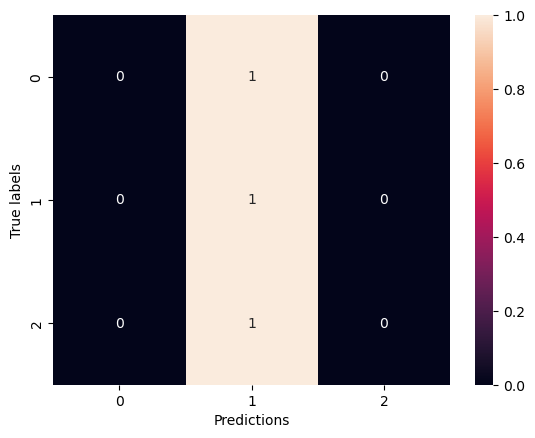

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▇▇▇█▇█▇█▇█▇█▇▇▇▅▆▆▆▆▅▅▆▅▇▆▆▆▆▆▅▅▆▆▅▆▆
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▂▅▃█▇▄▇▆▇▅▆▅█▄▅▄▄▅▄▃▃▁▃▅▄▅▇▃▅▄▅▅▁▆▄▇▂▁▅
val_loss,█▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▃▁▂▁▁▁▁▁▁▁▁▂▁▁▁▂▁▁


Epoch 1/100


2024-03-12 20:20:31.049988: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:20:31.051656: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:20:31.054020: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:20:32.688100: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:20:32.690350: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:20:32.691978: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:20:37.875480: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:20:38.468242: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 39.0008 - accuracy: 0.4064

2024-03-12 20:20:42.174727: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:20:42.176387: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:20:42.178171: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 201ms/step - loss: 39.0008 - accuracy: 0.4064 - val_loss: 24.6357 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 1s 80ms/step - loss: 18.2836 - accuracy: 0.4817 - val_loss: 14.0627 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 81ms/step - loss: 10.5476 - accuracy: 0.5228 - val_loss: 9.2998 - val_accuracy: 0.1389
Epoch 4/100
14/14 [==============================] - 1s 81ms/step - loss: 6.8649 - accuracy: 0.5525 - val_loss: 6.0296 - val_accuracy: 0.2500
Epoch 5/100
14/14 [==============================] - 1s 94ms/step - loss: 4.8817 - accuracy: 0.6096 - val_loss: 5.3570 - val_accuracy: 0.1481
Epoch 6/100
14/14 [==============================] - 1s 81ms/step - loss: 3.8660 - accuracy: 0.6393 - val_loss: 4.2137 - val_accuracy: 0.1944
Epoch 7/100
14/14 [==============================] - 1s 81ms/step - loss: 3.2586 - accuracy: 0.6667 - val_loss: 3.7692 - val_accuracy: 0.2685
Epoch 8/100

14/14 [==============================] - 1s 90ms/step - loss: 2.7126 - accuracy: 0.6644 - val_loss: 4.9827 - val_accuracy: 0.1204
Epoch 59/100
14/14 [==============================] - 1s 91ms/step - loss: 2.5931 - accuracy: 0.6553 - val_loss: 3.9110 - val_accuracy: 0.2407
Epoch 60/100
14/14 [==============================] - 1s 83ms/step - loss: 2.7403 - accuracy: 0.6370 - val_loss: 3.4926 - val_accuracy: 0.3796
Epoch 61/100
14/14 [==============================] - 1s 83ms/step - loss: 2.4759 - accuracy: 0.6895 - val_loss: 2.7666 - val_accuracy: 0.5463
Epoch 62/100
14/14 [==============================] - 1s 82ms/step - loss: 2.3664 - accuracy: 0.6735 - val_loss: 2.9062 - val_accuracy: 0.5370
Epoch 63/100
14/14 [==============================] - 1s 82ms/step - loss: 2.9466 - accuracy: 0.6279 - val_loss: 3.7850 - val_accuracy: 0.2593
Epoch 64/100
14/14 [==============================] - 1s 81ms/step - loss: 3.0498 - accuracy: 0.6256 - val_loss: 3.2790 - val_accuracy: 0.3889
Epoch 65/100

2024-03-12 20:22:36.608823: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:22:36.610996: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:22:36.613442: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5047597885131836 s
{'0': {'precision': 0.2727272727272727, 'recall': 0.6666666666666666, 'f1-score': 0.3870967741935484, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, 'accuracy': 0.2222222222222222, 'macro avg': {'precision': 0.0909090909090909, 'recall': 0.2222222222222222, 'f1-score': 0.12903225806451613, 'support': 27}, 'weighted avg': {'precision': 0.0909090909090909, 'recall': 0.2222222222222222, 'f1-score': 0.12903225806451613, 'support': 27}}


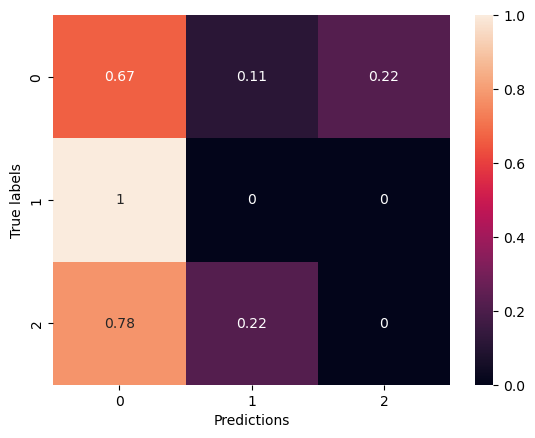

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▇▇██▇█▇█▇▆█▇██▇▆▇▇▇█▆▇█▆▇█▇▅▆▅▆▆▆▇▇█▅▆
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▅
training_time,▁
val_accuracy,▁▁▂▇██▅█▅█▇▅▃▃▃▅█▅▆▅▁▅▁▃█▅▅▇▅▄▅▅▄▄▄▂▂▇▁▁
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▂█


Epoch 1/100


2024-03-12 20:23:01.275877: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:23:01.277983: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:23:01.279615: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:23:02.879625: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:23:02.881547: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:23:02.883685: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:23:07.073134: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:23:07.653798: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 9.4049 - accuracy: 0.3265

2024-03-12 20:23:11.280236: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:23:11.282621: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:23:11.284259: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 197ms/step - loss: 9.4049 - accuracy: 0.3265 - val_loss: 8.4871 - val_accuracy: 0.1667
Epoch 2/100
14/14 [==============================] - 1s 85ms/step - loss: 8.6445 - accuracy: 0.3493 - val_loss: 8.5064 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 80ms/step - loss: 7.7159 - accuracy: 0.3539 - val_loss: 8.1285 - val_accuracy: 0.1204
Epoch 4/100
14/14 [==============================] - 1s 79ms/step - loss: 6.7874 - accuracy: 0.4475 - val_loss: 7.4228 - val_accuracy: 0.1204
Epoch 5/100
14/14 [==============================] - 1s 80ms/step - loss: 6.0584 - accuracy: 0.4247 - val_loss: 6.7056 - val_accuracy: 0.1204
Epoch 6/100
14/14 [==============================] - 1s 80ms/step - loss: 5.3422 - accuracy: 0.4384 - val_loss: 6.1664 - val_accuracy: 0.1204
Epoch 7/100
14/14 [==============================] - 1s 81ms/step - loss: 4.6584 - accuracy: 0.5046 - val_loss: 5.9379 - val_accuracy: 0.1296
Epoch 8/100
14/1

14/14 [==============================] - 1s 84ms/step - loss: 1.9932 - accuracy: 0.6575 - val_loss: 2.5202 - val_accuracy: 0.5370
Epoch 59/100
14/14 [==============================] - 1s 81ms/step - loss: 2.2048 - accuracy: 0.5913 - val_loss: 2.9326 - val_accuracy: 0.3426
Epoch 60/100
14/14 [==============================] - 1s 80ms/step - loss: 2.2657 - accuracy: 0.6279 - val_loss: 4.7143 - val_accuracy: 0.1574
Epoch 61/100
14/14 [==============================] - 1s 81ms/step - loss: 2.1891 - accuracy: 0.6712 - val_loss: 2.6524 - val_accuracy: 0.4259
Epoch 62/100
14/14 [==============================] - 1s 79ms/step - loss: 2.1373 - accuracy: 0.6233 - val_loss: 2.4908 - val_accuracy: 0.4074
Epoch 63/100
14/14 [==============================] - 1s 82ms/step - loss: 2.0400 - accuracy: 0.6575 - val_loss: 2.4553 - val_accuracy: 0.5556
Epoch 64/100
14/14 [==============================] - 1s 80ms/step - loss: 2.0388 - accuracy: 0.6644 - val_loss: 2.9561 - val_accuracy: 0.2778
Epoch 65/100

2024-03-12 20:25:04.292588: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:25:04.294662: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:25:04.296437: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4728450775146484 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '2': {'precision': 0.38095238095238093, 'recall': 0.8888888888888888, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.29365079365079366, 'recall': 0.4074074074074074, 'f1-score': 0.3111111111111111, 'support': 27}, 'weighted avg': {'precision': 0.29365079365079366, 'recall': 0.4074074074074074, 'f1-score': 0.3111111111111111, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


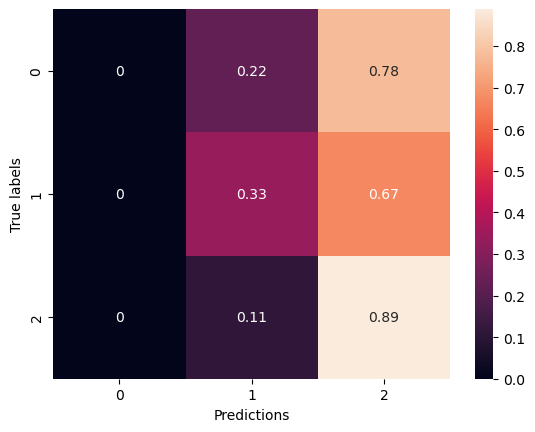

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▅▆▆▆▇▆▇███▇▇█▇▇▇▇█▇▇▆██▇▇▇█▇▇█▇▇▇▇▇▇▇
training_loss,█▆▄▃▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▄▆▄█▄▄▄▆▄▃▅▅▆▄▆▅▆▄▂▅▄▆▃▅▅▅▅▅▆▃▂▆▃▅▅█▆
val_loss,██▅▃▂▂▂▂▂▂▁▁▃▁▁▁▂▁▂▁▁▃▁▂▁▂▁▁▂▁▁▁▃▂▁▂▁▁▁▁


Epoch 1/100


2024-03-12 20:25:29.583500: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:25:29.585179: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:25:29.587038: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:25:32.258116: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:25:32.260089: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:25:32.262377: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:25:36.365543: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:25:36.943939: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 30.2766 - accuracy: 0.3402

2024-03-12 20:25:40.559565: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:25:40.561365: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:25:40.563181: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 197ms/step - loss: 30.2766 - accuracy: 0.3402 - val_loss: 20.8732 - val_accuracy: 0.1481
Epoch 2/100
14/14 [==============================] - 1s 80ms/step - loss: 17.1969 - accuracy: 0.3653 - val_loss: 14.3747 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 80ms/step - loss: 11.5856 - accuracy: 0.4475 - val_loss: 10.3129 - val_accuracy: 0.1389
Epoch 4/100
14/14 [==============================] - 1s 80ms/step - loss: 8.5431 - accuracy: 0.4566 - val_loss: 7.8396 - val_accuracy: 0.1574
Epoch 5/100
14/14 [==============================] - 1s 80ms/step - loss: 6.5960 - accuracy: 0.5091 - val_loss: 6.5263 - val_accuracy: 0.1759
Epoch 6/100
14/14 [==============================] - 1s 90ms/step - loss: 5.2714 - accuracy: 0.5639 - val_loss: 5.3406 - val_accuracy: 0.1852
Epoch 7/100
14/14 [==============================] - 1s 85ms/step - loss: 4.3780 - accuracy: 0.5571 - val_loss: 4.5180 - val_accuracy: 0.2593
Epoch 8/10

14/14 [==============================] - 1s 81ms/step - loss: 2.8572 - accuracy: 0.5776 - val_loss: 4.4167 - val_accuracy: 0.1759
Epoch 59/100
14/14 [==============================] - 1s 83ms/step - loss: 3.3844 - accuracy: 0.5251 - val_loss: 4.5458 - val_accuracy: 0.1204
Epoch 60/100
14/14 [==============================] - 1s 79ms/step - loss: 3.1856 - accuracy: 0.5525 - val_loss: 3.0786 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 1s 80ms/step - loss: 2.6835 - accuracy: 0.5434 - val_loss: 3.0925 - val_accuracy: 0.3889
Epoch 62/100
14/14 [==============================] - 1s 80ms/step - loss: 2.8786 - accuracy: 0.5776 - val_loss: 3.4021 - val_accuracy: 0.3611
Epoch 63/100
14/14 [==============================] - 1s 81ms/step - loss: 2.9702 - accuracy: 0.5479 - val_loss: 4.9142 - val_accuracy: 0.1111
Epoch 64/100
14/14 [==============================] - 1s 80ms/step - loss: 2.7284 - accuracy: 0.5594 - val_loss: 2.8742 - val_accuracy: 0.3241
Epoch 65/100

2024-03-12 20:27:33.757302: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:27:33.759489: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:27:33.761423: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4822330474853516 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, '2': {'precision': 0.3888888888888889, 'recall': 0.7777777777777778, 'f1-score': 0.5185185185185185, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.24074074074074073, 'recall': 0.3333333333333333, 'f1-score': 0.2617283950617284, 'support': 27}, 'weighted avg': {'precision': 0.24074074074074073, 'recall': 0.3333333333333333, 'f1-score': 0.2617283950617284, 'support': 27}}


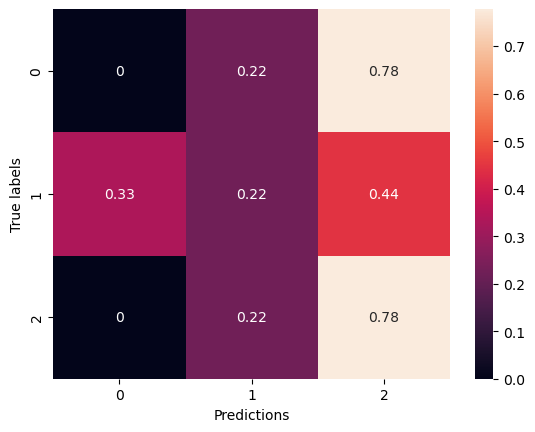

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▇▇▆▅▆▆█▇▇▇▇▇█▆▇█▆▇▇▇▄▆▆▆▆▆▇▆▇█▆▇█▇▇▇▆▆
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▄█▃▇▇█▆▅▂▁▃▆▆█▇▅▁▄▂▆▁▅▄▆▇▇▇▄▅▅▂█▇▃▁▁▆
val_loss,█▄▂▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁▂▁▁▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▂▂▁


Epoch 1/100


2024-03-12 20:27:56.992633: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:27:56.994304: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:27:56.996255: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:27:58.644950: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:27:58.646782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:27:58.648757: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:28:02.794828: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:28:03.378515: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 39.3221 - accuracy: 0.3265

2024-03-12 20:28:07.948856: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:28:07.950487: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:28:07.952346: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 272ms/step - loss: 39.3221 - accuracy: 0.3265 - val_loss: 24.7358 - val_accuracy: 0.1296
Epoch 2/100
14/14 [==============================] - 1s 80ms/step - loss: 19.3135 - accuracy: 0.3995 - val_loss: 14.7415 - val_accuracy: 0.1296
Epoch 3/100
14/14 [==============================] - 1s 80ms/step - loss: 12.0366 - accuracy: 0.3973 - val_loss: 9.9865 - val_accuracy: 0.1481
Epoch 4/100
14/14 [==============================] - 1s 80ms/step - loss: 8.2715 - accuracy: 0.5274 - val_loss: 7.2954 - val_accuracy: 0.2037
Epoch 5/100
14/14 [==============================] - 1s 80ms/step - loss: 6.1774 - accuracy: 0.5251 - val_loss: 5.4599 - val_accuracy: 0.3889
Epoch 6/100
14/14 [==============================] - 1s 82ms/step - loss: 4.9507 - accuracy: 0.5525 - val_loss: 4.6527 - val_accuracy: 0.3519
Epoch 7/100
14/14 [==============================] - 1s 80ms/step - loss: 4.1937 - accuracy: 0.5731 - val_loss: 4.2398 - val_accuracy: 0.3981
Epoch 8/100

wandb: Network error (ConnectTimeout), entering retry loop.


14/14 [==============================] - 1s 86ms/step - loss: 3.1540 - accuracy: 0.5753 - val_loss: 3.3767 - val_accuracy: 0.5185
Epoch 51/100
14/14 [==============================] - 1s 81ms/step - loss: 3.3149 - accuracy: 0.5365 - val_loss: 3.6361 - val_accuracy: 0.3611
Epoch 52/100
14/14 [==============================] - 1s 80ms/step - loss: 3.3035 - accuracy: 0.5662 - val_loss: 3.4174 - val_accuracy: 0.3426
Epoch 53/100
14/14 [==============================] - 1s 80ms/step - loss: 3.1285 - accuracy: 0.5297 - val_loss: 3.4743 - val_accuracy: 0.2870
Epoch 54/100
14/14 [==============================] - 1s 81ms/step - loss: 3.2647 - accuracy: 0.5411 - val_loss: 3.2900 - val_accuracy: 0.5463
Epoch 55/100
14/14 [==============================] - 1s 80ms/step - loss: 2.9016 - accuracy: 0.5731 - val_loss: 4.0252 - val_accuracy: 0.1852
Epoch 56/100
14/14 [==============================] - 1s 82ms/step - loss: 2.7241 - accuracy: 0.5731 - val_loss: 2.8728 - val_accuracy: 0.3704
Epoch 57/100

2024-03-12 20:30:03.827822: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:30:03.831222: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:30:03.833621: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.9823930263519287 s
{'0': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.35, 'recall': 0.7777777777777778, 'f1-score': 0.48275862068965514, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.2595238095238095, 'recall': 0.3703703703703704, 'f1-score': 0.285919540229885, 'support': 27}, 'weighted avg': {'precision': 0.2595238095238095, 'recall': 0.37037037037037035, 'f1-score': 0.285919540229885, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


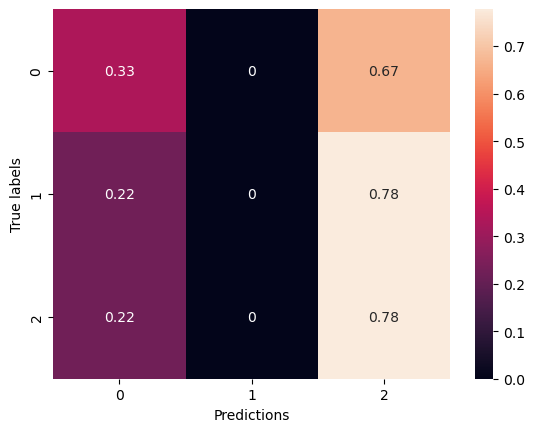

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▆▆█▆▇▆▆▆▇▇▅▇▆▇▆▆▅▆▆▆▆▆▅▅▅▆▇▆▆▇▅▇▆▆▇▇▆▇
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▅▂▅█▄▂█▅▄▂▂▃█▅▅▄▁▇▅█▅▆▂▅▇▇▇▇▄▇▄▄▄▃██▃▇
val_loss,█▃▂▂▁▁▁▂▁▁▁▂▁▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 20:31:26.610808: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:31:26.613117: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:31:26.614858: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:31:28.340619: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:31:28.342824: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:31:28.344491: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:31:32.637665: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:31:33.226403: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 10.7432 - accuracy: 0.4475

2024-03-12 20:31:37.325572: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:31:37.328115: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:31:37.330207: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 229ms/step - loss: 10.7432 - accuracy: 0.4475 - val_loss: 10.1893 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 2s 111ms/step - loss: 9.1439 - accuracy: 0.6005 - val_loss: 9.9005 - val_accuracy: 0.1296
Epoch 3/100
14/14 [==============================] - 2s 111ms/step - loss: 7.5389 - accuracy: 0.6826 - val_loss: 8.6211 - val_accuracy: 0.1111
Epoch 4/100
14/14 [==============================] - 2s 110ms/step - loss: 5.9881 - accuracy: 0.7374 - val_loss: 8.0664 - val_accuracy: 0.1296
Epoch 5/100
14/14 [==============================] - 2s 112ms/step - loss: 4.8358 - accuracy: 0.7306 - val_loss: 5.5824 - val_accuracy: 0.2130
Epoch 6/100
14/14 [==============================] - 2s 111ms/step - loss: 3.8510 - accuracy: 0.7740 - val_loss: 5.7295 - val_accuracy: 0.1574
Epoch 7/100
14/14 [==============================] - 2s 133ms/step - loss: 3.1686 - accuracy: 0.8288 - val_loss: 4.9415 - val_accuracy: 0.2315
Epoch 8/

14/14 [==============================] - 1s 106ms/step - loss: 2.3835 - accuracy: 0.8493 - val_loss: 3.3308 - val_accuracy: 0.5556
Epoch 59/100
14/14 [==============================] - 1s 106ms/step - loss: 2.2313 - accuracy: 0.8470 - val_loss: 3.2218 - val_accuracy: 0.5000
Epoch 60/100
14/14 [==============================] - 2s 114ms/step - loss: 2.1124 - accuracy: 0.8333 - val_loss: 3.8011 - val_accuracy: 0.3981
Epoch 61/100
14/14 [==============================] - 1s 107ms/step - loss: 2.1211 - accuracy: 0.8447 - val_loss: 3.6971 - val_accuracy: 0.3148
Epoch 62/100
14/14 [==============================] - 1s 107ms/step - loss: 2.0672 - accuracy: 0.8219 - val_loss: 3.0287 - val_accuracy: 0.5000
Epoch 63/100
14/14 [==============================] - 2s 109ms/step - loss: 1.9821 - accuracy: 0.8333 - val_loss: 3.7281 - val_accuracy: 0.3241
Epoch 64/100
14/14 [==============================] - 2s 108ms/step - loss: 1.9505 - accuracy: 0.8539 - val_loss: 3.7747 - val_accuracy: 0.2870
Epoch

2024-03-12 20:34:11.854617: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:34:11.856763: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:34:11.858395: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5104851722717285 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.42105263157894735, 'recall': 0.8888888888888888, 'f1-score': 0.5714285714285714, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.3308270676691729, 'recall': 0.4444444444444444, 'f1-score': 0.35714285714285715, 'support': 27}, 'weighted avg': {'precision': 0.3308270676691729, 'recall': 0.4444444444444444, 'f1-score': 0.35714285714285715, 'support': 27}}


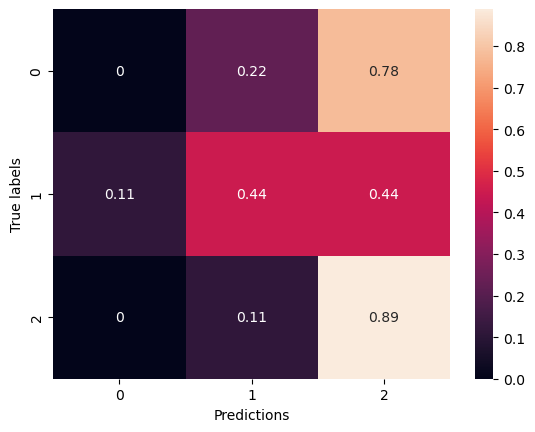

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▅▆▇▇▇▇▇▇▇▇▇█▇▇▇▇▆▇▆▇█▇███▇█▇▇▆▇▇▇█▇▇▇█▇
training_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▇▆▅▇▇▆▆▇▅▇▆▃█▄▃▅▆▅▆▅▇▄▄▇▆▆▆▃▅▇▇▆▅▇▇█▇
val_loss,█▆▄▂▁▂▁▁▁▁▁▂▁▁▂▁▂▂▁▁▁▁▁▁▂▂▁▂▁▂▃▂▁▂▁▂▂▂▁▁


Epoch 1/100


2024-03-12 20:34:37.931024: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:34:37.933019: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:34:37.934921: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:34:39.571538: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:34:39.573551: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:34:39.576170: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:34:44.829997: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:34:45.411931: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 34.7583 - accuracy: 0.4475

2024-03-12 20:34:49.495913: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:34:49.497729: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:34:49.499639: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 227ms/step - loss: 34.7583 - accuracy: 0.4475 - val_loss: 24.6302 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 2s 110ms/step - loss: 16.1067 - accuracy: 0.5616 - val_loss: 13.2017 - val_accuracy: 0.1944
Epoch 3/100
14/14 [==============================] - 2s 109ms/step - loss: 9.2647 - accuracy: 0.6438 - val_loss: 7.5750 - val_accuracy: 0.3704
Epoch 4/100
14/14 [==============================] - 2s 112ms/step - loss: 5.8282 - accuracy: 0.6872 - val_loss: 4.9786 - val_accuracy: 0.5741
Epoch 5/100
14/14 [==============================] - 2s 109ms/step - loss: 4.0194 - accuracy: 0.7169 - val_loss: 3.9631 - val_accuracy: 0.5926
Epoch 6/100
14/14 [==============================] - 2s 109ms/step - loss: 3.3407 - accuracy: 0.7032 - val_loss: 3.5840 - val_accuracy: 0.5278
Epoch 7/100
14/14 [==============================] - 2s 109ms/step - loss: 3.1213 - accuracy: 0.6826 - val_loss: 3.6715 - val_accuracy: 0.2963
Epoch 

14/14 [==============================] - 2s 110ms/step - loss: 2.5904 - accuracy: 0.6553 - val_loss: 3.0551 - val_accuracy: 0.5185
Epoch 59/100
14/14 [==============================] - 2s 112ms/step - loss: 2.6241 - accuracy: 0.6233 - val_loss: 3.4371 - val_accuracy: 0.2130
Epoch 60/100
14/14 [==============================] - 2s 110ms/step - loss: 2.3819 - accuracy: 0.6644 - val_loss: 3.5526 - val_accuracy: 0.3889
Epoch 61/100
14/14 [==============================] - 2s 112ms/step - loss: 2.2336 - accuracy: 0.6301 - val_loss: 2.9029 - val_accuracy: 0.4352
Epoch 62/100
14/14 [==============================] - 2s 109ms/step - loss: 2.7530 - accuracy: 0.6027 - val_loss: 3.3464 - val_accuracy: 0.3611
Epoch 63/100
14/14 [==============================] - 2s 111ms/step - loss: 2.7579 - accuracy: 0.6438 - val_loss: 2.9403 - val_accuracy: 0.4167
Epoch 64/100
14/14 [==============================] - 2s 110ms/step - loss: 2.2531 - accuracy: 0.6598 - val_loss: 2.8079 - val_accuracy: 0.3333
Epoch

2024-03-12 20:37:23.867313: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:37:23.869002: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:37:23.871378: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5081169605255127 s
{'0': {'precision': 0.25, 'recall': 0.1111111111111111, 'f1-score': 0.15384615384615383, 'support': 9}, '1': {'precision': 0.25, 'recall': 0.1111111111111111, 'f1-score': 0.15384615384615383, 'support': 9}, '2': {'precision': 0.3157894736842105, 'recall': 0.6666666666666666, 'f1-score': 0.42857142857142855, 'support': 9}, 'accuracy': 0.2962962962962963, 'macro avg': {'precision': 0.2719298245614035, 'recall': 0.2962962962962963, 'f1-score': 0.2454212454212454, 'support': 27}, 'weighted avg': {'precision': 0.2719298245614035, 'recall': 0.2962962962962963, 'f1-score': 0.2454212454212454, 'support': 27}}


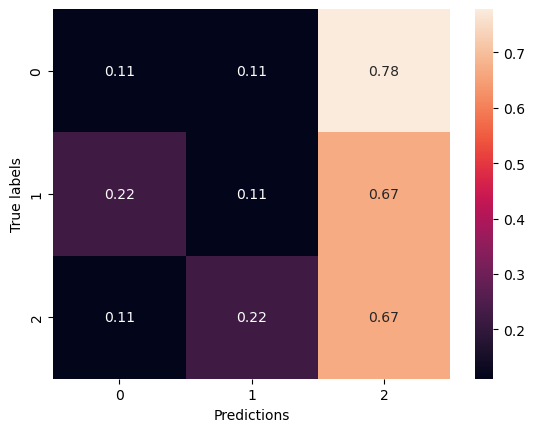

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▆▇▇▆▇▇▇▆▆█▇▆█▆▇▇▇▆▆▇▇▅▅▅▆▇▇▇▆▆▆█▇▆▇▇▆█▇
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▅▇▇▃▇▇▅▆▆█▅▇▇▃▅▃▇▆▅▅▄▃▂▆▄▄▅▅▃▆▇█▇▃▇▆▃▄▆
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 20:37:49.601735: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:37:49.603526: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:37:49.605440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:37:51.354412: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:37:51.356939: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:37:51.358623: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:37:55.628529: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:37:56.217758: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 45.7987 - accuracy: 0.4384

2024-03-12 20:38:00.628648: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:38:00.630294: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:38:00.632695: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 256ms/step - loss: 45.7987 - accuracy: 0.4384 - val_loss: 27.3384 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 2s 109ms/step - loss: 18.6107 - accuracy: 0.6027 - val_loss: 13.8998 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 2s 111ms/step - loss: 9.7065 - accuracy: 0.6370 - val_loss: 7.5185 - val_accuracy: 0.3611
Epoch 4/100
14/14 [==============================] - 2s 108ms/step - loss: 6.1010 - accuracy: 0.6096 - val_loss: 5.3422 - val_accuracy: 0.5370
Epoch 5/100
14/14 [==============================] - 2s 109ms/step - loss: 4.6195 - accuracy: 0.6393 - val_loss: 4.6518 - val_accuracy: 0.3056
Epoch 6/100
14/14 [==============================] - 2s 110ms/step - loss: 3.6830 - accuracy: 0.6804 - val_loss: 3.7187 - val_accuracy: 0.2963
Epoch 7/100
14/14 [==============================] - 2s 108ms/step - loss: 3.0421 - accuracy: 0.6758 - val_loss: 4.0942 - val_accuracy: 0.3796
Epoch 

14/14 [==============================] - 2s 108ms/step - loss: 2.7872 - accuracy: 0.6461 - val_loss: 3.8453 - val_accuracy: 0.3241
Epoch 59/100
14/14 [==============================] - 2s 108ms/step - loss: 3.1400 - accuracy: 0.6416 - val_loss: 3.3916 - val_accuracy: 0.3148
Epoch 60/100
14/14 [==============================] - 2s 108ms/step - loss: 2.6260 - accuracy: 0.6553 - val_loss: 3.1957 - val_accuracy: 0.3796
Epoch 61/100
14/14 [==============================] - 2s 109ms/step - loss: 2.5906 - accuracy: 0.6712 - val_loss: 3.0007 - val_accuracy: 0.4722
Epoch 62/100
14/14 [==============================] - 2s 109ms/step - loss: 2.3072 - accuracy: 0.7237 - val_loss: 2.7438 - val_accuracy: 0.4722
Epoch 63/100
14/14 [==============================] - 2s 108ms/step - loss: 2.4929 - accuracy: 0.6986 - val_loss: 3.3304 - val_accuracy: 0.3148
Epoch 64/100
14/14 [==============================] - 2s 108ms/step - loss: 2.1813 - accuracy: 0.7374 - val_loss: 3.0453 - val_accuracy: 0.4167
Epoch

2024-03-12 20:40:33.368545: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:40:33.371988: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:40:33.374510: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5986390113830566 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.48484848484848486, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '2': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.3333333333333333, 'recall': 0.3703703703703704, 'f1-score': 0.2727272727272727, 'support': 27}, 'weighted avg': {'precision': 0.3333333333333333, 'recall': 0.37037037037037035, 'f1-score': 0.2727272727272727, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


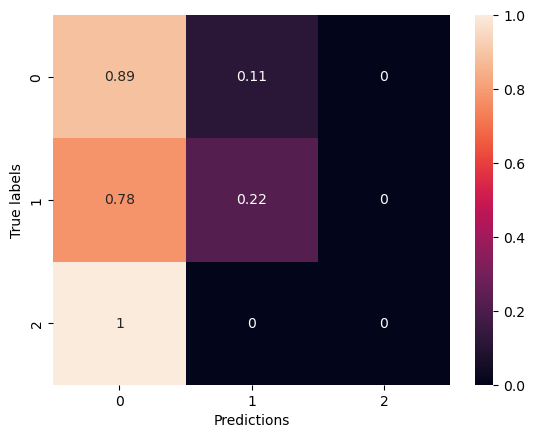

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▆▇▅▆▇█▇██▆▅▆▇▇▆█▆▆▇▇▅▆▆▆█▇▇▆▇▆█▇▇█▆▇▅▅▅
training_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▅▄▆▇▆▄▇▃▅▆▇▂▆▆▇▃▄▇▆▄▇▃▄▆▆▆▆▂█▄▄▂▅▁▆▂▄▁▁
val_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁


Epoch 1/100


2024-03-12 20:41:02.003353: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:41:02.004925: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:41:02.006851: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:41:03.628881: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:41:03.630973: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:41:03.633116: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:41:07.781662: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:41:08.365060: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 10.8713 - accuracy: 0.4338

2024-03-12 20:41:12.368435: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:41:12.370029: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:41:12.371946: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 226ms/step - loss: 10.8713 - accuracy: 0.4338 - val_loss: 11.7239 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 106ms/step - loss: 9.7321 - accuracy: 0.5183 - val_loss: 11.5451 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 2s 108ms/step - loss: 8.4496 - accuracy: 0.5799 - val_loss: 9.6435 - val_accuracy: 0.1019
Epoch 4/100
14/14 [==============================] - 2s 109ms/step - loss: 7.1446 - accuracy: 0.6073 - val_loss: 9.1670 - val_accuracy: 0.1111
Epoch 5/100
14/14 [==============================] - 1s 107ms/step - loss: 5.8909 - accuracy: 0.6553 - val_loss: 6.3938 - val_accuracy: 0.2870
Epoch 6/100
14/14 [==============================] - 1s 107ms/step - loss: 4.9147 - accuracy: 0.7169 - val_loss: 5.2548 - val_accuracy: 0.5278
Epoch 7/100
14/14 [==============================] - 1s 107ms/step - loss: 4.2480 - accuracy: 0.7100 - val_loss: 4.8788 - val_accuracy: 0.4537
Epoch 8

14/14 [==============================] - 1s 106ms/step - loss: 2.6371 - accuracy: 0.7169 - val_loss: 4.0059 - val_accuracy: 0.2685
Epoch 59/100
14/14 [==============================] - 1s 108ms/step - loss: 2.6914 - accuracy: 0.7854 - val_loss: 3.5530 - val_accuracy: 0.3426
Epoch 60/100
14/14 [==============================] - 1s 107ms/step - loss: 2.6364 - accuracy: 0.7580 - val_loss: 3.2314 - val_accuracy: 0.5000
Epoch 61/100
14/14 [==============================] - 1s 107ms/step - loss: 2.3450 - accuracy: 0.8219 - val_loss: 3.3214 - val_accuracy: 0.4259
Epoch 62/100
14/14 [==============================] - 1s 107ms/step - loss: 2.4502 - accuracy: 0.7877 - val_loss: 4.2555 - val_accuracy: 0.3333
Epoch 63/100
14/14 [==============================] - 2s 111ms/step - loss: 2.5026 - accuracy: 0.7580 - val_loss: 3.4558 - val_accuracy: 0.3519
Epoch 64/100
14/14 [==============================] - 1s 107ms/step - loss: 2.4041 - accuracy: 0.7922 - val_loss: 3.1778 - val_accuracy: 0.4167
Epoch

2024-03-12 20:43:42.788503: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:43:42.790149: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:43:42.791993: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4868338108062744 s
{'0': {'precision': 0.375, 'recall': 0.6666666666666666, 'f1-score': 0.4800000000000001, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.27651515151515155, 'recall': 0.40740740740740744, 'f1-score': 0.3266666666666667, 'support': 27}, 'weighted avg': {'precision': 0.2765151515151515, 'recall': 0.4074074074074074, 'f1-score': 0.32666666666666666, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


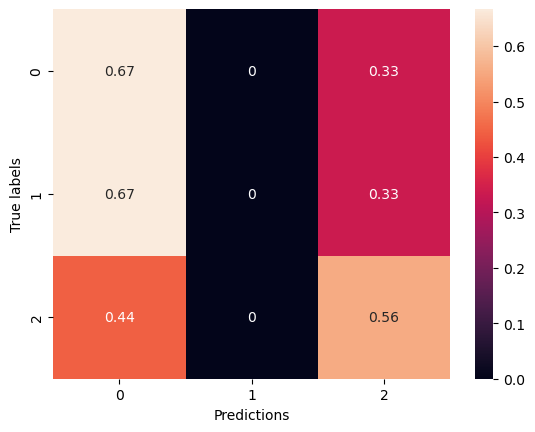

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▆▇▇▇█▇█▇▇▇▆▇▇█▆▆▇▇▇▇█▇▇▆▇▇▇▇▇▇▇▇▇▆▆▆
training_loss,█▆▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▂▁▁▁▂▁▂▁▂▂▂▁▁▂▁▂▂
training_time,▁
val_accuracy,▁▁▆▆█▄▇▄▅▇▇▇▆▆▄▃▆▃▃▆▂▂▆▄▅▅▅▆▅▆▅▅▄▅▄▅▄▄▆▅
val_loss,█▆▃▃▁▂▁▁▁▁▁▁▁▁▂▂▁▂▂▁▃▂▁▁▁▁▁▂▁▁▁▁▂▁▁▂▂▁▁▂


Epoch 1/100


2024-03-12 20:50:29.183023: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:50:29.184636: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:50:29.186638: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:50:30.839170: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:50:30.841036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:50:30.843054: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:50:35.967213: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:50:36.556043: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 35.1448 - accuracy: 0.4247

2024-03-12 20:50:40.554169: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:50:40.555774: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:50:40.557575: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 225ms/step - loss: 35.1448 - accuracy: 0.4247 - val_loss: 25.0290 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 108ms/step - loss: 18.5671 - accuracy: 0.5274 - val_loss: 16.4477 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 1s 107ms/step - loss: 11.6796 - accuracy: 0.5776 - val_loss: 11.8471 - val_accuracy: 0.1019
Epoch 4/100
14/14 [==============================] - 1s 107ms/step - loss: 7.8015 - accuracy: 0.6073 - val_loss: 7.4630 - val_accuracy: 0.1389
Epoch 5/100
14/14 [==============================] - 2s 112ms/step - loss: 5.4176 - accuracy: 0.6667 - val_loss: 5.6489 - val_accuracy: 0.2593
Epoch 6/100
14/14 [==============================] - 1s 107ms/step - loss: 4.0435 - accuracy: 0.7215 - val_loss: 4.3128 - val_accuracy: 0.5463
Epoch 7/100
14/14 [==============================] - 1s 107ms/step - loss: 3.4318 - accuracy: 0.6986 - val_loss: 3.8569 - val_accuracy: 0.3241
Epoc

Epoch 58/100
14/14 [==============================] - 1s 106ms/step - loss: 2.8521 - accuracy: 0.6233 - val_loss: 3.4079 - val_accuracy: 0.3241
Epoch 59/100
14/14 [==============================] - 1s 107ms/step - loss: 2.9179 - accuracy: 0.6210 - val_loss: 3.2327 - val_accuracy: 0.3611
Epoch 60/100
14/14 [==============================] - 2s 112ms/step - loss: 2.6620 - accuracy: 0.6484 - val_loss: 4.7004 - val_accuracy: 0.1759
Epoch 61/100
14/14 [==============================] - 1s 106ms/step - loss: 2.8027 - accuracy: 0.6279 - val_loss: 3.4623 - val_accuracy: 0.3056
Epoch 62/100
14/14 [==============================] - 1s 107ms/step - loss: 2.7893 - accuracy: 0.6598 - val_loss: 3.5099 - val_accuracy: 0.4352
Epoch 63/100
14/14 [==============================] - 1s 106ms/step - loss: 2.8115 - accuracy: 0.6712 - val_loss: 3.3636 - val_accuracy: 0.5556
Epoch 64/100
14/14 [==============================] - 1s 107ms/step - loss: 2.7713 - accuracy: 0.6735 - val_loss: 3.4105 - val_accuracy:

2024-03-12 20:53:11.290173: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:53:11.291858: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:53:11.293782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4879469871520996 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.2631578947368421, 'recall': 0.5555555555555556, 'f1-score': 0.35714285714285715, 'support': 9}, '2': {'precision': 0.2, 'recall': 0.1111111111111111, 'f1-score': 0.14285714285714285, 'support': 9}, 'accuracy': 0.25925925925925924, 'macro avg': {'precision': 0.26549707602339184, 'recall': 0.2592592592592593, 'f1-score': 0.22222222222222224, 'support': 27}, 'weighted avg': {'precision': 0.2654970760233918, 'recall': 0.25925925925925924, 'f1-score': 0.2222222222222222, 'support': 27}}


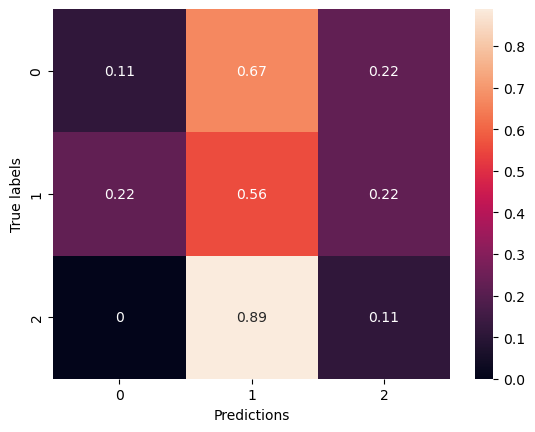

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▅█▇▇▇█▇▇▇▇▇▆▇▆▆▇▇▆▇▆▇▅▆▆▇▆▆▅▇▆▆▆▅▆▅▆▆▇▆
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁█▂▃▅▅█▄▁▇█▅▃▆▅▆▄█▄▄▅▁▅▄▄▂██▅▅▂▁▁▃▃▆▄▅▅
val_loss,█▄▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁


Epoch 1/100


2024-03-12 20:53:33.995265: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:53:33.997121: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:53:33.999129: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:53:35.611981: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:53:35.614378: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:53:35.616295: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:53:39.779050: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:53:40.358717: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 44.3522 - accuracy: 0.4817

2024-03-12 20:53:44.399432: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:53:44.401684: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:53:44.403228: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 225ms/step - loss: 44.3522 - accuracy: 0.4817 - val_loss: 26.9585 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 2s 114ms/step - loss: 19.0774 - accuracy: 0.5046 - val_loss: 13.9268 - val_accuracy: 0.2870
Epoch 3/100
14/14 [==============================] - 2s 123ms/step - loss: 11.3060 - accuracy: 0.5822 - val_loss: 9.7562 - val_accuracy: 0.1759
Epoch 4/100
14/14 [==============================] - 2s 107ms/step - loss: 7.2344 - accuracy: 0.6164 - val_loss: 6.2188 - val_accuracy: 0.3241
Epoch 5/100
14/14 [==============================] - 2s 111ms/step - loss: 4.9389 - accuracy: 0.6689 - val_loss: 4.6400 - val_accuracy: 0.3241
Epoch 6/100
14/14 [==============================] - 2s 109ms/step - loss: 4.1855 - accuracy: 0.6279 - val_loss: 4.5575 - val_accuracy: 0.3056
Epoch 7/100
14/14 [==============================] - 2s 109ms/step - loss: 3.8333 - accuracy: 0.6598 - val_loss: 3.9776 - val_accuracy: 0.4722
Epoch

Epoch 58/100
14/14 [==============================] - 1s 107ms/step - loss: 2.4976 - accuracy: 0.6575 - val_loss: 6.0297 - val_accuracy: 0.1481
Epoch 59/100
14/14 [==============================] - 2s 113ms/step - loss: 3.2485 - accuracy: 0.5571 - val_loss: 3.6176 - val_accuracy: 0.4167
Epoch 60/100
14/14 [==============================] - 1s 107ms/step - loss: 2.6943 - accuracy: 0.6301 - val_loss: 4.5322 - val_accuracy: 0.1389
Epoch 61/100
14/14 [==============================] - 1s 107ms/step - loss: 2.2194 - accuracy: 0.6370 - val_loss: 2.8974 - val_accuracy: 0.4167
Epoch 62/100
14/14 [==============================] - 1s 107ms/step - loss: 3.1902 - accuracy: 0.6301 - val_loss: 4.4097 - val_accuracy: 0.3426
Epoch 63/100
14/14 [==============================] - 2s 130ms/step - loss: 3.1837 - accuracy: 0.6370 - val_loss: 3.3817 - val_accuracy: 0.4815
Epoch 64/100
14/14 [==============================] - 1s 107ms/step - loss: 2.6085 - accuracy: 0.6484 - val_loss: 3.0504 - val_accuracy:

2024-03-12 20:56:15.794841: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:56:15.796486: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:56:15.798328: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4857428073883057 s
{'0': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.5833333333333334, 'recall': 0.7777777777777778, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.35000000000000003, 'recall': 0.5185185185185185, 'f1-score': 0.4166666666666667, 'support': 27}, 'weighted avg': {'precision': 0.35, 'recall': 0.5185185185185185, 'f1-score': 0.4166666666666667, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


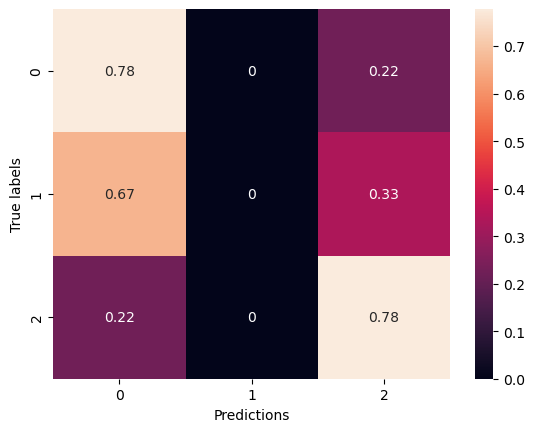

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▅▆▇▄▆▇█▆█▇▆▆▄▅▆▅▆▆▆█▅▅▄▇▇▅▆▅▅▅▆▇▅▇▅▇▆▇█
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▄█▂▇▆▅▆▇▃▃▂▁▃▅▇▄▂▄▃▃▁▆▆▇▄█▃▅▁▄▅▃▄▄▄▇▂▄
val_loss,█▃▂▁▁▁▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 20:56:38.251125: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:56:38.253071: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:56:38.254900: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:56:40.942456: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:56:40.945182: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:56:40.946996: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 20:56:45.516456: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 20:56:46.182124: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 11.0406 - accuracy: 0.4155

2024-03-12 20:56:50.768999: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:56:50.770710: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:56:50.772880: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 14s 227ms/step - loss: 11.0406 - accuracy: 0.4155 - val_loss: 10.7788 - val_accuracy: 0.1296
Epoch 2/100
14/14 [==============================] - 1s 107ms/step - loss: 10.4183 - accuracy: 0.4452 - val_loss: 11.4074 - val_accuracy: 0.1204
Epoch 3/100
14/14 [==============================] - 2s 110ms/step - loss: 9.4222 - accuracy: 0.4315 - val_loss: 10.4433 - val_accuracy: 0.1204
Epoch 4/100
14/14 [==============================] - 2s 109ms/step - loss: 8.4325 - accuracy: 0.4201 - val_loss: 10.0010 - val_accuracy: 0.1204
Epoch 5/100
14/14 [==============================] - 1s 108ms/step - loss: 7.3547 - accuracy: 0.4795 - val_loss: 8.0632 - val_accuracy: 0.1389
Epoch 6/100
14/14 [==============================] - 1s 107ms/step - loss: 6.4108 - accuracy: 0.5068 - val_loss: 8.1126 - val_accuracy: 0.1296
Epoch 7/100
14/14 [==============================] - 2s 108ms/step - loss: 5.5350 - accuracy: 0.6142 - val_loss: 6.2547 - val_accuracy: 0.2870
Epoc

Epoch 58/100
14/14 [==============================] - 2s 112ms/step - loss: 2.7558 - accuracy: 0.6849 - val_loss: 4.4379 - val_accuracy: 0.1852
Epoch 59/100
14/14 [==============================] - 1s 106ms/step - loss: 2.7325 - accuracy: 0.6963 - val_loss: 3.4070 - val_accuracy: 0.4167
Epoch 60/100
14/14 [==============================] - 1s 107ms/step - loss: 2.5837 - accuracy: 0.6918 - val_loss: 3.1291 - val_accuracy: 0.5370
Epoch 61/100
14/14 [==============================] - 2s 108ms/step - loss: 2.7554 - accuracy: 0.6553 - val_loss: 4.3357 - val_accuracy: 0.1944
Epoch 62/100
14/14 [==============================] - 1s 107ms/step - loss: 2.8515 - accuracy: 0.6621 - val_loss: 5.8294 - val_accuracy: 0.1111
Epoch 63/100
14/14 [==============================] - 1s 106ms/step - loss: 2.9095 - accuracy: 0.6667 - val_loss: 3.3300 - val_accuracy: 0.5556
Epoch 64/100
14/14 [==============================] - 1s 107ms/step - loss: 3.0776 - accuracy: 0.6210 - val_loss: 3.4585 - val_accuracy:

2024-03-12 20:59:21.392220: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 20:59:21.394305: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 20:59:21.395876: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4912140369415283 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 1.0, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}, 'weighted avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


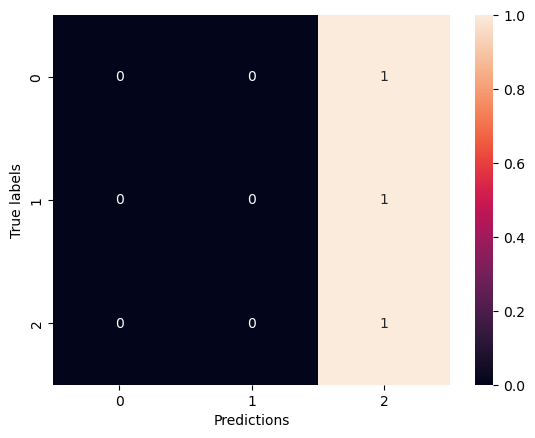

wandb: Network error (ConnectTimeout), entering retry loop.
wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▆▆▆▇█▇▆▇▆▇▇▇▆▆▅▇▆▆▇█▇▆▆▆▄▁▃▃▅▄▃▄▃▄▅▅▆
training_loss,█▇▄▃▂▂▂▁▁▁▁▁▁▁▂▁▁▂▁▂▁▂▁▁▁▂▂▂▄▃▂▂▂▂▂▂▂▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▇█▅▃▄▅▆▆▆▂▂▇▆▄▅▄▃▇█▅▂▇▇▆▆▃▄▅▆▅▁▂▃▄▆▇
val_loss,██▆▅▂▂▂▃▂▁▂▂▂▃▃▂▂▂▂▂▂▂▂▂▃▂▂▂▄▃▂▂▂▂▃▃▂▁▁▁


Epoch 1/100


2024-03-12 21:01:13.673529: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:01:13.675304: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:01:13.677214: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:01:15.342002: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:01:15.343593: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:01:15.346193: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:01:19.515970: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:01:20.095250: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 34.8906 - accuracy: 0.3927

2024-03-12 21:01:25.006242: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:01:25.008682: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:01:25.010967: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 297ms/step - loss: 34.8906 - accuracy: 0.3927 - val_loss: 23.9854 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 2s 116ms/step - loss: 19.2198 - accuracy: 0.4155 - val_loss: 16.1459 - val_accuracy: 0.1389
Epoch 3/100
14/14 [==============================] - 2s 112ms/step - loss: 13.1873 - accuracy: 0.4589 - val_loss: 11.1210 - val_accuracy: 0.2500
Epoch 4/100
14/14 [==============================] - 2s 108ms/step - loss: 9.6105 - accuracy: 0.4726 - val_loss: 9.1443 - val_accuracy: 0.1296
Epoch 5/100
14/14 [==============================] - 2s 108ms/step - loss: 7.1659 - accuracy: 0.5548 - val_loss: 7.3358 - val_accuracy: 0.2407
Epoch 6/100
14/14 [==============================] - 1s 107ms/step - loss: 5.6679 - accuracy: 0.6119 - val_loss: 5.4101 - val_accuracy: 0.4815
Epoch 7/100
14/14 [==============================] - 1s 107ms/step - loss: 4.8553 - accuracy: 0.5662 - val_loss: 4.9669 - val_accuracy: 0.5556
Epoc

Epoch 58/100
14/14 [==============================] - 2s 108ms/step - loss: 2.6884 - accuracy: 0.5890 - val_loss: 3.0371 - val_accuracy: 0.5463
Epoch 59/100
14/14 [==============================] - 1s 106ms/step - loss: 2.8323 - accuracy: 0.5639 - val_loss: 3.2515 - val_accuracy: 0.5463
Epoch 60/100
14/14 [==============================] - 1s 106ms/step - loss: 3.1812 - accuracy: 0.5571 - val_loss: 3.7917 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 1s 107ms/step - loss: 3.5534 - accuracy: 0.5662 - val_loss: 3.7809 - val_accuracy: 0.3426
Epoch 62/100
14/14 [==============================] - 2s 108ms/step - loss: 3.0907 - accuracy: 0.5776 - val_loss: 3.1391 - val_accuracy: 0.5278
Epoch 63/100
14/14 [==============================] - 1s 107ms/step - loss: 2.6374 - accuracy: 0.5822 - val_loss: 3.3745 - val_accuracy: 0.2685
Epoch 64/100
14/14 [==============================] - 1s 107ms/step - loss: 2.7781 - accuracy: 0.5479 - val_loss: 3.4242 - val_accuracy:

2024-03-12 21:03:57.449693: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:03:57.451276: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:03:57.453238: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4918022155761719 s
{'0': {'precision': 0.2222222222222222, 'recall': 0.2222222222222222, 'f1-score': 0.2222222222222222, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.35294117647058826, 'recall': 0.6666666666666666, 'f1-score': 0.46153846153846156, 'support': 9}, 'accuracy': 0.2962962962962963, 'macro avg': {'precision': 0.19172113289760348, 'recall': 0.2962962962962963, 'f1-score': 0.22792022792022792, 'support': 27}, 'weighted avg': {'precision': 0.1917211328976035, 'recall': 0.2962962962962963, 'f1-score': 0.22792022792022792, 'support': 27}}


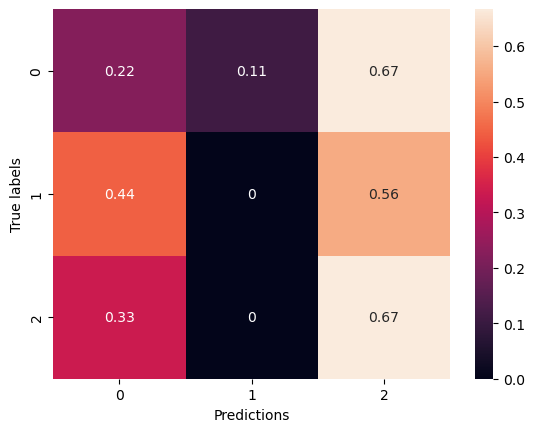

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃████▇██▇█▅▅▆▇▇▇▇▇▆▇▅▆▆▆▆▆█▇▅▇▇▅█▆▇▇▆▇▇
training_loss,█▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▃▆█▅▇▅▆▇▆▇▂▄▄▅▁▃▂▂▅▄▁▃▇▄▅▄▆▁▆▇▇▄▅▁▄▄▅▄▅
val_loss,█▄▂▂▂▂▁▁▁▁▁▂▁▂▁▂▁▂▂▂▁▂▂▁▁▁▁▁▂▂▁▁▁▁▂▁▁▁▁▁


Epoch 1/100


2024-03-12 21:04:21.331830: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:04:21.333462: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:04:21.335340: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:04:22.974043: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:04:22.976231: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:04:22.978243: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:04:27.150880: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:04:27.737730: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 45.0915 - accuracy: 0.3699

2024-03-12 21:04:31.750238: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:04:31.751805: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:04:31.753950: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 226ms/step - loss: 45.0915 - accuracy: 0.3699 - val_loss: 28.1176 - val_accuracy: 0.1204
Epoch 2/100
14/14 [==============================] - 1s 107ms/step - loss: 21.8335 - accuracy: 0.3881 - val_loss: 16.8695 - val_accuracy: 0.1852
Epoch 3/100
14/14 [==============================] - 2s 109ms/step - loss: 14.6544 - accuracy: 0.4269 - val_loss: 12.3751 - val_accuracy: 0.2037
Epoch 4/100
14/14 [==============================] - 2s 108ms/step - loss: 10.5481 - accuracy: 0.4566 - val_loss: 8.7172 - val_accuracy: 0.4537
Epoch 5/100
14/14 [==============================] - 1s 107ms/step - loss: 7.7239 - accuracy: 0.5000 - val_loss: 6.5750 - val_accuracy: 0.5648
Epoch 6/100
14/14 [==============================] - 1s 108ms/step - loss: 5.8015 - accuracy: 0.5616 - val_loss: 5.3068 - val_accuracy: 0.3796
Epoch 7/100
14/14 [==============================] - 1s 108ms/step - loss: 4.6961 - accuracy: 0.5502 - val_loss: 4.6166 - val_accuracy: 0.4630
Epo

Epoch 58/100
14/14 [==============================] - 2s 112ms/step - loss: 4.3826 - accuracy: 0.5274 - val_loss: 5.0507 - val_accuracy: 0.3148
Epoch 59/100
14/14 [==============================] - 1s 107ms/step - loss: 4.0669 - accuracy: 0.5594 - val_loss: 3.9960 - val_accuracy: 0.3333
Epoch 60/100
14/14 [==============================] - 1s 107ms/step - loss: 3.5927 - accuracy: 0.5228 - val_loss: 3.6995 - val_accuracy: 0.3333
Epoch 61/100
14/14 [==============================] - 1s 107ms/step - loss: 3.4496 - accuracy: 0.5525 - val_loss: 3.5686 - val_accuracy: 0.3426
Epoch 62/100
14/14 [==============================] - 1s 108ms/step - loss: 3.1894 - accuracy: 0.5708 - val_loss: 4.6499 - val_accuracy: 0.1852
Epoch 63/100
14/14 [==============================] - 1s 107ms/step - loss: 3.2953 - accuracy: 0.5365 - val_loss: 3.6205 - val_accuracy: 0.3241
Epoch 64/100
14/14 [==============================] - 2s 110ms/step - loss: 3.4596 - accuracy: 0.5434 - val_loss: 4.0195 - val_accuracy:

2024-03-12 21:07:03.545853: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:07:03.547466: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:07:03.549480: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4963347911834717 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 1.0, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}, 'weighted avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


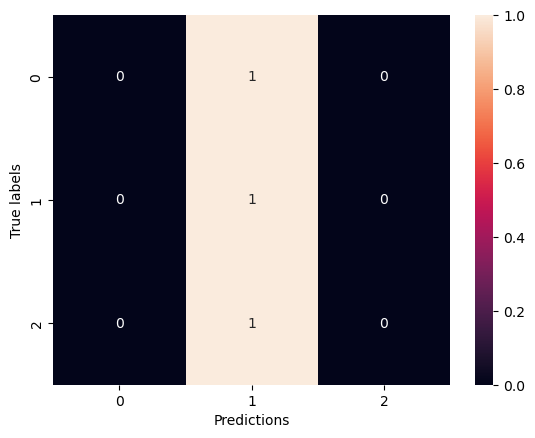

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▆▅▇██▅▆▇▅▅▆▇▆▆▇▅▅▅▄▄▄▆▆▆▆▅▇▇▆▅▆▇▆▆█▆▅▄
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▅█▃▂▅▅█▁▃▃▄▇▅▁▆▇█▄▄▁▃▄▅▃▇▇▁▇▁▁▅▄█▆▅▃▅▄
val_loss,█▄▂▁▁▂▁▁▁▂▁▁▁▁▁▂▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:07:28.020540: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:07:28.022129: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:07:28.024017: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:07:29.645151: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:07:29.647505: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:07:29.649428: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:07:34.869302: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:07:35.445837: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 7.1446 - accuracy: 0.4384

2024-03-12 21:07:38.530104: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:07:38.531679: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:07:38.533735: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 329ms/step - loss: 7.1446 - accuracy: 0.4384 - val_loss: 7.1683 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 75ms/step - loss: 6.2897 - accuracy: 0.5708 - val_loss: 6.6711 - val_accuracy: 0.1389
Epoch 3/100
7/7 [==============================] - 1s 75ms/step - loss: 5.3980 - accuracy: 0.6781 - val_loss: 5.8973 - val_accuracy: 0.1481
Epoch 4/100
7/7 [==============================] - 1s 75ms/step - loss: 4.9141 - accuracy: 0.6667 - val_loss: 5.8194 - val_accuracy: 0.1296
Epoch 5/100
7/7 [==============================] - 1s 77ms/step - loss: 4.2453 - accuracy: 0.7237 - val_loss: 4.8274 - val_accuracy: 0.2315
Epoch 6/100
7/7 [==============================] - 1s 78ms/step - loss: 3.7650 - accuracy: 0.7580 - val_loss: 4.9319 - val_accuracy: 0.1852
Epoch 7/100
7/7 [==============================] - 1s 76ms/step - loss: 3.2719 - accuracy: 0.8174 - val_loss: 4.5375 - val_accuracy: 0.1759
Epoch 8/100
7/7 [=============

7/7 [==============================] - 1s 76ms/step - loss: 0.8992 - accuracy: 0.9429 - val_loss: 3.4148 - val_accuracy: 0.4815
Epoch 60/100
7/7 [==============================] - 1s 75ms/step - loss: 0.9294 - accuracy: 0.9338 - val_loss: 2.8498 - val_accuracy: 0.5185
Epoch 61/100
7/7 [==============================] - 1s 75ms/step - loss: 0.8842 - accuracy: 0.9543 - val_loss: 2.8439 - val_accuracy: 0.5741
Epoch 62/100
7/7 [==============================] - 1s 76ms/step - loss: 0.9208 - accuracy: 0.9475 - val_loss: 2.6724 - val_accuracy: 0.5648
Epoch 63/100
7/7 [==============================] - 1s 76ms/step - loss: 0.9063 - accuracy: 0.9384 - val_loss: 2.9826 - val_accuracy: 0.4074
Epoch 64/100
7/7 [==============================] - 1s 76ms/step - loss: 0.9172 - accuracy: 0.9269 - val_loss: 2.6859 - val_accuracy: 0.5741
Epoch 65/100
7/7 [==============================] - 1s 76ms/step - loss: 0.9339 - accuracy: 0.9269 - val_loss: 3.3652 - val_accuracy: 0.4722
Epoch 66/100
7/7 [========

2024-03-12 21:08:32.599108: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:08:32.600718: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:08:32.602698: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5224897861480713 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, '1': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.48888888888888893, 'recall': 0.48148148148148145, 'f1-score': 0.4611111111111111, 'support': 27}, 'weighted avg': {'precision': 0.4888888888888889, 'recall': 0.48148148148148145, 'f1-score': 0.4611111111111111, 'support': 27}}


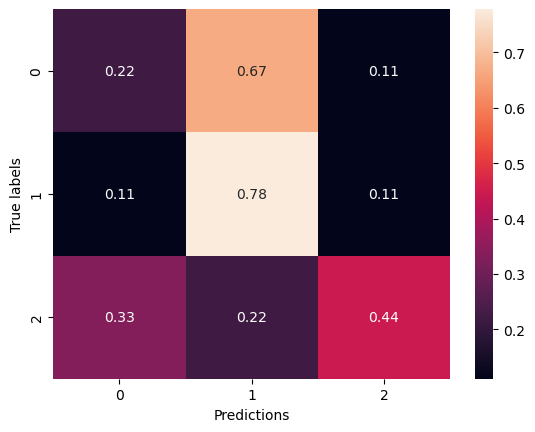

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▇▇▇▇▇█▇██▇██▇▇██▇▇███████▇████▇█▇████
training_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▃▂▄▇▇▅▅▇█▃▅█▃▄▆▄▄▄▆▅▇██▅▄█▆▄▇▇▄▄▅▇▇▄▄
val_loss,█▆▅▄▅▂▁▁▂▂▂▁▄▂▂▄▂▂▄▄▂▂▃▂▁▁▂▃▁▁▂▁▂▂▃▂▂▂▃▃


Epoch 1/100


2024-03-12 21:08:57.389767: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:08:57.391564: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:08:57.393477: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:08:59.006812: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:08:59.009249: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:08:59.010945: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:09:03.193098: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:09:03.775054: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 26.1294 - accuracy: 0.4201

2024-03-12 21:09:06.914589: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:09:06.916764: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:09:06.918452: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 343ms/step - loss: 26.1294 - accuracy: 0.4201 - val_loss: 20.6085 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 76ms/step - loss: 16.6089 - accuracy: 0.5890 - val_loss: 13.2975 - val_accuracy: 0.1667
Epoch 3/100
7/7 [==============================] - 1s 76ms/step - loss: 10.6213 - accuracy: 0.6553 - val_loss: 8.8337 - val_accuracy: 0.2222
Epoch 4/100
7/7 [==============================] - 1s 77ms/step - loss: 7.0468 - accuracy: 0.6986 - val_loss: 6.6878 - val_accuracy: 0.2037
Epoch 5/100
7/7 [==============================] - 1s 75ms/step - loss: 4.9906 - accuracy: 0.7329 - val_loss: 4.7438 - val_accuracy: 0.3889
Epoch 6/100
7/7 [==============================] - 1s 76ms/step - loss: 3.7803 - accuracy: 0.7580 - val_loss: 5.0414 - val_accuracy: 0.1481
Epoch 7/100
7/7 [==============================] - 1s 77ms/step - loss: 3.0314 - accuracy: 0.7763 - val_loss: 3.4773 - val_accuracy: 0.3426
Epoch 8/100
7/7 [========

7/7 [==============================] - 1s 77ms/step - loss: 1.4526 - accuracy: 0.8539 - val_loss: 2.8650 - val_accuracy: 0.3796
Epoch 60/100
7/7 [==============================] - 1s 76ms/step - loss: 1.4480 - accuracy: 0.8356 - val_loss: 3.0308 - val_accuracy: 0.3426
Epoch 61/100
7/7 [==============================] - 1s 76ms/step - loss: 1.3559 - accuracy: 0.8813 - val_loss: 2.7834 - val_accuracy: 0.3704
Epoch 62/100
7/7 [==============================] - 1s 76ms/step - loss: 1.1624 - accuracy: 0.9041 - val_loss: 2.9633 - val_accuracy: 0.4444
Epoch 63/100
7/7 [==============================] - 1s 76ms/step - loss: 0.9540 - accuracy: 0.9498 - val_loss: 2.6441 - val_accuracy: 0.5463
Epoch 64/100
7/7 [==============================] - 1s 76ms/step - loss: 0.9513 - accuracy: 0.9292 - val_loss: 3.0854 - val_accuracy: 0.4630
Epoch 65/100
7/7 [==============================] - 1s 77ms/step - loss: 1.0375 - accuracy: 0.8973 - val_loss: 3.7693 - val_accuracy: 0.3611
Epoch 66/100
7/7 [========

2024-03-12 21:10:01.484771: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:10:01.486283: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:10:01.488600: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4828970432281494 s
{'0': {'precision': 0.2, 'recall': 0.3333333333333333, 'f1-score': 0.25, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '2': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.362962962962963, 'recall': 0.3333333333333333, 'f1-score': 0.32407407407407407, 'support': 27}, 'weighted avg': {'precision': 0.362962962962963, 'recall': 0.3333333333333333, 'f1-score': 0.32407407407407407, 'support': 27}}


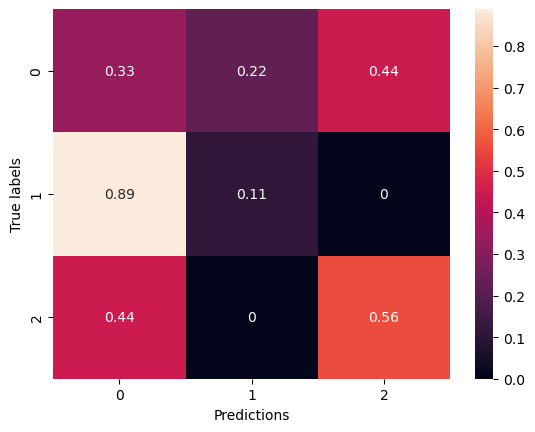

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇█▇▇▇▇█▇▇▇▇█▇▇▇▇
training_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▁▅▆▇█▇▆▅▅▄▇▅▇▆▆▃▄▂█▅▆▅▄▆▆▇▄▄▃▅▅▂▄▇▇▇▃▃
val_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▂▁▂▁▁▂▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:10:26.033809: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:10:26.035381: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:10:26.037593: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:10:27.644116: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:10:27.646400: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:10:27.648324: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:10:31.781127: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:10:32.358809: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 34.3445 - accuracy: 0.4658

2024-03-12 21:10:35.464094: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:10:35.466024: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:10:35.467977: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 331ms/step - loss: 34.3445 - accuracy: 0.4658 - val_loss: 25.1605 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 77ms/step - loss: 19.3683 - accuracy: 0.6096 - val_loss: 14.9083 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 77ms/step - loss: 11.0619 - accuracy: 0.6370 - val_loss: 9.7404 - val_accuracy: 0.1111
Epoch 4/100
7/7 [==============================] - 1s 75ms/step - loss: 6.6132 - accuracy: 0.6986 - val_loss: 5.9881 - val_accuracy: 0.2963
Epoch 5/100
7/7 [==============================] - 1s 76ms/step - loss: 4.5934 - accuracy: 0.7374 - val_loss: 5.5097 - val_accuracy: 0.1852
Epoch 6/100
7/7 [==============================] - 1s 76ms/step - loss: 3.5983 - accuracy: 0.7374 - val_loss: 3.6138 - val_accuracy: 0.5741
Epoch 7/100
7/7 [==============================] - 1s 87ms/step - loss: 2.8921 - accuracy: 0.7877 - val_loss: 3.4235 - val_accuracy: 0.3333
Epoch 8/100
7/7 [========

7/7 [==============================] - 1s 77ms/step - loss: 1.5930 - accuracy: 0.8539 - val_loss: 2.8983 - val_accuracy: 0.4537
Epoch 60/100
7/7 [==============================] - 1s 76ms/step - loss: 1.5797 - accuracy: 0.8265 - val_loss: 3.3052 - val_accuracy: 0.3981
Epoch 61/100
7/7 [==============================] - 1s 76ms/step - loss: 1.7214 - accuracy: 0.8128 - val_loss: 3.2070 - val_accuracy: 0.3704
Epoch 62/100
7/7 [==============================] - 1s 76ms/step - loss: 1.6911 - accuracy: 0.8333 - val_loss: 2.4874 - val_accuracy: 0.5926
Epoch 63/100
7/7 [==============================] - 1s 76ms/step - loss: 1.5589 - accuracy: 0.8379 - val_loss: 2.8274 - val_accuracy: 0.4444
Epoch 64/100
7/7 [==============================] - 1s 76ms/step - loss: 1.3951 - accuracy: 0.8858 - val_loss: 3.4517 - val_accuracy: 0.3704
Epoch 65/100
7/7 [==============================] - 1s 75ms/step - loss: 1.2245 - accuracy: 0.9018 - val_loss: 3.2702 - val_accuracy: 0.3889
Epoch 66/100
7/7 [========

2024-03-12 21:11:29.416691: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:11:29.418324: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:11:29.420533: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.482001781463623 s
{'0': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.4444444444444444, 'f1-score': 0.380952380952381, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.4259259259259259, 'recall': 0.4074074074074074, 'f1-score': 0.4084656084656085, 'support': 27}, 'weighted avg': {'precision': 0.42592592592592593, 'recall': 0.4074074074074074, 'f1-score': 0.4084656084656085, 'support': 27}}


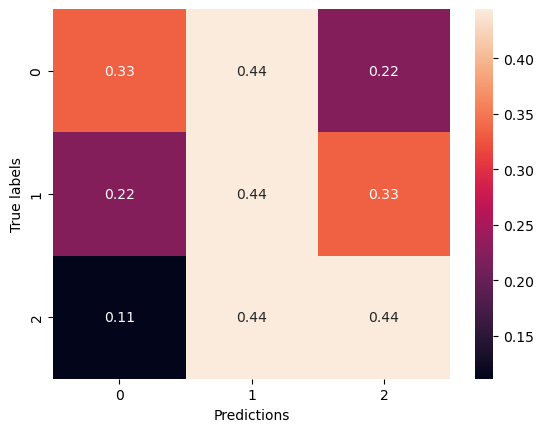

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▆▇▇▇▇▇▇▆█▇▇▇▇▇▇▇▇▆▇▇█▆▇▇▇▇▇█▇██▇██▇
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁██▇█▆▇▅▄▅█▄▆▄▅▅▇▆▅▇▆▅▆▅▅▇▇▅▇▄▇▅▄▆▆▅▆▆▄
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:11:55.067200: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:11:55.069467: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:11:55.071186: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:11:56.687823: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:11:56.690165: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:11:56.691851: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:12:01.956904: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:12:02.542028: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 7.3050 - accuracy: 0.4132

2024-03-12 21:12:05.657109: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:12:05.659322: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:12:05.660943: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 331ms/step - loss: 7.3050 - accuracy: 0.4132 - val_loss: 6.7251 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 76ms/step - loss: 6.5562 - accuracy: 0.4498 - val_loss: 6.0659 - val_accuracy: 0.2037
Epoch 3/100
7/7 [==============================] - 1s 77ms/step - loss: 5.8557 - accuracy: 0.5320 - val_loss: 6.4729 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 76ms/step - loss: 5.3064 - accuracy: 0.5411 - val_loss: 6.5072 - val_accuracy: 0.1296
Epoch 5/100
7/7 [==============================] - 1s 76ms/step - loss: 4.8618 - accuracy: 0.5571 - val_loss: 6.2215 - val_accuracy: 0.1296
Epoch 6/100
7/7 [==============================] - 1s 77ms/step - loss: 4.3697 - accuracy: 0.5799 - val_loss: 6.2120 - val_accuracy: 0.1204
Epoch 7/100
7/7 [==============================] - 1s 77ms/step - loss: 3.9057 - accuracy: 0.6164 - val_loss: 4.6686 - val_accuracy: 0.2222
Epoch 8/100
7/7 [=============

7/7 [==============================] - 1s 77ms/step - loss: 1.0010 - accuracy: 0.9315 - val_loss: 3.4726 - val_accuracy: 0.3519
Epoch 60/100
7/7 [==============================] - 1s 78ms/step - loss: 1.0238 - accuracy: 0.9178 - val_loss: 3.2591 - val_accuracy: 0.4352
Epoch 61/100
7/7 [==============================] - 1s 79ms/step - loss: 0.9298 - accuracy: 0.9452 - val_loss: 3.9491 - val_accuracy: 0.3333
Epoch 62/100
7/7 [==============================] - 1s 79ms/step - loss: 0.9855 - accuracy: 0.9110 - val_loss: 3.2131 - val_accuracy: 0.4907
Epoch 63/100
7/7 [==============================] - 1s 77ms/step - loss: 1.0193 - accuracy: 0.9064 - val_loss: 3.0495 - val_accuracy: 0.5093
Epoch 64/100
7/7 [==============================] - 1s 77ms/step - loss: 1.0573 - accuracy: 0.8995 - val_loss: 2.8612 - val_accuracy: 0.5185
Epoch 65/100
7/7 [==============================] - 1s 78ms/step - loss: 1.0664 - accuracy: 0.8995 - val_loss: 2.8924 - val_accuracy: 0.5000
Epoch 66/100
7/7 [========

2024-03-12 21:12:59.946058: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:12:59.947686: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:12:59.949629: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4783780574798584 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.5555555555555556, 'f1-score': 0.4166666666666667, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.4444444444444444, 'recall': 0.4444444444444445, 'f1-score': 0.4166666666666667, 'support': 27}, 'weighted avg': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4166666666666667, 'support': 27}}


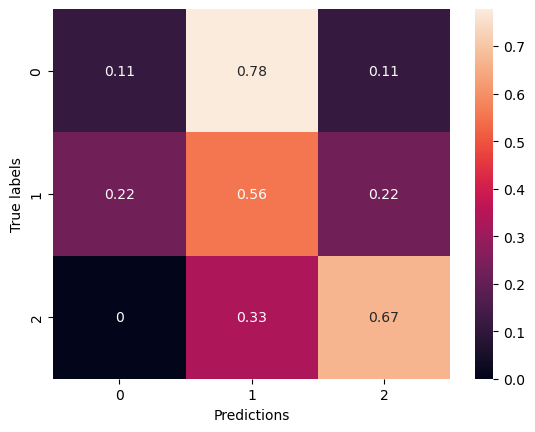

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▃▄▆▆▆▆▇▇▇▇▇▇▇▇█▇▇▇█████▇██▇▇█▇▇▇██▇███
training_loss,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▅▆▇▇▆█▇▇█▇▇▆▆▄█▇▆▄▆▄▄▇▄▅▇▇█▄▄▄▅▃▆▇▇▃
val_loss,██▇▆▂▂▂▁▂▁▂▂▁▁▂▁▂▃▁▁▂▄▂▃▄▂▃▃▂▁▂▃▃▂▂▄▂▁▁▃


Epoch 1/100


2024-03-12 21:13:24.792885: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:13:24.794645: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:13:24.796842: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:13:26.413112: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:13:26.414822: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:13:26.417036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:13:30.569969: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:13:31.167434: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 26.3148 - accuracy: 0.3836

2024-03-12 21:13:34.285715: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:13:34.287895: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:13:34.289499: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 335ms/step - loss: 26.3148 - accuracy: 0.3836 - val_loss: 20.4313 - val_accuracy: 0.1944
Epoch 2/100
7/7 [==============================] - 1s 76ms/step - loss: 17.5642 - accuracy: 0.4452 - val_loss: 14.3537 - val_accuracy: 0.1481
Epoch 3/100
7/7 [==============================] - 1s 76ms/step - loss: 11.8877 - accuracy: 0.5411 - val_loss: 10.7022 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 78ms/step - loss: 8.2908 - accuracy: 0.5731 - val_loss: 7.6466 - val_accuracy: 0.1667
Epoch 5/100
7/7 [==============================] - 1s 78ms/step - loss: 6.1621 - accuracy: 0.6005 - val_loss: 6.0690 - val_accuracy: 0.1481
Epoch 6/100
7/7 [==============================] - 1s 77ms/step - loss: 4.6966 - accuracy: 0.6621 - val_loss: 4.6575 - val_accuracy: 0.3333
Epoch 7/100
7/7 [==============================] - 1s 76ms/step - loss: 3.7627 - accuracy: 0.6941 - val_loss: 4.0971 - val_accuracy: 0.3241
Epoch 8/100
7/7 [=======

7/7 [==============================] - 1s 76ms/step - loss: 1.5902 - accuracy: 0.7763 - val_loss: 2.5857 - val_accuracy: 0.4259
Epoch 60/100
7/7 [==============================] - 1s 77ms/step - loss: 1.6259 - accuracy: 0.7785 - val_loss: 2.5112 - val_accuracy: 0.5000
Epoch 61/100
7/7 [==============================] - 1s 76ms/step - loss: 1.6590 - accuracy: 0.7671 - val_loss: 2.8292 - val_accuracy: 0.3796
Epoch 62/100
7/7 [==============================] - 1s 78ms/step - loss: 1.5021 - accuracy: 0.8242 - val_loss: 2.9657 - val_accuracy: 0.4444
Epoch 63/100
7/7 [==============================] - 1s 78ms/step - loss: 1.3787 - accuracy: 0.8242 - val_loss: 2.8443 - val_accuracy: 0.4074
Epoch 64/100
7/7 [==============================] - 1s 77ms/step - loss: 1.2066 - accuracy: 0.9041 - val_loss: 3.2201 - val_accuracy: 0.3796
Epoch 65/100
7/7 [==============================] - 1s 75ms/step - loss: 1.2674 - accuracy: 0.8607 - val_loss: 3.2027 - val_accuracy: 0.3333
Epoch 66/100
7/7 [========

2024-03-12 21:14:28.666857: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:14:28.668483: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:14:28.670253: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4704861640930176 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.34615384615384615, 'recall': 1.0, 'f1-score': 0.5142857142857142, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.11538461538461538, 'recall': 0.3333333333333333, 'f1-score': 0.1714285714285714, 'support': 27}, 'weighted avg': {'precision': 0.11538461538461539, 'recall': 0.3333333333333333, 'f1-score': 0.1714285714285714, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


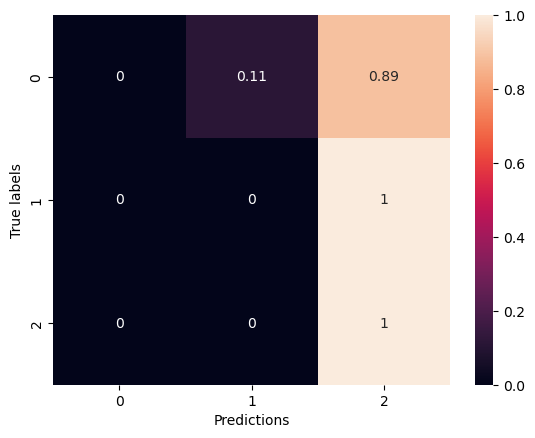

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▆▆▆▇▆▇▇▇▇▇▆▇▆▆▇▇▇▇▇▆▆█▆▆▆▇▇▆▇▇▇▇▇▇▇▇
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▄▅▇▃█▄██▇▅▄▆▇▇▆▅▆▃▇▅▇▅▅▅▄▁▄▆▅▄▇▄▅▆▇▆▆▇
val_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:14:54.744765: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:14:54.746989: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:14:54.748967: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:14:57.366788: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:14:57.368575: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:14:57.370599: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:15:01.493554: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:15:02.081314: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 34.7859 - accuracy: 0.4178

2024-03-12 21:15:05.190745: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:15:05.192403: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:15:05.194382: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 331ms/step - loss: 34.7859 - accuracy: 0.4178 - val_loss: 25.3893 - val_accuracy: 0.2407
Epoch 2/100
7/7 [==============================] - 1s 77ms/step - loss: 20.9086 - accuracy: 0.4977 - val_loss: 16.1436 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 77ms/step - loss: 13.0056 - accuracy: 0.5205 - val_loss: 11.0192 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 77ms/step - loss: 8.4655 - accuracy: 0.5662 - val_loss: 7.9418 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 77ms/step - loss: 6.0716 - accuracy: 0.6005 - val_loss: 5.5792 - val_accuracy: 0.2870
Epoch 6/100
7/7 [==============================] - 1s 77ms/step - loss: 4.6118 - accuracy: 0.6598 - val_loss: 5.4370 - val_accuracy: 0.1204
Epoch 7/100
7/7 [==============================] - 1s 77ms/step - loss: 3.7211 - accuracy: 0.6484 - val_loss: 4.8445 - val_accuracy: 0.1296
Epoch 8/100
7/7 [=======

7/7 [==============================] - 1s 77ms/step - loss: 1.8172 - accuracy: 0.7580 - val_loss: 2.8586 - val_accuracy: 0.4537
Epoch 60/100
7/7 [==============================] - 1s 77ms/step - loss: 1.7018 - accuracy: 0.7785 - val_loss: 2.4881 - val_accuracy: 0.5556
Epoch 61/100
7/7 [==============================] - 1s 77ms/step - loss: 1.4861 - accuracy: 0.8516 - val_loss: 2.4922 - val_accuracy: 0.5093
Epoch 62/100
7/7 [==============================] - 1s 77ms/step - loss: 1.4317 - accuracy: 0.8174 - val_loss: 3.6583 - val_accuracy: 0.2870
Epoch 63/100
7/7 [==============================] - 1s 78ms/step - loss: 1.4401 - accuracy: 0.8196 - val_loss: 5.2179 - val_accuracy: 0.1296
Epoch 64/100
7/7 [==============================] - 1s 77ms/step - loss: 1.6286 - accuracy: 0.7466 - val_loss: 2.9000 - val_accuracy: 0.3148
Epoch 65/100
7/7 [==============================] - 1s 77ms/step - loss: 1.7362 - accuracy: 0.7511 - val_loss: 3.5838 - val_accuracy: 0.2407
Epoch 66/100
7/7 [========

2024-03-12 21:16:00.170386: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:16:00.172082: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:16:00.174155: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.482029676437378 s
{'0': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, '2': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.4292929292929293, 'recall': 0.4444444444444445, 'f1-score': 0.43099415204678365, 'support': 27}, 'weighted avg': {'precision': 0.4292929292929293, 'recall': 0.4444444444444444, 'f1-score': 0.43099415204678365, 'support': 27}}


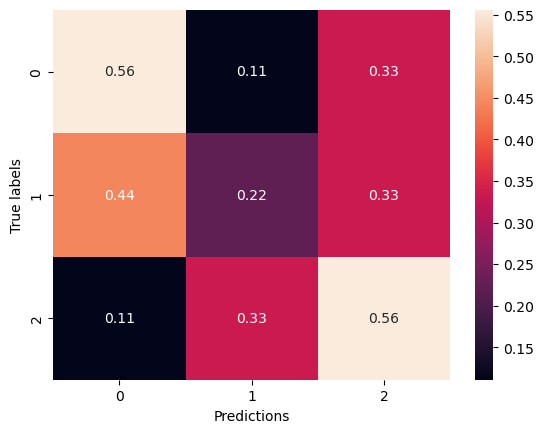

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▇▆▆▆▇▇▇▆▆▇▇▇▇▇▆▇█▇▇▆█▆▇█▇██▇█▇▇████▇
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▁█▄▄▆▇▇▇▇▆▄▃▅▇▆▅▆▅▆▆▆▆▄▆▅▆▆▃▅▅▆▃▆▆▅▆▅
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:16:25.271133: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:16:25.272971: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:16:25.274583: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:16:26.885539: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:16:26.887396: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:16:26.889730: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:16:31.112211: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:16:31.693074: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 7.4852 - accuracy: 0.3493

2024-03-12 21:16:34.783822: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:16:34.785412: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:16:34.787302: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 494ms/step - loss: 7.4852 - accuracy: 0.3493 - val_loss: 6.6684 - val_accuracy: 0.1574
Epoch 2/100
7/7 [==============================] - 1s 76ms/step - loss: 6.9402 - accuracy: 0.4110 - val_loss: 6.5239 - val_accuracy: 0.1019
Epoch 3/100
7/7 [==============================] - 1s 78ms/step - loss: 6.4268 - accuracy: 0.3562 - val_loss: 6.1536 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 77ms/step - loss: 5.9749 - accuracy: 0.4041 - val_loss: 6.1717 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 76ms/step - loss: 5.4436 - accuracy: 0.4429 - val_loss: 6.1277 - val_accuracy: 0.1204
Epoch 6/100
7/7 [==============================] - 1s 76ms/step - loss: 5.0154 - accuracy: 0.4589 - val_loss: 5.7204 - val_accuracy: 0.1204
Epoch 7/100
7/7 [==============================] - 1s 78ms/step - loss: 4.7172 - accuracy: 0.4429 - val_loss: 5.4877 - val_accuracy: 0.1296
Epoch 8/100
7/7 [=============

7/7 [==============================] - 1s 77ms/step - loss: 1.2262 - accuracy: 0.8128 - val_loss: 2.3934 - val_accuracy: 0.4444
Epoch 60/100
7/7 [==============================] - 1s 78ms/step - loss: 1.1796 - accuracy: 0.8219 - val_loss: 2.5277 - val_accuracy: 0.4259
Epoch 61/100
7/7 [==============================] - 1s 77ms/step - loss: 1.1693 - accuracy: 0.8402 - val_loss: 2.5137 - val_accuracy: 0.3889
Epoch 62/100
7/7 [==============================] - 1s 76ms/step - loss: 1.1901 - accuracy: 0.8174 - val_loss: 2.7151 - val_accuracy: 0.3704
Epoch 63/100
7/7 [==============================] - 1s 79ms/step - loss: 1.2439 - accuracy: 0.7991 - val_loss: 2.3452 - val_accuracy: 0.4352
Epoch 64/100
7/7 [==============================] - 1s 78ms/step - loss: 1.2182 - accuracy: 0.8174 - val_loss: 2.3799 - val_accuracy: 0.4815
Epoch 65/100
7/7 [==============================] - 1s 76ms/step - loss: 1.2464 - accuracy: 0.8196 - val_loss: 2.5870 - val_accuracy: 0.4907
Epoch 66/100
7/7 [========

2024-03-12 21:17:30.030757: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:17:30.032379: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:17:30.034290: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4739770889282227 s
{'0': {'precision': 0.4, 'recall': 0.6666666666666666, 'f1-score': 0.5, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '2': {'precision': 0.625, 'recall': 0.5555555555555556, 'f1-score': 0.5882352941176471, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.5083333333333333, 'recall': 0.48148148148148145, 'f1-score': 0.4653092006033182, 'support': 27}, 'weighted avg': {'precision': 0.5083333333333333, 'recall': 0.48148148148148145, 'f1-score': 0.46530920060331826, 'support': 27}}


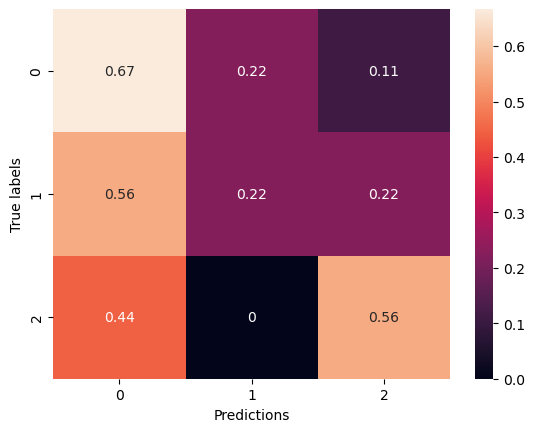

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▃▄▄▅▅▅▅▆▆▆▇▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇█▇█▇▇▇▇▇█▅▆
training_loss,█▇▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂
training_time,▁
val_accuracy,▂▁▁▂▂▃▆▄▇▄▆▇█▆▆██▇▆▇▅▇▅▆▅▇█▆▆▅▇▇▅▄▄▇▅▇▆▃
val_loss,█▇▇▆▆▄▂▃▂▂▁▁▁▂▁▁▁▁▁▁▃▁▂▁▂▁▁▂▂▂▁▁▂▂▁▁▂▂▁▃


Epoch 1/100


2024-03-12 21:17:53.325308: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:17:53.327380: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:17:53.329133: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:17:54.947394: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:17:54.949198: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:17:54.951419: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:17:59.226819: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:17:59.809127: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 26.8934 - accuracy: 0.3014

2024-03-12 21:18:02.910806: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:18:02.913263: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:18:02.914980: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 332ms/step - loss: 26.8934 - accuracy: 0.3014 - val_loss: 21.3444 - val_accuracy: 0.1389
Epoch 2/100
7/7 [==============================] - 1s 77ms/step - loss: 18.8112 - accuracy: 0.3447 - val_loss: 15.2950 - val_accuracy: 0.1111
Epoch 3/100
7/7 [==============================] - 1s 78ms/step - loss: 13.4044 - accuracy: 0.4064 - val_loss: 11.1077 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 77ms/step - loss: 9.9126 - accuracy: 0.3927 - val_loss: 8.6568 - val_accuracy: 0.1296
Epoch 5/100
7/7 [==============================] - 1s 76ms/step - loss: 7.4321 - accuracy: 0.4863 - val_loss: 6.9821 - val_accuracy: 0.1296
Epoch 6/100
7/7 [==============================] - 1s 77ms/step - loss: 5.9246 - accuracy: 0.4589 - val_loss: 5.8679 - val_accuracy: 0.1389
Epoch 7/100
7/7 [==============================] - 1s 77ms/step - loss: 4.8685 - accuracy: 0.4612 - val_loss: 5.0965 - val_accuracy: 0.1389
Epoch 8/100
7/7 [=======

7/7 [==============================] - 1s 77ms/step - loss: 2.0115 - accuracy: 0.6895 - val_loss: 2.6375 - val_accuracy: 0.4444
Epoch 60/100
7/7 [==============================] - 1s 82ms/step - loss: 1.8874 - accuracy: 0.7146 - val_loss: 2.4916 - val_accuracy: 0.4722
Epoch 61/100
7/7 [==============================] - 1s 76ms/step - loss: 1.7912 - accuracy: 0.7055 - val_loss: 2.8577 - val_accuracy: 0.3704
Epoch 62/100
7/7 [==============================] - 1s 77ms/step - loss: 1.7403 - accuracy: 0.7306 - val_loss: 2.4737 - val_accuracy: 0.5093
Epoch 63/100
7/7 [==============================] - 1s 77ms/step - loss: 1.7476 - accuracy: 0.7283 - val_loss: 2.4080 - val_accuracy: 0.5000
Epoch 64/100
7/7 [==============================] - 1s 76ms/step - loss: 1.7759 - accuracy: 0.7443 - val_loss: 2.9040 - val_accuracy: 0.3889
Epoch 65/100
7/7 [==============================] - 1s 77ms/step - loss: 1.7495 - accuracy: 0.7352 - val_loss: 3.4501 - val_accuracy: 0.2870
Epoch 66/100
7/7 [========

2024-03-12 21:18:57.217811: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:18:57.219662: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:18:57.222277: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4729859828948975 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.48484848484848486, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.3333333333333333, 'recall': 0.3703703703703704, 'f1-score': 0.2727272727272727, 'support': 27}, 'weighted avg': {'precision': 0.3333333333333333, 'recall': 0.37037037037037035, 'f1-score': 0.2727272727272727, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


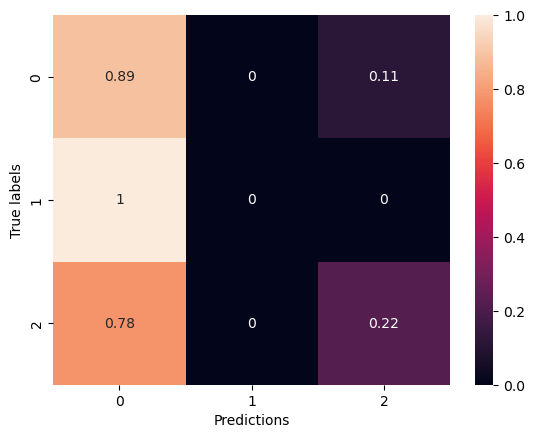

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▃▅▆▆▇▇▇▇▇█▇█▆▇▇▇█▇▇▇▇▇▇▇▇▇██████▇▇▇▇█▇
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▂▇▃▄█▇▂▄▂▄▇▅▃▆▄▄▃▇▂▆▅▅▄▅▄▂▅▆▅▆▄▆▆▄█▃
val_loss,█▄▂▂▂▁▁▁▁▁▂▁▂▁▁▁▁▁▁▁▂▁▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:19:19.389912: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:19:19.391576: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:19:19.393597: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:19:21.003186: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:19:21.005617: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:19:21.007383: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:19:26.225514: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:19:26.803823: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 35.2169 - accuracy: 0.3288

2024-03-12 21:19:29.906812: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:19:29.908327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:19:29.910467: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 329ms/step - loss: 35.2169 - accuracy: 0.3288 - val_loss: 26.0958 - val_accuracy: 0.1481
Epoch 2/100
7/7 [==============================] - 1s 76ms/step - loss: 22.0313 - accuracy: 0.4452 - val_loss: 16.9457 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 77ms/step - loss: 14.2156 - accuracy: 0.4201 - val_loss: 11.5746 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 76ms/step - loss: 9.6073 - accuracy: 0.4635 - val_loss: 8.4376 - val_accuracy: 0.1389
Epoch 5/100
7/7 [==============================] - 1s 77ms/step - loss: 6.9687 - accuracy: 0.5342 - val_loss: 6.8540 - val_accuracy: 0.1389
Epoch 6/100
7/7 [==============================] - 1s 78ms/step - loss: 5.5141 - accuracy: 0.5251 - val_loss: 5.5907 - val_accuracy: 0.1296
Epoch 7/100
7/7 [==============================] - 1s 78ms/step - loss: 4.5054 - accuracy: 0.5594 - val_loss: 4.7960 - val_accuracy: 0.1759
Epoch 8/100
7/7 [=======

7/7 [==============================] - 1s 77ms/step - loss: 1.7087 - accuracy: 0.7329 - val_loss: 2.3048 - val_accuracy: 0.6111
Epoch 60/100
7/7 [==============================] - 1s 76ms/step - loss: 1.9203 - accuracy: 0.6438 - val_loss: 2.1891 - val_accuracy: 0.6019
Epoch 61/100
7/7 [==============================] - 1s 77ms/step - loss: 2.0302 - accuracy: 0.6781 - val_loss: 3.8389 - val_accuracy: 0.2037
Epoch 62/100
7/7 [==============================] - 1s 76ms/step - loss: 2.2513 - accuracy: 0.6553 - val_loss: 3.0745 - val_accuracy: 0.3981
Epoch 63/100
7/7 [==============================] - 1s 77ms/step - loss: 2.1823 - accuracy: 0.6553 - val_loss: 2.7899 - val_accuracy: 0.4907
Epoch 64/100
7/7 [==============================] - 1s 76ms/step - loss: 2.0379 - accuracy: 0.7055 - val_loss: 2.4662 - val_accuracy: 0.5370
Epoch 65/100
7/7 [==============================] - 1s 79ms/step - loss: 1.9147 - accuracy: 0.6804 - val_loss: 3.4976 - val_accuracy: 0.2593
Epoch 66/100
7/7 [========

2024-03-12 21:20:24.587061: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:20:24.588553: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:20:24.590606: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4821808338165283 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, '2': {'precision': 0.3, 'recall': 0.6666666666666666, 'f1-score': 0.41379310344827586, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.5444444444444444, 'recall': 0.3333333333333333, 'f1-score': 0.2934865900383142, 'support': 27}, 'weighted avg': {'precision': 0.5444444444444444, 'recall': 0.3333333333333333, 'f1-score': 0.2934865900383141, 'support': 27}}


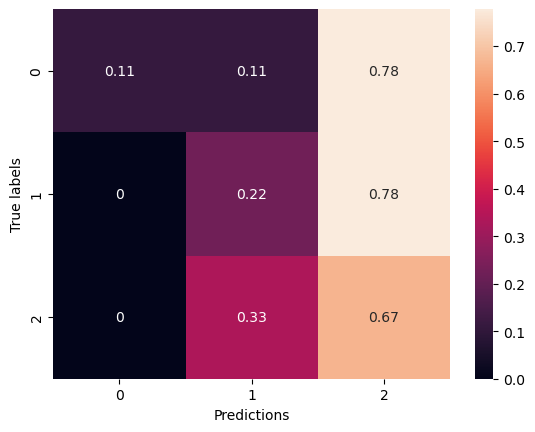

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▇▆▇▇▇▇▆▇▆▆▇▇▇█▇▇▇██▇█▇▇▆▇▇▆▇▇▆▆▇███
training_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▇▂▄▃▅▆▂▇█▅▇▇▇▆█▅▆▇▅▄█▂▇▇▅▇█▂▂▇▆▆▁▇█▄▇
val_loss,█▄▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁


Epoch 1/100


2024-03-12 21:20:48.905481: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:20:48.907060: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:20:48.908826: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:20:50.529001: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:20:50.530857: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:20:50.532988: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:20:54.718729: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:20:55.304517: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 7.7559 - accuracy: 0.4772

2024-03-12 21:20:58.646164: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:20:58.648312: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:20:58.649890: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 369ms/step - loss: 7.7559 - accuracy: 0.4772 - val_loss: 8.4076 - val_accuracy: 0.1111
Epoch 2/100
7/7 [==============================] - 1s 110ms/step - loss: 6.7009 - accuracy: 0.6142 - val_loss: 7.3052 - val_accuracy: 0.1111
Epoch 3/100
7/7 [==============================] - 1s 122ms/step - loss: 5.8406 - accuracy: 0.6826 - val_loss: 8.5603 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 113ms/step - loss: 5.0850 - accuracy: 0.7420 - val_loss: 6.6090 - val_accuracy: 0.1111
Epoch 5/100
7/7 [==============================] - 1s 112ms/step - loss: 4.4214 - accuracy: 0.7831 - val_loss: 5.0398 - val_accuracy: 0.3519
Epoch 6/100
7/7 [==============================] - 1s 112ms/step - loss: 3.7794 - accuracy: 0.8128 - val_loss: 5.7486 - val_accuracy: 0.1667
Epoch 7/100
7/7 [==============================] - 1s 111ms/step - loss: 3.2621 - accuracy: 0.8425 - val_loss: 4.0107 - val_accuracy: 0.4722
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 112ms/step - loss: 1.0577 - accuracy: 0.9384 - val_loss: 3.4401 - val_accuracy: 0.4630
Epoch 60/100
7/7 [==============================] - 1s 113ms/step - loss: 1.0384 - accuracy: 0.9475 - val_loss: 2.9677 - val_accuracy: 0.5556
Epoch 61/100
7/7 [==============================] - 1s 113ms/step - loss: 0.9830 - accuracy: 0.9566 - val_loss: 3.1253 - val_accuracy: 0.4907
Epoch 62/100
7/7 [==============================] - 1s 126ms/step - loss: 0.9826 - accuracy: 0.9475 - val_loss: 3.0957 - val_accuracy: 0.5370
Epoch 63/100
7/7 [==============================] - 1s 129ms/step - loss: 0.9945 - accuracy: 0.9292 - val_loss: 3.3201 - val_accuracy: 0.4722
Epoch 64/100
7/7 [==============================] - 1s 119ms/step - loss: 0.9837 - accuracy: 0.9475 - val_loss: 3.2369 - val_accuracy: 0.4259
Epoch 65/100
7/7 [==============================] - 1s 115ms/step - loss: 0.9751 - accuracy: 0.9384 - val_loss: 3.7581 - val_accuracy: 0.3426
Epoch 

2024-03-12 21:22:17.279701: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:22:17.281355: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:22:17.283246: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.499828815460205 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.6666666666666666, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.6181818181818182, 'recall': 0.4444444444444444, 'f1-score': 0.39999999999999997, 'support': 27}, 'weighted avg': {'precision': 0.6181818181818182, 'recall': 0.4444444444444444, 'f1-score': 0.4, 'support': 27}}


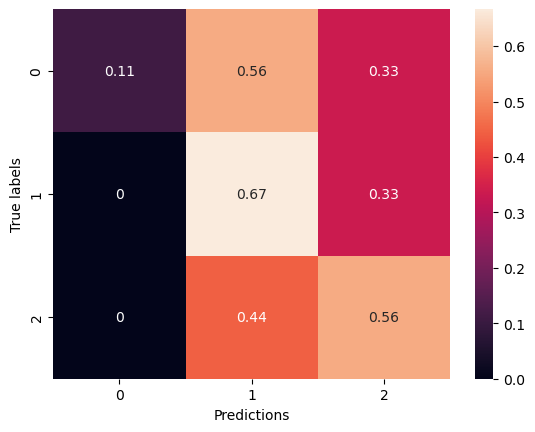

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▇▇▇█▇▇▇▇█▇▇█▇██▇████▇██▇▇█▇▇██▇███
training_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▄▆▁▇▆█▆▇▇███▆▅█▇▆▆▆▇▆▇▆▅▄▅▅▅▆▇▆▆▆▆▇█▆
val_loss,██▅▃▃▅▂▂▂▂▁▁▁▂▁▁▃▁▂▂▂▂▁▂▂▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂


Epoch 1/100


2024-03-12 21:22:42.267741: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:22:42.271428: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:22:42.273038: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:22:43.895773: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:22:43.897483: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:22:43.899433: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:22:48.109858: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:22:48.687826: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 27.9392 - accuracy: 0.4749

2024-03-12 21:22:52.007503: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:22:52.010374: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:22:52.012564: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 367ms/step - loss: 27.9392 - accuracy: 0.4749 - val_loss: 20.8634 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 112ms/step - loss: 16.2211 - accuracy: 0.6279 - val_loss: 12.0802 - val_accuracy: 0.3333
Epoch 3/100
7/7 [==============================] - 1s 113ms/step - loss: 9.6402 - accuracy: 0.6826 - val_loss: 8.2996 - val_accuracy: 0.2222
Epoch 4/100
7/7 [==============================] - 1s 112ms/step - loss: 6.2050 - accuracy: 0.7374 - val_loss: 5.9382 - val_accuracy: 0.3148
Epoch 5/100
7/7 [==============================] - 1s 111ms/step - loss: 4.4755 - accuracy: 0.7717 - val_loss: 4.9972 - val_accuracy: 0.3333
Epoch 6/100
7/7 [==============================] - 1s 112ms/step - loss: 3.5032 - accuracy: 0.8037 - val_loss: 3.8881 - val_accuracy: 0.5556
Epoch 7/100
7/7 [==============================] - 1s 111ms/step - loss: 2.8796 - accuracy: 0.7922 - val_loss: 3.3158 - val_accuracy: 0.5093
Epoch 8/100
7/7 [===

Epoch 59/100
7/7 [==============================] - 1s 110ms/step - loss: 1.3813 - accuracy: 0.8813 - val_loss: 2.9732 - val_accuracy: 0.5278
Epoch 60/100
7/7 [==============================] - 1s 111ms/step - loss: 1.4385 - accuracy: 0.8721 - val_loss: 3.1051 - val_accuracy: 0.4074
Epoch 61/100
7/7 [==============================] - 1s 114ms/step - loss: 1.6220 - accuracy: 0.8584 - val_loss: 2.9768 - val_accuracy: 0.4444
Epoch 62/100
7/7 [==============================] - 1s 111ms/step - loss: 1.5261 - accuracy: 0.8813 - val_loss: 3.4283 - val_accuracy: 0.4074
Epoch 63/100
7/7 [==============================] - 1s 111ms/step - loss: 1.6949 - accuracy: 0.8037 - val_loss: 3.0532 - val_accuracy: 0.4444
Epoch 64/100
7/7 [==============================] - 1s 109ms/step - loss: 1.6300 - accuracy: 0.8470 - val_loss: 2.9116 - val_accuracy: 0.3889
Epoch 65/100
7/7 [==============================] - 1s 112ms/step - loss: 1.4686 - accuracy: 0.8950 - val_loss: 2.7736 - val_accuracy: 0.5185
Epoch 

2024-03-12 21:24:10.370508: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:24:10.372083: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:24:10.374104: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.516495943069458 s
{'0': {'precision': 0.2, 'recall': 0.2222222222222222, 'f1-score': 0.2105263157894737, 'support': 9}, '1': {'precision': 0.2727272727272727, 'recall': 0.3333333333333333, 'f1-score': 0.3, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, 'accuracy': 0.25925925925925924, 'macro avg': {'precision': 0.2686868686868687, 'recall': 0.25925925925925924, 'f1-score': 0.2590643274853801, 'support': 27}, 'weighted avg': {'precision': 0.26868686868686864, 'recall': 0.25925925925925924, 'f1-score': 0.2590643274853801, 'support': 27}}


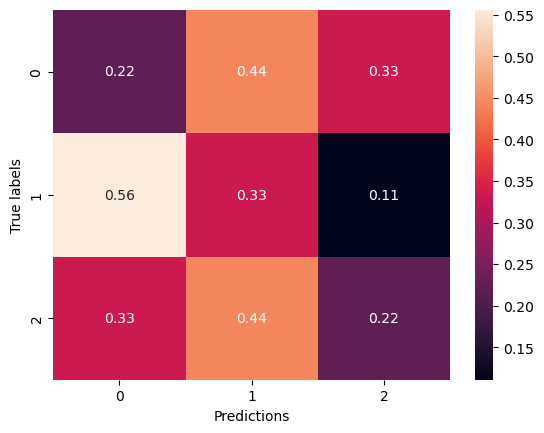

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▆▆▆▇▆▇▆▇▆▆▇▆▇▇▆█▇▇▇▇▇▇█▇▆▇▇▇█▇██▇▇█▇
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂█▇▇▅▆▅▆▅▇█▂▅▇▅▇▅▇▆▄▄▂▇▆▅▅▆▅▇▄▆▆▄▇▃▃▁▄▄
val_loss,█▃▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▂▁▂▂▂▂▂


Epoch 1/100


2024-03-12 21:24:41.070013: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:24:41.071665: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:24:41.073591: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:24:42.703282: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:24:42.705553: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:24:42.707379: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:24:46.848752: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:24:48.471106: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 37.0572 - accuracy: 0.4224

2024-03-12 21:24:51.821224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:24:51.822855: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:24:51.824754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 368ms/step - loss: 37.0572 - accuracy: 0.4224 - val_loss: 25.5492 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 111ms/step - loss: 19.4816 - accuracy: 0.5936 - val_loss: 15.0199 - val_accuracy: 0.1389
Epoch 3/100
7/7 [==============================] - 1s 111ms/step - loss: 10.5950 - accuracy: 0.6575 - val_loss: 8.6618 - val_accuracy: 0.3056
Epoch 4/100
7/7 [==============================] - 1s 113ms/step - loss: 6.6526 - accuracy: 0.7078 - val_loss: 6.0659 - val_accuracy: 0.2778
Epoch 5/100
7/7 [==============================] - 1s 112ms/step - loss: 4.7773 - accuracy: 0.7306 - val_loss: 4.6814 - val_accuracy: 0.3889
Epoch 6/100
7/7 [==============================] - 1s 112ms/step - loss: 3.6161 - accuracy: 0.7763 - val_loss: 3.9152 - val_accuracy: 0.3056
Epoch 7/100
7/7 [==============================] - 1s 112ms/step - loss: 2.8324 - accuracy: 0.7922 - val_loss: 3.4273 - val_accuracy: 0.3519
Epoch 8/100
7/7 [==

Epoch 59/100
7/7 [==============================] - 1s 111ms/step - loss: 1.5133 - accuracy: 0.8356 - val_loss: 3.4023 - val_accuracy: 0.3611
Epoch 60/100
7/7 [==============================] - 1s 111ms/step - loss: 1.4478 - accuracy: 0.8858 - val_loss: 3.2070 - val_accuracy: 0.3519
Epoch 61/100
7/7 [==============================] - 1s 112ms/step - loss: 1.4192 - accuracy: 0.8813 - val_loss: 3.6778 - val_accuracy: 0.3426
Epoch 62/100
7/7 [==============================] - 1s 111ms/step - loss: 1.4025 - accuracy: 0.8539 - val_loss: 2.8959 - val_accuracy: 0.4907
Epoch 63/100
7/7 [==============================] - 1s 110ms/step - loss: 1.4868 - accuracy: 0.8562 - val_loss: 2.6942 - val_accuracy: 0.5833
Epoch 64/100
7/7 [==============================] - 1s 112ms/step - loss: 1.5817 - accuracy: 0.8653 - val_loss: 3.5667 - val_accuracy: 0.3426
Epoch 65/100
7/7 [==============================] - 1s 112ms/step - loss: 1.5252 - accuracy: 0.8516 - val_loss: 2.7148 - val_accuracy: 0.5093
Epoch 

2024-03-12 21:26:10.292331: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:26:10.294544: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:26:10.296256: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.478642225265503 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.2727272727272727, 'recall': 0.3333333333333333, 'f1-score': 0.3, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.6666666666666666, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.5575757575757576, 'recall': 0.3703703703703704, 'f1-score': 0.3333333333333333, 'support': 27}, 'weighted avg': {'precision': 0.5575757575757575, 'recall': 0.37037037037037035, 'f1-score': 0.3333333333333333, 'support': 27}}


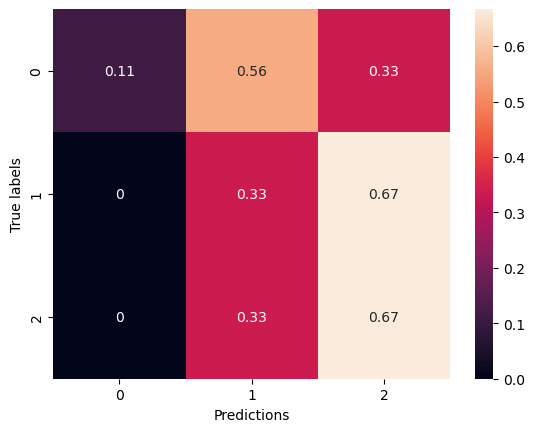

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▆▇▇▆▇▇▇▇▇▇▆█▆▇▇▇▇▇▇▇▇▇▇▇█▇█▇▇▇▇█▇▆█▇
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▄▄▅█▅▅▆▃▅▆▇▆██▇▅▇▆██▇█▅▅▅▅▆▅▄▆▅▄▆▄▇▄▄▅▇
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:27:00.917966: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:27:00.920001: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:27:00.921640: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:27:02.527412: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:27:02.529650: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:27:02.531747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:27:06.679272: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:27:07.268171: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 7.9269 - accuracy: 0.4201

2024-03-12 21:27:10.626426: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:27:10.628734: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:27:10.630657: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 369ms/step - loss: 7.9269 - accuracy: 0.4201 - val_loss: 7.9539 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 111ms/step - loss: 6.9447 - accuracy: 0.5411 - val_loss: 8.0893 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 112ms/step - loss: 6.1391 - accuracy: 0.6142 - val_loss: 6.8529 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 111ms/step - loss: 5.5209 - accuracy: 0.6484 - val_loss: 5.8523 - val_accuracy: 0.1944
Epoch 5/100
7/7 [==============================] - 1s 112ms/step - loss: 5.0193 - accuracy: 0.6575 - val_loss: 8.0496 - val_accuracy: 0.1296
Epoch 6/100
7/7 [==============================] - 1s 112ms/step - loss: 4.4318 - accuracy: 0.7100 - val_loss: 5.7416 - val_accuracy: 0.2130
Epoch 7/100
7/7 [==============================] - 1s 121ms/step - loss: 3.9652 - accuracy: 0.7306 - val_loss: 7.5223 - val_accuracy: 0.1204
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 111ms/step - loss: 1.4062 - accuracy: 0.8653 - val_loss: 2.8110 - val_accuracy: 0.5278
Epoch 60/100
7/7 [==============================] - 1s 112ms/step - loss: 1.4591 - accuracy: 0.8493 - val_loss: 2.9582 - val_accuracy: 0.4352
Epoch 61/100
7/7 [==============================] - 1s 113ms/step - loss: 1.4414 - accuracy: 0.8699 - val_loss: 3.1218 - val_accuracy: 0.4167
Epoch 62/100
7/7 [==============================] - 1s 111ms/step - loss: 1.3347 - accuracy: 0.9178 - val_loss: 3.0324 - val_accuracy: 0.4537
Epoch 63/100
7/7 [==============================] - 1s 113ms/step - loss: 1.2554 - accuracy: 0.9292 - val_loss: 3.0604 - val_accuracy: 0.5093
Epoch 64/100
7/7 [==============================] - 1s 112ms/step - loss: 1.2087 - accuracy: 0.9247 - val_loss: 3.0456 - val_accuracy: 0.5000
Epoch 65/100
7/7 [==============================] - 1s 113ms/step - loss: 1.2389 - accuracy: 0.8973 - val_loss: 2.9562 - val_accuracy: 0.4722
Epoch 

2024-03-12 21:28:29.537590: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:28:29.539657: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:28:29.541349: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4819130897521973 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '2': {'precision': 0.4090909090909091, 'recall': 1.0, 'f1-score': 0.5806451612903226, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.41414141414141414, 'recall': 0.40740740740740744, 'f1-score': 0.3097100032583904, 'support': 27}, 'weighted avg': {'precision': 0.41414141414141414, 'recall': 0.4074074074074074, 'f1-score': 0.3097100032583904, 'support': 27}}


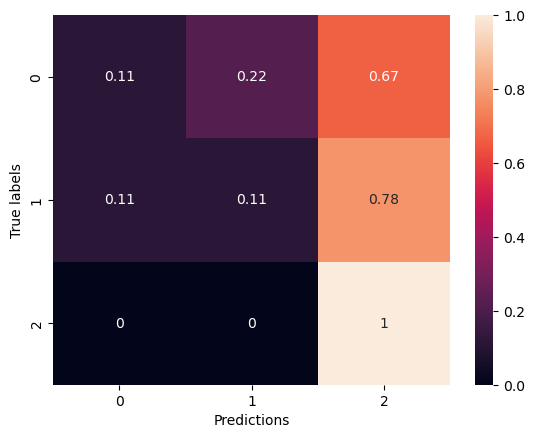

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇▆▇▇▇█▇▇▇▇█▇▇█▇▇█▇▇█▇▇█▇██▇██▇██▇▇
training_loss,█▆▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▅▅▅█▇▆▆██▇▇▆▅▇▇▅▆▅▅▆▇▅▇▆▆▄▆▇▅▄▆▅▆▇█▇▇
val_loss,█▇▅▃▃▃▂▂▂▂▁▂▁▁▂▂▂▁▂▂▂▂▂▁▂▂▂▁▃▁▂▂▃▂▂▂▁▁▁▁


Epoch 1/100


2024-03-12 21:31:09.761595: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:31:09.763252: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:31:09.765119: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:31:11.772083: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:31:11.774703: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:31:11.776500: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:31:17.286184: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:31:17.864747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 28.5894 - accuracy: 0.4201

2024-03-12 21:31:21.177476: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:31:21.179263: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:31:21.181119: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 371ms/step - loss: 28.5894 - accuracy: 0.4201 - val_loss: 21.4256 - val_accuracy: 0.2500
Epoch 2/100
7/7 [==============================] - 1s 111ms/step - loss: 18.0254 - accuracy: 0.5160 - val_loss: 15.0343 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 110ms/step - loss: 11.7751 - accuracy: 0.6119 - val_loss: 10.2935 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 110ms/step - loss: 8.0720 - accuracy: 0.6872 - val_loss: 8.0544 - val_accuracy: 0.1481
Epoch 5/100
7/7 [==============================] - 1s 113ms/step - loss: 5.9815 - accuracy: 0.6872 - val_loss: 5.6282 - val_accuracy: 0.4352
Epoch 6/100
7/7 [==============================] - 1s 111ms/step - loss: 4.6814 - accuracy: 0.7374 - val_loss: 4.6250 - val_accuracy: 0.5648
Epoch 7/100
7/7 [==============================] - 1s 111ms/step - loss: 3.7875 - accuracy: 0.7603 - val_loss: 4.0703 - val_accuracy: 0.5648
Epoch 8/100
7/7 [=

Epoch 59/100
7/7 [==============================] - 1s 113ms/step - loss: 1.5187 - accuracy: 0.8219 - val_loss: 3.3918 - val_accuracy: 0.3704
Epoch 60/100
7/7 [==============================] - 1s 114ms/step - loss: 1.6252 - accuracy: 0.8151 - val_loss: 6.7200 - val_accuracy: 0.1296
Epoch 61/100
7/7 [==============================] - 1s 114ms/step - loss: 1.8894 - accuracy: 0.7671 - val_loss: 3.2779 - val_accuracy: 0.3611
Epoch 62/100
7/7 [==============================] - 1s 117ms/step - loss: 2.1348 - accuracy: 0.7831 - val_loss: 3.1224 - val_accuracy: 0.3704
Epoch 63/100
7/7 [==============================] - 1s 111ms/step - loss: 2.0594 - accuracy: 0.7763 - val_loss: 3.2516 - val_accuracy: 0.3241
Epoch 64/100
7/7 [==============================] - 1s 112ms/step - loss: 1.7841 - accuracy: 0.8402 - val_loss: 3.3501 - val_accuracy: 0.3704
Epoch 65/100
7/7 [==============================] - 1s 112ms/step - loss: 1.7367 - accuracy: 0.7968 - val_loss: 2.9003 - val_accuracy: 0.4815
Epoch 

2024-03-12 21:32:40.054255: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:32:40.056055: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:32:40.057975: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4810519218444824 s
{'0': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '1': {'precision': 0.4090909090909091, 'recall': 1.0, 'f1-score': 0.5806451612903226, 'support': 9}, '2': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.3863636363636364, 'recall': 0.4444444444444444, 'f1-score': 0.34739454094292804, 'support': 27}, 'weighted avg': {'precision': 0.38636363636363635, 'recall': 0.4444444444444444, 'f1-score': 0.34739454094292804, 'support': 27}}


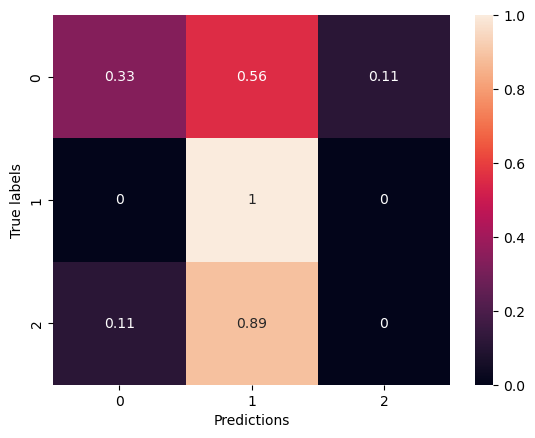

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▇▇▇▇▇▇▇▇▆█▆▇▇▇▇█▇█▇▇▇▆█▇▇██▇█▇█▇██▇▇▆
training_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁█▅▄▃▄▅▄█▆▄▄█▇▄▅▇▄▆▆▅▆▅▄▅▃▆▅▃▃▅▅▄▄▅▅▅█▃
val_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:33:02.164054: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:33:02.165715: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:33:02.167775: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:33:03.776584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:33:03.778192: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:33:03.780186: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:33:07.953205: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:33:08.541136: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 38.3410 - accuracy: 0.3858

2024-03-12 21:33:11.845520: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:33:11.847172: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:33:11.849144: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 558ms/step - loss: 38.3410 - accuracy: 0.3858 - val_loss: 27.8309 - val_accuracy: 0.1111
Epoch 2/100
7/7 [==============================] - 1s 110ms/step - loss: 22.0431 - accuracy: 0.5183 - val_loss: 17.3404 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 112ms/step - loss: 13.0769 - accuracy: 0.5982 - val_loss: 11.2579 - val_accuracy: 0.1019
Epoch 4/100
7/7 [==============================] - 1s 112ms/step - loss: 8.6603 - accuracy: 0.6644 - val_loss: 8.0658 - val_accuracy: 0.1852
Epoch 5/100
7/7 [==============================] - 1s 113ms/step - loss: 6.4764 - accuracy: 0.6826 - val_loss: 6.4520 - val_accuracy: 0.2222
Epoch 6/100
7/7 [==============================] - 1s 113ms/step - loss: 5.0666 - accuracy: 0.6849 - val_loss: 5.0708 - val_accuracy: 0.3333
Epoch 7/100
7/7 [==============================] - 1s 111ms/step - loss: 4.1106 - accuracy: 0.6963 - val_loss: 4.4657 - val_accuracy: 0.3611
Epoch 8/100
7/7 [=

Epoch 59/100
7/7 [==============================] - 1s 112ms/step - loss: 1.8157 - accuracy: 0.7557 - val_loss: 3.7489 - val_accuracy: 0.2407
Epoch 60/100
7/7 [==============================] - 1s 111ms/step - loss: 1.7796 - accuracy: 0.7991 - val_loss: 2.7793 - val_accuracy: 0.3333
Epoch 61/100
7/7 [==============================] - 1s 110ms/step - loss: 1.6540 - accuracy: 0.8356 - val_loss: 2.6999 - val_accuracy: 0.4722
Epoch 62/100
7/7 [==============================] - 1s 114ms/step - loss: 1.6004 - accuracy: 0.8174 - val_loss: 2.7419 - val_accuracy: 0.5185
Epoch 63/100
7/7 [==============================] - 1s 113ms/step - loss: 1.7411 - accuracy: 0.7717 - val_loss: 2.7037 - val_accuracy: 0.4907
Epoch 64/100
7/7 [==============================] - 1s 111ms/step - loss: 1.9717 - accuracy: 0.7831 - val_loss: 3.1309 - val_accuracy: 0.3889
Epoch 65/100
7/7 [==============================] - 1s 111ms/step - loss: 2.0555 - accuracy: 0.7740 - val_loss: 3.2467 - val_accuracy: 0.3704
Epoch 

2024-03-12 21:34:32.146379: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:34:32.148268: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:34:32.150279: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5021841526031494 s
{'0': {'precision': 0.3125, 'recall': 0.5555555555555556, 'f1-score': 0.39999999999999997, 'support': 9}, '1': {'precision': 0.25, 'recall': 0.1111111111111111, 'f1-score': 0.15384615384615383, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.33035714285714285, 'recall': 0.3333333333333333, 'f1-score': 0.30961538461538457, 'support': 27}, 'weighted avg': {'precision': 0.33035714285714285, 'recall': 0.3333333333333333, 'f1-score': 0.3096153846153846, 'support': 27}}


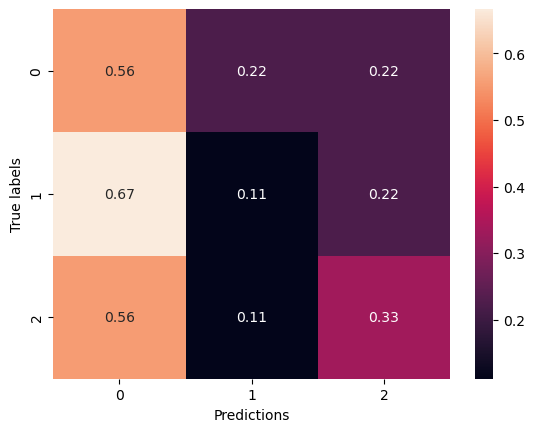

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▆▇▇▇▇▇▆▇▇▇▇▇█▇▇▇▇▇█▇█▇█▇▇▇▇█▇▇▇▇█▇▇█
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▄▄█▅▇▆▅▆▃▅▇█▅▅▅▇▅▆▃▄▆▃▆▅▅█▆▃▂▆▆▄▅▅▅▅▅▃
val_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:34:55.211005: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:34:55.212639: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:34:55.214695: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:34:56.833003: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:34:56.834865: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:34:56.837242: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:35:00.989260: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:35:01.570404: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 7.9934 - accuracy: 0.3767

2024-03-12 21:35:04.880140: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:35:04.882097: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:35:04.883966: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 364ms/step - loss: 7.9934 - accuracy: 0.3767 - val_loss: 7.8479 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 110ms/step - loss: 7.3640 - accuracy: 0.4041 - val_loss: 7.2335 - val_accuracy: 0.1481
Epoch 3/100
7/7 [==============================] - 1s 112ms/step - loss: 6.7407 - accuracy: 0.4406 - val_loss: 7.6233 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 111ms/step - loss: 6.1549 - accuracy: 0.4475 - val_loss: 7.6207 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 112ms/step - loss: 5.7562 - accuracy: 0.4909 - val_loss: 7.5843 - val_accuracy: 0.1204
Epoch 6/100
7/7 [==============================] - 1s 111ms/step - loss: 5.2622 - accuracy: 0.4863 - val_loss: 7.4814 - val_accuracy: 0.1204
Epoch 7/100
7/7 [==============================] - 1s 110ms/step - loss: 4.7787 - accuracy: 0.5639 - val_loss: 7.5581 - val_accuracy: 0.1204
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 150ms/step - loss: 1.8899 - accuracy: 0.7374 - val_loss: 2.5926 - val_accuracy: 0.4167
Epoch 60/100
7/7 [==============================] - 1s 138ms/step - loss: 1.9484 - accuracy: 0.7146 - val_loss: 2.6726 - val_accuracy: 0.4352
Epoch 61/100
7/7 [==============================] - 1s 132ms/step - loss: 1.7803 - accuracy: 0.7877 - val_loss: 3.0898 - val_accuracy: 0.3611
Epoch 62/100
7/7 [==============================] - 1s 120ms/step - loss: 1.7395 - accuracy: 0.7900 - val_loss: 3.0683 - val_accuracy: 0.3981
Epoch 63/100
7/7 [==============================] - 1s 126ms/step - loss: 1.6584 - accuracy: 0.8242 - val_loss: 3.0008 - val_accuracy: 0.3704
Epoch 64/100
7/7 [==============================] - 1s 167ms/step - loss: 1.7323 - accuracy: 0.7900 - val_loss: 3.5188 - val_accuracy: 0.3241
Epoch 65/100
7/7 [==============================] - 1s 166ms/step - loss: 1.8519 - accuracy: 0.7511 - val_loss: 2.8093 - val_accuracy: 0.3889
Epoch 

2024-03-12 21:36:37.841708: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:36:37.843324: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:36:37.845377: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4914350509643555 s
{'0': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '1': {'precision': 0.42105263157894735, 'recall': 0.8888888888888888, 'f1-score': 0.5714285714285714, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.6959064327485379, 'recall': 0.5185185185185185, 'f1-score': 0.4894660894660894, 'support': 27}, 'weighted avg': {'precision': 0.695906432748538, 'recall': 0.5185185185185185, 'f1-score': 0.4894660894660895, 'support': 27}}


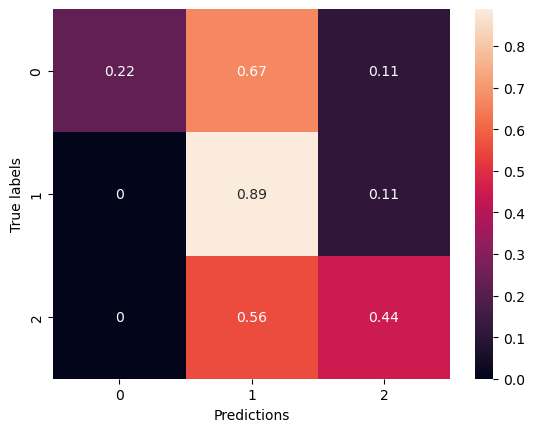

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇█▇█▇▆▇▇▇▇▇▇▇▇▇█▇█▇▇▇█
training_loss,█▇▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▄▃▆██▇▆▅▆█▇▄▇▆▇▇▆▄▄▅▄▄▅▆▅▅▆▇▅▄▄▅▆▅▅▅
val_loss,███▆▃▃▂▂▁▂▂▂▁▁▁▂▁▂▁▁▁▃▂▁▂▃▂▂▁▁▂▁▂▂▂▂▂▂▁▂


Epoch 1/100


2024-03-12 21:37:05.843888: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:37:05.845481: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:37:05.847374: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:37:07.462397: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:37:07.464686: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:37:07.466449: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:37:12.660870: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:37:13.230466: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 28.6281 - accuracy: 0.4064

2024-03-12 21:37:16.543308: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:37:16.545353: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:37:16.546921: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 372ms/step - loss: 28.6281 - accuracy: 0.4064 - val_loss: 22.1504 - val_accuracy: 0.1574
Epoch 2/100
7/7 [==============================] - 1s 121ms/step - loss: 19.0282 - accuracy: 0.4155 - val_loss: 16.0833 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 123ms/step - loss: 13.6594 - accuracy: 0.4269 - val_loss: 12.1053 - val_accuracy: 0.1574
Epoch 4/100
7/7 [==============================] - 1s 119ms/step - loss: 10.3237 - accuracy: 0.4749 - val_loss: 10.8933 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 124ms/step - loss: 8.1687 - accuracy: 0.5320 - val_loss: 8.4438 - val_accuracy: 0.1574
Epoch 6/100
7/7 [==============================] - 1s 121ms/step - loss: 6.6710 - accuracy: 0.5434 - val_loss: 6.8340 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 129ms/step - loss: 5.4175 - accuracy: 0.6164 - val_loss: 5.1518 - val_accuracy: 0.4167
Epoch 8/100
7/7 

Epoch 59/100
7/7 [==============================] - 1s 111ms/step - loss: 2.1261 - accuracy: 0.6758 - val_loss: 2.5493 - val_accuracy: 0.5463
Epoch 60/100
7/7 [==============================] - 1s 122ms/step - loss: 2.1988 - accuracy: 0.6667 - val_loss: 4.6269 - val_accuracy: 0.1667
Epoch 61/100
7/7 [==============================] - 1s 111ms/step - loss: 2.2474 - accuracy: 0.7078 - val_loss: 3.5972 - val_accuracy: 0.3241
Epoch 62/100
7/7 [==============================] - 1s 110ms/step - loss: 2.2215 - accuracy: 0.6826 - val_loss: 5.9742 - val_accuracy: 0.1204
Epoch 63/100
7/7 [==============================] - 1s 111ms/step - loss: 2.0294 - accuracy: 0.7283 - val_loss: 3.0076 - val_accuracy: 0.4259
Epoch 64/100
7/7 [==============================] - 1s 111ms/step - loss: 1.8657 - accuracy: 0.7283 - val_loss: 4.1535 - val_accuracy: 0.1759
Epoch 65/100
7/7 [==============================] - 1s 113ms/step - loss: 1.7559 - accuracy: 0.7443 - val_loss: 4.6775 - val_accuracy: 0.2315
Epoch 

2024-03-12 21:38:36.618082: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:38:36.619692: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:38:36.621473: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.7480030059814453 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 1.0, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}, 'weighted avg': {'precision': 0.1111111111111111, 'recall': 0.3333333333333333, 'f1-score': 0.16666666666666666, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


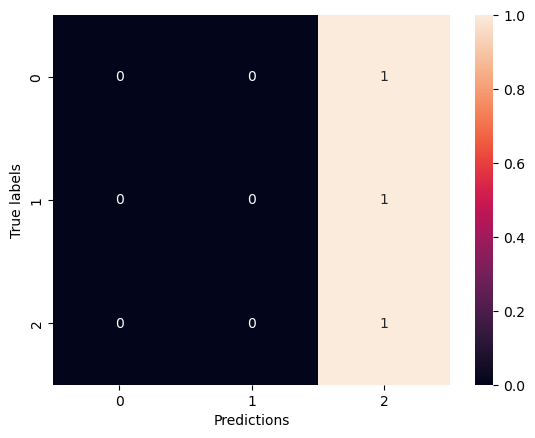

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▃▅▆▆▆▅▇▇▆▆▇▇▇▆▆▇▆▇▇▆▆▆▆▇▇▇▆▇▇▆▇█▇▆▇▇█▇
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▄▆▂▇▃▆█▂▃▄▆▄█▃▆▆▇▄▁▄▇▄▂▆▅▁▅▁▇▆▇▃▄▄▇▅▇
val_loss,█▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▂▁▁▂▁▂▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:39:00.137445: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:39:00.139709: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:39:00.141266: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:39:01.768259: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:39:01.770451: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:39:01.772166: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:39:05.921743: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:39:06.504206: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 38.5490 - accuracy: 0.3904

2024-03-12 21:39:09.861832: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:39:09.863396: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:39:09.865845: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 11s 367ms/step - loss: 38.5490 - accuracy: 0.3904 - val_loss: 28.2766 - val_accuracy: 0.2593
Epoch 2/100
7/7 [==============================] - 1s 111ms/step - loss: 23.4182 - accuracy: 0.4132 - val_loss: 17.8121 - val_accuracy: 0.1389
Epoch 3/100
7/7 [==============================] - 1s 111ms/step - loss: 14.8672 - accuracy: 0.4954 - val_loss: 12.7058 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 112ms/step - loss: 10.4578 - accuracy: 0.4452 - val_loss: 9.0454 - val_accuracy: 0.2963
Epoch 5/100
7/7 [==============================] - 1s 111ms/step - loss: 7.8918 - accuracy: 0.5068 - val_loss: 7.3508 - val_accuracy: 0.1944
Epoch 6/100
7/7 [==============================] - 1s 112ms/step - loss: 6.2201 - accuracy: 0.6073 - val_loss: 7.0525 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 110ms/step - loss: 5.0920 - accuracy: 0.6187 - val_loss: 5.4710 - val_accuracy: 0.1667
Epoch 8/100
7/7 [

Epoch 59/100
7/7 [==============================] - 1s 114ms/step - loss: 1.9111 - accuracy: 0.6986 - val_loss: 2.6739 - val_accuracy: 0.4722
Epoch 60/100
7/7 [==============================] - 1s 112ms/step - loss: 1.9331 - accuracy: 0.6735 - val_loss: 2.7023 - val_accuracy: 0.4167
Epoch 61/100
7/7 [==============================] - 1s 112ms/step - loss: 1.9832 - accuracy: 0.6644 - val_loss: 2.8470 - val_accuracy: 0.3889
Epoch 62/100
7/7 [==============================] - 1s 112ms/step - loss: 2.0440 - accuracy: 0.6644 - val_loss: 2.7365 - val_accuracy: 0.3333
Epoch 63/100
7/7 [==============================] - 1s 110ms/step - loss: 2.0166 - accuracy: 0.6712 - val_loss: 2.7107 - val_accuracy: 0.4630
Epoch 64/100
7/7 [==============================] - 1s 111ms/step - loss: 1.9761 - accuracy: 0.7032 - val_loss: 3.4397 - val_accuracy: 0.3241
Epoch 65/100
7/7 [==============================] - 1s 112ms/step - loss: 1.8895 - accuracy: 0.7100 - val_loss: 2.9869 - val_accuracy: 0.3704
Epoch 

2024-03-12 21:40:28.791542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:40:28.793150: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:40:28.795158: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4905529022216797 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4090909090909091, 'recall': 1.0, 'f1-score': 0.5806451612903226, 'support': 9}, '2': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.33636363636363636, 'recall': 0.4444444444444444, 'f1-score': 0.33640552995391704, 'support': 27}, 'weighted avg': {'precision': 0.33636363636363636, 'recall': 0.4444444444444444, 'f1-score': 0.3364055299539171, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


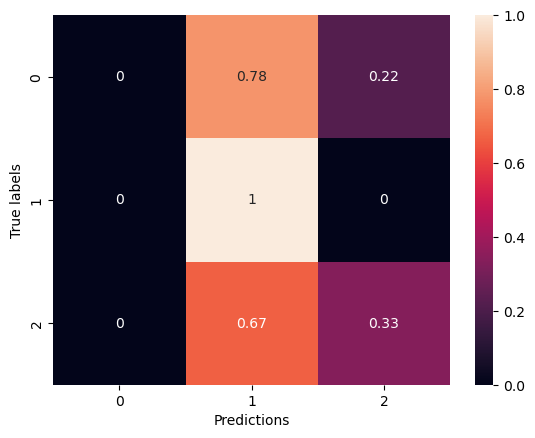

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▆▆▇▇▇▆▇▇▇█▇▇▇█▆▅▇▆▇▆▇██▇▆▆▇▇▇██▇██▇
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▂▃▅▆▃▄█▄▂▅█▇▇▇▄▅▂▁▂▃▂▆▅▄▁▆▄▇▂▇▇▄▇▄▄▄▅▅
val_loss,█▄▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:40:53.385803: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:40:53.387985: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:40:53.389611: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:40:56.215571: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:40:56.217597: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:40:56.219682: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:41:00.383772: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:41:00.958849: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 9.2274 - accuracy: 0.4041

2024-03-12 21:41:04.395280: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:41:04.397607: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:41:04.399249: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 386ms/step - loss: 9.2274 - accuracy: 0.4041 - val_loss: 8.5163 - val_accuracy: 0.1759
Epoch 2/100
7/7 [==============================] - 1s 131ms/step - loss: 8.1877 - accuracy: 0.5342 - val_loss: 8.1344 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 131ms/step - loss: 7.1854 - accuracy: 0.6210 - val_loss: 7.3233 - val_accuracy: 0.1111
Epoch 4/100
7/7 [==============================] - 1s 131ms/step - loss: 6.3319 - accuracy: 0.6507 - val_loss: 6.5306 - val_accuracy: 0.1667
Epoch 5/100
7/7 [==============================] - 1s 131ms/step - loss: 5.5375 - accuracy: 0.7123 - val_loss: 5.8230 - val_accuracy: 0.2222
Epoch 6/100
7/7 [==============================] - 1s 131ms/step - loss: 4.8026 - accuracy: 0.7626 - val_loss: 5.3105 - val_accuracy: 0.2685
Epoch 7/100
7/7 [==============================] - 1s 131ms/step - loss: 4.2320 - accuracy: 0.7648 - val_loss: 4.7195 - val_accuracy: 0.2963
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 132ms/step - loss: 1.1737 - accuracy: 0.9361 - val_loss: 3.8724 - val_accuracy: 0.2870
Epoch 60/100
7/7 [==============================] - 1s 130ms/step - loss: 1.2220 - accuracy: 0.9155 - val_loss: 3.2534 - val_accuracy: 0.4444
Epoch 61/100
7/7 [==============================] - 1s 131ms/step - loss: 1.2078 - accuracy: 0.9201 - val_loss: 3.1816 - val_accuracy: 0.4630
Epoch 62/100
7/7 [==============================] - 1s 132ms/step - loss: 1.1024 - accuracy: 0.9406 - val_loss: 2.7418 - val_accuracy: 0.4722
Epoch 63/100
7/7 [==============================] - 1s 130ms/step - loss: 1.0589 - accuracy: 0.9498 - val_loss: 2.7097 - val_accuracy: 0.5926
Epoch 64/100
7/7 [==============================] - 1s 130ms/step - loss: 1.0357 - accuracy: 0.9658 - val_loss: 3.6304 - val_accuracy: 0.4167
Epoch 65/100
7/7 [==============================] - 1s 130ms/step - loss: 1.0387 - accuracy: 0.9247 - val_loss: 3.0897 - val_accuracy: 0.4907
Epoch 

2024-03-12 21:42:37.243527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:42:37.245651: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:42:37.247155: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4791669845581055 s
{'0': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '1': {'precision': 0.3076923076923077, 'recall': 0.4444444444444444, 'f1-score': 0.3636363636363637, 'support': 9}, '2': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.42108262108262107, 'recall': 0.40740740740740744, 'f1-score': 0.4016354016354016, 'support': 27}, 'weighted avg': {'precision': 0.4210826210826211, 'recall': 0.4074074074074074, 'f1-score': 0.4016354016354016, 'support': 27}}


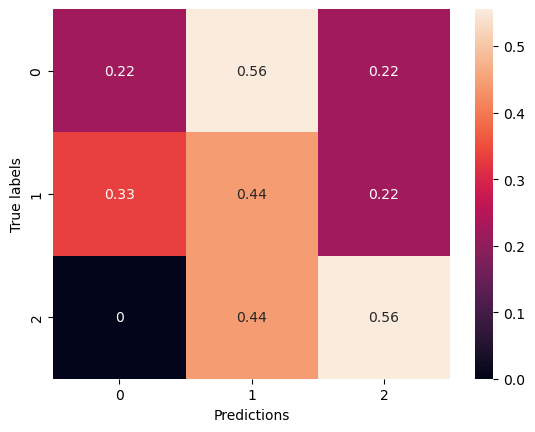

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇▇▇██▇█▇▇██▇█▇████▇█▇▇█████▇██▇██▇
training_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▃▃▇▆█▆▆▆█▆█▇▆▅▅▆▇▅▆▆▇▄▆▆▇▇██▇▅▅▇█▅▅▇▇▄
val_loss,█▇▄▃▂▂▁▂▁▁▁▁▁▂▂▃▃▁▁▂▁▁▁▂▁▂▁▁▁▁▁▂▂▁▁▂▂▂▂▃


Epoch 1/100


2024-03-12 21:43:02.216772: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:43:02.218494: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:43:02.220320: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:43:03.831204: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:43:03.832941: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:43:03.834974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:43:07.968327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:43:08.546265: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 33.7883 - accuracy: 0.4315

2024-03-12 21:43:11.973485: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:43:11.975165: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:43:11.977295: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 552ms/step - loss: 33.7883 - accuracy: 0.4315 - val_loss: 25.3867 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 133ms/step - loss: 20.3298 - accuracy: 0.5274 - val_loss: 16.2892 - val_accuracy: 0.1019
Epoch 3/100
7/7 [==============================] - 1s 131ms/step - loss: 12.4775 - accuracy: 0.6187 - val_loss: 11.6890 - val_accuracy: 0.1111
Epoch 4/100
7/7 [==============================] - 1s 131ms/step - loss: 8.3162 - accuracy: 0.6895 - val_loss: 8.1016 - val_accuracy: 0.1389
Epoch 5/100
7/7 [==============================] - 1s 132ms/step - loss: 6.0772 - accuracy: 0.7100 - val_loss: 6.3982 - val_accuracy: 0.1574
Epoch 6/100
7/7 [==============================] - 1s 132ms/step - loss: 4.5679 - accuracy: 0.7489 - val_loss: 4.7067 - val_accuracy: 0.3333
Epoch 7/100
7/7 [==============================] - 1s 131ms/step - loss: 3.5700 - accuracy: 0.7945 - val_loss: 3.7922 - val_accuracy: 0.4259
Epoch 8/100
7/7 [=

Epoch 59/100
7/7 [==============================] - 1s 131ms/step - loss: 1.5874 - accuracy: 0.8995 - val_loss: 3.2790 - val_accuracy: 0.3981
Epoch 60/100
7/7 [==============================] - 1s 132ms/step - loss: 1.5232 - accuracy: 0.8584 - val_loss: 5.0344 - val_accuracy: 0.2222
Epoch 61/100
7/7 [==============================] - 1s 131ms/step - loss: 1.6170 - accuracy: 0.8584 - val_loss: 2.9219 - val_accuracy: 0.5093
Epoch 62/100
7/7 [==============================] - 1s 130ms/step - loss: 1.6792 - accuracy: 0.8516 - val_loss: 2.9149 - val_accuracy: 0.5278
Epoch 63/100
7/7 [==============================] - 1s 132ms/step - loss: 1.6591 - accuracy: 0.8881 - val_loss: 3.1991 - val_accuracy: 0.5556
Epoch 64/100
7/7 [==============================] - 1s 134ms/step - loss: 1.7422 - accuracy: 0.8562 - val_loss: 3.1912 - val_accuracy: 0.4444
Epoch 65/100
7/7 [==============================] - 1s 131ms/step - loss: 1.7153 - accuracy: 0.8402 - val_loss: 3.6609 - val_accuracy: 0.3426
Epoch 

2024-03-12 21:44:45.780012: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:44:45.781585: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:44:45.783861: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.509761095046997 s
{'0': {'precision': 0.25, 'recall': 0.4444444444444444, 'f1-score': 0.32, 'support': 9}, '1': {'precision': 0.16666666666666666, 'recall': 0.1111111111111111, 'f1-score': 0.13333333333333333, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, 'accuracy': 0.25925925925925924, 'macro avg': {'precision': 0.2722222222222222, 'recall': 0.25925925925925924, 'f1-score': 0.24634920634920635, 'support': 27}, 'weighted avg': {'precision': 0.2722222222222222, 'recall': 0.25925925925925924, 'f1-score': 0.24634920634920635, 'support': 27}}


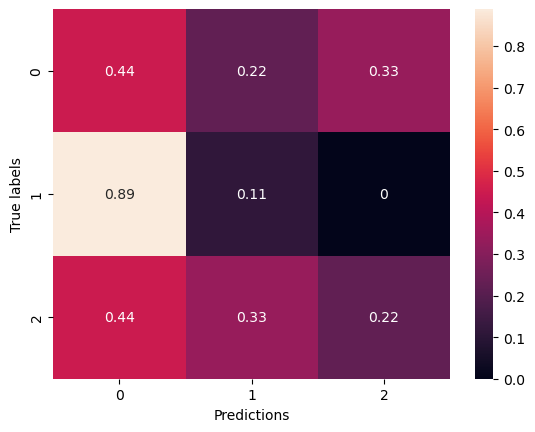

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▆▇▇▇▇█▆▇▇▇▇▇█▇▇▇▇█▇▇▇▇▇▇█▇▇▇▇▇▇▇██
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▄▅▆▂▄▇▅▅▂▅▄█▇▄▂▃▇▅█▄▅▅▇▆▄▄▆█▅█▂▇▆▆▆▄▇▃
val_loss,█▄▂▁▁▁▁▁▁▁▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:48:41.926209: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:48:41.928173: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:48:41.929958: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:48:43.533454: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:48:43.535476: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:48:43.537432: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:48:47.781864: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:48:48.371423: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 44.6496 - accuracy: 0.4224

2024-03-12 21:48:51.838141: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:48:51.839583: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:48:51.841630: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 390ms/step - loss: 44.6496 - accuracy: 0.4224 - val_loss: 30.9205 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 132ms/step - loss: 23.6283 - accuracy: 0.5571 - val_loss: 17.2020 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 133ms/step - loss: 12.7086 - accuracy: 0.6598 - val_loss: 10.1209 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 130ms/step - loss: 7.8818 - accuracy: 0.6644 - val_loss: 7.3848 - val_accuracy: 0.1481
Epoch 5/100
7/7 [==============================] - 1s 130ms/step - loss: 5.6046 - accuracy: 0.7466 - val_loss: 5.4242 - val_accuracy: 0.3056
Epoch 6/100
7/7 [==============================] - 1s 133ms/step - loss: 4.3165 - accuracy: 0.7557 - val_loss: 4.4127 - val_accuracy: 0.3796
Epoch 7/100
7/7 [==============================] - 1s 132ms/step - loss: 3.5212 - accuracy: 0.7648 - val_loss: 3.7668 - val_accuracy: 0.4074
Epoch 8/100
7/7 [=

Epoch 59/100
7/7 [==============================] - 1s 132ms/step - loss: 1.6414 - accuracy: 0.8402 - val_loss: 5.2766 - val_accuracy: 0.1852
Epoch 60/100
7/7 [==============================] - 1s 142ms/step - loss: 1.7913 - accuracy: 0.8105 - val_loss: 3.6354 - val_accuracy: 0.3148
Epoch 61/100
7/7 [==============================] - 1s 149ms/step - loss: 1.8383 - accuracy: 0.7945 - val_loss: 4.4567 - val_accuracy: 0.2593
Epoch 62/100
7/7 [==============================] - 1s 138ms/step - loss: 1.7397 - accuracy: 0.8470 - val_loss: 2.6886 - val_accuracy: 0.5185
Epoch 63/100
7/7 [==============================] - 1s 162ms/step - loss: 1.7174 - accuracy: 0.8265 - val_loss: 3.5734 - val_accuracy: 0.3333
Epoch 64/100
7/7 [==============================] - 1s 138ms/step - loss: 1.6686 - accuracy: 0.8676 - val_loss: 2.6503 - val_accuracy: 0.5741
Epoch 65/100
7/7 [==============================] - 1s 140ms/step - loss: 1.8236 - accuracy: 0.8196 - val_loss: 3.4508 - val_accuracy: 0.2870
Epoch 

2024-03-12 21:50:24.795119: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:50:24.796671: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:50:24.798725: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.489182949066162 s
{'0': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '1': {'precision': 0.25, 'recall': 0.1111111111111111, 'f1-score': 0.15384615384615383, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.8888888888888888, 'f1-score': 0.5925925925925926, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.36481481481481487, 'recall': 0.4074074074074074, 'f1-score': 0.34405101071767735, 'support': 27}, 'weighted avg': {'precision': 0.3648148148148148, 'recall': 0.4074074074074074, 'f1-score': 0.34405101071767735, 'support': 27}}


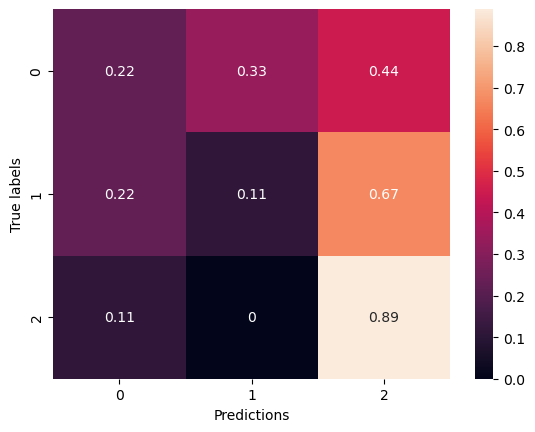

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▅▆▆▇▇▇█▇▇▇▇▇▇█▇▇▇▇█▇██▇▇██▇▇▇█▇█▇▇▇██▇█
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▅▇█▅▅▅▆▄▇▄▆▇▆▅▂▆▅█▇▄▇▂▃█▆▇▇▅▆▃▆▅▅▆▇█▅▇
val_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:50:48.799935: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:50:48.802357: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:50:48.804110: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:50:50.463578: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:50:50.465365: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:50:50.467358: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:50:55.751294: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:50:56.332720: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 9.4367 - accuracy: 0.3447

2024-03-12 21:50:59.907707: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:50:59.909361: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:50:59.911504: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 394ms/step - loss: 9.4367 - accuracy: 0.3447 - val_loss: 8.5779 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 132ms/step - loss: 8.5322 - accuracy: 0.4658 - val_loss: 8.2203 - val_accuracy: 0.1389
Epoch 3/100
7/7 [==============================] - 1s 132ms/step - loss: 7.7898 - accuracy: 0.5046 - val_loss: 8.0975 - val_accuracy: 0.1481
Epoch 4/100
7/7 [==============================] - 1s 133ms/step - loss: 7.1970 - accuracy: 0.5137 - val_loss: 7.6792 - val_accuracy: 0.1296
Epoch 5/100
7/7 [==============================] - 1s 131ms/step - loss: 6.4646 - accuracy: 0.5890 - val_loss: 7.4120 - val_accuracy: 0.1296
Epoch 6/100
7/7 [==============================] - 1s 131ms/step - loss: 5.8074 - accuracy: 0.6005 - val_loss: 6.1867 - val_accuracy: 0.1944
Epoch 7/100
7/7 [==============================] - 1s 132ms/step - loss: 5.2134 - accuracy: 0.6347 - val_loss: 5.3914 - val_accuracy: 0.3426
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 136ms/step - loss: 1.3106 - accuracy: 0.9155 - val_loss: 3.1530 - val_accuracy: 0.5741
Epoch 60/100
7/7 [==============================] - 1s 135ms/step - loss: 1.3543 - accuracy: 0.9041 - val_loss: 2.8666 - val_accuracy: 0.5926
Epoch 61/100
7/7 [==============================] - 1s 135ms/step - loss: 1.4642 - accuracy: 0.8653 - val_loss: 3.3384 - val_accuracy: 0.5463
Epoch 62/100
7/7 [==============================] - 1s 152ms/step - loss: 1.5472 - accuracy: 0.8539 - val_loss: 3.2162 - val_accuracy: 0.4444
Epoch 63/100
7/7 [==============================] - 1s 156ms/step - loss: 1.6208 - accuracy: 0.8516 - val_loss: 3.3829 - val_accuracy: 0.3796
Epoch 64/100
7/7 [==============================] - 1s 138ms/step - loss: 1.6925 - accuracy: 0.8516 - val_loss: 3.1342 - val_accuracy: 0.4352
Epoch 65/100
7/7 [==============================] - 1s 132ms/step - loss: 1.5228 - accuracy: 0.9178 - val_loss: 3.1699 - val_accuracy: 0.4630
Epoch 

2024-03-12 21:52:34.488445: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:52:34.490411: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:52:34.492761: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5254411697387695 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.2857142857142857, 'recall': 0.4444444444444444, 'f1-score': 0.34782608695652173, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.48412698412698413, 'recall': 0.40740740740740744, 'f1-score': 0.40249173658784637, 'support': 27}, 'weighted avg': {'precision': 0.48412698412698413, 'recall': 0.4074074074074074, 'f1-score': 0.4024917365878464, 'support': 27}}


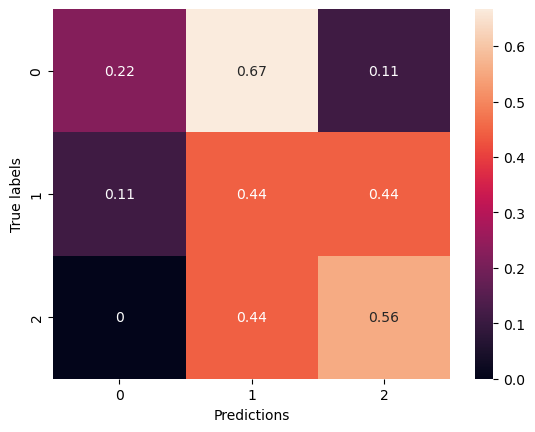

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▇▇▇▇▇▇▇▇██▇████▇▇█▇▇█▇███▇█████▇█▇
training_loss,█▇▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▆▆▆█▅▇▆█▆▆▇▄▆▆▇▅▇▇▇▆██▆▆▄▄▅▃▄▅▄▃▇█▃▇▅
val_loss,█▇▅▄▂▂▂▂▁▁▁▁▂▁▃▂▂▁▂▁▂▁▁▂▂▂▂▂▂▂▄▂▂▂▄▁▂▃▁▂


Epoch 1/100


2024-03-12 21:52:59.838945: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:52:59.840524: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:52:59.843070: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:53:01.465881: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:53:01.468844: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:53:01.471064: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:53:05.674720: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:53:06.259330: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 34.4079 - accuracy: 0.4155

2024-03-12 21:53:09.745195: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:53:09.746774: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:53:09.748763: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 395ms/step - loss: 34.4079 - accuracy: 0.4155 - val_loss: 27.1297 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 137ms/step - loss: 22.4612 - accuracy: 0.5205 - val_loss: 18.4364 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 154ms/step - loss: 15.5468 - accuracy: 0.5297 - val_loss: 13.5475 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 133ms/step - loss: 11.0734 - accuracy: 0.5799 - val_loss: 10.2071 - val_accuracy: 0.1389
Epoch 5/100
7/7 [==============================] - 1s 133ms/step - loss: 8.2137 - accuracy: 0.6370 - val_loss: 7.6788 - val_accuracy: 0.1759
Epoch 6/100
7/7 [==============================] - 1s 133ms/step - loss: 6.2618 - accuracy: 0.6621 - val_loss: 5.8083 - val_accuracy: 0.3889
Epoch 7/100
7/7 [==============================] - 1s 150ms/step - loss: 4.9261 - accuracy: 0.6986 - val_loss: 5.3505 - val_accuracy: 0.2315
Epoch 8/100
7/7 

Epoch 59/100
7/7 [==============================] - 1s 133ms/step - loss: 1.7947 - accuracy: 0.8037 - val_loss: 2.7760 - val_accuracy: 0.4444
Epoch 60/100
7/7 [==============================] - 1s 131ms/step - loss: 1.8118 - accuracy: 0.7968 - val_loss: 4.3529 - val_accuracy: 0.2685
Epoch 61/100
7/7 [==============================] - 1s 135ms/step - loss: 1.8911 - accuracy: 0.7763 - val_loss: 3.6921 - val_accuracy: 0.2407
Epoch 62/100
7/7 [==============================] - 1s 133ms/step - loss: 1.8781 - accuracy: 0.8242 - val_loss: 4.1814 - val_accuracy: 0.2685
Epoch 63/100
7/7 [==============================] - 1s 144ms/step - loss: 1.8794 - accuracy: 0.8242 - val_loss: 3.0993 - val_accuracy: 0.4352
Epoch 64/100
7/7 [==============================] - 1s 131ms/step - loss: 1.9367 - accuracy: 0.7854 - val_loss: 5.3974 - val_accuracy: 0.1667
Epoch 65/100
7/7 [==============================] - 1s 134ms/step - loss: 2.0800 - accuracy: 0.7511 - val_loss: 5.2224 - val_accuracy: 0.1296
Epoch 

2024-03-12 21:54:44.168614: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:54:44.170463: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:54:44.172366: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5073518753051758 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.4444444444444444, 'f1-score': 0.380952380952381, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.5555555555555556, 'f1-score': 0.4166666666666667, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.2222222222222222, 'recall': 0.3333333333333333, 'f1-score': 0.26587301587301587, 'support': 27}, 'weighted avg': {'precision': 0.2222222222222222, 'recall': 0.3333333333333333, 'f1-score': 0.26587301587301587, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


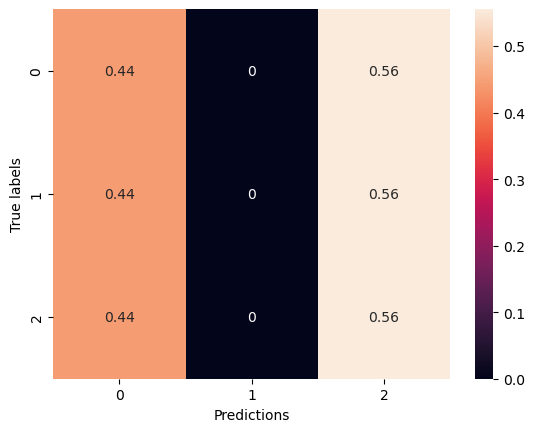

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇██▇▇▇▇█▇▆▇█▇▇▇▇▇█▆█
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▅▅▅▆▅█▅▅▅▆█▁█▆██▇▇▆▇▇▆▃▂▂▆█▁▅▇▇▆▆▆▅▅▅▅
val_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:55:08.278197: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:55:08.280525: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:55:08.282392: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:55:11.102909: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:55:11.104665: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:55:11.107146: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:55:15.269481: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:55:15.849187: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 45.7190 - accuracy: 0.3539

2024-03-12 21:55:19.292673: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:55:19.294303: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:55:19.296053: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 389ms/step - loss: 45.7190 - accuracy: 0.3539 - val_loss: 32.3232 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 132ms/step - loss: 26.1931 - accuracy: 0.4612 - val_loss: 19.5543 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 134ms/step - loss: 15.5594 - accuracy: 0.5502 - val_loss: 12.5264 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 133ms/step - loss: 10.1995 - accuracy: 0.5685 - val_loss: 8.6430 - val_accuracy: 0.2037
Epoch 5/100
7/7 [==============================] - 1s 133ms/step - loss: 7.3361 - accuracy: 0.6370 - val_loss: 6.9328 - val_accuracy: 0.1667
Epoch 6/100
7/7 [==============================] - 1s 133ms/step - loss: 5.6616 - accuracy: 0.6210 - val_loss: 5.9318 - val_accuracy: 0.1667
Epoch 7/100
7/7 [==============================] - 1s 158ms/step - loss: 4.5159 - accuracy: 0.6849 - val_loss: 5.2061 - val_accuracy: 0.1944
Epoch 8/100
7/7 [

Epoch 59/100
7/7 [==============================] - 1s 133ms/step - loss: 1.9228 - accuracy: 0.7808 - val_loss: 3.2844 - val_accuracy: 0.4630
Epoch 60/100
7/7 [==============================] - 1s 132ms/step - loss: 2.1248 - accuracy: 0.7557 - val_loss: 2.9824 - val_accuracy: 0.5000
Epoch 61/100
7/7 [==============================] - 1s 132ms/step - loss: 2.2911 - accuracy: 0.7557 - val_loss: 3.2821 - val_accuracy: 0.5093
Epoch 62/100
7/7 [==============================] - 1s 136ms/step - loss: 2.3015 - accuracy: 0.7443 - val_loss: 3.3525 - val_accuracy: 0.4074
Epoch 63/100
7/7 [==============================] - 1s 134ms/step - loss: 2.0243 - accuracy: 0.8333 - val_loss: 3.1186 - val_accuracy: 0.4630
Epoch 64/100
7/7 [==============================] - 1s 132ms/step - loss: 1.8967 - accuracy: 0.8128 - val_loss: 3.2658 - val_accuracy: 0.3241
Epoch 65/100
7/7 [==============================] - 1s 134ms/step - loss: 1.9188 - accuracy: 0.7603 - val_loss: 3.2287 - val_accuracy: 0.3611
Epoch 

2024-03-12 21:56:54.231608: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:56:54.233148: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:56:54.235142: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4808790683746338 s
{'0': {'precision': 0.3888888888888889, 'recall': 0.7777777777777778, 'f1-score': 0.5185185185185185, 'support': 9}, '1': {'precision': 0.16666666666666666, 'recall': 0.1111111111111111, 'f1-score': 0.13333333333333333, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.2962962962962963, 'recall': 0.3333333333333333, 'f1-score': 0.2728395061728395, 'support': 27}, 'weighted avg': {'precision': 0.2962962962962963, 'recall': 0.3333333333333333, 'f1-score': 0.2728395061728395, 'support': 27}}


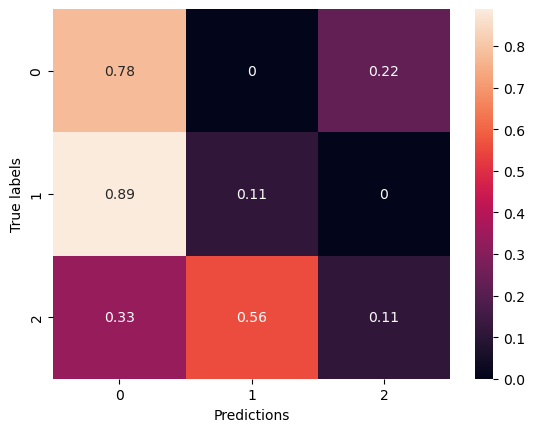

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇▇▇█▇▆▇▇▇▆▇▇▇▇███▇▇█▇▇██▇▇█▇█▇█▇▇█
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▆▆▄▅▆▄█▅▇▇▃▂▄▇▅▄▆▇▁▄▆▇▄▃▅▇▅▇▆▅██▅▇▆▃▄
val_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 21:57:17.196184: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:57:17.198756: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:57:17.201886: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:57:18.888463: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:57:18.890348: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:57:18.892245: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 21:57:23.056420: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 21:57:23.640025: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 9.4552 - accuracy: 0.3676

2024-03-12 21:57:28.060161: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:57:28.061722: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:57:28.063630: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 554ms/step - loss: 9.4552 - accuracy: 0.3676 - val_loss: 8.5746 - val_accuracy: 0.3426
Epoch 2/100
7/7 [==============================] - 1s 132ms/step - loss: 8.6914 - accuracy: 0.4064 - val_loss: 8.7322 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 132ms/step - loss: 8.1392 - accuracy: 0.3790 - val_loss: 8.1089 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 132ms/step - loss: 7.4531 - accuracy: 0.4201 - val_loss: 7.6442 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 132ms/step - loss: 6.8460 - accuracy: 0.4041 - val_loss: 7.2784 - val_accuracy: 0.1204
Epoch 6/100
7/7 [==============================] - 1s 141ms/step - loss: 6.2696 - accuracy: 0.4498 - val_loss: 6.8213 - val_accuracy: 0.1204
Epoch 7/100
7/7 [==============================] - 1s 132ms/step - loss: 5.7373 - accuracy: 0.4589 - val_loss: 6.4224 - val_accuracy: 0.1296
Epoch 8/100
7/7 [=======

Epoch 59/100
7/7 [==============================] - 1s 138ms/step - loss: 1.5502 - accuracy: 0.8356 - val_loss: 2.5464 - val_accuracy: 0.5000
Epoch 60/100
7/7 [==============================] - 1s 146ms/step - loss: 1.5353 - accuracy: 0.8311 - val_loss: 2.4707 - val_accuracy: 0.5370
Epoch 61/100
7/7 [==============================] - 1s 133ms/step - loss: 1.4748 - accuracy: 0.8584 - val_loss: 2.5021 - val_accuracy: 0.5741
Epoch 62/100
7/7 [==============================] - 1s 137ms/step - loss: 1.4940 - accuracy: 0.8059 - val_loss: 2.6750 - val_accuracy: 0.5093
Epoch 63/100
7/7 [==============================] - 1s 131ms/step - loss: 1.4461 - accuracy: 0.8539 - val_loss: 2.5727 - val_accuracy: 0.5648
Epoch 64/100
7/7 [==============================] - 1s 131ms/step - loss: 1.4624 - accuracy: 0.8562 - val_loss: 2.5788 - val_accuracy: 0.5926
Epoch 65/100
7/7 [==============================] - 1s 135ms/step - loss: 1.4463 - accuracy: 0.8311 - val_loss: 2.3581 - val_accuracy: 0.6111
Epoch 

2024-03-12 21:59:01.791163: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 21:59:01.793468: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 21:59:01.795203: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4928309917449951 s
{'0': {'precision': 0.38095238095238093, 'recall': 0.8888888888888888, 'f1-score': 0.5333333333333333, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.3333333333333333, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.39999999999999997, 'support': 27}, 'weighted avg': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.4, 'support': 27}}


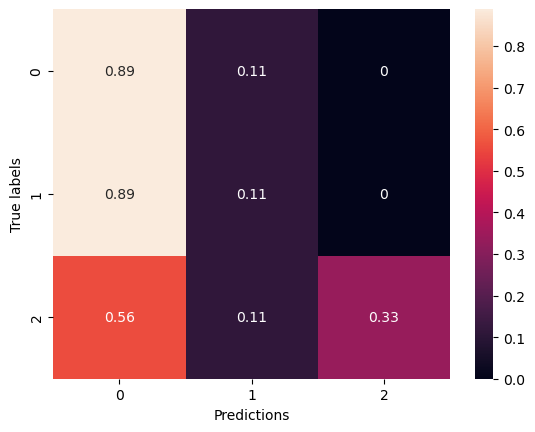

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▄▃▄▅▅▅▅▆▇▇▅▆▇▇▇▇▇▇▇▇███▇█▇▇█▇▇█▇▇▇▆▆▇
training_loss,█▇▅▄▃▃▂▂▂▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂
training_time,▁
val_accuracy,▄▁▁▁▃▃▃▆▅▆▇▇▇▆▇▆▇▆▅▆▇▇▄▇██▆█▇▇▄▆▅▆▇▆▃▂▅▃
val_loss,█▇▆▅▃▃▃▂▂▁▁▁▁▂▂▂▁▁▂▁▁▁▂▁▁▁▁▁▁▂▂▂▂▁▁▁▂▃▂▃


Epoch 1/100


2024-03-12 22:01:23.076968: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:01:23.078842: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:01:23.080796: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:01:24.753343: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:01:24.755859: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:01:24.757871: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:01:29.457340: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:01:30.072840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 35.1782 - accuracy: 0.3059

2024-03-12 22:01:33.531946: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:01:33.533539: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:01:33.536034: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 388ms/step - loss: 35.1782 - accuracy: 0.3059 - val_loss: 26.9608 - val_accuracy: 0.3241
Epoch 2/100
7/7 [==============================] - 1s 133ms/step - loss: 23.8340 - accuracy: 0.3311 - val_loss: 19.0021 - val_accuracy: 0.1574
Epoch 3/100
7/7 [==============================] - 1s 132ms/step - loss: 16.8207 - accuracy: 0.4087 - val_loss: 14.2033 - val_accuracy: 0.1111
Epoch 4/100
7/7 [==============================] - 1s 131ms/step - loss: 12.3564 - accuracy: 0.4566 - val_loss: 10.9780 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 131ms/step - loss: 9.3955 - accuracy: 0.4954 - val_loss: 9.0096 - val_accuracy: 0.1204
Epoch 6/100
7/7 [==============================] - 1s 131ms/step - loss: 7.4508 - accuracy: 0.5183 - val_loss: 7.6849 - val_accuracy: 0.1296
Epoch 7/100
7/7 [==============================] - 1s 134ms/step - loss: 6.0991 - accuracy: 0.4795 - val_loss: 6.3226 - val_accuracy: 0.1389
Epoch 8/100
7/7 

Epoch 59/100
7/7 [==============================] - 1s 132ms/step - loss: 2.4676 - accuracy: 0.6279 - val_loss: 3.2460 - val_accuracy: 0.4074
Epoch 60/100
7/7 [==============================] - 1s 132ms/step - loss: 2.5302 - accuracy: 0.6621 - val_loss: 3.1314 - val_accuracy: 0.3981
Epoch 61/100
7/7 [==============================] - 1s 131ms/step - loss: 2.4008 - accuracy: 0.6918 - val_loss: 3.2836 - val_accuracy: 0.4537
Epoch 62/100
7/7 [==============================] - 1s 131ms/step - loss: 2.1813 - accuracy: 0.7580 - val_loss: 2.7916 - val_accuracy: 0.4907
Epoch 63/100
7/7 [==============================] - 1s 133ms/step - loss: 2.1081 - accuracy: 0.7215 - val_loss: 3.1107 - val_accuracy: 0.4630
Epoch 64/100
7/7 [==============================] - 1s 132ms/step - loss: 2.2117 - accuracy: 0.7169 - val_loss: 4.9047 - val_accuracy: 0.1944
Epoch 65/100
7/7 [==============================] - 1s 132ms/step - loss: 2.3753 - accuracy: 0.7123 - val_loss: 3.1639 - val_accuracy: 0.4907
Epoch 

2024-03-12 22:03:06.397033: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:03:06.398774: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:03:06.400944: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4828660488128662 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '2': {'precision': 0.34615384615384615, 'recall': 1.0, 'f1-score': 0.5142857142857142, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.44871794871794873, 'recall': 0.3703703703703704, 'f1-score': 0.23809523809523805, 'support': 27}, 'weighted avg': {'precision': 0.4487179487179487, 'recall': 0.37037037037037035, 'f1-score': 0.23809523809523808, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


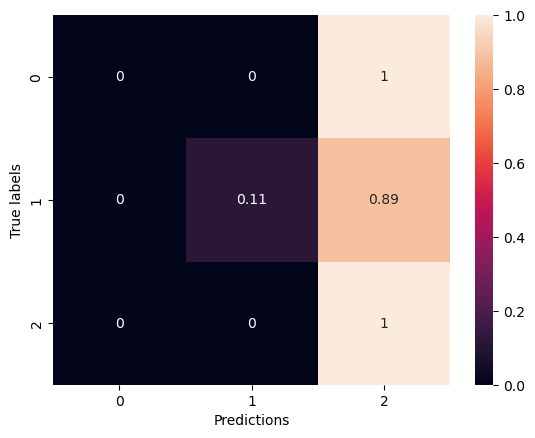

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▅▇▆▇▇▇▆▇▇▇▇▇▆▇▆▇▇█▇▆▇▇▇███▇▇▇▆█▇█▇▇▇
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▁▂▅▇▄▆▇▇▇▇▃▇▇▃▇▆▇█▁▆▅▅▆▂▁▅▇▆▄▄▂▄▂▇▅▄▆█
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▂▂▁▁▁▁▁▂▁▂▁▁▁▁▁


Epoch 1/100


2024-03-12 22:03:29.803146: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:03:29.804751: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:03:29.806774: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:03:31.416184: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:03:31.418020: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:03:31.420079: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:03:36.691305: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:03:37.271741: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 46.3260 - accuracy: 0.3356

2024-03-12 22:03:40.724324: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:03:40.726581: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:03:40.728333: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 395ms/step - loss: 46.3260 - accuracy: 0.3356 - val_loss: 33.4426 - val_accuracy: 0.3241
Epoch 2/100
7/7 [==============================] - 1s 132ms/step - loss: 28.2051 - accuracy: 0.3744 - val_loss: 21.5684 - val_accuracy: 0.1574
Epoch 3/100
7/7 [==============================] - 1s 138ms/step - loss: 18.3283 - accuracy: 0.4018 - val_loss: 15.3990 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 133ms/step - loss: 12.9740 - accuracy: 0.3927 - val_loss: 11.4810 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 130ms/step - loss: 9.8361 - accuracy: 0.4566 - val_loss: 8.6890 - val_accuracy: 0.2315
Epoch 6/100
7/7 [==============================] - 1s 134ms/step - loss: 7.7983 - accuracy: 0.4749 - val_loss: 7.4337 - val_accuracy: 0.1944
Epoch 7/100
7/7 [==============================] - 1s 161ms/step - loss: 6.3343 - accuracy: 0.5342 - val_loss: 5.8087 - val_accuracy: 0.3796
Epoch 8/100
7/7 

Epoch 59/100
7/7 [==============================] - 1s 134ms/step - loss: 2.3868 - accuracy: 0.6735 - val_loss: 5.5163 - val_accuracy: 0.1204
Epoch 60/100
7/7 [==============================] - 1s 130ms/step - loss: 2.5503 - accuracy: 0.7055 - val_loss: 3.2084 - val_accuracy: 0.4907
Epoch 61/100
7/7 [==============================] - 1s 131ms/step - loss: 2.3965 - accuracy: 0.7397 - val_loss: 2.9179 - val_accuracy: 0.5833
Epoch 62/100
7/7 [==============================] - 1s 131ms/step - loss: 2.2304 - accuracy: 0.7443 - val_loss: 3.0171 - val_accuracy: 0.3704
Epoch 63/100
7/7 [==============================] - 1s 131ms/step - loss: 2.0422 - accuracy: 0.7237 - val_loss: 4.1082 - val_accuracy: 0.2130
Epoch 64/100
7/7 [==============================] - 1s 131ms/step - loss: 2.0147 - accuracy: 0.7603 - val_loss: 2.7429 - val_accuracy: 0.5093
Epoch 65/100
7/7 [==============================] - 1s 143ms/step - loss: 2.0678 - accuracy: 0.7397 - val_loss: 2.9957 - val_accuracy: 0.4815
Epoch 

2024-03-12 22:05:15.954546: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:05:15.956847: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:05:15.958411: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.515460729598999 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.35294117647058826, 'recall': 0.6666666666666666, 'f1-score': 0.46153846153846156, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.599128540305011, 'recall': 0.4074074074074074, 'f1-score': 0.3686609686609687, 'support': 27}, 'weighted avg': {'precision': 0.5991285403050108, 'recall': 0.4074074074074074, 'f1-score': 0.36866096866096865, 'support': 27}}


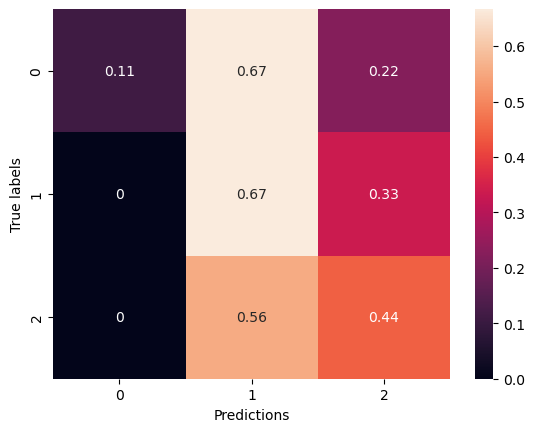

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▅▆▆▆▇▆▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇██▇█▇███▇▇█▇▆▄▅▆
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▂▇▆▅▆▅▁▆▅▄▇▂▇▇▅▄▅▄▆▃▂▁█▇▅▇▅▅█▄▇▅▄▅▆▄▄▅
val_loss,█▄▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 22:05:40.818533: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:05:40.820431: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:05:40.822263: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:05:42.466440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:05:42.468238: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:05:42.470608: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:05:46.607608: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:05:47.217536: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 10.6550 - accuracy: 0.4612

2024-03-12 22:05:51.207161: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:05:51.208778: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:05:51.211184: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 461ms/step - loss: 10.6550 - accuracy: 0.4612 - val_loss: 10.8901 - val_accuracy: 0.1481
Epoch 2/100
7/7 [==============================] - 1s 191ms/step - loss: 9.3528 - accuracy: 0.5776 - val_loss: 9.5995 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 194ms/step - loss: 8.1241 - accuracy: 0.6735 - val_loss: 8.7837 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 194ms/step - loss: 7.0808 - accuracy: 0.7489 - val_loss: 7.7780 - val_accuracy: 0.1481
Epoch 5/100
7/7 [==============================] - 1s 193ms/step - loss: 6.0002 - accuracy: 0.7922 - val_loss: 7.1233 - val_accuracy: 0.1574
Epoch 6/100
7/7 [==============================] - 1s 209ms/step - loss: 5.0503 - accuracy: 0.8447 - val_loss: 5.7921 - val_accuracy: 0.2407
Epoch 7/100
7/7 [==============================] - 2s 263ms/step - loss: 4.2056 - accuracy: 0.8653 - val_loss: 6.1567 - val_accuracy: 0.1852
Epoch 8/100
7/7 [=====

Epoch 59/100
7/7 [==============================] - 1s 178ms/step - loss: 1.6928 - accuracy: 0.8402 - val_loss: 2.8754 - val_accuracy: 0.5463
Epoch 60/100
7/7 [==============================] - 1s 175ms/step - loss: 1.6860 - accuracy: 0.9087 - val_loss: 3.5122 - val_accuracy: 0.3889
Epoch 61/100
7/7 [==============================] - 1s 173ms/step - loss: 1.6569 - accuracy: 0.9178 - val_loss: 3.4814 - val_accuracy: 0.4815
Epoch 62/100
7/7 [==============================] - 1s 174ms/step - loss: 1.5566 - accuracy: 0.9406 - val_loss: 3.5375 - val_accuracy: 0.4537
Epoch 63/100
7/7 [==============================] - 1s 185ms/step - loss: 1.5077 - accuracy: 0.9224 - val_loss: 4.2288 - val_accuracy: 0.3611
Epoch 64/100
7/7 [==============================] - 1s 179ms/step - loss: 1.4842 - accuracy: 0.9475 - val_loss: 4.3405 - val_accuracy: 0.3333
Epoch 65/100
7/7 [==============================] - 1s 175ms/step - loss: 1.5045 - accuracy: 0.9338 - val_loss: 4.6804 - val_accuracy: 0.3241
Epoch 

2024-03-12 22:08:00.324163: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:08:00.326507: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:08:00.328046: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5027201175689697 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '2': {'precision': 0.4090909090909091, 'recall': 1.0, 'f1-score': 0.5806451612903226, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.7196969696969697, 'recall': 0.48148148148148145, 'f1-score': 0.4140612076095947, 'support': 27}, 'weighted avg': {'precision': 0.7196969696969697, 'recall': 0.48148148148148145, 'f1-score': 0.41406120760959475, 'support': 27}}


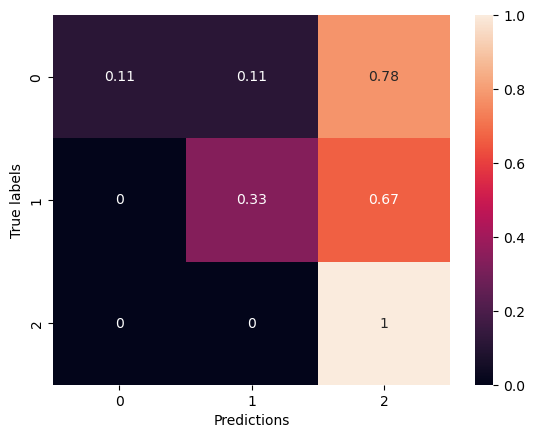

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▇▆▇▇▇█▇▇▇▇██▇▇▇▇▇▇▇█▆▇█▇▇▇▇▇█▇▇█▆▇█▇▇
training_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▁
training_time,▁
val_accuracy,▁▁▃▄█▇▇▇▇▇▄▅▄▇▇▆▆▆▄▅▆▆▇▇▆▄▅▅▄▇▅▄▇▇▄▄▅▆▆█
val_loss,█▆▄▃▂▂▁▁▂▁▂▂▂▁▁▂▁▂▂▂▂▁▁▁▂▂▂▂▂▁▂▃▁▁▂▂▂▂▂▁


Epoch 1/100


2024-03-12 22:08:23.687086: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:08:23.689213: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:08:23.690701: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:08:26.468531: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:08:26.470363: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:08:26.472547: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:08:30.591912: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:08:31.171110: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 39.6996 - accuracy: 0.4703

2024-03-12 22:08:34.905529: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:08:34.907114: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:08:34.909483: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 452ms/step - loss: 39.6996 - accuracy: 0.4703 - val_loss: 28.9310 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 177ms/step - loss: 22.2202 - accuracy: 0.5982 - val_loss: 18.4723 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 176ms/step - loss: 13.1281 - accuracy: 0.6507 - val_loss: 11.2009 - val_accuracy: 0.1019
Epoch 4/100
7/7 [==============================] - 1s 180ms/step - loss: 8.7410 - accuracy: 0.6895 - val_loss: 8.8953 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 174ms/step - loss: 6.4622 - accuracy: 0.7374 - val_loss: 6.9123 - val_accuracy: 0.1296
Epoch 6/100
7/7 [==============================] - 1s 177ms/step - loss: 4.7945 - accuracy: 0.8082 - val_loss: 5.0331 - val_accuracy: 0.4074
Epoch 7/100
7/7 [==============================] - 1s 174ms/step - loss: 3.8032 - accuracy: 0.7808 - val_loss: 4.5311 - val_accuracy: 0.1759
Epoch 8/100
7/7 [=

Epoch 59/100
7/7 [==============================] - 1s 196ms/step - loss: 1.5170 - accuracy: 0.9132 - val_loss: 3.5749 - val_accuracy: 0.3796
Epoch 60/100
7/7 [==============================] - 1s 219ms/step - loss: 1.6357 - accuracy: 0.8425 - val_loss: 3.5774 - val_accuracy: 0.3889
Epoch 61/100
7/7 [==============================] - 1s 177ms/step - loss: 1.8754 - accuracy: 0.8174 - val_loss: 4.0059 - val_accuracy: 0.3796
Epoch 62/100
7/7 [==============================] - 1s 178ms/step - loss: 2.0787 - accuracy: 0.8082 - val_loss: 3.7536 - val_accuracy: 0.3241
Epoch 63/100
7/7 [==============================] - 1s 179ms/step - loss: 2.0376 - accuracy: 0.8676 - val_loss: 3.6985 - val_accuracy: 0.3426
Epoch 64/100
7/7 [==============================] - 1s 177ms/step - loss: 1.7544 - accuracy: 0.9087 - val_loss: 3.1317 - val_accuracy: 0.5093
Epoch 65/100
7/7 [==============================] - 1s 177ms/step - loss: 1.7067 - accuracy: 0.8311 - val_loss: 2.8265 - val_accuracy: 0.5833
Epoch 

2024-03-12 22:10:41.357932: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:10:41.360445: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:10:41.362688: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.7195451259613037 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.6666666666666666, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.43333333333333335, 'recall': 0.40740740740740744, 'f1-score': 0.36762360446570974, 'support': 27}, 'weighted avg': {'precision': 0.4333333333333333, 'recall': 0.4074074074074074, 'f1-score': 0.36762360446570974, 'support': 27}}


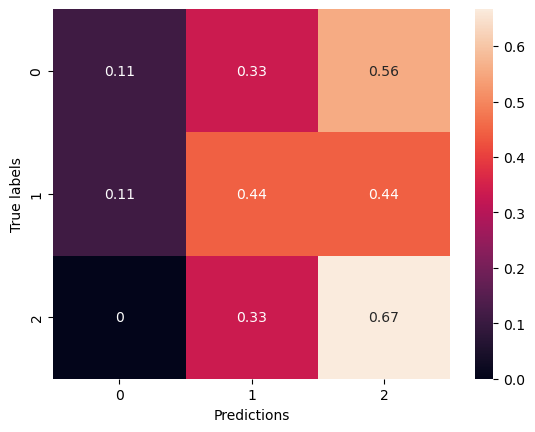

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▆▇▇▇▇▇▇▇▅▇▇▆▆▆▆▆▇▇▇█▆█▇▇▇▆▇▇▇▇▇▇▇▇▆▆
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▆▇▇▆▆▆▆▄▆▅▆▅█▃▇▄█▇▄▄▅▅▅▇▅▆▇▅▆▇▇▆█▅▃▄▅▇
val_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 22:11:04.957403: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:11:04.959486: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:11:04.961122: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:11:06.722389: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:11:06.724606: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:11:06.726731: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:11:10.879758: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:11:11.458055: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 52.8203 - accuracy: 0.4429

2024-03-12 22:11:16.232095: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:11:16.233737: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:11:16.235702: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 442ms/step - loss: 52.8203 - accuracy: 0.4429 - val_loss: 35.2771 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 212ms/step - loss: 25.3575 - accuracy: 0.6301 - val_loss: 17.5613 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 191ms/step - loss: 12.8600 - accuracy: 0.7009 - val_loss: 10.5517 - val_accuracy: 0.1481
Epoch 4/100
7/7 [==============================] - 1s 200ms/step - loss: 8.2744 - accuracy: 0.6849 - val_loss: 9.1145 - val_accuracy: 0.1019
Epoch 5/100
7/7 [==============================] - 1s 206ms/step - loss: 6.2398 - accuracy: 0.7352 - val_loss: 6.0879 - val_accuracy: 0.3981
Epoch 6/100
7/7 [==============================] - 1s 189ms/step - loss: 4.8634 - accuracy: 0.7443 - val_loss: 5.8261 - val_accuracy: 0.1389
Epoch 7/100
7/7 [==============================] - 1s 192ms/step - loss: 3.8083 - accuracy: 0.7626 - val_loss: 3.8510 - val_accuracy: 0.5833
Epoch 8/100
7/7 [=

Epoch 59/100
7/7 [==============================] - 1s 175ms/step - loss: 1.7730 - accuracy: 0.8493 - val_loss: 3.6547 - val_accuracy: 0.3056
Epoch 60/100
7/7 [==============================] - 1s 181ms/step - loss: 1.6752 - accuracy: 0.8676 - val_loss: 3.3176 - val_accuracy: 0.4074
Epoch 61/100
7/7 [==============================] - 1s 173ms/step - loss: 1.7907 - accuracy: 0.8242 - val_loss: 3.0379 - val_accuracy: 0.4907
Epoch 62/100
7/7 [==============================] - 1s 183ms/step - loss: 1.8514 - accuracy: 0.8265 - val_loss: 3.0933 - val_accuracy: 0.5463
Epoch 63/100
7/7 [==============================] - 1s 178ms/step - loss: 1.9807 - accuracy: 0.8174 - val_loss: 4.2604 - val_accuracy: 0.2870
Epoch 64/100
7/7 [==============================] - 1s 173ms/step - loss: 1.8800 - accuracy: 0.8379 - val_loss: 3.5060 - val_accuracy: 0.3426
Epoch 65/100
7/7 [==============================] - 1s 177ms/step - loss: 1.7403 - accuracy: 0.8470 - val_loss: 3.6696 - val_accuracy: 0.3426
Epoch 

2024-03-12 22:13:24.773005: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:13:24.774630: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:13:24.776670: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4910621643066406 s
{'0': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, '1': {'precision': 0.36363636363636365, 'recall': 0.4444444444444444, 'f1-score': 0.39999999999999997, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.49728049728049734, 'recall': 0.4444444444444445, 'f1-score': 0.4262626262626263, 'support': 27}, 'weighted avg': {'precision': 0.4972804972804973, 'recall': 0.4444444444444444, 'f1-score': 0.4262626262626263, 'support': 27}}


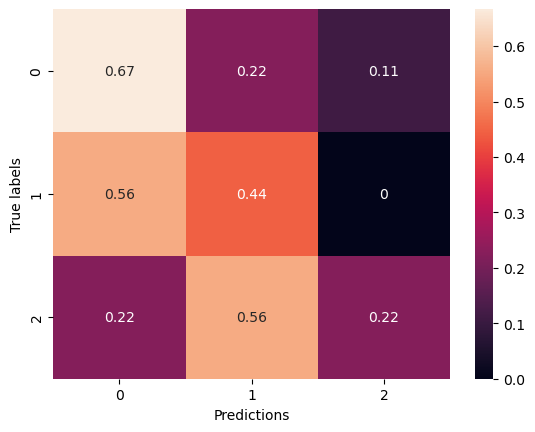

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▅▆▆▇▇▆▆▆▇▆▇▇▆▇▇▇▇▇▇▆▇▆▇▇▇▇▇▇▇▇█▇▇█▇███▇
training_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▇▇▅▇▄▇▅█▆▇▄▇▆▅▆▄▆▃▅▇▄▆▄▅▆▆▇▆▅▅▄▆▄▃▅▇▃
val_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁


Epoch 1/100


2024-03-12 22:13:49.016408: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:13:49.018274: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:13:49.020129: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:13:50.644671: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:13:50.646876: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:13:50.648615: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:13:54.916974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:13:55.503400: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 10.8982 - accuracy: 0.4064

2024-03-12 22:13:59.519603: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:13:59.521877: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:13:59.523430: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 489ms/step - loss: 10.8982 - accuracy: 0.4064 - val_loss: 10.6700 - val_accuracy: 0.1296
Epoch 2/100
7/7 [==============================] - 1s 175ms/step - loss: 9.9164 - accuracy: 0.5160 - val_loss: 11.4608 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 176ms/step - loss: 9.0329 - accuracy: 0.5890 - val_loss: 9.7985 - val_accuracy: 0.1389
Epoch 4/100
7/7 [==============================] - 1s 173ms/step - loss: 8.2104 - accuracy: 0.6027 - val_loss: 9.1866 - val_accuracy: 0.1481
Epoch 5/100
7/7 [==============================] - 1s 174ms/step - loss: 7.3566 - accuracy: 0.6438 - val_loss: 8.7834 - val_accuracy: 0.1296
Epoch 6/100
7/7 [==============================] - 1s 175ms/step - loss: 6.5381 - accuracy: 0.6826 - val_loss: 7.4056 - val_accuracy: 0.1944
Epoch 7/100
7/7 [==============================] - 1s 177ms/step - loss: 5.7521 - accuracy: 0.6895 - val_loss: 6.4405 - val_accuracy: 0.2407
Epoch 8/100
7/7 [====

Epoch 59/100
7/7 [==============================] - 1s 178ms/step - loss: 1.6805 - accuracy: 0.8973 - val_loss: 3.2850 - val_accuracy: 0.5833
Epoch 60/100
7/7 [==============================] - 1s 181ms/step - loss: 1.7102 - accuracy: 0.8973 - val_loss: 3.1312 - val_accuracy: 0.5370
Epoch 61/100
7/7 [==============================] - 1s 179ms/step - loss: 1.6184 - accuracy: 0.9110 - val_loss: 3.1382 - val_accuracy: 0.5648
Epoch 62/100
7/7 [==============================] - 1s 174ms/step - loss: 1.6446 - accuracy: 0.8950 - val_loss: 3.4314 - val_accuracy: 0.3796
Epoch 63/100
7/7 [==============================] - 1s 174ms/step - loss: 1.5677 - accuracy: 0.9178 - val_loss: 3.7130 - val_accuracy: 0.4167
Epoch 64/100
7/7 [==============================] - 1s 175ms/step - loss: 1.6450 - accuracy: 0.8858 - val_loss: 4.2194 - val_accuracy: 0.3426
Epoch 65/100
7/7 [==============================] - 1s 175ms/step - loss: 1.7575 - accuracy: 0.8676 - val_loss: 4.0582 - val_accuracy: 0.3148
Epoch 

2024-03-12 22:16:03.504486: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:16:03.506542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:16:03.508428: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5026299953460693 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.375, 'recall': 1.0, 'f1-score': 0.5454545454545454, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.34722222222222215, 'recall': 0.40740740740740744, 'f1-score': 0.2929292929292929, 'support': 27}, 'weighted avg': {'precision': 0.3472222222222222, 'recall': 0.4074074074074074, 'f1-score': 0.2929292929292929, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


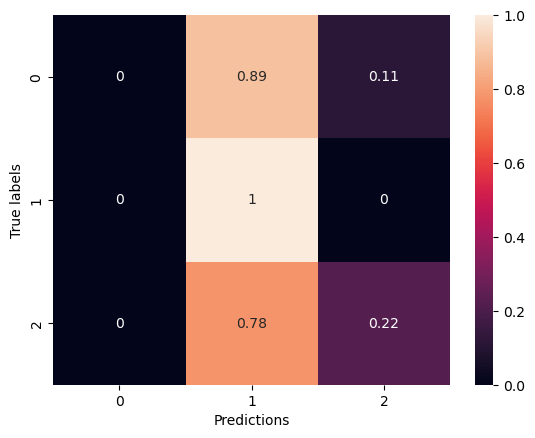

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▆▇▆▇▇▇▇▇█▇▇█▇████▇███▇█▇▇█████████▇█
training_loss,█▇▅▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▂▅▅▆▅▆▇▇▇█▄▄▆▅▇▅▄▅▇▇▇▇▄▃▅▅▄▅▄▅▆▇▆▇▇▇▅
val_loss,█▇▅▄▂▂▂▂▂▁▁▁▁▂▂▁▂▁▂▂▂▁▂▁▁▂▃▁▁▂▂▂▂▂▁▂▁▂▁▂


Epoch 1/100


2024-03-12 22:16:28.944896: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:16:28.946811: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:16:28.948995: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:16:30.570389: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:16:30.572201: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:16:30.573904: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:16:35.738694: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:16:36.319140: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 40.3047 - accuracy: 0.4269

2024-03-12 22:16:40.088903: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:16:40.090434: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:16:40.092995: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 431ms/step - loss: 40.3047 - accuracy: 0.4269 - val_loss: 30.8119 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 173ms/step - loss: 24.6260 - accuracy: 0.5365 - val_loss: 20.4230 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 177ms/step - loss: 16.2023 - accuracy: 0.5571 - val_loss: 14.6315 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 174ms/step - loss: 11.4733 - accuracy: 0.6164 - val_loss: 11.0337 - val_accuracy: 0.1296
Epoch 5/100
7/7 [==============================] - 1s 179ms/step - loss: 8.7117 - accuracy: 0.6461 - val_loss: 7.8665 - val_accuracy: 0.4815
Epoch 6/100
7/7 [==============================] - 1s 189ms/step - loss: 6.7288 - accuracy: 0.7055 - val_loss: 7.9487 - val_accuracy: 0.1389
Epoch 7/100
7/7 [==============================] - 1s 174ms/step - loss: 5.3448 - accuracy: 0.7352 - val_loss: 5.1946 - val_accuracy: 0.6296
Epoch 8/100
7/7 

Epoch 59/100
7/7 [==============================] - 1s 176ms/step - loss: 2.9991 - accuracy: 0.7352 - val_loss: 3.8596 - val_accuracy: 0.3611
Epoch 60/100
7/7 [==============================] - 1s 178ms/step - loss: 2.8117 - accuracy: 0.8059 - val_loss: 3.4126 - val_accuracy: 0.5370
Epoch 61/100
7/7 [==============================] - 1s 178ms/step - loss: 2.4032 - accuracy: 0.8174 - val_loss: 3.2362 - val_accuracy: 0.5000
Epoch 62/100
7/7 [==============================] - 1s 174ms/step - loss: 2.2141 - accuracy: 0.8265 - val_loss: 3.9613 - val_accuracy: 0.2315
Epoch 63/100
7/7 [==============================] - 2s 218ms/step - loss: 2.3418 - accuracy: 0.7900 - val_loss: 3.4209 - val_accuracy: 0.5741
Epoch 64/100
7/7 [==============================] - 1s 177ms/step - loss: 2.3466 - accuracy: 0.7854 - val_loss: 3.2908 - val_accuracy: 0.4167
Epoch 65/100
7/7 [==============================] - 1s 177ms/step - loss: 2.2303 - accuracy: 0.8174 - val_loss: 3.3554 - val_accuracy: 0.4074
Epoch 

2024-03-12 22:18:44.058034: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:18:44.060114: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:18:44.061666: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4981400966644287 s
{'0': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '1': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.4317460317460317, 'recall': 0.4444444444444445, 'f1-score': 0.4146825396825397, 'support': 27}, 'weighted avg': {'precision': 0.43174603174603177, 'recall': 0.4444444444444444, 'f1-score': 0.41468253968253965, 'support': 27}}


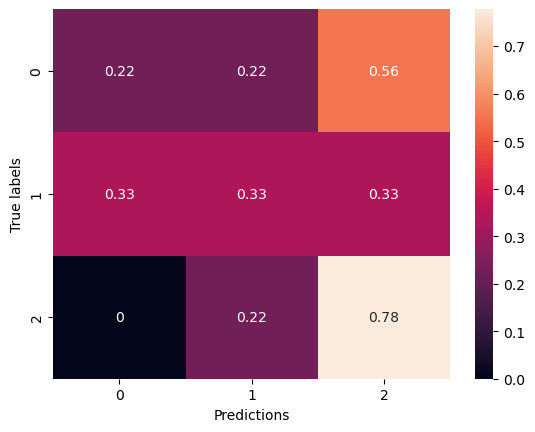

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▇▇▆▇▇▇▇▇▇▆▇▇▇▇▇▇▇▆▇▆▇▇▇▇▇▆█▇▇▇▇▇▇▇▇█
training_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▅▅▆▁▂▆▅▂▆██▆▄▆▅█▆█▁▅▅▇▆▇▇▂█▇▃▅▅▅▆▄▅▆▅
val_loss,█▄▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 22:19:08.981172: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:19:08.982875: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:19:08.984961: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:19:10.595458: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:19:10.597730: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:19:10.599614: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:19:14.786241: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:19:15.371283: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 53.2073 - accuracy: 0.4247

2024-03-12 22:19:19.166606: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:19:19.170188: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:19:19.172116: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 437ms/step - loss: 53.2073 - accuracy: 0.4247 - val_loss: 37.0932 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 178ms/step - loss: 27.9745 - accuracy: 0.5205 - val_loss: 21.0509 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 175ms/step - loss: 16.0156 - accuracy: 0.5822 - val_loss: 14.2803 - val_accuracy: 0.1296
Epoch 4/100
7/7 [==============================] - 1s 175ms/step - loss: 10.7982 - accuracy: 0.6279 - val_loss: 9.9952 - val_accuracy: 0.1944
Epoch 5/100
7/7 [==============================] - 1s 174ms/step - loss: 8.0578 - accuracy: 0.6712 - val_loss: 8.0086 - val_accuracy: 0.2778
Epoch 6/100
7/7 [==============================] - 1s 175ms/step - loss: 6.2847 - accuracy: 0.6804 - val_loss: 6.8232 - val_accuracy: 0.2407
Epoch 7/100
7/7 [==============================] - 1s 176ms/step - loss: 4.9484 - accuracy: 0.7169 - val_loss: 5.2646 - val_accuracy: 0.3241
Epoch 8/100
7/7 [

Epoch 59/100
7/7 [==============================] - 1s 177ms/step - loss: 2.5551 - accuracy: 0.6986 - val_loss: 5.7469 - val_accuracy: 0.1389
Epoch 60/100
7/7 [==============================] - 1s 178ms/step - loss: 2.7700 - accuracy: 0.7603 - val_loss: 4.3572 - val_accuracy: 0.2963
Epoch 61/100
7/7 [==============================] - 1s 180ms/step - loss: 2.5022 - accuracy: 0.8037 - val_loss: 3.9263 - val_accuracy: 0.3426
Epoch 62/100
7/7 [==============================] - 1s 175ms/step - loss: 2.2576 - accuracy: 0.8014 - val_loss: 3.1042 - val_accuracy: 0.5370
Epoch 63/100
7/7 [==============================] - 1s 176ms/step - loss: 2.2346 - accuracy: 0.7626 - val_loss: 3.4522 - val_accuracy: 0.4444
Epoch 64/100
7/7 [==============================] - 1s 186ms/step - loss: 2.4041 - accuracy: 0.7397 - val_loss: 4.8858 - val_accuracy: 0.1481
Epoch 65/100
7/7 [==============================] - 1s 174ms/step - loss: 2.4725 - accuracy: 0.7329 - val_loss: 3.3902 - val_accuracy: 0.4722
Epoch 

2024-03-12 22:21:23.739934: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:21:23.741821: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:21:23.743721: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.49959397315979 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.7777777777777778, 'f1-score': 0.4666666666666666, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.3333333333333333, 'recall': 0.40740740740740744, 'f1-score': 0.3333333333333333, 'support': 27}, 'weighted avg': {'precision': 0.3333333333333333, 'recall': 0.4074074074074074, 'f1-score': 0.3333333333333333, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


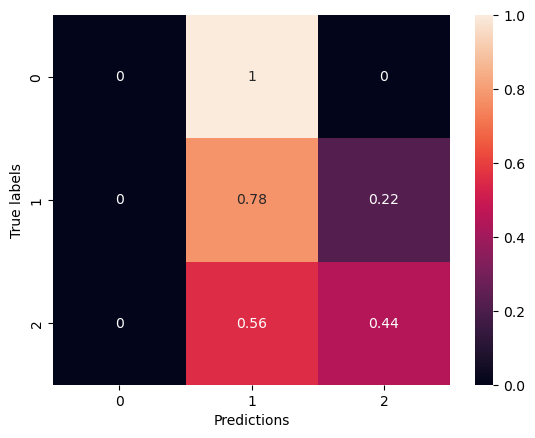

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇▇▇▇▆▇▇▇▇▇▆▇▆█▇██▆█▆▇▇▆▇█▇▇▇▇█▇▆█▅
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▃▄▃▅▂▇▄▆▂▇▆▃█▄▆▅▇▃▄▃▅▁▄▁▃▆▃▅▃▆▇▅▃▅▇▄▄▄
val_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁


Epoch 1/100


2024-03-12 22:21:50.689180: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:21:50.691100: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:21:50.692984: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:21:52.341782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:21:52.344210: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:21:52.346030: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:21:56.537625: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:21:57.121703: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 11.0812 - accuracy: 0.3037

2024-03-12 22:22:00.985046: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:22:00.986704: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:22:00.988649: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 448ms/step - loss: 11.0812 - accuracy: 0.3037 - val_loss: 10.3614 - val_accuracy: 0.1759
Epoch 2/100
7/7 [==============================] - 1s 172ms/step - loss: 10.2393 - accuracy: 0.4110 - val_loss: 10.3920 - val_accuracy: 0.1296
Epoch 3/100
7/7 [==============================] - 1s 175ms/step - loss: 9.5759 - accuracy: 0.4361 - val_loss: 10.0387 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 171ms/step - loss: 8.8897 - accuracy: 0.4521 - val_loss: 9.8400 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 173ms/step - loss: 8.2240 - accuracy: 0.4840 - val_loss: 8.6452 - val_accuracy: 0.1204
Epoch 6/100
7/7 [==============================] - 1s 173ms/step - loss: 7.5026 - accuracy: 0.4977 - val_loss: 7.7852 - val_accuracy: 0.1574
Epoch 7/100
7/7 [==============================] - 1s 174ms/step - loss: 6.7371 - accuracy: 0.5525 - val_loss: 6.4855 - val_accuracy: 0.5370
Epoch 8/100
7/7 [==

Epoch 59/100
7/7 [==============================] - 1s 177ms/step - loss: 1.8641 - accuracy: 0.8516 - val_loss: 3.2809 - val_accuracy: 0.4074
Epoch 60/100
7/7 [==============================] - 1s 173ms/step - loss: 1.9035 - accuracy: 0.8014 - val_loss: 3.0749 - val_accuracy: 0.5648
Epoch 61/100
7/7 [==============================] - 1s 174ms/step - loss: 1.9928 - accuracy: 0.7603 - val_loss: 3.0417 - val_accuracy: 0.5648
Epoch 62/100
7/7 [==============================] - 1s 176ms/step - loss: 2.0019 - accuracy: 0.8082 - val_loss: 2.9263 - val_accuracy: 0.5741
Epoch 63/100
7/7 [==============================] - 1s 175ms/step - loss: 2.0635 - accuracy: 0.8470 - val_loss: 3.2414 - val_accuracy: 0.5370
Epoch 64/100
7/7 [==============================] - 1s 172ms/step - loss: 2.1439 - accuracy: 0.7763 - val_loss: 3.9959 - val_accuracy: 0.3426
Epoch 65/100
7/7 [==============================] - 1s 176ms/step - loss: 2.0513 - accuracy: 0.8059 - val_loss: 3.5648 - val_accuracy: 0.4259
Epoch 

2024-03-12 22:24:03.169970: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:24:03.171706: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:24:03.173807: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4976093769073486 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.8888888888888888, 'f1-score': 0.5517241379310346, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.35555555555555557, 'recall': 0.4444444444444444, 'f1-score': 0.3616858237547893, 'support': 27}, 'weighted avg': {'precision': 0.35555555555555557, 'recall': 0.4444444444444444, 'f1-score': 0.36168582375478925, 'support': 27}}


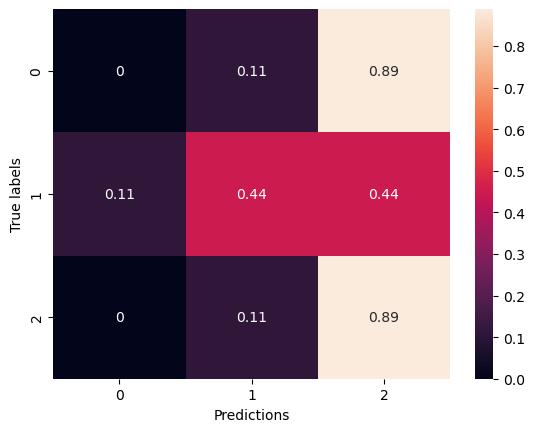

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▃▄▅▆▆▆▇▆▇▇▇▇▇█▇▇▇▇▇▇▇█▇▇███▇██▇██▇█▇▇█
training_loss,█▇▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂
training_time,▁
val_accuracy,▂▁▂█▇▄▅▅▇▇▅█▅█▅▅▇▁▅▅███▅█▄▆▄▆▅▇▅▇▆▂▂▄▇▅█
val_loss,██▆▄▃▃▂▂▂▁▂▁▂▁▂▂▁▄▂▂▁▁▁▂▁▂▂▂▂▂▁▂▁▂▃▄▂▁▂▁


Epoch 1/100


2024-03-12 22:24:27.650175: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:24:27.652293: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:24:27.653851: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:24:29.287384: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:24:29.289511: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:24:29.291629: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:24:33.562663: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:24:34.153960: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 40.6125 - accuracy: 0.3995

2024-03-12 22:24:38.899105: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:24:38.902895: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:24:38.904940: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 13s 457ms/step - loss: 40.6125 - accuracy: 0.3995 - val_loss: 32.1370 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 193ms/step - loss: 25.9792 - accuracy: 0.4224 - val_loss: 23.0975 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 175ms/step - loss: 18.2409 - accuracy: 0.4406 - val_loss: 16.5806 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 173ms/step - loss: 13.7414 - accuracy: 0.4749 - val_loss: 13.4244 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 175ms/step - loss: 10.7911 - accuracy: 0.5594 - val_loss: 11.9652 - val_accuracy: 0.1204
Epoch 6/100
7/7 [==============================] - 1s 176ms/step - loss: 8.7129 - accuracy: 0.5457 - val_loss: 10.8587 - val_accuracy: 0.1204
Epoch 7/100
7/7 [==============================] - 1s 182ms/step - loss: 6.9958 - accuracy: 0.6324 - val_loss: 9.4031 - val_accuracy: 0.1204
Epoch 8/100
7

Epoch 59/100
7/7 [==============================] - 1s 180ms/step - loss: 2.0673 - accuracy: 0.8105 - val_loss: 3.1881 - val_accuracy: 0.4444
Epoch 60/100
7/7 [==============================] - 1s 187ms/step - loss: 1.9841 - accuracy: 0.7763 - val_loss: 3.0998 - val_accuracy: 0.4722
Epoch 61/100
7/7 [==============================] - 1s 177ms/step - loss: 2.0553 - accuracy: 0.7671 - val_loss: 3.0030 - val_accuracy: 0.5556
Epoch 62/100
7/7 [==============================] - 1s 178ms/step - loss: 2.2341 - accuracy: 0.7603 - val_loss: 3.0603 - val_accuracy: 0.5370
Epoch 63/100
7/7 [==============================] - 1s 179ms/step - loss: 2.2364 - accuracy: 0.7671 - val_loss: 3.7158 - val_accuracy: 0.3333
Epoch 64/100
7/7 [==============================] - 1s 178ms/step - loss: 2.0792 - accuracy: 0.7671 - val_loss: 3.8224 - val_accuracy: 0.3611
Epoch 65/100
7/7 [==============================] - 1s 177ms/step - loss: 1.9872 - accuracy: 0.7785 - val_loss: 3.4975 - val_accuracy: 0.3611
Epoch 

2024-03-12 22:26:42.713092: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:26:42.715660: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:26:42.717398: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4925868511199951 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.28, 'recall': 0.7777777777777778, 'f1-score': 0.4117647058823529, 'support': 9}, '2': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, 'accuracy': 0.25925925925925924, 'macro avg': {'precision': 0.09333333333333334, 'recall': 0.25925925925925924, 'f1-score': 0.1372549019607843, 'support': 27}, 'weighted avg': {'precision': 0.09333333333333335, 'recall': 0.25925925925925924, 'f1-score': 0.1372549019607843, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


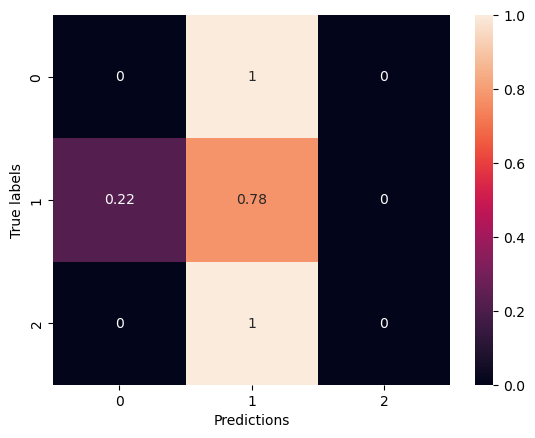

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▅▅▆▆▇▆▇▆▇▆▇▆▆▇▇▇▇▆▇▇█▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▇
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▂██▇▆▆▇█▇█▇▂▅▇█▅▇▇▇▆▇▄▃▇▆▃▅▂▇▃▃▄▄▆▄▄
val_loss,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 22:27:07.992898: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:27:07.994485: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:27:07.996462: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:27:09.615509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:27:09.617358: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:27:09.619327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:27:13.781427: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:27:14.362445: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


7/7 [==============================] - ETA: 0s - loss: 52.7734 - accuracy: 0.3699

2024-03-12 22:27:18.159005: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:27:18.160803: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:27:18.162747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

7/7 [==============================] - 12s 441ms/step - loss: 52.7734 - accuracy: 0.3699 - val_loss: 35.8473 - val_accuracy: 0.1204
Epoch 2/100
7/7 [==============================] - 1s 176ms/step - loss: 28.4455 - accuracy: 0.4201 - val_loss: 21.9760 - val_accuracy: 0.1204
Epoch 3/100
7/7 [==============================] - 1s 176ms/step - loss: 17.4314 - accuracy: 0.4909 - val_loss: 15.0376 - val_accuracy: 0.1204
Epoch 4/100
7/7 [==============================] - 1s 204ms/step - loss: 12.4358 - accuracy: 0.4886 - val_loss: 11.8622 - val_accuracy: 0.1204
Epoch 5/100
7/7 [==============================] - 1s 176ms/step - loss: 9.7939 - accuracy: 0.5525 - val_loss: 9.8960 - val_accuracy: 0.1296
Epoch 6/100
7/7 [==============================] - 1s 182ms/step - loss: 7.9109 - accuracy: 0.5594 - val_loss: 7.7593 - val_accuracy: 0.1852
Epoch 7/100
7/7 [==============================] - 1s 179ms/step - loss: 6.4322 - accuracy: 0.6233 - val_loss: 6.5322 - val_accuracy: 0.2407
Epoch 8/100
7/7 

Epoch 59/100
7/7 [==============================] - 1s 175ms/step - loss: 2.5148 - accuracy: 0.6781 - val_loss: 3.1549 - val_accuracy: 0.4259
Epoch 60/100
7/7 [==============================] - 1s 176ms/step - loss: 2.8756 - accuracy: 0.6781 - val_loss: 3.7438 - val_accuracy: 0.3241
Epoch 61/100
7/7 [==============================] - 1s 175ms/step - loss: 3.0241 - accuracy: 0.6872 - val_loss: 5.3942 - val_accuracy: 0.1296
Epoch 62/100
7/7 [==============================] - 1s 190ms/step - loss: 2.7497 - accuracy: 0.7078 - val_loss: 3.5377 - val_accuracy: 0.2870
Epoch 63/100
7/7 [==============================] - 1s 175ms/step - loss: 2.5678 - accuracy: 0.7032 - val_loss: 3.9841 - val_accuracy: 0.2315
Epoch 64/100
7/7 [==============================] - 1s 176ms/step - loss: 2.3829 - accuracy: 0.7397 - val_loss: 3.0313 - val_accuracy: 0.5278
Epoch 65/100
7/7 [==============================] - 1s 173ms/step - loss: 2.3633 - accuracy: 0.7306 - val_loss: 2.9492 - val_accuracy: 0.5556
Epoch 

2024-03-12 22:29:22.295400: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:29:22.297564: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:29:22.299217: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4865763187408447 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.8888888888888888, 'f1-score': 0.5925925925925926, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.2962962962962963, 'recall': 0.4444444444444444, 'f1-score': 0.345679012345679, 'support': 27}, 'weighted avg': {'precision': 0.2962962962962963, 'recall': 0.4444444444444444, 'f1-score': 0.345679012345679, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


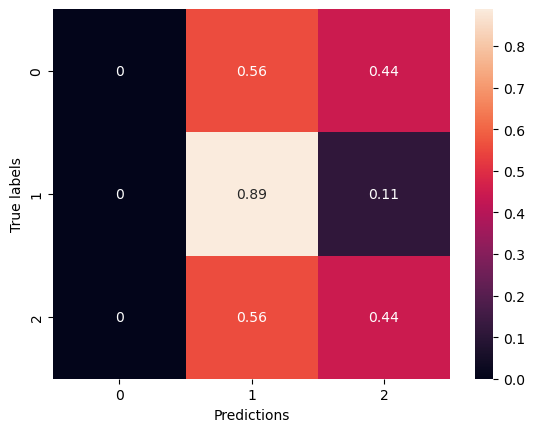

wandb: Network error (ConnectionError), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▆▇▇▇▆▆▆▇▆▇▆▆▅▇▇▇▇▆▆▇▆▇▆▇▆▇▆█▇▇▆▇▇▆
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▅▄▇▂▄▄▇▄▇▂▁▆█▇▇▆▇▂▂▆▆▁▇▆▆▇▆▆█▇▅▄▁▆▆▅▅
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁


Epoch 1/100


2024-03-12 22:31:55.623549: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:31:55.625185: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:31:55.627184: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:31:57.248503: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:31:57.251401: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:31:57.253260: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:32:02.526520: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:32:03.116433: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 7.1678 - accuracy: 0.4635

2024-03-12 22:32:06.175485: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:32:06.178013: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:32:06.179620: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 631ms/step - loss: 7.1678 - accuracy: 0.4635 - val_loss: 6.6599 - val_accuracy: 0.2593
Epoch 2/100
4/4 [==============================] - 1s 125ms/step - loss: 6.4117 - accuracy: 0.5639 - val_loss: 6.3712 - val_accuracy: 0.1574
Epoch 3/100
4/4 [==============================] - 0s 124ms/step - loss: 5.8549 - accuracy: 0.6187 - val_loss: 6.3783 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 1s 127ms/step - loss: 5.1330 - accuracy: 0.6895 - val_loss: 6.5924 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 168ms/step - loss: 4.7684 - accuracy: 0.6849 - val_loss: 6.1916 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 0s 123ms/step - loss: 4.3203 - accuracy: 0.7192 - val_loss: 5.9295 - val_accuracy: 0.1481
Epoch 7/100
4/4 [==============================] - 0s 123ms/step - loss: 3.9480 - accuracy: 0.7603 - val_loss: 5.6393 - val_accuracy: 0.1852
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 0s 121ms/step - loss: 0.7232 - accuracy: 0.9521 - val_loss: 3.1700 - val_accuracy: 0.5833
Epoch 60/100
4/4 [==============================] - 0s 124ms/step - loss: 0.7294 - accuracy: 0.9566 - val_loss: 3.2399 - val_accuracy: 0.5833
Epoch 61/100
4/4 [==============================] - 0s 120ms/step - loss: 0.6643 - accuracy: 0.9703 - val_loss: 3.1201 - val_accuracy: 0.5278
Epoch 62/100
4/4 [==============================] - 0s 125ms/step - loss: 0.7573 - accuracy: 0.9338 - val_loss: 3.0142 - val_accuracy: 0.4815
Epoch 63/100
4/4 [==============================] - 0s 124ms/step - loss: 0.7269 - accuracy: 0.9498 - val_loss: 3.1054 - val_accuracy: 0.5185
Epoch 64/100
4/4 [==============================] - 0s 124ms/step - loss: 0.6970 - accuracy: 0.9703 - val_loss: 3.0299 - val_accuracy: 0.5463
Epoch 65/100
4/4 [==============================] - 0s 124ms/step - loss: 0.6776 - accuracy: 0.9726 - val_loss: 2.9003 - val_accuracy: 0.5463
Epoch 

2024-03-12 22:32:56.975165: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:32:56.976989: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:32:56.978950: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.469754934310913 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '2': {'precision': 0.3888888888888889, 'recall': 0.7777777777777778, 'f1-score': 0.5185185185185185, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.42962962962962964, 'recall': 0.40740740740740744, 'f1-score': 0.3706417039750372, 'support': 27}, 'weighted avg': {'precision': 0.42962962962962964, 'recall': 0.4074074074074074, 'f1-score': 0.37064170397503726, 'support': 27}}


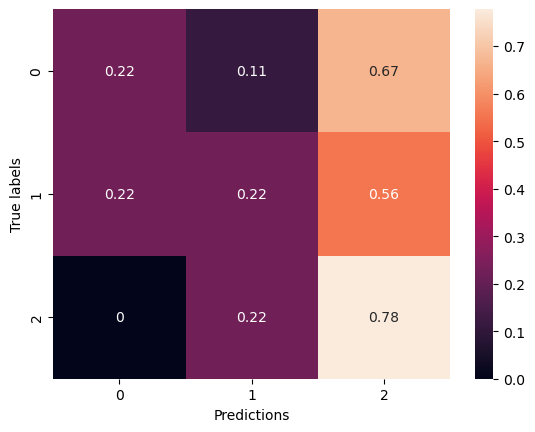

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▇▇█▇██▇▇███████▇▇███████████▇▇██████
training_loss,█▇▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▂▆▄▃▄▆▇▇▇▇▃▅▅▃▅▅▆█▇▇█▇▇▆▇█▇▇▅▄▇▇▄▆▇█▇
val_loss,██▇▅▃▃▃▄▂▁▁▁▁▄▃▂▆▄▂▂▁▁▂▂▂▂▂▂▁▁▂▃▃▁▁▄▂▂▂▁


Epoch 1/100


2024-03-12 22:33:23.903233: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:33:23.904808: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:33:23.906659: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:33:25.512947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:33:25.514790: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:33:25.517159: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:33:29.676724: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:33:30.258130: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 28.3888 - accuracy: 0.4018

2024-03-12 22:33:33.337867: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:33:33.339414: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:33:33.341539: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 657ms/step - loss: 28.3888 - accuracy: 0.4018 - val_loss: 23.0000 - val_accuracy: 0.2593
Epoch 2/100
4/4 [==============================] - 0s 125ms/step - loss: 20.9267 - accuracy: 0.5708 - val_loss: 17.1068 - val_accuracy: 0.2222
Epoch 3/100
4/4 [==============================] - 0s 125ms/step - loss: 15.3290 - accuracy: 0.6301 - val_loss: 13.0227 - val_accuracy: 0.1852
Epoch 4/100
4/4 [==============================] - 0s 124ms/step - loss: 11.0851 - accuracy: 0.7306 - val_loss: 10.0276 - val_accuracy: 0.1667
Epoch 5/100
4/4 [==============================] - 0s 125ms/step - loss: 8.2063 - accuracy: 0.7283 - val_loss: 7.5366 - val_accuracy: 0.1852
Epoch 6/100
4/4 [==============================] - 0s 125ms/step - loss: 6.1526 - accuracy: 0.7443 - val_loss: 5.9713 - val_accuracy: 0.2593
Epoch 7/100
4/4 [==============================] - 0s 125ms/step - loss: 4.8571 - accuracy: 0.7420 - val_loss: 6.0876 - val_accuracy: 0.1389
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 0s 124ms/step - loss: 1.1500 - accuracy: 0.9064 - val_loss: 3.2494 - val_accuracy: 0.4444
Epoch 60/100
4/4 [==============================] - 0s 126ms/step - loss: 1.2008 - accuracy: 0.8950 - val_loss: 3.1236 - val_accuracy: 0.4537
Epoch 61/100
4/4 [==============================] - 0s 124ms/step - loss: 1.2107 - accuracy: 0.9041 - val_loss: 4.4760 - val_accuracy: 0.2593
Epoch 62/100
4/4 [==============================] - 0s 122ms/step - loss: 1.2154 - accuracy: 0.9178 - val_loss: 2.7635 - val_accuracy: 0.5463
Epoch 63/100
4/4 [==============================] - 0s 124ms/step - loss: 1.2568 - accuracy: 0.9132 - val_loss: 2.6990 - val_accuracy: 0.5648
Epoch 64/100
4/4 [==============================] - 0s 125ms/step - loss: 1.2426 - accuracy: 0.8950 - val_loss: 2.8989 - val_accuracy: 0.5185
Epoch 65/100
4/4 [==============================] - 0s 123ms/step - loss: 1.2103 - accuracy: 0.9041 - val_loss: 2.8495 - val_accuracy: 0.5463
Epoch 

2024-03-12 22:34:24.596999: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:34:24.599217: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:34:24.600830: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4780762195587158 s
{'0': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '1': {'precision': 0.25, 'recall': 0.2222222222222222, 'f1-score': 0.23529411764705882, 'support': 9}, '2': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.40151515151515155, 'recall': 0.40740740740740744, 'f1-score': 0.40196078431372545, 'support': 27}, 'weighted avg': {'precision': 0.4015151515151515, 'recall': 0.4074074074074074, 'f1-score': 0.4019607843137255, 'support': 27}}


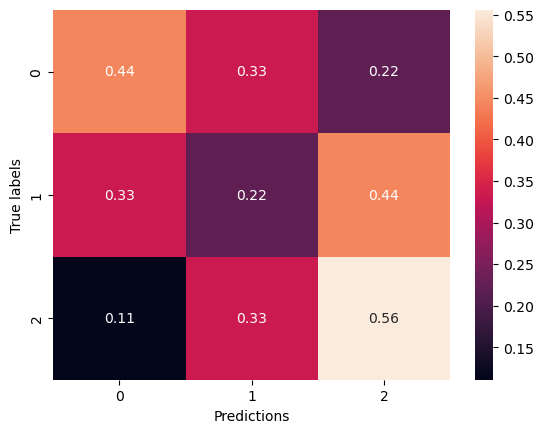

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇▇▇▇▇▇█▇▇█▇██████▇▇▇████▇▇████████
training_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▃▆█▇▆▃▅▅█▇▇▇▆▅▅▇▆▅▆▆▅▂▆▇▆▅▆▃▅▆▅▆▅▄▅▅▅
val_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 22:34:49.942820: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:34:49.944441: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:34:49.946509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:34:51.548895: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:34:51.551317: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:34:51.553067: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:34:55.693788: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:34:56.273158: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 38.2916 - accuracy: 0.4361

2024-03-12 22:34:59.336994: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:34:59.338587: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:34:59.340443: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 649ms/step - loss: 38.2916 - accuracy: 0.4361 - val_loss: 30.4778 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 0s 123ms/step - loss: 26.9891 - accuracy: 0.5571 - val_loss: 21.9278 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 127ms/step - loss: 18.7148 - accuracy: 0.6438 - val_loss: 16.0173 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 0s 122ms/step - loss: 12.7662 - accuracy: 0.7237 - val_loss: 11.4331 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 0s 124ms/step - loss: 8.7366 - accuracy: 0.7466 - val_loss: 8.7135 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 0s 124ms/step - loss: 6.2465 - accuracy: 0.7511 - val_loss: 6.7958 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 0s 124ms/step - loss: 4.6619 - accuracy: 0.8014 - val_loss: 5.3398 - val_accuracy: 0.1944
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 0s 121ms/step - loss: 1.4872 - accuracy: 0.8699 - val_loss: 3.4010 - val_accuracy: 0.3519
Epoch 60/100
4/4 [==============================] - 0s 123ms/step - loss: 1.3455 - accuracy: 0.9087 - val_loss: 3.2690 - val_accuracy: 0.3704
Epoch 61/100
4/4 [==============================] - 1s 145ms/step - loss: 1.2307 - accuracy: 0.9087 - val_loss: 3.5052 - val_accuracy: 0.3796
Epoch 62/100
4/4 [==============================] - 0s 120ms/step - loss: 1.1317 - accuracy: 0.9201 - val_loss: 2.9825 - val_accuracy: 0.4722
Epoch 63/100
4/4 [==============================] - 0s 121ms/step - loss: 1.1349 - accuracy: 0.9132 - val_loss: 3.6984 - val_accuracy: 0.3333
Epoch 64/100
4/4 [==============================] - 1s 123ms/step - loss: 1.1135 - accuracy: 0.9041 - val_loss: 3.4284 - val_accuracy: 0.4259
Epoch 65/100
4/4 [==============================] - 0s 122ms/step - loss: 1.3103 - accuracy: 0.8676 - val_loss: 3.0823 - val_accuracy: 0.3981
Epoch 

2024-03-12 22:35:50.602435: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:35:50.604064: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:35:50.605910: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5075018405914307 s
{'0': {'precision': 0.23076923076923078, 'recall': 0.3333333333333333, 'f1-score': 0.27272727272727276, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.23076923076923075, 'recall': 0.3333333333333333, 'f1-score': 0.27272727272727276, 'support': 27}, 'weighted avg': {'precision': 0.2307692307692308, 'recall': 0.3333333333333333, 'f1-score': 0.27272727272727276, 'support': 27}}


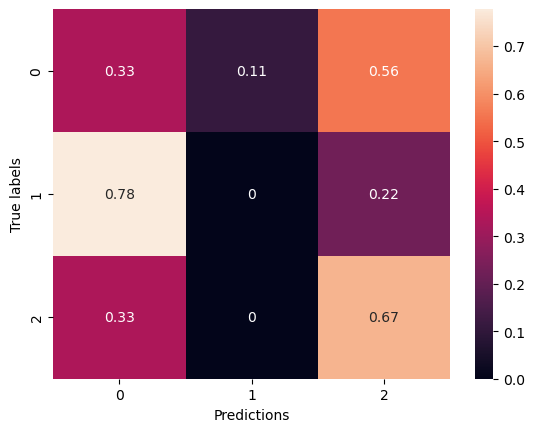

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇▇▇▇▇▇▇▇▇▇█▇▇██▇▇▇▇▇▇▇▇▇█▇▇███▇▇██
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▃▄▆▄▅▆█▄▆▄▆▆▅▄▆▇▅▇▄▃▄▅▅▆█▅▆▅▄▆▇▇▇▆▃▇▄
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 22:36:15.247095: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:36:15.249473: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:36:15.251841: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:36:17.581169: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:36:17.585147: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:36:17.588071: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:36:21.955380: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:36:23.551667: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 7.3972 - accuracy: 0.3813

2024-03-12 22:36:26.663153: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:36:26.665245: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:36:26.666946: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 654ms/step - loss: 7.3972 - accuracy: 0.3813 - val_loss: 7.2407 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 130ms/step - loss: 6.5878 - accuracy: 0.5046 - val_loss: 7.1786 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 0s 123ms/step - loss: 6.1130 - accuracy: 0.5297 - val_loss: 6.8699 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 127ms/step - loss: 5.8128 - accuracy: 0.5320 - val_loss: 6.3946 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 0s 124ms/step - loss: 5.4117 - accuracy: 0.5594 - val_loss: 6.5715 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 0s 124ms/step - loss: 4.9983 - accuracy: 0.5890 - val_loss: 6.3587 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 135ms/step - loss: 4.6613 - accuracy: 0.5913 - val_loss: 6.4477 - val_accuracy: 0.1296
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 0s 124ms/step - loss: 0.8804 - accuracy: 0.9452 - val_loss: 3.1896 - val_accuracy: 0.5648
Epoch 60/100
4/4 [==============================] - 0s 124ms/step - loss: 0.8294 - accuracy: 0.9635 - val_loss: 3.0652 - val_accuracy: 0.5556
Epoch 61/100
4/4 [==============================] - 0s 122ms/step - loss: 0.8474 - accuracy: 0.9406 - val_loss: 2.8507 - val_accuracy: 0.5556
Epoch 62/100
4/4 [==============================] - 0s 126ms/step - loss: 0.8118 - accuracy: 0.9566 - val_loss: 3.0245 - val_accuracy: 0.5370
Epoch 63/100
4/4 [==============================] - 0s 125ms/step - loss: 0.7821 - accuracy: 0.9566 - val_loss: 3.1592 - val_accuracy: 0.6111
Epoch 64/100
4/4 [==============================] - 0s 126ms/step - loss: 0.7734 - accuracy: 0.9475 - val_loss: 3.2394 - val_accuracy: 0.4352
Epoch 65/100
4/4 [==============================] - 0s 123ms/step - loss: 0.7792 - accuracy: 0.9521 - val_loss: 3.6056 - val_accuracy: 0.4074
Epoch 

2024-03-12 22:37:18.458065: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:37:18.459690: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:37:18.461655: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4753432273864746 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3684210526315789, 'recall': 0.7777777777777778, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.2894736842105263, 'recall': 0.40740740740740744, 'f1-score': 0.3235294117647059, 'support': 27}, 'weighted avg': {'precision': 0.2894736842105263, 'recall': 0.4074074074074074, 'f1-score': 0.32352941176470584, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


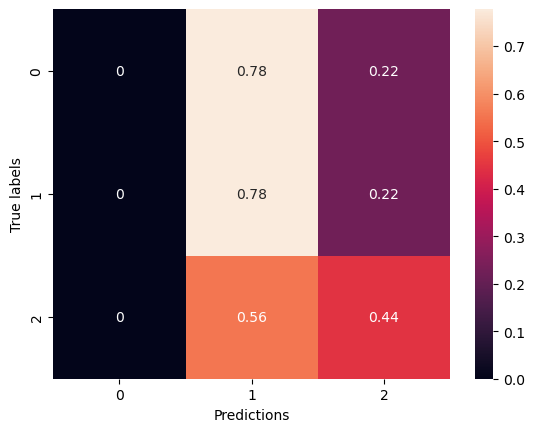

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▃▄▅▅▆▇▇▇▇▇▇▇▇█▇▇▇█▇▇██████▇▇▇█████▇▇██
training_loss,█▇▅▅▄▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▂▄██▇▄▇▇▇█▆▇▇▇█▆▆█▇█▇▆▆▆▇▅▆▇▄██▇▄▆▅▆
val_loss,█▇▇▇▅▃▂▂▂▃▂▂▂▂▂▂▂▂▁▂▂▁▁▂▂▂▂▂▁▃▂▂▃▂▁▂▃▂▂▂


Epoch 1/100


2024-03-12 22:37:42.225360: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:37:42.227017: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:37:42.228655: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:37:43.840871: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:37:43.843300: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:37:43.844910: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:37:48.275976: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:37:48.886432: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 28.2857 - accuracy: 0.4064

2024-03-12 22:37:51.977873: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:37:51.979458: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:37:51.981362: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 638ms/step - loss: 28.2857 - accuracy: 0.4064 - val_loss: 23.1819 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 159ms/step - loss: 21.0418 - accuracy: 0.5183 - val_loss: 17.7006 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 0s 124ms/step - loss: 15.8291 - accuracy: 0.4772 - val_loss: 13.7023 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 0s 124ms/step - loss: 11.7988 - accuracy: 0.5183 - val_loss: 10.3269 - val_accuracy: 0.1111
Epoch 5/100
4/4 [==============================] - 1s 133ms/step - loss: 8.9149 - accuracy: 0.5639 - val_loss: 7.9660 - val_accuracy: 0.1759
Epoch 6/100
4/4 [==============================] - 1s 128ms/step - loss: 6.7983 - accuracy: 0.6484 - val_loss: 6.7048 - val_accuracy: 0.1481
Epoch 7/100
4/4 [==============================] - 0s 124ms/step - loss: 5.4111 - accuracy: 0.6758 - val_loss: 5.7958 - val_accuracy: 0.1296
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 0s 121ms/step - loss: 1.4970 - accuracy: 0.8333 - val_loss: 2.5062 - val_accuracy: 0.5648
Epoch 60/100
4/4 [==============================] - 0s 125ms/step - loss: 1.4444 - accuracy: 0.8836 - val_loss: 2.5292 - val_accuracy: 0.5648
Epoch 61/100
4/4 [==============================] - 0s 122ms/step - loss: 1.3909 - accuracy: 0.8813 - val_loss: 2.6463 - val_accuracy: 0.5463
Epoch 62/100
4/4 [==============================] - 0s 121ms/step - loss: 1.2727 - accuracy: 0.9018 - val_loss: 2.5793 - val_accuracy: 0.5648
Epoch 63/100
4/4 [==============================] - 0s 121ms/step - loss: 1.1834 - accuracy: 0.9155 - val_loss: 3.1373 - val_accuracy: 0.4630
Epoch 64/100
4/4 [==============================] - 0s 120ms/step - loss: 1.1561 - accuracy: 0.8904 - val_loss: 2.8678 - val_accuracy: 0.5000
Epoch 65/100
4/4 [==============================] - 0s 121ms/step - loss: 1.2181 - accuracy: 0.8767 - val_loss: 2.8846 - val_accuracy: 0.4815
Epoch 

2024-03-12 22:38:42.239402: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:38:42.241143: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:38:42.243160: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4705500602722168 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.2, 'recall': 0.1111111111111111, 'f1-score': 0.14285714285714285, 'support': 9}, '2': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.3316239316239316, 'recall': 0.3703703703703704, 'f1-score': 0.34054834054834054, 'support': 27}, 'weighted avg': {'precision': 0.3316239316239316, 'recall': 0.37037037037037035, 'f1-score': 0.34054834054834054, 'support': 27}}


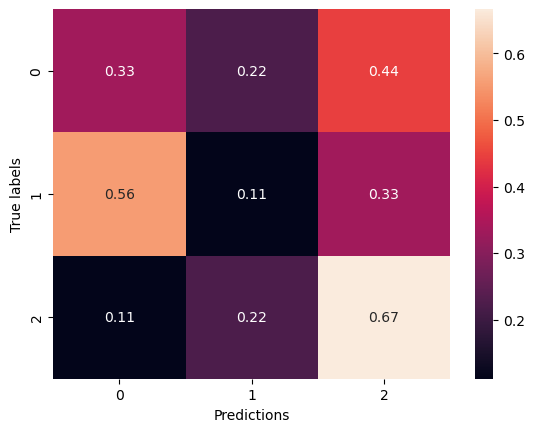

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▄▅▆▇▇▇▇▇▇▇▇▇▇▇███▇███▇▇█▇███▇▇▇██▇▇██▇
training_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▁▃▅▅▆▄▇▅▅▇█▆▇▇▆▇▅▄▇▇▇▇▆▆▅▆▆▅▆▆▇▅▄▅▆▇▆
val_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 22:39:05.508256: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:39:05.510257: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:39:05.511836: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:39:07.128498: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:39:07.130733: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:39:07.132816: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:39:12.374205: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:39:12.956302: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 38.5612 - accuracy: 0.4041

2024-03-12 22:39:16.009782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:39:16.011682: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:39:16.013549: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 638ms/step - loss: 38.5612 - accuracy: 0.4041 - val_loss: 30.3289 - val_accuracy: 0.1481
Epoch 2/100
4/4 [==============================] - 0s 122ms/step - loss: 27.3973 - accuracy: 0.4726 - val_loss: 21.9220 - val_accuracy: 0.1389
Epoch 3/100
4/4 [==============================] - 1s 205ms/step - loss: 19.1917 - accuracy: 0.5411 - val_loss: 16.1357 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 142ms/step - loss: 13.4842 - accuracy: 0.5434 - val_loss: 11.8974 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 0s 122ms/step - loss: 9.5109 - accuracy: 0.5845 - val_loss: 8.8834 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 0s 124ms/step - loss: 6.9399 - accuracy: 0.6073 - val_loss: 6.5789 - val_accuracy: 0.1296
Epoch 7/100
4/4 [==============================] - 1s 188ms/step - loss: 5.3518 - accuracy: 0.6553 - val_loss: 5.5334 - val_accuracy: 0.1481
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 0s 124ms/step - loss: 1.3688 - accuracy: 0.8037 - val_loss: 2.4651 - val_accuracy: 0.4537
Epoch 60/100
4/4 [==============================] - 1s 140ms/step - loss: 1.2870 - accuracy: 0.8379 - val_loss: 2.8058 - val_accuracy: 0.3889
Epoch 61/100
4/4 [==============================] - 1s 148ms/step - loss: 1.2734 - accuracy: 0.8493 - val_loss: 2.8642 - val_accuracy: 0.3704
Epoch 62/100
4/4 [==============================] - 1s 127ms/step - loss: 1.2574 - accuracy: 0.8539 - val_loss: 2.6873 - val_accuracy: 0.4815
Epoch 63/100
4/4 [==============================] - 1s 130ms/step - loss: 1.1995 - accuracy: 0.8790 - val_loss: 2.7919 - val_accuracy: 0.4907
Epoch 64/100
4/4 [==============================] - 1s 160ms/step - loss: 1.1765 - accuracy: 0.8813 - val_loss: 3.0866 - val_accuracy: 0.4352
Epoch 65/100
4/4 [==============================] - 1s 127ms/step - loss: 1.1479 - accuracy: 0.8904 - val_loss: 2.8679 - val_accuracy: 0.4630
Epoch 

2024-03-12 22:40:08.375414: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:40:08.377086: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:40:08.378999: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.467836856842041 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.625, 'recall': 0.5555555555555556, 'f1-score': 0.5882352941176471, 'support': 9}, '2': {'precision': 0.3684210526315789, 'recall': 0.7777777777777778, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.331140350877193, 'recall': 0.4444444444444445, 'f1-score': 0.36274509803921573, 'support': 27}, 'weighted avg': {'precision': 0.331140350877193, 'recall': 0.4444444444444444, 'f1-score': 0.3627450980392157, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


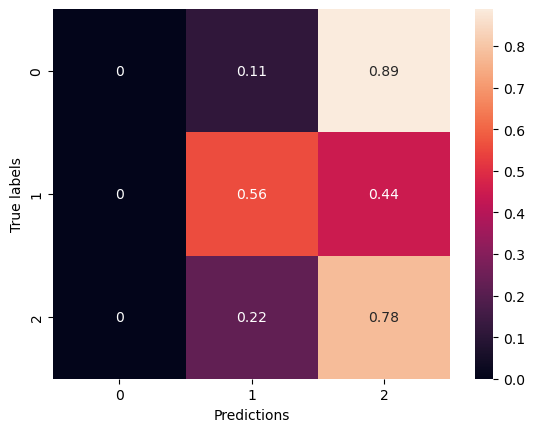

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇▇███▇██▇▇
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▅▆▄▆▇▅▇▅█▇█▇▆▇█▄▅▆▄▆▅▆▄▃▆▆▆▅▇▇▇▆▄▆▅█
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 22:40:35.541784: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:40:35.543758: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:40:35.545643: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:40:37.212400: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:40:37.214827: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:40:37.216658: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:40:41.658733: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:40:42.237617: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 7.3720 - accuracy: 0.3539

2024-03-12 22:40:45.450354: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:40:45.452227: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:40:45.454018: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 649ms/step - loss: 7.3720 - accuracy: 0.3539 - val_loss: 6.6288 - val_accuracy: 0.1667
Epoch 2/100
4/4 [==============================] - 1s 143ms/step - loss: 7.0122 - accuracy: 0.3790 - val_loss: 6.2738 - val_accuracy: 0.1944
Epoch 3/100
4/4 [==============================] - 1s 131ms/step - loss: 6.5877 - accuracy: 0.3744 - val_loss: 6.0566 - val_accuracy: 0.1759
Epoch 4/100
4/4 [==============================] - 1s 131ms/step - loss: 6.1946 - accuracy: 0.3767 - val_loss: 5.8167 - val_accuracy: 0.2130
Epoch 5/100
4/4 [==============================] - 1s 137ms/step - loss: 5.7989 - accuracy: 0.3813 - val_loss: 5.6272 - val_accuracy: 0.2222
Epoch 6/100
4/4 [==============================] - 1s 138ms/step - loss: 5.4658 - accuracy: 0.4087 - val_loss: 5.5192 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 132ms/step - loss: 5.0891 - accuracy: 0.4429 - val_loss: 5.4367 - val_accuracy: 0.1296
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 144ms/step - loss: 1.2169 - accuracy: 0.8425 - val_loss: 2.4182 - val_accuracy: 0.5463
Epoch 60/100
4/4 [==============================] - 1s 143ms/step - loss: 1.1549 - accuracy: 0.8584 - val_loss: 2.3370 - val_accuracy: 0.5556
Epoch 61/100
4/4 [==============================] - 1s 135ms/step - loss: 1.1549 - accuracy: 0.8470 - val_loss: 2.4243 - val_accuracy: 0.5278
Epoch 62/100
4/4 [==============================] - 1s 143ms/step - loss: 1.1324 - accuracy: 0.8402 - val_loss: 2.5322 - val_accuracy: 0.5093
Epoch 63/100
4/4 [==============================] - 1s 141ms/step - loss: 1.1269 - accuracy: 0.8402 - val_loss: 2.4701 - val_accuracy: 0.5648
Epoch 64/100
4/4 [==============================] - 1s 139ms/step - loss: 1.1030 - accuracy: 0.8584 - val_loss: 2.4698 - val_accuracy: 0.5185
Epoch 65/100
4/4 [==============================] - 1s 141ms/step - loss: 1.1067 - accuracy: 0.8379 - val_loss: 2.6663 - val_accuracy: 0.3889
Epoch 

2024-03-12 22:41:41.590509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:41:41.592809: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:41:41.594375: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.847555160522461 s
{'0': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, '1': {'precision': 0.3076923076923077, 'recall': 0.4444444444444444, 'f1-score': 0.3636363636363637, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.5897435897435898, 'recall': 0.40740740740740744, 'f1-score': 0.3696969696969697, 'support': 27}, 'weighted avg': {'precision': 0.5897435897435898, 'recall': 0.4074074074074074, 'f1-score': 0.3696969696969698, 'support': 27}}


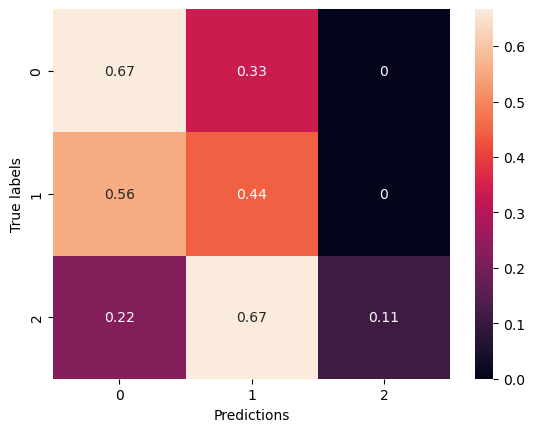

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▃▃▄▄▅▅▆▆▆▆▇▆▇▇▇▇█▇▇▇▇▇▇▇█▇▇█▇█▇█████
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▂▁▁▁▂▂▂▅▆▅▅▁▃▆▇█▅▆█▇▅▇▇▇▆▇▆▅▄▅▇▄▄▄▅▆▄▅▄
val_loss,█▇▆▆▅▄▄▅▂▂▂▂▄▃▁▁▁▂▁▁▂▂▁▁▁▂▁▁▂▃▂▁▃▂▃▂▂▃▂▃


Epoch 1/100


2024-03-12 22:42:07.797722: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:42:07.799371: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:42:07.801324: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:42:09.399152: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:42:09.400865: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:42:09.402961: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:42:13.524324: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:42:14.115122: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 28.5988 - accuracy: 0.3470

2024-03-12 22:42:17.195048: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:42:17.196808: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:42:17.198870: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 642ms/step - loss: 28.5988 - accuracy: 0.3470 - val_loss: 23.1484 - val_accuracy: 0.4167
Epoch 2/100
4/4 [==============================] - 0s 123ms/step - loss: 22.0554 - accuracy: 0.3516 - val_loss: 18.0240 - val_accuracy: 0.3426
Epoch 3/100
4/4 [==============================] - 0s 123ms/step - loss: 17.1455 - accuracy: 0.3699 - val_loss: 14.1744 - val_accuracy: 0.1944
Epoch 4/100
4/4 [==============================] - 1s 141ms/step - loss: 13.4380 - accuracy: 0.3836 - val_loss: 11.2552 - val_accuracy: 0.1481
Epoch 5/100
4/4 [==============================] - 0s 124ms/step - loss: 10.5128 - accuracy: 0.4452 - val_loss: 9.1534 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 0s 123ms/step - loss: 8.4991 - accuracy: 0.4498 - val_loss: 7.4938 - val_accuracy: 0.1296
Epoch 7/100
4/4 [==============================] - 0s 122ms/step - loss: 6.9326 - accuracy: 0.4749 - val_loss: 6.3555 - val_accuracy: 0.1667
Epoch 8/100
4/4

Epoch 59/100
4/4 [==============================] - 1s 127ms/step - loss: 1.5502 - accuracy: 0.7785 - val_loss: 4.8583 - val_accuracy: 0.1296
Epoch 60/100
4/4 [==============================] - 0s 126ms/step - loss: 1.5753 - accuracy: 0.7991 - val_loss: 2.6713 - val_accuracy: 0.4074
Epoch 61/100
4/4 [==============================] - 0s 122ms/step - loss: 1.5273 - accuracy: 0.8082 - val_loss: 2.3947 - val_accuracy: 0.5463
Epoch 62/100
4/4 [==============================] - 0s 122ms/step - loss: 1.4970 - accuracy: 0.8037 - val_loss: 2.3736 - val_accuracy: 0.6019
Epoch 63/100
4/4 [==============================] - 0s 121ms/step - loss: 1.4410 - accuracy: 0.7945 - val_loss: 2.2744 - val_accuracy: 0.5833
Epoch 64/100
4/4 [==============================] - 0s 123ms/step - loss: 1.3974 - accuracy: 0.8242 - val_loss: 2.4360 - val_accuracy: 0.5833
Epoch 65/100
4/4 [==============================] - 0s 123ms/step - loss: 1.3955 - accuracy: 0.8311 - val_loss: 2.6461 - val_accuracy: 0.5000
Epoch 

2024-03-12 22:43:08.315559: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:43:08.317155: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:43:08.319094: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4740879535675049 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.34782608695652173, 'recall': 0.8888888888888888, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.2826086956521739, 'recall': 0.3703703703703704, 'f1-score': 0.2692307692307692, 'support': 27}, 'weighted avg': {'precision': 0.2826086956521739, 'recall': 0.37037037037037035, 'f1-score': 0.2692307692307692, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


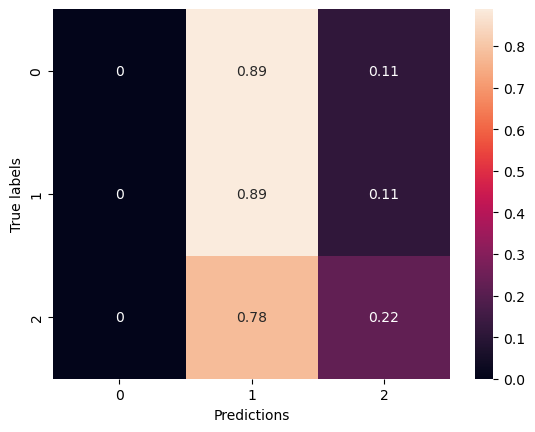

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▃▅▅▅▅▆▆▇▆▇▇▇▇▆▆▇▇▇▇▇▇▇█▇▇▇▇▇▇█▇█▇▇▇█▇
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▂▁▂▂▂▄▅▇▃█▆█▆▄▇▇▇▆▆▃▇▇▁▇▇▆▄▁▅▂▇▅▇▆▇▇▇▆▅
val_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 22:43:30.707229: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:43:30.708869: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:43:30.710912: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:43:32.316760: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:43:32.319342: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:43:32.321135: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:43:36.522219: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:43:38.123628: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 39.0704 - accuracy: 0.3584

2024-03-12 22:43:41.224155: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:43:41.225943: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:43:41.227940: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 641ms/step - loss: 39.0704 - accuracy: 0.3584 - val_loss: 31.1427 - val_accuracy: 0.1481
Epoch 2/100
4/4 [==============================] - 0s 124ms/step - loss: 28.7272 - accuracy: 0.3607 - val_loss: 22.7948 - val_accuracy: 0.1296
Epoch 3/100
4/4 [==============================] - 0s 125ms/step - loss: 20.9934 - accuracy: 0.3858 - val_loss: 16.8010 - val_accuracy: 0.1389
Epoch 4/100
4/4 [==============================] - 0s 124ms/step - loss: 15.3556 - accuracy: 0.4452 - val_loss: 12.5721 - val_accuracy: 0.1389
Epoch 5/100
4/4 [==============================] - 0s 124ms/step - loss: 11.3323 - accuracy: 0.4429 - val_loss: 9.7388 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 0s 125ms/step - loss: 8.6831 - accuracy: 0.4269 - val_loss: 7.8805 - val_accuracy: 0.1296
Epoch 7/100
4/4 [==============================] - 0s 123ms/step - loss: 6.7500 - accuracy: 0.5137 - val_loss: 6.6517 - val_accuracy: 0.1204
Epoch 8/100
4/4

Epoch 59/100
4/4 [==============================] - 0s 123ms/step - loss: 1.4144 - accuracy: 0.8196 - val_loss: 2.4254 - val_accuracy: 0.5370
Epoch 60/100
4/4 [==============================] - 0s 122ms/step - loss: 1.4325 - accuracy: 0.7991 - val_loss: 2.4766 - val_accuracy: 0.5648
Epoch 61/100
4/4 [==============================] - 0s 122ms/step - loss: 1.4672 - accuracy: 0.7808 - val_loss: 3.3202 - val_accuracy: 0.3056
Epoch 62/100
4/4 [==============================] - 0s 123ms/step - loss: 1.4899 - accuracy: 0.8014 - val_loss: 3.8250 - val_accuracy: 0.2500
Epoch 63/100
4/4 [==============================] - 0s 123ms/step - loss: 1.5704 - accuracy: 0.7534 - val_loss: 3.3147 - val_accuracy: 0.3333
Epoch 64/100
4/4 [==============================] - 0s 124ms/step - loss: 1.5341 - accuracy: 0.8174 - val_loss: 3.7445 - val_accuracy: 0.2685
Epoch 65/100
4/4 [==============================] - 0s 124ms/step - loss: 1.5981 - accuracy: 0.7808 - val_loss: 2.8242 - val_accuracy: 0.3704
Epoch 

2024-03-12 22:44:32.449908: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:44:32.452021: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:44:32.453659: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4827969074249268 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '2': {'precision': 0.34782608695652173, 'recall': 0.8888888888888888, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.36594202898550726, 'recall': 0.4074074074074074, 'f1-score': 0.32051282051282054, 'support': 27}, 'weighted avg': {'precision': 0.36594202898550726, 'recall': 0.4074074074074074, 'f1-score': 0.3205128205128205, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


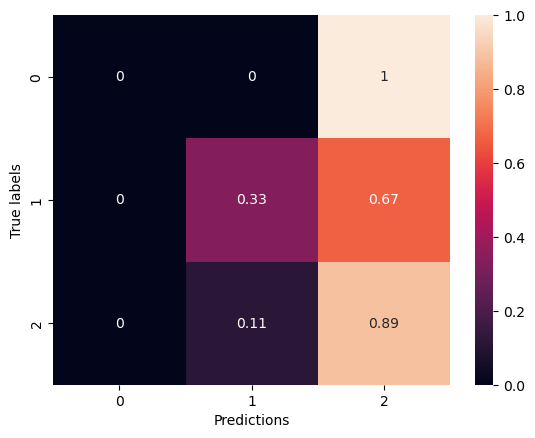

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▄▅▅▅▆▆▆▆▇▇▇▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▆▅▆▇▇▇▇▇▇
training_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▄▄▃▅▇▄▅▃▆▆▄▇▄█▇█▄▁▅▇▄▃▆▅▅▆▆▃▁▂▂▄▆▄▃▇
val_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁


Epoch 1/100


2024-03-12 22:48:46.508670: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:48:46.510259: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:48:46.512279: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:48:48.259657: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:48:48.262018: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:48:48.263717: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:48:52.479934: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:48:53.062563: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 7.9308 - accuracy: 0.4178

2024-03-12 22:48:56.383871: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:48:56.385711: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:48:56.389456: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 700ms/step - loss: 7.9308 - accuracy: 0.4178 - val_loss: 7.4776 - val_accuracy: 0.1296
Epoch 2/100
4/4 [==============================] - 1s 190ms/step - loss: 6.9112 - accuracy: 0.5936 - val_loss: 8.6365 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 183ms/step - loss: 6.0952 - accuracy: 0.6872 - val_loss: 8.6542 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 183ms/step - loss: 5.5167 - accuracy: 0.7283 - val_loss: 8.1609 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 185ms/step - loss: 4.9275 - accuracy: 0.7877 - val_loss: 7.0235 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 1s 192ms/step - loss: 4.3532 - accuracy: 0.8379 - val_loss: 6.5198 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 192ms/step - loss: 4.0076 - accuracy: 0.8242 - val_loss: 7.3365 - val_accuracy: 0.1296
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 189ms/step - loss: 0.8043 - accuracy: 0.9452 - val_loss: 4.1939 - val_accuracy: 0.3519
Epoch 60/100
4/4 [==============================] - 1s 185ms/step - loss: 0.9234 - accuracy: 0.9201 - val_loss: 3.4586 - val_accuracy: 0.3889
Epoch 61/100
4/4 [==============================] - 1s 186ms/step - loss: 0.9100 - accuracy: 0.9315 - val_loss: 3.0077 - val_accuracy: 0.4352
Epoch 62/100
4/4 [==============================] - 1s 182ms/step - loss: 0.9962 - accuracy: 0.9384 - val_loss: 3.0339 - val_accuracy: 0.4722
Epoch 63/100
4/4 [==============================] - 1s 185ms/step - loss: 1.0196 - accuracy: 0.9361 - val_loss: 3.1188 - val_accuracy: 0.4815
Epoch 64/100
4/4 [==============================] - 1s 186ms/step - loss: 0.9848 - accuracy: 0.9658 - val_loss: 3.2476 - val_accuracy: 0.4537
Epoch 65/100
4/4 [==============================] - 1s 184ms/step - loss: 0.9845 - accuracy: 0.9749 - val_loss: 3.1424 - val_accuracy: 0.4815
Epoch 

2024-03-12 22:50:14.127021: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:50:14.128718: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:50:14.130698: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4886610507965088 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.8888888888888888, 'f1-score': 0.5925925925925926, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.2962962962962963, 'recall': 0.4444444444444444, 'f1-score': 0.345679012345679, 'support': 27}, 'weighted avg': {'precision': 0.2962962962962963, 'recall': 0.4444444444444444, 'f1-score': 0.345679012345679, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


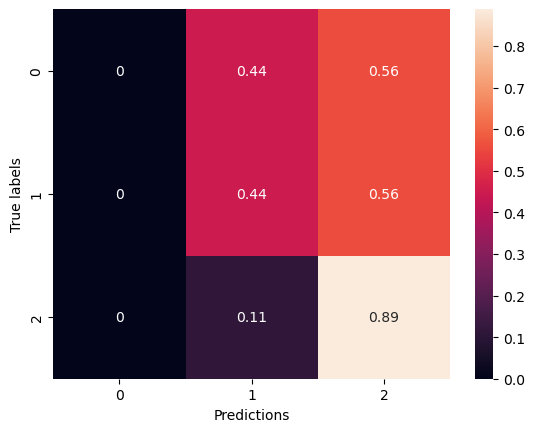

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▇▇▇▇█████▇███▇█▇█████▇████▇▇▇████▇███
training_loss,█▆▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▆▇▄▅▅▆▆▇▇▇█▅▄▅▆▇▇██▄▆▆▆▇▆▇▇▆▄▆▆▆▅▆▆▇
val_loss,▇█▅▅▂▂▃▂▂▂▂▁▁▁▁▂▂▂▂▁▁▁▂▃▁▂▂▂▂▁▁▁▃▁▂▂▁▁▂▁


Epoch 1/100


2024-03-12 22:50:37.246692: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:50:37.248270: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:50:37.250137: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:50:38.870830: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:50:38.873481: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:50:38.875370: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:50:44.141847: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:50:44.734457: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 31.0148 - accuracy: 0.4224

2024-03-12 22:50:48.344743: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:50:48.346428: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:50:48.348204: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 699ms/step - loss: 31.0148 - accuracy: 0.4224 - val_loss: 24.7343 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 187ms/step - loss: 21.4883 - accuracy: 0.6210 - val_loss: 19.6784 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 187ms/step - loss: 14.8080 - accuracy: 0.7032 - val_loss: 13.5679 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 187ms/step - loss: 10.1854 - accuracy: 0.7648 - val_loss: 11.5650 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 185ms/step - loss: 7.2318 - accuracy: 0.7968 - val_loss: 8.5315 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 1s 189ms/step - loss: 5.3908 - accuracy: 0.8356 - val_loss: 5.9202 - val_accuracy: 0.2130
Epoch 7/100
4/4 [==============================] - 1s 187ms/step - loss: 4.2353 - accuracy: 0.8516 - val_loss: 5.7451 - val_accuracy: 0.3333
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 1s 184ms/step - loss: 1.3055 - accuracy: 0.8904 - val_loss: 2.8580 - val_accuracy: 0.4537
Epoch 60/100
4/4 [==============================] - 1s 183ms/step - loss: 1.2041 - accuracy: 0.9087 - val_loss: 3.3469 - val_accuracy: 0.3611
Epoch 61/100
4/4 [==============================] - 1s 187ms/step - loss: 1.2011 - accuracy: 0.9201 - val_loss: 3.3756 - val_accuracy: 0.4722
Epoch 62/100
4/4 [==============================] - 1s 186ms/step - loss: 1.1188 - accuracy: 0.9429 - val_loss: 3.5030 - val_accuracy: 0.4537
Epoch 63/100
4/4 [==============================] - 1s 186ms/step - loss: 1.1443 - accuracy: 0.9338 - val_loss: 3.8597 - val_accuracy: 0.3796
Epoch 64/100
4/4 [==============================] - 1s 187ms/step - loss: 1.1815 - accuracy: 0.9087 - val_loss: 3.2446 - val_accuracy: 0.4815
Epoch 65/100
4/4 [==============================] - 1s 183ms/step - loss: 1.0957 - accuracy: 0.9269 - val_loss: 3.0918 - val_accuracy: 0.5463
Epoch 

2024-03-12 22:52:05.456128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:52:05.460023: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:52:05.461926: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4825618267059326 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.8888888888888888, 'f1-score': 0.5517241379310346, 'support': 9}, '2': {'precision': 0.2857142857142857, 'recall': 0.2222222222222222, 'f1-score': 0.25, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.22857142857142856, 'recall': 0.3703703703703704, 'f1-score': 0.26724137931034486, 'support': 27}, 'weighted avg': {'precision': 0.22857142857142854, 'recall': 0.37037037037037035, 'f1-score': 0.26724137931034486, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


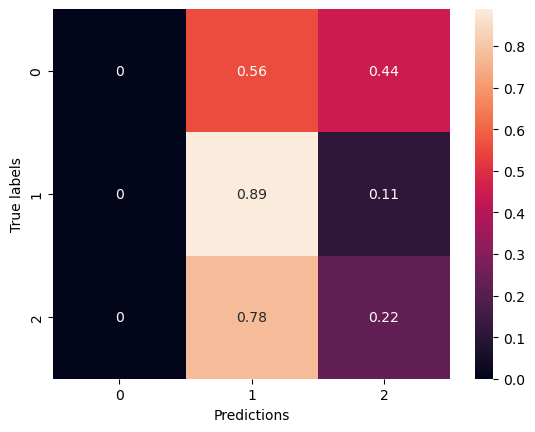

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▅▆▆▆▆▇▇▇▇▇▇█▇▇██▇▇██▇▇▇▇▇██▇▇▇▇▇█▇▇▇▇█▇
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▄▆▄▇▆▄▅▄▅▅▇▄▇▆▅▆▇▇▅▇▆▆▆█▆▅▆▇▆▆▅▆▆▃▅▄▅
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂


Epoch 1/100


2024-03-12 22:52:29.681112: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:52:29.683251: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:52:29.685032: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:52:31.307559: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:52:31.309823: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:52:31.311774: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:52:35.476408: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:52:36.062828: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 42.2860 - accuracy: 0.4612

2024-03-12 22:52:39.402727: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:52:39.404387: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:52:39.406447: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 697ms/step - loss: 42.2860 - accuracy: 0.4612 - val_loss: 32.2313 - val_accuracy: 0.1389
Epoch 2/100
4/4 [==============================] - 1s 187ms/step - loss: 28.3041 - accuracy: 0.6096 - val_loss: 22.1886 - val_accuracy: 0.1481
Epoch 3/100
4/4 [==============================] - 1s 187ms/step - loss: 18.6437 - accuracy: 0.6644 - val_loss: 15.4384 - val_accuracy: 0.1389
Epoch 4/100
4/4 [==============================] - 1s 188ms/step - loss: 12.3506 - accuracy: 0.7237 - val_loss: 10.4518 - val_accuracy: 0.2037
Epoch 5/100
4/4 [==============================] - 1s 187ms/step - loss: 8.4585 - accuracy: 0.7534 - val_loss: 8.4386 - val_accuracy: 0.1481
Epoch 6/100
4/4 [==============================] - 1s 190ms/step - loss: 6.2068 - accuracy: 0.7763 - val_loss: 6.8108 - val_accuracy: 0.2407
Epoch 7/100
4/4 [==============================] - 1s 187ms/step - loss: 4.9301 - accuracy: 0.7603 - val_loss: 4.8157 - val_accuracy: 0.5833
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 1s 184ms/step - loss: 1.4021 - accuracy: 0.9110 - val_loss: 3.1919 - val_accuracy: 0.4444
Epoch 60/100
4/4 [==============================] - 1s 185ms/step - loss: 1.4437 - accuracy: 0.8881 - val_loss: 2.9266 - val_accuracy: 0.5093
Epoch 61/100
4/4 [==============================] - 1s 239ms/step - loss: 1.3378 - accuracy: 0.9498 - val_loss: 3.0087 - val_accuracy: 0.4907
Epoch 62/100
4/4 [==============================] - 1s 201ms/step - loss: 1.2928 - accuracy: 0.9361 - val_loss: 3.0351 - val_accuracy: 0.5278
Epoch 63/100
4/4 [==============================] - 1s 188ms/step - loss: 1.2340 - accuracy: 0.9132 - val_loss: 2.9592 - val_accuracy: 0.5556
Epoch 64/100
4/4 [==============================] - 1s 183ms/step - loss: 1.1772 - accuracy: 0.9452 - val_loss: 2.9720 - val_accuracy: 0.5833
Epoch 65/100
4/4 [==============================] - 1s 184ms/step - loss: 1.1895 - accuracy: 0.9315 - val_loss: 2.9151 - val_accuracy: 0.5556
Epoch 

2024-03-12 22:53:57.010880: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:53:57.012509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:53:57.014534: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4894471168518066 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '2': {'precision': 0.36363636363636365, 'recall': 0.8888888888888888, 'f1-score': 0.5161290322580644, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.39898989898989895, 'recall': 0.3703703703703704, 'f1-score': 0.2882046269143043, 'support': 27}, 'weighted avg': {'precision': 0.398989898989899, 'recall': 0.37037037037037035, 'f1-score': 0.28820462691430426, 'support': 27}}


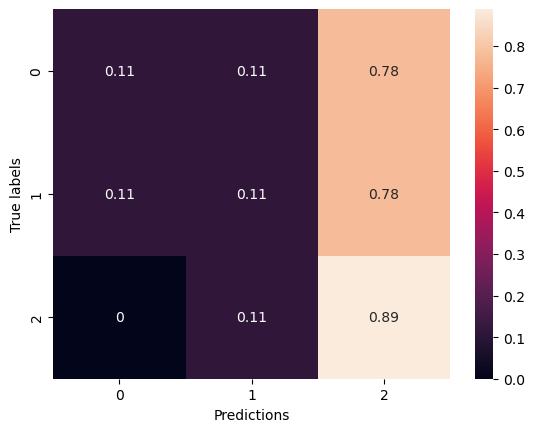

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇██▇▇███▇▇█▇▇▇█▇█
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▆▇▅▅▅▇▇▆▄█▄▅▅▄▅▆▇█▇▇▅▆▇█▅▅▄▄▅▆▇▅▇█▇▇▇
val_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 22:54:25.776893: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:54:25.779287: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:54:25.781020: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:54:27.410104: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:54:27.412248: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:54:27.414247: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:54:31.561608: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:54:32.146172: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 7.8485 - accuracy: 0.4224

2024-03-12 22:54:35.507125: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:54:35.511008: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:54:35.512800: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 720ms/step - loss: 7.8485 - accuracy: 0.4224 - val_loss: 7.7592 - val_accuracy: 0.1296
Epoch 2/100
4/4 [==============================] - 1s 189ms/step - loss: 7.2817 - accuracy: 0.4932 - val_loss: 8.3923 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 189ms/step - loss: 6.4180 - accuracy: 0.6027 - val_loss: 8.1676 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 187ms/step - loss: 6.0192 - accuracy: 0.6233 - val_loss: 8.0815 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 186ms/step - loss: 5.5232 - accuracy: 0.6370 - val_loss: 8.5263 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 187ms/step - loss: 5.1286 - accuracy: 0.6804 - val_loss: 8.1003 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 187ms/step - loss: 4.7045 - accuracy: 0.6918 - val_loss: 6.8596 - val_accuracy: 0.1204
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 184ms/step - loss: 0.9427 - accuracy: 0.9566 - val_loss: 3.4127 - val_accuracy: 0.4444
Epoch 60/100
4/4 [==============================] - 1s 246ms/step - loss: 1.0150 - accuracy: 0.9201 - val_loss: 3.9834 - val_accuracy: 0.3796
Epoch 61/100
4/4 [==============================] - 1s 183ms/step - loss: 1.0761 - accuracy: 0.9178 - val_loss: 3.8272 - val_accuracy: 0.3519
Epoch 62/100
4/4 [==============================] - 1s 189ms/step - loss: 1.0522 - accuracy: 0.9132 - val_loss: 3.0078 - val_accuracy: 0.5370
Epoch 63/100
4/4 [==============================] - 1s 188ms/step - loss: 1.0617 - accuracy: 0.9292 - val_loss: 3.0732 - val_accuracy: 0.5926
Epoch 64/100
4/4 [==============================] - 1s 188ms/step - loss: 1.1625 - accuracy: 0.9018 - val_loss: 2.8818 - val_accuracy: 0.4815
Epoch 65/100
4/4 [==============================] - 1s 190ms/step - loss: 1.1101 - accuracy: 0.9384 - val_loss: 3.2670 - val_accuracy: 0.4074
Epoch 

2024-03-12 22:55:53.047582: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:55:53.049656: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:55:53.051542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.502709150314331 s
{'0': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '1': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.43636363636363634, 'recall': 0.4444444444444445, 'f1-score': 0.42857142857142855, 'support': 27}, 'weighted avg': {'precision': 0.43636363636363634, 'recall': 0.4444444444444444, 'f1-score': 0.42857142857142855, 'support': 27}}


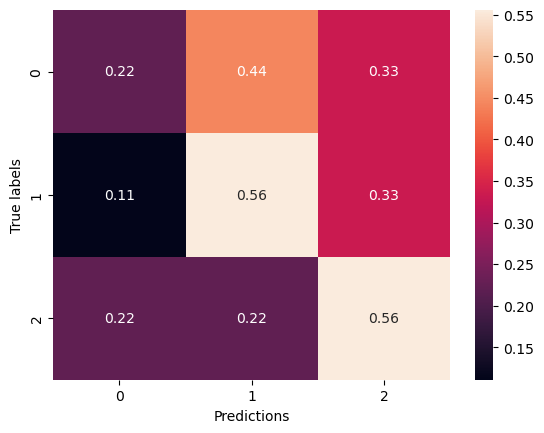

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▇▇▇▇██▇█▇█████▇█▇█▇▇███▇███████▇▇█
training_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁█▇█▆▅▇▇▆▆█▆▆▆█▆▄▅█▆▄▆▇▄▅▆▇▇▇▆▇▆▇▆▅▆
val_loss,▇██▅▆▂▂▂▂▂▁▁▂▁▁▂▂▂▂▁▂▂▁▂▃▁▂▃▂▂▂▁▂▂▂▂▁▂▂▂


Epoch 1/100


2024-03-12 22:56:16.517581: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:56:16.519351: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:56:16.521596: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:56:18.160430: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:56:18.162313: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:56:18.164438: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:56:22.356944: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:56:23.968745: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 30.8864 - accuracy: 0.4612

2024-03-12 22:56:27.339447: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:56:27.341647: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:56:27.343511: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 707ms/step - loss: 30.8864 - accuracy: 0.4612 - val_loss: 24.3828 - val_accuracy: 0.1481
Epoch 2/100
4/4 [==============================] - 1s 186ms/step - loss: 21.7563 - accuracy: 0.5274 - val_loss: 17.8189 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 189ms/step - loss: 15.3214 - accuracy: 0.5890 - val_loss: 13.2559 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 1s 185ms/step - loss: 10.9111 - accuracy: 0.6575 - val_loss: 9.4762 - val_accuracy: 0.2778
Epoch 5/100
4/4 [==============================] - 1s 186ms/step - loss: 8.0607 - accuracy: 0.6781 - val_loss: 7.7372 - val_accuracy: 0.1759
Epoch 6/100
4/4 [==============================] - 1s 187ms/step - loss: 6.1835 - accuracy: 0.7055 - val_loss: 6.1382 - val_accuracy: 0.3148
Epoch 7/100
4/4 [==============================] - 1s 188ms/step - loss: 5.0067 - accuracy: 0.7557 - val_loss: 5.1809 - val_accuracy: 0.2963
Epoch 8/100
4/4 [

Epoch 59/100
4/4 [==============================] - 1s 184ms/step - loss: 1.5588 - accuracy: 0.8813 - val_loss: 3.2228 - val_accuracy: 0.4444
Epoch 60/100
4/4 [==============================] - 1s 185ms/step - loss: 1.4204 - accuracy: 0.9087 - val_loss: 2.9657 - val_accuracy: 0.5185
Epoch 61/100
4/4 [==============================] - 1s 183ms/step - loss: 1.2766 - accuracy: 0.9224 - val_loss: 2.9024 - val_accuracy: 0.5278
Epoch 62/100
4/4 [==============================] - 1s 182ms/step - loss: 1.2365 - accuracy: 0.9178 - val_loss: 3.1627 - val_accuracy: 0.5000
Epoch 63/100
4/4 [==============================] - 1s 182ms/step - loss: 1.1365 - accuracy: 0.9338 - val_loss: 3.4971 - val_accuracy: 0.4259
Epoch 64/100
4/4 [==============================] - 1s 182ms/step - loss: 1.2416 - accuracy: 0.8721 - val_loss: 3.7917 - val_accuracy: 0.3981
Epoch 65/100
4/4 [==============================] - 1s 185ms/step - loss: 1.1740 - accuracy: 0.9269 - val_loss: 3.0810 - val_accuracy: 0.5093
Epoch 

2024-03-12 22:57:44.551586: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:57:44.553185: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:57:44.555035: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4843361377716064 s
{'0': {'precision': 0.36363636363636365, 'recall': 0.4444444444444444, 'f1-score': 0.39999999999999997, 'support': 9}, '1': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.4716394716394716, 'recall': 0.40740740740740744, 'f1-score': 0.3959595959595959, 'support': 27}, 'weighted avg': {'precision': 0.4716394716394717, 'recall': 0.4074074074074074, 'f1-score': 0.39595959595959596, 'support': 27}}


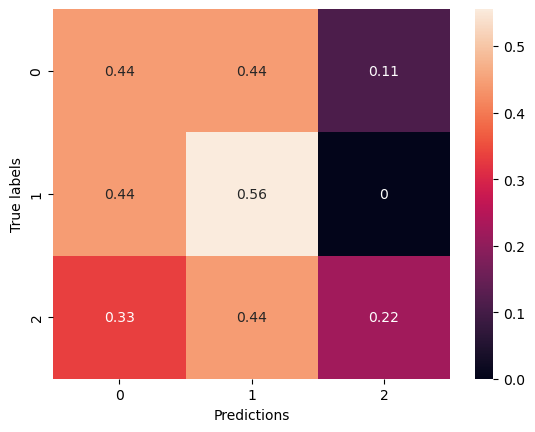

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇████▇▇█▇▇█▇▇█████▇▇███
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▄▄▅▆▆▇▆▇▇▆▅▇▅▄▄▇▆▇█▅▆▆▇▅▂▅▇▅▂▆▅▆▅▄▁▂▃▄
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▂▁▁▁▁▂▂▂▂▂


Epoch 1/100


2024-03-12 22:58:08.541264: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:58:08.543253: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:58:08.545102: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:58:10.158698: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:58:10.160615: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:58:10.162657: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 22:58:14.317880: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 22:58:14.898969: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 42.5059 - accuracy: 0.3676

2024-03-12 22:58:18.239250: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:58:18.240836: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:58:18.243065: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 696ms/step - loss: 42.5059 - accuracy: 0.3676 - val_loss: 32.6354 - val_accuracy: 0.1389
Epoch 2/100
4/4 [==============================] - 1s 191ms/step - loss: 28.8199 - accuracy: 0.4954 - val_loss: 22.4797 - val_accuracy: 0.1389
Epoch 3/100
4/4 [==============================] - 1s 188ms/step - loss: 19.3797 - accuracy: 0.6484 - val_loss: 15.6451 - val_accuracy: 0.1574
Epoch 4/100
4/4 [==============================] - 1s 189ms/step - loss: 13.1385 - accuracy: 0.6826 - val_loss: 11.0406 - val_accuracy: 0.1852
Epoch 5/100
4/4 [==============================] - 1s 186ms/step - loss: 9.2679 - accuracy: 0.6826 - val_loss: 8.5736 - val_accuracy: 0.1389
Epoch 6/100
4/4 [==============================] - 1s 183ms/step - loss: 6.8897 - accuracy: 0.7374 - val_loss: 6.3198 - val_accuracy: 0.3796
Epoch 7/100
4/4 [==============================] - 1s 188ms/step - loss: 5.5023 - accuracy: 0.7511 - val_loss: 5.4217 - val_accuracy: 0.5463
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 1s 189ms/step - loss: 1.4952 - accuracy: 0.8584 - val_loss: 2.8923 - val_accuracy: 0.5093
Epoch 60/100
4/4 [==============================] - 1s 199ms/step - loss: 1.3645 - accuracy: 0.8927 - val_loss: 2.9347 - val_accuracy: 0.4815
Epoch 61/100
4/4 [==============================] - 1s 186ms/step - loss: 1.4508 - accuracy: 0.8676 - val_loss: 2.8713 - val_accuracy: 0.4907
Epoch 62/100
4/4 [==============================] - 1s 185ms/step - loss: 1.4120 - accuracy: 0.8836 - val_loss: 2.9600 - val_accuracy: 0.4537
Epoch 63/100
4/4 [==============================] - 1s 187ms/step - loss: 1.3931 - accuracy: 0.8973 - val_loss: 3.0526 - val_accuracy: 0.5185
Epoch 64/100
4/4 [==============================] - 1s 189ms/step - loss: 1.3721 - accuracy: 0.9110 - val_loss: 3.0338 - val_accuracy: 0.4630
Epoch 65/100
4/4 [==============================] - 1s 194ms/step - loss: 1.3244 - accuracy: 0.9018 - val_loss: 2.7212 - val_accuracy: 0.5463
Epoch 

2024-03-12 22:59:35.130185: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 22:59:35.131847: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 22:59:35.134066: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.47318696975708 s
{'0': {'precision': 0.2857142857142857, 'recall': 0.2222222222222222, 'f1-score': 0.25, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.3841269841269841, 'recall': 0.40740740740740744, 'f1-score': 0.373015873015873, 'support': 27}, 'weighted avg': {'precision': 0.3841269841269841, 'recall': 0.4074074074074074, 'f1-score': 0.373015873015873, 'support': 27}}


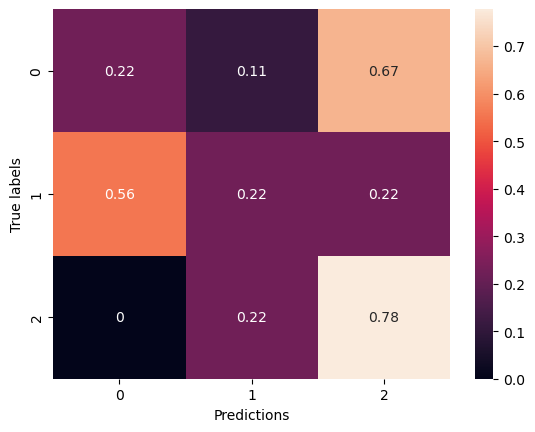

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▅▆▆▇▇▇▇▇▇▇▇▇▇█▇▇▇█▇▇▇▇▇▇█▇▇█▇██▇█▇███▇█
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▄▇▂▄▅▇▆▆█▅▆▅▅▅▅▅▄▄▅▄▇▆▆▆▄▆▅▄▅▄▄▆▆▂▄▅▆▅
val_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁


Epoch 1/100


2024-03-12 23:01:59.917705: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:01:59.919847: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:01:59.921461: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:02:01.547066: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:02:01.549568: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:02:01.551521: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:02:06.955095: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:02:07.535104: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 8.1673 - accuracy: 0.3379

2024-03-12 23:02:10.866360: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:02:10.868074: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:02:10.869868: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 696ms/step - loss: 8.1673 - accuracy: 0.3379 - val_loss: 7.4903 - val_accuracy: 0.1296
Epoch 2/100
4/4 [==============================] - 1s 184ms/step - loss: 7.4554 - accuracy: 0.4201 - val_loss: 7.7004 - val_accuracy: 0.1296
Epoch 3/100
4/4 [==============================] - 1s 187ms/step - loss: 7.0028 - accuracy: 0.4749 - val_loss: 7.9840 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 185ms/step - loss: 6.7401 - accuracy: 0.4110 - val_loss: 7.5759 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 179ms/step - loss: 6.3353 - accuracy: 0.4612 - val_loss: 7.1375 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 186ms/step - loss: 5.9132 - accuracy: 0.4521 - val_loss: 7.1295 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 184ms/step - loss: 5.5439 - accuracy: 0.4635 - val_loss: 7.0418 - val_accuracy: 0.1204
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 189ms/step - loss: 1.2390 - accuracy: 0.8767 - val_loss: 2.3902 - val_accuracy: 0.6019
Epoch 60/100
4/4 [==============================] - 1s 188ms/step - loss: 1.2269 - accuracy: 0.8767 - val_loss: 3.1959 - val_accuracy: 0.5000
Epoch 61/100
4/4 [==============================] - 1s 198ms/step - loss: 1.2192 - accuracy: 0.8836 - val_loss: 2.8220 - val_accuracy: 0.4630
Epoch 62/100
4/4 [==============================] - 1s 193ms/step - loss: 1.1846 - accuracy: 0.8881 - val_loss: 2.6318 - val_accuracy: 0.5556
Epoch 63/100
4/4 [==============================] - 1s 199ms/step - loss: 1.3025 - accuracy: 0.8607 - val_loss: 2.5935 - val_accuracy: 0.5648
Epoch 64/100
4/4 [==============================] - 1s 208ms/step - loss: 1.2054 - accuracy: 0.8858 - val_loss: 2.4226 - val_accuracy: 0.5833
Epoch 65/100
4/4 [==============================] - 1s 186ms/step - loss: 1.1763 - accuracy: 0.8950 - val_loss: 2.6447 - val_accuracy: 0.5648
Epoch 

2024-03-12 23:03:28.608284: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:03:28.610527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:03:28.612144: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4823648929595947 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.48148148148148145, 'recall': 0.48148148148148145, 'f1-score': 0.42208754208754207, 'support': 27}, 'weighted avg': {'precision': 0.48148148148148145, 'recall': 0.48148148148148145, 'f1-score': 0.42208754208754207, 'support': 27}}


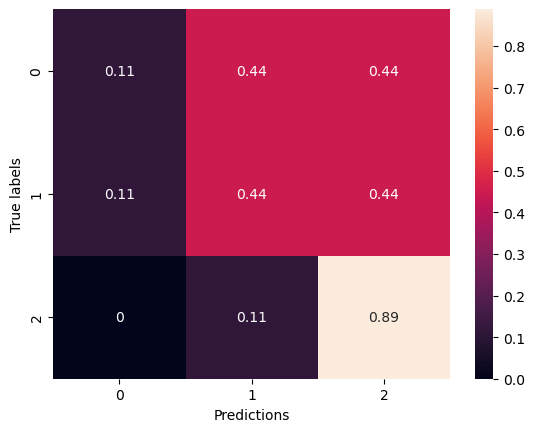

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▂▃▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇█▇█████▇█
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▂▂▆▄▇▅▇▇▇█▆▅▇▆█▆▆▅▇█▆█▆▅▅▆▆▇▅▄█▇▆▇▇▇
val_loss,▇█▇▇▅▅▃▂▂▂▂▁▁▁▁▂▂▁▁▁▁▂▁▁▂▁▂▂▂▁▂▁▂▂▁▁▂▁▂▁


Epoch 1/100


2024-03-12 23:03:55.427407: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:03:55.429705: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:03:55.431533: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:03:57.052667: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:03:57.054432: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:03:57.056634: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:04:01.358478: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:04:01.954144: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 31.3064 - accuracy: 0.4132

2024-03-12 23:04:05.358360: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:04:05.360598: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:04:05.362190: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 716ms/step - loss: 31.3064 - accuracy: 0.4132 - val_loss: 25.4723 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 215ms/step - loss: 23.5984 - accuracy: 0.3950 - val_loss: 19.7207 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 190ms/step - loss: 18.0168 - accuracy: 0.4041 - val_loss: 15.5878 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 186ms/step - loss: 13.8599 - accuracy: 0.4658 - val_loss: 12.8978 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 185ms/step - loss: 11.2149 - accuracy: 0.4292 - val_loss: 10.6276 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 187ms/step - loss: 9.0352 - accuracy: 0.4680 - val_loss: 8.9907 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 187ms/step - loss: 7.5188 - accuracy: 0.5205 - val_loss: 7.9698 - val_accuracy: 0.1204
Epoch 8/100
4/

Epoch 59/100
4/4 [==============================] - 1s 184ms/step - loss: 1.4050 - accuracy: 0.8311 - val_loss: 3.2029 - val_accuracy: 0.3889
Epoch 60/100
4/4 [==============================] - 1s 185ms/step - loss: 1.3910 - accuracy: 0.8196 - val_loss: 2.6122 - val_accuracy: 0.5648
Epoch 61/100
4/4 [==============================] - 1s 180ms/step - loss: 1.3136 - accuracy: 0.8493 - val_loss: 2.5422 - val_accuracy: 0.5833
Epoch 62/100
4/4 [==============================] - 1s 184ms/step - loss: 1.3815 - accuracy: 0.8447 - val_loss: 5.0471 - val_accuracy: 0.2037
Epoch 63/100
4/4 [==============================] - 1s 182ms/step - loss: 1.5124 - accuracy: 0.8014 - val_loss: 3.7919 - val_accuracy: 0.2685
Epoch 64/100
4/4 [==============================] - 1s 184ms/step - loss: 1.5189 - accuracy: 0.8333 - val_loss: 2.8308 - val_accuracy: 0.3981
Epoch 65/100
4/4 [==============================] - 1s 181ms/step - loss: 1.6392 - accuracy: 0.7968 - val_loss: 2.7178 - val_accuracy: 0.5278
Epoch 

2024-03-12 23:05:22.750146: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:05:22.752268: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:05:22.753829: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.488279104232788 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 0.6666666666666666, 'f1-score': 0.5217391304347826, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.4576719576719577, 'recall': 0.4444444444444444, 'f1-score': 0.4246252941905116, 'support': 27}, 'weighted avg': {'precision': 0.4576719576719577, 'recall': 0.4444444444444444, 'f1-score': 0.42462529419051154, 'support': 27}}


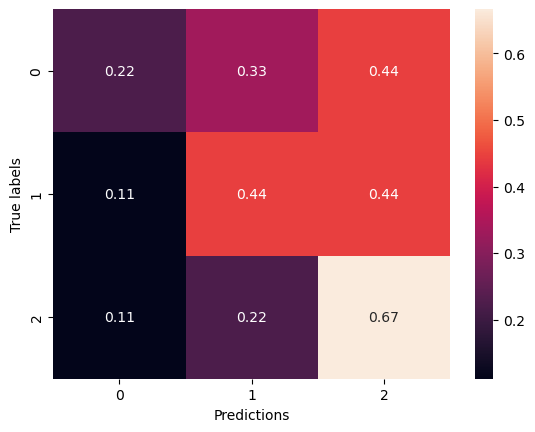

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▃▄▅▆▆▇▆▆▆▆▆█▆▇▇▇▇▇▆▇▇█▇█▇▇███▆▆▇▇▇█▇█
training_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▁▄▆▇█▇▂▇█▆▅█▆▆▆▆▅▅▆▅█▅▇██▆█▆▇▅█▃▂▇▇▇
val_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁


Epoch 1/100


2024-03-12 23:05:46.885154: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:05:46.886760: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:05:46.888613: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:05:48.961910: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:05:48.965712: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:05:48.969767: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:05:54.279873: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:05:54.857358: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 42.7465 - accuracy: 0.3425

2024-03-12 23:05:58.283388: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:05:58.285533: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:05:58.287208: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 725ms/step - loss: 42.7465 - accuracy: 0.3425 - val_loss: 33.0547 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 190ms/step - loss: 29.9305 - accuracy: 0.3858 - val_loss: 23.5564 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 188ms/step - loss: 20.9146 - accuracy: 0.4498 - val_loss: 17.0156 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 1s 187ms/step - loss: 14.9321 - accuracy: 0.4932 - val_loss: 12.3763 - val_accuracy: 0.1574
Epoch 5/100
4/4 [==============================] - 1s 183ms/step - loss: 10.9296 - accuracy: 0.4886 - val_loss: 9.5140 - val_accuracy: 0.2037
Epoch 6/100
4/4 [==============================] - 1s 183ms/step - loss: 8.4991 - accuracy: 0.4863 - val_loss: 8.2305 - val_accuracy: 0.1296
Epoch 7/100
4/4 [==============================] - 1s 226ms/step - loss: 6.8213 - accuracy: 0.5594 - val_loss: 7.4932 - val_accuracy: 0.1296
Epoch 8/100
4/4

Epoch 59/100
4/4 [==============================] - 1s 186ms/step - loss: 1.9206 - accuracy: 0.7260 - val_loss: 2.7954 - val_accuracy: 0.5000
Epoch 60/100
4/4 [==============================] - 1s 185ms/step - loss: 1.8639 - accuracy: 0.7831 - val_loss: 2.6736 - val_accuracy: 0.4259
Epoch 61/100
4/4 [==============================] - 1s 186ms/step - loss: 1.7386 - accuracy: 0.7831 - val_loss: 2.9827 - val_accuracy: 0.4352
Epoch 62/100
4/4 [==============================] - 1s 184ms/step - loss: 1.6709 - accuracy: 0.7991 - val_loss: 2.6644 - val_accuracy: 0.5093
Epoch 63/100
4/4 [==============================] - 1s 184ms/step - loss: 1.4955 - accuracy: 0.8562 - val_loss: 2.9199 - val_accuracy: 0.4444
Epoch 64/100
4/4 [==============================] - 1s 187ms/step - loss: 1.4767 - accuracy: 0.8196 - val_loss: 3.2044 - val_accuracy: 0.3426
Epoch 65/100
4/4 [==============================] - 1s 188ms/step - loss: 1.4970 - accuracy: 0.7991 - val_loss: 3.3359 - val_accuracy: 0.3333
Epoch 

2024-03-12 23:07:16.066117: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:07:16.068061: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:07:16.069749: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4978082180023193 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.375, 'recall': 1.0, 'f1-score': 0.5454545454545454, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.625, 'recall': 0.40740740740740744, 'f1-score': 0.309090909090909, 'support': 27}, 'weighted avg': {'precision': 0.625, 'recall': 0.4074074074074074, 'f1-score': 0.309090909090909, 'support': 27}}


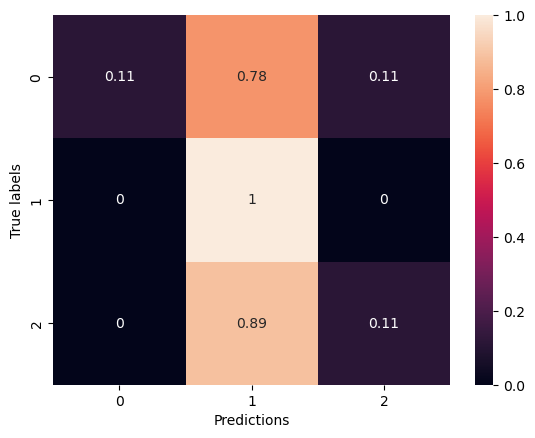

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▃▄▅▆▆▆▆▇▆▆▇█▇▇▇▇▇▇▇▇▇▆▇█▇▇▇▇▇▇▇█████▇▇
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▃▄▃▅▄▅█▄▆▄▄▃▄▆▆▅▄▃▇▇▆▅▄▆▆▅▇▄▂▆▇▅▇▄▅▆▄
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 23:07:40.845794: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:07:40.847349: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:07:40.849467: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:07:42.461710: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:07:42.464229: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:07:42.466011: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:07:47.859543: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:07:48.470936: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 9.1507 - accuracy: 0.3858

2024-03-12 23:07:51.974220: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:07:51.976031: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:07:51.977886: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 737ms/step - loss: 9.1507 - accuracy: 0.3858 - val_loss: 8.4556 - val_accuracy: 0.1574
Epoch 2/100
4/4 [==============================] - 1s 219ms/step - loss: 7.9625 - accuracy: 0.5753 - val_loss: 8.3265 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 215ms/step - loss: 7.1715 - accuracy: 0.6530 - val_loss: 8.1115 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 215ms/step - loss: 6.4667 - accuracy: 0.7100 - val_loss: 7.1154 - val_accuracy: 0.1389
Epoch 5/100
4/4 [==============================] - 1s 214ms/step - loss: 5.8776 - accuracy: 0.7146 - val_loss: 6.7310 - val_accuracy: 0.1481
Epoch 6/100
4/4 [==============================] - 1s 219ms/step - loss: 5.2897 - accuracy: 0.7580 - val_loss: 5.9265 - val_accuracy: 0.2963
Epoch 7/100
4/4 [==============================] - 1s 214ms/step - loss: 4.7296 - accuracy: 0.7877 - val_loss: 5.3635 - val_accuracy: 0.3241
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 215ms/step - loss: 0.9028 - accuracy: 0.9772 - val_loss: 3.2568 - val_accuracy: 0.4537
Epoch 60/100
4/4 [==============================] - 1s 216ms/step - loss: 0.9316 - accuracy: 0.9566 - val_loss: 3.0358 - val_accuracy: 0.5556
Epoch 61/100
4/4 [==============================] - 1s 211ms/step - loss: 0.9408 - accuracy: 0.9521 - val_loss: 3.0671 - val_accuracy: 0.5370
Epoch 62/100
4/4 [==============================] - 1s 262ms/step - loss: 0.9571 - accuracy: 0.9338 - val_loss: 3.1483 - val_accuracy: 0.4815
Epoch 63/100
4/4 [==============================] - 1s 218ms/step - loss: 1.0073 - accuracy: 0.9406 - val_loss: 3.1435 - val_accuracy: 0.5556
Epoch 64/100
4/4 [==============================] - 1s 212ms/step - loss: 0.9923 - accuracy: 0.9406 - val_loss: 3.2961 - val_accuracy: 0.5093
Epoch 65/100
4/4 [==============================] - 1s 230ms/step - loss: 1.0070 - accuracy: 0.9635 - val_loss: 3.2823 - val_accuracy: 0.5185
Epoch 

2024-03-12 23:09:21.238959: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:09:21.241199: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:09:21.242918: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4984970092773438 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.29411764705882354, 'recall': 0.5555555555555556, 'f1-score': 0.3846153846153846, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.2647058823529412, 'recall': 0.3703703703703704, 'f1-score': 0.30364372469635625, 'support': 27}, 'weighted avg': {'precision': 0.2647058823529412, 'recall': 0.37037037037037035, 'f1-score': 0.30364372469635625, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


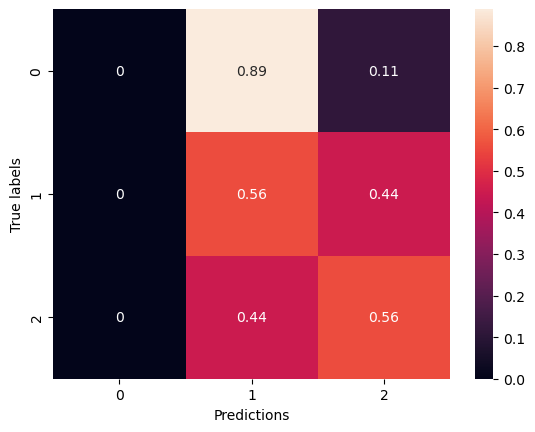

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇█▇█▇█▇▇▇███▇▇████████████████████
training_loss,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▄▄▄▄▂▄▄█▇▇▅▆▆▅▅▅█▇▄▄▆▆▇▇█▄▅▅▇▇▅▄█▇▅▇▆▅
val_loss,██▅▄▃▃▄▃▃▁▁▁▂▁▁▂▂▂▁▁▂▃▂▂▁▂▁▃▁▂▁▂▃▃▂▂▂▁▁▂


Epoch 1/100


2024-03-12 23:09:45.607409: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:09:45.609118: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:09:45.610990: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:09:47.299207: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:09:47.301108: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:09:47.303579: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:09:51.688806: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:09:52.463008: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 37.0927 - accuracy: 0.4201

2024-03-12 23:09:55.917224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:09:55.919609: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:09:55.921467: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 727ms/step - loss: 37.0927 - accuracy: 0.4201 - val_loss: 28.8758 - val_accuracy: 0.1944
Epoch 2/100
4/4 [==============================] - 1s 215ms/step - loss: 25.7633 - accuracy: 0.5000 - val_loss: 20.2953 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 217ms/step - loss: 17.4773 - accuracy: 0.6096 - val_loss: 14.1176 - val_accuracy: 0.1481
Epoch 4/100
4/4 [==============================] - 1s 214ms/step - loss: 11.8924 - accuracy: 0.7306 - val_loss: 9.9714 - val_accuracy: 0.1852
Epoch 5/100
4/4 [==============================] - 1s 217ms/step - loss: 8.3599 - accuracy: 0.7100 - val_loss: 7.4531 - val_accuracy: 0.1481
Epoch 6/100
4/4 [==============================] - 1s 220ms/step - loss: 6.1387 - accuracy: 0.7329 - val_loss: 5.7291 - val_accuracy: 0.3704
Epoch 7/100
4/4 [==============================] - 1s 216ms/step - loss: 4.8368 - accuracy: 0.7877 - val_loss: 5.0596 - val_accuracy: 0.2778
Epoch 8/100
4/4 [

Epoch 59/100
4/4 [==============================] - 1s 220ms/step - loss: 1.4246 - accuracy: 0.9064 - val_loss: 2.8339 - val_accuracy: 0.5556
Epoch 60/100
4/4 [==============================] - 1s 216ms/step - loss: 1.4396 - accuracy: 0.8858 - val_loss: 3.2111 - val_accuracy: 0.4537
Epoch 61/100
4/4 [==============================] - 1s 216ms/step - loss: 1.3667 - accuracy: 0.9155 - val_loss: 4.0429 - val_accuracy: 0.3148
Epoch 62/100
4/4 [==============================] - 1s 217ms/step - loss: 1.3630 - accuracy: 0.9041 - val_loss: 4.3402 - val_accuracy: 0.2963
Epoch 63/100
4/4 [==============================] - 1s 235ms/step - loss: 1.4172 - accuracy: 0.9178 - val_loss: 4.3304 - val_accuracy: 0.3333
Epoch 64/100
4/4 [==============================] - 1s 220ms/step - loss: 1.3723 - accuracy: 0.9247 - val_loss: 3.1633 - val_accuracy: 0.5370
Epoch 65/100
4/4 [==============================] - 1s 215ms/step - loss: 1.3559 - accuracy: 0.9155 - val_loss: 2.7317 - val_accuracy: 0.5185
Epoch 

2024-03-12 23:11:24.716511: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:11:24.718716: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:11:24.720640: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.499603271484375 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '2': {'precision': 0.375, 'recall': 1.0, 'f1-score': 0.5454545454545454, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.34722222222222215, 'recall': 0.40740740740740744, 'f1-score': 0.2929292929292929, 'support': 27}, 'weighted avg': {'precision': 0.3472222222222222, 'recall': 0.4074074074074074, 'f1-score': 0.2929292929292929, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


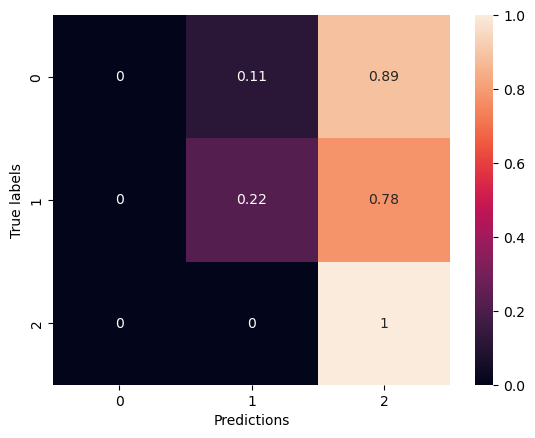

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▆▆▇▇▇▇▆▇▇▇▇▇█▆▇█▇▇▇▇▇▇█▇▇▇▇█▇▇██▇█▇██
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▄▇▅▃▇▆▇▆▇▃▅▆▇▇▆▆▆▅▇▇▄▇▄▇█▃▆▅▆▇▅▃▅▇▅▆██
val_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 23:11:49.406635: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:11:49.408289: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:11:49.410334: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:11:51.039464: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:11:51.041606: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:11:51.043541: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:11:56.361408: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:11:56.946134: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 50.5895 - accuracy: 0.4018

2024-03-12 23:12:00.371706: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:12:00.373718: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:12:00.375262: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 727ms/step - loss: 50.5895 - accuracy: 0.4018 - val_loss: 38.6367 - val_accuracy: 0.1296
Epoch 2/100
4/4 [==============================] - 1s 217ms/step - loss: 33.7038 - accuracy: 0.5183 - val_loss: 25.9985 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 221ms/step - loss: 21.8377 - accuracy: 0.6256 - val_loss: 17.3713 - val_accuracy: 0.1389
Epoch 4/100
4/4 [==============================] - 1s 211ms/step - loss: 14.1679 - accuracy: 0.6507 - val_loss: 12.0944 - val_accuracy: 0.1574
Epoch 5/100
4/4 [==============================] - 1s 215ms/step - loss: 9.3987 - accuracy: 0.7443 - val_loss: 8.7624 - val_accuracy: 0.1667
Epoch 6/100
4/4 [==============================] - 1s 218ms/step - loss: 6.7110 - accuracy: 0.7785 - val_loss: 6.6782 - val_accuracy: 0.2315
Epoch 7/100
4/4 [==============================] - 1s 218ms/step - loss: 5.3654 - accuracy: 0.7717 - val_loss: 6.2883 - val_accuracy: 0.1852
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 1s 219ms/step - loss: 1.3900 - accuracy: 0.9087 - val_loss: 3.2860 - val_accuracy: 0.4259
Epoch 60/100
4/4 [==============================] - 1s 215ms/step - loss: 1.5607 - accuracy: 0.8630 - val_loss: 2.8748 - val_accuracy: 0.5648
Epoch 61/100
4/4 [==============================] - 1s 214ms/step - loss: 1.6009 - accuracy: 0.8699 - val_loss: 4.7182 - val_accuracy: 0.2315
Epoch 62/100
4/4 [==============================] - 1s 215ms/step - loss: 1.6289 - accuracy: 0.9110 - val_loss: 4.0969 - val_accuracy: 0.2963
Epoch 63/100
4/4 [==============================] - 1s 216ms/step - loss: 1.5912 - accuracy: 0.9155 - val_loss: 3.4226 - val_accuracy: 0.4907
Epoch 64/100
4/4 [==============================] - 1s 215ms/step - loss: 1.6174 - accuracy: 0.8927 - val_loss: 3.3048 - val_accuracy: 0.5278
Epoch 65/100
4/4 [==============================] - 1s 216ms/step - loss: 1.5463 - accuracy: 0.9064 - val_loss: 3.7303 - val_accuracy: 0.3889
Epoch 

2024-03-12 23:13:28.856444: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:13:28.858076: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:13:28.862344: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4785799980163574 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.375, 'recall': 1.0, 'f1-score': 0.5454545454545454, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.625, 'recall': 0.40740740740740744, 'f1-score': 0.309090909090909, 'support': 27}, 'weighted avg': {'precision': 0.625, 'recall': 0.4074074074074074, 'f1-score': 0.309090909090909, 'support': 27}}


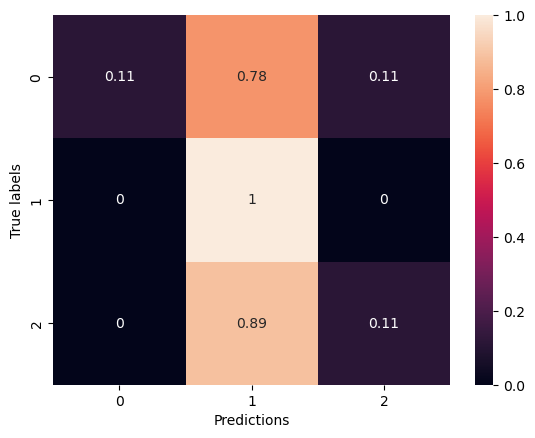

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▆▇▇▇▇▇█▇██▇▇▇██▇▇▇██▇▇▇▇█▇█▇▇▇█▇███▇
training_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▃▄▁▃▇█▄▇▅▆▆▇▇██▆▆▇▃▆▄▅▃▇▆▆▇▅▄▇▆▅▅▅▄▄▄▅
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 23:13:54.194275: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:13:54.196741: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:13:54.198345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:13:55.941311: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:13:55.943630: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:13:55.945749: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:14:00.109667: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:14:00.697327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 9.4380 - accuracy: 0.3539

2024-03-12 23:14:04.141529: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:14:04.143116: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:14:04.145431: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 729ms/step - loss: 9.4380 - accuracy: 0.3539 - val_loss: 8.7500 - val_accuracy: 0.2037
Epoch 2/100
4/4 [==============================] - 1s 214ms/step - loss: 8.5243 - accuracy: 0.4726 - val_loss: 8.5658 - val_accuracy: 0.1296
Epoch 3/100
4/4 [==============================] - 1s 216ms/step - loss: 8.0814 - accuracy: 0.4954 - val_loss: 8.4804 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 261ms/step - loss: 7.4723 - accuracy: 0.5228 - val_loss: 8.2008 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 251ms/step - loss: 6.9056 - accuracy: 0.5479 - val_loss: 8.1646 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 215ms/step - loss: 6.3210 - accuracy: 0.5822 - val_loss: 7.6126 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 218ms/step - loss: 5.9577 - accuracy: 0.6027 - val_loss: 7.8953 - val_accuracy: 0.1296
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 217ms/step - loss: 1.2014 - accuracy: 0.9338 - val_loss: 3.0231 - val_accuracy: 0.5000
Epoch 60/100
4/4 [==============================] - 1s 216ms/step - loss: 1.1649 - accuracy: 0.9521 - val_loss: 3.1462 - val_accuracy: 0.4722
Epoch 61/100
4/4 [==============================] - 1s 214ms/step - loss: 1.1788 - accuracy: 0.9384 - val_loss: 3.1324 - val_accuracy: 0.5093
Epoch 62/100
4/4 [==============================] - 1s 211ms/step - loss: 1.1654 - accuracy: 0.9361 - val_loss: 3.1416 - val_accuracy: 0.4444
Epoch 63/100
4/4 [==============================] - 1s 220ms/step - loss: 1.1654 - accuracy: 0.9384 - val_loss: 3.0645 - val_accuracy: 0.4815
Epoch 64/100
4/4 [==============================] - 1s 216ms/step - loss: 1.2214 - accuracy: 0.9269 - val_loss: 3.1283 - val_accuracy: 0.5000
Epoch 65/100
4/4 [==============================] - 1s 216ms/step - loss: 1.2951 - accuracy: 0.9110 - val_loss: 3.5475 - val_accuracy: 0.3796
Epoch 

2024-03-12 23:15:33.553382: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:15:33.555005: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:15:33.556842: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 2.6444320678710938 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, '2': {'precision': 0.5333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.6666666666666667, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.3444444444444444, 'recall': 0.5185185185185185, 'f1-score': 0.41269841269841273, 'support': 27}, 'weighted avg': {'precision': 0.3444444444444445, 'recall': 0.5185185185185185, 'f1-score': 0.41269841269841273, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


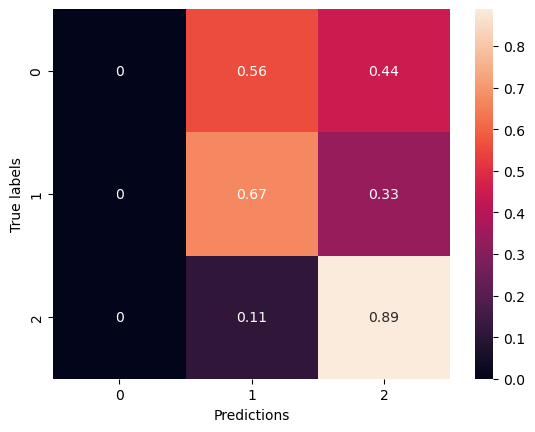

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▅▆▆▆▇▇▇▇█▇▇▇████▇▇██████████████▇▇██
training_loss,█▇▅▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▃▂▃▅▅▅▄██▄▄▄▆▅▅▅▄▆▇▇▇▇▅▇▆▆▄▄▆▇▇▅█▅▇▇
val_loss,██▇▇▄▄▃▂▂▂▃▁▁▃▃▄▂▂▂▂▂▂▁▁▂▁▂▁▂▂▂▃▂▁▂▂▁▂▁▁


Epoch 1/100


2024-03-12 23:16:00.985431: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:16:00.987134: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:16:00.989188: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:16:02.609939: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:16:02.612312: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:16:02.614250: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:16:06.875225: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:16:07.461405: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 37.5231 - accuracy: 0.3356

2024-03-12 23:16:10.901886: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:16:10.904193: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:16:10.905779: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 732ms/step - loss: 37.5231 - accuracy: 0.3356 - val_loss: 29.5720 - val_accuracy: 0.2407
Epoch 2/100
4/4 [==============================] - 1s 216ms/step - loss: 27.3170 - accuracy: 0.4064 - val_loss: 21.9094 - val_accuracy: 0.1111
Epoch 3/100
4/4 [==============================] - 1s 214ms/step - loss: 19.9630 - accuracy: 0.4886 - val_loss: 16.4785 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 1s 215ms/step - loss: 14.7100 - accuracy: 0.5548 - val_loss: 12.5021 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 215ms/step - loss: 11.1062 - accuracy: 0.6050 - val_loss: 9.7159 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 1s 211ms/step - loss: 8.6774 - accuracy: 0.6050 - val_loss: 8.1427 - val_accuracy: 0.1389
Epoch 7/100
4/4 [==============================] - 1s 216ms/step - loss: 7.0554 - accuracy: 0.6438 - val_loss: 6.9067 - val_accuracy: 0.1481
Epoch 8/100
4/4

Epoch 59/100
4/4 [==============================] - 1s 214ms/step - loss: 1.6521 - accuracy: 0.8562 - val_loss: 3.2946 - val_accuracy: 0.3796
Epoch 60/100
4/4 [==============================] - 1s 244ms/step - loss: 1.6074 - accuracy: 0.8699 - val_loss: 3.8818 - val_accuracy: 0.3704
Epoch 61/100
4/4 [==============================] - 1s 218ms/step - loss: 1.6072 - accuracy: 0.8653 - val_loss: 3.1765 - val_accuracy: 0.5833
Epoch 62/100
4/4 [==============================] - 1s 214ms/step - loss: 1.6297 - accuracy: 0.8721 - val_loss: 3.5286 - val_accuracy: 0.5370
Epoch 63/100
4/4 [==============================] - 1s 216ms/step - loss: 1.7081 - accuracy: 0.8744 - val_loss: 3.2945 - val_accuracy: 0.6019
Epoch 64/100
4/4 [==============================] - 1s 213ms/step - loss: 1.7711 - accuracy: 0.8516 - val_loss: 3.1312 - val_accuracy: 0.4815
Epoch 65/100
4/4 [==============================] - 1s 217ms/step - loss: 1.7569 - accuracy: 0.8699 - val_loss: 3.6587 - val_accuracy: 0.3519
Epoch 

2024-03-12 23:17:39.688541: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:17:39.690165: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:17:39.692194: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4924118518829346 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.48484848484848486, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.611111111111111, 'recall': 0.3703703703703704, 'f1-score': 0.2888888888888889, 'support': 27}, 'weighted avg': {'precision': 0.6111111111111112, 'recall': 0.37037037037037035, 'f1-score': 0.28888888888888886, 'support': 27}}


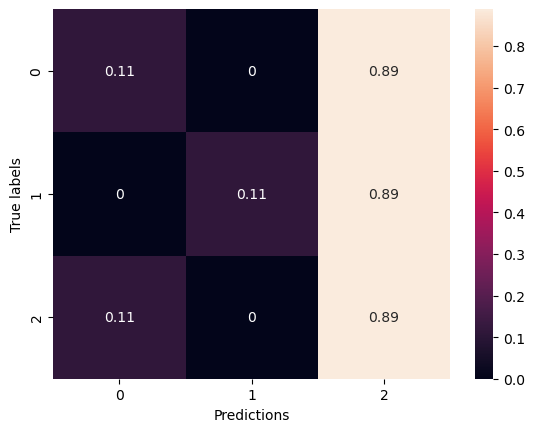

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▆▇▇▇▇▇█▇▇▇█▇▇█▇▇▇▇▇▇████▇▇██▇▇▇▇██
training_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▁▄█▆▇▇▅▅█▅▆▄▅▆▅▅▆▂▄█▅█▆▄▅█▆▆▅▆▅▇▇▇█▆▇
val_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 23:18:03.010294: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:18:03.013097: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:18:03.015199: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:18:04.625369: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:18:04.627736: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:18:04.629847: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:18:09.784892: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:18:10.370140: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 50.8312 - accuracy: 0.3995

2024-03-12 23:18:13.838117: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:18:13.840299: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:18:13.841861: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 730ms/step - loss: 50.8312 - accuracy: 0.3995 - val_loss: 38.8621 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 215ms/step - loss: 34.5110 - accuracy: 0.5183 - val_loss: 26.7018 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 214ms/step - loss: 23.4057 - accuracy: 0.5091 - val_loss: 18.8731 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 213ms/step - loss: 16.0807 - accuracy: 0.5457 - val_loss: 13.5820 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 214ms/step - loss: 11.3210 - accuracy: 0.6005 - val_loss: 10.1820 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 217ms/step - loss: 8.4643 - accuracy: 0.6279 - val_loss: 8.4849 - val_accuracy: 0.1296
Epoch 7/100
4/4 [==============================] - 1s 217ms/step - loss: 6.7802 - accuracy: 0.6644 - val_loss: 6.9297 - val_accuracy: 0.1759
Epoch 8/100
4/

Epoch 59/100
4/4 [==============================] - 1s 221ms/step - loss: 2.0030 - accuracy: 0.8059 - val_loss: 3.1201 - val_accuracy: 0.4630
Epoch 60/100
4/4 [==============================] - 1s 215ms/step - loss: 1.9179 - accuracy: 0.7945 - val_loss: 3.1671 - val_accuracy: 0.4259
Epoch 61/100
4/4 [==============================] - 1s 216ms/step - loss: 1.8556 - accuracy: 0.8402 - val_loss: 3.0571 - val_accuracy: 0.4907
Epoch 62/100
4/4 [==============================] - 1s 216ms/step - loss: 1.6823 - accuracy: 0.8836 - val_loss: 3.0995 - val_accuracy: 0.5093
Epoch 63/100
4/4 [==============================] - 1s 218ms/step - loss: 1.5112 - accuracy: 0.9018 - val_loss: 3.0646 - val_accuracy: 0.5185
Epoch 64/100
4/4 [==============================] - 1s 216ms/step - loss: 1.3810 - accuracy: 0.8904 - val_loss: 2.6081 - val_accuracy: 0.5833
Epoch 65/100
4/4 [==============================] - 1s 213ms/step - loss: 1.4402 - accuracy: 0.8379 - val_loss: 2.9062 - val_accuracy: 0.5185
Epoch 

2024-03-12 23:19:42.566223: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:19:42.568617: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:19:42.570432: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4939117431640625 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.4444444444444444, 'f1-score': 0.380952380952381, 'support': 9}, '1': {'precision': 0.16666666666666666, 'recall': 0.1111111111111111, 'f1-score': 0.13333333333333333, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3333333333333333, 'support': 9}, 'accuracy': 0.2962962962962963, 'macro avg': {'precision': 0.27777777777777773, 'recall': 0.2962962962962963, 'f1-score': 0.2825396825396826, 'support': 27}, 'weighted avg': {'precision': 0.2777777777777778, 'recall': 0.2962962962962963, 'f1-score': 0.28253968253968254, 'support': 27}}


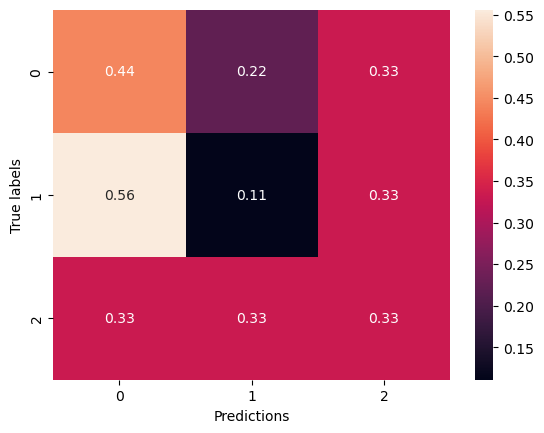

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇█▇▇▇▇▇██▇▇▇▇███
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▃▃▅▅▁▆▆█▅▆▇▁▄▁▅▇▅▄▄▅▆▆▇▅▅▄▆▇▇▇▅▄▅▄▂█▅
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁


Epoch 1/100


2024-03-12 23:20:04.907620: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:20:04.909268: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:20:04.911215: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:20:06.520549: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:20:06.522327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:20:06.524220: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:20:10.684876: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:20:11.272743: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 9.5182 - accuracy: 0.3356

2024-03-12 23:20:14.711827: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:20:14.714355: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:20:14.715984: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 731ms/step - loss: 9.5182 - accuracy: 0.3356 - val_loss: 8.7676 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 217ms/step - loss: 8.7482 - accuracy: 0.4041 - val_loss: 8.5911 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 218ms/step - loss: 8.4956 - accuracy: 0.3516 - val_loss: 8.4912 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 1s 216ms/step - loss: 8.0181 - accuracy: 0.3699 - val_loss: 8.0088 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 216ms/step - loss: 7.6112 - accuracy: 0.3584 - val_loss: 7.6938 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 215ms/step - loss: 7.1537 - accuracy: 0.3927 - val_loss: 7.4739 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 218ms/step - loss: 6.7687 - accuracy: 0.4315 - val_loss: 7.3288 - val_accuracy: 0.1204
Epoch 8/100
4/4 [=======

Epoch 59/100
4/4 [==============================] - 1s 217ms/step - loss: 1.4616 - accuracy: 0.8425 - val_loss: 2.6283 - val_accuracy: 0.6019
Epoch 60/100
4/4 [==============================] - 1s 225ms/step - loss: 1.3756 - accuracy: 0.8470 - val_loss: 2.7281 - val_accuracy: 0.5741
Epoch 61/100
4/4 [==============================] - 1s 213ms/step - loss: 1.4102 - accuracy: 0.8493 - val_loss: 2.6103 - val_accuracy: 0.6296
Epoch 62/100
4/4 [==============================] - 1s 214ms/step - loss: 1.4027 - accuracy: 0.8493 - val_loss: 2.6553 - val_accuracy: 0.5833
Epoch 63/100
4/4 [==============================] - 1s 224ms/step - loss: 1.3894 - accuracy: 0.8836 - val_loss: 3.0476 - val_accuracy: 0.5000
Epoch 64/100
4/4 [==============================] - 1s 222ms/step - loss: 1.3930 - accuracy: 0.8630 - val_loss: 2.8940 - val_accuracy: 0.5370
Epoch 65/100
4/4 [==============================] - 1s 215ms/step - loss: 1.3632 - accuracy: 0.8744 - val_loss: 2.8040 - val_accuracy: 0.5833
Epoch 

2024-03-12 23:21:44.163741: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:21:44.165321: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:21:44.167450: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.512281894683838 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.375, 'recall': 0.3333333333333333, 'f1-score': 0.35294117647058826, 'support': 9}, '2': {'precision': 0.3125, 'recall': 0.5555555555555556, 'f1-score': 0.39999999999999997, 'support': 9}, 'accuracy': 0.2962962962962963, 'macro avg': {'precision': 0.22916666666666666, 'recall': 0.2962962962962963, 'f1-score': 0.25098039215686274, 'support': 27}, 'weighted avg': {'precision': 0.22916666666666666, 'recall': 0.2962962962962963, 'f1-score': 0.25098039215686274, 'support': 27}}


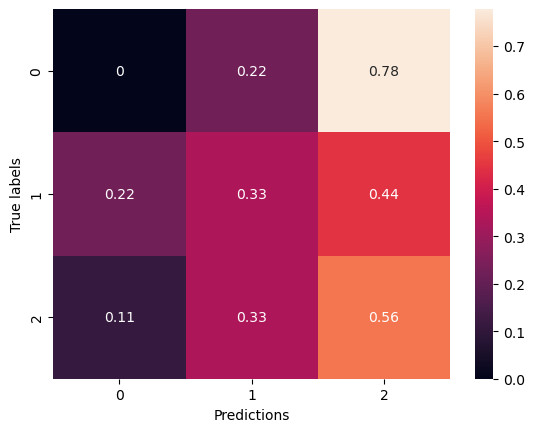

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▃▃▄▄▄▅▅▅▆▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇██▇▇██▇▆▇
training_loss,█▇▆▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▁▂▄▅▆▆▇▇▇▇▇█▇█▇▇▇█▇█▅▇▅▃▆▆▅▆▆▄▄▆▆
val_loss,██▇▆▆▅▅▅▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▃▂▂▂▁▂▂▃▁▁


Epoch 1/100


2024-03-12 23:22:06.705590: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:22:06.707214: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:22:06.709129: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:22:09.288567: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:22:09.290833: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:22:09.292515: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:22:13.451103: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:22:14.034257: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 37.4762 - accuracy: 0.3128

2024-03-12 23:22:17.484410: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:22:17.486461: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:22:17.488165: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 736ms/step - loss: 37.4762 - accuracy: 0.3128 - val_loss: 30.0741 - val_accuracy: 0.1019
Epoch 2/100
4/4 [==============================] - 1s 220ms/step - loss: 28.0538 - accuracy: 0.3699 - val_loss: 23.1535 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 218ms/step - loss: 21.3407 - accuracy: 0.3699 - val_loss: 18.1775 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 216ms/step - loss: 16.5066 - accuracy: 0.4201 - val_loss: 14.5279 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 220ms/step - loss: 13.0562 - accuracy: 0.4498 - val_loss: 11.7309 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 217ms/step - loss: 10.6980 - accuracy: 0.4292 - val_loss: 9.8889 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 217ms/step - loss: 8.8571 - accuracy: 0.4612 - val_loss: 8.6726 - val_accuracy: 0.1204
Epoch 8/100
4

Epoch 59/100
4/4 [==============================] - 1s 243ms/step - loss: 1.5917 - accuracy: 0.8425 - val_loss: 2.8917 - val_accuracy: 0.3704
Epoch 60/100
4/4 [==============================] - 1s 215ms/step - loss: 1.5294 - accuracy: 0.8493 - val_loss: 2.7511 - val_accuracy: 0.4074
Epoch 61/100
4/4 [==============================] - 1s 221ms/step - loss: 1.6744 - accuracy: 0.7877 - val_loss: 4.0195 - val_accuracy: 0.2500
Epoch 62/100
4/4 [==============================] - 1s 216ms/step - loss: 1.7473 - accuracy: 0.7626 - val_loss: 3.5769 - val_accuracy: 0.3148
Epoch 63/100
4/4 [==============================] - 1s 218ms/step - loss: 1.8142 - accuracy: 0.7877 - val_loss: 3.6648 - val_accuracy: 0.2500
Epoch 64/100
4/4 [==============================] - 1s 217ms/step - loss: 1.9085 - accuracy: 0.8151 - val_loss: 2.9808 - val_accuracy: 0.3796
Epoch 65/100
4/4 [==============================] - 1s 215ms/step - loss: 2.0041 - accuracy: 0.7922 - val_loss: 3.0698 - val_accuracy: 0.3796
Epoch 

2024-03-12 23:23:46.711267: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:23:46.713049: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:23:46.714942: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.587745189666748 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, '2': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5646723646723647, 'recall': 0.5555555555555556, 'f1-score': 0.5401635401635402, 'support': 27}, 'weighted avg': {'precision': 0.5646723646723646, 'recall': 0.5555555555555556, 'f1-score': 0.5401635401635402, 'support': 27}}


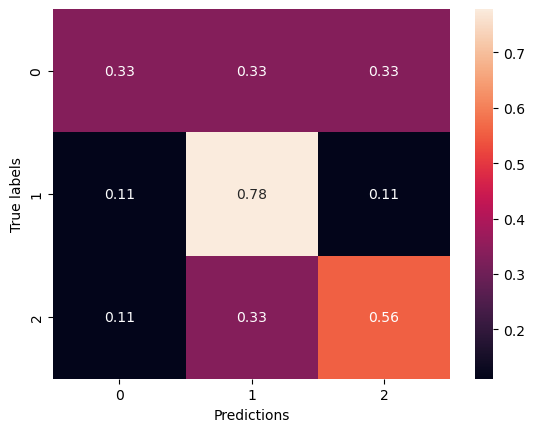

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▄▅▆▆▇▇▆▇▇▇▇▇▇▇█▇▇▇██▇▇██▆▇█▇▇▇▇▇▇▇▇█
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▂▄▅▅▆▄█▆▃▇▇▅▅▄▅█▅▇▆▄▃▅▄▄▄▇▇▄▅▄▃▆▇▆▇▅
val_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 23:24:10.896547: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:24:10.898128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:24:10.899993: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:24:12.526232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:24:12.528813: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:24:12.530565: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:24:16.682289: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:24:17.270692: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 50.6209 - accuracy: 0.3516

2024-03-12 23:24:20.706282: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:24:20.708481: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:24:20.710101: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 1s/step - loss: 50.6209 - accuracy: 0.3516 - val_loss: 38.7865 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 215ms/step - loss: 34.9577 - accuracy: 0.3493 - val_loss: 27.0191 - val_accuracy: 0.1296
Epoch 3/100
4/4 [==============================] - 1s 215ms/step - loss: 24.2490 - accuracy: 0.3904 - val_loss: 19.2650 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 215ms/step - loss: 17.2178 - accuracy: 0.4247 - val_loss: 14.3922 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 218ms/step - loss: 12.7693 - accuracy: 0.3927 - val_loss: 11.2190 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 217ms/step - loss: 9.8448 - accuracy: 0.4658 - val_loss: 9.4164 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 223ms/step - loss: 8.0177 - accuracy: 0.5251 - val_loss: 7.9491 - val_accuracy: 0.1296
Epoch 8/100
4/4 [

Epoch 59/100
4/4 [==============================] - 1s 215ms/step - loss: 2.1832 - accuracy: 0.6941 - val_loss: 5.1588 - val_accuracy: 0.1111
Epoch 60/100
4/4 [==============================] - 1s 216ms/step - loss: 2.2836 - accuracy: 0.7237 - val_loss: 4.6927 - val_accuracy: 0.1296
Epoch 61/100
4/4 [==============================] - 1s 214ms/step - loss: 2.2418 - accuracy: 0.7854 - val_loss: 3.5087 - val_accuracy: 0.3981
Epoch 62/100
4/4 [==============================] - 1s 215ms/step - loss: 2.1622 - accuracy: 0.7557 - val_loss: 4.1165 - val_accuracy: 0.2315
Epoch 63/100
4/4 [==============================] - 1s 218ms/step - loss: 2.2214 - accuracy: 0.7169 - val_loss: 3.8899 - val_accuracy: 0.2315
Epoch 64/100
4/4 [==============================] - 1s 218ms/step - loss: 2.3873 - accuracy: 0.7146 - val_loss: 6.2826 - val_accuracy: 0.1204
Epoch 65/100
4/4 [==============================] - 1s 218ms/step - loss: 2.4301 - accuracy: 0.7283 - val_loss: 5.3016 - val_accuracy: 0.1667
Epoch 

2024-03-12 23:25:51.452692: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:25:51.454409: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:25:51.456297: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5312609672546387 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.7777777777777778, 'f1-score': 0.4666666666666666, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.27777777777777773, 'recall': 0.3703703703703704, 'f1-score': 0.2888888888888889, 'support': 27}, 'weighted avg': {'precision': 0.2777777777777778, 'recall': 0.37037037037037035, 'f1-score': 0.28888888888888886, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


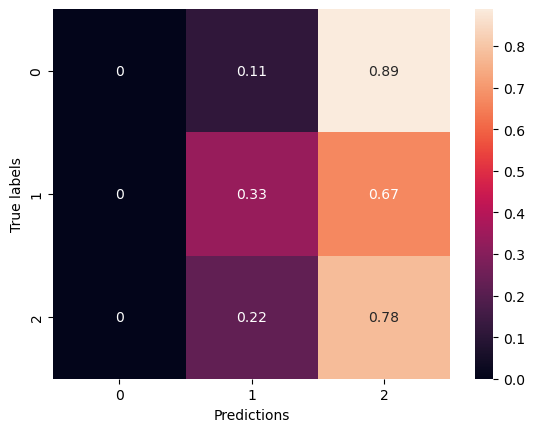

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▆▆▆▇▇▇▇▆██▇█▇▇█▇██▆█▇▆▇▇▇█▇▇▇█▇█▇▇█
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▁▁▄▆█▅▇▄▄▃▆▃▅█▁▇▄▁▄▁▅▁▂▆▃▁▇▇▆▇▇▁▁▆▁▇
val_loss,█▄▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂▁▂▁▂▁▁▁▂▁▁▁▁▁▂▂▁▁▁


Epoch 1/100


2024-03-12 23:26:16.691643: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:26:16.694051: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:26:16.695728: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:26:18.330499: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:26:18.332431: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:26:18.334414: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:26:22.485966: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:26:23.069754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 10.9308 - accuracy: 0.4224

2024-03-12 23:26:26.797550: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:26:26.799743: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:26:26.801437: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 808ms/step - loss: 10.9308 - accuracy: 0.4224 - val_loss: 10.7633 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 292ms/step - loss: 9.5146 - accuracy: 0.6142 - val_loss: 10.9424 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 286ms/step - loss: 8.5459 - accuracy: 0.6872 - val_loss: 10.5185 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 291ms/step - loss: 7.6189 - accuracy: 0.7534 - val_loss: 10.5251 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 291ms/step - loss: 6.8557 - accuracy: 0.7694 - val_loss: 8.9764 - val_accuracy: 0.1296
Epoch 6/100
4/4 [==============================] - 1s 286ms/step - loss: 6.1110 - accuracy: 0.8151 - val_loss: 7.6876 - val_accuracy: 0.1296
Epoch 7/100
4/4 [==============================] - 1s 292ms/step - loss: 5.5177 - accuracy: 0.7968 - val_loss: 7.8777 - val_accuracy: 0.1204
Epoch 8/100
4/4 [==

Epoch 59/100
4/4 [==============================] - 1s 293ms/step - loss: 1.2045 - accuracy: 0.8927 - val_loss: 3.0959 - val_accuracy: 0.5556
Epoch 60/100
4/4 [==============================] - 1s 293ms/step - loss: 1.2064 - accuracy: 0.9315 - val_loss: 3.3100 - val_accuracy: 0.5093
Epoch 61/100
4/4 [==============================] - 1s 291ms/step - loss: 1.2024 - accuracy: 0.9475 - val_loss: 3.4415 - val_accuracy: 0.5000
Epoch 62/100
4/4 [==============================] - 1s 286ms/step - loss: 1.1937 - accuracy: 0.9589 - val_loss: 3.1194 - val_accuracy: 0.5556
Epoch 63/100
4/4 [==============================] - 1s 293ms/step - loss: 1.1573 - accuracy: 0.9703 - val_loss: 3.3039 - val_accuracy: 0.5648
Epoch 64/100
4/4 [==============================] - 1s 288ms/step - loss: 1.0801 - accuracy: 0.9703 - val_loss: 3.2548 - val_accuracy: 0.5185
Epoch 65/100
4/4 [==============================] - 1s 290ms/step - loss: 1.0119 - accuracy: 0.9749 - val_loss: 3.9715 - val_accuracy: 0.4167
Epoch 

2024-03-12 23:28:27.164036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:28:27.165924: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:28:27.167808: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4920439720153809 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, '2': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.25641025641025644, 'recall': 0.3703703703703704, 'f1-score': 0.30303030303030304, 'support': 27}, 'weighted avg': {'precision': 0.25641025641025644, 'recall': 0.37037037037037035, 'f1-score': 0.3030303030303031, 'support': 27}}


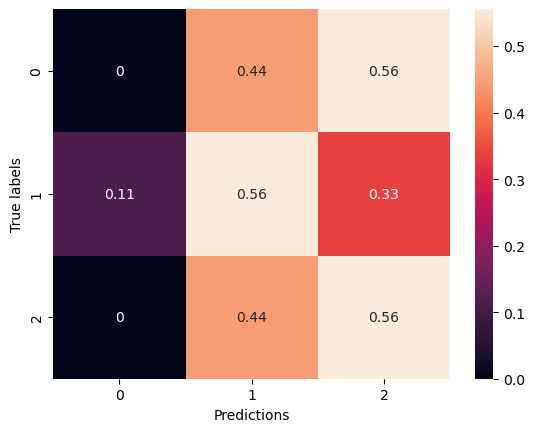

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇█▇▇▇▇█▇██▇███▇███▇██▇▇████▇▇█▇▇█▇▇
training_loss,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▂
training_time,▁
val_accuracy,▁▁▁▁▂▂▇█▆▆▆▆▇▆▇▇▆▆▄▆▆▇▇▇▇▇▆▇▆▆▅▅▆▇▇█▇▅▇▆
val_loss,██▅▄▃▄▂▁▂▂▂▁▁▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▂▁▁▂▁▁


Epoch 1/100


2024-03-12 23:28:50.957158: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:28:50.958676: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:28:50.961141: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:28:52.590035: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:28:52.591872: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:28:52.594324: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:28:57.906410: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:28:58.502584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 43.8094 - accuracy: 0.4224

2024-03-12 23:29:02.260963: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:29:02.263333: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:29:02.264907: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 806ms/step - loss: 43.8094 - accuracy: 0.4224 - val_loss: 32.5830 - val_accuracy: 0.1574
Epoch 2/100
4/4 [==============================] - 1s 292ms/step - loss: 28.4644 - accuracy: 0.6050 - val_loss: 23.1076 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 289ms/step - loss: 18.4692 - accuracy: 0.6461 - val_loss: 16.1316 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 289ms/step - loss: 11.9275 - accuracy: 0.7443 - val_loss: 11.9363 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 291ms/step - loss: 8.2672 - accuracy: 0.7374 - val_loss: 8.6200 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 294ms/step - loss: 6.2290 - accuracy: 0.7648 - val_loss: 6.6508 - val_accuracy: 0.2407
Epoch 7/100
4/4 [==============================] - 1s 292ms/step - loss: 5.0945 - accuracy: 0.7671 - val_loss: 5.4017 - val_accuracy: 0.3426
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 1s 288ms/step - loss: 1.4815 - accuracy: 0.9201 - val_loss: 3.0088 - val_accuracy: 0.5185
Epoch 60/100
4/4 [==============================] - 1s 292ms/step - loss: 1.5964 - accuracy: 0.9018 - val_loss: 4.0002 - val_accuracy: 0.3704
Epoch 61/100
4/4 [==============================] - 1s 284ms/step - loss: 1.8675 - accuracy: 0.8402 - val_loss: 4.6991 - val_accuracy: 0.3426
Epoch 62/100
4/4 [==============================] - 1s 292ms/step - loss: 2.0379 - accuracy: 0.8950 - val_loss: 4.4609 - val_accuracy: 0.3333
Epoch 63/100
4/4 [==============================] - 1s 321ms/step - loss: 2.1930 - accuracy: 0.8813 - val_loss: 3.5403 - val_accuracy: 0.4537
Epoch 64/100
4/4 [==============================] - 1s 291ms/step - loss: 2.0106 - accuracy: 0.8995 - val_loss: 3.2204 - val_accuracy: 0.5463
Epoch 65/100
4/4 [==============================] - 1s 293ms/step - loss: 1.7447 - accuracy: 0.9247 - val_loss: 3.1708 - val_accuracy: 0.5556
Epoch 

wandb: Network error (ConnectTimeout), entering retry loop.


4/4 [==============================] - 1s 288ms/step - loss: 1.3785 - accuracy: 0.9224 - val_loss: 3.2144 - val_accuracy: 0.5278
Epoch 93/100
4/4 [==============================] - 1s 293ms/step - loss: 1.4864 - accuracy: 0.8744 - val_loss: 3.8450 - val_accuracy: 0.3704
Epoch 94/100
4/4 [==============================] - 1s 291ms/step - loss: 1.7842 - accuracy: 0.8584 - val_loss: 4.0497 - val_accuracy: 0.3981
Epoch 95/100
4/4 [==============================] - 1s 287ms/step - loss: 2.0488 - accuracy: 0.8539 - val_loss: 3.6645 - val_accuracy: 0.4537
Epoch 96/100
4/4 [==============================] - 1s 285ms/step - loss: 2.1198 - accuracy: 0.8699 - val_loss: 3.2835 - val_accuracy: 0.5833
Epoch 97/100
4/4 [==============================] - 1s 293ms/step - loss: 2.0283 - accuracy: 0.8881 - val_loss: 3.9299 - val_accuracy: 0.4352
Epoch 98/100
4/4 [==============================] - 1s 288ms/step - loss: 1.9026 - accuracy: 0.8881 - val_loss: 3.4652 - val_accuracy: 0.4259
Epoch 99/100
4/4 [=

2024-03-12 23:31:02.694377: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:31:02.696001: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:31:02.697806: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.4831860065460205 s
{'0': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '1': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.8888888888888888, 'f1-score': 0.5925925925925926, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.6243386243386243, 'recall': 0.48148148148148145, 'f1-score': 0.443742985409652, 'support': 27}, 'weighted avg': {'precision': 0.6243386243386243, 'recall': 0.48148148148148145, 'f1-score': 0.44374298540965207, 'support': 27}}


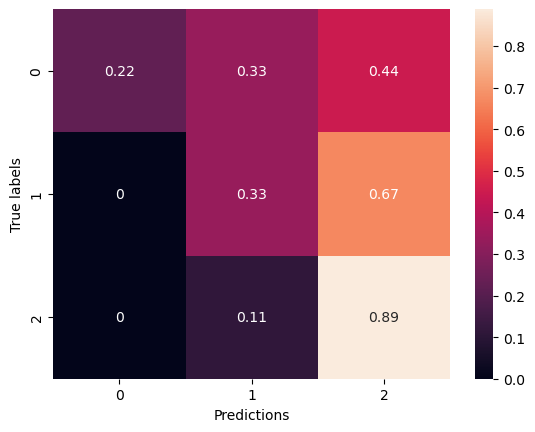

wandb: Network error (ConnectTimeout), entering retry loop.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▇▇▇▇▇▇▇▇▇█▇▆██▆██▇▇▇█▇▇█▇▇██▇▇▇▇██▇▇▇
training_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▃▄▄▅▅▅█▅▆█▅▇▆▇▆█▆█▇▅▅▇▄▇▆▅▇▅█▆▆▅▆▄▇▅▆▆
val_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 23:32:33.100012: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:32:33.102168: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:32:33.103706: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:32:34.721791: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:32:34.724041: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:32:34.725754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:32:38.897246: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:32:39.483467: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 59.7746 - accuracy: 0.4201

2024-03-12 23:32:43.231886: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:32:43.233549: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:32:43.235583: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 12s 802ms/step - loss: 59.7746 - accuracy: 0.4201 - val_loss: 42.2573 - val_accuracy: 0.1667
Epoch 2/100
4/4 [==============================] - 1s 287ms/step - loss: 35.9810 - accuracy: 0.5959 - val_loss: 25.5899 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 288ms/step - loss: 20.8643 - accuracy: 0.6644 - val_loss: 15.6701 - val_accuracy: 0.1296
Epoch 4/100
4/4 [==============================] - 1s 295ms/step - loss: 12.2880 - accuracy: 0.7329 - val_loss: 11.0644 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 295ms/step - loss: 8.0245 - accuracy: 0.7443 - val_loss: 7.9520 - val_accuracy: 0.1667
Epoch 6/100
4/4 [==============================] - 1s 291ms/step - loss: 6.0629 - accuracy: 0.7922 - val_loss: 7.1134 - val_accuracy: 0.1389
Epoch 7/100
4/4 [==============================] - 1s 292ms/step - loss: 5.2006 - accuracy: 0.7534 - val_loss: 5.1838 - val_accuracy: 0.5463
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 1s 300ms/step - loss: 1.5605 - accuracy: 0.9247 - val_loss: 3.4742 - val_accuracy: 0.3889
Epoch 60/100
4/4 [==============================] - 1s 295ms/step - loss: 1.5056 - accuracy: 0.9041 - val_loss: 3.1149 - val_accuracy: 0.5000
Epoch 61/100
4/4 [==============================] - 1s 291ms/step - loss: 1.6730 - accuracy: 0.8630 - val_loss: 3.1151 - val_accuracy: 0.5463
Epoch 62/100
4/4 [==============================] - 1s 291ms/step - loss: 1.8000 - accuracy: 0.8630 - val_loss: 3.9171 - val_accuracy: 0.3981
Epoch 63/100
4/4 [==============================] - 1s 287ms/step - loss: 1.8100 - accuracy: 0.9155 - val_loss: 3.8645 - val_accuracy: 0.4074
Epoch 64/100
4/4 [==============================] - 1s 294ms/step - loss: 1.7957 - accuracy: 0.9224 - val_loss: 3.5457 - val_accuracy: 0.4259
Epoch 65/100
4/4 [==============================] - 1s 293ms/step - loss: 1.8690 - accuracy: 0.8699 - val_loss: 4.5809 - val_accuracy: 0.3333
Epoch 

2024-03-12 23:34:48.390335: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:34:48.392719: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:34:48.395581: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.0861871242523193 s
{'0': {'precision': 0.25, 'recall': 0.3333333333333333, 'f1-score': 0.28571428571428575, 'support': 9}, '1': {'precision': 0.36363636363636365, 'recall': 0.4444444444444444, 'f1-score': 0.39999999999999997, 'support': 9}, '2': {'precision': 0.25, 'recall': 0.1111111111111111, 'f1-score': 0.15384615384615383, 'support': 9}, 'accuracy': 0.2962962962962963, 'macro avg': {'precision': 0.2878787878787879, 'recall': 0.2962962962962963, 'f1-score': 0.27985347985347986, 'support': 27}, 'weighted avg': {'precision': 0.2878787878787879, 'recall': 0.2962962962962963, 'f1-score': 0.2798534798534798, 'support': 27}}


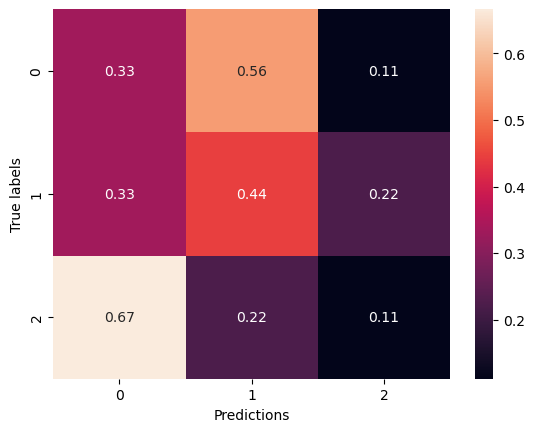

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇██▇▇█████▇▇██
training_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▇▇▆▇█▄▅▄▅▃▅▅▂▄▅▄▄▅▆▆▅▇▅▁▃▄█▄▄▇▆▅▄▂▃▆▅
val_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 23:35:14.146259: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:35:14.147840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:35:14.149847: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:35:16.995145: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:35:16.996866: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:35:16.999170: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:35:21.135515: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:35:21.721128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 11.0387 - accuracy: 0.4087

2024-03-12 23:35:25.472631: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:35:25.474720: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:35:25.476440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 13s 803ms/step - loss: 11.0387 - accuracy: 0.4087 - val_loss: 10.8891 - val_accuracy: 0.1389
Epoch 2/100
4/4 [==============================] - 1s 322ms/step - loss: 10.0209 - accuracy: 0.4726 - val_loss: 10.6750 - val_accuracy: 0.1296
Epoch 3/100
4/4 [==============================] - 1s 289ms/step - loss: 9.2100 - accuracy: 0.5548 - val_loss: 11.5172 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 289ms/step - loss: 8.6370 - accuracy: 0.5890 - val_loss: 11.6050 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 288ms/step - loss: 7.9394 - accuracy: 0.6438 - val_loss: 10.7921 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 290ms/step - loss: 7.4124 - accuracy: 0.6461 - val_loss: 10.5010 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 288ms/step - loss: 6.7886 - accuracy: 0.7032 - val_loss: 9.9085 - val_accuracy: 0.1204
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 2s 391ms/step - loss: 1.4326 - accuracy: 0.9110 - val_loss: 4.0144 - val_accuracy: 0.3611
Epoch 60/100
4/4 [==============================] - 2s 386ms/step - loss: 1.4970 - accuracy: 0.9018 - val_loss: 3.5355 - val_accuracy: 0.3981
Epoch 61/100
4/4 [==============================] - 2s 388ms/step - loss: 1.4785 - accuracy: 0.9224 - val_loss: 3.2170 - val_accuracy: 0.5093
Epoch 62/100
4/4 [==============================] - 2s 383ms/step - loss: 1.5001 - accuracy: 0.9406 - val_loss: 3.7703 - val_accuracy: 0.4352
Epoch 63/100
4/4 [==============================] - 2s 389ms/step - loss: 1.4653 - accuracy: 0.9361 - val_loss: 4.6327 - val_accuracy: 0.2963
Epoch 64/100
4/4 [==============================] - 2s 387ms/step - loss: 1.4227 - accuracy: 0.9429 - val_loss: 4.5734 - val_accuracy: 0.3519
Epoch 65/100
4/4 [==============================] - 2s 386ms/step - loss: 1.4289 - accuracy: 0.9247 - val_loss: 4.4596 - val_accuracy: 0.3796
Epoch 

2024-03-12 23:38:06.677502: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:38:06.680095: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:38:06.682514: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.0729198455810547 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '2': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5128205128205128, 'recall': 0.5185185185185185, 'f1-score': 0.49012391117654275, 'support': 27}, 'weighted avg': {'precision': 0.5128205128205129, 'recall': 0.5185185185185185, 'f1-score': 0.49012391117654275, 'support': 27}}


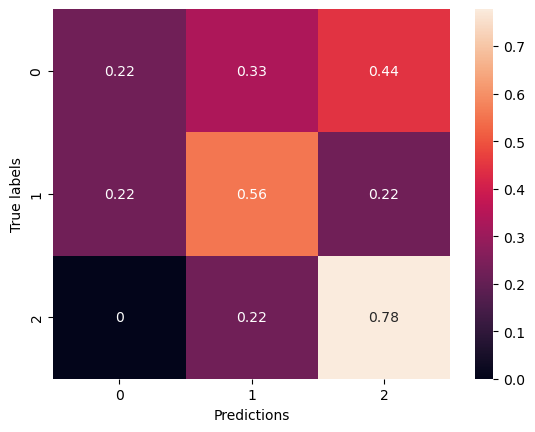

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▇▇█▇▇▇█████▇▇▇███▇████▇▇██████████
training_loss,█▇▅▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▄▇██▆▇▆█▅▄█▆▆▅▅▅▅▇▅▅▆▆▆▇▇▅▅▅▅▆▇▅▇
val_loss,▇█▇▆▅▄▄▂▂▁▁▂▁▁▁▂▂▁▁▁▂▂▂▂▁▂▂▂▂▁▁▁▂▂▂▂▁▁▂▁


Epoch 1/100


2024-03-12 23:38:37.481415: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:38:37.484643: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:38:37.486878: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:38:39.746478: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:38:39.748903: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:38:39.751512: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:38:45.547224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:38:46.359852: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 44.4059 - accuracy: 0.4132

2024-03-12 23:38:51.598962: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:38:51.601183: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:38:51.603820: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 16s 1s/step - loss: 44.4059 - accuracy: 0.4132 - val_loss: 34.6295 - val_accuracy: 0.1389
Epoch 2/100
4/4 [==============================] - 2s 400ms/step - loss: 30.6058 - accuracy: 0.5320 - val_loss: 25.8092 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 2s 412ms/step - loss: 21.3521 - accuracy: 0.5753 - val_loss: 19.9426 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 2s 405ms/step - loss: 15.2025 - accuracy: 0.6347 - val_loss: 16.4749 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 2s 396ms/step - loss: 11.3281 - accuracy: 0.7009 - val_loss: 13.6803 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 2s 394ms/step - loss: 9.0037 - accuracy: 0.6553 - val_loss: 10.3420 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 2s 393ms/step - loss: 7.3853 - accuracy: 0.7374 - val_loss: 9.4857 - val_accuracy: 0.1204
Epoch 8/100
4/4 

Epoch 59/100
4/4 [==============================] - 2s 405ms/step - loss: 1.5750 - accuracy: 0.9155 - val_loss: 3.5475 - val_accuracy: 0.4630
Epoch 60/100
4/4 [==============================] - 2s 385ms/step - loss: 1.4424 - accuracy: 0.9064 - val_loss: 3.7413 - val_accuracy: 0.3611
Epoch 61/100
4/4 [==============================] - 2s 396ms/step - loss: 1.4807 - accuracy: 0.8676 - val_loss: 3.1728 - val_accuracy: 0.4630
Epoch 62/100
4/4 [==============================] - 2s 392ms/step - loss: 1.7435 - accuracy: 0.8402 - val_loss: 4.4505 - val_accuracy: 0.3796
Epoch 63/100
4/4 [==============================] - 2s 395ms/step - loss: 2.0100 - accuracy: 0.8402 - val_loss: 3.9869 - val_accuracy: 0.3333
Epoch 64/100
4/4 [==============================] - 2s 394ms/step - loss: 2.1412 - accuracy: 0.8311 - val_loss: 3.4062 - val_accuracy: 0.4259
Epoch 65/100
4/4 [==============================] - 2s 394ms/step - loss: 2.0980 - accuracy: 0.8767 - val_loss: 3.2614 - val_accuracy: 0.5556
Epoch 

2024-03-12 23:41:34.650688: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:41:34.653145: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:41:34.656037: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 3.437371015548706 s
{'0': {'precision': 0.2727272727272727, 'recall': 0.3333333333333333, 'f1-score': 0.3, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.42424242424242425, 'recall': 0.40740740740740744, 'f1-score': 0.36350461133069834, 'support': 27}, 'weighted avg': {'precision': 0.4242424242424242, 'recall': 0.4074074074074074, 'f1-score': 0.36350461133069834, 'support': 27}}


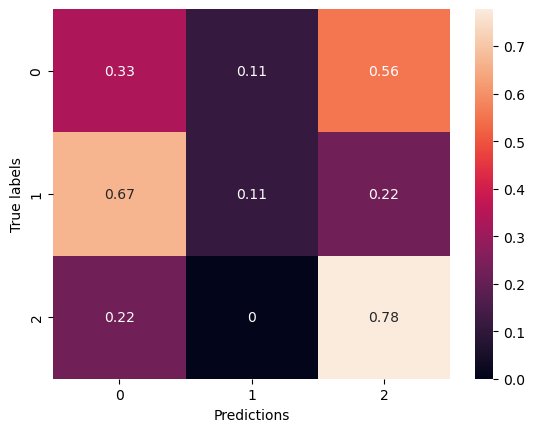

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▆▆▇▇█▇▇▇█▇▆██▇▇▇▇▇▇█▇▇██▇█▇█▇███▇▇██
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▄▆▆▇▆▅▆▅▇▄▄▇▆▆███▅▆▆▆▅▇▆▄▅▃▇▇▇▃█▅▅▆▆
val_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-12 23:42:06.451764: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:42:06.454153: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:42:06.456645: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:42:08.717680: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:42:08.720973: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:42:08.723345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-12 23:42:14.500612: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-12 23:42:15.316464: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 60.1831 - accuracy: 0.3584

2024-03-12 23:42:21.453493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-12 23:42:21.456493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-12 23:42:21.459353: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 17s 1s/step - loss: 60.1831 - accuracy: 0.3584 - val_loss: 43.3927 - val_accuracy: 0.1852
Epoch 2/100
4/4 [==============================] - 3s 680ms/step - loss: 37.7178 - accuracy: 0.4680 - val_loss: 28.2038 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 3s 636ms/step - loss: 23.2446 - accuracy: 0.5708 - val_loss: 19.2066 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 3s 629ms/step - loss: 14.9407 - accuracy: 0.6164 - val_loss: 13.6727 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 3s 661ms/step - loss: 10.2736 - accuracy: 0.6210 - val_loss: 10.8692 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 4s 867ms/step - loss: 7.8829 - accuracy: 0.6438 - val_loss: 8.1922 - val_accuracy: 0.1852
Epoch 7/100
4/4 [==============================] - 3s 824ms/step - loss: 6.5255 - accuracy: 0.7374 - val_loss: 6.7164 - val_accuracy: 0.2593
Epoch 8/100
4/4 [

wandb: Network error (ConnectionError), entering retry loop.


4/4 [==============================] - 3s 656ms/step - loss: 2.2780 - accuracy: 0.7831 - val_loss: 4.6604 - val_accuracy: 0.2037
Epoch 42/100
4/4 [==============================] - 2s 533ms/step - loss: 2.6849 - accuracy: 0.7397 - val_loss: 4.7744 - val_accuracy: 0.1852
Epoch 43/100
4/4 [==============================] - 3s 735ms/step - loss: 2.7142 - accuracy: 0.7922 - val_loss: 3.4878 - val_accuracy: 0.5370
Epoch 44/100
4/4 [==============================] - 3s 627ms/step - loss: 2.5466 - accuracy: 0.8014 - val_loss: 3.2493 - val_accuracy: 0.4907
Epoch 45/100
4/4 [==============================] - 3s 693ms/step - loss: 2.2305 - accuracy: 0.8082 - val_loss: 3.0161 - val_accuracy: 0.5741
Epoch 46/100
4/4 [==============================] - 3s 714ms/step - loss: 1.9965 - accuracy: 0.8174 - val_loss: 2.9796 - val_accuracy: 0.5278
Epoch 47/100
4/4 [==============================] - 3s 844ms/step - loss: 1.8565 - accuracy: 0.8174 - val_loss: 3.0726 - val_accuracy: 0.4815
Epoch 48/100
4/4 [=

Epoch 99/100
4/4 [==============================] - 1s 259ms/step - loss: 1.6909 - accuracy: 0.8493 - val_loss: 3.2794 - val_accuracy: 0.3981
Epoch 100/100
4/4 [==============================] - 1s 257ms/step - loss: 1.6999 - accuracy: 0.8539 - val_loss: 3.0536 - val_accuracy: 0.4259
Training done in 1464.7042970657349 s


2024-03-13 00:06:31.179392: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:06:31.181679: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:06:31.183567: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.8087730407714844 s
{'0': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '1': {'precision': 0.47058823529411764, 'recall': 0.8888888888888888, 'f1-score': 0.6153846153846153, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.4444444444444444, 'f1-score': 0.6153846153846153, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6568627450980392, 'recall': 0.5555555555555555, 'f1-score': 0.5435897435897435, 'support': 27}, 'weighted avg': {'precision': 0.6568627450980392, 'recall': 0.5555555555555556, 'f1-score': 0.5435897435897435, 'support': 27}}


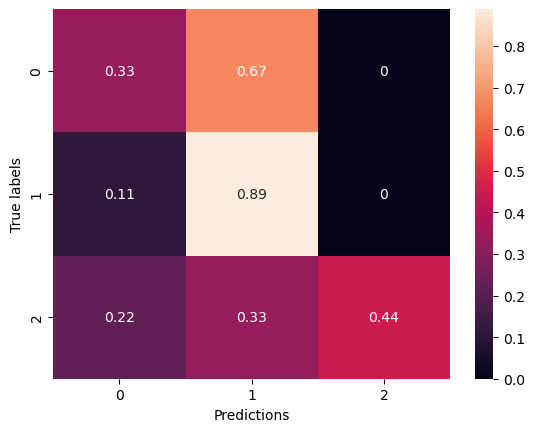

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇█▇▇▇██▇▇▇▇▇▇▇▇▇█▇██▇██▇▇▇███▇████
training_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▄▅▄▇█▄▄▃▅▆▆▆▅▂▆▇▁▆▆▆▇▄▄▇▆▁▅▄▅▃▄▄▆▁▄▅▆
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 00:07:16.395074: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:07:16.396678: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:07:16.398607: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:07:18.043491: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:07:18.045237: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:07:18.047355: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:07:24.799592: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:07:25.381316: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 11.2052 - accuracy: 0.3242

2024-03-13 00:07:29.049425: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:07:29.051618: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:07:29.053172: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 14s 777ms/step - loss: 11.2052 - accuracy: 0.3242 - val_loss: 10.2462 - val_accuracy: 0.1574
Epoch 2/100
4/4 [==============================] - 1s 265ms/step - loss: 10.5032 - accuracy: 0.3858 - val_loss: 10.3717 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 315ms/step - loss: 9.8314 - accuracy: 0.4064 - val_loss: 10.0319 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 268ms/step - loss: 9.2175 - accuracy: 0.4452 - val_loss: 10.2223 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 262ms/step - loss: 8.6690 - accuracy: 0.5000 - val_loss: 10.3039 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 269ms/step - loss: 8.2138 - accuracy: 0.5297 - val_loss: 10.4044 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 266ms/step - loss: 7.7491 - accuracy: 0.5251 - val_loss: 10.4992 - val_accuracy: 0.1204
Epoch 8/100
4/4

Epoch 59/100
4/4 [==============================] - 1s 278ms/step - loss: 1.5669 - accuracy: 0.8858 - val_loss: 3.9563 - val_accuracy: 0.3148
Epoch 60/100
4/4 [==============================] - 1s 264ms/step - loss: 1.5299 - accuracy: 0.8836 - val_loss: 3.7513 - val_accuracy: 0.3148
Epoch 61/100
4/4 [==============================] - 1s 276ms/step - loss: 1.5915 - accuracy: 0.8813 - val_loss: 3.2139 - val_accuracy: 0.5093
Epoch 62/100
4/4 [==============================] - 136s 45s/step - loss: 1.6457 - accuracy: 0.8562 - val_loss: 3.3367 - val_accuracy: 0.4167
Epoch 63/100
4/4 [==============================] - 1s 315ms/step - loss: 1.5742 - accuracy: 0.8744 - val_loss: 3.1705 - val_accuracy: 0.4722
Epoch 64/100
4/4 [==============================] - 2s 614ms/step - loss: 1.5701 - accuracy: 0.8836 - val_loss: 3.0852 - val_accuracy: 0.5093
Epoch 65/100
4/4 [==============================] - 1s 334ms/step - loss: 1.5860 - accuracy: 0.8881 - val_loss: 3.2526 - val_accuracy: 0.4630
Epoch 

2024-03-13 00:12:17.200992: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:12:17.202746: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:12:17.204509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.7004289627075195 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.8333333333333334, 'recall': 0.5555555555555556, 'f1-score': 0.6666666666666667, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 1.0, 'f1-score': 0.6, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.42063492063492064, 'recall': 0.5185185185185185, 'f1-score': 0.4222222222222222, 'support': 27}, 'weighted avg': {'precision': 0.42063492063492064, 'recall': 0.5185185185185185, 'f1-score': 0.4222222222222222, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


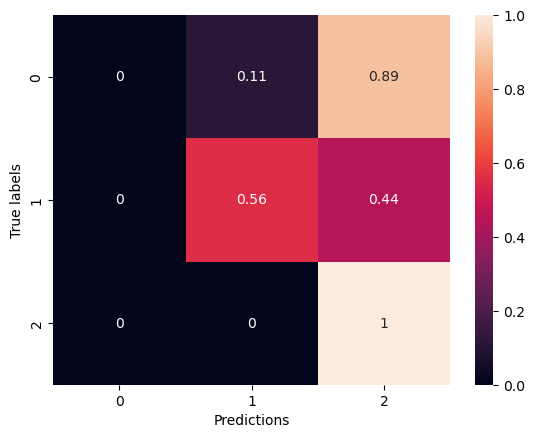

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▅▅▅▆▆▆▇▆▇▇▇▇█▇▆▇▇█████▇██████▇▆▇███
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▂▁▂▃▆▂▄██▆▅▅▄▆▇▇▅▄▇▇█▇▅▅▆▅▇█▁▇▇█▆█
val_loss,████▆▅▄▄▃▃▂▃▂▁▁▁▂▂▃▁▁▁▂▂▁▁▁▁▂▂▁▂▁▁▂▁▁▂▁▁


Epoch 1/100


2024-03-13 00:12:38.937194: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:12:38.938782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:12:38.940740: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:12:40.490565: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:12:40.492724: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:12:40.494429: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:12:44.453258: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:12:45.008809: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 44.5618 - accuracy: 0.3311

2024-03-13 00:12:48.578624: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:12:48.580291: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:12:48.582491: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 11s 762ms/step - loss: 44.5618 - accuracy: 0.3311 - val_loss: 35.0146 - val_accuracy: 0.1204
Epoch 2/100
4/4 [==============================] - 1s 277ms/step - loss: 31.6986 - accuracy: 0.3881 - val_loss: 25.3879 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 270ms/step - loss: 22.9486 - accuracy: 0.4292 - val_loss: 19.4357 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 269ms/step - loss: 17.1894 - accuracy: 0.4635 - val_loss: 15.3345 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 269ms/step - loss: 13.4407 - accuracy: 0.4635 - val_loss: 12.9183 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 269ms/step - loss: 10.8895 - accuracy: 0.4932 - val_loss: 11.3720 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 269ms/step - loss: 9.1665 - accuracy: 0.5502 - val_loss: 10.0593 - val_accuracy: 0.1296
Epoch 8/100

Epoch 59/100
4/4 [==============================] - 4s 1s/step - loss: 2.2807 - accuracy: 0.8174 - val_loss: 3.6807 - val_accuracy: 0.3981
Epoch 60/100
4/4 [==============================] - 5s 1s/step - loss: 2.2681 - accuracy: 0.8082 - val_loss: 3.3075 - val_accuracy: 0.4352
Epoch 61/100
4/4 [==============================] - 5s 1s/step - loss: 2.4215 - accuracy: 0.7466 - val_loss: 3.1581 - val_accuracy: 0.6296
Epoch 62/100
4/4 [==============================] - 4s 1s/step - loss: 2.4329 - accuracy: 0.7900 - val_loss: 3.3852 - val_accuracy: 0.5648
Epoch 63/100
4/4 [==============================] - 5s 1s/step - loss: 2.4779 - accuracy: 0.7671 - val_loss: 3.2372 - val_accuracy: 0.6019
Epoch 64/100
4/4 [==============================] - 25s 8s/step - loss: 2.4302 - accuracy: 0.8128 - val_loss: 3.4671 - val_accuracy: 0.4907
Epoch 65/100
4/4 [==============================] - 2s 505ms/step - loss: 2.4466 - accuracy: 0.7854 - val_loss: 4.1898 - val_accuracy: 0.2593
Epoch 66/100
4/4 [=====

2024-03-13 00:32:29.826619: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:32:29.829443: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:32:29.832040: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.8642070293426514 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, '2': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5128205128205128, 'recall': 0.5185185185185185, 'f1-score': 0.4632034632034632, 'support': 27}, 'weighted avg': {'precision': 0.5128205128205129, 'recall': 0.5185185185185185, 'f1-score': 0.4632034632034632, 'support': 27}}


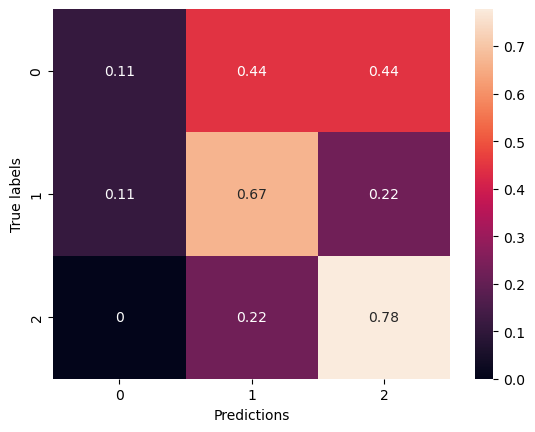

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▆▆▇▆▇▇▇▇▇▇█▇██▇▇████▇████▇▇█▇█▇▇▇▇▇█
training_loss,█▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▆▇▇▅▇▄█▇▆▆▆▇▆▆▇▁▄▅█▆▇▇▇▁▆▇▆▇▆▆▆▁▄▇
val_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁


Epoch 1/100


2024-03-13 00:33:22.276869: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:33:22.278782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:33:22.281326: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:33:25.366767: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:33:25.368578: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:33:25.370909: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:33:29.897939: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:33:30.510896: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


4/4 [==============================] - ETA: 0s - loss: 60.9103 - accuracy: 0.3265

2024-03-13 00:33:34.354621: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:33:34.356305: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:33:34.358252: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4/4 [==============================] - 14s 854ms/step - loss: 60.9103 - accuracy: 0.3265 - val_loss: 44.9923 - val_accuracy: 0.1389
Epoch 2/100
4/4 [==============================] - 1s 300ms/step - loss: 39.8176 - accuracy: 0.4292 - val_loss: 30.4949 - val_accuracy: 0.1204
Epoch 3/100
4/4 [==============================] - 1s 288ms/step - loss: 26.4051 - accuracy: 0.4110 - val_loss: 20.5957 - val_accuracy: 0.1204
Epoch 4/100
4/4 [==============================] - 1s 298ms/step - loss: 18.0175 - accuracy: 0.4041 - val_loss: 15.0263 - val_accuracy: 0.1204
Epoch 5/100
4/4 [==============================] - 1s 300ms/step - loss: 13.0982 - accuracy: 0.5023 - val_loss: 12.7317 - val_accuracy: 0.1204
Epoch 6/100
4/4 [==============================] - 1s 316ms/step - loss: 10.3626 - accuracy: 0.4954 - val_loss: 10.8503 - val_accuracy: 0.1204
Epoch 7/100
4/4 [==============================] - 1s 303ms/step - loss: 8.6963 - accuracy: 0.5731 - val_loss: 9.0326 - val_accuracy: 0.1296
Epoch 8/100


Epoch 59/100
4/4 [==============================] - 1s 311ms/step - loss: 2.4201 - accuracy: 0.7260 - val_loss: 3.3069 - val_accuracy: 0.5648
Epoch 60/100
4/4 [==============================] - 1s 286ms/step - loss: 2.4593 - accuracy: 0.7055 - val_loss: 3.2787 - val_accuracy: 0.5463
Epoch 61/100
4/4 [==============================] - 1s 290ms/step - loss: 2.4585 - accuracy: 0.7443 - val_loss: 3.2421 - val_accuracy: 0.4907
Epoch 62/100
4/4 [==============================] - 1s 291ms/step - loss: 2.4579 - accuracy: 0.7511 - val_loss: 3.1489 - val_accuracy: 0.5926
Epoch 63/100
4/4 [==============================] - 1s 295ms/step - loss: 2.3855 - accuracy: 0.7694 - val_loss: 3.1477 - val_accuracy: 0.5093
Epoch 64/100
4/4 [==============================] - 1s 326ms/step - loss: 2.2400 - accuracy: 0.8105 - val_loss: 3.0517 - val_accuracy: 0.6204
Epoch 65/100
4/4 [==============================] - 1s 286ms/step - loss: 2.3215 - accuracy: 0.7260 - val_loss: 3.0362 - val_accuracy: 0.5833
Epoch 

2024-03-13 00:35:54.912267: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:35:54.914297: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:35:54.916100: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.7214620113372803 s
{'0': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '2': {'precision': 0.3888888888888889, 'recall': 0.7777777777777778, 'f1-score': 0.5185185185185185, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.42962962962962964, 'recall': 0.40740740740740744, 'f1-score': 0.3706417039750372, 'support': 27}, 'weighted avg': {'precision': 0.42962962962962964, 'recall': 0.4074074074074074, 'f1-score': 0.37064170397503726, 'support': 27}}


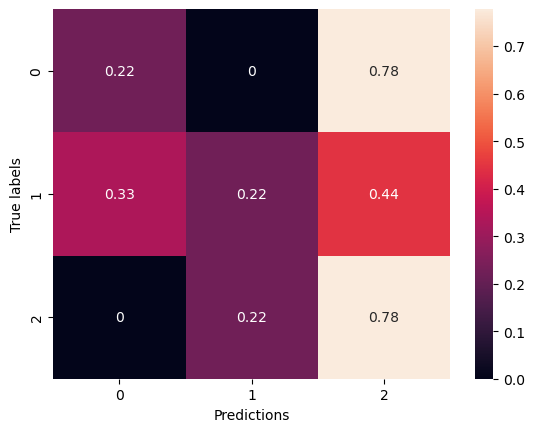

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▅▅▆▇▆▇▆▇▇▇▆█▇▇▇▇▇▇▇▇▇▇█▇█▇▇█▇█▇▇▇█▇▇▇
training_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▃▃▄▁▅▇▃█▅▅▄▄▅█▆▆▆▂▄▇▆█▇▇▃▄▆▆▇▃▆▆▅▇▆█
val_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 00:36:21.513538: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:36:21.515817: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:36:21.518390: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:36:23.244251: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:36:23.247672: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:36:23.250283: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:36:27.590775: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:36:28.194201: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 7.4262 - accuracy: 0.3767

2024-03-13 00:36:31.453998: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:36:31.455832: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:36:31.457768: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 7.4262 - accuracy: 0.3767 - val_loss: 6.8107 - val_accuracy: 0.1852
Epoch 2/100
2/2 [==============================] - 1s 275ms/step - loss: 6.6537 - accuracy: 0.5068 - val_loss: 6.6582 - val_accuracy: 0.1111
Epoch 3/100
2/2 [==============================] - 1s 283ms/step - loss: 6.0542 - accuracy: 0.6187 - val_loss: 6.3571 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 274ms/step - loss: 5.5229 - accuracy: 0.6849 - val_loss: 6.2151 - val_accuracy: 0.1111
Epoch 5/100
2/2 [==============================] - 1s 268ms/step - loss: 5.1101 - accuracy: 0.7032 - val_loss: 6.0179 - val_accuracy: 0.1111
Epoch 6/100
2/2 [==============================] - 1s 292ms/step - loss: 4.7533 - accuracy: 0.7466 - val_loss: 5.7560 - val_accuracy: 0.1111
Epoch 7/100
2/2 [==============================] - 1s 278ms/step - loss: 4.4645 - accuracy: 0.7511 - val_loss: 5.5798 - val_accuracy: 0.1111
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 270ms/step - loss: 0.5738 - accuracy: 0.9795 - val_loss: 2.8639 - val_accuracy: 0.5741
Epoch 60/100
2/2 [==============================] - 1s 296ms/step - loss: 0.5588 - accuracy: 0.9749 - val_loss: 3.0051 - val_accuracy: 0.5926
Epoch 61/100
2/2 [==============================] - 1s 273ms/step - loss: 0.6144 - accuracy: 0.9635 - val_loss: 3.0286 - val_accuracy: 0.5648
Epoch 62/100
2/2 [==============================] - 1s 275ms/step - loss: 0.5524 - accuracy: 0.9817 - val_loss: 2.7868 - val_accuracy: 0.5556
Epoch 63/100
2/2 [==============================] - 1s 277ms/step - loss: 0.5679 - accuracy: 0.9703 - val_loss: 2.6632 - val_accuracy: 0.5648
Epoch 64/100
2/2 [==============================] - 1s 273ms/step - loss: 0.5548 - accuracy: 0.9703 - val_loss: 2.8582 - val_accuracy: 0.5093
Epoch 65/100
2/2 [==============================] - 1s 312ms/step - loss: 0.5587 - accuracy: 0.9772 - val_loss: 2.8849 - val_accuracy: 0.5185
Epoch 

2024-03-13 00:37:29.210343: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:37:29.213636: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:37:29.216910: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.852283000946045 s
{'0': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '1': {'precision': 0.36363636363636365, 'recall': 0.4444444444444444, 'f1-score': 0.39999999999999997, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.4598364598364599, 'recall': 0.4444444444444444, 'f1-score': 0.44814814814814813, 'support': 27}, 'weighted avg': {'precision': 0.4598364598364598, 'recall': 0.4444444444444444, 'f1-score': 0.44814814814814813, 'support': 27}}


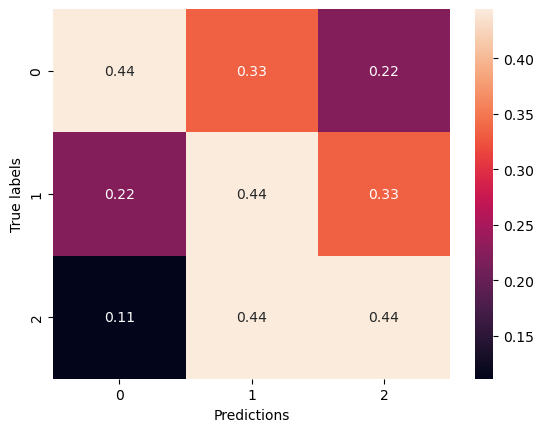

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇▇████████████████████████████████
training_loss,█▇▅▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▂▂▃▇▅▃▅▆▅▅▅▅▆▆▆▇▅▇▆██▇▇▆▇▆██▇▇▇▆▇▆▅▅
val_loss,█▇▆▆▅▄▃▁▂▅▂▁▁▂▂▂▂▁▁▁▂▂▂▁▂▁▁▂▂▂▁▁▂▂▂▂▂▂▃▃


Epoch 1/100


2024-03-13 00:37:55.053184: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:37:55.055320: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:37:55.056933: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:37:56.701359: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:37:56.703434: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:37:56.705199: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:38:01.067011: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:38:01.669166: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 29.9405 - accuracy: 0.3927

2024-03-13 00:38:04.868923: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:38:04.870510: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:38:04.872481: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 29.9405 - accuracy: 0.3927 - val_loss: 26.1774 - val_accuracy: 0.1389
Epoch 2/100
2/2 [==============================] - 1s 273ms/step - loss: 25.1126 - accuracy: 0.5342 - val_loss: 22.1736 - val_accuracy: 0.1481
Epoch 3/100
2/2 [==============================] - 1s 303ms/step - loss: 20.8391 - accuracy: 0.6164 - val_loss: 18.8105 - val_accuracy: 0.1667
Epoch 4/100
2/2 [==============================] - 1s 271ms/step - loss: 17.3275 - accuracy: 0.7055 - val_loss: 15.5224 - val_accuracy: 0.1852
Epoch 5/100
2/2 [==============================] - 1s 272ms/step - loss: 14.2313 - accuracy: 0.6963 - val_loss: 12.7466 - val_accuracy: 0.2500
Epoch 6/100
2/2 [==============================] - 1s 269ms/step - loss: 11.6437 - accuracy: 0.6986 - val_loss: 10.8911 - val_accuracy: 0.1667
Epoch 7/100
2/2 [==============================] - 1s 264ms/step - loss: 9.4317 - accuracy: 0.7785 - val_loss: 9.3310 - val_accuracy: 0.1389
Epoch 8/100
2/2

Epoch 59/100
2/2 [==============================] - 1s 297ms/step - loss: 0.8488 - accuracy: 0.9795 - val_loss: 2.7227 - val_accuracy: 0.5093
Epoch 60/100
2/2 [==============================] - 1s 267ms/step - loss: 0.8184 - accuracy: 0.9817 - val_loss: 2.6446 - val_accuracy: 0.5741
Epoch 61/100
2/2 [==============================] - 1s 273ms/step - loss: 0.7698 - accuracy: 0.9863 - val_loss: 2.8828 - val_accuracy: 0.5370
Epoch 62/100
2/2 [==============================] - 1s 272ms/step - loss: 0.7730 - accuracy: 0.9703 - val_loss: 2.7814 - val_accuracy: 0.5370
Epoch 63/100
2/2 [==============================] - 1s 273ms/step - loss: 0.7415 - accuracy: 0.9680 - val_loss: 2.6941 - val_accuracy: 0.4537
Epoch 64/100
2/2 [==============================] - 1s 268ms/step - loss: 0.7240 - accuracy: 0.9658 - val_loss: 3.9084 - val_accuracy: 0.3519
Epoch 65/100
2/2 [==============================] - 1s 269ms/step - loss: 0.7169 - accuracy: 0.9703 - val_loss: 3.9581 - val_accuracy: 0.3704
Epoch 

2024-03-13 00:39:00.194339: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:39:00.196223: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:39:00.198026: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5334208011627197 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.25, 'recall': 0.1111111111111111, 'f1-score': 0.15384615384615383, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 1.0, 'f1-score': 0.6, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.2261904761904762, 'recall': 0.3703703703703704, 'f1-score': 0.2512820512820513, 'support': 27}, 'weighted avg': {'precision': 0.22619047619047616, 'recall': 0.37037037037037035, 'f1-score': 0.2512820512820512, 'support': 27}}


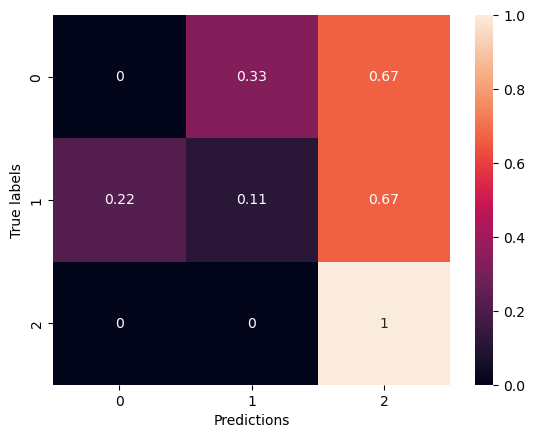

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▅▆▇▇▇▇▇▇▇▇██▇▇██▇▇█████▇▇████████████
training_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▃▆▄▄▄▆▇▆▅▆▇▇▇▆▇▇▃▄▆▇▇▄▄▇▇▅██▄▆▇▇▇▇▆▇
val_loss,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 00:39:24.764112: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:39:24.765945: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:39:24.767989: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:39:26.427950: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:39:26.430405: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:39:26.432617: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:39:31.899409: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:39:32.499203: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 41.1090 - accuracy: 0.3699 

2024-03-13 00:39:35.802231: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:39:35.805102: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:39:35.806886: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 41.1090 - accuracy: 0.3699 - val_loss: 35.0945 - val_accuracy: 0.2407
Epoch 2/100
2/2 [==============================] - 1s 272ms/step - loss: 33.7755 - accuracy: 0.5342 - val_loss: 29.0206 - val_accuracy: 0.1759
Epoch 3/100
2/2 [==============================] - 1s 271ms/step - loss: 27.6159 - accuracy: 0.5959 - val_loss: 23.8783 - val_accuracy: 0.1667
Epoch 4/100
2/2 [==============================] - 1s 278ms/step - loss: 22.3647 - accuracy: 0.6416 - val_loss: 19.5369 - val_accuracy: 0.1574
Epoch 5/100
2/2 [==============================] - 1s 271ms/step - loss: 17.9183 - accuracy: 0.6872 - val_loss: 15.8321 - val_accuracy: 0.1574
Epoch 6/100
2/2 [==============================] - 1s 265ms/step - loss: 14.2550 - accuracy: 0.7078 - val_loss: 12.8145 - val_accuracy: 0.1389
Epoch 7/100
2/2 [==============================] - 1s 270ms/step - loss: 11.2153 - accuracy: 0.7534 - val_loss: 10.3740 - val_accuracy: 0.1574
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 318ms/step - loss: 0.9677 - accuracy: 0.9635 - val_loss: 2.5126 - val_accuracy: 0.5463
Epoch 60/100
2/2 [==============================] - 1s 274ms/step - loss: 0.9850 - accuracy: 0.9429 - val_loss: 2.4266 - val_accuracy: 0.6296
Epoch 61/100
2/2 [==============================] - 1s 278ms/step - loss: 0.9093 - accuracy: 0.9795 - val_loss: 2.4469 - val_accuracy: 0.6111
Epoch 62/100
2/2 [==============================] - 1s 311ms/step - loss: 0.8856 - accuracy: 0.9658 - val_loss: 2.6384 - val_accuracy: 0.5833
Epoch 63/100
2/2 [==============================] - 1s 289ms/step - loss: 0.8563 - accuracy: 0.9612 - val_loss: 2.5217 - val_accuracy: 0.5741
Epoch 64/100
2/2 [==============================] - 1s 266ms/step - loss: 0.7961 - accuracy: 0.9795 - val_loss: 2.4866 - val_accuracy: 0.5556
Epoch 65/100
2/2 [==============================] - 1s 282ms/step - loss: 0.7871 - accuracy: 0.9658 - val_loss: 2.6153 - val_accuracy: 0.5278
Epoch 

2024-03-13 00:40:31.649017: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:40:31.650607: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:40:31.652917: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5073349475860596 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.3333333333333333, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.6, 'recall': 0.48148148148148145, 'f1-score': 0.47222222222222215, 'support': 27}, 'weighted avg': {'precision': 0.6, 'recall': 0.48148148148148145, 'f1-score': 0.4722222222222222, 'support': 27}}


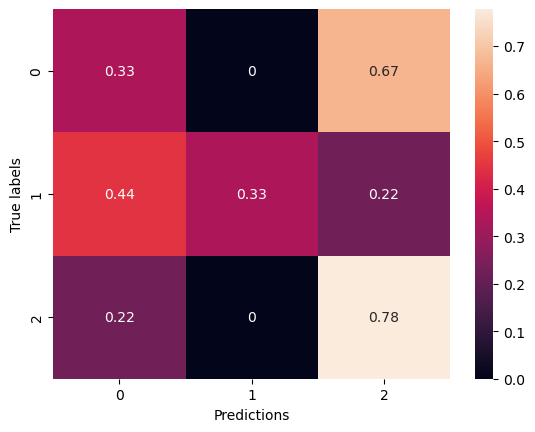

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇▇██▇▇██▇██████▇▇████▇████████████
training_loss,█▆▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▄▅▆█▆▇██▇▇▆▆▇▇▇▅▇▆▇▇█▇▇█▆▇▇▆▇▇█▆▇▇▆▆
val_loss,█▆▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 00:40:57.245634: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:40:57.247469: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:40:57.249545: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:40:58.909642: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:40:58.911387: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:40:58.913362: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:41:03.295075: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:41:03.903160: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 7.6166 - accuracy: 0.3356

2024-03-13 00:41:07.143948: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:41:07.147603: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:41:07.149667: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 7.6166 - accuracy: 0.3356 - val_loss: 6.9489 - val_accuracy: 0.1204
Epoch 2/100
2/2 [==============================] - 1s 275ms/step - loss: 7.0376 - accuracy: 0.4452 - val_loss: 6.9043 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 278ms/step - loss: 6.4645 - accuracy: 0.5114 - val_loss: 7.0970 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 275ms/step - loss: 6.1353 - accuracy: 0.5160 - val_loss: 7.1192 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 305ms/step - loss: 5.7954 - accuracy: 0.5525 - val_loss: 7.0661 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 305ms/step - loss: 5.5926 - accuracy: 0.5502 - val_loss: 6.8711 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 280ms/step - loss: 5.2791 - accuracy: 0.5685 - val_loss: 6.5303 - val_accuracy: 0.1204
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 275ms/step - loss: 0.7377 - accuracy: 0.9680 - val_loss: 3.2525 - val_accuracy: 0.4444
Epoch 60/100
2/2 [==============================] - 1s 272ms/step - loss: 0.7910 - accuracy: 0.9475 - val_loss: 3.2236 - val_accuracy: 0.4074
Epoch 61/100
2/2 [==============================] - 1s 274ms/step - loss: 0.7386 - accuracy: 0.9658 - val_loss: 2.8687 - val_accuracy: 0.4907
Epoch 62/100
2/2 [==============================] - 1s 291ms/step - loss: 0.7074 - accuracy: 0.9703 - val_loss: 2.7668 - val_accuracy: 0.5833
Epoch 63/100
2/2 [==============================] - 1s 269ms/step - loss: 0.7150 - accuracy: 0.9726 - val_loss: 2.6388 - val_accuracy: 0.5556
Epoch 64/100
2/2 [==============================] - 1s 274ms/step - loss: 0.6806 - accuracy: 0.9749 - val_loss: 2.7281 - val_accuracy: 0.5926
Epoch 65/100
2/2 [==============================] - 1s 271ms/step - loss: 0.6807 - accuracy: 0.9703 - val_loss: 2.5726 - val_accuracy: 0.5926
Epoch 

2024-03-13 00:42:02.474526: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:42:02.476093: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:42:02.478146: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5451951026916504 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, '2': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.4871794871794872, 'recall': 0.4814814814814814, 'f1-score': 0.4329004329004329, 'support': 27}, 'weighted avg': {'precision': 0.48717948717948717, 'recall': 0.48148148148148145, 'f1-score': 0.43290043290043295, 'support': 27}}


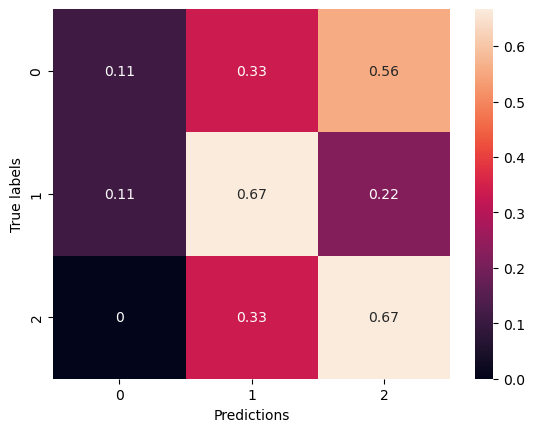

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▃▄▄▅▆▆▆▆▇▇▇▇█████▇████████████████████
training_loss,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▁▂▁▁▁▅▅▅▆█▄▄▇▄▂▂▆▇██▆▆▇▆▆▅▆▅▆▅▆▆█
val_loss,███▇▆▆▇▇▅▇▆▆▂▃▂▂▁▄▃▁▄▇▆▂▁▁▁▂▂▂▂▂▃▂▃▁▃▂▃▁


Epoch 1/100


2024-03-13 00:42:27.097562: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:42:27.099926: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:42:27.102538: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:42:30.019798: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:42:30.021530: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:42:30.023749: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:42:34.302074: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:42:34.901063: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 30.1007 - accuracy: 0.3242 

2024-03-13 00:42:38.195683: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:42:38.197985: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:42:38.199693: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 30.1007 - accuracy: 0.3242 - val_loss: 26.1271 - val_accuracy: 0.2037
Epoch 2/100
2/2 [==============================] - 1s 270ms/step - loss: 25.5194 - accuracy: 0.4429 - val_loss: 22.2339 - val_accuracy: 0.2593
Epoch 3/100
2/2 [==============================] - 1s 273ms/step - loss: 21.5602 - accuracy: 0.4795 - val_loss: 18.9390 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 282ms/step - loss: 18.0648 - accuracy: 0.5160 - val_loss: 16.1050 - val_accuracy: 0.1111
Epoch 5/100
2/2 [==============================] - 1s 309ms/step - loss: 15.0800 - accuracy: 0.5388 - val_loss: 13.6967 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 271ms/step - loss: 12.5732 - accuracy: 0.5799 - val_loss: 11.7645 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 272ms/step - loss: 10.5194 - accuracy: 0.5913 - val_loss: 10.2139 - val_accuracy: 0.1296
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 292ms/step - loss: 0.9604 - accuracy: 0.9178 - val_loss: 2.7559 - val_accuracy: 0.5093
Epoch 60/100
2/2 [==============================] - 1s 291ms/step - loss: 0.9623 - accuracy: 0.9338 - val_loss: 2.9887 - val_accuracy: 0.4352
Epoch 61/100
2/2 [==============================] - 1s 276ms/step - loss: 1.0421 - accuracy: 0.9018 - val_loss: 3.1339 - val_accuracy: 0.4259
Epoch 62/100
2/2 [==============================] - 1s 268ms/step - loss: 0.9827 - accuracy: 0.9292 - val_loss: 2.8648 - val_accuracy: 0.5463
Epoch 63/100
2/2 [==============================] - 1s 267ms/step - loss: 1.0856 - accuracy: 0.9041 - val_loss: 4.3496 - val_accuracy: 0.3056
Epoch 64/100
2/2 [==============================] - 1s 275ms/step - loss: 1.0615 - accuracy: 0.9110 - val_loss: 6.0731 - val_accuracy: 0.1667
Epoch 65/100
2/2 [==============================] - 1s 273ms/step - loss: 1.0089 - accuracy: 0.9315 - val_loss: 4.6768 - val_accuracy: 0.2130
Epoch 

2024-03-13 00:43:33.691736: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:43:33.693413: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:43:33.695451: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5046701431274414 s
{'0': {'precision': 0.42105263157894735, 'recall': 0.8888888888888888, 'f1-score': 0.5714285714285714, 'support': 9}, '1': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.4444444444444444, 'f1-score': 0.6153846153846153, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.7236842105263158, 'recall': 0.5555555555555555, 'f1-score': 0.5494505494505494, 'support': 27}, 'weighted avg': {'precision': 0.7236842105263158, 'recall': 0.5555555555555556, 'f1-score': 0.5494505494505494, 'support': 27}}


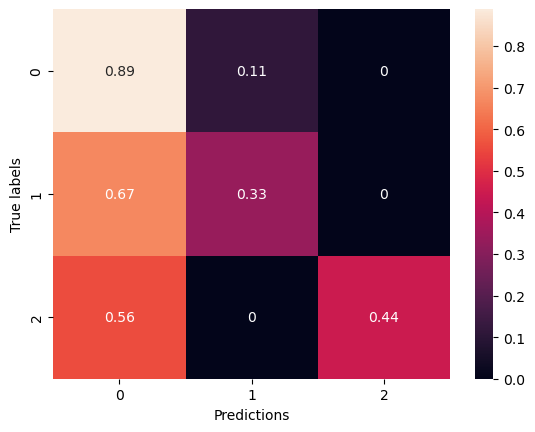

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▅▆▆▆▇▇▇▇█▇▇▇▇████▇▇▇▇█████▇███████▇
training_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▂▂▁▄▄▆▆▆▇█▇▆▄▆▇▅▄▆▆▅▂▄▅▆▇▃▅▇▄▆▆▄▄▂▃
val_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▂▁▁▂▁▁▁▁▂▂


Epoch 1/100


2024-03-13 00:44:00.380019: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:44:00.381868: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:44:00.384142: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:44:02.027806: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:44:02.029687: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:44:02.032575: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:44:06.368088: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:44:06.968261: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 41.0940 - accuracy: 0.3927

2024-03-13 00:44:11.250016: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:44:11.253910: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:44:11.256544: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 3s/step - loss: 41.0940 - accuracy: 0.3927 - val_loss: 35.3265 - val_accuracy: 0.1944
Epoch 2/100
2/2 [==============================] - 1s 268ms/step - loss: 34.2529 - accuracy: 0.4406 - val_loss: 29.5073 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 270ms/step - loss: 28.3676 - accuracy: 0.4703 - val_loss: 24.3827 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 268ms/step - loss: 23.1665 - accuracy: 0.5251 - val_loss: 20.2112 - val_accuracy: 0.1111
Epoch 5/100
2/2 [==============================] - 1s 275ms/step - loss: 18.8259 - accuracy: 0.5753 - val_loss: 16.8330 - val_accuracy: 0.1111
Epoch 6/100
2/2 [==============================] - 1s 271ms/step - loss: 15.2639 - accuracy: 0.6096 - val_loss: 13.9090 - val_accuracy: 0.1111
Epoch 7/100
2/2 [==============================] - 1s 277ms/step - loss: 12.2184 - accuracy: 0.6461 - val_loss: 11.4269 - val_accuracy: 0.1111
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 276ms/step - loss: 0.9059 - accuracy: 0.9224 - val_loss: 2.6890 - val_accuracy: 0.5278
Epoch 60/100
2/2 [==============================] - 1s 268ms/step - loss: 1.0056 - accuracy: 0.9155 - val_loss: 2.9167 - val_accuracy: 0.4630
Epoch 61/100
2/2 [==============================] - 1s 265ms/step - loss: 0.9999 - accuracy: 0.8744 - val_loss: 2.9238 - val_accuracy: 0.4259
Epoch 62/100
2/2 [==============================] - 1s 267ms/step - loss: 1.0146 - accuracy: 0.9064 - val_loss: 3.7585 - val_accuracy: 0.3333
Epoch 63/100
2/2 [==============================] - 1s 271ms/step - loss: 1.0591 - accuracy: 0.9201 - val_loss: 3.0157 - val_accuracy: 0.3519
Epoch 64/100
2/2 [==============================] - 1s 267ms/step - loss: 1.0770 - accuracy: 0.9132 - val_loss: 3.3710 - val_accuracy: 0.3241
Epoch 65/100
2/2 [==============================] - 1s 276ms/step - loss: 1.0568 - accuracy: 0.9292 - val_loss: 3.2314 - val_accuracy: 0.3241
Epoch 

2024-03-13 00:45:06.525692: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:45:06.527933: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:45:06.529598: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.513519287109375 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 0.6666666666666666, 'f1-score': 0.5217391304347826, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.3873015873015873, 'recall': 0.40740740740740744, 'f1-score': 0.36981947622679884, 'support': 27}, 'weighted avg': {'precision': 0.38730158730158726, 'recall': 0.4074074074074074, 'f1-score': 0.3698194762267989, 'support': 27}}


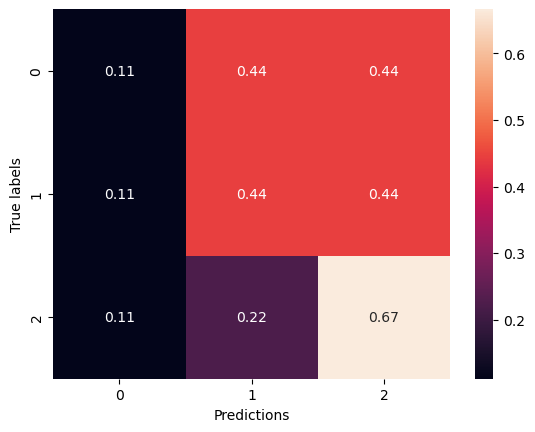

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▄▅▆▅▆▆▇▇▇▇▇█▇█▇█▇████▇▇▇█████████▇████
training_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▁▇▇▇▇█▇▇█▆▇▇▇▇█▇▇▇▆▄▇▅▆▅▇█▇▆▃▆█▆▄▆
val_loss,█▆▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 00:45:31.466859: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:45:31.469071: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:45:31.470632: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:45:33.121857: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:45:33.123844: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:45:33.125800: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:45:37.531168: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:45:38.145556: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 7.4707 - accuracy: 0.3425

2024-03-13 00:45:41.367066: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:45:41.369977: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:45:41.371662: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 7.4707 - accuracy: 0.3425 - val_loss: 6.7737 - val_accuracy: 0.1296
Epoch 2/100
2/2 [==============================] - 1s 278ms/step - loss: 6.9974 - accuracy: 0.3607 - val_loss: 6.6448 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 267ms/step - loss: 6.7427 - accuracy: 0.3721 - val_loss: 6.5971 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 265ms/step - loss: 6.4219 - accuracy: 0.4041 - val_loss: 6.4516 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 262ms/step - loss: 6.0951 - accuracy: 0.4406 - val_loss: 6.3456 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 263ms/step - loss: 5.8063 - accuracy: 0.4018 - val_loss: 6.2244 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 266ms/step - loss: 5.5393 - accuracy: 0.4269 - val_loss: 6.0390 - val_accuracy: 0.1296
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 282ms/step - loss: 0.9964 - accuracy: 0.8516 - val_loss: 2.4954 - val_accuracy: 0.5648
Epoch 60/100
2/2 [==============================] - 1s 270ms/step - loss: 1.0126 - accuracy: 0.8379 - val_loss: 2.5188 - val_accuracy: 0.5833
Epoch 61/100
2/2 [==============================] - 1s 270ms/step - loss: 0.9374 - accuracy: 0.8699 - val_loss: 2.5749 - val_accuracy: 0.5833
Epoch 62/100
2/2 [==============================] - 1s 269ms/step - loss: 1.0019 - accuracy: 0.8562 - val_loss: 2.6343 - val_accuracy: 0.5648
Epoch 63/100
2/2 [==============================] - 1s 265ms/step - loss: 0.9518 - accuracy: 0.8744 - val_loss: 2.4611 - val_accuracy: 0.5833
Epoch 64/100
2/2 [==============================] - 1s 273ms/step - loss: 1.0257 - accuracy: 0.8333 - val_loss: 2.3393 - val_accuracy: 0.5741
Epoch 65/100
2/2 [==============================] - 1s 268ms/step - loss: 0.9723 - accuracy: 0.8562 - val_loss: 2.3664 - val_accuracy: 0.5833
Epoch 

2024-03-13 00:46:36.046547: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:46:36.049219: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:46:36.050875: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.521772861480713 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '2': {'precision': 0.42105263157894735, 'recall': 0.8888888888888888, 'f1-score': 0.5714285714285714, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.5625730994152046, 'recall': 0.48148148148148145, 'f1-score': 0.4444444444444444, 'support': 27}, 'weighted avg': {'precision': 0.5625730994152046, 'recall': 0.48148148148148145, 'f1-score': 0.4444444444444444, 'support': 27}}


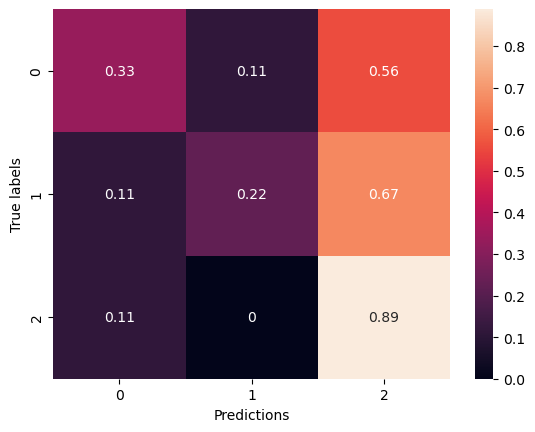

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▃▄▃▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇█▇▇█████████
training_loss,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▂▂▄▄▃▄▄▆█▇▇▇▇█▆▇▇▇▇▇▇▇▇█▇█▇▆▇▇▇▇▆
val_loss,██▇▇▆▅▄▄▄▃▂▃▃▁▁▁▁▁▁▁▁▂▁▂▂▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂


Epoch 1/100


2024-03-13 00:47:00.304207: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:47:00.306146: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:47:00.308259: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:47:01.958221: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:47:01.959900: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:47:01.962331: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:47:07.893636: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:47:08.500253: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 30.1151 - accuracy: 0.3219 

2024-03-13 00:47:11.764100: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:47:11.766175: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:47:11.767779: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 30.1151 - accuracy: 0.3219 - val_loss: 26.2387 - val_accuracy: 0.2870
Epoch 2/100
2/2 [==============================] - 1s 309ms/step - loss: 25.7870 - accuracy: 0.3493 - val_loss: 22.5268 - val_accuracy: 0.2315
Epoch 3/100
2/2 [==============================] - 1s 273ms/step - loss: 22.1308 - accuracy: 0.3767 - val_loss: 19.2857 - val_accuracy: 0.2037
Epoch 4/100
2/2 [==============================] - 1s 275ms/step - loss: 18.9252 - accuracy: 0.3858 - val_loss: 16.4742 - val_accuracy: 0.1759
Epoch 5/100
2/2 [==============================] - 1s 264ms/step - loss: 15.9445 - accuracy: 0.4224 - val_loss: 13.9916 - val_accuracy: 0.1574
Epoch 6/100
2/2 [==============================] - 1s 267ms/step - loss: 13.5788 - accuracy: 0.4406 - val_loss: 11.9242 - val_accuracy: 0.1574
Epoch 7/100
2/2 [==============================] - 1s 273ms/step - loss: 11.4149 - accuracy: 0.4543 - val_loss: 10.1962 - val_accuracy: 0.1389
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 275ms/step - loss: 1.0454 - accuracy: 0.8973 - val_loss: 2.6127 - val_accuracy: 0.4722
Epoch 60/100
2/2 [==============================] - 1s 271ms/step - loss: 1.0414 - accuracy: 0.9018 - val_loss: 2.7799 - val_accuracy: 0.3704
Epoch 61/100
2/2 [==============================] - 1s 273ms/step - loss: 1.0284 - accuracy: 0.8950 - val_loss: 2.6373 - val_accuracy: 0.4630
Epoch 62/100
2/2 [==============================] - 1s 267ms/step - loss: 0.9931 - accuracy: 0.9110 - val_loss: 2.4975 - val_accuracy: 0.5278
Epoch 63/100
2/2 [==============================] - 1s 268ms/step - loss: 1.0167 - accuracy: 0.8881 - val_loss: 2.6025 - val_accuracy: 0.4722
Epoch 64/100
2/2 [==============================] - 1s 340ms/step - loss: 0.9937 - accuracy: 0.9018 - val_loss: 2.6125 - val_accuracy: 0.5370
Epoch 65/100
2/2 [==============================] - 1s 261ms/step - loss: 1.0283 - accuracy: 0.8927 - val_loss: 3.0268 - val_accuracy: 0.3796
Epoch 

2024-03-13 00:48:07.225093: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:48:07.227795: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:48:07.229384: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5082950592041016 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3333333333333333, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.48888888888888893, 'recall': 0.4444444444444445, 'f1-score': 0.4166666666666667, 'support': 27}, 'weighted avg': {'precision': 0.4888888888888889, 'recall': 0.4444444444444444, 'f1-score': 0.4166666666666667, 'support': 27}}


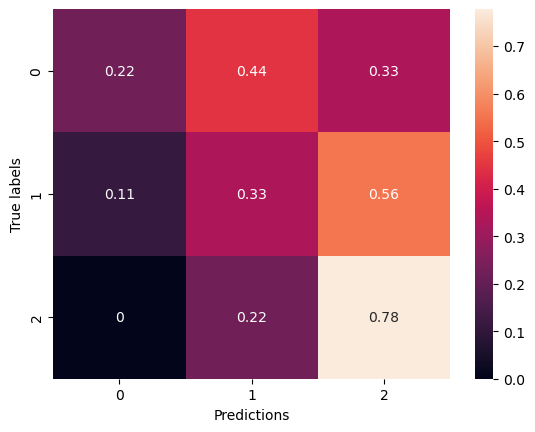

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇█▇▇█▇▇██▇▇▇██████▇
training_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▂▁▁▁▁▁▂▁▅▅▇▆█▇▅▇▆▆█▆█▅▆▆▇▅▇▇▄▃▂▃▄█▇▆▅▄▇
val_loss,█▆▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁▂▁


Epoch 1/100


2024-03-13 00:48:31.711109: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:48:31.713680: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:48:31.715485: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:48:33.372051: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:48:33.374593: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:48:33.376631: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:48:37.721941: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:48:38.325783: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 41.3307 - accuracy: 0.3333

2024-03-13 00:48:41.592975: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:48:41.595670: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:48:41.597658: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 11s 2s/step - loss: 41.3307 - accuracy: 0.3333 - val_loss: 35.3818 - val_accuracy: 0.4074
Epoch 2/100
2/2 [==============================] - 1s 268ms/step - loss: 34.6348 - accuracy: 0.3927 - val_loss: 29.7315 - val_accuracy: 0.1759
Epoch 3/100
2/2 [==============================] - 1s 270ms/step - loss: 28.8836 - accuracy: 0.3516 - val_loss: 24.8951 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 269ms/step - loss: 23.9953 - accuracy: 0.4018 - val_loss: 20.7530 - val_accuracy: 0.1389
Epoch 5/100
2/2 [==============================] - 1s 274ms/step - loss: 19.7850 - accuracy: 0.4315 - val_loss: 17.1467 - val_accuracy: 0.1389
Epoch 6/100
2/2 [==============================] - 1s 282ms/step - loss: 16.2063 - accuracy: 0.4612 - val_loss: 14.0969 - val_accuracy: 0.1389
Epoch 7/100
2/2 [==============================] - 1s 270ms/step - loss: 13.3804 - accuracy: 0.4201 - val_loss: 11.6335 - val_accuracy: 0.1389
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 271ms/step - loss: 1.1176 - accuracy: 0.8699 - val_loss: 2.7455 - val_accuracy: 0.3796
Epoch 60/100
2/2 [==============================] - 1s 271ms/step - loss: 1.1742 - accuracy: 0.8493 - val_loss: 2.4628 - val_accuracy: 0.4722
Epoch 61/100
2/2 [==============================] - 1s 272ms/step - loss: 1.1324 - accuracy: 0.8676 - val_loss: 2.3379 - val_accuracy: 0.5370
Epoch 62/100
2/2 [==============================] - 1s 267ms/step - loss: 1.1885 - accuracy: 0.8493 - val_loss: 2.7317 - val_accuracy: 0.4630
Epoch 63/100
2/2 [==============================] - 1s 271ms/step - loss: 1.1344 - accuracy: 0.8950 - val_loss: 2.8908 - val_accuracy: 0.4167
Epoch 64/100
2/2 [==============================] - 1s 271ms/step - loss: 1.2164 - accuracy: 0.8447 - val_loss: 2.5147 - val_accuracy: 0.5185
Epoch 65/100
2/2 [==============================] - 1s 327ms/step - loss: 1.2370 - accuracy: 0.8447 - val_loss: 2.5292 - val_accuracy: 0.4074
Epoch 

2024-03-13 00:49:36.752767: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:49:36.754712: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:49:36.756536: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5283730030059814 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.45454545454545453, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.30707070707070705, 'recall': 0.4444444444444445, 'f1-score': 0.36111111111111116, 'support': 27}, 'weighted avg': {'precision': 0.30707070707070705, 'recall': 0.4444444444444444, 'f1-score': 0.3611111111111111, 'support': 27}}


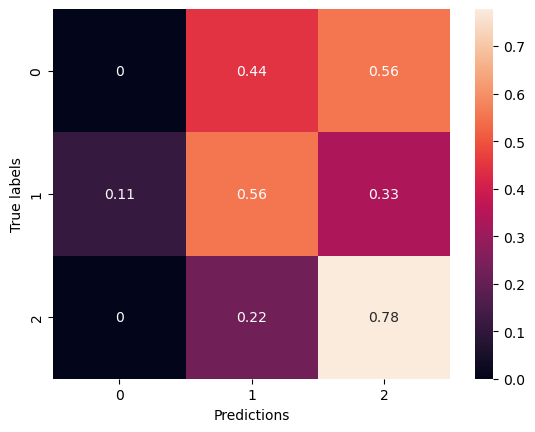

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▃▃▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇██▇██████
training_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▁▁▁▁▁▂▄▅▇▅▇▇▇▇▇█▇▇█▆▅▇▅▇▇▄▆▇▇▆▅▄▆▆▄▆█▅▇
val_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 00:50:02.134642: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:50:02.136344: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:50:02.138296: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:50:05.091711: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:50:05.095825: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:50:05.098681: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:50:09.546483: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:50:10.144122: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 8.0074 - accuracy: 0.3904 

2024-03-13 00:50:13.584165: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:50:13.586243: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:50:13.587830: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 8.0074 - accuracy: 0.3904 - val_loss: 7.6240 - val_accuracy: 0.1481
Epoch 2/100
2/2 [==============================] - 1s 358ms/step - loss: 7.0770 - accuracy: 0.5822 - val_loss: 7.9267 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 360ms/step - loss: 6.3718 - accuracy: 0.6872 - val_loss: 7.9250 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 365ms/step - loss: 5.7840 - accuracy: 0.7466 - val_loss: 7.3614 - val_accuracy: 0.1389
Epoch 5/100
2/2 [==============================] - 1s 362ms/step - loss: 5.2740 - accuracy: 0.7854 - val_loss: 7.3274 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 365ms/step - loss: 4.8460 - accuracy: 0.8082 - val_loss: 7.5071 - val_accuracy: 0.1111
Epoch 7/100
2/2 [==============================] - 1s 361ms/step - loss: 4.4253 - accuracy: 0.8219 - val_loss: 7.8841 - val_accuracy: 0.1111
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 356ms/step - loss: 0.6741 - accuracy: 0.9589 - val_loss: 3.4470 - val_accuracy: 0.4074
Epoch 60/100
2/2 [==============================] - 1s 361ms/step - loss: 0.5564 - accuracy: 0.9863 - val_loss: 3.7139 - val_accuracy: 0.4074
Epoch 61/100
2/2 [==============================] - 1s 358ms/step - loss: 0.5637 - accuracy: 0.9886 - val_loss: 3.9678 - val_accuracy: 0.3704
Epoch 62/100
2/2 [==============================] - 1s 368ms/step - loss: 0.6206 - accuracy: 0.9658 - val_loss: 3.4779 - val_accuracy: 0.3704
Epoch 63/100
2/2 [==============================] - 1s 355ms/step - loss: 0.6078 - accuracy: 0.9772 - val_loss: 3.1270 - val_accuracy: 0.5000
Epoch 64/100
2/2 [==============================] - 1s 413ms/step - loss: 0.5901 - accuracy: 0.9749 - val_loss: 3.1662 - val_accuracy: 0.4815
Epoch 65/100
2/2 [==============================] - 1s 357ms/step - loss: 0.6038 - accuracy: 0.9749 - val_loss: 3.5162 - val_accuracy: 0.3981
Epoch 

2024-03-13 00:51:25.348729: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:51:25.350330: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:51:25.351977: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.519139051437378 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.3157894736842105, 'recall': 0.6666666666666666, 'f1-score': 0.42857142857142855, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.5814536340852131, 'recall': 0.3703703703703703, 'f1-score': 0.3345238095238095, 'support': 27}, 'weighted avg': {'precision': 0.581453634085213, 'recall': 0.37037037037037035, 'f1-score': 0.3345238095238095, 'support': 27}}


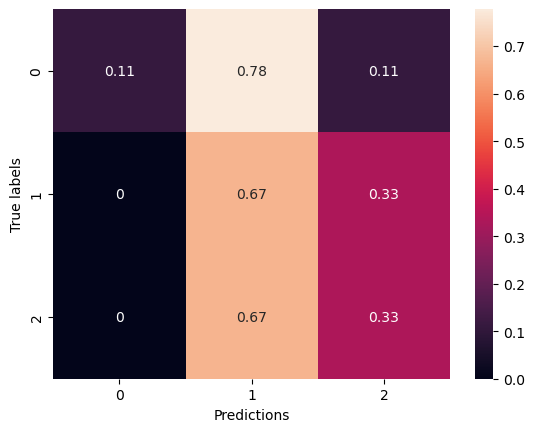

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▇▇▇██████████████████████████████████
training_loss,█▆▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▅▄▃▄▆▆▇▅▆▄▅██▇▇█▄▇▇▅▄▆▇▇▇▆▅▆▄▆▇▇█▆▄▅
val_loss,██▇▇▃▃▄▃▂▂▁▂▁▃▂▁▁▁▁▁▄▁▁▂▃▂▂▂▂▂▃▂▄▂▂▂▁▂▄▂


Epoch 1/100


2024-03-13 00:51:49.864364: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:51:49.866583: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:51:49.868180: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:51:51.520067: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:51:51.522875: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:51:51.524947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:51:55.946278: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:51:56.546242: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 32.8797 - accuracy: 0.4224

2024-03-13 00:51:59.962622: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:51:59.964329: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:51:59.966332: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 3s/step - loss: 32.8797 - accuracy: 0.4224 - val_loss: 28.0653 - val_accuracy: 0.1204
Epoch 2/100
2/2 [==============================] - 1s 367ms/step - loss: 26.7039 - accuracy: 0.5662 - val_loss: 22.9226 - val_accuracy: 0.1389
Epoch 3/100
2/2 [==============================] - 1s 366ms/step - loss: 21.3308 - accuracy: 0.6370 - val_loss: 19.0462 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 361ms/step - loss: 16.9588 - accuracy: 0.7009 - val_loss: 16.1687 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 360ms/step - loss: 13.3210 - accuracy: 0.7740 - val_loss: 12.7928 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 393ms/step - loss: 10.4762 - accuracy: 0.7740 - val_loss: 10.8992 - val_accuracy: 0.1481
Epoch 7/100
2/2 [==============================] - 1s 360ms/step - loss: 8.2144 - accuracy: 0.7991 - val_loss: 8.7851 - val_accuracy: 0.1389
Epoch 8/100
2/2

Epoch 59/100
2/2 [==============================] - 1s 363ms/step - loss: 0.8943 - accuracy: 0.9406 - val_loss: 2.5734 - val_accuracy: 0.5185
Epoch 60/100
2/2 [==============================] - 1s 367ms/step - loss: 0.8645 - accuracy: 0.9566 - val_loss: 2.4302 - val_accuracy: 0.5648
Epoch 61/100
2/2 [==============================] - 1s 359ms/step - loss: 0.8983 - accuracy: 0.9612 - val_loss: 2.5156 - val_accuracy: 0.5556
Epoch 62/100
2/2 [==============================] - 1s 369ms/step - loss: 0.8789 - accuracy: 0.9680 - val_loss: 2.7057 - val_accuracy: 0.5463
Epoch 63/100
2/2 [==============================] - 1s 366ms/step - loss: 0.8912 - accuracy: 0.9498 - val_loss: 3.0361 - val_accuracy: 0.4074
Epoch 64/100
2/2 [==============================] - 1s 363ms/step - loss: 0.8910 - accuracy: 0.9589 - val_loss: 3.0178 - val_accuracy: 0.4352
Epoch 65/100
2/2 [==============================] - 1s 362ms/step - loss: 0.8898 - accuracy: 0.9589 - val_loss: 3.2557 - val_accuracy: 0.4722
Epoch 

2024-03-13 00:53:13.490611: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:53:13.492102: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:53:13.494592: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5627381801605225 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.3888888888888889, 'recall': 0.7777777777777778, 'f1-score': 0.5185185185185185, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.3148148148148148, 'recall': 0.4444444444444445, 'f1-score': 0.35802469135802467, 'support': 27}, 'weighted avg': {'precision': 0.3148148148148148, 'recall': 0.4444444444444444, 'f1-score': 0.35802469135802467, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


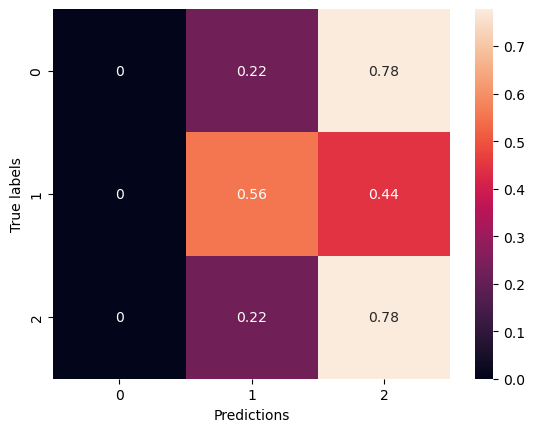

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇▇▇▇▇▇█████▇▇▇████▇████▇█▇██████▇▇▇
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▄▅▅▇▇█▇▅▇█▇██▇▆▅▆▆█▅▇█▆▆▄▆▅▃▃▆█▇▆▅▆▇█
val_loss,█▆▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 00:53:38.671424: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:53:38.674209: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:53:38.676033: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:53:40.328557: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:53:40.330925: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:53:40.332644: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:53:44.654520: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:53:45.249630: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 45.5465 - accuracy: 0.3744

2024-03-13 00:53:48.681754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:53:48.683595: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:53:48.685538: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 45.5465 - accuracy: 0.3744 - val_loss: 37.9156 - val_accuracy: 0.1481
Epoch 2/100
2/2 [==============================] - 1s 364ms/step - loss: 35.8909 - accuracy: 0.5868 - val_loss: 30.0413 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 371ms/step - loss: 28.0322 - accuracy: 0.6301 - val_loss: 24.1054 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 364ms/step - loss: 21.4919 - accuracy: 0.7215 - val_loss: 18.6440 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 389ms/step - loss: 16.3122 - accuracy: 0.7489 - val_loss: 14.2050 - val_accuracy: 0.1667
Epoch 6/100
2/2 [==============================] - 1s 429ms/step - loss: 12.2738 - accuracy: 0.7785 - val_loss: 11.8383 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 375ms/step - loss: 9.2411 - accuracy: 0.8105 - val_loss: 9.5576 - val_accuracy: 0.1204
Epoch 8/100
2/2

Epoch 59/100
2/2 [==============================] - 1s 359ms/step - loss: 1.0437 - accuracy: 0.9612 - val_loss: 3.0928 - val_accuracy: 0.4074
Epoch 60/100
2/2 [==============================] - 1s 360ms/step - loss: 1.0219 - accuracy: 0.9543 - val_loss: 3.2342 - val_accuracy: 0.4074
Epoch 61/100
2/2 [==============================] - 1s 353ms/step - loss: 0.9767 - accuracy: 0.9772 - val_loss: 3.5615 - val_accuracy: 0.3426
Epoch 62/100
2/2 [==============================] - 1s 368ms/step - loss: 0.9620 - accuracy: 0.9521 - val_loss: 3.3254 - val_accuracy: 0.3889
Epoch 63/100
2/2 [==============================] - 1s 375ms/step - loss: 0.9028 - accuracy: 0.9749 - val_loss: 2.8833 - val_accuracy: 0.5278
Epoch 64/100
2/2 [==============================] - 1s 367ms/step - loss: 0.8656 - accuracy: 0.9658 - val_loss: 2.9389 - val_accuracy: 0.5185
Epoch 65/100
2/2 [==============================] - 1s 398ms/step - loss: 0.8631 - accuracy: 0.9658 - val_loss: 2.8580 - val_accuracy: 0.5463
Epoch 

2024-03-13 00:55:01.502801: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:55:01.504734: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:55:01.506904: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.515085220336914 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.375, 'recall': 0.3333333333333333, 'f1-score': 0.35294117647058826, 'support': 9}, '2': {'precision': 0.4375, 'recall': 0.7777777777777778, 'f1-score': 0.56, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.4930555555555555, 'recall': 0.4444444444444445, 'f1-score': 0.4154248366013072, 'support': 27}, 'weighted avg': {'precision': 0.4930555555555556, 'recall': 0.4444444444444444, 'f1-score': 0.41542483660130725, 'support': 27}}


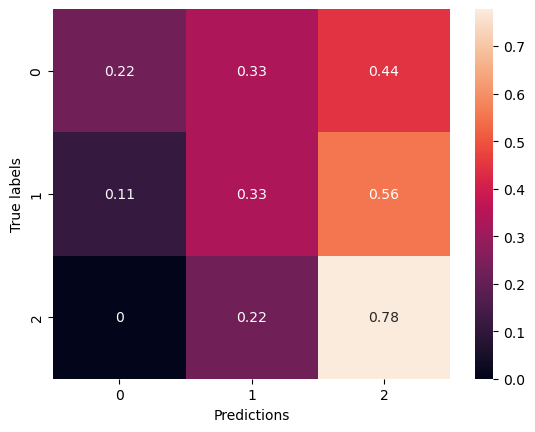

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▇▇█▇████▇███████▇██████▇▇█████▇▇██
training_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▅▃▃▇▇█▄▅▄▆▇▇██▆█▇█▆▆▅▄▇▇▇▆▇▅▆▆▆▄▅▇▆▇▆
val_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 00:55:26.138517: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:55:26.140925: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:55:26.142645: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:55:27.830328: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:55:27.832291: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:55:27.834295: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:55:33.496759: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:55:34.090622: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 8.1488 - accuracy: 0.3516 

2024-03-13 00:55:37.505759: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:55:37.507671: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:55:37.510255: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 8.1488 - accuracy: 0.3516 - val_loss: 7.2673 - val_accuracy: 0.2963
Epoch 2/100
2/2 [==============================] - 1s 360ms/step - loss: 7.3509 - accuracy: 0.4909 - val_loss: 7.2790 - val_accuracy: 0.1481
Epoch 3/100
2/2 [==============================] - 1s 365ms/step - loss: 6.8086 - accuracy: 0.5479 - val_loss: 7.4586 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 361ms/step - loss: 6.3903 - accuracy: 0.5799 - val_loss: 7.4914 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 433ms/step - loss: 6.0289 - accuracy: 0.5890 - val_loss: 7.7634 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 368ms/step - loss: 5.6113 - accuracy: 0.6689 - val_loss: 7.5647 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 366ms/step - loss: 5.2102 - accuracy: 0.6963 - val_loss: 6.8020 - val_accuracy: 0.1574
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 359ms/step - loss: 0.7299 - accuracy: 0.9749 - val_loss: 3.9902 - val_accuracy: 0.3519
Epoch 60/100
2/2 [==============================] - 1s 361ms/step - loss: 0.7145 - accuracy: 0.9635 - val_loss: 4.1637 - val_accuracy: 0.3796
Epoch 61/100
2/2 [==============================] - 1s 361ms/step - loss: 0.6979 - accuracy: 0.9703 - val_loss: 4.0286 - val_accuracy: 0.3889
Epoch 62/100
2/2 [==============================] - 1s 357ms/step - loss: 0.7186 - accuracy: 0.9680 - val_loss: 3.7177 - val_accuracy: 0.4630
Epoch 63/100
2/2 [==============================] - 1s 411ms/step - loss: 0.6904 - accuracy: 0.9680 - val_loss: 3.3924 - val_accuracy: 0.5370
Epoch 64/100
2/2 [==============================] - 1s 386ms/step - loss: 0.6795 - accuracy: 0.9680 - val_loss: 3.5585 - val_accuracy: 0.4630
Epoch 65/100
2/2 [==============================] - 1s 364ms/step - loss: 0.6474 - accuracy: 0.9749 - val_loss: 3.7887 - val_accuracy: 0.4074
Epoch 

2024-03-13 00:56:50.131007: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:56:50.132596: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:56:50.134462: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6157128810882568 s
{'0': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.4375, 'recall': 0.7777777777777778, 'f1-score': 0.56, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.6273148148148148, 'recall': 0.48148148148148145, 'f1-score': 0.456026936026936, 'support': 27}, 'weighted avg': {'precision': 0.6273148148148148, 'recall': 0.48148148148148145, 'f1-score': 0.456026936026936, 'support': 27}}


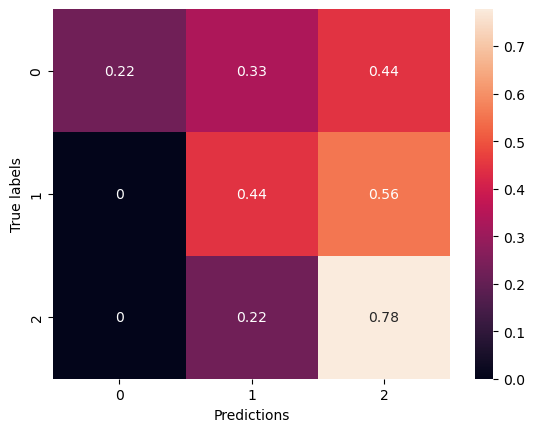

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▅▆▇▇█████▇█▇████████████████████████
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▁▁▂▄▄▄▅▄▆█▅▅▆▅▄▅▆▄▅▆▇▅▅▆▇▅▆▇▆▆▆▇█▇▇▇▇▇
val_loss,███▆▅▄▄▃▃▃▂▁▂▃▂▃▄▃▂▂▂▁▁▃▃▂▁▂▁▁▂▂▁▁▁▂▁▂▁▁


Epoch 1/100


2024-03-13 00:57:15.727837: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:57:15.730085: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:57:15.731569: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:57:17.456757: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:57:17.460064: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:57:17.462966: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:57:21.770237: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:57:22.369913: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 32.9192 - accuracy: 0.3607

2024-03-13 00:57:25.829725: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:57:25.831882: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:57:25.833533: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 32.9192 - accuracy: 0.3607 - val_loss: 27.9156 - val_accuracy: 0.1667
Epoch 2/100
2/2 [==============================] - 1s 375ms/step - loss: 26.7773 - accuracy: 0.4886 - val_loss: 22.9517 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 375ms/step - loss: 21.7883 - accuracy: 0.5000 - val_loss: 19.0341 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 372ms/step - loss: 17.4128 - accuracy: 0.5845 - val_loss: 16.0808 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 362ms/step - loss: 13.9173 - accuracy: 0.6233 - val_loss: 13.6851 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 368ms/step - loss: 11.0127 - accuracy: 0.6941 - val_loss: 11.5033 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 366ms/step - loss: 8.8091 - accuracy: 0.7123 - val_loss: 9.7103 - val_accuracy: 0.1111
Epoch 8/100
2/2

Epoch 59/100
2/2 [==============================] - 1s 363ms/step - loss: 0.9491 - accuracy: 0.9338 - val_loss: 2.7921 - val_accuracy: 0.5185
Epoch 60/100
2/2 [==============================] - 1s 362ms/step - loss: 0.9277 - accuracy: 0.9406 - val_loss: 2.8268 - val_accuracy: 0.5278
Epoch 61/100
2/2 [==============================] - 1s 368ms/step - loss: 1.0037 - accuracy: 0.9315 - val_loss: 2.6999 - val_accuracy: 0.5278
Epoch 62/100
2/2 [==============================] - 1s 399ms/step - loss: 0.9860 - accuracy: 0.9315 - val_loss: 2.6865 - val_accuracy: 0.5926
Epoch 63/100
2/2 [==============================] - 1s 363ms/step - loss: 0.9474 - accuracy: 0.9566 - val_loss: 2.4382 - val_accuracy: 0.6481
Epoch 64/100
2/2 [==============================] - 1s 400ms/step - loss: 0.9469 - accuracy: 0.9589 - val_loss: 2.5389 - val_accuracy: 0.6111
Epoch 65/100
2/2 [==============================] - 1s 370ms/step - loss: 0.9436 - accuracy: 0.9612 - val_loss: 2.8394 - val_accuracy: 0.5278
Epoch 

2024-03-13 00:58:39.242477: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:58:39.244521: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:58:39.246212: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step
Inference done in 1.5160229206085205 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.36, 'recall': 1.0, 'f1-score': 0.5294117647058824, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.2866666666666667, 'recall': 0.3703703703703704, 'f1-score': 0.2370766488413547, 'support': 27}, 'weighted avg': {'precision': 0.2866666666666667, 'recall': 0.37037037037037035, 'f1-score': 0.2370766488413547, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


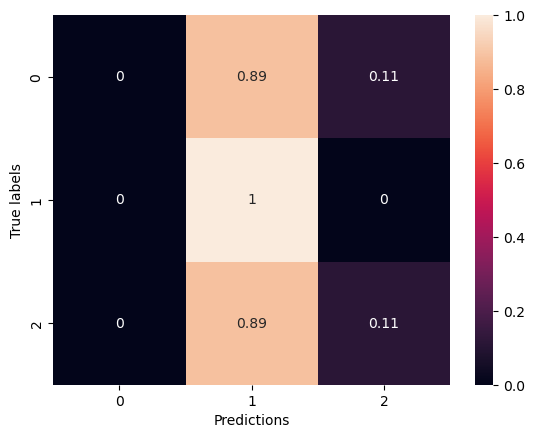

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▆▇▇▇▇▇▇████▇▇▇█▇██▇▇█████▇▇▇▇██▇▇██
training_loss,█▆▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▃▂▄▆▄▄▇▇▅▅▆▃▂▄▆▃▇▇▇▇█▇▇▆▆██▅▆▅▃▇▆▄▄
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂▁


Epoch 1/100


2024-03-13 00:59:04.822797: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:59:04.824890: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:59:04.826730: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:59:06.706175: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:59:06.708408: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:59:06.710224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 00:59:12.515335: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 00:59:13.115421: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 45.3087 - accuracy: 0.3836 

2024-03-13 00:59:16.427132: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 00:59:16.429717: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 00:59:16.431329: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 45.3087 - accuracy: 0.3836 - val_loss: 38.0023 - val_accuracy: 0.1574
Epoch 2/100
2/2 [==============================] - 1s 386ms/step - loss: 36.2264 - accuracy: 0.5068 - val_loss: 30.7964 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 349ms/step - loss: 28.8064 - accuracy: 0.5594 - val_loss: 25.2859 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 367ms/step - loss: 22.6646 - accuracy: 0.5639 - val_loss: 20.1151 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 362ms/step - loss: 17.4671 - accuracy: 0.6621 - val_loss: 15.5423 - val_accuracy: 0.1111
Epoch 6/100
2/2 [==============================] - 1s 363ms/step - loss: 13.5294 - accuracy: 0.6849 - val_loss: 12.5856 - val_accuracy: 0.1019
Epoch 7/100
2/2 [==============================] - 1s 501ms/step - loss: 10.5654 - accuracy: 0.6781 - val_loss: 9.3374 - val_accuracy: 0.1852
Epoch 8/100
2/

Epoch 59/100
2/2 [==============================] - 1s 414ms/step - loss: 0.9342 - accuracy: 0.9543 - val_loss: 3.6534 - val_accuracy: 0.3333
Epoch 60/100
2/2 [==============================] - 1s 371ms/step - loss: 0.9255 - accuracy: 0.9703 - val_loss: 3.4286 - val_accuracy: 0.3611
Epoch 61/100
2/2 [==============================] - 1s 357ms/step - loss: 0.9205 - accuracy: 0.9612 - val_loss: 3.0146 - val_accuracy: 0.4444
Epoch 62/100
2/2 [==============================] - 1s 354ms/step - loss: 0.9492 - accuracy: 0.9361 - val_loss: 3.3747 - val_accuracy: 0.3704
Epoch 63/100
2/2 [==============================] - 1s 359ms/step - loss: 0.9240 - accuracy: 0.9521 - val_loss: 3.4246 - val_accuracy: 0.3796
Epoch 64/100
2/2 [==============================] - 1s 359ms/step - loss: 0.8487 - accuracy: 0.9521 - val_loss: 3.2356 - val_accuracy: 0.4352
Epoch 65/100
2/2 [==============================] - 1s 358ms/step - loss: 0.8786 - accuracy: 0.9475 - val_loss: 3.2801 - val_accuracy: 0.4907
Epoch 

2024-03-13 01:00:29.094443: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:00:29.096241: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:00:29.098808: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5846679210662842 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.6666666666666666, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.3333333333333333, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.2222222222222222, 'recall': 0.3333333333333333, 'f1-score': 0.25925925925925924, 'support': 27}, 'weighted avg': {'precision': 0.2222222222222222, 'recall': 0.3333333333333333, 'f1-score': 0.25925925925925924, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


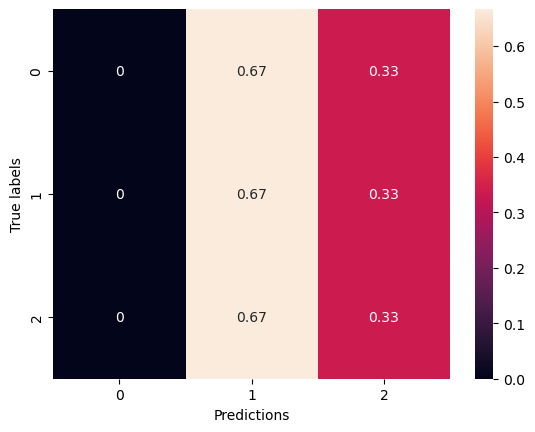

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▆▆▇▇▇▇█▇█▇▇█▇██▇██████▇▇▇█████▇████
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▆▇▄▅▄▄▅█▆█▇▇▆▅▆▄▄▅▇█▄▆▆▇▅▆▆▇▄▆▄▇▅▆▆▆▆
val_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:00:56.515941: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:00:56.518036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:00:56.519622: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:00:58.180523: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:00:58.182484: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:00:58.184487: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:01:02.545776: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:01:03.139972: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 8.1884 - accuracy: 0.3379

2024-03-13 01:01:06.574492: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:01:06.577199: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:01:06.579180: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 8.1884 - accuracy: 0.3379 - val_loss: 7.4883 - val_accuracy: 0.1296
Epoch 2/100
2/2 [==============================] - 1s 364ms/step - loss: 7.6804 - accuracy: 0.3562 - val_loss: 7.4222 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 367ms/step - loss: 7.2407 - accuracy: 0.4155 - val_loss: 7.4151 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 365ms/step - loss: 6.9244 - accuracy: 0.4132 - val_loss: 7.5175 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 371ms/step - loss: 6.5935 - accuracy: 0.4338 - val_loss: 7.6080 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 400ms/step - loss: 6.1565 - accuracy: 0.4886 - val_loss: 7.7904 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 370ms/step - loss: 5.9947 - accuracy: 0.4772 - val_loss: 7.9127 - val_accuracy: 0.1204
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 450ms/step - loss: 0.9055 - accuracy: 0.9269 - val_loss: 2.5687 - val_accuracy: 0.5370
Epoch 60/100
2/2 [==============================] - 1s 407ms/step - loss: 0.9540 - accuracy: 0.9110 - val_loss: 2.6979 - val_accuracy: 0.5370
Epoch 61/100
2/2 [==============================] - 1s 385ms/step - loss: 0.8990 - accuracy: 0.9429 - val_loss: 2.8266 - val_accuracy: 0.5093
Epoch 62/100
2/2 [==============================] - 1s 388ms/step - loss: 0.8879 - accuracy: 0.9452 - val_loss: 3.0015 - val_accuracy: 0.4722
Epoch 63/100
2/2 [==============================] - 1s 443ms/step - loss: 0.8526 - accuracy: 0.9589 - val_loss: 3.4493 - val_accuracy: 0.3611
Epoch 64/100
2/2 [==============================] - 1s 370ms/step - loss: 0.8851 - accuracy: 0.9361 - val_loss: 3.4007 - val_accuracy: 0.3704
Epoch 65/100
2/2 [==============================] - 1s 384ms/step - loss: 0.8901 - accuracy: 0.9384 - val_loss: 2.7996 - val_accuracy: 0.5000
Epoch 

2024-03-13 01:02:21.558108: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:02:21.559811: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:02:21.561646: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5985438823699951 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.4444444444444444, 'f1-score': 0.47058823529411764, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5555555555555555, 'recall': 0.5185185185185185, 'f1-score': 0.48130718954248364, 'support': 27}, 'weighted avg': {'precision': 0.5555555555555556, 'recall': 0.5185185185185185, 'f1-score': 0.4813071895424837, 'support': 27}}


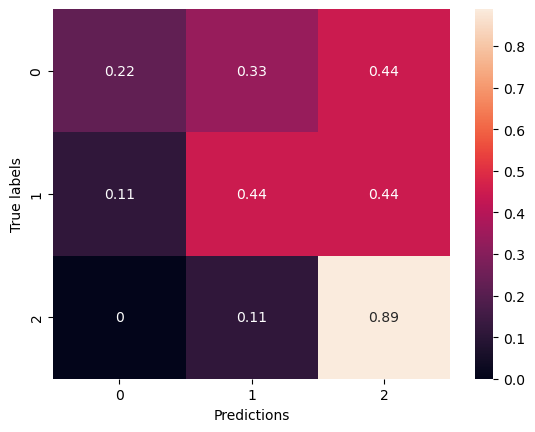

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇██▇▇▇▇██▇███████
training_loss,█▇▆▆▅▄▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▂▃▂▄▆▇██▅▆▅▅█▇▇▇▆▇▆▄▄▅▆▆▅▆▆▆▆▅▇▆▇▆
val_loss,▇▇██▇█▆▃▄▂▂▂▁▁▂▁▂▂▁▁▁▁▁▁▁▂▃▂▂▂▂▁▂▁▁▂▁▁▂▂


Epoch 1/100


2024-03-13 01:02:47.864474: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:02:47.866369: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:02:47.868168: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:02:50.762861: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:02:50.764844: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:02:50.766677: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:02:55.127508: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:02:55.725514: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 33.1797 - accuracy: 0.3151 

2024-03-13 01:02:59.065196: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:02:59.066921: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:02:59.070807: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 33.1797 - accuracy: 0.3151 - val_loss: 28.3909 - val_accuracy: 0.1852
Epoch 2/100
2/2 [==============================] - 1s 357ms/step - loss: 27.6234 - accuracy: 0.3927 - val_loss: 23.9181 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 361ms/step - loss: 23.0845 - accuracy: 0.3630 - val_loss: 20.0593 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 376ms/step - loss: 19.1628 - accuracy: 0.4201 - val_loss: 16.7550 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 360ms/step - loss: 15.8342 - accuracy: 0.4475 - val_loss: 13.9580 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 368ms/step - loss: 13.1311 - accuracy: 0.4772 - val_loss: 11.7843 - val_accuracy: 0.1389
Epoch 7/100
2/2 [==============================] - 1s 375ms/step - loss: 10.8626 - accuracy: 0.5160 - val_loss: 10.1415 - val_accuracy: 0.1296
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 381ms/step - loss: 1.2066 - accuracy: 0.8995 - val_loss: 2.7369 - val_accuracy: 0.5093
Epoch 60/100
2/2 [==============================] - 1s 369ms/step - loss: 1.2242 - accuracy: 0.8653 - val_loss: 2.8551 - val_accuracy: 0.4537
Epoch 61/100
2/2 [==============================] - 1s 370ms/step - loss: 1.1395 - accuracy: 0.9064 - val_loss: 2.9212 - val_accuracy: 0.4907
Epoch 62/100
2/2 [==============================] - 1s 367ms/step - loss: 1.1477 - accuracy: 0.9018 - val_loss: 2.6823 - val_accuracy: 0.5741
Epoch 63/100
2/2 [==============================] - 1s 363ms/step - loss: 1.0554 - accuracy: 0.9361 - val_loss: 3.1010 - val_accuracy: 0.5556
Epoch 64/100
2/2 [==============================] - 1s 365ms/step - loss: 1.1622 - accuracy: 0.8927 - val_loss: 3.0567 - val_accuracy: 0.4537
Epoch 65/100
2/2 [==============================] - 1s 369ms/step - loss: 1.1459 - accuracy: 0.8767 - val_loss: 2.6137 - val_accuracy: 0.5833
Epoch 

2024-03-13 01:04:11.788085: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:04:11.790310: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:04:11.791918: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5910799503326416 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.32, 'recall': 0.8888888888888888, 'f1-score': 0.47058823529411764, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, 'accuracy': 0.3333333333333333, 'macro avg': {'precision': 0.2733333333333334, 'recall': 0.3333333333333333, 'f1-score': 0.2174688057040998, 'support': 27}, 'weighted avg': {'precision': 0.2733333333333333, 'recall': 0.3333333333333333, 'f1-score': 0.2174688057040998, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


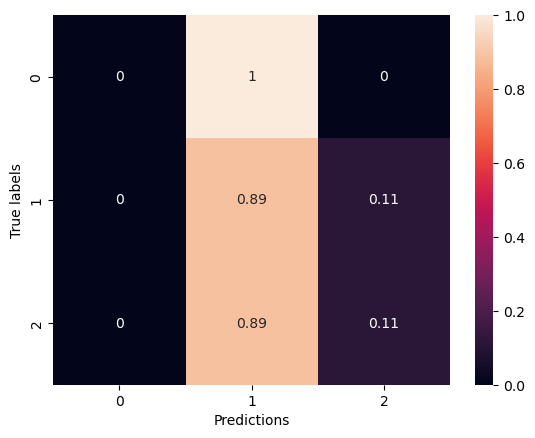

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▅▆▆▆▆▇▇█▇▇▇▇▇▇▇▇▇▇██████████████▇██
training_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▂▂▄▆█▇▅▄▇▁▇▇▇▇▇▇▇▇▇▆▆▆▇▅▄▃▄▇▆▆▆▄▅▅▅▄
val_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:04:34.855042: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:04:34.856818: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:04:34.858676: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:04:36.608880: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:04:36.611167: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:04:36.612848: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:04:40.864681: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:04:41.485746: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 45.4768 - accuracy: 0.3562

2024-03-13 01:04:45.974477: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:04:45.976249: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:04:45.977954: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 3s/step - loss: 45.4768 - accuracy: 0.3562 - val_loss: 38.1357 - val_accuracy: 0.3333
Epoch 2/100
2/2 [==============================] - 1s 372ms/step - loss: 36.9594 - accuracy: 0.3767 - val_loss: 31.0276 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 366ms/step - loss: 29.7653 - accuracy: 0.4726 - val_loss: 25.3130 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 432ms/step - loss: 24.0068 - accuracy: 0.3904 - val_loss: 20.6829 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 453ms/step - loss: 19.1075 - accuracy: 0.4521 - val_loss: 16.9011 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 466ms/step - loss: 15.1893 - accuracy: 0.4703 - val_loss: 13.6447 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 428ms/step - loss: 12.1069 - accuracy: 0.5068 - val_loss: 10.9263 - val_accuracy: 0.1204
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 361ms/step - loss: 1.3410 - accuracy: 0.8676 - val_loss: 2.7834 - val_accuracy: 0.5278
Epoch 60/100
2/2 [==============================] - 1s 412ms/step - loss: 1.2583 - accuracy: 0.8858 - val_loss: 2.6036 - val_accuracy: 0.5833
Epoch 61/100
2/2 [==============================] - 1s 362ms/step - loss: 1.3149 - accuracy: 0.8584 - val_loss: 2.7707 - val_accuracy: 0.5741
Epoch 62/100
2/2 [==============================] - 1s 350ms/step - loss: 1.3175 - accuracy: 0.8699 - val_loss: 2.9408 - val_accuracy: 0.5370
Epoch 63/100
2/2 [==============================] - 1s 383ms/step - loss: 1.3753 - accuracy: 0.8607 - val_loss: 3.4743 - val_accuracy: 0.4074
Epoch 64/100
2/2 [==============================] - 1s 360ms/step - loss: 1.3291 - accuracy: 0.8836 - val_loss: 3.5166 - val_accuracy: 0.3611
Epoch 65/100
2/2 [==============================] - 1s 357ms/step - loss: 1.3728 - accuracy: 0.8813 - val_loss: 3.7351 - val_accuracy: 0.3611
Epoch 

2024-03-13 01:05:58.286775: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:05:58.288928: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:05:58.290532: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5493090152740479 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.3333333333333333, 'recall': 0.5555555555555556, 'f1-score': 0.4166666666666667, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.5185185185185185, 'recall': 0.4444444444444445, 'f1-score': 0.4351851851851852, 'support': 27}, 'weighted avg': {'precision': 0.5185185185185185, 'recall': 0.4444444444444444, 'f1-score': 0.4351851851851852, 'support': 27}}


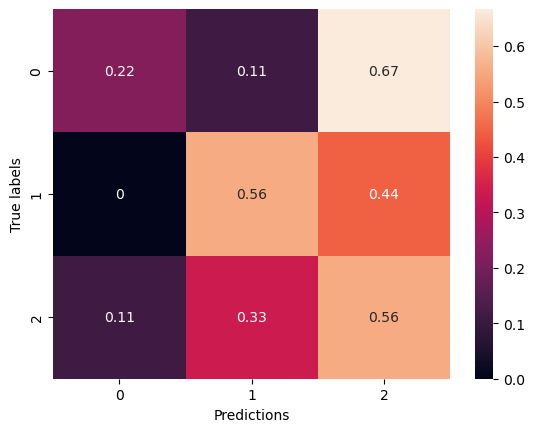

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▄▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██▇▇▇▇▇███▇
training_loss,█▆▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▁▁▂▃▆▇▇▇▇▆▇▇▇▇▆▃█▇▇██▇█▄▇▇▆▆▅▃▄▇▇▇▇▇▆█
val_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:06:24.286504: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:06:24.288142: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:06:24.290560: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:06:25.964552: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:06:25.966517: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:06:25.968365: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:06:30.520841: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:06:31.116775: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 9.5150 - accuracy: 0.3402

2024-03-13 01:06:34.574676: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:06:34.577274: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:06:34.579043: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 9.5150 - accuracy: 0.3402 - val_loss: 8.6521 - val_accuracy: 0.1852
Epoch 2/100
2/2 [==============================] - 1s 416ms/step - loss: 8.5700 - accuracy: 0.5251 - val_loss: 8.3794 - val_accuracy: 0.1667
Epoch 3/100
2/2 [==============================] - 1s 411ms/step - loss: 7.9087 - accuracy: 0.5959 - val_loss: 8.3350 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 409ms/step - loss: 7.2791 - accuracy: 0.6644 - val_loss: 8.0922 - val_accuracy: 0.1574
Epoch 5/100
2/2 [==============================] - 1s 412ms/step - loss: 6.7867 - accuracy: 0.7032 - val_loss: 7.8393 - val_accuracy: 0.1481
Epoch 6/100
2/2 [==============================] - 1s 405ms/step - loss: 6.3417 - accuracy: 0.7123 - val_loss: 7.9990 - val_accuracy: 0.1389
Epoch 7/100
2/2 [==============================] - 1s 415ms/step - loss: 5.8301 - accuracy: 0.7922 - val_loss: 8.0769 - val_accuracy: 0.1389
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 439ms/step - loss: 0.6545 - accuracy: 0.9817 - val_loss: 3.4221 - val_accuracy: 0.5093
Epoch 60/100
2/2 [==============================] - 1s 490ms/step - loss: 0.6222 - accuracy: 0.9840 - val_loss: 4.1452 - val_accuracy: 0.4352
Epoch 61/100
2/2 [==============================] - 1s 512ms/step - loss: 0.6406 - accuracy: 0.9703 - val_loss: 5.1204 - val_accuracy: 0.3333
Epoch 62/100
2/2 [==============================] - 1s 537ms/step - loss: 0.6354 - accuracy: 0.9749 - val_loss: 4.8199 - val_accuracy: 0.3333
Epoch 63/100
2/2 [==============================] - 1s 648ms/step - loss: 0.6289 - accuracy: 0.9772 - val_loss: 5.0977 - val_accuracy: 0.3333
Epoch 64/100
2/2 [==============================] - 1s 770ms/step - loss: 0.6864 - accuracy: 0.9635 - val_loss: 5.8799 - val_accuracy: 0.3241
Epoch 65/100
2/2 [==============================] - 1s 437ms/step - loss: 0.7384 - accuracy: 0.9452 - val_loss: 3.5910 - val_accuracy: 0.4815
Epoch 

2024-03-13 01:08:08.144558: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:08:08.146644: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:08:08.148367: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.833677053451538 s
{'0': {'precision': 0.2727272727272727, 'recall': 0.3333333333333333, 'f1-score': 0.3, 'support': 9}, '1': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.4295334295334295, 'recall': 0.4074074074074074, 'f1-score': 0.4148148148148148, 'support': 27}, 'weighted avg': {'precision': 0.4295334295334295, 'recall': 0.4074074074074074, 'f1-score': 0.4148148148148148, 'support': 27}}


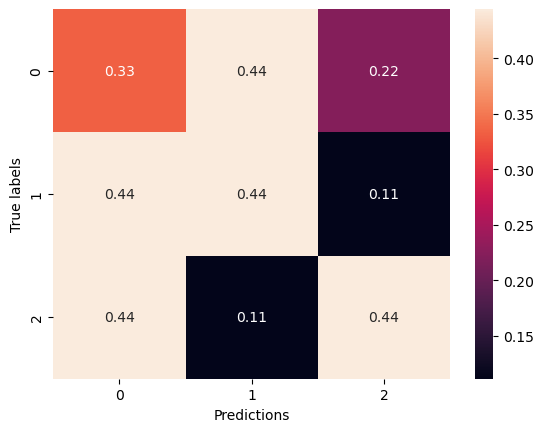

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇███████▇█████████████████████████
training_loss,█▇▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▂▃▂▂▂▅▅▆▅▅▆▅▅█▇██▆▄▄▆▇▇▇▅▅▅▄▅▅▅▄▅▄
val_loss,██▇▇▆▆▅▄▄▄▃▂▂▁▂▁▁▂▂▁▁▁▁▂▄▅▂▁▁▁▂▂▂▃▃▂▂▃▂▃


Epoch 1/100


2024-03-13 01:08:38.616208: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:08:38.619744: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:08:38.622557: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:08:41.097541: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:08:41.101084: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:08:41.103884: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:08:48.343743: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:08:49.091843: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 39.6656 - accuracy: 0.3767 

2024-03-13 01:08:53.808328: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:08:53.810457: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:08:53.812509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 17s 2s/step - loss: 39.6656 - accuracy: 0.3767 - val_loss: 34.3246 - val_accuracy: 0.1204
Epoch 2/100
2/2 [==============================] - 1s 515ms/step - loss: 32.4892 - accuracy: 0.5183 - val_loss: 28.3579 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 546ms/step - loss: 26.4991 - accuracy: 0.6142 - val_loss: 23.3708 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 461ms/step - loss: 21.2189 - accuracy: 0.6804 - val_loss: 19.2564 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 480ms/step - loss: 17.0084 - accuracy: 0.6804 - val_loss: 15.8497 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 451ms/step - loss: 13.4073 - accuracy: 0.7648 - val_loss: 12.9931 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 468ms/step - loss: 10.6497 - accuracy: 0.7900 - val_loss: 10.9223 - val_accuracy: 0.1204
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 434ms/step - loss: 0.9850 - accuracy: 0.9269 - val_loss: 2.7435 - val_accuracy: 0.5556
Epoch 60/100
2/2 [==============================] - 1s 512ms/step - loss: 0.9962 - accuracy: 0.9338 - val_loss: 3.0661 - val_accuracy: 0.4074
Epoch 61/100
2/2 [==============================] - 1s 430ms/step - loss: 0.9878 - accuracy: 0.9384 - val_loss: 3.0687 - val_accuracy: 0.4074
Epoch 62/100
2/2 [==============================] - 1s 446ms/step - loss: 0.9727 - accuracy: 0.9658 - val_loss: 3.3198 - val_accuracy: 0.4352
Epoch 63/100
2/2 [==============================] - 1s 436ms/step - loss: 0.9783 - accuracy: 0.9612 - val_loss: 3.3316 - val_accuracy: 0.4259
Epoch 64/100
2/2 [==============================] - 1s 439ms/step - loss: 0.9564 - accuracy: 0.9772 - val_loss: 3.3964 - val_accuracy: 0.4167
Epoch 65/100
2/2 [==============================] - 1s 512ms/step - loss: 0.9380 - accuracy: 0.9658 - val_loss: 3.0214 - val_accuracy: 0.5000
Epoch 

2024-03-13 01:10:26.328827: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:10:26.330447: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:10:26.332474: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6023941040039062 s
{'0': {'precision': 0.4166666666666667, 'recall': 0.5555555555555556, 'f1-score': 0.4761904761904762, 'support': 9}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.29444444444444445, 'recall': 0.4444444444444445, 'f1-score': 0.3531746031746032, 'support': 27}, 'weighted avg': {'precision': 0.29444444444444445, 'recall': 0.4444444444444444, 'f1-score': 0.35317460317460314, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


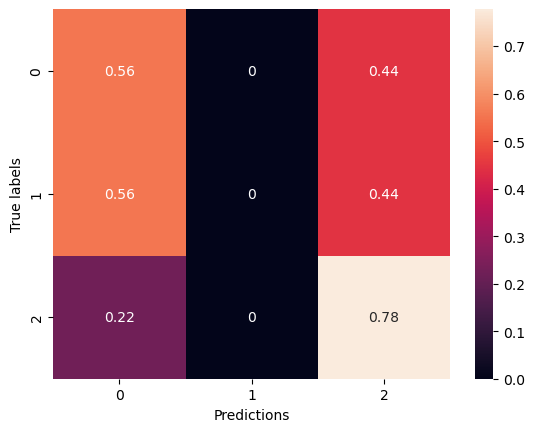

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇▇▇▇▇▇▇█▇▇▇▇█████▇▇██▇████▇▇████▇█
training_loss,█▆▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▂▂▇▆▇▂█▆▆▆▇▅▃▇▄▇▇▆▆▇▅▅▆▇▆▅▅█▆▅▅▅▆▆▄▄
val_loss,█▆▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:10:57.153184: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:10:57.154844: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:10:57.157041: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:10:59.008723: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:10:59.011088: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:10:59.012782: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:11:03.406923: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:11:04.020690: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 54.7003 - accuracy: 0.3584 

2024-03-13 01:11:07.782066: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:11:07.784619: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:11:07.786327: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 54.7003 - accuracy: 0.3584 - val_loss: 45.6084 - val_accuracy: 0.2222
Epoch 2/100
2/2 [==============================] - 1s 447ms/step - loss: 43.5909 - accuracy: 0.5365 - val_loss: 36.3835 - val_accuracy: 0.1944
Epoch 3/100
2/2 [==============================] - 1s 447ms/step - loss: 34.3438 - accuracy: 0.6370 - val_loss: 29.5109 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 441ms/step - loss: 26.7535 - accuracy: 0.6804 - val_loss: 23.6377 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 518ms/step - loss: 20.4988 - accuracy: 0.7078 - val_loss: 18.1665 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 433ms/step - loss: 15.6133 - accuracy: 0.7260 - val_loss: 14.6895 - val_accuracy: 0.1111
Epoch 7/100
2/2 [==============================] - 1s 442ms/step - loss: 11.7725 - accuracy: 0.7785 - val_loss: 11.0510 - val_accuracy: 0.1389
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 437ms/step - loss: 1.1087 - accuracy: 0.9452 - val_loss: 3.5353 - val_accuracy: 0.3704
Epoch 60/100
2/2 [==============================] - 1s 485ms/step - loss: 1.0842 - accuracy: 0.9475 - val_loss: 3.4630 - val_accuracy: 0.3241
Epoch 61/100
2/2 [==============================] - 1s 426ms/step - loss: 1.0583 - accuracy: 0.9566 - val_loss: 2.7044 - val_accuracy: 0.5463
Epoch 62/100
2/2 [==============================] - 1s 436ms/step - loss: 1.0286 - accuracy: 0.9521 - val_loss: 2.8372 - val_accuracy: 0.5370
Epoch 63/100
2/2 [==============================] - 1s 426ms/step - loss: 1.0187 - accuracy: 0.9452 - val_loss: 2.9025 - val_accuracy: 0.5463
Epoch 64/100
2/2 [==============================] - 1s 436ms/step - loss: 0.9933 - accuracy: 0.9521 - val_loss: 2.8900 - val_accuracy: 0.5556
Epoch 65/100
2/2 [==============================] - 1s 429ms/step - loss: 1.0348 - accuracy: 0.9429 - val_loss: 3.1771 - val_accuracy: 0.4907
Epoch 

2024-03-13 01:12:38.291810: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:12:38.293438: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:12:38.295490: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5839118957519531 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.46153846153846156, 'recall': 0.6666666666666666, 'f1-score': 0.5454545454545455, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.8888888888888888, 'f1-score': 0.6956521739130435, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.34432234432234426, 'recall': 0.5185185185185185, 'f1-score': 0.4137022397891963, 'support': 27}, 'weighted avg': {'precision': 0.34432234432234426, 'recall': 0.5185185185185185, 'f1-score': 0.41370223978919635, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


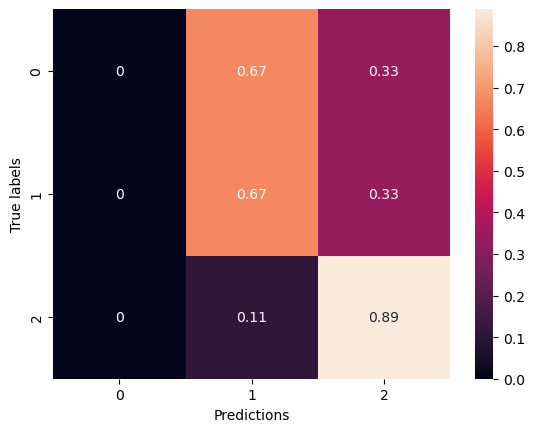

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▆▇▇▇▇▇▇█▇▇██▇██████████▇███████▇████
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▂▇▆▇▇▅█▆▇▆▇▇▇▆▆▇█▆▆▄▄▆▇▆▆▇▆▆▇▆▄▄▄▆█▇▆
val_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:13:02.920045: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:13:02.922331: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:13:02.924584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:13:05.929949: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:13:05.932164: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:13:05.934828: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:13:10.375827: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:13:10.979148: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 9.4739 - accuracy: 0.3607 

2024-03-13 01:13:14.542030: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:13:14.544024: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:13:14.545947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 9.4739 - accuracy: 0.3607 - val_loss: 8.7845 - val_accuracy: 0.1296
Epoch 2/100
2/2 [==============================] - 1s 459ms/step - loss: 8.7390 - accuracy: 0.4886 - val_loss: 8.6135 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 427ms/step - loss: 8.1755 - accuracy: 0.5000 - val_loss: 8.7742 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 424ms/step - loss: 7.7751 - accuracy: 0.5320 - val_loss: 8.9758 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 434ms/step - loss: 7.2099 - accuracy: 0.6005 - val_loss: 8.6983 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 439ms/step - loss: 6.8298 - accuracy: 0.6119 - val_loss: 8.2048 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 443ms/step - loss: 6.3899 - accuracy: 0.6621 - val_loss: 7.7767 - val_accuracy: 0.1204
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 432ms/step - loss: 0.8659 - accuracy: 0.9680 - val_loss: 2.9689 - val_accuracy: 0.6296
Epoch 60/100
2/2 [==============================] - 1s 435ms/step - loss: 0.8131 - accuracy: 0.9886 - val_loss: 3.1299 - val_accuracy: 0.5833
Epoch 61/100
2/2 [==============================] - 1s 434ms/step - loss: 0.8174 - accuracy: 0.9840 - val_loss: 3.0618 - val_accuracy: 0.5648
Epoch 62/100
2/2 [==============================] - 1s 435ms/step - loss: 0.7961 - accuracy: 0.9772 - val_loss: 3.0428 - val_accuracy: 0.5463
Epoch 63/100
2/2 [==============================] - 1s 430ms/step - loss: 0.7871 - accuracy: 0.9772 - val_loss: 3.1418 - val_accuracy: 0.4907
Epoch 64/100
2/2 [==============================] - 1s 424ms/step - loss: 0.7659 - accuracy: 0.9817 - val_loss: 2.8496 - val_accuracy: 0.5556
Epoch 65/100
2/2 [==============================] - 1s 460ms/step - loss: 0.7565 - accuracy: 0.9726 - val_loss: 2.9279 - val_accuracy: 0.5833
Epoch 

2024-03-13 01:14:43.933498: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:14:43.935760: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:14:43.937481: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5631847381591797 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 1.0, 'f1-score': 0.6, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.5595238095238095, 'recall': 0.48148148148148145, 'f1-score': 0.4144522144522145, 'support': 27}, 'weighted avg': {'precision': 0.5595238095238095, 'recall': 0.48148148148148145, 'f1-score': 0.4144522144522144, 'support': 27}}


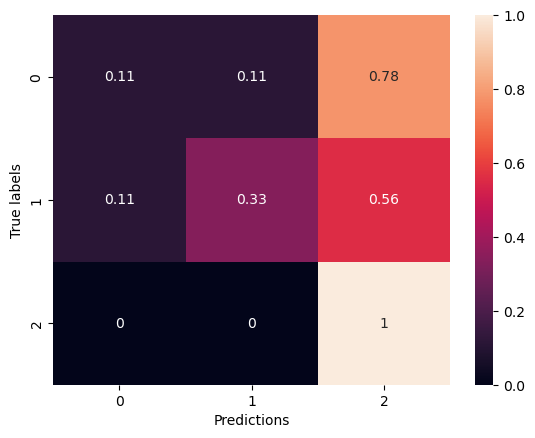

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▆▆▆▇▇▇▇█▇████▇██▇██████████████████
training_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▂▂▃▆▇▇██▇▆▅▇█▇█▇█▇▇█▇▇▇▇▆▆▇▆▆▆█▅▇
val_loss,██▇▆▅▄▄▃▃▃▁▁▁▁▁▁▂▂▁▁▂▁▁▁▁▁▁▁▂▂▂▂▂▁▂▁▂▁▂▁


Epoch 1/100


2024-03-13 01:15:07.264641: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:15:07.266299: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:15:07.268238: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:15:09.051274: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:15:09.053673: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:15:09.055755: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:15:13.408294: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:15:14.015584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 39.5499 - accuracy: 0.3744

2024-03-13 01:15:17.634669: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:15:17.636313: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:15:17.638731: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 39.5499 - accuracy: 0.3744 - val_loss: 33.7041 - val_accuracy: 0.2315
Epoch 2/100
2/2 [==============================] - 1s 480ms/step - loss: 32.7590 - accuracy: 0.4269 - val_loss: 28.0641 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 429ms/step - loss: 26.7207 - accuracy: 0.5137 - val_loss: 23.9044 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 429ms/step - loss: 21.7886 - accuracy: 0.5753 - val_loss: 20.0070 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 438ms/step - loss: 17.5974 - accuracy: 0.6301 - val_loss: 16.6348 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 428ms/step - loss: 14.2421 - accuracy: 0.6164 - val_loss: 13.9533 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 470ms/step - loss: 11.5478 - accuracy: 0.6164 - val_loss: 11.9990 - val_accuracy: 0.1204
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 452ms/step - loss: 1.1159 - accuracy: 0.9452 - val_loss: 3.0679 - val_accuracy: 0.5370
Epoch 60/100
2/2 [==============================] - 1s 443ms/step - loss: 1.1814 - accuracy: 0.9110 - val_loss: 2.8988 - val_accuracy: 0.5741
Epoch 61/100
2/2 [==============================] - 1s 434ms/step - loss: 1.2045 - accuracy: 0.9247 - val_loss: 3.3699 - val_accuracy: 0.4444
Epoch 62/100
2/2 [==============================] - 1s 430ms/step - loss: 1.1875 - accuracy: 0.9132 - val_loss: 3.9778 - val_accuracy: 0.2870
Epoch 63/100
2/2 [==============================] - 1s 446ms/step - loss: 1.2358 - accuracy: 0.8973 - val_loss: 3.1542 - val_accuracy: 0.3981
Epoch 64/100
2/2 [==============================] - 1s 439ms/step - loss: 1.1766 - accuracy: 0.9384 - val_loss: 2.8657 - val_accuracy: 0.5000
Epoch 65/100
2/2 [==============================] - 1s 438ms/step - loss: 1.2664 - accuracy: 0.9087 - val_loss: 2.8437 - val_accuracy: 0.5648
Epoch 

2024-03-13 01:16:46.450590: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:16:46.452666: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:16:46.454427: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 2.7505767345428467 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.6363636363636364, 'recall': 0.7777777777777778, 'f1-score': 0.7000000000000001, 'support': 9}, '2': {'precision': 0.5625, 'recall': 1.0, 'f1-score': 0.72, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.3996212121212121, 'recall': 0.5925925925925926, 'f1-score': 0.47333333333333333, 'support': 27}, 'weighted avg': {'precision': 0.3996212121212121, 'recall': 0.5925925925925926, 'f1-score': 0.4733333333333334, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


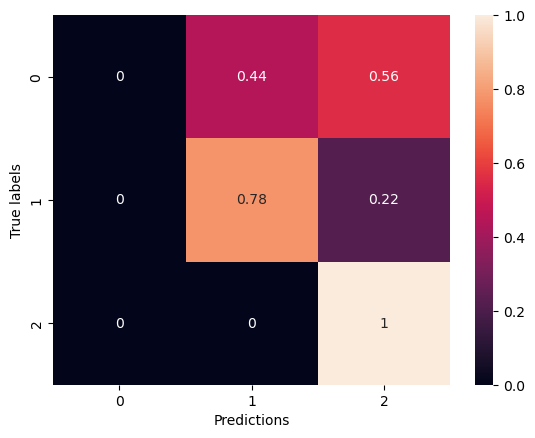

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▄▅▅▆▆▇▇▇▇▇▇▇█▇▇▇▇▇█▇█▇▇▇█▇▇████▇▇▇███
training_loss,█▆▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▁▁▁▂▄▅▅▄▇▆▆▇▇▆▇▇▆▇█▆▇▆▇▆▇▄▅▆▅▄▄██▅▆██
val_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:17:10.046915: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:17:10.048769: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:17:10.050862: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:17:11.765403: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:17:11.767694: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:17:11.769626: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:17:16.143547: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:17:16.751851: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 54.4499 - accuracy: 0.3995

2024-03-13 01:17:20.369571: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:17:20.372165: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:17:20.373777: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 54.4499 - accuracy: 0.3995 - val_loss: 45.5266 - val_accuracy: 0.3148
Epoch 2/100
2/2 [==============================] - 1s 439ms/step - loss: 43.8923 - accuracy: 0.4201 - val_loss: 36.7137 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 441ms/step - loss: 34.9951 - accuracy: 0.4749 - val_loss: 29.4433 - val_accuracy: 0.1481
Epoch 4/100
2/2 [==============================] - 1s 443ms/step - loss: 27.6046 - accuracy: 0.5046 - val_loss: 23.4139 - val_accuracy: 0.1389
Epoch 5/100
2/2 [==============================] - 1s 428ms/step - loss: 21.5389 - accuracy: 0.5685 - val_loss: 18.4150 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 444ms/step - loss: 16.8257 - accuracy: 0.5365 - val_loss: 14.5495 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 421ms/step - loss: 12.9345 - accuracy: 0.6416 - val_loss: 11.6566 - val_accuracy: 0.1111
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 428ms/step - loss: 1.2005 - accuracy: 0.9361 - val_loss: 3.9032 - val_accuracy: 0.2593
Epoch 60/100
2/2 [==============================] - 1s 438ms/step - loss: 1.2480 - accuracy: 0.8950 - val_loss: 3.8492 - val_accuracy: 0.3056
Epoch 61/100
2/2 [==============================] - 1s 439ms/step - loss: 1.2346 - accuracy: 0.9338 - val_loss: 4.0027 - val_accuracy: 0.3241
Epoch 62/100
2/2 [==============================] - 1s 441ms/step - loss: 1.2458 - accuracy: 0.9315 - val_loss: 2.9271 - val_accuracy: 0.5370
Epoch 63/100
2/2 [==============================] - 1s 430ms/step - loss: 1.3150 - accuracy: 0.9064 - val_loss: 2.8502 - val_accuracy: 0.5833
Epoch 64/100
2/2 [==============================] - 1s 432ms/step - loss: 1.3424 - accuracy: 0.8995 - val_loss: 3.0482 - val_accuracy: 0.5185
Epoch 65/100
2/2 [==============================] - 1s 443ms/step - loss: 1.2743 - accuracy: 0.9224 - val_loss: 3.5144 - val_accuracy: 0.3611
Epoch 

2024-03-13 01:18:48.977195: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:18:48.980243: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:18:48.981919: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6074779033660889 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.47058823529411764, 'recall': 0.8888888888888888, 'f1-score': 0.6153846153846153, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.3235294117647059, 'recall': 0.48148148148148145, 'f1-score': 0.3805668016194332, 'support': 27}, 'weighted avg': {'precision': 0.32352941176470584, 'recall': 0.48148148148148145, 'f1-score': 0.3805668016194331, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


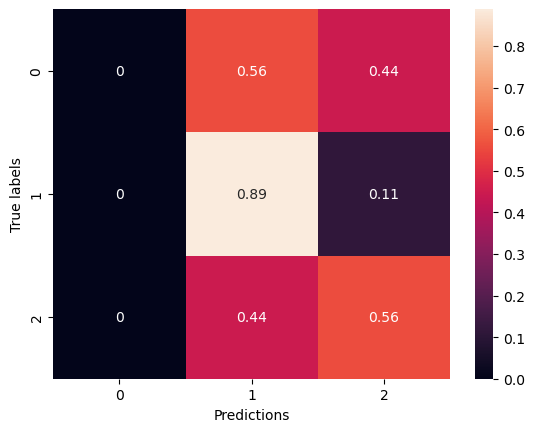

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█████▇▇▇▇███▇███▇█▇█
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▁▁▂▄▇▄▁▄▇▅▄███▃█▆▁▄▇▅▅▃▄▇▇█▇▇▆▃██▅▇▅▇▄▆
val_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:19:11.975913: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:19:11.977766: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:19:11.980767: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:19:13.696584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:19:13.699238: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:19:13.701135: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:19:18.144718: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:19:19.800315: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 9.4731 - accuracy: 0.3425 

2024-03-13 01:19:23.432401: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:19:23.435156: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:19:23.437305: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 9.4731 - accuracy: 0.3425 - val_loss: 8.7560 - val_accuracy: 0.1204
Epoch 2/100
2/2 [==============================] - 1s 435ms/step - loss: 8.9215 - accuracy: 0.3767 - val_loss: 8.5195 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 437ms/step - loss: 8.6023 - accuracy: 0.3813 - val_loss: 8.3491 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 434ms/step - loss: 8.1849 - accuracy: 0.3630 - val_loss: 8.2923 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 434ms/step - loss: 7.6696 - accuracy: 0.4452 - val_loss: 8.2420 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 436ms/step - loss: 7.3794 - accuracy: 0.4247 - val_loss: 8.1301 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 505ms/step - loss: 6.9883 - accuracy: 0.4840 - val_loss: 7.8620 - val_accuracy: 0.1204
Epoch 8/100
2/2 [==========

Epoch 59/100
2/2 [==============================] - 1s 487ms/step - loss: 1.0681 - accuracy: 0.9087 - val_loss: 2.7700 - val_accuracy: 0.5556
Epoch 60/100
2/2 [==============================] - 1s 416ms/step - loss: 1.1131 - accuracy: 0.9018 - val_loss: 2.6916 - val_accuracy: 0.6111
Epoch 61/100
2/2 [==============================] - 1s 432ms/step - loss: 1.0672 - accuracy: 0.9178 - val_loss: 2.7472 - val_accuracy: 0.6019
Epoch 62/100
2/2 [==============================] - 1s 427ms/step - loss: 1.0758 - accuracy: 0.9041 - val_loss: 2.6863 - val_accuracy: 0.5648
Epoch 63/100
2/2 [==============================] - 1s 439ms/step - loss: 1.0419 - accuracy: 0.9269 - val_loss: 2.7788 - val_accuracy: 0.5741
Epoch 64/100
2/2 [==============================] - 1s 538ms/step - loss: 1.0634 - accuracy: 0.9178 - val_loss: 2.7578 - val_accuracy: 0.6019
Epoch 65/100
2/2 [==============================] - 1s 427ms/step - loss: 1.0365 - accuracy: 0.9247 - val_loss: 3.1038 - val_accuracy: 0.5926
Epoch 

2024-03-13 01:20:53.190558: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:20:53.192797: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:20:53.195436: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5769059658050537 s
{'0': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '1': {'precision': 0.4117647058823529, 'recall': 0.7777777777777778, 'f1-score': 0.5384615384615384, 'support': 9}, '2': {'precision': 0.8333333333333334, 'recall': 0.5555555555555556, 'f1-score': 0.6666666666666667, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6650326797385621, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 27}, 'weighted avg': {'precision': 0.665032679738562, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 27}}


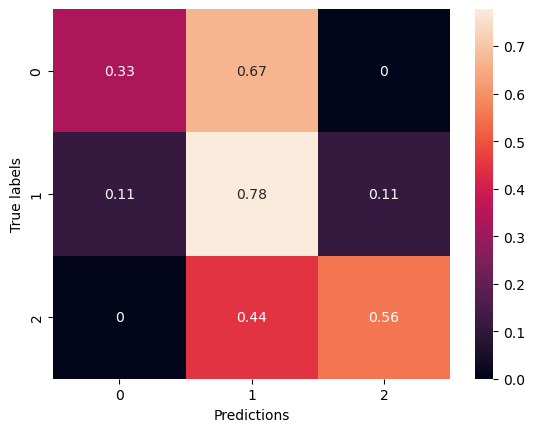

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▃▂▃▃▄▄▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇██▇▇████████▇
training_loss,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▁▁▁▃▃▂▃▄▄▅▄▆▇▇▇▄▅▇▇▇▇█▇▇██▅▇▇▇▅▄▇▅
val_loss,██▇▇▇▆▆▆▅▃▂▃▂▁▁▁▂▁▁▁▁▂▂▁▁▁▁▁▁▂▁▁▂▂▁▂▂▂▁▂


Epoch 1/100


2024-03-13 01:21:23.058358: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:21:23.061420: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:21:23.063739: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:21:24.763273: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:21:24.764968: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:21:24.766986: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:21:29.118398: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:21:29.783639: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 39.9048 - accuracy: 0.3037

2024-03-13 01:21:33.412304: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:21:33.413876: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:21:33.415956: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 39.9048 - accuracy: 0.3037 - val_loss: 34.0149 - val_accuracy: 0.2870
Epoch 2/100
2/2 [==============================] - 1s 429ms/step - loss: 33.1515 - accuracy: 0.3676 - val_loss: 28.4296 - val_accuracy: 0.2407
Epoch 3/100
2/2 [==============================] - 1s 436ms/step - loss: 27.7779 - accuracy: 0.3744 - val_loss: 23.7602 - val_accuracy: 0.1944
Epoch 4/100
2/2 [==============================] - 1s 437ms/step - loss: 23.2353 - accuracy: 0.3470 - val_loss: 20.0399 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 429ms/step - loss: 19.2400 - accuracy: 0.3927 - val_loss: 17.1142 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 459ms/step - loss: 16.0522 - accuracy: 0.4178 - val_loss: 14.8079 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 469ms/step - loss: 13.4567 - accuracy: 0.4749 - val_loss: 12.7670 - val_accuracy: 0.1204
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 438ms/step - loss: 1.4276 - accuracy: 0.8813 - val_loss: 3.1278 - val_accuracy: 0.4167
Epoch 60/100
2/2 [==============================] - 1s 441ms/step - loss: 1.4828 - accuracy: 0.8447 - val_loss: 3.7825 - val_accuracy: 0.3519
Epoch 61/100
2/2 [==============================] - 1s 435ms/step - loss: 1.4907 - accuracy: 0.8242 - val_loss: 3.0494 - val_accuracy: 0.4630
Epoch 62/100
2/2 [==============================] - 1s 433ms/step - loss: 1.4419 - accuracy: 0.8516 - val_loss: 2.6335 - val_accuracy: 0.5370
Epoch 63/100
2/2 [==============================] - 1s 430ms/step - loss: 1.4774 - accuracy: 0.8653 - val_loss: 2.5536 - val_accuracy: 0.5833
Epoch 64/100
2/2 [==============================] - 1s 442ms/step - loss: 1.4759 - accuracy: 0.8562 - val_loss: 2.7479 - val_accuracy: 0.4815
Epoch 65/100
2/2 [==============================] - 1s 443ms/step - loss: 1.3985 - accuracy: 0.8858 - val_loss: 2.6060 - val_accuracy: 0.5556
Epoch 

2024-03-13 01:23:03.741641: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:23:03.743835: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:23:03.746103: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5800960063934326 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4166666666666667, 'recall': 0.5555555555555556, 'f1-score': 0.4761904761904762, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.3055555555555556, 'recall': 0.4444444444444445, 'f1-score': 0.36162870945479647, 'support': 27}, 'weighted avg': {'precision': 0.3055555555555556, 'recall': 0.4444444444444444, 'f1-score': 0.3616287094547964, 'support': 27}}


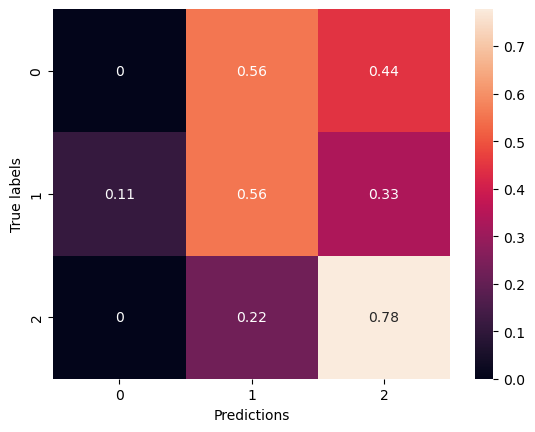

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▃▄▅▄▅▆▆▆▆▇▇▇▇█▇▇▇███▇▇█▇▇██████▇████
training_loss,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▂▁▁▁▁▂▄▄▄▅▅▅▇█▅██▇▆▆▆▅▅▆▆▆▅▅▆▅▆▄▇▇▄█▅▁▆
val_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁


Epoch 1/100


2024-03-13 01:23:32.809042: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:23:32.811487: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:23:32.813109: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:23:34.559585: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:23:34.561570: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:23:34.563888: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:23:40.198008: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:23:40.831560: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 54.5832 - accuracy: 0.3379 

2024-03-13 01:23:44.738403: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:23:44.740818: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:23:44.742818: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 14s 2s/step - loss: 54.5832 - accuracy: 0.3379 - val_loss: 45.7110 - val_accuracy: 0.3333
Epoch 2/100
2/2 [==============================] - 1s 447ms/step - loss: 44.2042 - accuracy: 0.3630 - val_loss: 36.7099 - val_accuracy: 0.2593
Epoch 3/100
2/2 [==============================] - 1s 461ms/step - loss: 35.4062 - accuracy: 0.3493 - val_loss: 29.2119 - val_accuracy: 0.3426
Epoch 4/100
2/2 [==============================] - 1s 463ms/step - loss: 28.2471 - accuracy: 0.3607 - val_loss: 23.1058 - val_accuracy: 0.3333
Epoch 5/100
2/2 [==============================] - 1s 491ms/step - loss: 22.2001 - accuracy: 0.4178 - val_loss: 18.2459 - val_accuracy: 0.2130
Epoch 6/100
2/2 [==============================] - 1s 446ms/step - loss: 17.4603 - accuracy: 0.4338 - val_loss: 14.4737 - val_accuracy: 0.1481
Epoch 7/100
2/2 [==============================] - 1s 463ms/step - loss: 13.7471 - accuracy: 0.4635 - val_loss: 11.6306 - val_accuracy: 0.1574
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 430ms/step - loss: 1.8061 - accuracy: 0.8493 - val_loss: 3.3588 - val_accuracy: 0.2963
Epoch 60/100
2/2 [==============================] - 1s 431ms/step - loss: 1.7637 - accuracy: 0.8607 - val_loss: 2.9562 - val_accuracy: 0.4352
Epoch 61/100
2/2 [==============================] - 1s 439ms/step - loss: 1.7177 - accuracy: 0.8630 - val_loss: 2.7550 - val_accuracy: 0.5741
Epoch 62/100
2/2 [==============================] - 1s 433ms/step - loss: 1.6240 - accuracy: 0.8630 - val_loss: 2.8055 - val_accuracy: 0.5648
Epoch 63/100
2/2 [==============================] - 1s 431ms/step - loss: 1.5185 - accuracy: 0.8973 - val_loss: 2.8592 - val_accuracy: 0.5185
Epoch 64/100
2/2 [==============================] - 1s 445ms/step - loss: 1.4267 - accuracy: 0.9132 - val_loss: 4.4640 - val_accuracy: 0.2500
Epoch 65/100
2/2 [==============================] - 1s 431ms/step - loss: 1.3920 - accuracy: 0.8881 - val_loss: 3.5399 - val_accuracy: 0.3981
Epoch 

2024-03-13 01:25:15.488973: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:25:15.491186: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:25:15.493077: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5745131969451904 s
{'0': {'precision': 0.42857142857142855, 'recall': 1.0, 'f1-score': 0.6, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '2': {'precision': 1.0, 'recall': 0.5555555555555556, 'f1-score': 0.7142857142857143, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.8095238095238096, 'recall': 0.5555555555555556, 'f1-score': 0.5047619047619047, 'support': 27}, 'weighted avg': {'precision': 0.8095238095238095, 'recall': 0.5555555555555556, 'f1-score': 0.5047619047619047, 'support': 27}}


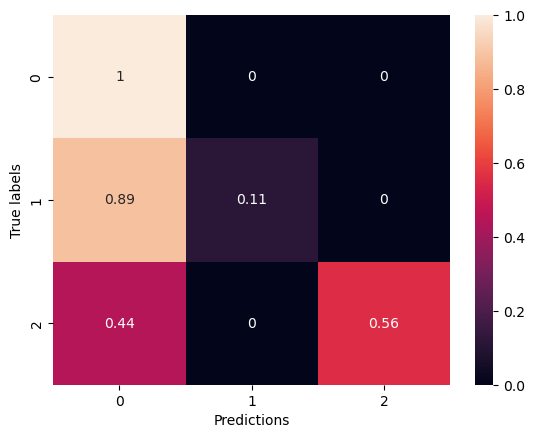

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▃▄▄▄▄▅▅▆▆▆▆▆▇▇▇▇▇▇▆▇▇▇█▇▇▇▇▇██████▇▇▇
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▄▁▁▂▂▂▅▄▃▅▅▇▃▅▅▅▇█▇▅▆▆▃▇▃▅▆▇▆▂▅▆▅▅▆▇▇▂▃
val_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:25:39.402666: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:25:39.404272: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:25:39.406173: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:25:41.110255: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:25:41.112143: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:25:41.114344: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:25:45.538919: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:25:46.179128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 11.1295 - accuracy: 0.4041 

2024-03-13 01:25:50.179024: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:25:50.181867: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:25:50.183965: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 2s/step - loss: 11.1295 - accuracy: 0.4041 - val_loss: 10.6737 - val_accuracy: 0.1296
Epoch 2/100
2/2 [==============================] - 1s 545ms/step - loss: 10.0222 - accuracy: 0.5548 - val_loss: 10.3235 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 576ms/step - loss: 9.1217 - accuracy: 0.6370 - val_loss: 10.0842 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 611ms/step - loss: 8.2077 - accuracy: 0.7169 - val_loss: 10.1477 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 547ms/step - loss: 7.5624 - accuracy: 0.7374 - val_loss: 9.5995 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 546ms/step - loss: 6.8600 - accuracy: 0.7694 - val_loss: 8.9403 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 549ms/step - loss: 6.2615 - accuracy: 0.8037 - val_loss: 9.2546 - val_accuracy: 0.1204
Epoch 8/100
2/2 [====

Epoch 59/100
2/2 [==============================] - 1s 528ms/step - loss: 0.7531 - accuracy: 0.9772 - val_loss: 4.2123 - val_accuracy: 0.4074
Epoch 60/100
2/2 [==============================] - 1s 535ms/step - loss: 0.7606 - accuracy: 0.9680 - val_loss: 3.9002 - val_accuracy: 0.4167
Epoch 61/100
2/2 [==============================] - 1s 579ms/step - loss: 0.7181 - accuracy: 0.9840 - val_loss: 3.8306 - val_accuracy: 0.4444
Epoch 62/100
2/2 [==============================] - 1s 546ms/step - loss: 0.7781 - accuracy: 0.9566 - val_loss: 4.8862 - val_accuracy: 0.3333
Epoch 63/100
2/2 [==============================] - 1s 541ms/step - loss: 0.7173 - accuracy: 0.9749 - val_loss: 3.4429 - val_accuracy: 0.4352
Epoch 64/100
2/2 [==============================] - 1s 527ms/step - loss: 0.7375 - accuracy: 0.9749 - val_loss: 3.9081 - val_accuracy: 0.3796
Epoch 65/100
2/2 [==============================] - 1s 553ms/step - loss: 0.7232 - accuracy: 0.9817 - val_loss: 3.6672 - val_accuracy: 0.4815
Epoch 

2024-03-13 01:27:41.713285: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:27:41.715031: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:27:41.716925: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5735101699829102 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.375, 'recall': 1.0, 'f1-score': 0.5454545454545454, 'support': 9}, '2': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.34722222222222215, 'recall': 0.40740740740740744, 'f1-score': 0.2929292929292929, 'support': 27}, 'weighted avg': {'precision': 0.3472222222222222, 'recall': 0.4074074074074074, 'f1-score': 0.2929292929292929, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


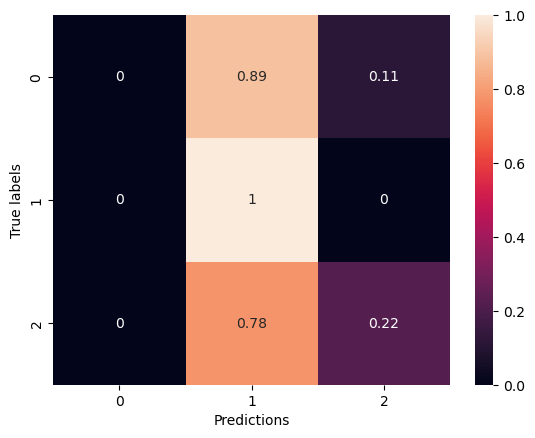

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▅▆▇▇██████████████████████████████████
training_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▄▃▇▆▇▄▄▇▇▅▅▆▅▆▅▇▆▅▇▆▆▅▆▇▆██▇▄▄▆▆█▆▅▅
val_loss,█▇▆▆▄▄▂▂▂▄▃▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▃▃▂▂▁▂▂▃


Epoch 1/100


2024-03-13 01:28:08.471705: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:28:08.475590: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:28:08.477484: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:28:10.246585: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:28:10.248441: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:28:10.250678: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:28:14.678128: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:28:15.292661: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 47.4966 - accuracy: 0.3813 

2024-03-13 01:28:19.134383: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:28:19.136645: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:28:19.138251: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 47.4966 - accuracy: 0.3813 - val_loss: 39.7594 - val_accuracy: 0.1389
Epoch 2/100
2/2 [==============================] - 1s 539ms/step - loss: 37.4540 - accuracy: 0.5548 - val_loss: 31.6045 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 555ms/step - loss: 29.0508 - accuracy: 0.6804 - val_loss: 24.8629 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 578ms/step - loss: 22.1660 - accuracy: 0.7580 - val_loss: 19.5899 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 542ms/step - loss: 16.8631 - accuracy: 0.7306 - val_loss: 15.2405 - val_accuracy: 0.1296
Epoch 6/100
2/2 [==============================] - 1s 556ms/step - loss: 12.6646 - accuracy: 0.7831 - val_loss: 12.2509 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 539ms/step - loss: 9.6200 - accuracy: 0.8014 - val_loss: 9.3519 - val_accuracy: 0.1481
Epoch 8/100
2/2

Epoch 59/100
2/2 [==============================] - 1s 568ms/step - loss: 1.4265 - accuracy: 0.9338 - val_loss: 3.6048 - val_accuracy: 0.3611
Epoch 60/100
2/2 [==============================] - 1s 566ms/step - loss: 1.3680 - accuracy: 0.9406 - val_loss: 3.3113 - val_accuracy: 0.4907
Epoch 61/100
2/2 [==============================] - 1s 549ms/step - loss: 1.2957 - accuracy: 0.9703 - val_loss: 3.2255 - val_accuracy: 0.4907
Epoch 62/100
2/2 [==============================] - 1s 614ms/step - loss: 1.2484 - accuracy: 0.9726 - val_loss: 3.3825 - val_accuracy: 0.4907
Epoch 63/100
2/2 [==============================] - 1s 560ms/step - loss: 1.1892 - accuracy: 0.9680 - val_loss: 3.4737 - val_accuracy: 0.4352
Epoch 64/100
2/2 [==============================] - 1s 539ms/step - loss: 1.1580 - accuracy: 0.9635 - val_loss: 3.3212 - val_accuracy: 0.4722
Epoch 65/100
2/2 [==============================] - 1s 537ms/step - loss: 1.0458 - accuracy: 0.9932 - val_loss: 3.1577 - val_accuracy: 0.5278
Epoch 

2024-03-13 01:30:11.356368: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:30:11.358355: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:30:11.360043: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5750279426574707 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.4117647058823529, 'recall': 0.7777777777777778, 'f1-score': 0.5384615384615384, 'support': 9}, '2': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.6557734204793028, 'recall': 0.48148148148148145, 'f1-score': 0.4313390313390313, 'support': 27}, 'weighted avg': {'precision': 0.6557734204793028, 'recall': 0.48148148148148145, 'f1-score': 0.43133903133903134, 'support': 27}}


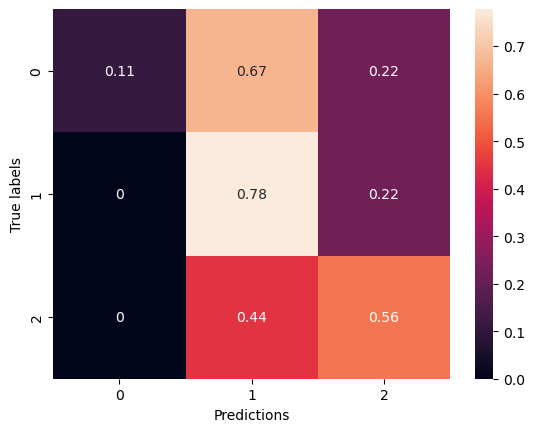

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▇█████▇█▇▇█████▇█▇█████▇█▇████████
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▃▂▅███▅▅█▇▆▆▇▇▆▄▆▅▄▅▄▆▆▇▇▆▆▅▅▇▇▇▆▄▆▅▅
val_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:30:37.552889: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:30:37.554534: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:30:37.557139: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:30:39.329696: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:30:39.331495: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:30:39.333436: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:30:43.813651: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:30:44.434732: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 65.2462 - accuracy: 0.3744 

2024-03-13 01:30:49.383228: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:30:49.385190: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:30:49.386983: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 14s 2s/step - loss: 65.2462 - accuracy: 0.3744 - val_loss: 52.7318 - val_accuracy: 0.1759
Epoch 2/100
2/2 [==============================] - 1s 547ms/step - loss: 49.7392 - accuracy: 0.5388 - val_loss: 40.5016 - val_accuracy: 0.1204
Epoch 3/100
2/2 [==============================] - 1s 568ms/step - loss: 37.0911 - accuracy: 0.6735 - val_loss: 30.7742 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 596ms/step - loss: 27.1966 - accuracy: 0.7420 - val_loss: 22.4488 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 536ms/step - loss: 19.6109 - accuracy: 0.7740 - val_loss: 18.1971 - val_accuracy: 0.1111
Epoch 6/100
2/2 [==============================] - 1s 536ms/step - loss: 14.0781 - accuracy: 0.8059 - val_loss: 12.3014 - val_accuracy: 0.1667
Epoch 7/100
2/2 [==============================] - 1s 564ms/step - loss: 10.1127 - accuracy: 0.8311 - val_loss: 9.1315 - val_accuracy: 0.2963
Epoch 8/100
2/

Epoch 59/100
2/2 [==============================] - 1s 561ms/step - loss: 0.9896 - accuracy: 0.9749 - val_loss: 3.3865 - val_accuracy: 0.3889
Epoch 60/100
2/2 [==============================] - 1s 550ms/step - loss: 1.0018 - accuracy: 0.9566 - val_loss: 3.1000 - val_accuracy: 0.5185
Epoch 61/100
2/2 [==============================] - 1s 614ms/step - loss: 1.0152 - accuracy: 0.9566 - val_loss: 2.9750 - val_accuracy: 0.5093
Epoch 62/100
2/2 [==============================] - 1s 551ms/step - loss: 0.9830 - accuracy: 0.9543 - val_loss: 2.8681 - val_accuracy: 0.5741
Epoch 63/100
2/2 [==============================] - 1s 560ms/step - loss: 1.0112 - accuracy: 0.9589 - val_loss: 3.4238 - val_accuracy: 0.4722
Epoch 64/100
2/2 [==============================] - 1s 544ms/step - loss: 1.1116 - accuracy: 0.9247 - val_loss: 2.8455 - val_accuracy: 0.5556
Epoch 65/100
2/2 [==============================] - 1s 538ms/step - loss: 1.1730 - accuracy: 0.9132 - val_loss: 3.1906 - val_accuracy: 0.4444
Epoch 

2024-03-13 01:32:43.880794: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:32:43.882896: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:32:43.885270: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6377060413360596 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.4444444444444444, 'f1-score': 0.380952380952381, 'support': 9}, '2': {'precision': 0.4166666666666667, 'recall': 0.5555555555555556, 'f1-score': 0.4761904761904762, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.47222222222222227, 'recall': 0.40740740740740744, 'f1-score': 0.3968253968253968, 'support': 27}, 'weighted avg': {'precision': 0.4722222222222222, 'recall': 0.4074074074074074, 'f1-score': 0.39682539682539686, 'support': 27}}


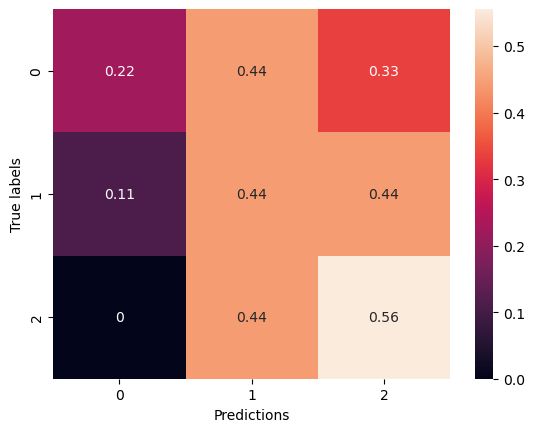

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▄▆▆▇▇▇▇▇▇██▇▇██▇██▇▇████▇▇▇████▇▇██████
training_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▁▄▄█▆▄▅▄▆▆▆▇▇▇▆▄▇▇██▅▇█▄▆▇█▅▆▅▅▅▄▅▆▅▆
val_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:33:08.665521: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:33:08.667936: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:33:08.670345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:33:10.427608: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:33:10.430031: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:33:10.431687: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:33:14.874224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:33:15.487847: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 11.3064 - accuracy: 0.3562 

2024-03-13 01:33:19.378794: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:33:19.381154: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:33:19.382774: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 11.3064 - accuracy: 0.3562 - val_loss: 10.5742 - val_accuracy: 0.1296
Epoch 2/100
2/2 [==============================] - 1s 632ms/step - loss: 10.3242 - accuracy: 0.4703 - val_loss: 10.7667 - val_accuracy: 0.1296
Epoch 3/100
2/2 [==============================] - 1s 549ms/step - loss: 9.8019 - accuracy: 0.5365 - val_loss: 10.9290 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 1s 577ms/step - loss: 8.9898 - accuracy: 0.6210 - val_loss: 11.0208 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 627ms/step - loss: 8.5323 - accuracy: 0.6187 - val_loss: 11.0768 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 543ms/step - loss: 7.9932 - accuracy: 0.6598 - val_loss: 10.4014 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 557ms/step - loss: 7.5511 - accuracy: 0.6393 - val_loss: 9.3597 - val_accuracy: 0.1204
Epoch 8/100
2/2 [==

Epoch 59/100
2/2 [==============================] - 1s 549ms/step - loss: 0.9434 - accuracy: 0.9566 - val_loss: 3.5668 - val_accuracy: 0.4352
Epoch 60/100
2/2 [==============================] - 1s 551ms/step - loss: 1.0002 - accuracy: 0.9384 - val_loss: 3.3306 - val_accuracy: 0.5370
Epoch 61/100
2/2 [==============================] - 1s 549ms/step - loss: 0.9881 - accuracy: 0.9475 - val_loss: 3.2702 - val_accuracy: 0.6111
Epoch 62/100
2/2 [==============================] - 1s 587ms/step - loss: 0.9530 - accuracy: 0.9498 - val_loss: 3.0165 - val_accuracy: 0.5833
Epoch 63/100
2/2 [==============================] - 1s 568ms/step - loss: 0.9347 - accuracy: 0.9658 - val_loss: 3.7101 - val_accuracy: 0.4907
Epoch 64/100
2/2 [==============================] - 1s 545ms/step - loss: 1.0039 - accuracy: 0.9543 - val_loss: 3.6759 - val_accuracy: 0.4259
Epoch 65/100
2/2 [==============================] - 1s 571ms/step - loss: 0.9746 - accuracy: 0.9521 - val_loss: 3.4801 - val_accuracy: 0.4444
Epoch 

2024-03-13 01:35:12.803645: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:35:12.805868: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:35:12.807531: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6313769817352295 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '2': {'precision': 0.391304347826087, 'recall': 1.0, 'f1-score': 0.5625, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.24154589371980675, 'recall': 0.3703703703703704, 'f1-score': 0.24305555555555555, 'support': 27}, 'weighted avg': {'precision': 0.24154589371980678, 'recall': 0.37037037037037035, 'f1-score': 0.24305555555555555, 'support': 27}}


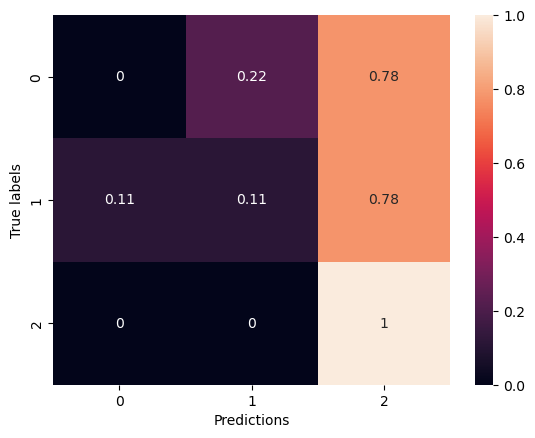

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▄▅▅▆▆▇▇▇▇█████████████████████████████
training_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▁▁▂▂▂▄▅▆▄▆▆▄▄▅▆▅▅▇▅▆█▅▆▆▇▇▇▇▆▆▆▅▄▄▇▇
val_loss,███▆▆▅▃▃▃▂▂▂▂▁▁▃▃▂▂▂▂▁▂▁▁▂▁▂▁▁▁▁▁▁▂▂▃▂▁▁


Epoch 1/100


2024-03-13 01:35:38.543645: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:35:38.545268: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:35:38.547564: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:35:40.299830: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:35:40.301678: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:35:40.303698: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:35:45.839913: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:35:46.455308: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 47.6169 - accuracy: 0.3447 

2024-03-13 01:35:50.503300: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:35:50.506245: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:35:50.508186: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 14s 3s/step - loss: 47.6169 - accuracy: 0.3447 - val_loss: 39.6578 - val_accuracy: 0.1667
Epoch 2/100
2/2 [==============================] - 1s 640ms/step - loss: 37.9674 - accuracy: 0.5023 - val_loss: 32.4958 - val_accuracy: 0.1389
Epoch 3/100
2/2 [==============================] - 2s 1s/step - loss: 30.2146 - accuracy: 0.5251 - val_loss: 26.1786 - val_accuracy: 0.1204
Epoch 4/100
2/2 [==============================] - 2s 1s/step - loss: 23.5114 - accuracy: 0.6096 - val_loss: 20.6938 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 584ms/step - loss: 18.3562 - accuracy: 0.6256 - val_loss: 17.1830 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 546ms/step - loss: 14.1804 - accuracy: 0.6781 - val_loss: 14.5546 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 547ms/step - loss: 11.0863 - accuracy: 0.7032 - val_loss: 12.4573 - val_accuracy: 0.1204
Epoch 8/100
2/2 [==

Epoch 59/100
2/2 [==============================] - 1s 551ms/step - loss: 1.3080 - accuracy: 0.9635 - val_loss: 5.2665 - val_accuracy: 0.2593
Epoch 60/100
2/2 [==============================] - 1s 553ms/step - loss: 1.3090 - accuracy: 0.9498 - val_loss: 4.2386 - val_accuracy: 0.3519
Epoch 61/100
2/2 [==============================] - 1s 550ms/step - loss: 1.2578 - accuracy: 0.9612 - val_loss: 3.1980 - val_accuracy: 0.5093
Epoch 62/100
2/2 [==============================] - 1s 532ms/step - loss: 1.2756 - accuracy: 0.9452 - val_loss: 4.2067 - val_accuracy: 0.3333
Epoch 63/100
2/2 [==============================] - 1s 552ms/step - loss: 1.3195 - accuracy: 0.9315 - val_loss: 5.1712 - val_accuracy: 0.2130
Epoch 64/100
2/2 [==============================] - 1s 544ms/step - loss: 1.3051 - accuracy: 0.9269 - val_loss: 5.6861 - val_accuracy: 0.2315
Epoch 65/100
2/2 [==============================] - 1s 569ms/step - loss: 1.3921 - accuracy: 0.9132 - val_loss: 3.3261 - val_accuracy: 0.5000
Epoch 

2024-03-13 01:37:47.157004: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:37:47.158578: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:37:47.160746: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5937888622283936 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 1.0, 'recall': 0.2222222222222222, 'f1-score': 0.3636363636363636, 'support': 9}, '2': {'precision': 0.36, 'recall': 1.0, 'f1-score': 0.5294117647058824, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.4533333333333333, 'recall': 0.40740740740740744, 'f1-score': 0.2976827094474153, 'support': 27}, 'weighted avg': {'precision': 0.45333333333333337, 'recall': 0.4074074074074074, 'f1-score': 0.2976827094474153, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


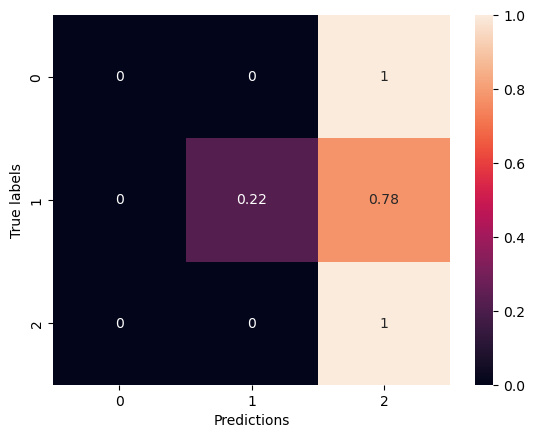

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▆▇▇▇▇▇▇▇██▇▇████▇███▇▇▇████████▇██▇
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▇▅▆█▅▅▇▆▆▆▅▅▄▄▆▇▇▇▃▇▃▄▅▅▆▇▇▆▇▅▅▅▇▆█
val_loss,█▅▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:38:11.690538: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:38:11.693035: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:38:11.695023: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:38:13.397186: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:38:13.399032: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:38:13.400994: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:38:17.828730: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:38:18.474984: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 65.3378 - accuracy: 0.3744 

2024-03-13 01:38:22.315480: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:38:22.317315: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:38:22.319311: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 65.3378 - accuracy: 0.3744 - val_loss: 52.9349 - val_accuracy: 0.1759
Epoch 2/100
2/2 [==============================] - 1s 557ms/step - loss: 49.9821 - accuracy: 0.4909 - val_loss: 40.4776 - val_accuracy: 0.1481
Epoch 3/100
2/2 [==============================] - 1s 540ms/step - loss: 37.6745 - accuracy: 0.5046 - val_loss: 30.6345 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 542ms/step - loss: 27.8643 - accuracy: 0.5959 - val_loss: 23.1322 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 557ms/step - loss: 20.3561 - accuracy: 0.6347 - val_loss: 17.7147 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 547ms/step - loss: 14.8124 - accuracy: 0.7009 - val_loss: 13.4893 - val_accuracy: 0.1296
Epoch 7/100
2/2 [==============================] - 1s 592ms/step - loss: 10.9028 - accuracy: 0.6963 - val_loss: 10.5475 - val_accuracy: 0.1389
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 545ms/step - loss: 1.5433 - accuracy: 0.8858 - val_loss: 4.0983 - val_accuracy: 0.2500
Epoch 60/100
2/2 [==============================] - 1s 550ms/step - loss: 1.6162 - accuracy: 0.9041 - val_loss: 3.9771 - val_accuracy: 0.2685
Epoch 61/100
2/2 [==============================] - 1s 533ms/step - loss: 1.6371 - accuracy: 0.9315 - val_loss: 3.1028 - val_accuracy: 0.5278
Epoch 62/100
2/2 [==============================] - 1s 551ms/step - loss: 1.7454 - accuracy: 0.9041 - val_loss: 3.1337 - val_accuracy: 0.5833
Epoch 63/100
2/2 [==============================] - 1s 548ms/step - loss: 1.6940 - accuracy: 0.9224 - val_loss: 3.5760 - val_accuracy: 0.4259
Epoch 64/100
2/2 [==============================] - 1s 554ms/step - loss: 1.6376 - accuracy: 0.9361 - val_loss: 3.2806 - val_accuracy: 0.4907
Epoch 65/100
2/2 [==============================] - 1s 547ms/step - loss: 1.6051 - accuracy: 0.9269 - val_loss: 3.5123 - val_accuracy: 0.4167
Epoch 

2024-03-13 01:40:14.693787: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:40:14.695899: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:40:14.697655: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6088881492614746 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, '2': {'precision': 0.5833333333333334, 'recall': 0.7777777777777778, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6944444444444445, 'recall': 0.5555555555555555, 'f1-score': 0.4917874396135266, 'support': 27}, 'weighted avg': {'precision': 0.6944444444444444, 'recall': 0.5555555555555556, 'f1-score': 0.49178743961352656, 'support': 27}}


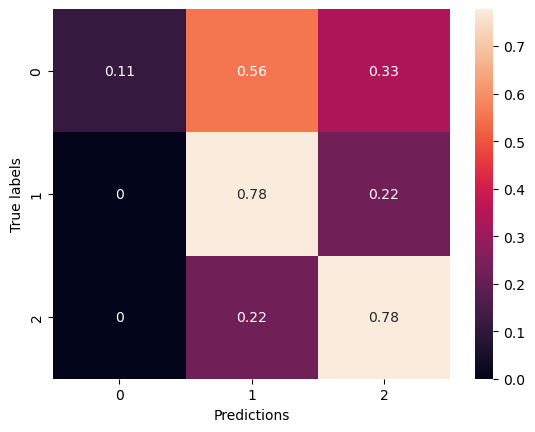

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▅▅▆▆▇▇▇█▇▇▇▇██▇█▇███▇▇█████▇█▇█▇▇█████
training_loss,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▄▂▆▇▇▆▄▅▆▅▅▅▆▇█▆▅▃▇▆▆█▇▆▄▆▅▆▅▆▆▅▂▆
val_loss,█▅▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:40:40.455713: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:40:40.458657: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:40:40.460623: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:40:42.191042: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:40:42.193489: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:40:42.196091: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:40:47.831380: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:40:48.445927: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 11.2035 - accuracy: 0.3470 

2024-03-13 01:40:52.747417: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:40:52.749493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:40:52.751099: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 14s 2s/step - loss: 11.2035 - accuracy: 0.3470 - val_loss: 10.3462 - val_accuracy: 0.1574
Epoch 2/100
2/2 [==============================] - 1s 574ms/step - loss: 10.5289 - accuracy: 0.3790 - val_loss: 10.1924 - val_accuracy: 0.1481
Epoch 3/100
2/2 [==============================] - 1s 585ms/step - loss: 9.8395 - accuracy: 0.4589 - val_loss: 10.1330 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 553ms/step - loss: 9.4634 - accuracy: 0.4224 - val_loss: 9.9638 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 553ms/step - loss: 9.0092 - accuracy: 0.4315 - val_loss: 9.7982 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 546ms/step - loss: 8.5525 - accuracy: 0.4566 - val_loss: 9.6562 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 548ms/step - loss: 8.1016 - accuracy: 0.4680 - val_loss: 9.3662 - val_accuracy: 0.1204
Epoch 8/100
2/2 [=====

Epoch 59/100
2/2 [==============================] - 1s 508ms/step - loss: 1.1767 - accuracy: 0.9429 - val_loss: 2.9705 - val_accuracy: 0.6111
Epoch 60/100
2/2 [==============================] - 1s 510ms/step - loss: 1.2895 - accuracy: 0.9018 - val_loss: 3.1095 - val_accuracy: 0.5741
Epoch 61/100
2/2 [==============================] - 1s 507ms/step - loss: 1.2388 - accuracy: 0.9247 - val_loss: 3.1222 - val_accuracy: 0.5278
Epoch 62/100
2/2 [==============================] - 1s 525ms/step - loss: 1.3322 - accuracy: 0.9041 - val_loss: 3.2770 - val_accuracy: 0.5741
Epoch 63/100
2/2 [==============================] - 1s 502ms/step - loss: 1.2377 - accuracy: 0.9087 - val_loss: 3.1256 - val_accuracy: 0.5926
Epoch 64/100
2/2 [==============================] - 1s 511ms/step - loss: 1.2481 - accuracy: 0.9361 - val_loss: 2.9719 - val_accuracy: 0.6296
Epoch 65/100
2/2 [==============================] - 1s 498ms/step - loss: 1.2097 - accuracy: 0.9475 - val_loss: 2.8835 - val_accuracy: 0.6389
Epoch 

2024-03-13 01:42:46.002920: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:42:46.004502: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:42:46.007044: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6206903457641602 s
{'0': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, '2': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6018518518518519, 'recall': 0.5555555555555556, 'f1-score': 0.5419298897559768, 'support': 27}, 'weighted avg': {'precision': 0.6018518518518519, 'recall': 0.5555555555555556, 'f1-score': 0.5419298897559768, 'support': 27}}


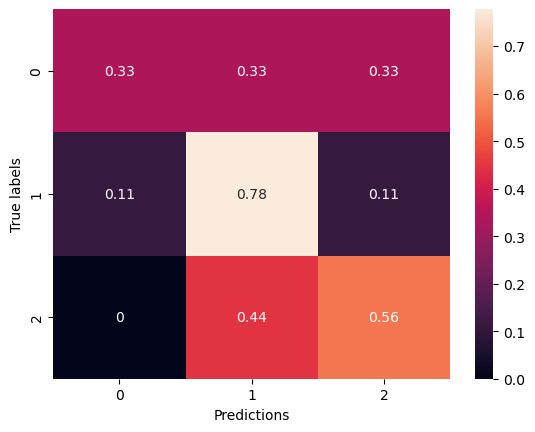

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▄▅▅▅▅▅▆▆▆▇▇▇▇█▇▇▇█▇████████▇▇▇████
training_loss,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▁▁▁▁▁▁▄▅▄▄▆▄▇▇▇▇▇▇▅██▇█▇▇▆▇▆▇▆▇▅▅▆▅▆▅
val_loss,██▇▇▆▆▆▆▅▂▂▂▃▂▂▁▁▂▁▂▁▂▁▁▁▁▁▁▂▂▁▁▂▁▂▂▂▂▂▂


Epoch 1/100


2024-03-13 01:43:13.481329: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:43:13.483424: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:43:13.485112: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:43:15.117040: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:43:15.119450: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:43:15.121203: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:43:19.460277: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:43:20.058890: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 47.7460 - accuracy: 0.3014 

2024-03-13 01:43:24.067120: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:43:24.069861: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:43:24.072414: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 13s 3s/step - loss: 47.7460 - accuracy: 0.3014 - val_loss: 39.9774 - val_accuracy: 0.2685
Epoch 2/100
2/2 [==============================] - 1s 532ms/step - loss: 38.5689 - accuracy: 0.4247 - val_loss: 32.3522 - val_accuracy: 0.2037
Epoch 3/100
2/2 [==============================] - 1s 575ms/step - loss: 31.1372 - accuracy: 0.4018 - val_loss: 26.2106 - val_accuracy: 0.1296
Epoch 4/100
2/2 [==============================] - 1s 531ms/step - loss: 25.0443 - accuracy: 0.4224 - val_loss: 21.3350 - val_accuracy: 0.1296
Epoch 5/100
2/2 [==============================] - 1s 653ms/step - loss: 20.0532 - accuracy: 0.4749 - val_loss: 17.5685 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 537ms/step - loss: 16.1675 - accuracy: 0.4795 - val_loss: 14.7378 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 513ms/step - loss: 13.1090 - accuracy: 0.5160 - val_loss: 12.5725 - val_accuracy: 0.1204
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 604ms/step - loss: 1.5595 - accuracy: 0.9132 - val_loss: 2.9794 - val_accuracy: 0.5833
Epoch 60/100
2/2 [==============================] - 1s 558ms/step - loss: 1.5748 - accuracy: 0.9087 - val_loss: 3.1020 - val_accuracy: 0.5833
Epoch 61/100
2/2 [==============================] - 1s 586ms/step - loss: 1.6469 - accuracy: 0.8790 - val_loss: 3.1086 - val_accuracy: 0.5833
Epoch 62/100
2/2 [==============================] - 1s 593ms/step - loss: 1.5429 - accuracy: 0.9269 - val_loss: 3.4929 - val_accuracy: 0.5648
Epoch 63/100
2/2 [==============================] - 1s 552ms/step - loss: 1.5960 - accuracy: 0.9087 - val_loss: 3.3480 - val_accuracy: 0.5648
Epoch 64/100
2/2 [==============================] - 1s 554ms/step - loss: 1.5610 - accuracy: 0.9224 - val_loss: 3.1675 - val_accuracy: 0.5833
Epoch 65/100
2/2 [==============================] - 1s 574ms/step - loss: 1.6329 - accuracy: 0.8973 - val_loss: 3.1469 - val_accuracy: 0.4815
Epoch 

2024-03-13 01:45:23.416300: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:45:23.419052: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:45:23.421662: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 3.4040801525115967 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4090909090909091, 'recall': 1.0, 'f1-score': 0.5806451612903226, 'support': 9}, '2': {'precision': 0.8, 'recall': 0.4444444444444444, 'f1-score': 0.5714285714285714, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.40303030303030307, 'recall': 0.48148148148148145, 'f1-score': 0.3840245775729647, 'support': 27}, 'weighted avg': {'precision': 0.40303030303030307, 'recall': 0.48148148148148145, 'f1-score': 0.38402457757296465, 'support': 27}}


/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ethanbenmussa/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


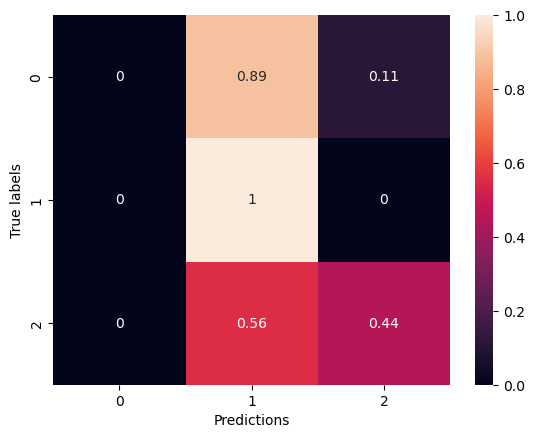

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▅▅▅▆▆▇▇▇▇▇▇▇██▇▇▇███▇██▇▇█▇▇▇█▇▇▇▇██
training_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▁▃▅▄▆▇█▇▆▆██▆▇▆▇▇▇▇▆▇▇▇▇█▆▅▇▅▇▇▇▇▄▅▇▅
val_loss,█▅▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:45:51.650696: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:45:51.652943: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:45:51.656061: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:45:53.385432: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:45:53.388044: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:45:53.389972: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:45:57.925592: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:45:58.550063: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


2/2 [==============================] - ETA: 0s - loss: 65.6159 - accuracy: 0.3539 

2024-03-13 01:46:02.391610: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:46:02.393253: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:46:02.395345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2/2 [==============================] - 12s 2s/step - loss: 65.6159 - accuracy: 0.3539 - val_loss: 53.8753 - val_accuracy: 0.1389
Epoch 2/100
2/2 [==============================] - 1s 540ms/step - loss: 51.3199 - accuracy: 0.4247 - val_loss: 42.2080 - val_accuracy: 0.1481
Epoch 3/100
2/2 [==============================] - 1s 546ms/step - loss: 39.7830 - accuracy: 0.4338 - val_loss: 32.7911 - val_accuracy: 0.1389
Epoch 4/100
2/2 [==============================] - 1s 613ms/step - loss: 30.6712 - accuracy: 0.4361 - val_loss: 25.5579 - val_accuracy: 0.1204
Epoch 5/100
2/2 [==============================] - 1s 552ms/step - loss: 23.3107 - accuracy: 0.5228 - val_loss: 20.2373 - val_accuracy: 0.1204
Epoch 6/100
2/2 [==============================] - 1s 551ms/step - loss: 17.9404 - accuracy: 0.5365 - val_loss: 15.8790 - val_accuracy: 0.1204
Epoch 7/100
2/2 [==============================] - 1s 547ms/step - loss: 13.7620 - accuracy: 0.5639 - val_loss: 12.7834 - val_accuracy: 0.1296
Epoch 8/100
2

Epoch 59/100
2/2 [==============================] - 1s 565ms/step - loss: 1.7713 - accuracy: 0.8105 - val_loss: 3.3558 - val_accuracy: 0.4167
Epoch 60/100
2/2 [==============================] - 1s 552ms/step - loss: 1.8165 - accuracy: 0.8356 - val_loss: 3.9648 - val_accuracy: 0.3148
Epoch 61/100
2/2 [==============================] - 1s 557ms/step - loss: 1.8632 - accuracy: 0.8584 - val_loss: 3.1588 - val_accuracy: 0.4444
Epoch 62/100
2/2 [==============================] - 1s 663ms/step - loss: 1.8510 - accuracy: 0.8858 - val_loss: 3.5546 - val_accuracy: 0.3889
Epoch 63/100
2/2 [==============================] - 1s 546ms/step - loss: 1.8553 - accuracy: 0.9018 - val_loss: 4.3855 - val_accuracy: 0.2870
Epoch 64/100
2/2 [==============================] - 1s 551ms/step - loss: 1.8688 - accuracy: 0.8904 - val_loss: 3.7721 - val_accuracy: 0.4259
Epoch 65/100
2/2 [==============================] - 1s 546ms/step - loss: 1.8241 - accuracy: 0.8813 - val_loss: 4.4037 - val_accuracy: 0.3241
Epoch 

2024-03-13 01:47:56.732119: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:47:56.735941: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:47:56.737741: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.7071020603179932 s
{'0': {'precision': 0.5, 'recall': 0.1111111111111111, 'f1-score': 0.1818181818181818, 'support': 9}, '1': {'precision': 0.35, 'recall': 0.7777777777777778, 'f1-score': 0.48275862068965514, 'support': 9}, '2': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.48333333333333334, 'recall': 0.4074074074074074, 'f1-score': 0.3643827436930885, 'support': 27}, 'weighted avg': {'precision': 0.48333333333333334, 'recall': 0.4074074074074074, 'f1-score': 0.36438274369308843, 'support': 27}}


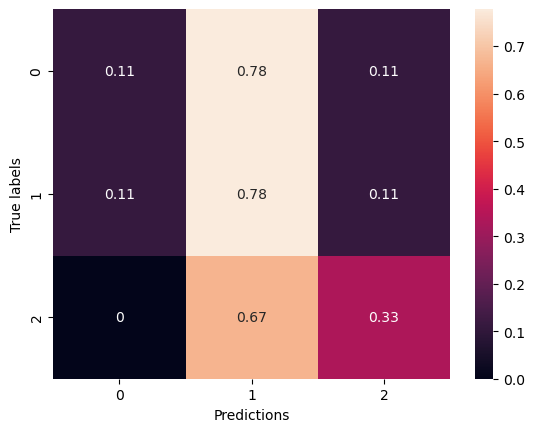

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇████▇▇█████▇▇▇█
training_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▂▂▃▅▇█▄▆██▆█▅▅▃█▆▆▄▅▆▅▆▅▅▁▇▅█▅▇▂▂▅▇▆
val_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:48:22.603824: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:48:22.608011: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:48:22.609692: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:48:24.396522: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:48:24.399344: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:48:24.403043: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:48:29.943179: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:48:30.578998: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 7.7056 - accuracy: 0.3196

2024-03-13 01:48:34.151771: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:48:34.153548: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:48:34.155558: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 193ms/step - loss: 7.7056 - accuracy: 0.3196 - val_loss: 7.0141 - val_accuracy: 0.2315
Epoch 2/100
14/14 [==============================] - 1s 53ms/step - loss: 7.3723 - accuracy: 0.4338 - val_loss: 6.9883 - val_accuracy: 0.2407
Epoch 3/100
14/14 [==============================] - 1s 56ms/step - loss: 7.3735 - accuracy: 0.3584 - val_loss: 6.9514 - val_accuracy: 0.2130
Epoch 4/100
14/14 [==============================] - 1s 53ms/step - loss: 7.1959 - accuracy: 0.4087 - val_loss: 6.9010 - val_accuracy: 0.2222
Epoch 5/100
14/14 [==============================] - 1s 53ms/step - loss: 7.0612 - accuracy: 0.4817 - val_loss: 6.8384 - val_accuracy: 0.3426
Epoch 6/100
14/14 [==============================] - 1s 57ms/step - loss: 6.9737 - accuracy: 0.4886 - val_loss: 6.7946 - val_accuracy: 0.3889
Epoch 7/100
14/14 [==============================] - 1s 53ms/step - loss: 7.0074 - accuracy: 0.4543 - val_loss: 6.7499 - val_accuracy: 0.4074
Epoch 8/100
14/1

14/14 [==============================] - 1s 53ms/step - loss: 4.8666 - accuracy: 0.8037 - val_loss: 5.8461 - val_accuracy: 0.5278
Epoch 59/100
14/14 [==============================] - 1s 55ms/step - loss: 4.8768 - accuracy: 0.8059 - val_loss: 5.8287 - val_accuracy: 0.5278
Epoch 60/100
14/14 [==============================] - 1s 54ms/step - loss: 4.8127 - accuracy: 0.8311 - val_loss: 5.8507 - val_accuracy: 0.5278
Epoch 61/100
14/14 [==============================] - 1s 56ms/step - loss: 4.6992 - accuracy: 0.8584 - val_loss: 5.8214 - val_accuracy: 0.5278
Epoch 62/100
14/14 [==============================] - 1s 54ms/step - loss: 4.6922 - accuracy: 0.8653 - val_loss: 5.7739 - val_accuracy: 0.5185
Epoch 63/100
14/14 [==============================] - 1s 52ms/step - loss: 4.6748 - accuracy: 0.8539 - val_loss: 5.7637 - val_accuracy: 0.5093
Epoch 64/100
14/14 [==============================] - 1s 54ms/step - loss: 4.6346 - accuracy: 0.8653 - val_loss: 5.7538 - val_accuracy: 0.5000
Epoch 65/100

2024-03-13 01:49:54.955454: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:49:54.957486: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:49:54.959332: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6489989757537842 s
{'0': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5444444444444444, 'recall': 0.5185185185185185, 'f1-score': 0.5055555555555555, 'support': 27}, 'weighted avg': {'precision': 0.5444444444444444, 'recall': 0.5185185185185185, 'f1-score': 0.5055555555555555, 'support': 27}}


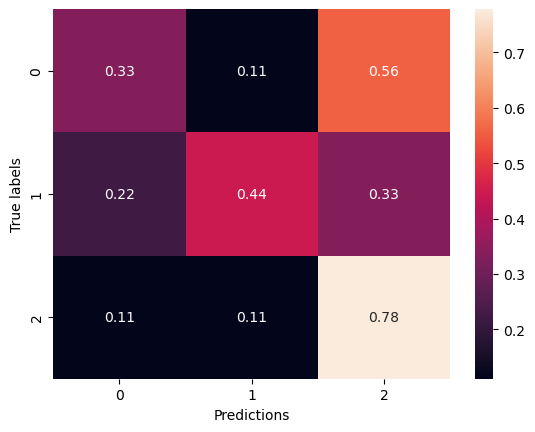

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▃▃▄▄▄▄▅▄▅▅▅▆▆▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇█▇████████
training_loss,█▇▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▅▅▆▇▇▆▆▆▇███▇▇▇▇▇▇█████▇▇▇▇█▇▇▇▇▇▇▇▇▇▇
val_loss,██▇▆▆▅▅▅▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:50:18.933537: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:50:18.935399: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:50:18.938695: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:50:20.695277: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:50:20.697275: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:50:20.699371: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:50:25.174724: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:50:25.797028: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 30.7699 - accuracy: 0.3356

2024-03-13 01:50:29.468030: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:50:29.470420: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:50:29.472533: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 181ms/step - loss: 30.7699 - accuracy: 0.3356 - val_loss: 29.8560 - val_accuracy: 0.3889
Epoch 2/100
14/14 [==============================] - 1s 57ms/step - loss: 30.2543 - accuracy: 0.2968 - val_loss: 29.4073 - val_accuracy: 0.3704
Epoch 3/100
14/14 [==============================] - 1s 54ms/step - loss: 29.6167 - accuracy: 0.3653 - val_loss: 28.9673 - val_accuracy: 0.3889
Epoch 4/100
14/14 [==============================] - 1s 53ms/step - loss: 29.1057 - accuracy: 0.3699 - val_loss: 28.5420 - val_accuracy: 0.3333
Epoch 5/100
14/14 [==============================] - 1s 53ms/step - loss: 28.5446 - accuracy: 0.4406 - val_loss: 28.1005 - val_accuracy: 0.3611
Epoch 6/100
14/14 [==============================] - 1s 54ms/step - loss: 28.0994 - accuracy: 0.4612 - val_loss: 27.6589 - val_accuracy: 0.3981
Epoch 7/100
14/14 [==============================] - 1s 57ms/step - loss: 27.5981 - accuracy: 0.4932 - val_loss: 27.2354 - val_accuracy: 0.3796
Ep

14/14 [==============================] - 1s 52ms/step - loss: 11.8876 - accuracy: 0.8288 - val_loss: 12.9472 - val_accuracy: 0.5556
Epoch 58/100
14/14 [==============================] - 1s 54ms/step - loss: 11.6684 - accuracy: 0.8470 - val_loss: 12.7883 - val_accuracy: 0.5185
Epoch 59/100
14/14 [==============================] - 1s 52ms/step - loss: 11.4984 - accuracy: 0.8425 - val_loss: 12.6043 - val_accuracy: 0.5278
Epoch 60/100
14/14 [==============================] - 1s 55ms/step - loss: 11.2997 - accuracy: 0.8037 - val_loss: 12.4156 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 1s 53ms/step - loss: 11.0692 - accuracy: 0.8653 - val_loss: 12.2257 - val_accuracy: 0.5370
Epoch 62/100
14/14 [==============================] - 1s 52ms/step - loss: 10.9609 - accuracy: 0.8653 - val_loss: 12.0498 - val_accuracy: 0.5463
Epoch 63/100
14/14 [==============================] - 1s 59ms/step - loss: 10.7893 - accuracy: 0.8493 - val_loss: 11.9433 - val_accuracy: 0.555

2024-03-13 01:51:45.664992: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:51:45.667078: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:51:45.669047: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.57216215133667 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.8888888888888888, 'f1-score': 0.6956521739130435, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5793650793650793, 'recall': 0.5555555555555555, 'f1-score': 0.5184337655733536, 'support': 27}, 'weighted avg': {'precision': 0.5793650793650793, 'recall': 0.5555555555555556, 'f1-score': 0.5184337655733536, 'support': 27}}


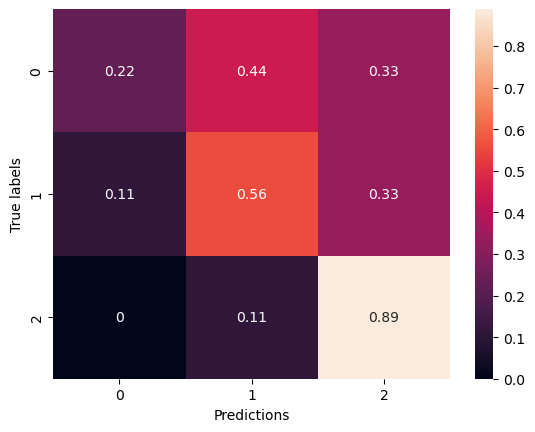

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▃▃▄▄▅▅▄▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇█▇████████
training_loss,██▇▇▇▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▁▃▃▄▄▄▄▅▅▅▆▆▆▆▆▆▆▆▆▆▆▆▆██▇▇▇▆▅▆▆▆▆▆▆▆
val_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:52:10.794386: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:52:10.796480: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:52:10.798197: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:52:12.732262: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:52:12.734178: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:52:12.736202: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:52:19.147426: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:52:19.946706: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 42.3232 - accuracy: 0.3630

2024-03-13 01:52:24.194034: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:52:24.195932: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:52:24.198133: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 15s 205ms/step - loss: 42.3232 - accuracy: 0.3630 - val_loss: 41.3555 - val_accuracy: 0.3611
Epoch 2/100
14/14 [==============================] - 1s 59ms/step - loss: 41.4950 - accuracy: 0.3813 - val_loss: 40.6355 - val_accuracy: 0.3333
Epoch 3/100
14/14 [==============================] - 1s 57ms/step - loss: 40.6558 - accuracy: 0.4224 - val_loss: 39.9186 - val_accuracy: 0.3056
Epoch 4/100
14/14 [==============================] - 1s 52ms/step - loss: 39.8414 - accuracy: 0.4155 - val_loss: 39.2093 - val_accuracy: 0.3241
Epoch 5/100
14/14 [==============================] - 1s 53ms/step - loss: 39.1626 - accuracy: 0.4452 - val_loss: 38.5047 - val_accuracy: 0.3519
Epoch 6/100
14/14 [==============================] - 1s 53ms/step - loss: 38.4175 - accuracy: 0.4680 - val_loss: 37.8063 - val_accuracy: 0.4259
Epoch 7/100
14/14 [==============================] - 1s 53ms/step - loss: 37.6482 - accuracy: 0.4795 - val_loss: 37.1266 - val_accuracy: 0.4259
Ep

14/14 [==============================] - 1s 52ms/step - loss: 14.3179 - accuracy: 0.8242 - val_loss: 15.2866 - val_accuracy: 0.5556
Epoch 58/100
14/14 [==============================] - 1s 53ms/step - loss: 13.9824 - accuracy: 0.8562 - val_loss: 15.0335 - val_accuracy: 0.5370
Epoch 59/100
14/14 [==============================] - 1s 57ms/step - loss: 13.7352 - accuracy: 0.8516 - val_loss: 14.8035 - val_accuracy: 0.5648
Epoch 60/100
14/14 [==============================] - 1s 53ms/step - loss: 13.5325 - accuracy: 0.8379 - val_loss: 14.5730 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 1s 53ms/step - loss: 13.2689 - accuracy: 0.8630 - val_loss: 14.3495 - val_accuracy: 0.5463
Epoch 62/100
14/14 [==============================] - 1s 53ms/step - loss: 12.9942 - accuracy: 0.8699 - val_loss: 14.0925 - val_accuracy: 0.5741
Epoch 63/100
14/14 [==============================] - 1s 52ms/step - loss: 12.7184 - accuracy: 0.8790 - val_loss: 13.8562 - val_accuracy: 0.574

2024-03-13 01:53:41.382846: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:53:41.385490: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:53:41.387336: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.659674882888794 s
{'0': {'precision': 0.3333333333333333, 'recall': 0.1111111111111111, 'f1-score': 0.16666666666666666, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.6666666666666666, 'support': 9}, '2': {'precision': 0.5333333333333333, 'recall': 0.8888888888888888, 'f1-score': 0.6666666666666667, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5111111111111111, 'recall': 0.5555555555555555, 'f1-score': 0.5, 'support': 27}, 'weighted avg': {'precision': 0.5111111111111112, 'recall': 0.5555555555555556, 'f1-score': 0.5, 'support': 27}}


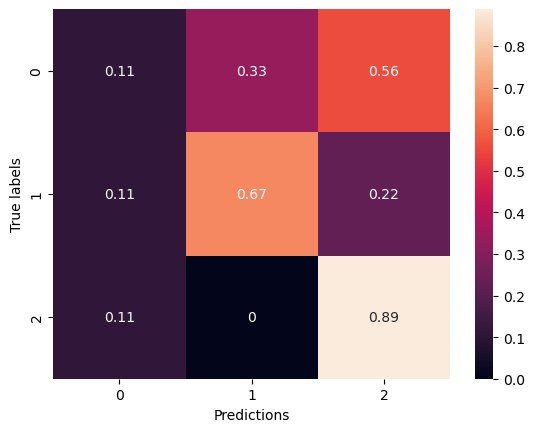

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▃▄▄▄▅▅▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇███████
training_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▄▄▅▅▆▆▇█▇▆▆▇▆▇▇▇▇▇▇▇▇█▇█▇▇▇▇█▇▇██▇▇▇▇▇
val_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:54:07.943132: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:54:07.946693: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:54:07.948974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:54:09.670435: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:54:09.672486: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:54:09.674478: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:54:14.272191: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:54:14.947093: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 7.7207 - accuracy: 0.3242

2024-03-13 01:54:18.521152: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:54:18.524773: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:54:18.526657: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 177ms/step - loss: 7.7207 - accuracy: 0.3242 - val_loss: 6.9512 - val_accuracy: 0.3148
Epoch 2/100
14/14 [==============================] - 1s 52ms/step - loss: 7.5245 - accuracy: 0.3493 - val_loss: 6.9285 - val_accuracy: 0.3056
Epoch 3/100
14/14 [==============================] - 1s 56ms/step - loss: 7.5404 - accuracy: 0.3265 - val_loss: 6.9060 - val_accuracy: 0.2778
Epoch 4/100
14/14 [==============================] - 1s 58ms/step - loss: 7.2698 - accuracy: 0.3813 - val_loss: 6.8835 - val_accuracy: 0.3148
Epoch 5/100
14/14 [==============================] - 1s 54ms/step - loss: 7.3694 - accuracy: 0.3699 - val_loss: 6.8656 - val_accuracy: 0.2870
Epoch 6/100
14/14 [==============================] - 1s 53ms/step - loss: 7.1015 - accuracy: 0.4292 - val_loss: 6.8486 - val_accuracy: 0.2685
Epoch 7/100
14/14 [==============================] - 1s 54ms/step - loss: 7.1680 - accuracy: 0.3927 - val_loss: 6.8190 - val_accuracy: 0.2870
Epoch 8/100
14/1

14/14 [==============================] - 1s 52ms/step - loss: 5.2689 - accuracy: 0.6941 - val_loss: 5.7815 - val_accuracy: 0.5093
Epoch 59/100
14/14 [==============================] - 1s 53ms/step - loss: 5.3064 - accuracy: 0.6849 - val_loss: 5.7915 - val_accuracy: 0.5000
Epoch 60/100
14/14 [==============================] - 1s 52ms/step - loss: 5.3005 - accuracy: 0.6735 - val_loss: 5.7847 - val_accuracy: 0.5000
Epoch 61/100
14/14 [==============================] - 1s 56ms/step - loss: 5.2962 - accuracy: 0.6667 - val_loss: 5.7719 - val_accuracy: 0.5093
Epoch 62/100
14/14 [==============================] - 1s 52ms/step - loss: 5.2430 - accuracy: 0.6712 - val_loss: 5.7444 - val_accuracy: 0.5093
Epoch 63/100
14/14 [==============================] - 1s 52ms/step - loss: 5.2003 - accuracy: 0.6849 - val_loss: 5.7237 - val_accuracy: 0.5185
Epoch 64/100
14/14 [==============================] - 1s 52ms/step - loss: 5.2396 - accuracy: 0.6393 - val_loss: 5.7308 - val_accuracy: 0.4907
Epoch 65/100

2024-03-13 01:55:34.524265: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:55:34.525955: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:55:34.527823: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5705373287200928 s
{'0': {'precision': 0.8333333333333334, 'recall': 0.5555555555555556, 'f1-score': 0.6666666666666667, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.6296296296296297, 'recall': 0.5925925925925926, 'f1-score': 0.597883597883598, 'support': 27}, 'weighted avg': {'precision': 0.6296296296296297, 'recall': 0.5925925925925926, 'f1-score': 0.5978835978835979, 'support': 27}}


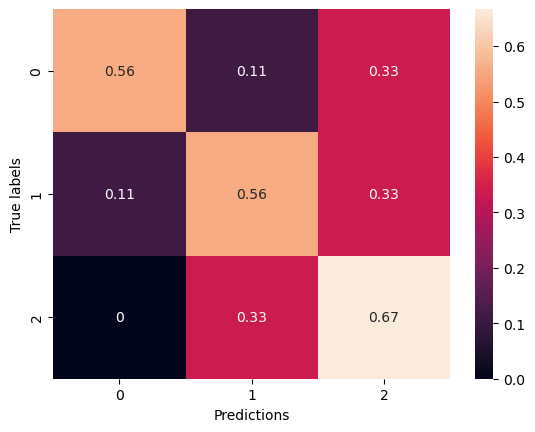

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▃▂▃▃▃▃▃▃▃▅▄▅▅▅▄▅▅▅▅▆▆▆▆▆▇▇▆▆▇▆▇▇▇▇▇▇██
training_loss,██▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▂▃▄▄▅▅▅▅▅▇▇█▇█████▇█▆▇▆▆▆▆▆▆▆▆▆▆▇▇▆▇▇
val_loss,███▇▇▇▆▆▆▆▆▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁


Epoch 1/100


2024-03-13 01:56:00.878778: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:56:00.880750: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:56:00.882618: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:56:02.798321: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:56:02.801111: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:56:02.802884: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:56:07.261035: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:56:07.908805: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 31.0253 - accuracy: 0.3584

2024-03-13 01:56:11.461679: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:56:11.463823: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:56:11.466420: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 181ms/step - loss: 31.0253 - accuracy: 0.3584 - val_loss: 30.1160 - val_accuracy: 0.2315
Epoch 2/100
14/14 [==============================] - 1s 55ms/step - loss: 30.4148 - accuracy: 0.3607 - val_loss: 29.7155 - val_accuracy: 0.2407
Epoch 3/100
14/14 [==============================] - 1s 52ms/step - loss: 29.8963 - accuracy: 0.3950 - val_loss: 29.3194 - val_accuracy: 0.2222
Epoch 4/100
14/14 [==============================] - 1s 53ms/step - loss: 29.6868 - accuracy: 0.3265 - val_loss: 28.9292 - val_accuracy: 0.2407
Epoch 5/100
14/14 [==============================] - 1s 53ms/step - loss: 29.1768 - accuracy: 0.3767 - val_loss: 28.5465 - val_accuracy: 0.2593
Epoch 6/100
14/14 [==============================] - 1s 52ms/step - loss: 28.7219 - accuracy: 0.4132 - val_loss: 28.1561 - val_accuracy: 0.3056
Epoch 7/100
14/14 [==============================] - 1s 52ms/step - loss: 28.3035 - accuracy: 0.4018 - val_loss: 27.7679 - val_accuracy: 0.3148
Ep

14/14 [==============================] - 1s 52ms/step - loss: 13.9452 - accuracy: 0.6347 - val_loss: 14.3242 - val_accuracy: 0.5463
Epoch 58/100
14/14 [==============================] - 1s 53ms/step - loss: 13.8082 - accuracy: 0.6279 - val_loss: 14.2152 - val_accuracy: 0.5278
Epoch 59/100
14/14 [==============================] - 1s 52ms/step - loss: 13.5532 - accuracy: 0.6598 - val_loss: 14.0468 - val_accuracy: 0.5093
Epoch 60/100
14/14 [==============================] - 1s 55ms/step - loss: 13.3524 - accuracy: 0.6804 - val_loss: 13.8507 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 1s 53ms/step - loss: 13.2633 - accuracy: 0.6164 - val_loss: 13.6947 - val_accuracy: 0.5370
Epoch 62/100
14/14 [==============================] - 1s 53ms/step - loss: 12.9991 - accuracy: 0.6895 - val_loss: 13.5286 - val_accuracy: 0.5370
Epoch 63/100
14/14 [==============================] - 1s 52ms/step - loss: 12.8936 - accuracy: 0.6575 - val_loss: 13.3619 - val_accuracy: 0.546

2024-03-13 01:57:27.469709: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:57:27.471550: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:57:27.473528: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6651320457458496 s
{'0': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '1': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.42857142857142855, 'recall': 0.6666666666666666, 'f1-score': 0.5217391304347826, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.5, 'recall': 0.4814814814814814, 'f1-score': 0.47391304347826085, 'support': 27}, 'weighted avg': {'precision': 0.5, 'recall': 0.48148148148148145, 'f1-score': 0.47391304347826085, 'support': 27}}


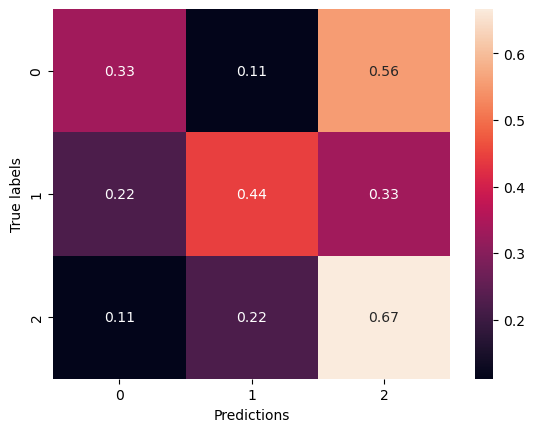

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▂▂▃▃▂▃▄▄▄▄▄▄▅▄▅▅▅▆▅▆▅▆▇▇▆▇▇▆▇▇█▇▇█▇█
training_loss,██▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▃▃▂▃▃▃▄▄▅▅▇▇▇▇▇▇▇▇▇▇█▇▇█▇▇▇▇█▇▇█▇▇▇▇█▇
val_loss,██▇▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:57:51.923395: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:57:51.925584: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:57:51.927893: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:57:53.684903: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:57:53.687111: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:57:53.689116: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:57:58.182645: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:57:58.803607: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 42.4189 - accuracy: 0.3750

2024-03-13 01:58:03.466783: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:58:03.468744: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:58:03.470567: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 181ms/step - loss: 42.3792 - accuracy: 0.3813 - val_loss: 41.3255 - val_accuracy: 0.3148
Epoch 2/100
14/14 [==============================] - 1s 53ms/step - loss: 41.7444 - accuracy: 0.3493 - val_loss: 40.6850 - val_accuracy: 0.3426
Epoch 3/100
14/14 [==============================] - 1s 53ms/step - loss: 40.9698 - accuracy: 0.3630 - val_loss: 40.0644 - val_accuracy: 0.3056
Epoch 4/100
14/14 [==============================] - 1s 53ms/step - loss: 40.3961 - accuracy: 0.3790 - val_loss: 39.4534 - val_accuracy: 0.2963
Epoch 5/100
14/14 [==============================] - 1s 54ms/step - loss: 39.6776 - accuracy: 0.4201 - val_loss: 38.8420 - val_accuracy: 0.2963
Epoch 6/100
14/14 [==============================] - 1s 53ms/step - loss: 38.9069 - accuracy: 0.4292 - val_loss: 38.2350 - val_accuracy: 0.3241
Epoch 7/100
14/14 [==============================] - 1s 52ms/step - loss: 38.2867 - accuracy: 0.4132 - val_loss: 37.6405 - val_accuracy: 0.2963
Ep

14/14 [==============================] - 1s 52ms/step - loss: 16.9052 - accuracy: 0.6438 - val_loss: 17.1726 - val_accuracy: 0.4815
Epoch 58/100
14/14 [==============================] - 1s 53ms/step - loss: 16.6235 - accuracy: 0.6256 - val_loss: 16.9004 - val_accuracy: 0.4815
Epoch 59/100
14/14 [==============================] - 1s 53ms/step - loss: 16.3366 - accuracy: 0.6689 - val_loss: 16.6768 - val_accuracy: 0.5000
Epoch 60/100
14/14 [==============================] - 1s 53ms/step - loss: 16.0646 - accuracy: 0.6826 - val_loss: 16.4062 - val_accuracy: 0.5093
Epoch 61/100
14/14 [==============================] - 1s 52ms/step - loss: 15.7607 - accuracy: 0.6872 - val_loss: 16.1499 - val_accuracy: 0.5000
Epoch 62/100
14/14 [==============================] - 1s 59ms/step - loss: 15.5219 - accuracy: 0.7032 - val_loss: 15.9144 - val_accuracy: 0.4907
Epoch 63/100
14/14 [==============================] - 1s 63ms/step - loss: 15.3223 - accuracy: 0.6530 - val_loss: 15.6708 - val_accuracy: 0.490

2024-03-13 01:59:20.046900: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:59:20.049183: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:59:20.050870: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5985379219055176 s
{'0': {'precision': 0.7142857142857143, 'recall': 0.5555555555555556, 'f1-score': 0.6250000000000001, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.6666666666666666, 'f1-score': 0.631578947368421, 'support': 9}, '2': {'precision': 0.6, 'recall': 0.6666666666666666, 'f1-score': 0.631578947368421, 'support': 9}, 'accuracy': 0.6296296296296297, 'macro avg': {'precision': 0.638095238095238, 'recall': 0.6296296296296297, 'f1-score': 0.6293859649122807, 'support': 27}, 'weighted avg': {'precision': 0.638095238095238, 'recall': 0.6296296296296297, 'f1-score': 0.6293859649122808, 'support': 27}}


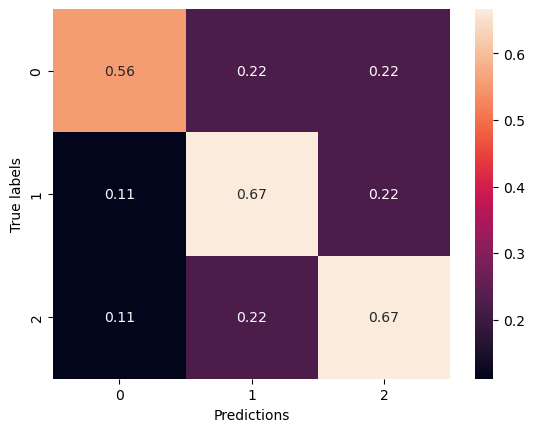

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▂▃▃▃▃▄▄▄▅▅▄▅▆▅▅▆▅▆▆▆▆▆▇▇▇▇▇▇█▇█████
training_loss,██▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▁▁▃▄▄▅▅▅▅▆▆▆▆▆▇▆▆▇▆▆▆▆▇▇▇▇▇█▇▇▆▇█▇▇▆█
val_loss,██▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 01:59:43.006629: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:59:43.008224: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:59:43.010480: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:59:44.777635: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:59:44.780641: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:59:44.783090: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 01:59:49.308992: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 01:59:49.973149: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 7.6827 - accuracy: 0.3293

2024-03-13 01:59:53.451794: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 01:59:53.453432: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 01:59:53.455374: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 182ms/step - loss: 7.6566 - accuracy: 0.3333 - val_loss: 7.0132 - val_accuracy: 0.1759
Epoch 2/100
14/14 [==============================] - 1s 56ms/step - loss: 7.5959 - accuracy: 0.3470 - val_loss: 6.9884 - val_accuracy: 0.2130
Epoch 3/100
14/14 [==============================] - 1s 52ms/step - loss: 7.6086 - accuracy: 0.3196 - val_loss: 6.9697 - val_accuracy: 0.2315
Epoch 4/100
14/14 [==============================] - 1s 53ms/step - loss: 7.3770 - accuracy: 0.3676 - val_loss: 6.9473 - val_accuracy: 0.2407
Epoch 5/100
14/14 [==============================] - 1s 53ms/step - loss: 7.3701 - accuracy: 0.3562 - val_loss: 6.9257 - val_accuracy: 0.2500
Epoch 6/100
14/14 [==============================] - 1s 53ms/step - loss: 7.3866 - accuracy: 0.3470 - val_loss: 6.9068 - val_accuracy: 0.2685
Epoch 7/100
14/14 [==============================] - 1s 56ms/step - loss: 7.3141 - accuracy: 0.3721 - val_loss: 6.8797 - val_accuracy: 0.2685
Epoch 8/100
14/1

14/14 [==============================] - 1s 52ms/step - loss: 6.1274 - accuracy: 0.3881 - val_loss: 5.8689 - val_accuracy: 0.4167
Epoch 59/100
14/14 [==============================] - 1s 52ms/step - loss: 5.9442 - accuracy: 0.4589 - val_loss: 5.8723 - val_accuracy: 0.4167
Epoch 60/100
14/14 [==============================] - 1s 52ms/step - loss: 5.9802 - accuracy: 0.4635 - val_loss: 5.8680 - val_accuracy: 0.3981
Epoch 61/100
14/14 [==============================] - 1s 52ms/step - loss: 5.9639 - accuracy: 0.4201 - val_loss: 5.8526 - val_accuracy: 0.3981
Epoch 62/100
14/14 [==============================] - 1s 52ms/step - loss: 5.9941 - accuracy: 0.4338 - val_loss: 5.8170 - val_accuracy: 0.4352
Epoch 63/100
14/14 [==============================] - 1s 54ms/step - loss: 5.9032 - accuracy: 0.4247 - val_loss: 5.7842 - val_accuracy: 0.4630
Epoch 64/100
14/14 [==============================] - 1s 52ms/step - loss: 5.8388 - accuracy: 0.4247 - val_loss: 5.7535 - val_accuracy: 0.4722
Epoch 65/100

2024-03-13 02:01:09.268585: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:01:09.270227: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:01:09.271995: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5732700824737549 s
{'0': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '1': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5333333333333333, 'recall': 0.5185185185185185, 'f1-score': 0.5087719298245613, 'support': 27}, 'weighted avg': {'precision': 0.5333333333333333, 'recall': 0.5185185185185185, 'f1-score': 0.5087719298245614, 'support': 27}}


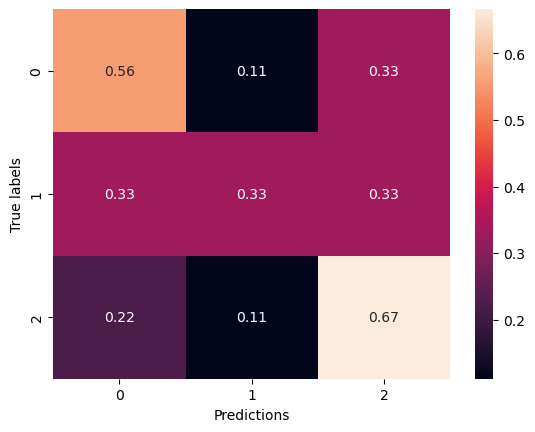

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▃▃▄▃▃▄▄▃▅▃▃▅▄▅▄▄▅▆▆▄▄▆▄▆▅▆▅▇▅▇▇▆█▆▇
training_loss,██▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▄▃▃▃▃▃▃▃▂▂▂▂▂▁▂▁▁▁
training_time,▁
val_accuracy,▁▂▃▃▄▅▆▆▆▆▇▇█▇▇▇▇▇▇▆▆▇▇▆▆█▇▇▇▇███▇███▇██
val_loss,███▇▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁


Epoch 1/100


2024-03-13 02:01:33.544523: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:01:33.546603: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:01:33.548556: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:01:35.280829: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:01:35.282609: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:01:35.284922: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:01:40.892928: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:01:41.522124: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 30.9993 - accuracy: 0.3029

2024-03-13 02:01:45.147397: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:01:45.149025: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:01:45.151031: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 182ms/step - loss: 30.9848 - accuracy: 0.3037 - val_loss: 30.0192 - val_accuracy: 0.1667
Epoch 2/100
14/14 [==============================] - 1s 54ms/step - loss: 30.4088 - accuracy: 0.3333 - val_loss: 29.6635 - val_accuracy: 0.1667
Epoch 3/100
14/14 [==============================] - 1s 54ms/step - loss: 30.0508 - accuracy: 0.3242 - val_loss: 29.3115 - val_accuracy: 0.1574
Epoch 4/100
14/14 [==============================] - 1s 53ms/step - loss: 29.6168 - accuracy: 0.3539 - val_loss: 28.9688 - val_accuracy: 0.1574
Epoch 5/100
14/14 [==============================] - 1s 59ms/step - loss: 29.2052 - accuracy: 0.3836 - val_loss: 28.6277 - val_accuracy: 0.1852
Epoch 6/100
14/14 [==============================] - 1s 72ms/step - loss: 28.9052 - accuracy: 0.3288 - val_loss: 28.2887 - val_accuracy: 0.2130
Epoch 7/100
14/14 [==============================] - 1s 61ms/step - loss: 28.6633 - accuracy: 0.2945 - val_loss: 27.9489 - val_accuracy: 0.2315
Ep

14/14 [==============================] - 1s 53ms/step - loss: 15.6883 - accuracy: 0.4224 - val_loss: 15.5487 - val_accuracy: 0.4259
Epoch 58/100
14/14 [==============================] - 1s 54ms/step - loss: 15.5624 - accuracy: 0.4132 - val_loss: 15.3582 - val_accuracy: 0.4630
Epoch 59/100
14/14 [==============================] - 1s 53ms/step - loss: 15.3413 - accuracy: 0.4521 - val_loss: 15.1809 - val_accuracy: 0.4630
Epoch 60/100
14/14 [==============================] - 1s 53ms/step - loss: 15.1487 - accuracy: 0.4521 - val_loss: 15.0162 - val_accuracy: 0.4630
Epoch 61/100
14/14 [==============================] - 1s 54ms/step - loss: 14.9872 - accuracy: 0.4452 - val_loss: 14.8598 - val_accuracy: 0.4537
Epoch 62/100
14/14 [==============================] - 1s 52ms/step - loss: 14.8091 - accuracy: 0.4589 - val_loss: 14.6984 - val_accuracy: 0.4537
Epoch 63/100
14/14 [==============================] - 1s 54ms/step - loss: 14.6515 - accuracy: 0.4201 - val_loss: 14.5416 - val_accuracy: 0.463

2024-03-13 02:03:01.207598: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:03:01.209910: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:03:01.211766: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5712549686431885 s
{'0': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '1': {'precision': 0.3333333333333333, 'recall': 0.2222222222222222, 'f1-score': 0.26666666666666666, 'support': 9}, '2': {'precision': 0.35714285714285715, 'recall': 0.5555555555555556, 'f1-score': 0.43478260869565216, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.373015873015873, 'recall': 0.3703703703703704, 'f1-score': 0.3588164251207729, 'support': 27}, 'weighted avg': {'precision': 0.373015873015873, 'recall': 0.37037037037037035, 'f1-score': 0.35881642512077294, 'support': 27}}


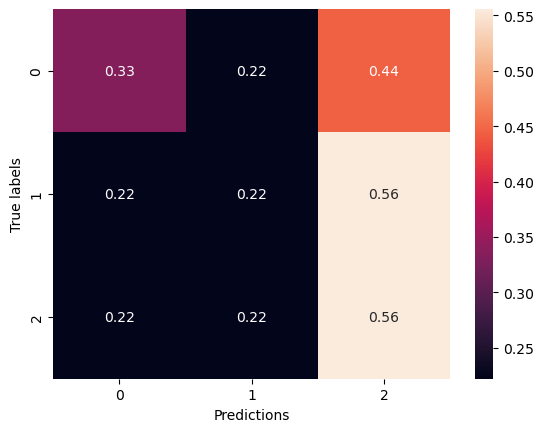

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▃▂▃▄▂▃▄▃▃▃▃▅▅▄▅▃▃▆▃▅▆▅▆▅▅▆▄▆▆▆▆▆██▆██
training_loss,██▇▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▂▃▃▄▄▅▄▅▄▅▆▆▆▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▇▇▇██████
val_loss,██▇▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:03:26.074932: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:03:26.076548: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:03:26.078401: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:03:27.798233: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:03:27.800149: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:03:27.802221: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:03:32.247361: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:03:32.868928: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


13/14 [==========================>...] - ETA: 0s - loss: 42.3508 - accuracy: 0.3029

2024-03-13 02:03:36.377456: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:03:36.380140: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:03:36.382479: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 184ms/step - loss: 42.3291 - accuracy: 0.3082 - val_loss: 41.1264 - val_accuracy: 0.4630
Epoch 2/100
14/14 [==============================] - 1s 52ms/step - loss: 41.5644 - accuracy: 0.3356 - val_loss: 40.5194 - val_accuracy: 0.4630
Epoch 3/100
14/14 [==============================] - 1s 52ms/step - loss: 40.8168 - accuracy: 0.3699 - val_loss: 39.9247 - val_accuracy: 0.4167
Epoch 4/100
14/14 [==============================] - 1s 53ms/step - loss: 40.3175 - accuracy: 0.3311 - val_loss: 39.3402 - val_accuracy: 0.3981
Epoch 5/100
14/14 [==============================] - 1s 54ms/step - loss: 39.7462 - accuracy: 0.3333 - val_loss: 38.7688 - val_accuracy: 0.3611
Epoch 6/100
14/14 [==============================] - 1s 52ms/step - loss: 38.9866 - accuracy: 0.3653 - val_loss: 38.2074 - val_accuracy: 0.3611
Epoch 7/100
14/14 [==============================] - 1s 52ms/step - loss: 38.4374 - accuracy: 0.3630 - val_loss: 37.6484 - val_accuracy: 0.3611
Ep

14/14 [==============================] - 1s 51ms/step - loss: 18.1896 - accuracy: 0.4909 - val_loss: 18.1004 - val_accuracy: 0.3889
Epoch 58/100
14/14 [==============================] - 1s 52ms/step - loss: 17.8482 - accuracy: 0.4932 - val_loss: 17.8393 - val_accuracy: 0.4259
Epoch 59/100
14/14 [==============================] - 1s 52ms/step - loss: 17.6986 - accuracy: 0.4361 - val_loss: 17.5940 - val_accuracy: 0.4074
Epoch 60/100
14/14 [==============================] - 1s 52ms/step - loss: 17.4348 - accuracy: 0.4498 - val_loss: 17.3361 - val_accuracy: 0.4444
Epoch 61/100
14/14 [==============================] - 1s 55ms/step - loss: 17.0688 - accuracy: 0.5114 - val_loss: 17.0906 - val_accuracy: 0.4444
Epoch 62/100
14/14 [==============================] - 1s 52ms/step - loss: 16.8897 - accuracy: 0.4886 - val_loss: 16.8770 - val_accuracy: 0.4074
Epoch 63/100
14/14 [==============================] - 1s 51ms/step - loss: 16.7056 - accuracy: 0.4726 - val_loss: 16.6588 - val_accuracy: 0.398

2024-03-13 02:04:51.697411: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:04:51.700439: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:04:51.703523: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.894686222076416 s
{'0': {'precision': 0.25, 'recall': 0.1111111111111111, 'f1-score': 0.15384615384615383, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '2': {'precision': 0.4444444444444444, 'recall': 0.8888888888888888, 'f1-score': 0.5925925925925926, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.36481481481481487, 'recall': 0.4074074074074074, 'f1-score': 0.34405101071767735, 'support': 27}, 'weighted avg': {'precision': 0.3648148148148148, 'recall': 0.4074074074074074, 'f1-score': 0.34405101071767735, 'support': 27}}


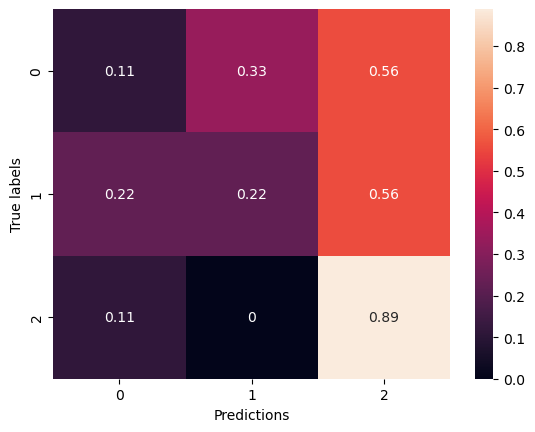

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▃▂▃▄▃▂▄▃▄▂▄▄▃▅▄▃▅▅▄▄▃▅▄▆▆▄▅▅▅▆▇▇▇▆██▇▆█
training_loss,██▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
training_time,▁
val_accuracy,▇▅▃▃▄▃▁▂▁▃▄▄▆▅▃▄▃▄▆▅▅▄▄▅▆▅▆▆▄█▆▅▆▆▅▃▇▇█▇
val_loss,██▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:05:17.445622: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:05:17.447771: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:05:17.449816: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:05:20.507840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:05:20.510102: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:05:20.511799: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:05:24.945478: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:05:25.565324: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 8.2952 - accuracy: 0.3607

2024-03-13 02:05:29.409343: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:05:29.411576: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:05:29.413193: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 14s 207ms/step - loss: 8.2952 - accuracy: 0.3607 - val_loss: 7.6811 - val_accuracy: 0.3148
Epoch 2/100
14/14 [==============================] - 1s 79ms/step - loss: 8.1976 - accuracy: 0.3493 - val_loss: 7.6576 - val_accuracy: 0.2870
Epoch 3/100
14/14 [==============================] - 1s 87ms/step - loss: 7.9439 - accuracy: 0.4224 - val_loss: 7.6241 - val_accuracy: 0.2778
Epoch 4/100
14/14 [==============================] - 1s 78ms/step - loss: 7.8243 - accuracy: 0.4498 - val_loss: 7.5909 - val_accuracy: 0.2870
Epoch 5/100
14/14 [==============================] - 1s 78ms/step - loss: 7.6179 - accuracy: 0.4977 - val_loss: 7.5676 - val_accuracy: 0.2778
Epoch 6/100
14/14 [==============================] - 1s 80ms/step - loss: 7.5693 - accuracy: 0.5000 - val_loss: 7.5371 - val_accuracy: 0.2870
Epoch 7/100
14/14 [==============================] - 1s 78ms/step - loss: 7.4388 - accuracy: 0.5365 - val_loss: 7.4784 - val_accuracy: 0.2963
Epoch 8/100
14/1

14/14 [==============================] - 1s 83ms/step - loss: 4.9528 - accuracy: 0.8973 - val_loss: 6.4902 - val_accuracy: 0.5185
Epoch 59/100
14/14 [==============================] - 1s 79ms/step - loss: 4.9304 - accuracy: 0.8950 - val_loss: 6.4631 - val_accuracy: 0.5093
Epoch 60/100
14/14 [==============================] - 1s 80ms/step - loss: 4.8587 - accuracy: 0.9110 - val_loss: 6.4558 - val_accuracy: 0.5185
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 4.8350 - accuracy: 0.9132 - val_loss: 6.4531 - val_accuracy: 0.5278
Epoch 62/100
14/14 [==============================] - 1s 85ms/step - loss: 4.7886 - accuracy: 0.9247 - val_loss: 6.4465 - val_accuracy: 0.5278
Epoch 63/100
14/14 [==============================] - 1s 78ms/step - loss: 4.7697 - accuracy: 0.9132 - val_loss: 6.4388 - val_accuracy: 0.5185
Epoch 64/100
14/14 [==============================] - 1s 79ms/step - loss: 4.6697 - accuracy: 0.9406 - val_loss: 6.4319 - val_accuracy: 0.5278
Epoch 65/100

2024-03-13 02:07:22.664920: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:07:22.666618: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:07:22.668646: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6296868324279785 s
{'0': {'precision': 0.8, 'recall': 0.4444444444444444, 'f1-score': 0.5714285714285714, 'support': 9}, '1': {'precision': 0.625, 'recall': 0.5555555555555556, 'f1-score': 0.5882352941176471, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.8888888888888888, 'f1-score': 0.6956521739130435, 'support': 9}, 'accuracy': 0.6296296296296297, 'macro avg': {'precision': 0.6654761904761904, 'recall': 0.6296296296296297, 'f1-score': 0.618438679819754, 'support': 27}, 'weighted avg': {'precision': 0.6654761904761904, 'recall': 0.6296296296296297, 'f1-score': 0.6184386798197539, 'support': 27}}


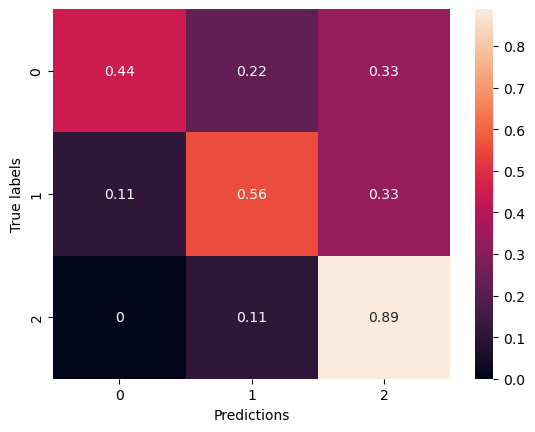

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇██▇▇███████████
training_loss,█▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▁▂▄▅▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇█▇████▇▇▇▇▇▇▇▇▇▇▇█
val_loss,██▇▇▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▂▂▃▃▃▂▃▂▂▂▂▂▁▁


Epoch 1/100


2024-03-13 02:07:52.594086: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:07:52.595722: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:07:52.598829: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:07:54.548962: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:07:54.552264: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:07:54.554792: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:07:59.072652: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:07:59.719065: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 34.0272 - accuracy: 0.3607

2024-03-13 02:08:03.604455: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:08:03.606033: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:08:03.607936: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 209ms/step - loss: 34.0272 - accuracy: 0.3607 - val_loss: 33.1851 - val_accuracy: 0.2130
Epoch 2/100
14/14 [==============================] - 1s 82ms/step - loss: 33.2916 - accuracy: 0.3402 - val_loss: 32.6494 - val_accuracy: 0.1944
Epoch 3/100
14/14 [==============================] - 1s 79ms/step - loss: 32.6944 - accuracy: 0.4132 - val_loss: 32.1044 - val_accuracy: 0.1944
Epoch 4/100
14/14 [==============================] - 1s 80ms/step - loss: 31.8828 - accuracy: 0.4726 - val_loss: 31.5485 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 1s 82ms/step - loss: 31.3940 - accuracy: 0.4863 - val_loss: 30.9982 - val_accuracy: 0.2037
Epoch 6/100
14/14 [==============================] - 1s 80ms/step - loss: 30.7222 - accuracy: 0.5274 - val_loss: 30.4465 - val_accuracy: 0.2315
Epoch 7/100
14/14 [==============================] - 1s 79ms/step - loss: 30.0793 - accuracy: 0.5502 - val_loss: 29.8954 - val_accuracy: 0.2500
Ep

14/14 [==============================] - 1s 87ms/step - loss: 11.4385 - accuracy: 0.8767 - val_loss: 12.6254 - val_accuracy: 0.5741
Epoch 58/100
14/14 [==============================] - 1s 76ms/step - loss: 11.2300 - accuracy: 0.8950 - val_loss: 12.4427 - val_accuracy: 0.5833
Epoch 59/100
14/14 [==============================] - 1s 77ms/step - loss: 11.0237 - accuracy: 0.8813 - val_loss: 12.2695 - val_accuracy: 0.6019
Epoch 60/100
14/14 [==============================] - 1s 78ms/step - loss: 10.8637 - accuracy: 0.8630 - val_loss: 12.1188 - val_accuracy: 0.5833
Epoch 61/100
14/14 [==============================] - 1s 82ms/step - loss: 10.5455 - accuracy: 0.9247 - val_loss: 11.8896 - val_accuracy: 0.6019
Epoch 62/100
14/14 [==============================] - 1s 78ms/step - loss: 10.3483 - accuracy: 0.9247 - val_loss: 11.7242 - val_accuracy: 0.6019
Epoch 63/100
14/14 [==============================] - 1s 80ms/step - loss: 10.2340 - accuracy: 0.8950 - val_loss: 11.5718 - val_accuracy: 0.601

2024-03-13 02:09:57.796152: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:09:57.798697: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:09:57.800478: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.7671828269958496 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.7777777777777778, 'f1-score': 0.6086956521739131, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.5222222222222223, 'recall': 0.48148148148148145, 'f1-score': 0.4543605390287313, 'support': 27}, 'weighted avg': {'precision': 0.5222222222222223, 'recall': 0.48148148148148145, 'f1-score': 0.45436053902873125, 'support': 27}}


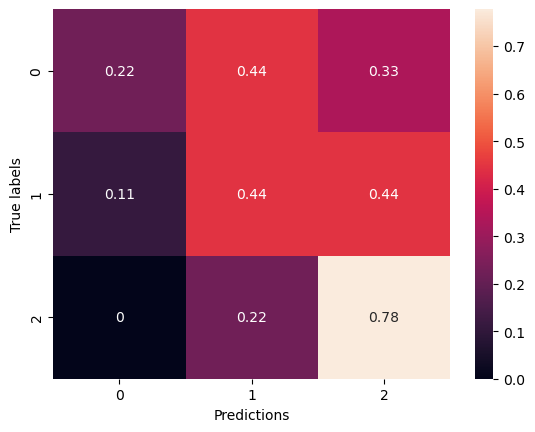

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▄▄▄▅▅▅▆▆▆▆▆▆▇▇▇▆▇▇▇█▇▇█▇███████████
training_loss,██▇▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▂▄▅▆▆▆▇▇▇▇▇▇███▇▇█▇▇██▇█▇██▇█▇█▇▇▇█▇▇
val_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:10:27.050722: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:10:27.053278: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:10:27.055059: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:10:28.784187: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:10:28.785948: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:10:28.788612: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:10:33.287144: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:10:33.980499: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 46.9953 - accuracy: 0.3721

2024-03-13 02:10:37.827256: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:10:37.829372: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:10:37.832266: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 207ms/step - loss: 46.9953 - accuracy: 0.3721 - val_loss: 45.7688 - val_accuracy: 0.4630
Epoch 2/100
14/14 [==============================] - 1s 87ms/step - loss: 45.8836 - accuracy: 0.4155 - val_loss: 44.8829 - val_accuracy: 0.4259
Epoch 3/100
14/14 [==============================] - 1s 78ms/step - loss: 44.8884 - accuracy: 0.4566 - val_loss: 44.0185 - val_accuracy: 0.3796
Epoch 4/100
14/14 [==============================] - 1s 78ms/step - loss: 43.8230 - accuracy: 0.4726 - val_loss: 43.1564 - val_accuracy: 0.3519
Epoch 5/100
14/14 [==============================] - 1s 79ms/step - loss: 42.9190 - accuracy: 0.4658 - val_loss: 42.3108 - val_accuracy: 0.3241
Epoch 6/100
14/14 [==============================] - 1s 87ms/step - loss: 41.9218 - accuracy: 0.5616 - val_loss: 41.4583 - val_accuracy: 0.3241
Epoch 7/100
14/14 [==============================] - 1s 78ms/step - loss: 41.1011 - accuracy: 0.5320 - val_loss: 40.6114 - val_accuracy: 0.3519
Ep

14/14 [==============================] - 1s 78ms/step - loss: 13.5959 - accuracy: 0.8904 - val_loss: 14.9367 - val_accuracy: 0.6296
Epoch 58/100
14/14 [==============================] - 1s 78ms/step - loss: 13.3354 - accuracy: 0.8927 - val_loss: 14.6546 - val_accuracy: 0.6204
Epoch 59/100
14/14 [==============================] - 1s 80ms/step - loss: 13.0018 - accuracy: 0.9087 - val_loss: 14.3834 - val_accuracy: 0.6111
Epoch 60/100
14/14 [==============================] - 1s 77ms/step - loss: 12.7828 - accuracy: 0.8744 - val_loss: 14.1252 - val_accuracy: 0.6111
Epoch 61/100
14/14 [==============================] - 1s 83ms/step - loss: 12.5056 - accuracy: 0.8973 - val_loss: 13.8789 - val_accuracy: 0.6019
Epoch 62/100
14/14 [==============================] - 1s 78ms/step - loss: 12.2271 - accuracy: 0.8904 - val_loss: 13.6764 - val_accuracy: 0.6019
Epoch 63/100
14/14 [==============================] - 1s 82ms/step - loss: 11.9716 - accuracy: 0.8995 - val_loss: 13.4504 - val_accuracy: 0.592

2024-03-13 02:12:31.865458: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:12:31.867829: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:12:31.870005: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5968549251556396 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.3, 'recall': 0.4444444444444444, 'f1-score': 0.3536842105263158, 'support': 27}, 'weighted avg': {'precision': 0.3, 'recall': 0.4444444444444444, 'f1-score': 0.35368421052631577, 'support': 27}}


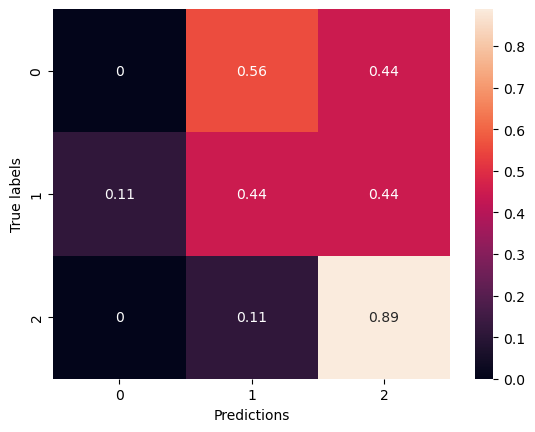

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▅▅▅▅▅▅▆▆▆▆▇▆▆▇▇▇▇▇▇▇▇▇████▇██▇█████
training_loss,██▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▂▁▂▃▄▅▅▆▅▅▅▆▆▆▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▆▇▇▆▆▆▇▆▇█
val_loss,██▇▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:13:00.573171: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:13:00.575316: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:13:00.577362: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:13:02.378558: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:13:02.380476: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:13:02.382601: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:13:08.002215: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:13:08.618671: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 8.2867 - accuracy: 0.3562

2024-03-13 02:13:12.560695: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:13:12.563109: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:13:12.565149: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 14s 210ms/step - loss: 8.2867 - accuracy: 0.3562 - val_loss: 7.5713 - val_accuracy: 0.4167
Epoch 2/100
14/14 [==============================] - 1s 79ms/step - loss: 8.0574 - accuracy: 0.3767 - val_loss: 7.5573 - val_accuracy: 0.4074
Epoch 3/100
14/14 [==============================] - 1s 91ms/step - loss: 7.9403 - accuracy: 0.3995 - val_loss: 7.5401 - val_accuracy: 0.3426
Epoch 4/100
14/14 [==============================] - 1s 79ms/step - loss: 7.9743 - accuracy: 0.3676 - val_loss: 7.5282 - val_accuracy: 0.3519
Epoch 5/100
14/14 [==============================] - 1s 78ms/step - loss: 7.8065 - accuracy: 0.4247 - val_loss: 7.5035 - val_accuracy: 0.3333
Epoch 6/100
14/14 [==============================] - 1s 88ms/step - loss: 7.7061 - accuracy: 0.4635 - val_loss: 7.4839 - val_accuracy: 0.3611
Epoch 7/100
14/14 [==============================] - 1s 78ms/step - loss: 7.6292 - accuracy: 0.4543 - val_loss: 7.4572 - val_accuracy: 0.3426
Epoch 8/100
14/1

14/14 [==============================] - 1s 80ms/step - loss: 5.5915 - accuracy: 0.7123 - val_loss: 6.2984 - val_accuracy: 0.5463
Epoch 59/100
14/14 [==============================] - 1s 79ms/step - loss: 5.5554 - accuracy: 0.7078 - val_loss: 6.3022 - val_accuracy: 0.5556
Epoch 60/100
14/14 [==============================] - 1s 79ms/step - loss: 5.5548 - accuracy: 0.7260 - val_loss: 6.2890 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 5.5165 - accuracy: 0.7192 - val_loss: 6.2740 - val_accuracy: 0.5370
Epoch 62/100
14/14 [==============================] - 1s 83ms/step - loss: 5.4218 - accuracy: 0.7557 - val_loss: 6.2475 - val_accuracy: 0.5463
Epoch 63/100
14/14 [==============================] - 1s 79ms/step - loss: 5.4458 - accuracy: 0.7146 - val_loss: 6.2315 - val_accuracy: 0.5463
Epoch 64/100
14/14 [==============================] - 1s 84ms/step - loss: 5.4223 - accuracy: 0.7283 - val_loss: 6.2142 - val_accuracy: 0.5556
Epoch 65/100

2024-03-13 02:15:06.055985: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:15:06.058971: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:15:06.060692: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.591649055480957 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5646723646723646, 'recall': 0.5555555555555555, 'f1-score': 0.5401635401635402, 'support': 27}, 'weighted avg': {'precision': 0.5646723646723646, 'recall': 0.5555555555555556, 'f1-score': 0.5401635401635402, 'support': 27}}


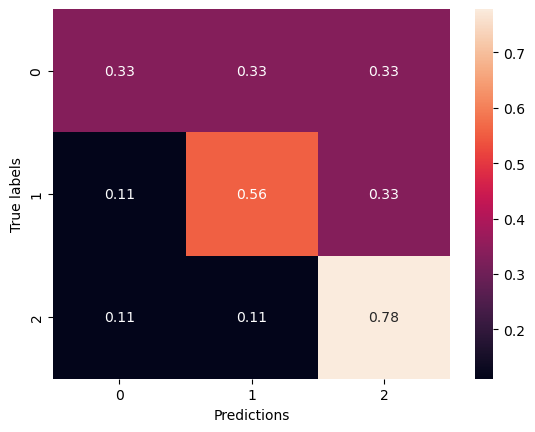

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▃▄▄▄▄▄▅▅▅▆▅▅▅▅▆▆▅▆▆▆▇▇▇▇▇▇█▇▇█████
training_loss,█▇▇▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▄▃▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁
training_time,▁
val_accuracy,▃▁▁▂▂▃▃▄▄▅▄▄▄▅▅▅▅▅▅▆▅▆▆▆▆▆▇▆▇▇███▇█▇█▇▇▇
val_loss,███▇▇▇▇▆▆▆▆▅▅▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▂▂▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:15:30.148864: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:15:30.151085: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:15:30.152925: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:15:31.905883: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:15:31.908754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:15:31.910906: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:15:36.429485: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:15:37.048801: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 34.2617 - accuracy: 0.3265

2024-03-13 02:15:40.895343: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:15:40.897262: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:15:40.899048: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 209ms/step - loss: 34.2617 - accuracy: 0.3265 - val_loss: 33.2272 - val_accuracy: 0.4815
Epoch 2/100
14/14 [==============================] - 1s 85ms/step - loss: 33.6944 - accuracy: 0.3151 - val_loss: 32.7249 - val_accuracy: 0.4167
Epoch 3/100
14/14 [==============================] - 1s 78ms/step - loss: 33.0387 - accuracy: 0.3607 - val_loss: 32.2281 - val_accuracy: 0.4259
Epoch 4/100
14/14 [==============================] - 1s 79ms/step - loss: 32.3717 - accuracy: 0.4018 - val_loss: 31.7273 - val_accuracy: 0.4167
Epoch 5/100
14/14 [==============================] - 1s 79ms/step - loss: 32.1557 - accuracy: 0.3151 - val_loss: 31.2405 - val_accuracy: 0.4074
Epoch 6/100
14/14 [==============================] - 1s 80ms/step - loss: 31.4286 - accuracy: 0.3790 - val_loss: 30.7722 - val_accuracy: 0.3704
Epoch 7/100
14/14 [==============================] - 1s 84ms/step - loss: 30.8451 - accuracy: 0.4087 - val_loss: 30.3041 - val_accuracy: 0.3611
Ep

14/14 [==============================] - 1s 78ms/step - loss: 13.4045 - accuracy: 0.7192 - val_loss: 14.3235 - val_accuracy: 0.5370
Epoch 58/100
14/14 [==============================] - 1s 78ms/step - loss: 13.1829 - accuracy: 0.7489 - val_loss: 14.1536 - val_accuracy: 0.5648
Epoch 59/100
14/14 [==============================] - 1s 80ms/step - loss: 12.9389 - accuracy: 0.7808 - val_loss: 13.9999 - val_accuracy: 0.5648
Epoch 60/100
14/14 [==============================] - 1s 79ms/step - loss: 12.8380 - accuracy: 0.7260 - val_loss: 13.8125 - val_accuracy: 0.5556
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 12.6375 - accuracy: 0.7146 - val_loss: 13.6253 - val_accuracy: 0.5741
Epoch 62/100
14/14 [==============================] - 1s 90ms/step - loss: 12.3453 - accuracy: 0.7717 - val_loss: 13.4437 - val_accuracy: 0.5741
Epoch 63/100
14/14 [==============================] - 1s 101ms/step - loss: 12.2005 - accuracy: 0.7580 - val_loss: 13.2604 - val_accuracy: 0.56

2024-03-13 02:17:32.582881: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:17:32.585087: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:17:32.587761: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6010518074035645 s
{'0': {'precision': 0.6, 'recall': 0.3333333333333333, 'f1-score': 0.42857142857142855, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '2': {'precision': 0.5833333333333334, 'recall': 0.7777777777777778, 'f1-score': 0.6666666666666666, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5277777777777778, 'recall': 0.5185185185185185, 'f1-score': 0.5054302422723476, 'support': 27}, 'weighted avg': {'precision': 0.5277777777777778, 'recall': 0.5185185185185185, 'f1-score': 0.5054302422723476, 'support': 27}}


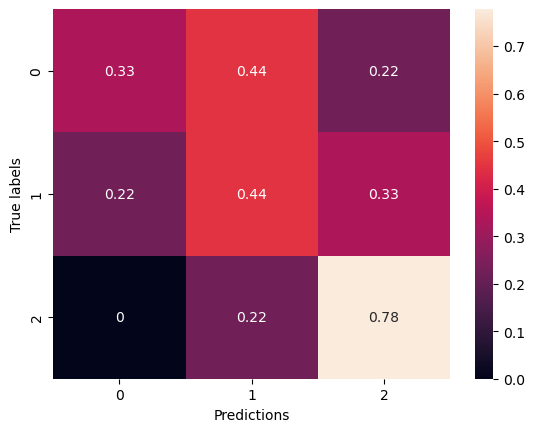

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▃▃▃▄▄▄▅▄▅▅▅▆▅▅▆▆▆▆▇▆▆▇▆▇▇▇▇▇▇▇█████
training_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▄▂▁▂▂▄▅▅▆▆▅▇▇▇▇▇▆▇▆▇████▇▇▇█▇▇▇▇▇▇▇██▇▆
val_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:17:56.672710: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:17:56.675679: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:17:56.677496: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:17:58.710635: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:17:58.712478: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:17:58.714760: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:18:04.309788: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:18:04.938906: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 46.9860 - accuracy: 0.3219

2024-03-13 02:18:08.782043: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:18:08.784847: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:18:08.786469: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 14s 205ms/step - loss: 46.9860 - accuracy: 0.3219 - val_loss: 45.8306 - val_accuracy: 0.3704
Epoch 2/100
14/14 [==============================] - 1s 82ms/step - loss: 46.1043 - accuracy: 0.3356 - val_loss: 44.9656 - val_accuracy: 0.3333
Epoch 3/100
14/14 [==============================] - 1s 78ms/step - loss: 45.0185 - accuracy: 0.3676 - val_loss: 44.1295 - val_accuracy: 0.2870
Epoch 4/100
14/14 [==============================] - 1s 79ms/step - loss: 44.1151 - accuracy: 0.3562 - val_loss: 43.3017 - val_accuracy: 0.2778
Epoch 5/100
14/14 [==============================] - 1s 84ms/step - loss: 43.1054 - accuracy: 0.4041 - val_loss: 42.4929 - val_accuracy: 0.2407
Epoch 6/100
14/14 [==============================] - 1s 83ms/step - loss: 42.4140 - accuracy: 0.4178 - val_loss: 41.6853 - val_accuracy: 0.2407
Epoch 7/100
14/14 [==============================] - 1s 81ms/step - loss: 41.4552 - accuracy: 0.4566 - val_loss: 40.8792 - val_accuracy: 0.2407
Ep

14/14 [==============================] - 1s 77ms/step - loss: 14.9808 - accuracy: 0.7215 - val_loss: 15.5796 - val_accuracy: 0.5463
Epoch 58/100
14/14 [==============================] - 1s 77ms/step - loss: 14.6956 - accuracy: 0.7374 - val_loss: 15.2802 - val_accuracy: 0.5463
Epoch 59/100
14/14 [==============================] - 1s 77ms/step - loss: 14.4592 - accuracy: 0.7100 - val_loss: 14.9891 - val_accuracy: 0.5463
Epoch 60/100
14/14 [==============================] - 1s 86ms/step - loss: 14.1481 - accuracy: 0.7557 - val_loss: 14.7361 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 1s 78ms/step - loss: 13.8462 - accuracy: 0.7511 - val_loss: 14.5376 - val_accuracy: 0.5463
Epoch 62/100
14/14 [==============================] - 1s 78ms/step - loss: 13.6335 - accuracy: 0.7192 - val_loss: 14.3258 - val_accuracy: 0.5463
Epoch 63/100
14/14 [==============================] - 1s 81ms/step - loss: 13.3146 - accuracy: 0.7740 - val_loss: 14.1055 - val_accuracy: 0.564

2024-03-13 02:20:01.104459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:20:01.107569: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:20:01.109603: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.8029630184173584 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.8888888888888888, 'f1-score': 0.6956521739130435, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.546031746031746, 'recall': 0.5185185185185185, 'f1-score': 0.4833460462751081, 'support': 27}, 'weighted avg': {'precision': 0.546031746031746, 'recall': 0.5185185185185185, 'f1-score': 0.4833460462751081, 'support': 27}}


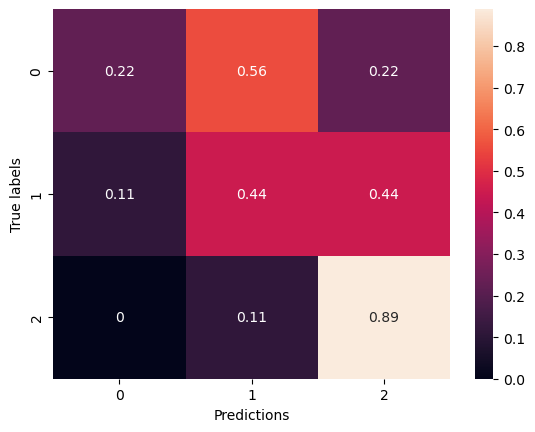

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▄▃▄▄▅▅▄▅▅▅▅▅▆▆▅▆▆▆▆▆▇▇▇▆▇▇▇▇▇▇████
training_loss,██▇▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▄▂▁▁▃▄▄▅▅▅▅▆▇▇██▇▇▇▇▆▇▇▇▇▇▇▇▇█▇▇██▇▇▇▇▇▇
val_loss,██▇▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:20:25.408507: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:20:25.410713: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:20:25.412516: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:20:27.169495: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:20:27.171531: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:20:27.173992: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:20:31.720785: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:20:32.341235: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 8.3281 - accuracy: 0.3562

2024-03-13 02:20:36.232472: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:20:36.235003: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:20:36.237136: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 207ms/step - loss: 8.3281 - accuracy: 0.3562 - val_loss: 7.6611 - val_accuracy: 0.2500
Epoch 2/100
14/14 [==============================] - 1s 80ms/step - loss: 8.2975 - accuracy: 0.3288 - val_loss: 7.6391 - val_accuracy: 0.2500
Epoch 3/100
14/14 [==============================] - 1s 85ms/step - loss: 8.1361 - accuracy: 0.3653 - val_loss: 7.6142 - val_accuracy: 0.2593
Epoch 4/100
14/14 [==============================] - 1s 78ms/step - loss: 8.1838 - accuracy: 0.3402 - val_loss: 7.5969 - val_accuracy: 0.2778
Epoch 5/100
14/14 [==============================] - 1s 78ms/step - loss: 8.1670 - accuracy: 0.3767 - val_loss: 7.5729 - val_accuracy: 0.2593
Epoch 6/100
14/14 [==============================] - 1s 82ms/step - loss: 7.9874 - accuracy: 0.3584 - val_loss: 7.5414 - val_accuracy: 0.2870
Epoch 7/100
14/14 [==============================] - 1s 78ms/step - loss: 8.0024 - accuracy: 0.3470 - val_loss: 7.5135 - val_accuracy: 0.3241
Epoch 8/100
14/1

14/14 [==============================] - 1s 78ms/step - loss: 6.3967 - accuracy: 0.4589 - val_loss: 6.4836 - val_accuracy: 0.3704
Epoch 59/100
14/14 [==============================] - 1s 86ms/step - loss: 6.2923 - accuracy: 0.5000 - val_loss: 6.4634 - val_accuracy: 0.3704
Epoch 60/100
14/14 [==============================] - 1s 78ms/step - loss: 6.2658 - accuracy: 0.5205 - val_loss: 6.4559 - val_accuracy: 0.3796
Epoch 61/100
14/14 [==============================] - 1s 81ms/step - loss: 6.2556 - accuracy: 0.4954 - val_loss: 6.4361 - val_accuracy: 0.3611
Epoch 62/100
14/14 [==============================] - 1s 78ms/step - loss: 6.1526 - accuracy: 0.5000 - val_loss: 6.4359 - val_accuracy: 0.3519
Epoch 63/100
14/14 [==============================] - 1s 79ms/step - loss: 6.1692 - accuracy: 0.4680 - val_loss: 6.4063 - val_accuracy: 0.3611
Epoch 64/100
14/14 [==============================] - 1s 78ms/step - loss: 6.1221 - accuracy: 0.5183 - val_loss: 6.3904 - val_accuracy: 0.3611
Epoch 65/100

2024-03-13 02:22:28.953345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:22:28.955682: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:22:28.957274: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.570512056350708 s
{'0': {'precision': 0.4444444444444444, 'recall': 0.4444444444444444, 'f1-score': 0.4444444444444444, 'support': 9}, '1': {'precision': 0.2, 'recall': 0.1111111111111111, 'f1-score': 0.14285714285714285, 'support': 9}, '2': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, 'accuracy': 0.37037037037037035, 'macro avg': {'precision': 0.343019943019943, 'recall': 0.3703703703703704, 'f1-score': 0.34728234728234725, 'support': 27}, 'weighted avg': {'precision': 0.343019943019943, 'recall': 0.37037037037037035, 'f1-score': 0.34728234728234736, 'support': 27}}


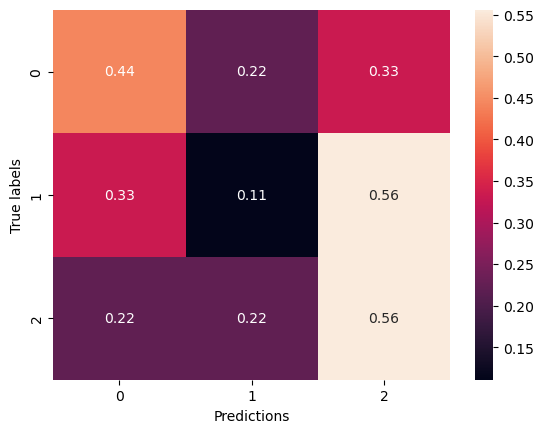

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▂▂▂▂▃▁▃▄▄▃▄▄▄▄▄▄▄▆▄▅▅▆▆▆▅▆▆▇▆▆▇▇▇▇█▇██▇█
training_loss,██▇▇▇▇▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁
training_time,▁
val_accuracy,▁▁▂▃▄▄▄▅▅▄▄▅▅▆▅▅▆▅▅▅▅▄▄▄▄▄▄▄▅▆▆▅▆▇▆▇▆▆▇█
val_loss,███▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁


Epoch 1/100


2024-03-13 02:23:00.096027: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:23:00.097766: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:23:00.099754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:23:01.918321: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:23:01.920750: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:23:01.922922: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:23:06.496667: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:23:07.110019: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 34.1654 - accuracy: 0.3242

2024-03-13 02:23:11.048783: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:23:11.050930: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:23:11.054409: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 219ms/step - loss: 34.1654 - accuracy: 0.3242 - val_loss: 33.3006 - val_accuracy: 0.1389
Epoch 2/100
14/14 [==============================] - 1s 78ms/step - loss: 33.6982 - accuracy: 0.3493 - val_loss: 32.8359 - val_accuracy: 0.1944
Epoch 3/100
14/14 [==============================] - 1s 80ms/step - loss: 33.0518 - accuracy: 0.3562 - val_loss: 32.3803 - val_accuracy: 0.2037
Epoch 4/100
14/14 [==============================] - 1s 81ms/step - loss: 32.6073 - accuracy: 0.3767 - val_loss: 31.9437 - val_accuracy: 0.2130
Epoch 5/100
14/14 [==============================] - 1s 85ms/step - loss: 32.2646 - accuracy: 0.3242 - val_loss: 31.5150 - val_accuracy: 0.2037
Epoch 6/100
14/14 [==============================] - 1s 79ms/step - loss: 31.6077 - accuracy: 0.3721 - val_loss: 31.0883 - val_accuracy: 0.2037
Epoch 7/100
14/14 [==============================] - 1s 81ms/step - loss: 31.3191 - accuracy: 0.3402 - val_loss: 30.6789 - val_accuracy: 0.2130
Ep

14/14 [==============================] - 1s 80ms/step - loss: 15.6170 - accuracy: 0.5571 - val_loss: 15.9471 - val_accuracy: 0.3981
Epoch 58/100
14/14 [==============================] - 1s 81ms/step - loss: 15.4771 - accuracy: 0.5616 - val_loss: 15.7725 - val_accuracy: 0.3981
Epoch 59/100
14/14 [==============================] - 1s 84ms/step - loss: 15.2957 - accuracy: 0.4977 - val_loss: 15.6281 - val_accuracy: 0.3981
Epoch 60/100
14/14 [==============================] - 1s 78ms/step - loss: 15.0366 - accuracy: 0.5776 - val_loss: 15.4467 - val_accuracy: 0.3981
Epoch 61/100
14/14 [==============================] - 1s 78ms/step - loss: 14.8956 - accuracy: 0.5068 - val_loss: 15.2631 - val_accuracy: 0.3981
Epoch 62/100
14/14 [==============================] - 1s 79ms/step - loss: 14.6403 - accuracy: 0.5411 - val_loss: 15.0724 - val_accuracy: 0.4074
Epoch 63/100
14/14 [==============================] - 1s 78ms/step - loss: 14.5618 - accuracy: 0.5274 - val_loss: 14.8736 - val_accuracy: 0.407

2024-03-13 02:25:03.966258: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:25:03.968124: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:25:03.969840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5760090351104736 s
{'0': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '1': {'precision': 0.5714285714285714, 'recall': 0.4444444444444444, 'f1-score': 0.5, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.6071428571428571, 'recall': 0.5555555555555555, 'f1-score': 0.5338461538461539, 'support': 27}, 'weighted avg': {'precision': 0.6071428571428571, 'recall': 0.5555555555555556, 'f1-score': 0.5338461538461539, 'support': 27}}


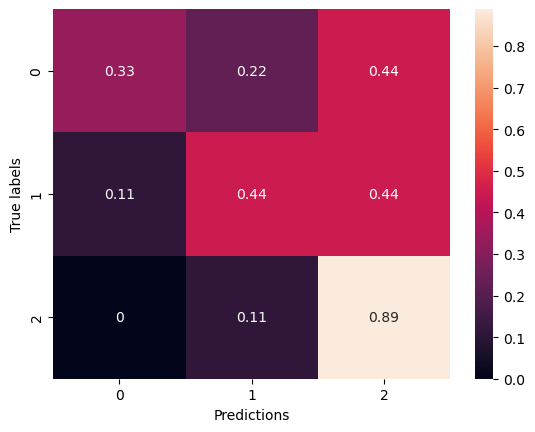

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▂▂▂▂▄▄▂▃▃▄▄▄▄▄▄▅▅▄▅▅▅▆▆▅▆▇▆▇▇▇▇▇████
training_loss,██▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▂▃▃▃▄▄▄▄▅▅▅▆▆▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇██▇▇██▇██
val_loss,██▇▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:25:29.137214: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:25:29.139670: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:25:29.141430: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:25:30.974182: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:25:30.976874: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:25:30.979471: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:25:35.473303: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:25:37.245846: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 47.0733 - accuracy: 0.3447

2024-03-13 02:25:41.259834: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:25:41.261858: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:25:41.263300: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 14s 213ms/step - loss: 47.0733 - accuracy: 0.3447 - val_loss: 46.0877 - val_accuracy: 0.1759
Epoch 2/100
14/14 [==============================] - 1s 77ms/step - loss: 46.2266 - accuracy: 0.3699 - val_loss: 45.2896 - val_accuracy: 0.1667
Epoch 3/100
14/14 [==============================] - 1s 86ms/step - loss: 45.3981 - accuracy: 0.3470 - val_loss: 44.5180 - val_accuracy: 0.1667
Epoch 4/100
14/14 [==============================] - 1s 80ms/step - loss: 44.6942 - accuracy: 0.3105 - val_loss: 43.7691 - val_accuracy: 0.1667
Epoch 5/100
14/14 [==============================] - 1s 79ms/step - loss: 43.7991 - accuracy: 0.3721 - val_loss: 43.0393 - val_accuracy: 0.1667
Epoch 6/100
14/14 [==============================] - 1s 79ms/step - loss: 43.0097 - accuracy: 0.4110 - val_loss: 42.3159 - val_accuracy: 0.1667
Epoch 7/100
14/14 [==============================] - 1s 83ms/step - loss: 42.2432 - accuracy: 0.3881 - val_loss: 41.6063 - val_accuracy: 0.1852
Ep

14/14 [==============================] - 1s 82ms/step - loss: 17.9672 - accuracy: 0.5388 - val_loss: 18.1362 - val_accuracy: 0.5093
Epoch 58/100
14/14 [==============================] - 1s 78ms/step - loss: 17.7009 - accuracy: 0.5708 - val_loss: 17.8478 - val_accuracy: 0.5278
Epoch 59/100
14/14 [==============================] - 1s 87ms/step - loss: 17.3914 - accuracy: 0.5320 - val_loss: 17.5975 - val_accuracy: 0.5278
Epoch 60/100
14/14 [==============================] - 1s 82ms/step - loss: 17.1696 - accuracy: 0.5548 - val_loss: 17.3642 - val_accuracy: 0.5093
Epoch 61/100
14/14 [==============================] - 1s 79ms/step - loss: 16.9103 - accuracy: 0.5320 - val_loss: 17.1032 - val_accuracy: 0.5185
Epoch 62/100
14/14 [==============================] - 1s 82ms/step - loss: 16.5653 - accuracy: 0.5731 - val_loss: 16.8361 - val_accuracy: 0.5370
Epoch 63/100
14/14 [==============================] - 1s 81ms/step - loss: 16.2855 - accuracy: 0.5685 - val_loss: 16.5640 - val_accuracy: 0.509

2024-03-13 02:27:35.761181: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:27:35.763012: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:27:35.764814: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.7133257389068604 s
{'0': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.38461538461538464, 'recall': 0.5555555555555556, 'f1-score': 0.4545454545454546, 'support': 9}, 'accuracy': 0.4444444444444444, 'macro avg': {'precision': 0.4467236467236468, 'recall': 0.4444444444444445, 'f1-score': 0.431938431938432, 'support': 27}, 'weighted avg': {'precision': 0.44672364672364673, 'recall': 0.4444444444444444, 'f1-score': 0.43193843193843195, 'support': 27}}


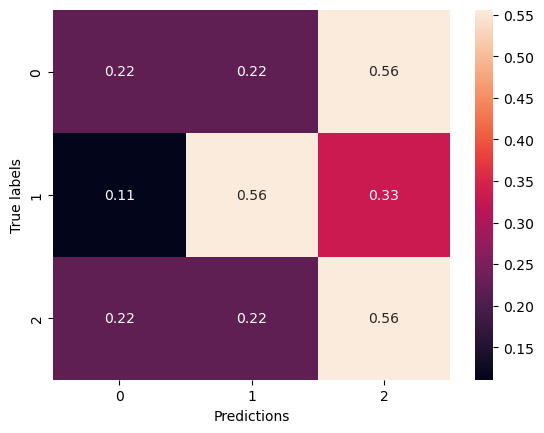

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▁▂▁▃▃▃▄▃▃▄▄▅▅▄▄▅▄▅▅▅▅▅▅▆▆▆▆▆▇▆▆▇██▇██
training_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▃▄▅▅▅▆▆▆▇▆▆▆▇▇███████████▇█▇▇▇█▇▇███
val_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:28:00.284424: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:28:00.286013: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:28:00.288189: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:28:01.994540: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:28:01.996459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:28:01.999139: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:28:06.525484: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:28:07.141492: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 9.5167 - accuracy: 0.3630

2024-03-13 02:28:11.101031: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:28:11.102619: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:28:11.105392: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 219ms/step - loss: 9.5167 - accuracy: 0.3630 - val_loss: 8.8824 - val_accuracy: 0.5093
Epoch 2/100
14/14 [==============================] - 1s 92ms/step - loss: 9.3203 - accuracy: 0.3995 - val_loss: 8.8487 - val_accuracy: 0.4352
Epoch 3/100
14/14 [==============================] - 1s 87ms/step - loss: 9.3091 - accuracy: 0.4018 - val_loss: 8.8112 - val_accuracy: 0.4444
Epoch 4/100
14/14 [==============================] - 1s 88ms/step - loss: 9.1100 - accuracy: 0.4452 - val_loss: 8.7693 - val_accuracy: 0.4074
Epoch 5/100
14/14 [==============================] - 1s 94ms/step - loss: 8.9967 - accuracy: 0.4475 - val_loss: 8.7318 - val_accuracy: 0.4167
Epoch 6/100
14/14 [==============================] - 1s 89ms/step - loss: 8.8148 - accuracy: 0.5137 - val_loss: 8.6815 - val_accuracy: 0.4074
Epoch 7/100
14/14 [==============================] - 1s 88ms/step - loss: 8.7207 - accuracy: 0.4817 - val_loss: 8.6335 - val_accuracy: 0.4074
Epoch 8/100
14/1

14/14 [==============================] - 1s 88ms/step - loss: 5.8385 - accuracy: 0.8950 - val_loss: 7.5611 - val_accuracy: 0.5000
Epoch 59/100
14/14 [==============================] - 1s 93ms/step - loss: 5.8093 - accuracy: 0.9041 - val_loss: 7.5673 - val_accuracy: 0.5093
Epoch 60/100
14/14 [==============================] - 1s 90ms/step - loss: 5.7529 - accuracy: 0.9110 - val_loss: 7.5504 - val_accuracy: 0.5185
Epoch 61/100
14/14 [==============================] - 1s 89ms/step - loss: 5.7057 - accuracy: 0.9178 - val_loss: 7.5422 - val_accuracy: 0.5185
Epoch 62/100
14/14 [==============================] - 1s 93ms/step - loss: 5.6608 - accuracy: 0.9201 - val_loss: 7.5006 - val_accuracy: 0.5093
Epoch 63/100
14/14 [==============================] - 1s 88ms/step - loss: 5.6347 - accuracy: 0.9269 - val_loss: 7.4865 - val_accuracy: 0.5093
Epoch 64/100
14/14 [==============================] - 1s 91ms/step - loss: 5.6551 - accuracy: 0.8950 - val_loss: 7.4894 - val_accuracy: 0.5185
Epoch 65/100

2024-03-13 02:30:19.239597: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:30:19.241290: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:30:19.243225: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6313412189483643 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.4444444444444444, 'f1-score': 0.5333333333333333, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '2': {'precision': 0.4666666666666667, 'recall': 0.7777777777777778, 'f1-score': 0.5833333333333334, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.5444444444444444, 'recall': 0.5185185185185185, 'f1-score': 0.5055555555555555, 'support': 27}, 'weighted avg': {'precision': 0.5444444444444444, 'recall': 0.5185185185185185, 'f1-score': 0.5055555555555555, 'support': 27}}


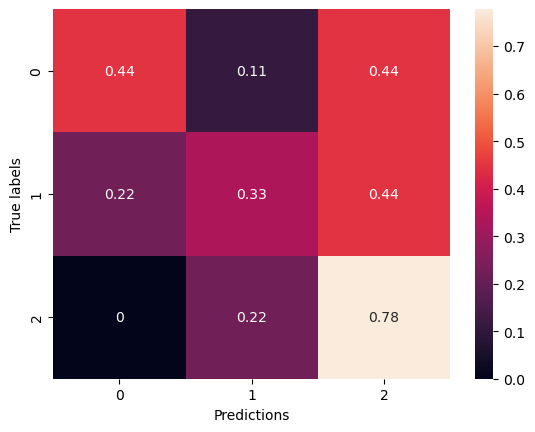

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▃▂▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇█▇▇█▇▇███████
training_loss,██▇▇▆▆▆▆▆▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁
training_time,▁
val_accuracy,▆▃▁▂▅▅▄▃▄▆▅▆▄▅▆▆▆▆▅▆▇▅▅▆▆▆▇▇▇▇▇▇▅▆█▆▇█▇█
val_loss,██▇▇▇▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▄▃▃▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁


Epoch 1/100


2024-03-13 02:30:46.376306: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:30:46.379000: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:30:46.381037: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:30:48.111952: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:30:48.114339: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:30:48.116008: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:30:53.826576: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:30:54.458402: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 41.0905 - accuracy: 0.2717

2024-03-13 02:30:58.419800: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:30:58.422186: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:30:58.423807: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 14s 216ms/step - loss: 41.0905 - accuracy: 0.2717 - val_loss: 39.9867 - val_accuracy: 0.2315
Epoch 2/100
14/14 [==============================] - 1s 92ms/step - loss: 40.1693 - accuracy: 0.3539 - val_loss: 39.3507 - val_accuracy: 0.1944
Epoch 3/100
14/14 [==============================] - 1s 87ms/step - loss: 39.3256 - accuracy: 0.4132 - val_loss: 38.7193 - val_accuracy: 0.1944
Epoch 4/100
14/14 [==============================] - 1s 89ms/step - loss: 38.7049 - accuracy: 0.4041 - val_loss: 38.0777 - val_accuracy: 0.2130
Epoch 5/100
14/14 [==============================] - 1s 90ms/step - loss: 37.9611 - accuracy: 0.4361 - val_loss: 37.4440 - val_accuracy: 0.2407
Epoch 6/100
14/14 [==============================] - 1s 90ms/step - loss: 37.1938 - accuracy: 0.4521 - val_loss: 36.8289 - val_accuracy: 0.2500
Epoch 7/100
14/14 [==============================] - 1s 89ms/step - loss: 36.5876 - accuracy: 0.4726 - val_loss: 36.2030 - val_accuracy: 0.2685
Ep

14/14 [==============================] - 1s 91ms/step - loss: 14.4695 - accuracy: 0.8653 - val_loss: 15.6599 - val_accuracy: 0.4722
Epoch 58/100
14/14 [==============================] - 1s 87ms/step - loss: 14.2035 - accuracy: 0.8836 - val_loss: 15.4157 - val_accuracy: 0.4630
Epoch 59/100
14/14 [==============================] - 1s 88ms/step - loss: 13.9436 - accuracy: 0.8881 - val_loss: 15.1344 - val_accuracy: 0.4630
Epoch 60/100
14/14 [==============================] - 1s 93ms/step - loss: 13.6688 - accuracy: 0.8995 - val_loss: 14.8843 - val_accuracy: 0.4907
Epoch 61/100
14/14 [==============================] - 1s 88ms/step - loss: 13.4062 - accuracy: 0.8995 - val_loss: 14.6853 - val_accuracy: 0.5000
Epoch 62/100
14/14 [==============================] - 1s 87ms/step - loss: 13.1335 - accuracy: 0.9247 - val_loss: 14.4393 - val_accuracy: 0.4907
Epoch 63/100
14/14 [==============================] - 1s 88ms/step - loss: 12.9501 - accuracy: 0.8950 - val_loss: 14.2040 - val_accuracy: 0.472

2024-03-13 02:33:05.579524: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:33:05.581397: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:33:05.583564: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5752291679382324 s
{'0': {'precision': 1.0, 'recall': 0.1111111111111111, 'f1-score': 0.19999999999999998, 'support': 9}, '1': {'precision': 0.6666666666666666, 'recall': 0.6666666666666666, 'f1-score': 0.6666666666666666, 'support': 9}, '2': {'precision': 0.5294117647058824, 'recall': 1.0, 'f1-score': 0.6923076923076924, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.7320261437908496, 'recall': 0.5925925925925926, 'f1-score': 0.5196581196581197, 'support': 27}, 'weighted avg': {'precision': 0.7320261437908497, 'recall': 0.5925925925925926, 'f1-score': 0.5196581196581197, 'support': 27}}


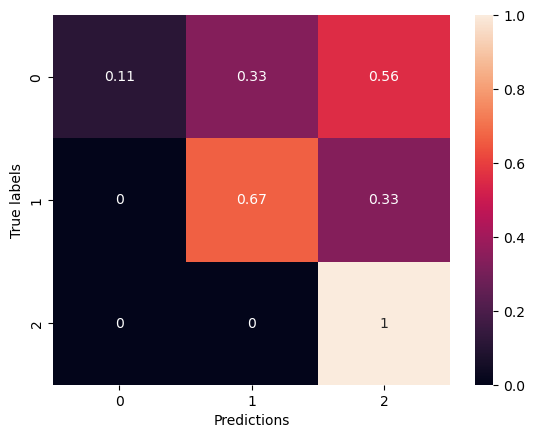

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█████████████
training_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▁▂▄▅▆▅▆▅▅▆▆▆▆▅▆▇▇▆▆▇▆▆▆▆▆▆▆▆▆▇██▇▅▅▆▆█▇
val_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:33:29.678832: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:33:29.681314: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:33:29.683124: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:33:31.463971: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:33:31.467180: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:33:31.469525: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:33:35.982318: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:33:36.652960: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 56.5106 - accuracy: 0.3082

2024-03-13 02:33:40.699816: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:33:40.701431: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:33:40.703538: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 221ms/step - loss: 56.5106 - accuracy: 0.3082 - val_loss: 55.1302 - val_accuracy: 0.2778
Epoch 2/100
14/14 [==============================] - 1s 94ms/step - loss: 54.9425 - accuracy: 0.4110 - val_loss: 54.0569 - val_accuracy: 0.2407
Epoch 3/100
14/14 [==============================] - 1s 88ms/step - loss: 53.7948 - accuracy: 0.4110 - val_loss: 52.9842 - val_accuracy: 0.2870
Epoch 4/100
14/14 [==============================] - 1s 87ms/step - loss: 52.6855 - accuracy: 0.4452 - val_loss: 51.9277 - val_accuracy: 0.2870
Epoch 5/100
14/14 [==============================] - 1s 89ms/step - loss: 51.6025 - accuracy: 0.4589 - val_loss: 50.8705 - val_accuracy: 0.3056
Epoch 6/100
14/14 [==============================] - 1s 94ms/step - loss: 50.5283 - accuracy: 0.4703 - val_loss: 49.8225 - val_accuracy: 0.2963
Epoch 7/100
14/14 [==============================] - 1s 91ms/step - loss: 49.5010 - accuracy: 0.4932 - val_loss: 48.8027 - val_accuracy: 0.2963
Ep

14/14 [==============================] - 2s 114ms/step - loss: 16.3228 - accuracy: 0.8493 - val_loss: 17.6321 - val_accuracy: 0.5370
Epoch 58/100
14/14 [==============================] - 2s 108ms/step - loss: 15.9679 - accuracy: 0.8744 - val_loss: 17.2790 - val_accuracy: 0.5278
Epoch 59/100
14/14 [==============================] - 1s 86ms/step - loss: 15.5940 - accuracy: 0.8836 - val_loss: 16.9119 - val_accuracy: 0.5463
Epoch 60/100
14/14 [==============================] - 1s 90ms/step - loss: 15.2803 - accuracy: 0.8904 - val_loss: 16.6121 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 1s 97ms/step - loss: 14.8992 - accuracy: 0.9132 - val_loss: 16.3029 - val_accuracy: 0.5278
Epoch 62/100
14/14 [==============================] - 1s 87ms/step - loss: 14.6422 - accuracy: 0.8927 - val_loss: 15.9322 - val_accuracy: 0.5463
Epoch 63/100
14/14 [==============================] - 1s 93ms/step - loss: 14.2901 - accuracy: 0.9110 - val_loss: 15.6723 - val_accuracy: 0.5

2024-03-13 02:35:47.795490: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:35:47.798059: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:35:47.799692: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.6566112041473389 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.8888888888888888, 'f1-score': 0.6956521739130435, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5793650793650793, 'recall': 0.5555555555555555, 'f1-score': 0.5184337655733536, 'support': 27}, 'weighted avg': {'precision': 0.5793650793650793, 'recall': 0.5555555555555556, 'f1-score': 0.5184337655733536, 'support': 27}}


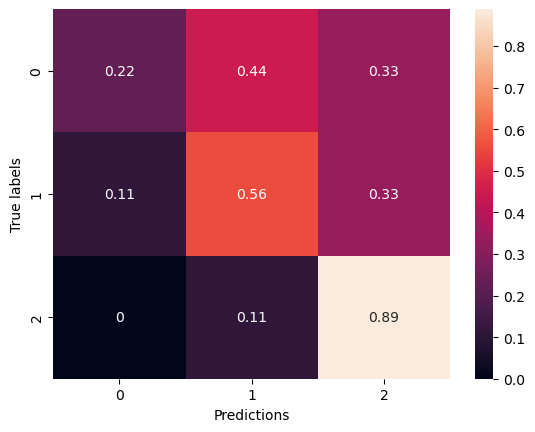

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▃▄▄▄▅▅▅▅▆▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇█▇█████████
training_loss,██▇▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▂▃▃▄▅▅▆▇▇▇▇▇▇▇▇▇▇▆▇▇▇▆▇▇▇▇▆▆▆▇▇▇█▇███
val_loss,██▇▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:36:13.152539: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:36:13.155772: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:36:13.157500: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:36:16.100787: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:36:16.102746: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:36:16.105056: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:36:20.618639: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:36:21.255999: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 9.4098 - accuracy: 0.3813

2024-03-13 02:36:25.246232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:36:25.247858: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:36:25.249818: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 14s 223ms/step - loss: 9.4098 - accuracy: 0.3813 - val_loss: 8.9049 - val_accuracy: 0.4074
Epoch 2/100
14/14 [==============================] - 1s 98ms/step - loss: 9.3930 - accuracy: 0.3493 - val_loss: 8.8601 - val_accuracy: 0.3981
Epoch 3/100
14/14 [==============================] - 1s 89ms/step - loss: 9.2461 - accuracy: 0.3767 - val_loss: 8.8170 - val_accuracy: 0.4074
Epoch 4/100
14/14 [==============================] - 1s 89ms/step - loss: 9.2088 - accuracy: 0.3767 - val_loss: 8.7839 - val_accuracy: 0.3796
Epoch 5/100
14/14 [==============================] - 1s 90ms/step - loss: 9.1427 - accuracy: 0.3790 - val_loss: 8.7457 - val_accuracy: 0.3519
Epoch 6/100
14/14 [==============================] - 1s 87ms/step - loss: 9.1009 - accuracy: 0.4041 - val_loss: 8.7073 - val_accuracy: 0.3611
Epoch 7/100
14/14 [==============================] - 1s 88ms/step - loss: 8.9341 - accuracy: 0.4110 - val_loss: 8.6596 - val_accuracy: 0.3796
Epoch 8/100
14/1

14/14 [==============================] - 1s 92ms/step - loss: 6.4407 - accuracy: 0.7329 - val_loss: 7.3188 - val_accuracy: 0.5278
Epoch 59/100
14/14 [==============================] - 1s 87ms/step - loss: 6.4218 - accuracy: 0.7146 - val_loss: 7.2328 - val_accuracy: 0.5370
Epoch 60/100
14/14 [==============================] - 1s 86ms/step - loss: 6.2792 - accuracy: 0.7763 - val_loss: 7.1862 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 1s 87ms/step - loss: 6.2507 - accuracy: 0.7740 - val_loss: 7.1459 - val_accuracy: 0.5556
Epoch 62/100
14/14 [==============================] - 1s 92ms/step - loss: 6.2768 - accuracy: 0.7626 - val_loss: 7.0987 - val_accuracy: 0.5463
Epoch 63/100
14/14 [==============================] - 1s 88ms/step - loss: 6.2647 - accuracy: 0.7237 - val_loss: 7.0895 - val_accuracy: 0.5463
Epoch 64/100
14/14 [==============================] - 1s 86ms/step - loss: 6.1753 - accuracy: 0.7648 - val_loss: 7.0826 - val_accuracy: 0.5278
Epoch 65/100

2024-03-13 02:38:32.083933: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:38:32.086079: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:38:32.087676: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5734760761260986 s
{'0': {'precision': 0.25, 'recall': 0.1111111111111111, 'f1-score': 0.15384615384615383, 'support': 9}, '1': {'precision': 0.5454545454545454, 'recall': 0.6666666666666666, 'f1-score': 0.6, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.6666666666666666, 'f1-score': 0.5714285714285715, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.4318181818181818, 'recall': 0.4814814814814814, 'f1-score': 0.4417582417582418, 'support': 27}, 'weighted avg': {'precision': 0.43181818181818177, 'recall': 0.48148148148148145, 'f1-score': 0.44175824175824174, 'support': 27}}


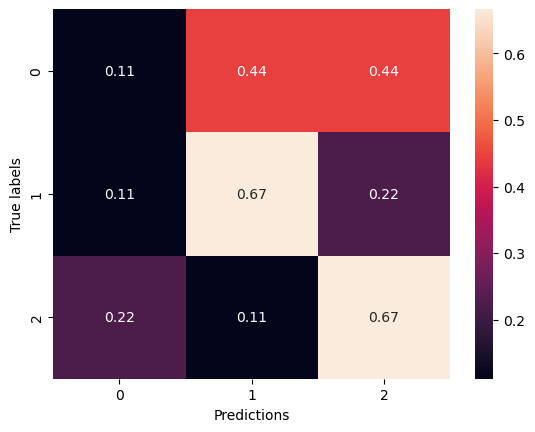

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▁▂▂▂▄▄▃▃▄▄▅▄▅▅▅▆▅▆▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇█████
training_loss,███▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁
training_time,▁
val_accuracy,▂▂▁▁▂▃▄▄▅▅▅▅▆▆▆▇▇▇▇▇▇▇▆▆▇▆▆▆█▇▇▇███▇▇▇█▇
val_loss,██▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▂▁▁▁▁


Epoch 1/100


2024-03-13 02:38:57.706308: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:38:57.707925: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:38:57.709959: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:38:59.488695: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:38:59.491289: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:38:59.493096: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:39:03.934861: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:39:04.550601: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 40.7904 - accuracy: 0.3539

2024-03-13 02:39:08.460972: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:39:08.462943: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:39:08.464670: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 214ms/step - loss: 40.7904 - accuracy: 0.3539 - val_loss: 39.9660 - val_accuracy: 0.1296
Epoch 2/100
14/14 [==============================] - 1s 90ms/step - loss: 40.0174 - accuracy: 0.3721 - val_loss: 39.3204 - val_accuracy: 0.1389
Epoch 3/100
14/14 [==============================] - 1s 99ms/step - loss: 39.4858 - accuracy: 0.3539 - val_loss: 38.7001 - val_accuracy: 0.1852
Epoch 4/100
14/14 [==============================] - 1s 87ms/step - loss: 38.7716 - accuracy: 0.3539 - val_loss: 38.0785 - val_accuracy: 0.1944
Epoch 5/100
14/14 [==============================] - 1s 87ms/step - loss: 38.0223 - accuracy: 0.4110 - val_loss: 37.4588 - val_accuracy: 0.2037
Epoch 6/100
14/14 [==============================] - 1s 91ms/step - loss: 37.3786 - accuracy: 0.4338 - val_loss: 36.8634 - val_accuracy: 0.2130
Epoch 7/100
14/14 [==============================] - 1s 89ms/step - loss: 36.7582 - accuracy: 0.3973 - val_loss: 36.2817 - val_accuracy: 0.2685
Ep

14/14 [==============================] - 1s 88ms/step - loss: 16.0836 - accuracy: 0.7009 - val_loss: 16.7131 - val_accuracy: 0.5000
Epoch 58/100
14/14 [==============================] - 1s 87ms/step - loss: 15.7783 - accuracy: 0.7283 - val_loss: 16.5224 - val_accuracy: 0.4907
Epoch 59/100
14/14 [==============================] - 1s 99ms/step - loss: 15.4918 - accuracy: 0.7443 - val_loss: 16.3201 - val_accuracy: 0.4907
Epoch 60/100
14/14 [==============================] - 1s 88ms/step - loss: 15.2447 - accuracy: 0.7580 - val_loss: 16.0707 - val_accuracy: 0.4907
Epoch 61/100
14/14 [==============================] - 1s 89ms/step - loss: 15.0582 - accuracy: 0.7215 - val_loss: 15.8218 - val_accuracy: 0.4907
Epoch 62/100
14/14 [==============================] - 1s 90ms/step - loss: 14.8404 - accuracy: 0.7466 - val_loss: 15.5794 - val_accuracy: 0.4815
Epoch 63/100
14/14 [==============================] - 1s 87ms/step - loss: 14.5739 - accuracy: 0.7534 - val_loss: 15.2994 - val_accuracy: 0.481

2024-03-13 02:41:17.712515: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:41:17.714304: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:41:17.716233: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 3s 3s/step
Inference done in 2.9022881984710693 s
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '2': {'precision': 0.5, 'recall': 0.8888888888888888, 'f1-score': 0.64, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.3333333333333333, 'recall': 0.48148148148148145, 'f1-score': 0.3887719298245614, 'support': 27}, 'weighted avg': {'precision': 0.3333333333333333, 'recall': 0.48148148148148145, 'f1-score': 0.3887719298245614, 'support': 27}}


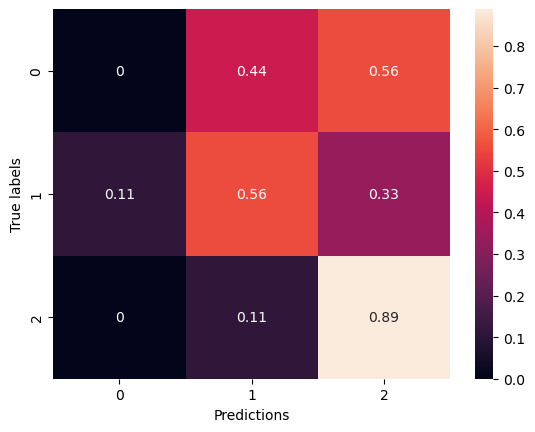

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▅▆▆▆▆▇▇▇▇▇▇▇▇▇█▇████
training_loss,██▇▇▇▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▂▃▄▄▅▆▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇▆▆▆▇▇█▇▇▇▇▇▇▇▇███
val_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:41:42.147842: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:41:42.149936: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:41:42.151457: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:41:44.017029: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:41:44.019197: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:41:44.022857: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:41:48.557998: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:41:49.183356: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 56.7957 - accuracy: 0.3128

2024-03-13 02:41:53.262926: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:41:53.264911: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:41:53.267103: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 219ms/step - loss: 56.7957 - accuracy: 0.3128 - val_loss: 55.3831 - val_accuracy: 0.4630
Epoch 2/100
14/14 [==============================] - 1s 94ms/step - loss: 55.4691 - accuracy: 0.3607 - val_loss: 54.3168 - val_accuracy: 0.4444
Epoch 3/100
14/14 [==============================] - 1s 93ms/step - loss: 54.3866 - accuracy: 0.3584 - val_loss: 53.2706 - val_accuracy: 0.4352
Epoch 4/100
14/14 [==============================] - 1s 88ms/step - loss: 53.3778 - accuracy: 0.3219 - val_loss: 52.2512 - val_accuracy: 0.3704
Epoch 5/100
14/14 [==============================] - 1s 101ms/step - loss: 52.1960 - accuracy: 0.3653 - val_loss: 51.2469 - val_accuracy: 0.3611
Epoch 6/100
14/14 [==============================] - 1s 88ms/step - loss: 51.1292 - accuracy: 0.4155 - val_loss: 50.2547 - val_accuracy: 0.3704
Epoch 7/100
14/14 [==============================] - 1s 90ms/step - loss: 50.1088 - accuracy: 0.3973 - val_loss: 49.2809 - val_accuracy: 0.3889
E

14/14 [==============================] - 1s 87ms/step - loss: 18.2298 - accuracy: 0.7283 - val_loss: 18.7889 - val_accuracy: 0.5000
Epoch 58/100
14/14 [==============================] - 1s 90ms/step - loss: 17.8135 - accuracy: 0.7306 - val_loss: 18.4477 - val_accuracy: 0.4907
Epoch 59/100
14/14 [==============================] - 1s 91ms/step - loss: 17.5010 - accuracy: 0.7215 - val_loss: 18.0858 - val_accuracy: 0.5185
Epoch 60/100
14/14 [==============================] - 1s 89ms/step - loss: 17.1737 - accuracy: 0.7443 - val_loss: 17.7603 - val_accuracy: 0.4815
Epoch 61/100
14/14 [==============================] - 1s 90ms/step - loss: 16.8930 - accuracy: 0.7100 - val_loss: 17.4618 - val_accuracy: 0.5000
Epoch 62/100
14/14 [==============================] - 1s 88ms/step - loss: 16.5306 - accuracy: 0.7329 - val_loss: 17.1958 - val_accuracy: 0.4907
Epoch 63/100
14/14 [==============================] - 1s 94ms/step - loss: 16.1609 - accuracy: 0.7717 - val_loss: 16.8920 - val_accuracy: 0.490

2024-03-13 02:44:04.939929: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:44:04.942100: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:44:04.945620: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.7445061206817627 s
{'0': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '1': {'precision': 0.5555555555555556, 'recall': 0.5555555555555556, 'f1-score': 0.5555555555555556, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.8888888888888888, 'f1-score': 0.6956521739130435, 'support': 9}, 'accuracy': 0.5925925925925926, 'macro avg': {'precision': 0.6256613756613757, 'recall': 0.5925925925925926, 'f1-score': 0.5709153970023535, 'support': 27}, 'weighted avg': {'precision': 0.6256613756613757, 'recall': 0.5925925925925926, 'f1-score': 0.5709153970023535, 'support': 27}}


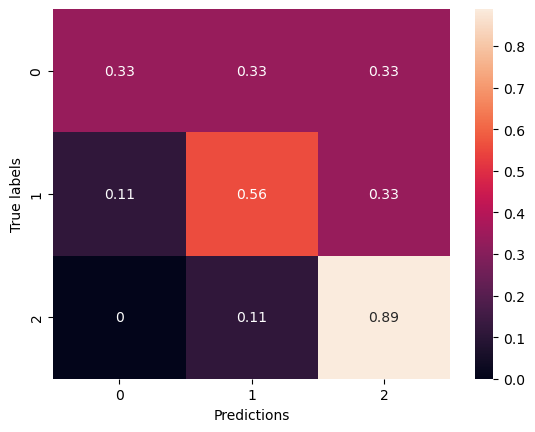

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▂▂▃▃▃▄▃▄▃▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇█▇███
training_loss,██▇▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▅▄▂▁▁▃▂▂▃▄▄▄▆▆▆▆▆▆▇▅▅▅▆▆▆▅▅▆▅▆▄▅▆▆▅▅█▆██
val_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:44:32.123391: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:44:32.125049: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:44:32.126703: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:44:33.892580: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:44:33.895460: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:44:33.897874: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:44:39.562507: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:44:40.205959: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 9.5443 - accuracy: 0.3653

2024-03-13 02:44:44.224232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:44:44.226308: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:44:44.228174: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 14s 218ms/step - loss: 9.5443 - accuracy: 0.3653 - val_loss: 8.8431 - val_accuracy: 0.5463
Epoch 2/100
14/14 [==============================] - 1s 93ms/step - loss: 9.5564 - accuracy: 0.3288 - val_loss: 8.8166 - val_accuracy: 0.4907
Epoch 3/100
14/14 [==============================] - 1s 94ms/step - loss: 9.3926 - accuracy: 0.3539 - val_loss: 8.7896 - val_accuracy: 0.4907
Epoch 4/100
14/14 [==============================] - 1s 95ms/step - loss: 9.2789 - accuracy: 0.3721 - val_loss: 8.7564 - val_accuracy: 0.4815
Epoch 5/100
14/14 [==============================] - 1s 99ms/step - loss: 9.2163 - accuracy: 0.3630 - val_loss: 8.7265 - val_accuracy: 0.4537
Epoch 6/100
14/14 [==============================] - 1s 87ms/step - loss: 9.1996 - accuracy: 0.3493 - val_loss: 8.6988 - val_accuracy: 0.4815
Epoch 7/100
14/14 [==============================] - 1s 95ms/step - loss: 9.1582 - accuracy: 0.3447 - val_loss: 8.6666 - val_accuracy: 0.4722
Epoch 8/100
14/1

14/14 [==============================] - 1s 93ms/step - loss: 7.3265 - accuracy: 0.4817 - val_loss: 7.4308 - val_accuracy: 0.4259
Epoch 59/100
14/14 [==============================] - 1s 88ms/step - loss: 7.3789 - accuracy: 0.4635 - val_loss: 7.3911 - val_accuracy: 0.4259
Epoch 60/100
14/14 [==============================] - 1s 89ms/step - loss: 7.3067 - accuracy: 0.4521 - val_loss: 7.3988 - val_accuracy: 0.4259
Epoch 61/100
14/14 [==============================] - 1s 88ms/step - loss: 7.2978 - accuracy: 0.5114 - val_loss: 7.3946 - val_accuracy: 0.4167
Epoch 62/100
14/14 [==============================] - 1s 91ms/step - loss: 7.2041 - accuracy: 0.4954 - val_loss: 7.3721 - val_accuracy: 0.3981
Epoch 63/100
14/14 [==============================] - 1s 89ms/step - loss: 7.2336 - accuracy: 0.4863 - val_loss: 7.3362 - val_accuracy: 0.3981
Epoch 64/100
14/14 [==============================] - 1s 87ms/step - loss: 7.1321 - accuracy: 0.4863 - val_loss: 7.3234 - val_accuracy: 0.4074
Epoch 65/100

2024-03-13 02:46:51.166756: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:46:51.169713: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:46:51.171619: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 2.010226011276245 s
{'0': {'precision': 0.42857142857142855, 'recall': 0.3333333333333333, 'f1-score': 0.375, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.2222222222222222, 'f1-score': 0.2857142857142857, 'support': 9}, '2': {'precision': 0.4, 'recall': 0.6666666666666666, 'f1-score': 0.5, 'support': 9}, 'accuracy': 0.4074074074074074, 'macro avg': {'precision': 0.40952380952380957, 'recall': 0.40740740740740744, 'f1-score': 0.38690476190476186, 'support': 27}, 'weighted avg': {'precision': 0.4095238095238095, 'recall': 0.4074074074074074, 'f1-score': 0.3869047619047619, 'support': 27}}


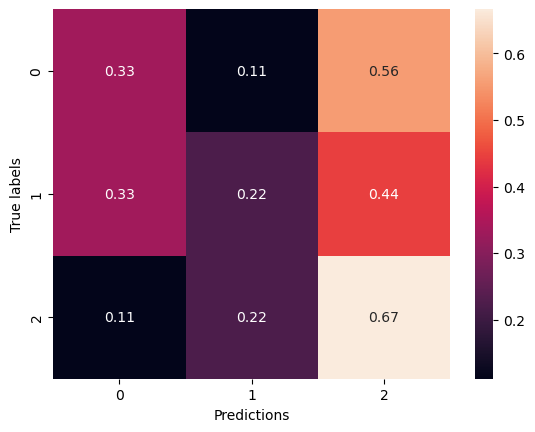

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▂▁▁▂▁▁▃▃▁▂▂▃▄▃▃▄▃▄▄▄▅▄▅▅▆▆▄▄▅▆▅▆▅▇▆▆▆█▇▇
training_loss,██▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁
training_time,▁
val_accuracy,█▅▅▄▂▃▂▃▂▂▂▄▃▅▂▃▂▂▁▃▂▂▂▂▂▁▁▁▂▃▅▅▄▇▆█▆▇▄▇
val_loss,███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁


Epoch 1/100


2024-03-13 02:47:16.076241: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:47:16.078580: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:47:16.081572: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:47:17.811210: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:47:17.814041: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:47:17.815946: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:47:22.273217: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:47:22.890498: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 40.7313 - accuracy: 0.3402

2024-03-13 02:47:26.863626: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:47:26.866084: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:47:26.867733: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 12s 216ms/step - loss: 40.7313 - accuracy: 0.3402 - val_loss: 39.7942 - val_accuracy: 0.3611
Epoch 2/100
14/14 [==============================] - 1s 87ms/step - loss: 40.1362 - accuracy: 0.3539 - val_loss: 39.2257 - val_accuracy: 0.3333
Epoch 3/100
14/14 [==============================] - 1s 90ms/step - loss: 39.6350 - accuracy: 0.3356 - val_loss: 38.6827 - val_accuracy: 0.3426
Epoch 4/100
14/14 [==============================] - 1s 87ms/step - loss: 38.9765 - accuracy: 0.3425 - val_loss: 38.1531 - val_accuracy: 0.3333
Epoch 5/100
14/14 [==============================] - 1s 87ms/step - loss: 38.3274 - accuracy: 0.3721 - val_loss: 37.6354 - val_accuracy: 0.3426
Epoch 6/100
14/14 [==============================] - 1s 86ms/step - loss: 37.8226 - accuracy: 0.3653 - val_loss: 37.1273 - val_accuracy: 0.3426
Epoch 7/100
14/14 [==============================] - 1s 87ms/step - loss: 37.2874 - accuracy: 0.3699 - val_loss: 36.6297 - val_accuracy: 0.3426
Ep

14/14 [==============================] - 1s 86ms/step - loss: 19.0354 - accuracy: 0.4772 - val_loss: 19.0266 - val_accuracy: 0.4074
Epoch 58/100
14/14 [==============================] - 1s 89ms/step - loss: 18.8344 - accuracy: 0.4498 - val_loss: 18.7753 - val_accuracy: 0.4074
Epoch 59/100
14/14 [==============================] - 1s 86ms/step - loss: 18.5320 - accuracy: 0.4406 - val_loss: 18.5488 - val_accuracy: 0.4167
Epoch 60/100
14/14 [==============================] - 1s 93ms/step - loss: 18.2802 - accuracy: 0.4498 - val_loss: 18.3308 - val_accuracy: 0.3981
Epoch 61/100
14/14 [==============================] - 1s 87ms/step - loss: 18.1235 - accuracy: 0.4749 - val_loss: 18.1107 - val_accuracy: 0.3981
Epoch 62/100
14/14 [==============================] - 1s 87ms/step - loss: 17.8147 - accuracy: 0.4932 - val_loss: 17.9167 - val_accuracy: 0.3981
Epoch 63/100
14/14 [==============================] - 1s 91ms/step - loss: 17.6450 - accuracy: 0.4589 - val_loss: 17.7090 - val_accuracy: 0.379

2024-03-13 02:49:30.612182: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:49:30.614195: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:49:30.615965: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5836479663848877 s
{'0': {'precision': 0.75, 'recall': 0.3333333333333333, 'f1-score': 0.46153846153846156, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.3333333333333333, 'f1-score': 0.4, 'support': 9}, '2': {'precision': 0.47058823529411764, 'recall': 0.8888888888888888, 'f1-score': 0.6153846153846153, 'support': 9}, 'accuracy': 0.5185185185185185, 'macro avg': {'precision': 0.573529411764706, 'recall': 0.5185185185185185, 'f1-score': 0.49230769230769234, 'support': 27}, 'weighted avg': {'precision': 0.5735294117647058, 'recall': 0.5185185185185185, 'f1-score': 0.4923076923076923, 'support': 27}}


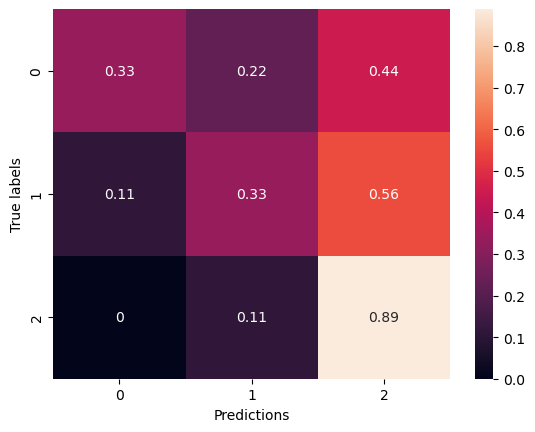

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▁▂▂▁▂▃▂▂▃▃▃▃▂▃▅▄▄▄▃▄▄▄▄▅▅▅▅▅▆█▆▇▆▆▆▇▇▇█
training_loss,██▇▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
training_time,▁
val_accuracy,▂▂▂▁▂▁▂▂▃▄▅▃▄▂▃▂▃▃▂▂▂▄▅▅▄▄▄▂▅▆▇▆▆▆▆▆▅▆█▇
val_loss,██▇▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:49:55.934412: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:49:55.936524: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:49:55.938491: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:49:57.804750: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:49:57.807437: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:49:57.809667: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:50:03.481918: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:50:04.196000: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 56.3345 - accuracy: 0.3516

2024-03-13 02:50:08.464648: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:50:08.466704: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:50:08.468555: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 14s 220ms/step - loss: 56.3345 - accuracy: 0.3516 - val_loss: 55.1185 - val_accuracy: 0.3056
Epoch 2/100
14/14 [==============================] - 1s 87ms/step - loss: 55.4757 - accuracy: 0.3059 - val_loss: 54.1567 - val_accuracy: 0.3241
Epoch 3/100
14/14 [==============================] - 1s 86ms/step - loss: 54.2767 - accuracy: 0.3767 - val_loss: 53.2226 - val_accuracy: 0.3426
Epoch 4/100
14/14 [==============================] - 1s 87ms/step - loss: 53.3780 - accuracy: 0.3767 - val_loss: 52.2943 - val_accuracy: 0.3426
Epoch 5/100
14/14 [==============================] - 1s 94ms/step - loss: 52.4146 - accuracy: 0.3356 - val_loss: 51.4029 - val_accuracy: 0.3519
Epoch 6/100
14/14 [==============================] - 1s 87ms/step - loss: 51.5513 - accuracy: 0.3767 - val_loss: 50.5280 - val_accuracy: 0.3519
Epoch 7/100
14/14 [==============================] - 1s 88ms/step - loss: 50.6941 - accuracy: 0.3425 - val_loss: 49.6745 - val_accuracy: 0.3426
Ep

14/14 [==============================] - 1s 88ms/step - loss: 22.0778 - accuracy: 0.4406 - val_loss: 21.8892 - val_accuracy: 0.4167
Epoch 58/100
14/14 [==============================] - 1s 88ms/step - loss: 21.6210 - accuracy: 0.5023 - val_loss: 21.5505 - val_accuracy: 0.4074
Epoch 59/100
14/14 [==============================] - 1s 89ms/step - loss: 21.3272 - accuracy: 0.4749 - val_loss: 21.2287 - val_accuracy: 0.4352
Epoch 60/100
14/14 [==============================] - 1s 87ms/step - loss: 20.9598 - accuracy: 0.4840 - val_loss: 20.8966 - val_accuracy: 0.4444
Epoch 61/100
14/14 [==============================] - 1s 91ms/step - loss: 20.5973 - accuracy: 0.4566 - val_loss: 20.5730 - val_accuracy: 0.4722
Epoch 62/100
14/14 [==============================] - 1s 87ms/step - loss: 20.2676 - accuracy: 0.5023 - val_loss: 20.2430 - val_accuracy: 0.4815
Epoch 63/100
14/14 [==============================] - 1s 91ms/step - loss: 20.0383 - accuracy: 0.5068 - val_loss: 19.9297 - val_accuracy: 0.481

2024-03-13 02:52:13.811498: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:52:13.813654: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:52:13.815211: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5854718685150146 s
{'0': {'precision': 0.5, 'recall': 0.2222222222222222, 'f1-score': 0.30769230769230765, 'support': 9}, '1': {'precision': 0.4, 'recall': 0.4444444444444444, 'f1-score': 0.4210526315789474, 'support': 9}, '2': {'precision': 0.5384615384615384, 'recall': 0.7777777777777778, 'f1-score': 0.6363636363636364, 'support': 9}, 'accuracy': 0.48148148148148145, 'macro avg': {'precision': 0.4794871794871795, 'recall': 0.48148148148148145, 'f1-score': 0.4550361918782972, 'support': 27}, 'weighted avg': {'precision': 0.47948717948717945, 'recall': 0.48148148148148145, 'f1-score': 0.4550361918782972, 'support': 27}}


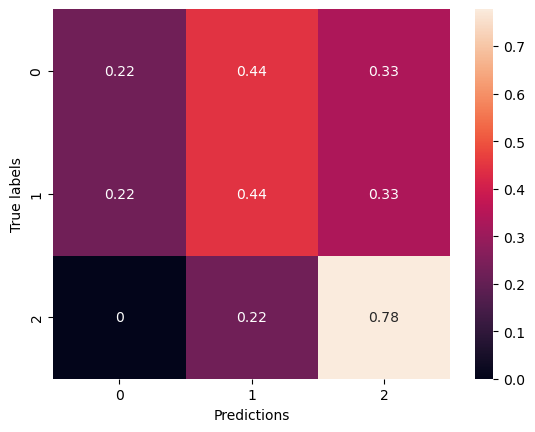

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▂▂▂▂▁▁▂▃▂▂▄▃▃▄▄▃▄▃▄▅▄▄▅▅▄▅▅▆▆▆▅▆▆▆▆▇▇▇▇█
training_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
training_time,▁
val_accuracy,▁▂▂▂▄▄▄▄▄▄▄▃▄▅▅▅▅▅▅▅▆▅▄▅▅▆▇▆▆▆▇▇█▇██▇▇▇▇
val_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁


Epoch 1/100


2024-03-13 02:52:36.428656: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:52:36.430252: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:52:36.432237: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:52:38.219932: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:52:38.221839: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:52:38.224022: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:52:42.800778: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:52:43.468122: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 11.2620 - accuracy: 0.3858

2024-03-13 02:52:47.915521: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:52:47.917988: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:52:47.920229: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 257ms/step - loss: 11.2620 - accuracy: 0.3858 - val_loss: 10.6211 - val_accuracy: 0.2778
Epoch 2/100
14/14 [==============================] - 2s 147ms/step - loss: 10.8030 - accuracy: 0.4795 - val_loss: 10.5778 - val_accuracy: 0.3056
Epoch 3/100
14/14 [==============================] - 2s 134ms/step - loss: 10.7388 - accuracy: 0.4954 - val_loss: 10.5352 - val_accuracy: 0.2778
Epoch 4/100
14/14 [==============================] - 2s 149ms/step - loss: 10.5505 - accuracy: 0.5160 - val_loss: 10.4896 - val_accuracy: 0.2685
Epoch 5/100
14/14 [==============================] - 2s 122ms/step - loss: 10.4279 - accuracy: 0.5342 - val_loss: 10.4470 - val_accuracy: 0.2870
Epoch 6/100
14/14 [==============================] - 2s 132ms/step - loss: 10.3016 - accuracy: 0.5731 - val_loss: 10.3938 - val_accuracy: 0.2963
Epoch 7/100
14/14 [==============================] - 2s 121ms/step - loss: 10.1712 - accuracy: 0.5731 - val_loss: 10.3361 - val_accuracy: 0.3

Epoch 58/100
14/14 [==============================] - 2s 120ms/step - loss: 6.4730 - accuracy: 0.9589 - val_loss: 8.6124 - val_accuracy: 0.5463
Epoch 59/100
14/14 [==============================] - 2s 121ms/step - loss: 6.4150 - accuracy: 0.9658 - val_loss: 8.5544 - val_accuracy: 0.5556
Epoch 60/100
14/14 [==============================] - 2s 124ms/step - loss: 6.3817 - accuracy: 0.9452 - val_loss: 8.5193 - val_accuracy: 0.5648
Epoch 61/100
14/14 [==============================] - 2s 120ms/step - loss: 6.3168 - accuracy: 0.9543 - val_loss: 8.5174 - val_accuracy: 0.5370
Epoch 62/100
14/14 [==============================] - 2s 127ms/step - loss: 6.2477 - accuracy: 0.9726 - val_loss: 8.4949 - val_accuracy: 0.5000
Epoch 63/100
14/14 [==============================] - 2s 120ms/step - loss: 6.2092 - accuracy: 0.9589 - val_loss: 8.3865 - val_accuracy: 0.5278
Epoch 64/100
14/14 [==============================] - 2s 123ms/step - loss: 6.1724 - accuracy: 0.9589 - val_loss: 8.3800 - val_accuracy:

2024-03-13 02:55:39.994367: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:55:39.996195: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:55:40.000055: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 2s 2s/step
Inference done in 1.5909719467163086 s
{'0': {'precision': 0.6666666666666666, 'recall': 0.2222222222222222, 'f1-score': 0.3333333333333333, 'support': 9}, '1': {'precision': 0.5, 'recall': 0.5555555555555556, 'f1-score': 0.5263157894736842, 'support': 9}, '2': {'precision': 0.5714285714285714, 'recall': 0.8888888888888888, 'f1-score': 0.6956521739130435, 'support': 9}, 'accuracy': 0.5555555555555556, 'macro avg': {'precision': 0.5793650793650793, 'recall': 0.5555555555555555, 'f1-score': 0.5184337655733536, 'support': 27}, 'weighted avg': {'precision': 0.5793650793650793, 'recall': 0.5555555555555556, 'f1-score': 0.5184337655733536, 'support': 27}}


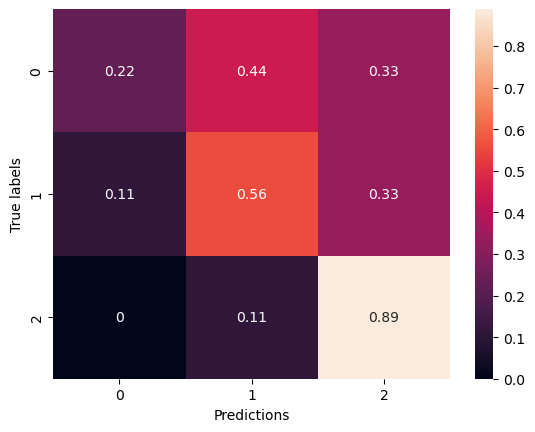

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
inference_time,▁
test_accuracy,▁
test_f1_score,▁
test_precision,▁
test_recall,▁
training_accuracy,▁▂▃▄▄▄▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇█████████████████
training_loss,█▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁
training_time,▁
val_accuracy,▁▁▁▃▅▅▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇█▇█
val_loss,███▇▇▇▆▆▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▁▁▁


Epoch 1/100


2024-03-13 02:56:05.975789: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:56:05.978852: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:56:05.981164: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:56:07.772712: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:56:07.775093: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:56:07.778448: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

2024-03-13 02:56:12.337249: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]
2024-03-13 02:56:12.956330: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis' with dtype int32 and shape [1]
	 [[{{node gradients/ReverseV2_grad/ReverseV2/ReverseV2/axis}}]]


14/14 [==============================] - ETA: 0s - loss: 49.0909 - accuracy: 0.3744

2024-03-13 02:56:17.350151: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-03-13 02:56:17.351736: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-03-13 02:56:17.354028: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

14/14 [==============================] - 13s 250ms/step - loss: 49.0909 - accuracy: 0.3744 - val_loss: 48.0262 - val_accuracy: 0.3056
Epoch 2/100
14/14 [==============================] - 2s 117ms/step - loss: 48.0433 - accuracy: 0.3744 - val_loss: 47.1107 - val_accuracy: 0.2870
Epoch 3/100
14/14 [==============================] - 2s 117ms/step - loss: 46.8833 - accuracy: 0.4726 - val_loss: 46.2071 - val_accuracy: 0.2963
Epoch 4/100
14/14 [==============================] - 2s 120ms/step - loss: 45.8633 - accuracy: 0.5091 - val_loss: 45.3007 - val_accuracy: 0.2778
Epoch 5/100
14/14 [==============================] - 2s 122ms/step - loss: 44.8664 - accuracy: 0.5457 - val_loss: 44.3937 - val_accuracy: 0.2778
Epoch 6/100
14/14 [==============================] - 2s 118ms/step - loss: 44.0156 - accuracy: 0.5183 - val_loss: 43.5047 - val_accuracy: 0.3148
Epoch 7/100
14/14 [==============================] - 2s 143ms/step - loss: 42.9382 - accuracy: 0.5548 - val_loss: 42.6286 - val_accuracy: 0.3

14/14 [==============================] - 2s 123ms/step - loss: 13.8765 - accuracy: 0.9315 - val_loss: 15.7019 - val_accuracy: 0.5556
Epoch 58/100
14/14 [==============================] - 2s 120ms/step - loss: 13.6014 - accuracy: 0.9361 - val_loss: 15.4057 - val_accuracy: 0.5556
Epoch 59/100
14/14 [==============================] - 2s 120ms/step - loss: 13.2522 - accuracy: 0.9589 - val_loss: 15.1504 - val_accuracy: 0.5463
Epoch 60/100
14/14 [==============================] - 2s 122ms/step - loss: 12.9945 - accuracy: 0.9292 - val_loss: 14.9074 - val_accuracy: 0.5463
Epoch 61/100
14/14 [==============================] - 2s 123ms/step - loss: 12.7082 - accuracy: 0.9521 - val_loss: 14.5669 - val_accuracy: 0.5370
Epoch 62/100
14/14 [==============================] - 2s 118ms/step - loss: 12.4097 - accuracy: 0.9658 - val_loss: 14.3885 - val_accuracy: 0.5370
Epoch 63/100
14/14 [==============================] - 2s 120ms/step - loss: 12.1632 - accuracy: 0.9452 - val_loss: 14.1569 - val_accuracy

KeyboardInterrupt: 

In [7]:
ys = [y1, y2, y3, y4, y5]
titles = ["y1", "y2","y3", "y4", "y5"]

for i, y_data in enumerate(ys):
    run_all(data, y_data, titles[i])

In [ ]:
run_all(data, y1, "y1")

In [ ]:
run_all(data, y_data, titles[i])

In [ ]:
run_all(data, y_data, titles[i])

In [ ]:
run_all(data, y_data, titles[i])

In [ ]:
run_all(data, y_data, titles[i])